# Algoritmo de Regresión Logística

- La regresión logística es un algoritmo de aprendizaje supervisado utilizado para la **clasificación binaria**, es decir, cuando queremos predecir la pertenencia de una observación a una de dos categorías posibles.

Por ejemplo: Queremos predecir si un raton esta enfermo (0 o 1) dado ciertas caracteristicas X (su peso, etc.)

- A pesar de su nombre, la regresión logística se utiliza para **problemas de clasificación**, no para problemas de regresión.

- El nombre "logística" proviene de la función logística, también conocida como **función sigmoide**, que se utiliza en este algoritmo. La función sigmoide transforma cualquier valor de entrada en un rango entre 0 y 1, lo que hace que sea útil para representar probabilidades. En el contexto de la regresión logística, esta función se utiliza para modelar la probabilidad de que una observación pertenezca a una de las dos clases.

## 1. ¿Qué es la función Sigmoide (o Logística)?

La función sigmoide, también conocida como función logística, es una función matemática que tiene una forma de "S" o "curva sigmoide". Su forma matemática está dada por la siguiente ecuación:

<img src="img1.png">

<img src="img3.png">

<img src="img2.png">

## 2. ¿Qué es z?

En el contexto de la función sigmoide, z es la entrada de la función, también conocida como "logit". z es una combinación lineal de las características de entrada multiplicadas por los parámetros del modelo. En otras palabras, z es la suma ponderada de las características, donde cada característica se multiplica por su correspondiente parámetro y luego se suman.

Matemáticamente, si tenemos un vector de características x y un vector de parámetros β, entonces z se calcula como el producto punto entre x y β:

<img src="img4.png">

## 3. ¿Cómo se calculan cuáles son los buenos parámetros del modelo logístico?

Para calcular los buenos parámetros del modelo logístico y realizar buenas predicciones, se utiliza un proceso de **entrenamiento del modelo**. Este proceso implica optimizar los parámetros del modelo utilizando un conjunto de datos de entrenamiento.

La **optimización de los parámetros** del modelo implica encontrar los valores de los parámetros que minimizan una **función de costo**, la cual representa la discrepancia entre las predicciones del modelo y las etiquetas verdaderas en el conjunto de datos de entrenamiento.

Para hacer esto, generalmente se utiliza un algoritmo de optimización, como el **gradiente descendente**. 

- **Etapa 1**: Inicialización de parámetros: Se comienza inicializando los parámetros del modelo con valores aleatorios o predefinidos.

- **Etapa 2**: Cálculo de la función de costo: Se calcula la función de costo utilizando los parámetros actuales del modelo y los datos de entrenamiento. La función de costo mide la discrepancia entre las predicciones del modelo y las etiquetas verdaderas.

- **Etapa 3**: Cálculo del gradiente: Se calcula el gradiente de la función de costo con respecto a los parámetros del modelo. El gradiente indica la dirección en la que se debe ajustar cada parámetro para disminuir la función de costo.

- **Etapa 4**: Actualización de parámetros: Se ajustan los parámetros del modelo en la dirección opuesta al gradiente, multiplicado por una **tasa de aprendizaje**. Esto se hace para mover los parámetros hacia los valores que minimizan la función de costo.

- Repetición del proceso: Los pasos 2 a 4 se repiten iterativamente hasta que se alcance un criterio de detención, como un número máximo de iteraciones o una mejora mínima en la función de costo.

El objetivo del proceso de optimización es encontrar los parámetros del modelo que minimicen la función de costo y, por lo tanto, hagan que las predicciones del modelo sean lo más precisas posible. El algoritmo de optimización ajusta gradualmente los parámetros del modelo en la dirección que reduce la función de costo, lo que conduce a un modelo mejorado con el tiempo.


## 4. ¿Cuál función de costo se utiliza?

En la regresión logística, la función de costo más comúnmente utilizada es la función de costo de **entropía cruzada** (también conocida como pérdida logarítmica). Esta función se utiliza porque es adecuada para problemas de clasificación binaria y está diseñada para penalizar fuertemente las predicciones incorrectas.

<img src="img5.png">

## 5. Ilustración del entrenamiento de un modelo de Regresión Logística 

Nuestro dataset está compuesto por:
- X: 1 caracteristica
- y: 1 predicción que puede tener dos valores posibles (0 o 1) - problema de clasificación binario
- 100 instancias

Generamos el dataset y lo visualizamos a continuación.

In [11]:
import numpy as np
import pandas as pd
from sklearn.datasets import make_classification
import matplotlib.pyplot as plt

X, y = make_classification(n_samples=100, n_features=1, n_informative=1, n_redundant=0, n_repeated=0, n_classes=2, n_clusters_per_class=1, random_state=0)

# Añadir la columna de 1s para el término de sesgo
X = np.insert(X, 0, 1, axis=1)

In [2]:
# Definir la función sigmoide
def sigmoid(z):
    return 1 / (1 + np.exp(-z))

In [3]:
def plot_decision_boundary(X, y, beta):
    """
    Función para visualizar los puntos de datos y el modelo de regresión logística en 2D.

    Parámetros:
    - X: array de datos de entrada con la columna de sesgo incluida.
    - y: array de etiquetas de clase.
    - beta: array de parámetros del modelo entrenado.
    """
    plt.figure()

    # Colores para las clases
    colors = ['red' if label == 0 else 'blue' for label in y]

    # Graficar los puntos de datos
    plt.scatter(X[:, 1], y, c=colors, marker='o', edgecolor='k', label='Datos reales')

    # Graficar la función sigmoide
    x_values = np.linspace(X[:, 1].min(), X[:, 1].max(), 100)
    y_values = sigmoid(beta[0] + beta[1] * x_values)
    plt.plot(x_values, y_values, color='yellow', alpha=0.5, label='Modelo sigmoide')

    # Etiquetas de los ejes
    plt.xlabel('Feature 1')
    plt.ylabel('Probabilidad predicha')

    # Leyenda
    plt.legend()

    # Mostrar el gráfico
    plt.show()

Valores iniciales de los parámetros: [0. 0.]


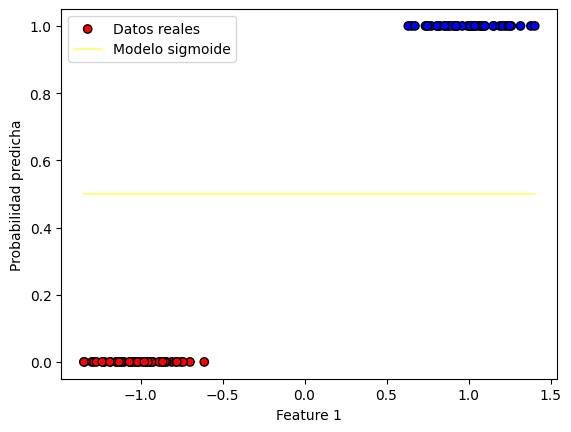

In [4]:
# Inicializar parámetros
beta = np.zeros(X.shape[1])
learning_rate = 0.01
iterations = 1000

print(f'Valores iniciales de los parámetros: {beta}')
# Llamar a la función de visualización
plot_decision_boundary(X, y, beta)

In [5]:
from mpl_toolkits.mplot3d import Axes3D

def plot_cost_surface(X, y, beta_history):
    """
    Función para visualizar la superficie de costo en función de los parámetros beta.

    Parámetros:
    - X: array de datos de entrada con la columna de sesgo incluida.
    - y: array de etiquetas de clase.
    - beta_history: lista de matrices que contienen los valores de beta en cada iteración del gradiente descendente.
    """
    fig = plt.figure()
    ax = fig.add_subplot(111, projection='3d')

    # Crear una malla de valores de beta0 y beta1
    beta0_vals = np.linspace(-2, 2, 100)
    beta1_vals = np.linspace(-2, 2, 100)
    beta0_vals, beta1_vals = np.meshgrid(beta0_vals, beta1_vals)

    # Calcular el costo para cada combinación de beta0 y beta1
    cost_vals = np.zeros_like(beta0_vals)
    for i in range(len(beta0_vals)):
        for j in range(len(beta1_vals)):
            beta = np.array([beta0_vals[i,j], beta1_vals[i,j]])
            cost_vals[i,j] = cost_function(X, y, beta)

    # Graficar la superficie de costo
    ax.plot_surface(beta0_vals, beta1_vals, cost_vals, cmap='viridis', alpha=0.8)
    ax.set_xlabel('Beta 0')
    ax.set_ylabel('Beta 1')
    ax.set_zlabel('Costo')

    plt.show()

In [6]:

# Definir la función de costo
def cost_function(X, y, beta):
    m = len(y)
    h = sigmoid(np.dot(X, beta))
    return (-1/m) * np.sum(y * np.log(h) + (1 - y) * np.log(1 - h))

# Gradiente descendente
def gradient_descent(X, y, beta, learning_rate, iterations):
    m = len(y)

    beta_history = []  # Lista para almacenar los valores de beta en cada iteración
    for _ in range(iterations):
        print(f'Iteracion: {_}')
        h = sigmoid(np.dot(X, beta))

        cost = cost_function(X, y, beta)  # Calcular el costo en cada iteración
        print(f'Costo en la iteración {_}: {cost}')
        
        gradient = np.dot(X.T, (h - y)) / m

        print(f'Valor del gradiente {_}: {gradient}')
        
        beta -= learning_rate * gradient
        print(f'Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: {beta}')
        # Llamar a la función de visualización
        plot_decision_boundary(X, y, beta)

        beta_history.append(beta.copy())  # Guardar una copia de los valores de beta en esta iteración        

    # Llamar a la función de visualización de la superficie de costo
    plot_cost_surface(X, y, beta_history)
    

    
    return beta

Iteracion: 0
Costo en la iteración 0: 0.6931471805599453
Valor del gradiente 0: [ 0.         -0.50423733]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.         0.00504237]


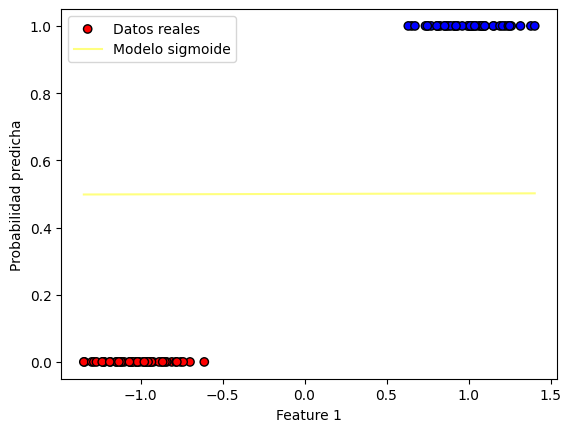

Iteracion: 1
Costo en la iteración 1: 0.6906079613051277
Valor del gradiente 1: [-1.63007675e-05 -5.02915099e-01]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [1.63007675e-07 1.00715243e-02]


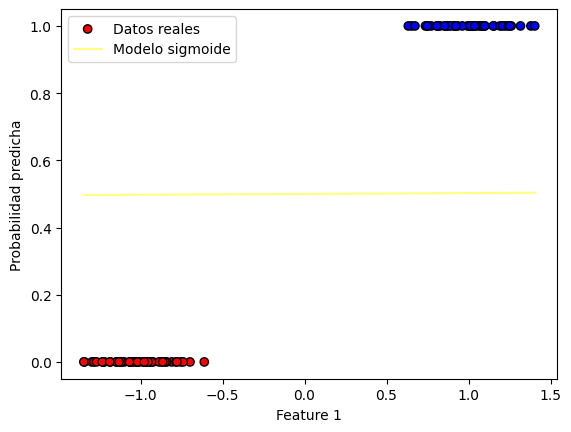

Iteracion: 2
Costo en la iteración 2: 0.6880820414279307
Valor del gradiente 2: [-3.25175141e-05 -5.01596355e-01]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [4.88182815e-07 1.50874878e-02]


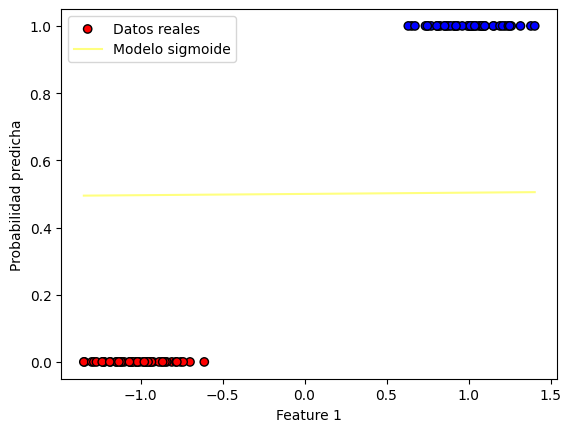

Iteracion: 3
Costo en la iteración 3: 0.6855693510156309
Valor del gradiente 3: [-4.86500489e-05 -5.00281109e-01]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [9.74683305e-07 2.00902989e-02]


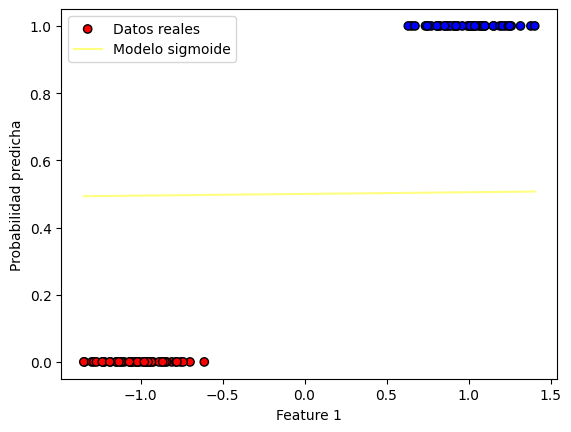

Iteracion: 4
Costo en la iteración 4: 0.683069820330451
Valor del gradiente 4: [-6.46981935e-05 -4.98969370e-01]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [1.62166524e-06 2.50799926e-02]


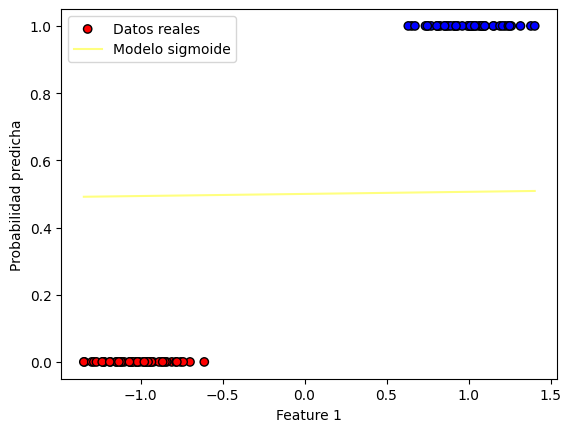

Iteracion: 5
Costo en la iteración 5: 0.6805833798132203
Valor del gradiente 5: [-8.06617811e-05 -4.97661148e-01]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [2.42828305e-06 3.00566041e-02]


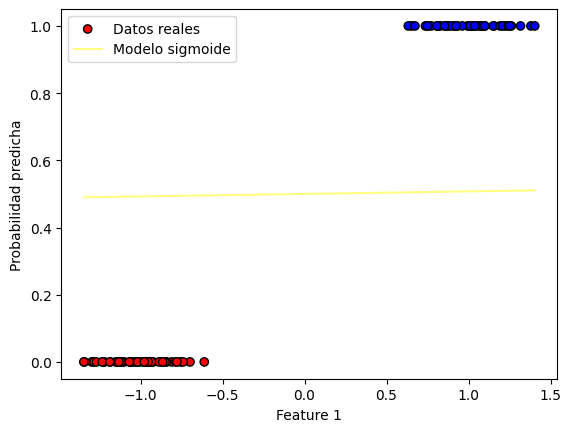

Iteracion: 6
Costo en la iteración 6: 0.6781099600869509
Valor del gradiente 6: [-9.65406569e-05 -4.96356452e-01]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [3.39368962e-06 3.50201686e-02]


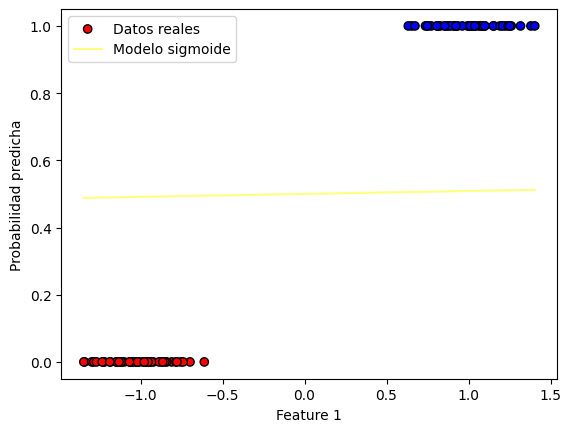

Iteracion: 7
Costo en la iteración 7: 0.6756494919603344
Valor del gradiente 7: [-1.12334678e-04 -4.95055291e-01]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [4.51703640e-06 3.99707215e-02]


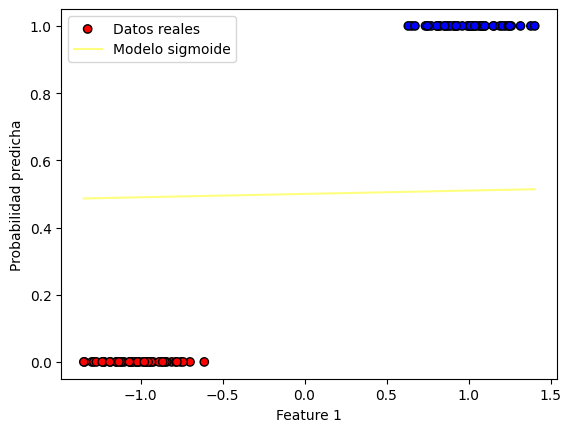

Iteracion: 8
Costo en la iteración 8: 0.6732019064311582
Valor del gradiente 8: [-1.28043713e-04 -4.93757674e-01]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [5.79747353e-06 4.49082983e-02]


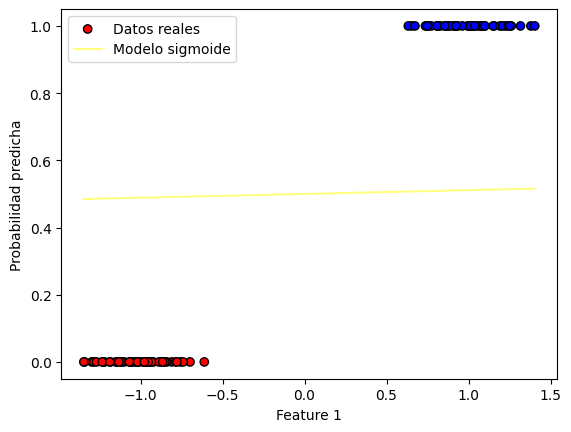

Iteracion: 9
Costo en la iteración 9: 0.6707671346896434
Valor del gradiente 9: [-1.43667642e-04 -4.92463609e-01]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [7.23414995e-06 4.98329344e-02]


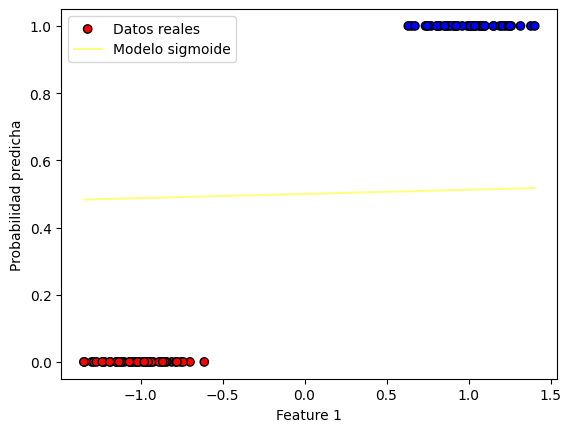

Iteracion: 10
Costo en la iteración 10: 0.6683451081217013
Valor del gradiente 10: [-1.59206355e-04 -4.91173103e-01]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [8.82621349e-06 5.47446654e-02]


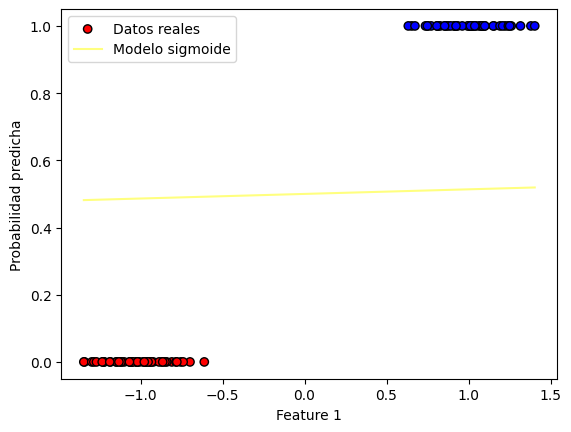

Iteracion: 11
Costo en la iteración 11: 0.6659357583121175
Valor del gradiente 11: [-1.74659755e-04 -4.89886165e-01]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [1.0572811e-05 5.9643527e-02]


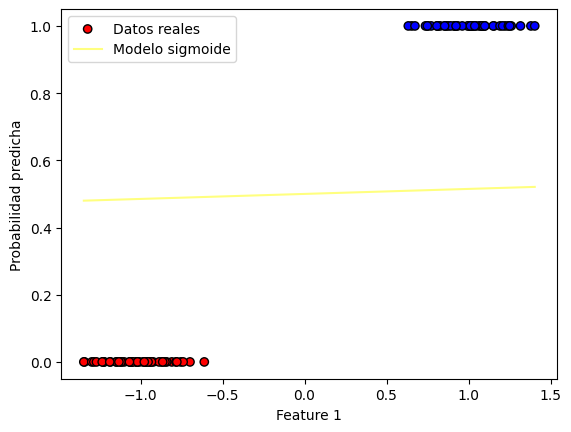

Iteracion: 12
Costo en la iteración 12: 0.663539017047651
Valor del gradiente 12: [-1.90027755e-04 -4.88602801e-01]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [1.24730886e-05 6.45295550e-02]


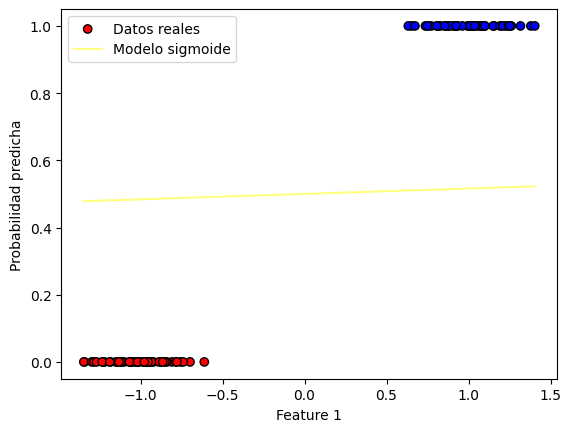

Iteracion: 13
Costo en la iteración 13: 0.6611548163200631
Valor del gradiente 13: [-2.05310278e-04 -4.87323019e-01]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [1.45261914e-05 6.94027852e-02]


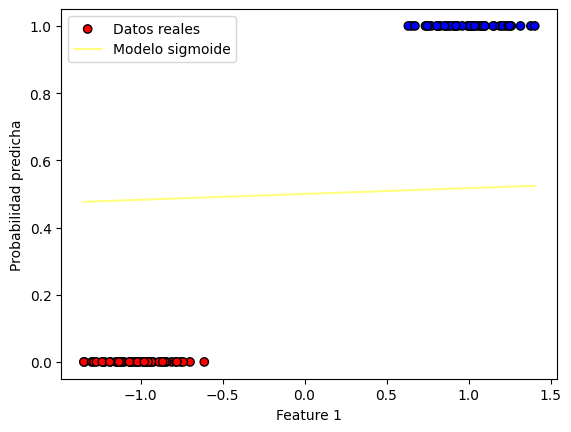

Iteracion: 14
Costo en la iteración 14: 0.6587830883290683
Valor del gradiente 14: [-2.20507259e-04 -4.86046825e-01]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [1.67312640e-05 7.42632535e-02]


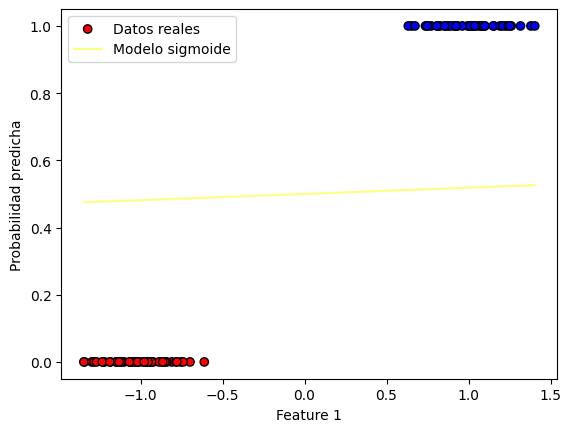

Iteracion: 15
Costo en la iteración 15: 0.656423765485208
Valor del gradiente 15: [-2.35618642e-04 -4.84774226e-01]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [1.90874504e-05 7.91109957e-02]


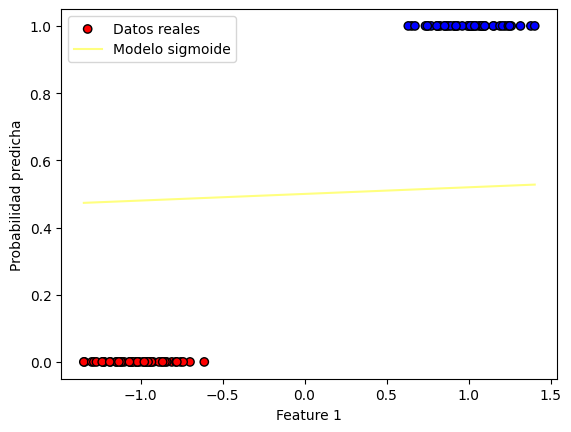

Iteracion: 16
Costo en la iteración 16: 0.654076780412654
Valor del gradiente 16: [-2.50644383e-04 -4.83505227e-01]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [2.15938942e-05 8.39460480e-02]


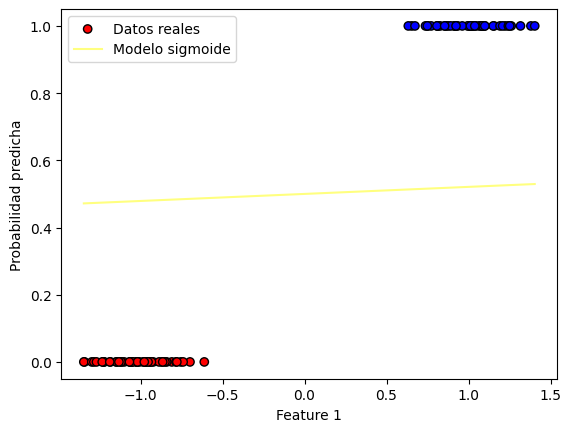

Iteracion: 17
Costo en la iteración 17: 0.6517420659519335
Valor del gradiente 17: [-2.65584445e-04 -4.82239836e-01]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [2.42497387e-05 8.87684464e-02]


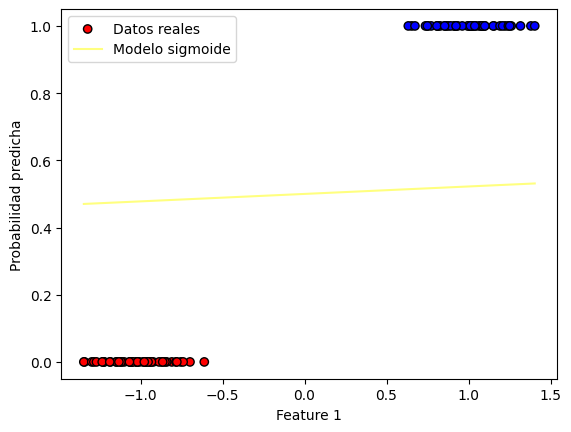

Iteracion: 18
Costo en la iteración 18: 0.6494195551625854
Valor del gradiente 18: [-2.80438804e-04 -4.80978056e-01]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [2.70541267e-05 9.35782269e-02]


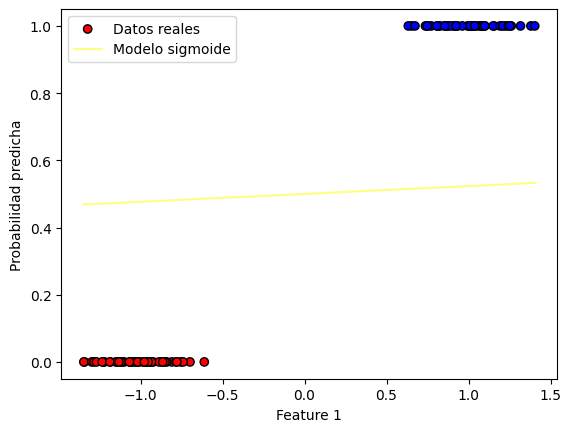

Iteracion: 19
Costo en la iteración 19: 0.6471091813257417
Valor del gradiente 19: [-2.95207445e-04 -4.79719893e-01]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [3.00062012e-05 9.83754259e-02]


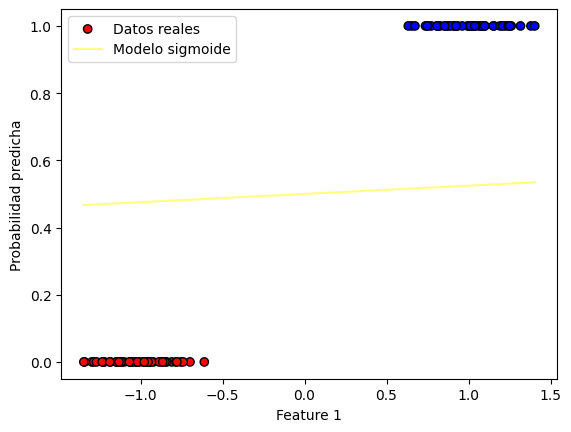

Iteracion: 20
Costo en la iteración 20: 0.6448108779466376
Valor del gradiente 20: [-3.09890360e-04 -4.78465353e-01]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [3.31051048e-05 1.03160079e-01]


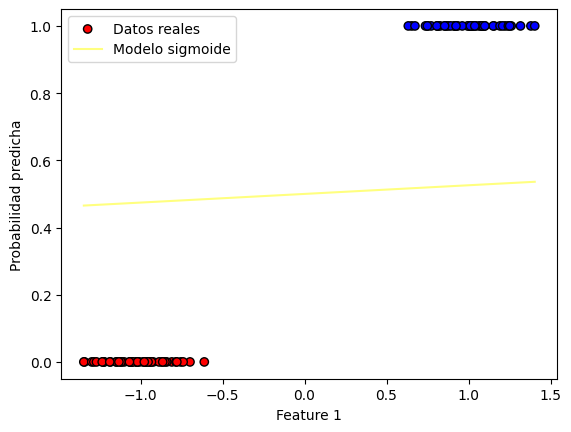

Iteracion: 21
Costo en la iteración 21: 0.6425245787570537
Valor del gradiente 21: [-3.24487555e-04 -4.77214440e-01]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [3.63499803e-05 1.07932224e-01]


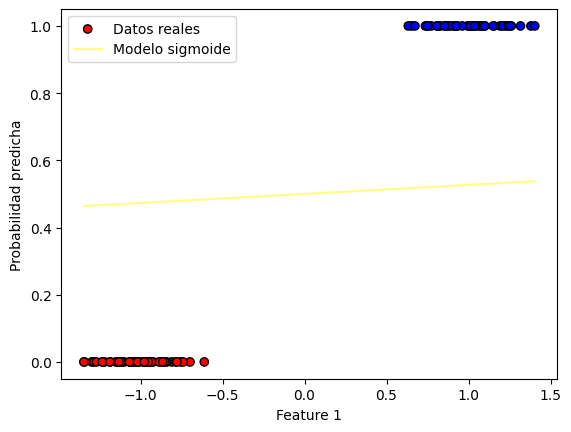

Iteracion: 22
Costo en la iteración 22: 0.6402502177176841
Valor del gradiente 22: [-3.38999040e-04 -4.75967158e-01]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [3.97399707e-05 1.12691895e-01]


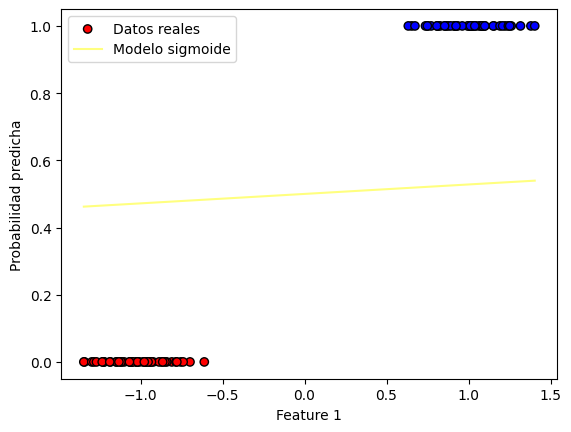

Iteracion: 23
Costo en la iteración 23: 0.6379877290204392
Valor del gradiente 23: [-3.53424839e-04 -4.74723511e-01]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [4.32742191e-05 1.17439130e-01]


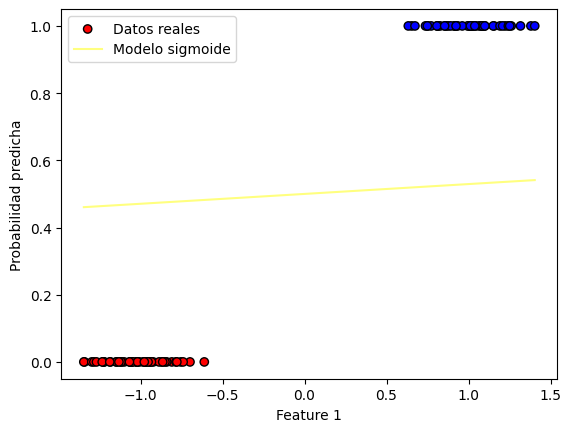

Iteracion: 24
Costo en la iteración 24: 0.6357370470906774
Valor del gradiente 24: [-3.67764981e-04 -4.73483503e-01]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [4.69518689e-05 1.22173966e-01]


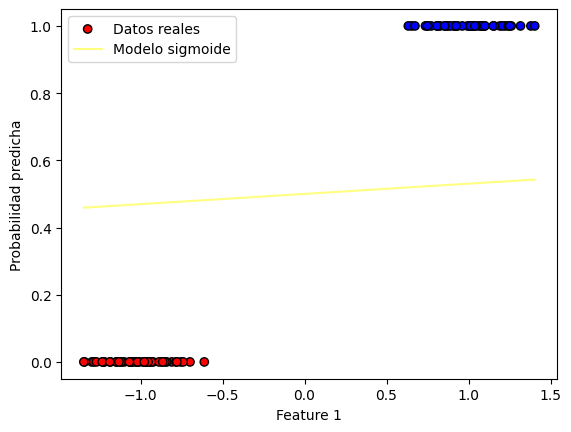

Iteracion: 25
Costo en la iteración 25: 0.6334981065893708
Valor del gradiente 25: [-3.82019507e-04 -4.72247138e-01]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [5.07720640e-05 1.26896437e-01]


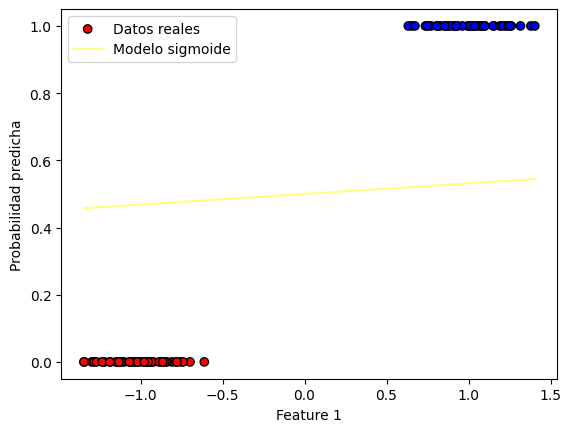

Iteracion: 26
Costo en la iteración 26: 0.6312708424152041
Valor del gradiente 26: [-3.96188464e-04 -4.71014419e-01]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [5.47339486e-05 1.31606581e-01]


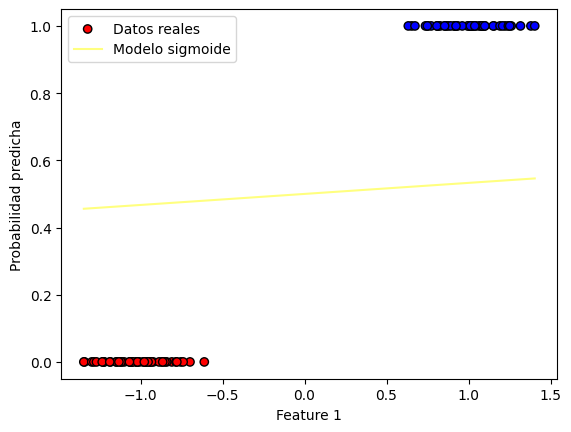

Iteracion: 27
Costo en la iteración 27: 0.629055189706607
Valor del gradiente 27: [-4.10271909e-04 -4.69785349e-01]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [5.88366677e-05 1.36304435e-01]


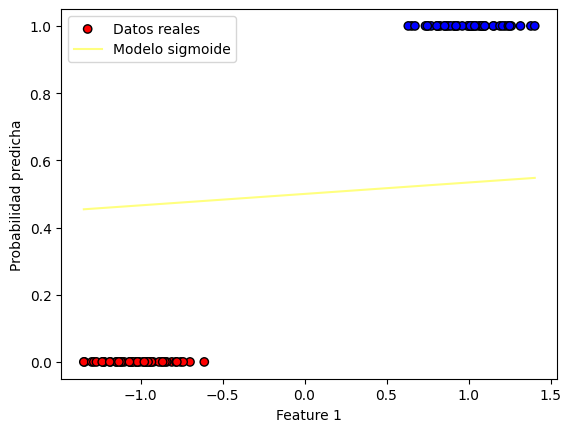

Iteracion: 28
Costo en la iteración 28: 0.6268510838437209
Valor del gradiente 28: [-4.24269907e-04 -4.68559931e-01]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [6.30793668e-05 1.40990034e-01]


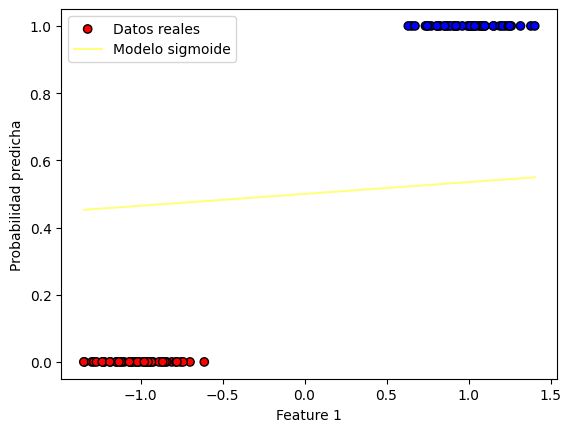

Iteracion: 29
Costo en la iteración 29: 0.6246584604503036
Valor del gradiente 29: [-4.38182530e-04 -4.67338168e-01]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [6.74611921e-05 1.45663416e-01]


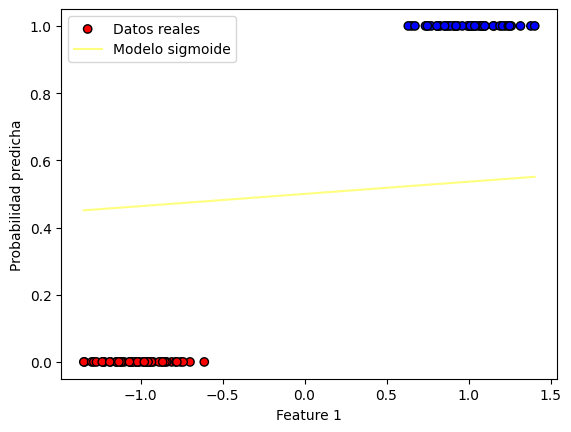

Iteracion: 30
Costo en la iteración 30: 0.6224772553955673
Valor del gradiente 30: [-4.52009860e-04 -4.66120061e-01]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [7.19812907e-05 1.50324616e-01]


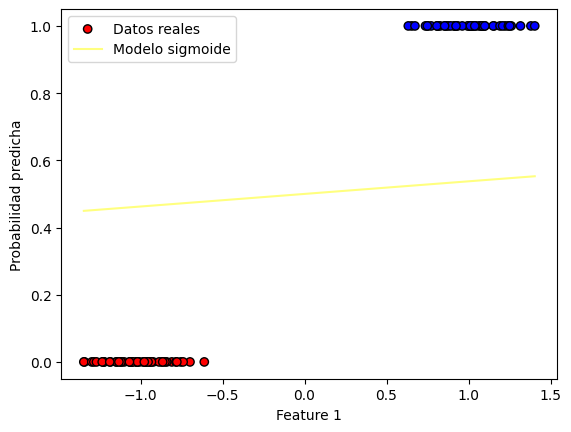

Iteracion: 31
Costo en la iteración 31: 0.6203074047959565
Valor del gradiente 31: [-0.00046575 -0.46490561]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [7.66388105e-05 1.54973672e-01]


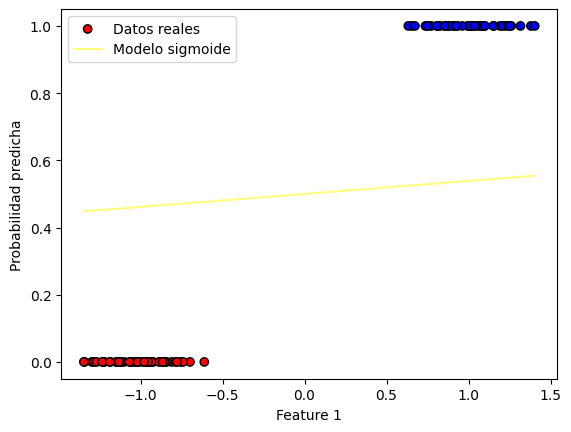

Iteracion: 32
Costo en la iteración 32: 0.6181488450168624
Valor del gradiente 32: [-0.00047941 -0.46369482]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [8.14329006e-05 1.59610621e-01]


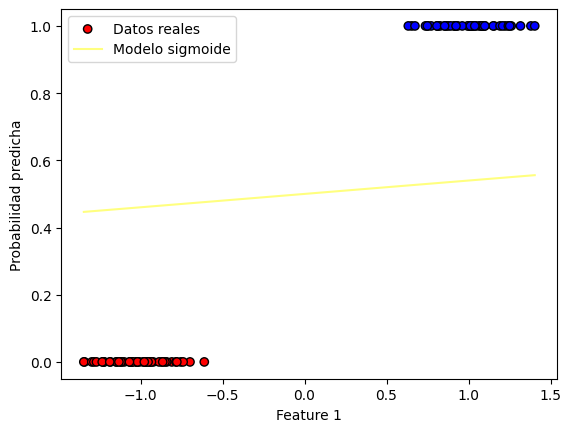

Iteracion: 33
Costo en la iteración 33: 0.616001512674277
Valor del gradiente 33: [-0.00049298 -0.4624877 ]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [8.63627107e-05 1.64235498e-01]


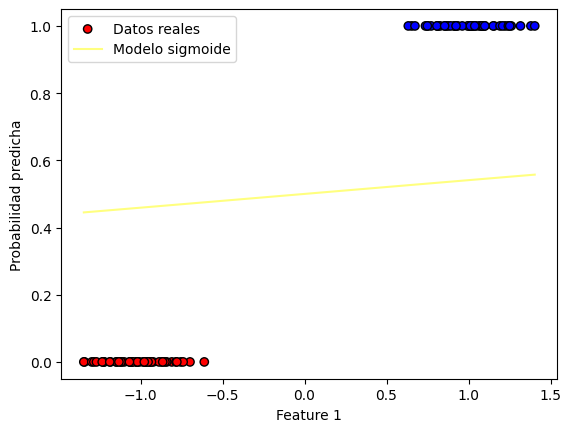

Iteracion: 34
Costo en la iteración 34: 0.6138653446363865
Valor del gradiente 34: [-0.00050647 -0.46128424]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [9.14273921e-05 1.68848340e-01]


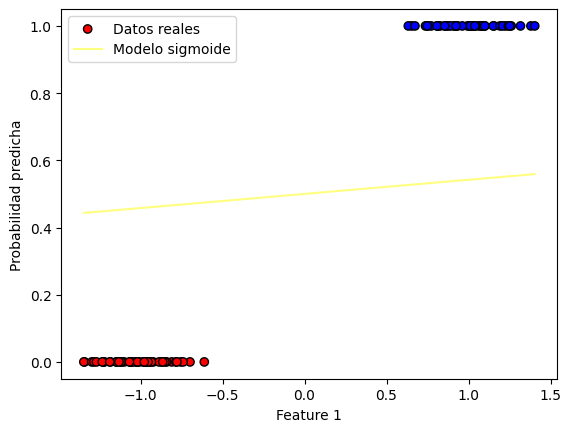

Iteracion: 35
Costo en la iteración 35: 0.6117402780251052
Valor del gradiente 35: [-0.00051987 -0.46008444]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [9.66260970e-05 1.73449184e-01]


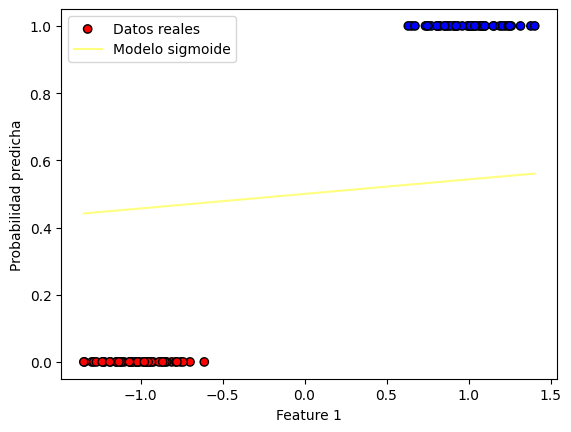

Iteracion: 36
Costo en la iteración 36: 0.6096262502175511
Valor del gradiente 36: [-0.00053319 -0.4588883 ]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [1.01957979e-04 1.78038067e-01]


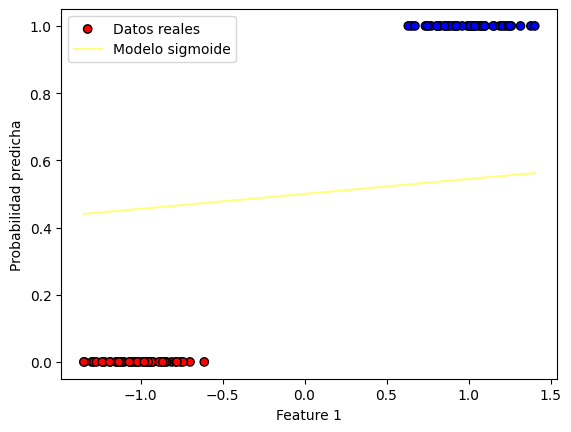

Iteracion: 37
Costo en la iteración 37: 0.6075231988474631
Valor del gradiente 37: [-0.00054642 -0.45769584]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [1.07422192e-04 1.82615026e-01]


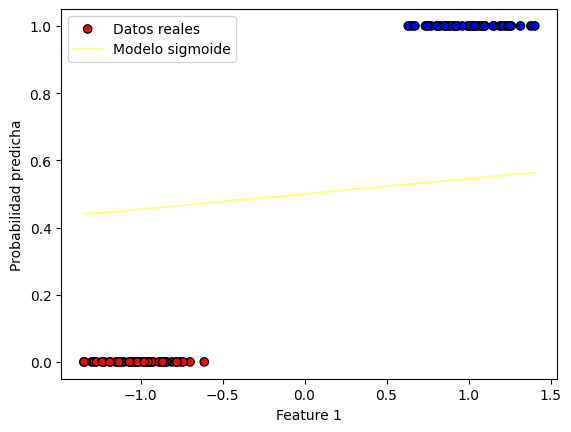

Iteracion: 38
Costo en la iteración 38: 0.6054310618065617
Valor del gradiente 38: [-0.00055957 -0.45650703]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [1.13017894e-04 1.87180096e-01]


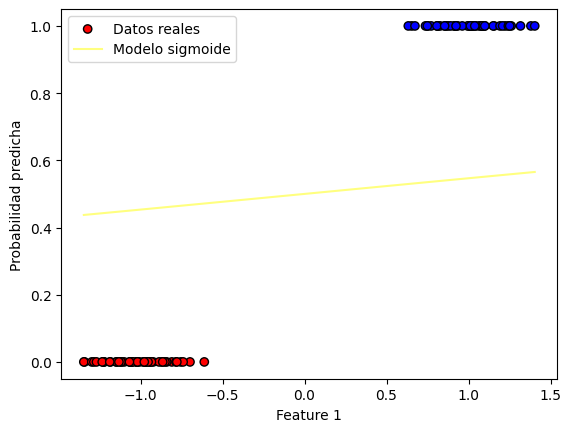

Iteracion: 39
Costo en la iteración 39: 0.6033497772458528
Valor del gradiente 39: [-0.00057263 -0.4553219 ]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [1.18744242e-04 1.91733315e-01]


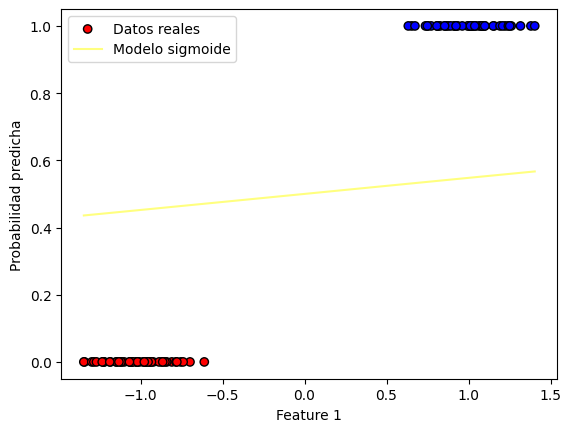

Iteracion: 40
Costo en la iteración 40: 0.6012792835768767
Valor del gradiente 40: [-0.00058562 -0.45414043]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [1.24600394e-04 1.96274719e-01]


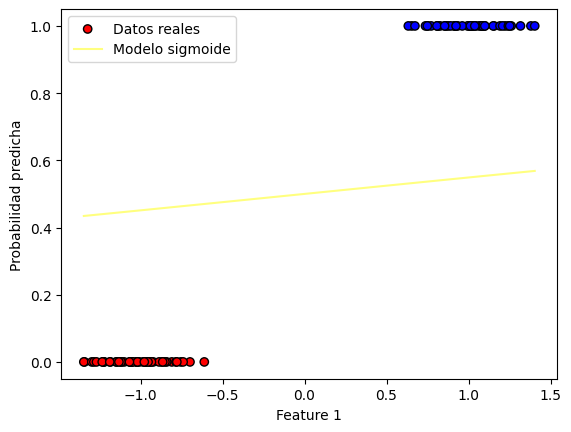

Iteracion: 41
Costo en la iteración 41: 0.5992195194729019
Valor del gradiente 41: [-0.00059851 -0.45296263]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [1.30585513e-04 2.00804346e-01]


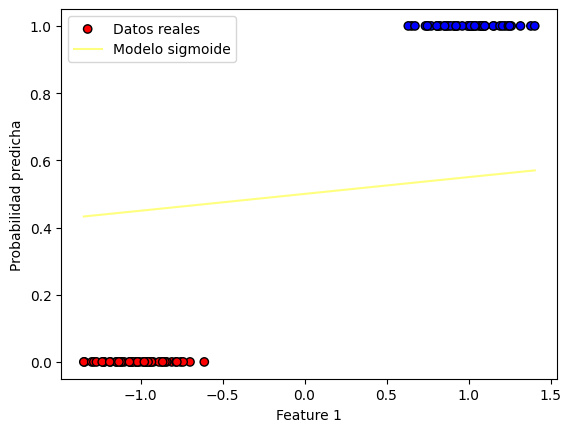

Iteracion: 42
Costo en la iteración 42: 0.5971704238700659
Valor del gradiente 42: [-0.00061132 -0.45178849]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [1.3669876e-04 2.0532223e-01]


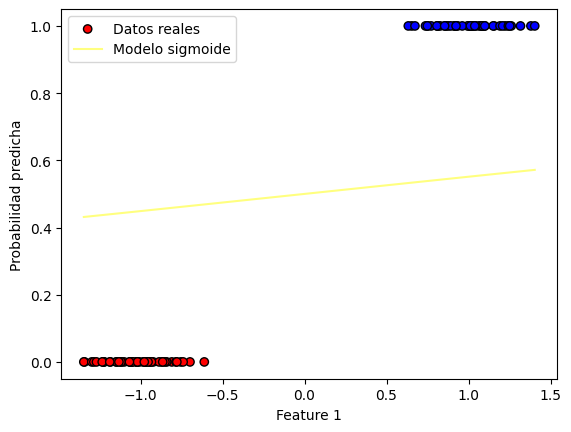

Iteracion: 43
Costo en la iteración 43: 0.5951319359684616
Valor del gradiente 43: [-0.00062405 -0.45061802]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [1.42939299e-04 2.09828411e-01]


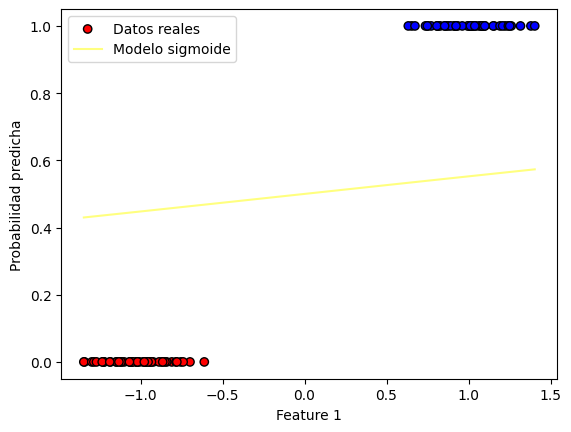

Iteracion: 44
Costo en la iteración 44: 0.5931039952331727
Valor del gradiente 44: [-0.0006367  -0.44945121]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [1.49306297e-04 2.14322923e-01]


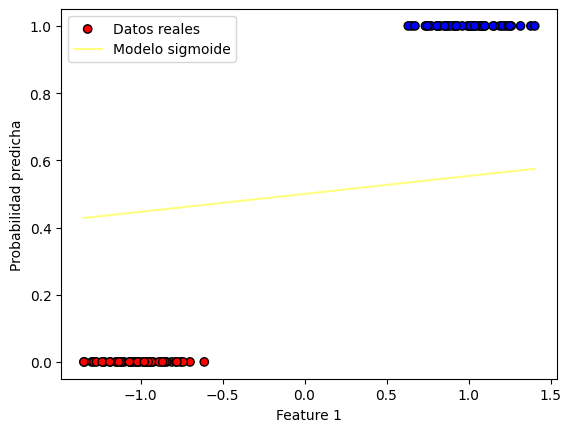

Iteracion: 45
Costo en la iteración 45: 0.5910865413952577
Valor del gradiente 45: [-0.00064926 -0.44828806]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [1.55798921e-04 2.18805803e-01]


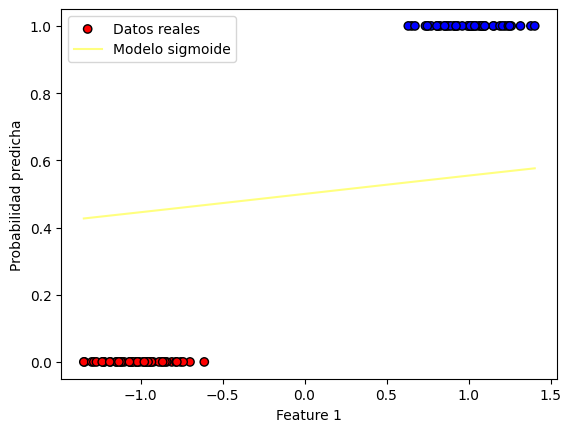

Iteracion: 46
Costo en la iteración 46: 0.5890795144526816
Valor del gradiente 46: [-0.00066174 -0.44712857]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [1.62416342e-04 2.23277089e-01]


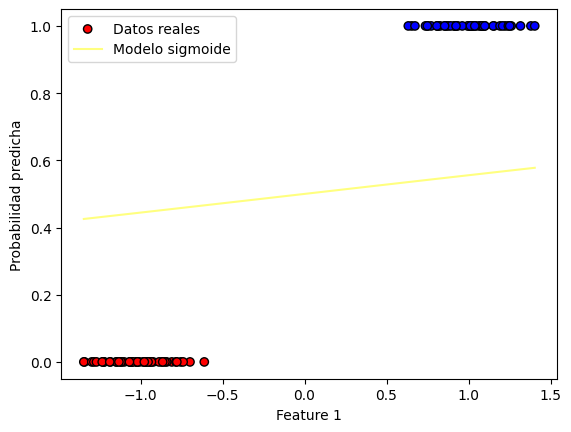

Iteracion: 47
Costo en la iteración 47: 0.5870828546712001
Valor del gradiente 47: [-0.00067414 -0.44597275]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [1.69157730e-04 2.27736817e-01]


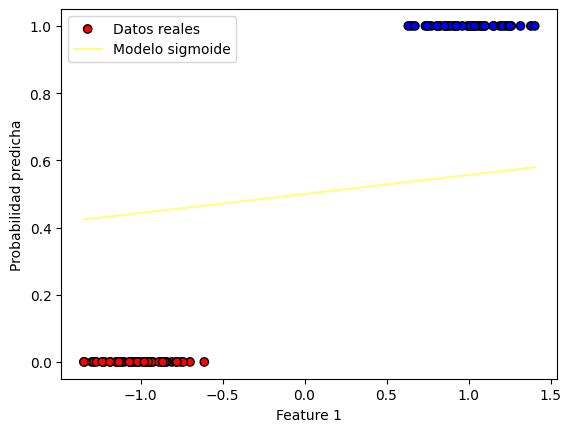

Iteracion: 48
Costo en la iteración 48: 0.5850965025851933
Valor del gradiente 48: [-0.00068645 -0.44482058]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [1.76022259e-04 2.32185022e-01]


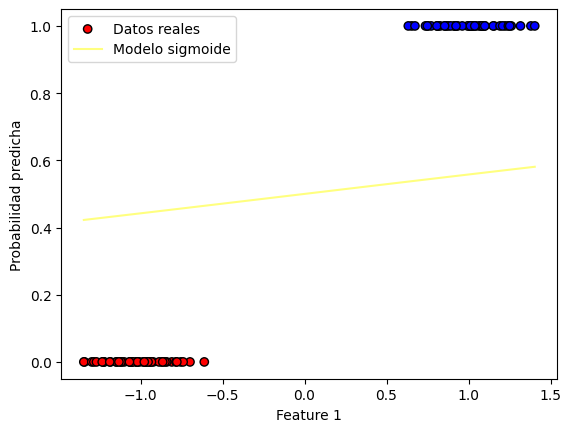

Iteracion: 49
Costo en la iteración 49: 0.5831203989984514
Valor del gradiente 49: [-0.00069868 -0.44367207]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [1.83009106e-04 2.36621743e-01]


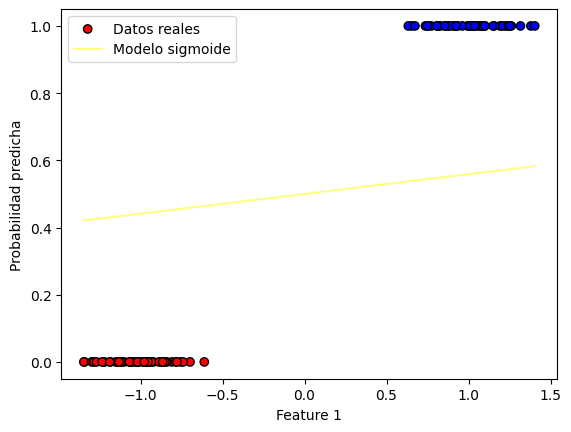

Iteracion: 50
Costo en la iteración 50: 0.581154484984912
Valor del gradiente 50: [-0.00071083 -0.44252721]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [1.90117447e-04 2.41047015e-01]


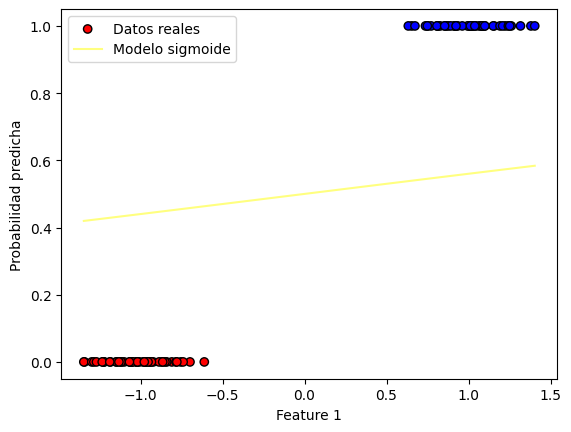

Iteracion: 51
Costo en la iteración 51: 0.5791987018893537
Valor del gradiente 51: [-0.0007229  -0.44138601]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [1.97346464e-04 2.45460875e-01]


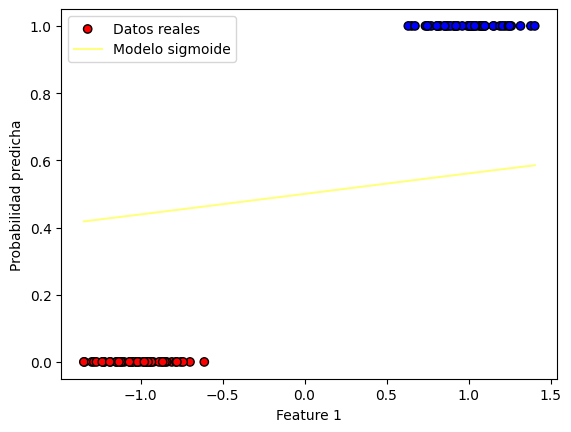

Iteracion: 52
Costo en la iteración 52: 0.5772529913280396
Valor del gradiente 52: [-0.00073489 -0.44024845]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [2.04695337e-04 2.49863360e-01]


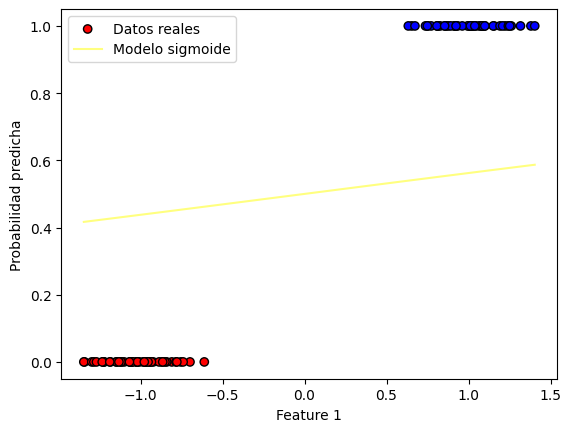

Iteracion: 53
Costo en la iteración 53: 0.575317295189319
Valor del gradiente 53: [-0.00074679 -0.43911454]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [2.12163252e-04 2.54254505e-01]


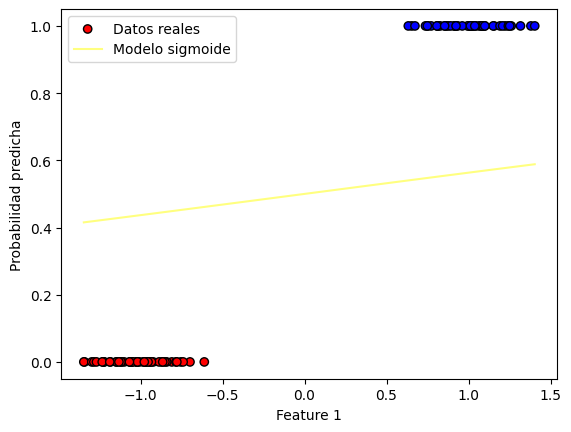

Iteracion: 54
Costo en la iteración 54: 0.5733915556341828
Valor del gradiente 54: [-0.00075861 -0.43798427]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [2.19749395e-04 2.58634348e-01]


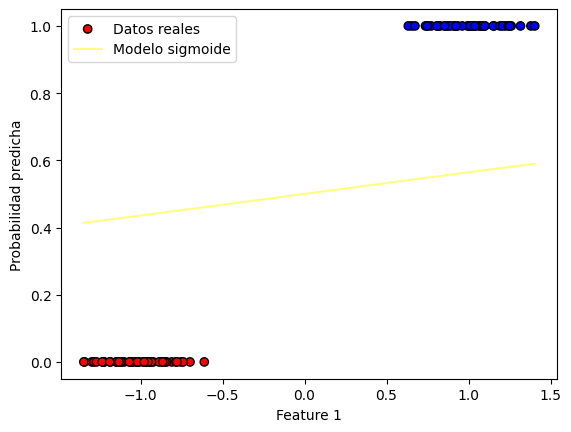

Iteracion: 55
Costo en la iteración 55: 0.5714757150967761
Valor del gradiente 55: [-0.00077036 -0.43685765]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [2.27452956e-04 2.63002924e-01]


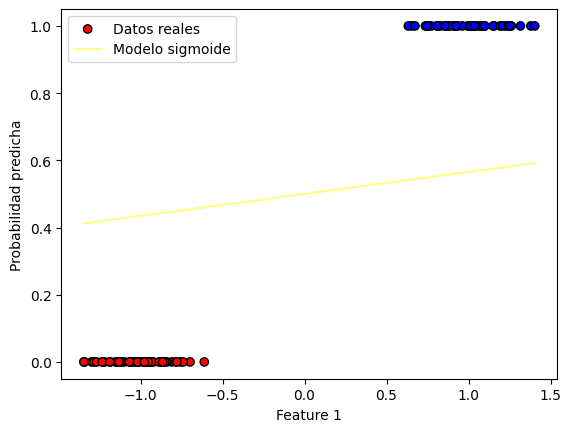

Iteracion: 56
Costo en la iteración 56: 0.5695697162848672
Valor del gradiente 56: [-0.00078202 -0.43573466]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [2.35273126e-04 2.67360271e-01]


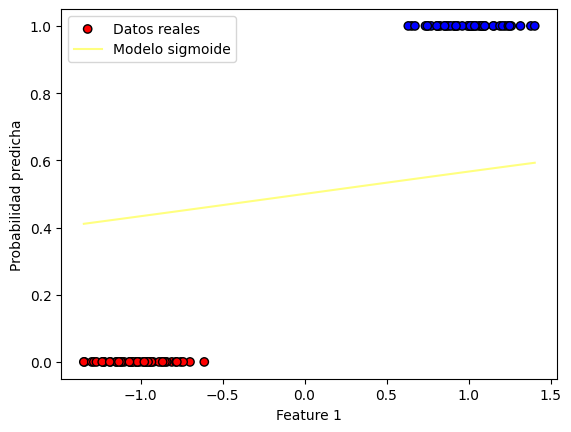

Iteracion: 57
Costo en la iteración 57: 0.567673502180276
Valor del gradiente 57: [-0.0007936 -0.4346153]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [2.43209098e-04 2.71706424e-01]


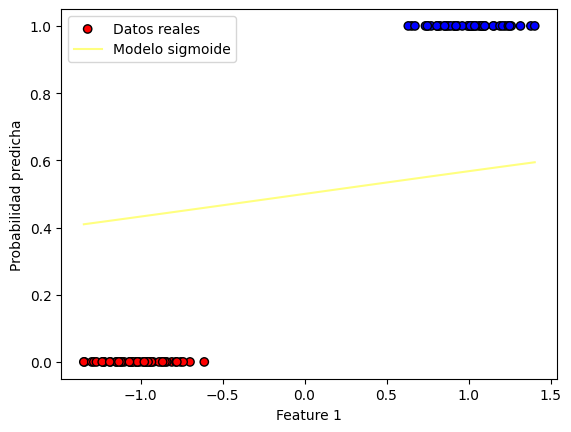

Iteracion: 58
Costo en la iteración 58: 0.5657870160392586
Valor del gradiente 58: [-0.0008051  -0.43349958]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [2.5126007e-04 2.7604142e-01]


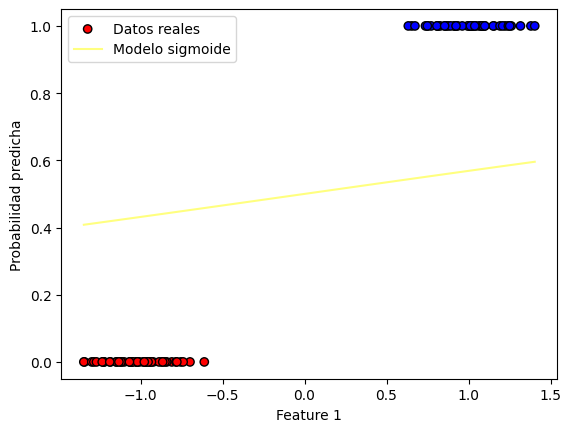

Iteracion: 59
Costo en la iteración 59: 0.5639102013928534
Valor del gradiente 59: [-0.00081652 -0.43238748]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [2.59425240e-04 2.80365295e-01]


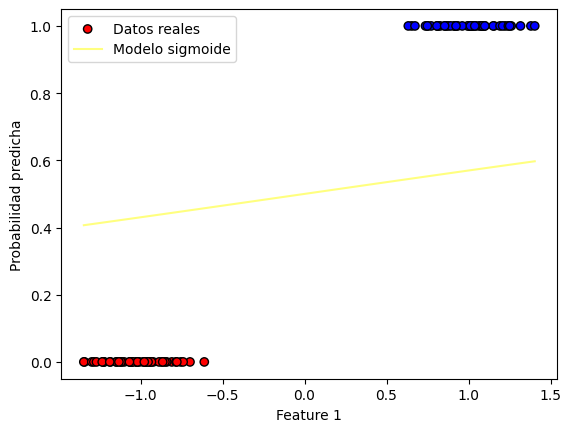

Iteracion: 60
Costo en la iteración 60: 0.562043002047186
Valor del gradiente 60: [-0.00082786 -0.43127901]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [2.67703810e-04 2.84678085e-01]


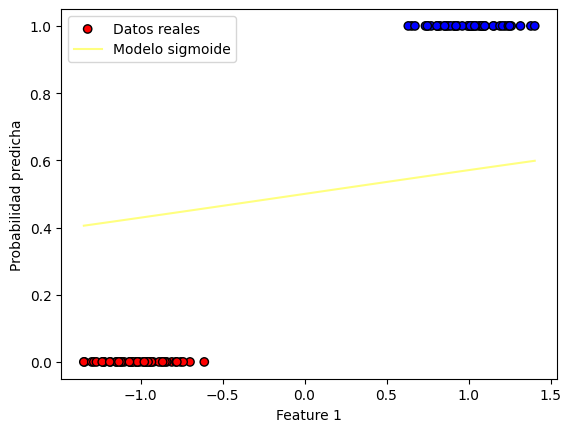

Iteracion: 61
Costo en la iteración 61: 0.5601853620837354
Valor del gradiente 61: [-0.00083912 -0.43017416]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [2.76094983e-04 2.88979826e-01]


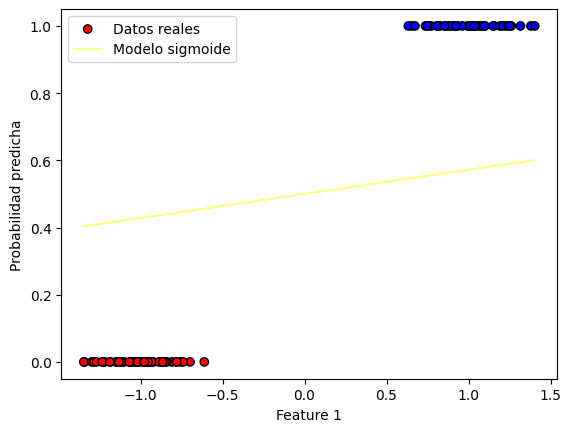

Iteracion: 62
Costo en la iteración 62: 0.5583372258595618
Valor del gradiente 62: [-0.0008503  -0.42907292]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [2.84597968e-04 2.93270555e-01]


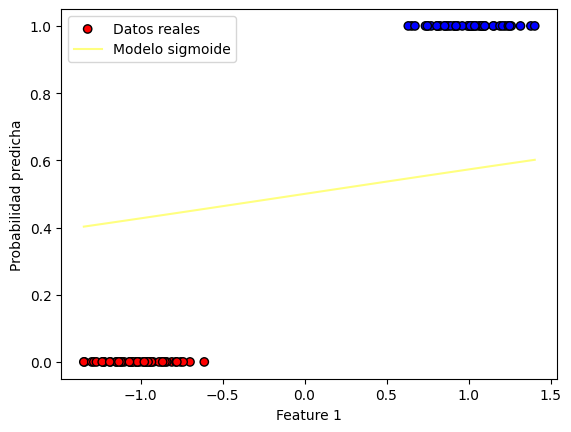

Iteracion: 63
Costo en la iteración 63: 0.5564985380074966
Valor del gradiente 63: [-0.0008614  -0.42797529]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [2.93211972e-04 2.97550308e-01]


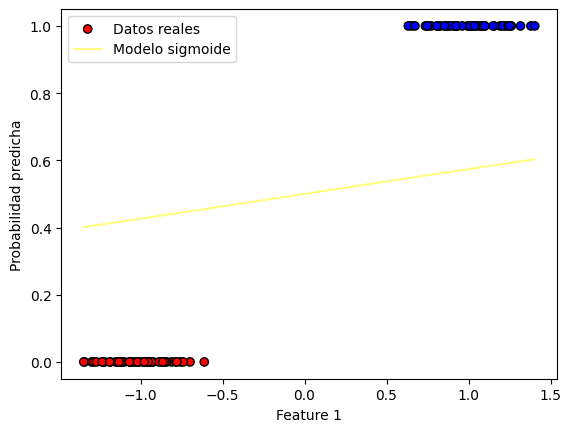

Iteracion: 64
Costo en la iteración 64: 0.5546692434362943
Valor del gradiente 64: [-0.00087242 -0.42688126]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00030194 0.30181912]


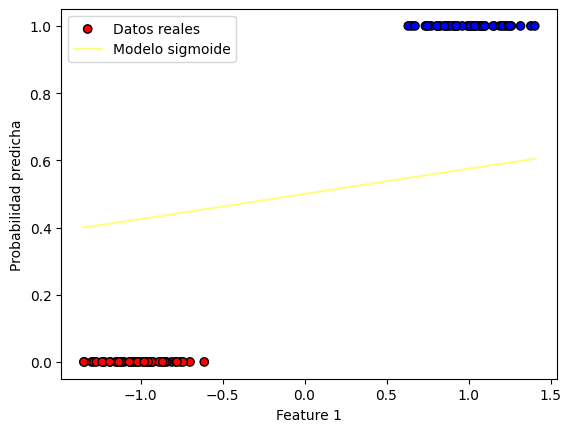

Iteracion: 65
Costo en la iteración 65: 0.5528492873307501
Valor del gradiente 65: [-0.00088337 -0.42579084]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00031077 0.30607703]


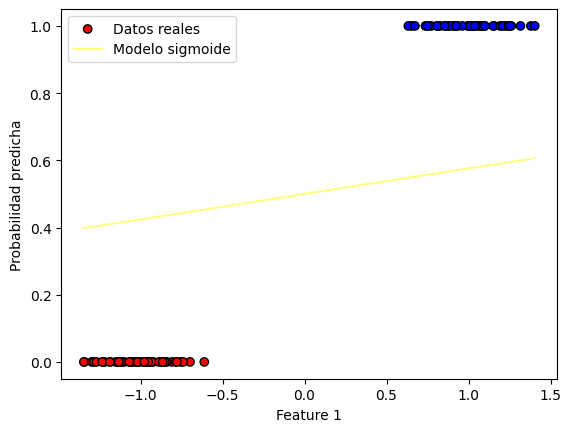

Iteracion: 66
Costo en la iteración 66: 0.5510386151517801
Valor del gradiente 66: [-0.00089423 -0.42470402]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00031971 0.31032407]


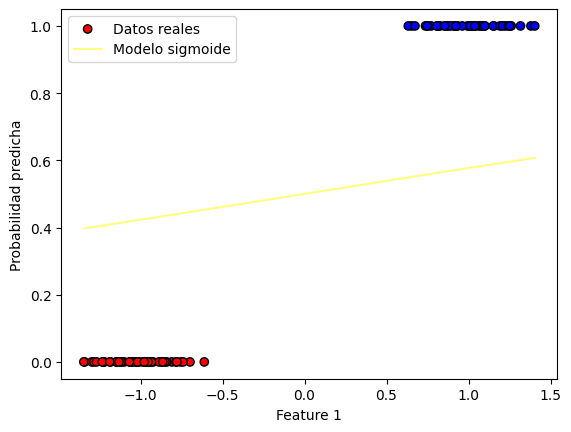

Iteracion: 67
Costo en la iteración 67: 0.5492371726364669
Valor del gradiente 67: [-0.00090502 -0.42362078]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00032876 0.31456028]


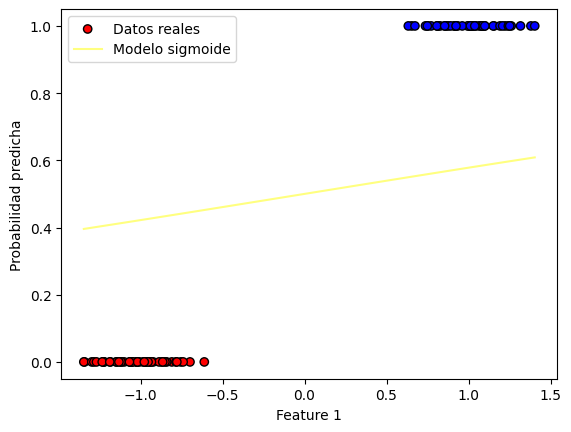

Iteracion: 68
Costo en la iteración 68: 0.547444905798072
Valor del gradiente 68: [-0.00091573 -0.42254114]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00033792 0.31878569]


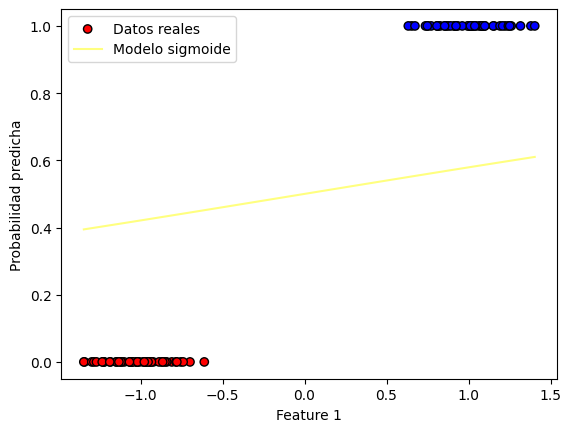

Iteracion: 69
Costo en la iteración 69: 0.5456617609260127
Valor del gradiente 69: [-0.00092637 -0.42146507]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00034718 0.32300034]


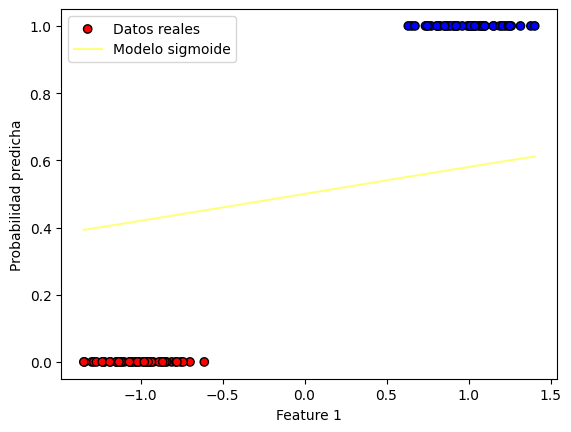

Iteracion: 70
Costo en la iteración 70: 0.5438876845858084
Valor del gradiente 70: [-0.00093692 -0.42039259]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00035655 0.32720427]


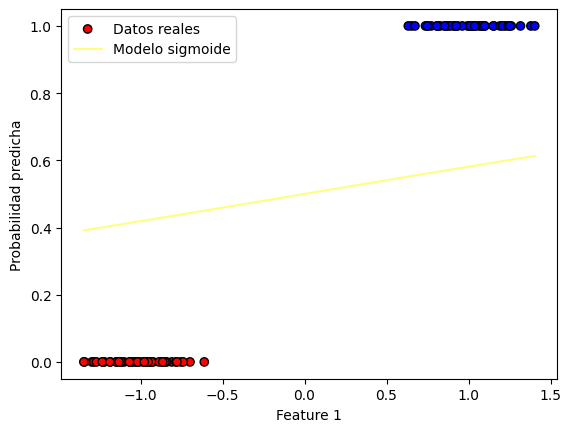

Iteracion: 71
Costo en la iteración 71: 0.5421226236189918
Valor del gradiente 71: [-0.0009474  -0.41932367]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00036603 0.3313975 ]


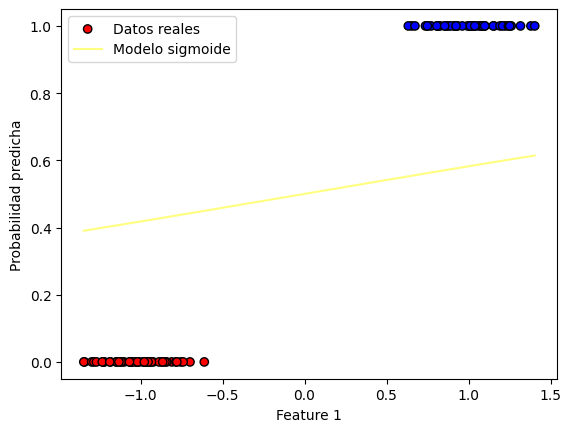

Iteracion: 72
Costo en la iteración 72: 0.5403665251429911
Valor del gradiente 72: [-0.00095781 -0.41825832]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.0003756  0.33558009]


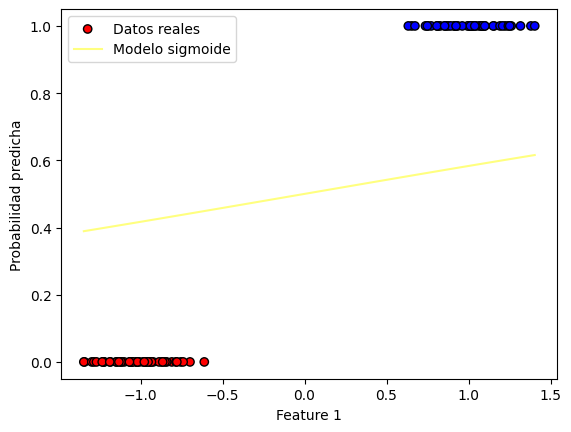

Iteracion: 73
Costo en la iteración 73: 0.5386193365509805
Valor del gradiente 73: [-0.00096813 -0.41719652]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00038529 0.33975205]


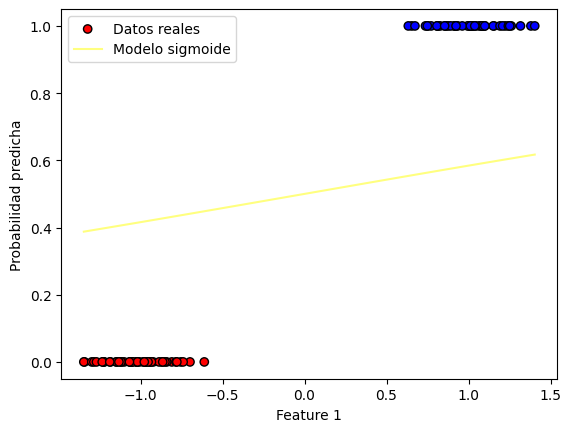

Iteracion: 74
Costo en la iteración 74: 0.5368810055116987
Valor del gradiente 74: [-0.00097838 -0.41613828]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00039507 0.34391343]


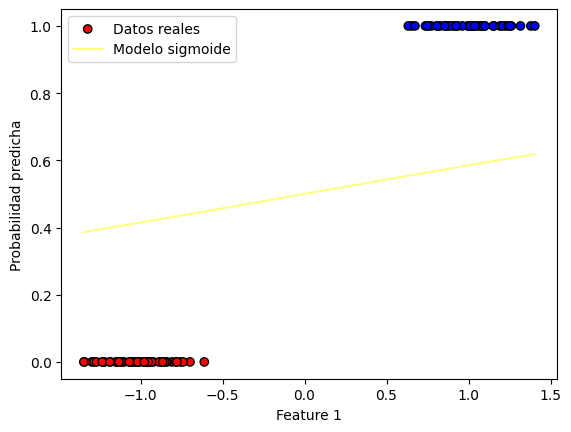

Iteracion: 75
Costo en la iteración 75: 0.5351514799692411
Valor del gradiente 75: [-0.00098856 -0.41508359]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00040496 0.34806427]


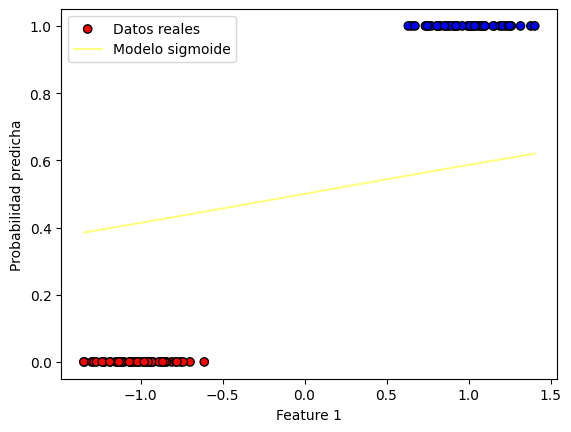

Iteracion: 76
Costo en la iteración 76: 0.5334307081428186
Valor del gradiente 76: [-0.00099866 -0.41403244]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00041494 0.35220459]


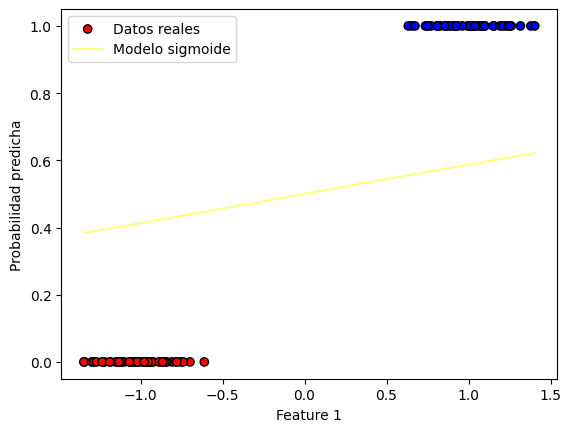

Iteracion: 77
Costo en la iteración 77: 0.5317186385264924
Valor del gradiente 77: [-0.00100869 -0.41298483]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00042503 0.35633444]


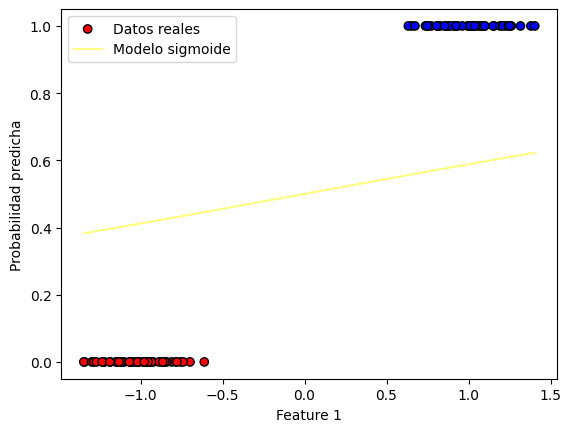

Iteracion: 78
Costo en la iteración 78: 0.5300152198888783
Valor del gradiente 78: [-0.00101864 -0.41194074]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00043522 0.36045385]


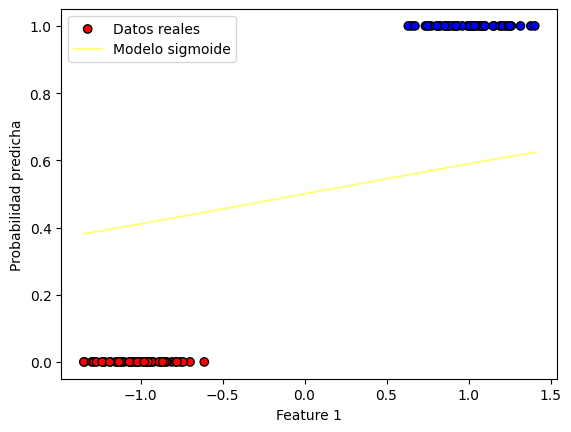

Iteracion: 79
Costo en la iteración 79: 0.5283204012728236
Valor del gradiente 79: [-0.00102851 -0.41090018]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.0004455  0.36456285]


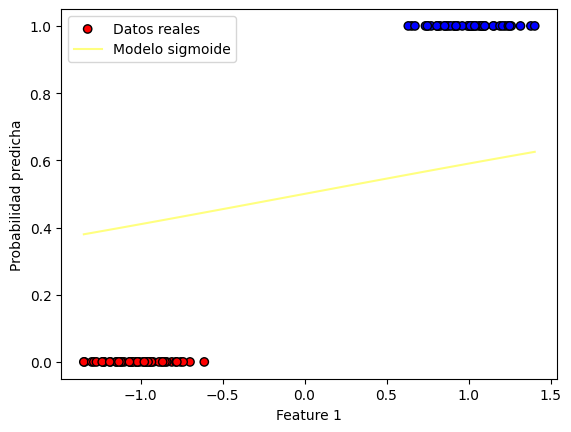

Iteracion: 80
Costo en la iteración 80: 0.5266341319950598
Valor del gradiente 80: [-0.00103831 -0.40986313]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00045588 0.36866148]


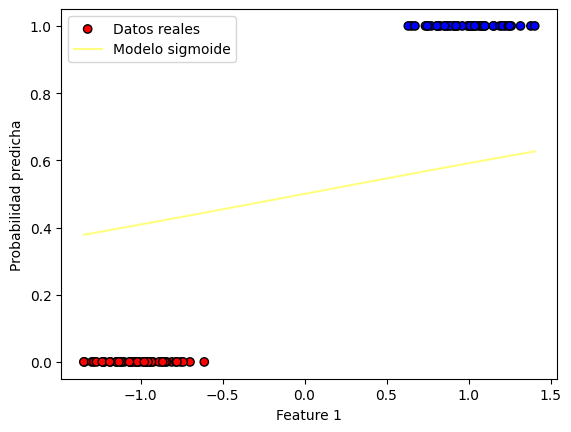

Iteracion: 81
Costo en la iteración 81: 0.5249563616458263
Valor del gradiente 81: [-0.00104804 -0.40882959]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00046636 0.37274978]


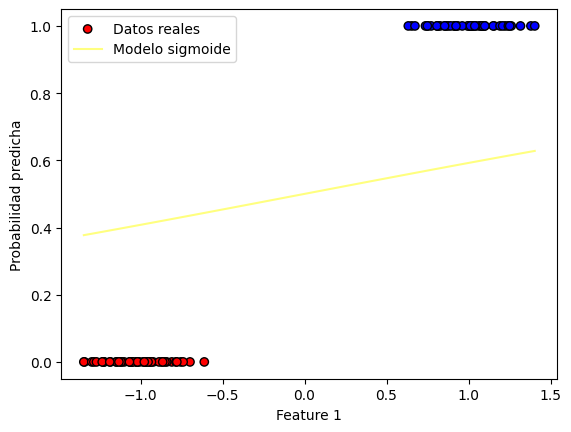

Iteracion: 82
Costo en la iteración 82: 0.5232870400884714
Valor del gradiente 82: [-0.0010577  -0.40779956]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00047694 0.37682777]


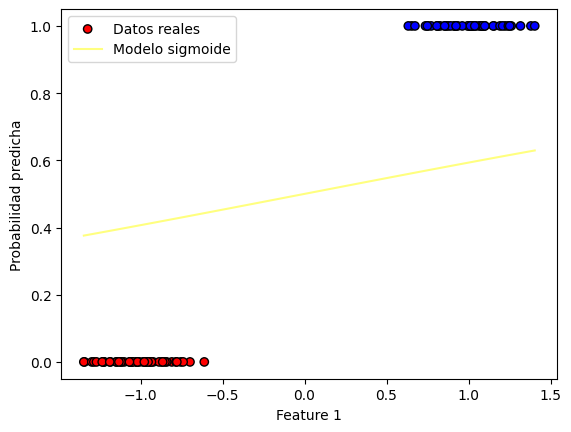

Iteracion: 83
Costo en la iteración 83: 0.5216261174590267
Valor del gradiente 83: [-0.00106728 -0.40677302]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00048761 0.3808955 ]


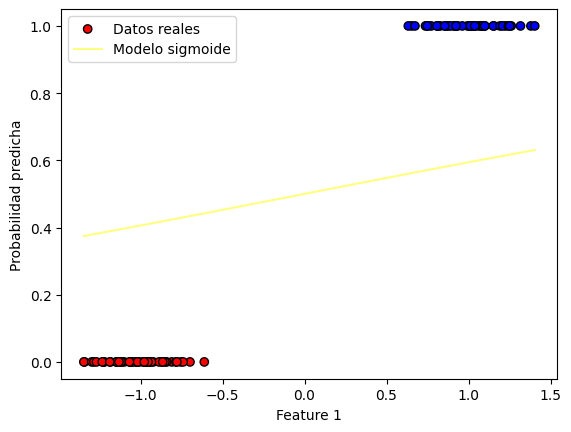

Iteracion: 84
Costo en la iteración 84: 0.5199735441657574
Valor del gradiente 84: [-0.00107679 -0.40574997]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00049838 0.384953  ]


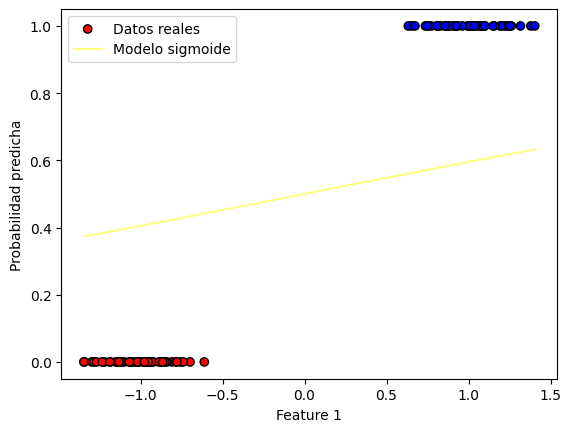

Iteracion: 85
Costo en la iteración 85: 0.5183292708886902
Valor del gradiente 85: [-0.00108623 -0.4047304 ]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00050924 0.38900031]


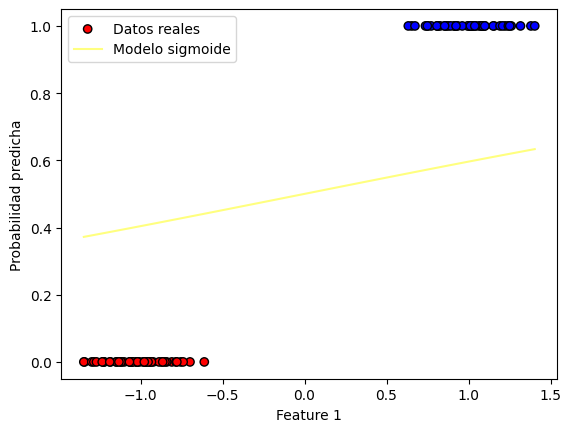

Iteracion: 86
Costo en la iteración 86: 0.5166932485791164
Valor del gradiente 86: [-0.00109559 -0.40371431]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.0005202  0.39303745]


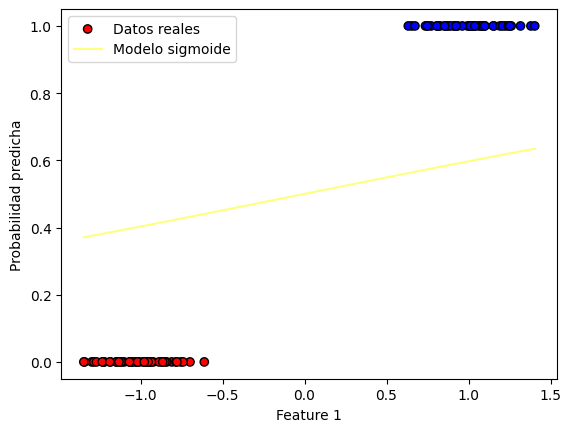

Iteracion: 87
Costo en la iteración 87: 0.515065428459074
Valor del gradiente 87: [-0.00110488 -0.40270168]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00053125 0.39706447]


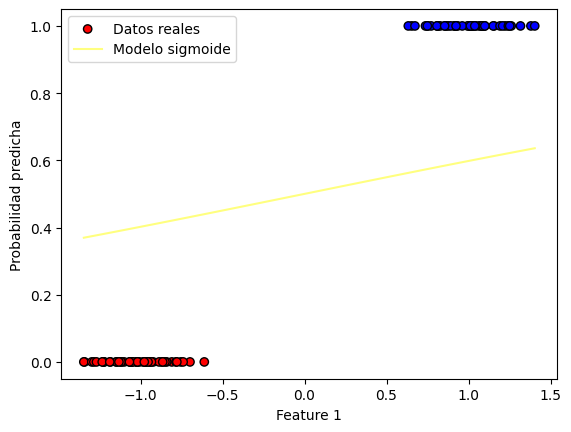

Iteracion: 88
Costo en la iteración 88: 0.5134457620208062
Valor del gradiente 88: [-0.00111411 -0.40169252]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00054239 0.40108139]


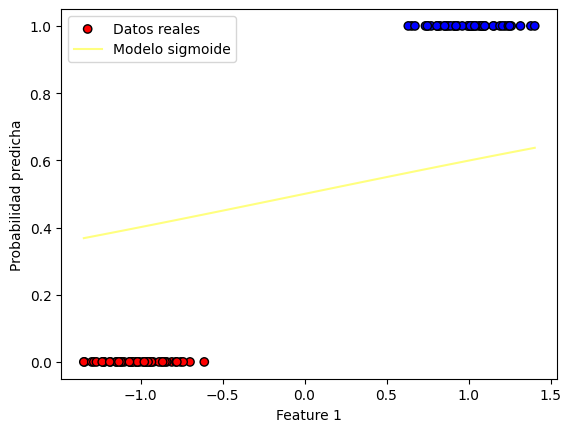

Iteracion: 89
Costo en la iteración 89: 0.5118342010261996
Valor del gradiente 89: [-0.00112326 -0.4006868 ]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00055362 0.40508826]


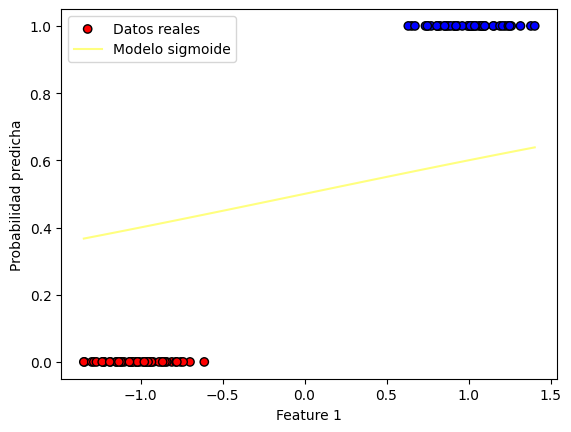

Iteracion: 90
Costo en la iteración 90: 0.5102306975062012
Valor del gradiente 90: [-0.00113234 -0.39968453]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00056495 0.40908511]


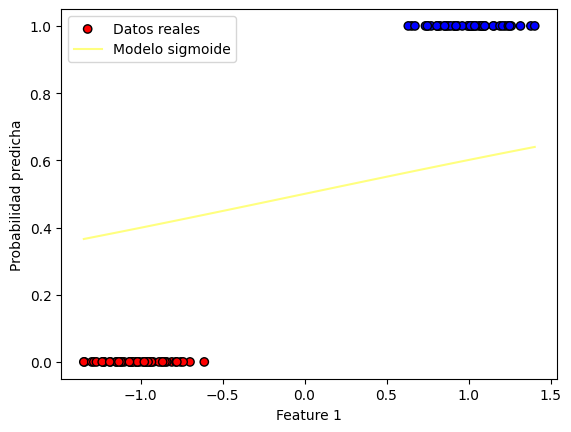

Iteracion: 91
Costo en la iteración 91: 0.5086352037602146
Valor del gradiente 91: [-0.00114134 -0.3986857 ]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00057636 0.41307196]


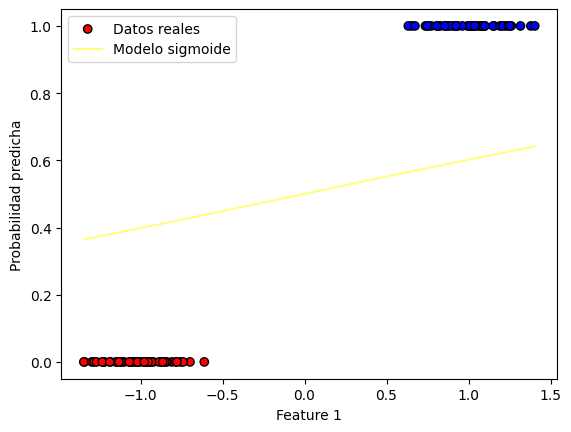

Iteracion: 92
Costo en la iteración 92: 0.5070476723554769
Valor del gradiente 92: [-0.00115028 -0.3976903 ]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00058786 0.41704887]


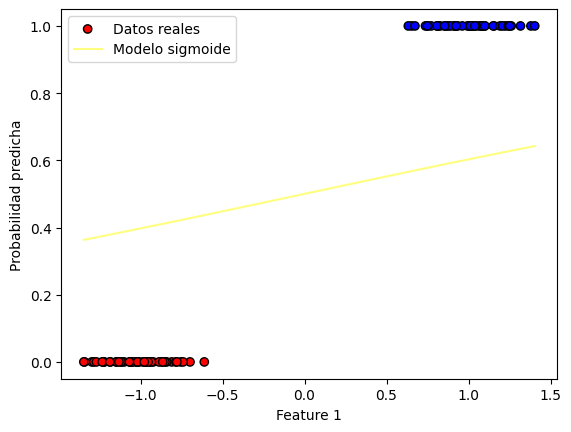

Iteracion: 93
Costo en la iteración 93: 0.505468056126415
Valor del gradiente 93: [-0.00115915 -0.39669832]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00059945 0.42101585]


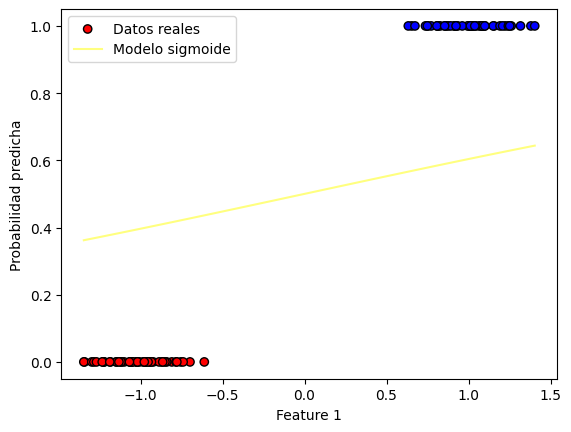

Iteracion: 94
Costo en la iteración 94: 0.5038963081739846
Valor del gradiente 94: [-0.00116795 -0.39570976]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00061113 0.42497295]


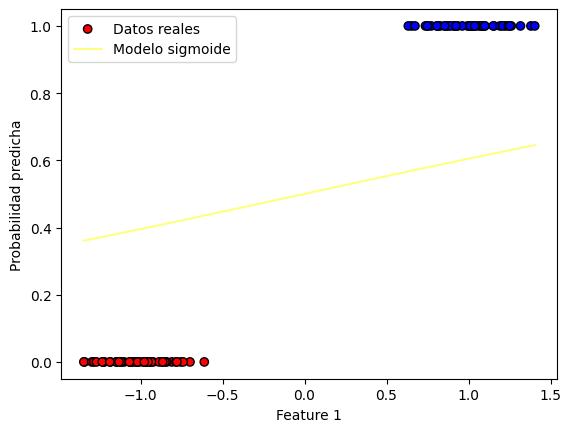

Iteracion: 95
Costo en la iteración 95: 0.5023323818649894
Valor del gradiente 95: [-0.00117668 -0.3947246 ]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.0006229  0.42892019]


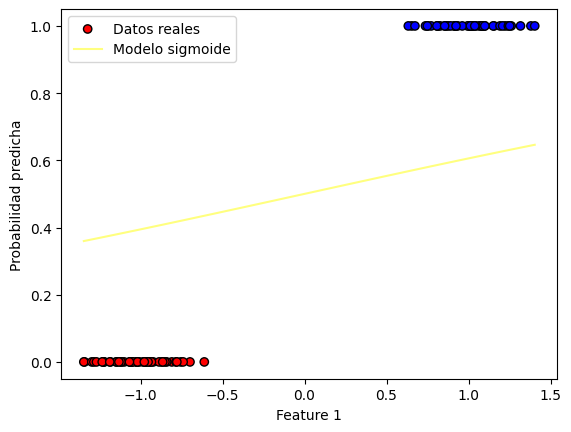

Iteracion: 96
Costo en la iteración 96: 0.5007762308313836
Valor del gradiente 96: [-0.00118535 -0.39374284]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00063475 0.43285762]


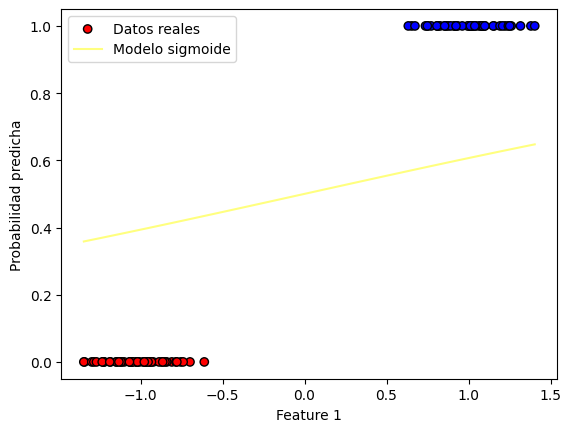

Iteracion: 97
Costo en la iteración 97: 0.49922780896955554
Valor del gradiente 97: [-0.00119394 -0.39276446]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00064669 0.43678527]


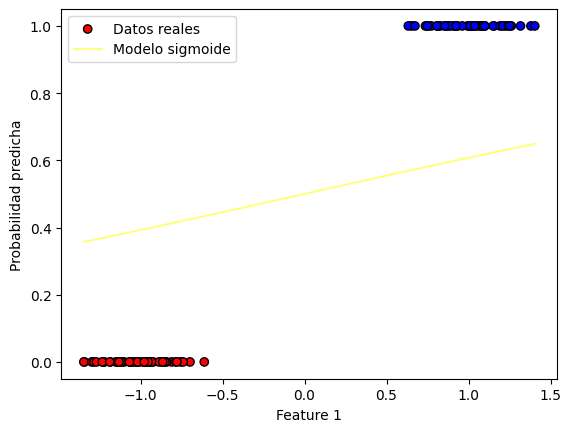

Iteracion: 98
Costo en la iteración 98: 0.49768707043959637
Valor del gradiente 98: [-0.00120246 -0.39178947]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00065872 0.44070316]


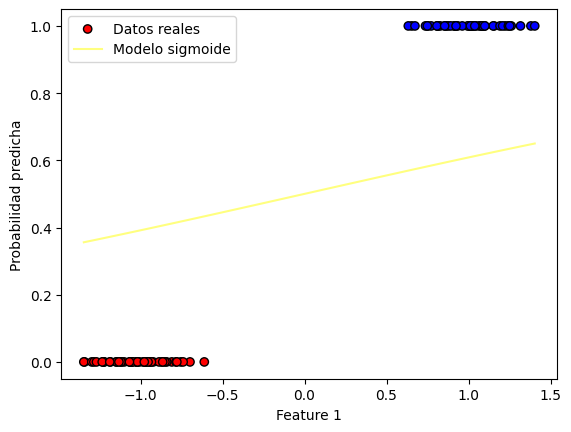

Iteracion: 99
Costo en la iteración 99: 0.49615396966454944
Valor del gradiente 99: [-0.00121092 -0.39081786]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00067083 0.44461134]


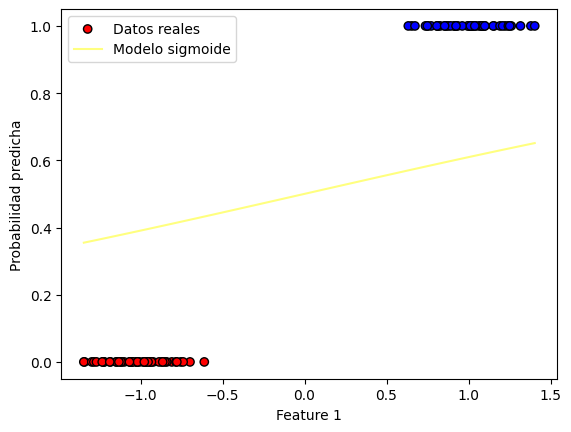

Iteracion: 100
Costo en la iteración 100: 0.4946284613296468
Valor del gradiente 100: [-0.00121931 -0.38984961]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00068302 0.44850984]


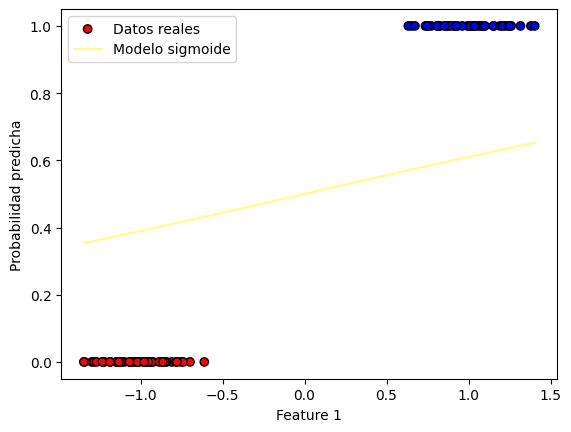

Iteracion: 101
Costo en la iteración 101: 0.49311050038152693
Valor del gradiente 101: [-0.00122764 -0.38888471]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.0006953  0.45239868]


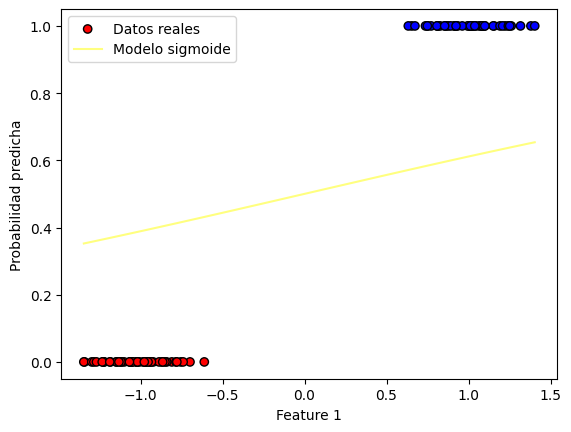

Iteracion: 102
Costo en la iteración 102: 0.49160004202744073
Valor del gradiente 102: [-0.00123589 -0.38792317]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00070766 0.45627791]


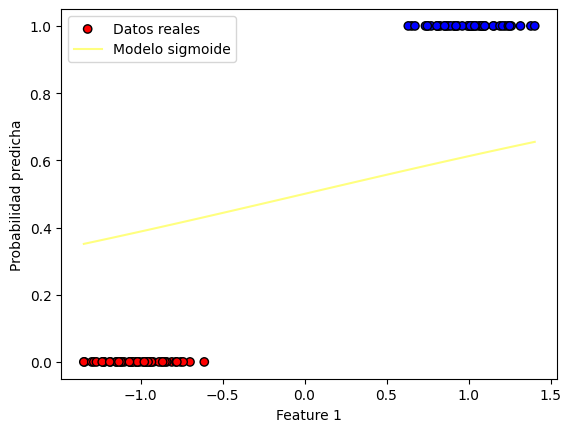

Iteracion: 103
Costo en la iteración 103: 0.49009704173443946
Valor del gradiente 103: [-0.00124408 -0.38696496]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.0007201  0.46014756]


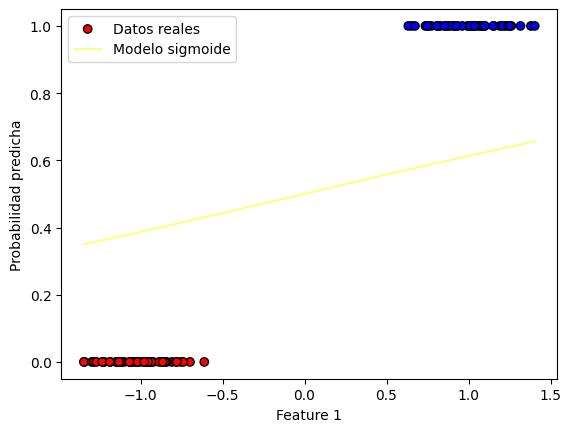

Iteracion: 104
Costo en la iteración 104: 0.48860145522855114
Valor del gradiente 104: [-0.00125221 -0.38601009]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00073262 0.46400766]


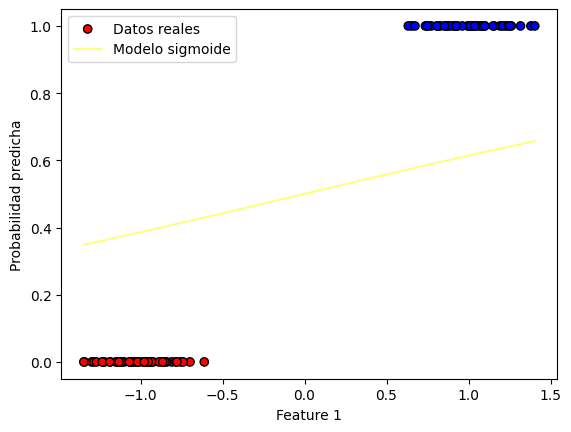

Iteracion: 105
Costo en la iteración 105: 0.4871132384939412
Valor del gradiente 105: [-0.00126027 -0.38505853]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00074522 0.46785825]


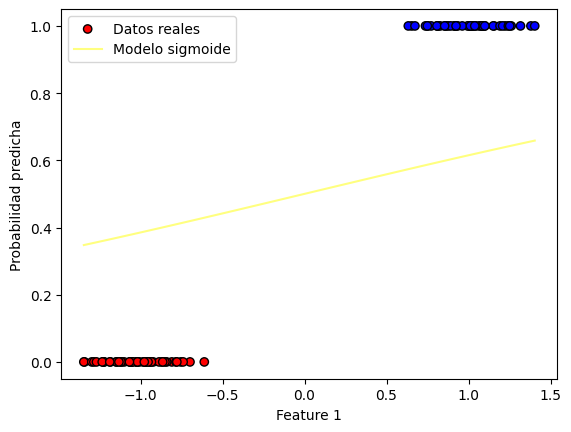

Iteracion: 106
Costo en la iteración 106: 0.48563234777206093
Valor del gradiente 106: [-0.00126826 -0.38411029]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.0007579  0.47169935]


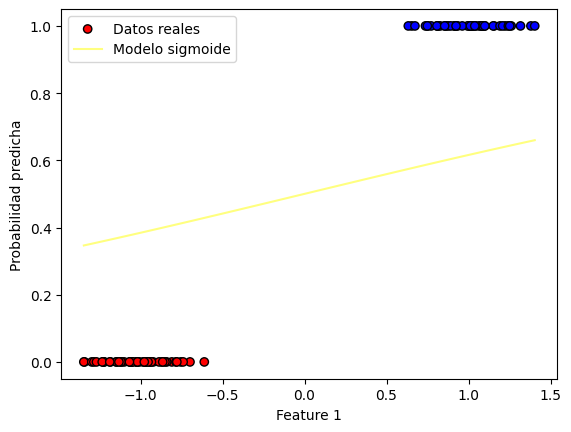

Iteracion: 107
Costo en la iteración 107: 0.48415873956078204
Valor del gradiente 107: [-0.00127619 -0.38316536]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00077067 0.47553101]


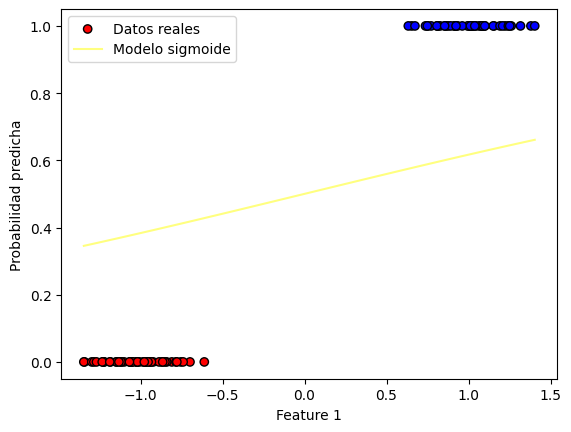

Iteracion: 108
Costo en la iteración 108: 0.48269237061351966
Valor del gradiente 108: [-0.00128405 -0.38222372]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00078351 0.47935324]


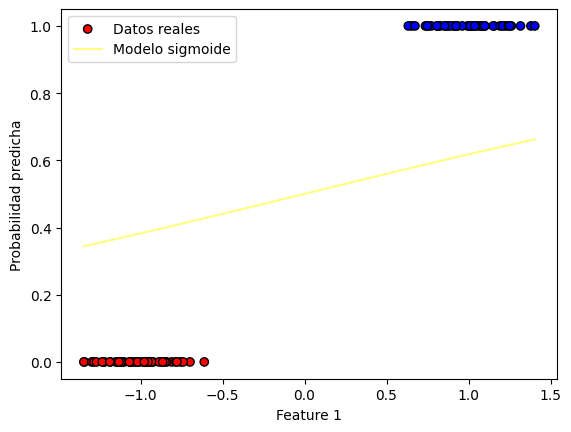

Iteracion: 109
Costo en la iteración 109: 0.4812331979383418
Valor del gradiente 109: [-0.00129185 -0.38128537]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00079642 0.4831661 ]


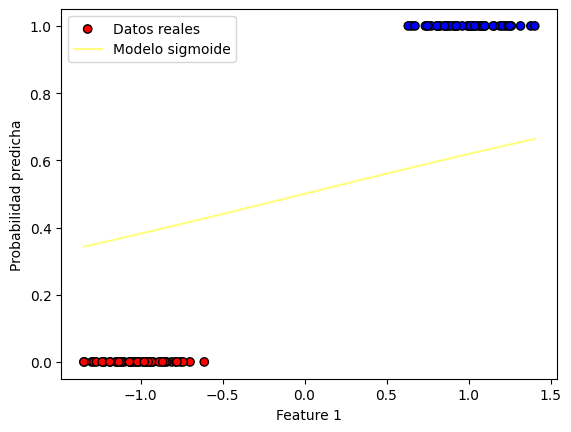

Iteracion: 110
Costo en la iteración 110: 0.47978117879706816
Valor del gradiente 110: [-0.00129959 -0.3803503 ]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00080942 0.4869696 ]


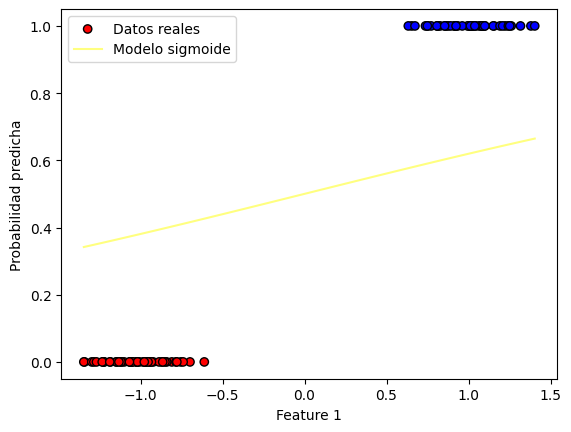

Iteracion: 111
Costo en la iteración 111: 0.47833627070435747
Valor del gradiente 111: [-0.00130726 -0.3794185 ]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00082249 0.49076379]


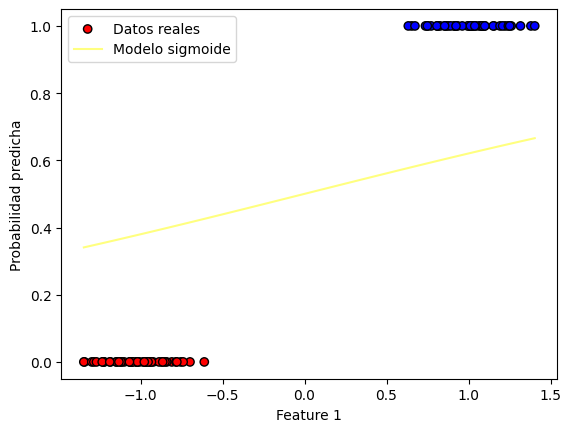

Iteracion: 112
Costo en la iteración 112: 0.47689843142678207
Valor del gradiente 112: [-0.00131487 -0.37848996]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00083564 0.49454869]


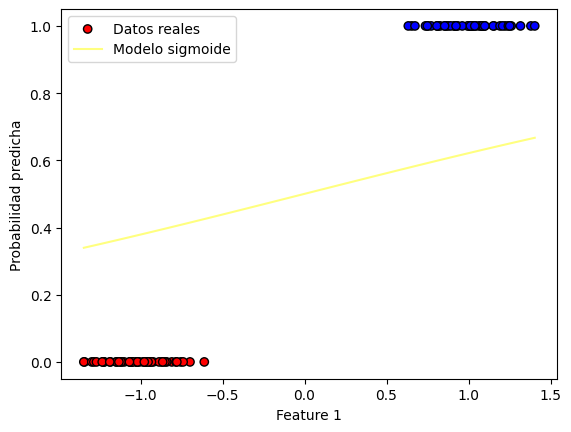

Iteracion: 113
Costo en la iteración 113: 0.47546761898189466
Valor del gradiente 113: [-0.00132241 -0.37756467]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00084887 0.49832433]


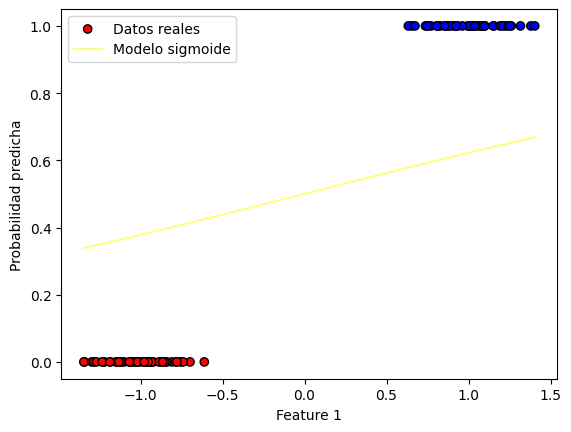

Iteracion: 114
Costo en la iteración 114: 0.47404379163728233
Valor del gradiente 114: [-0.0013299  -0.37664262]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00086216 0.50209076]


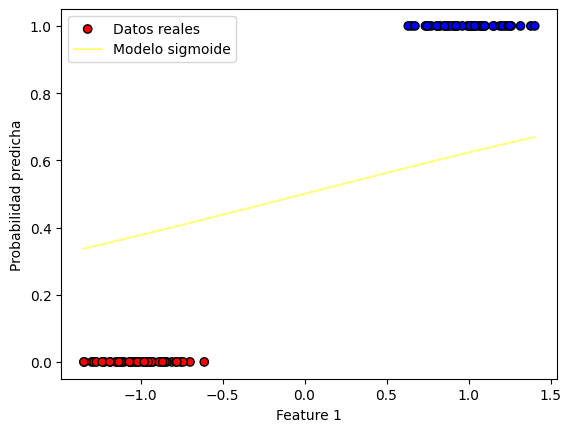

Iteracion: 115
Costo en la iteración 115: 0.47262690790961187
Valor del gradiente 115: [-0.00133732 -0.3757238 ]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00087554 0.505848  ]


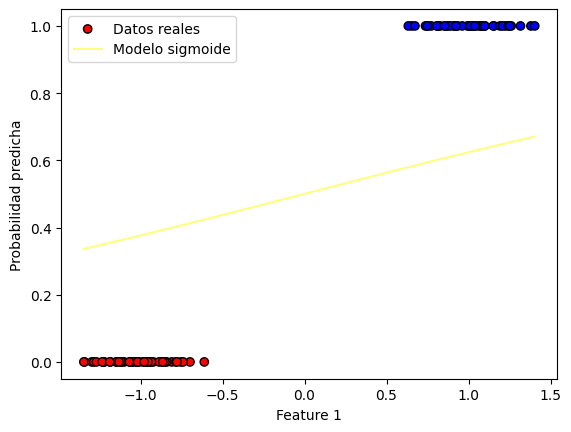

Iteracion: 116
Costo en la iteración 116: 0.47121692656366504
Valor del gradiente 116: [-0.00134468 -0.37480821]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00088898 0.50959608]


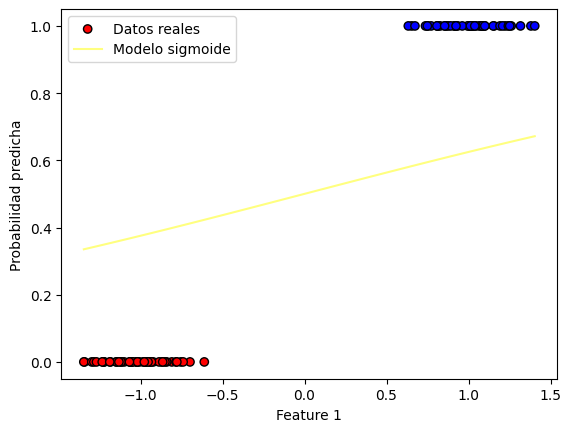

Iteracion: 117
Costo en la iteración 117: 0.46981380661136507
Valor del gradiente 117: [-0.00135197 -0.37389584]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.0009025  0.51333504]


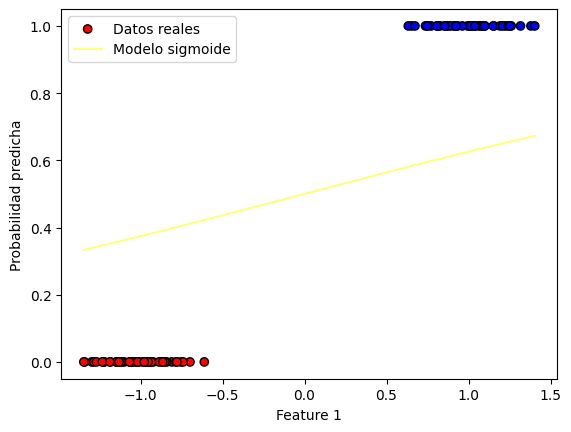

Iteracion: 118
Costo en la iteración 118: 0.4684175073107934
Valor del gradiente 118: [-0.00135921 -0.37298666]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.0009161 0.5170649]


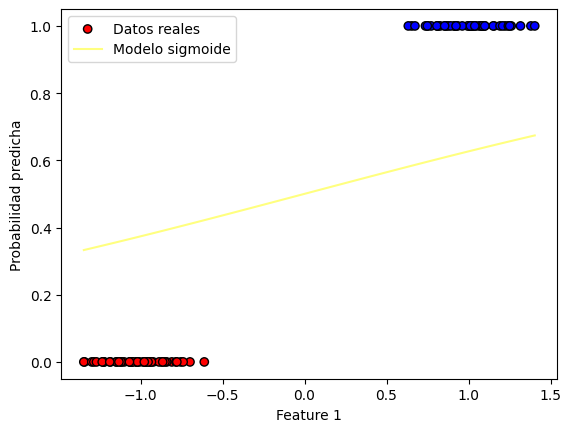

Iteracion: 119
Costo en la iteración 119: 0.46702798816519875
Valor del gradiente 119: [-0.00136638 -0.37208069]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00092976 0.52078571]


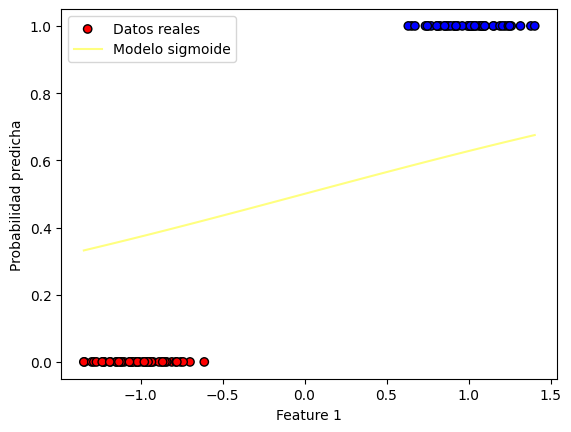

Iteracion: 120
Costo en la iteración 120: 0.4656452089219975
Valor del gradiente 120: [-0.0013735 -0.3711779]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00094349 0.52449749]


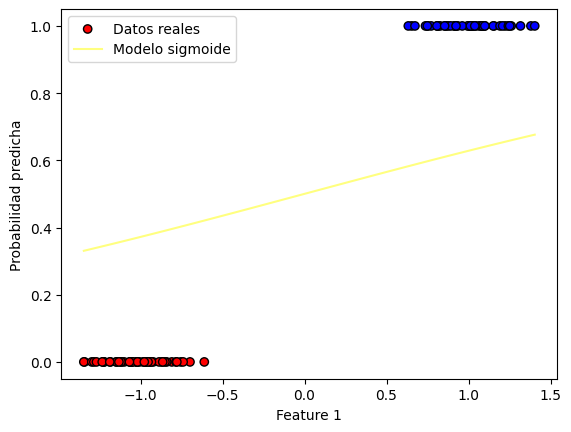

Iteracion: 121
Costo en la iteración 121: 0.46426912957176675
Valor del gradiente 121: [-0.00138055 -0.37027829]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.0009573  0.52820027]


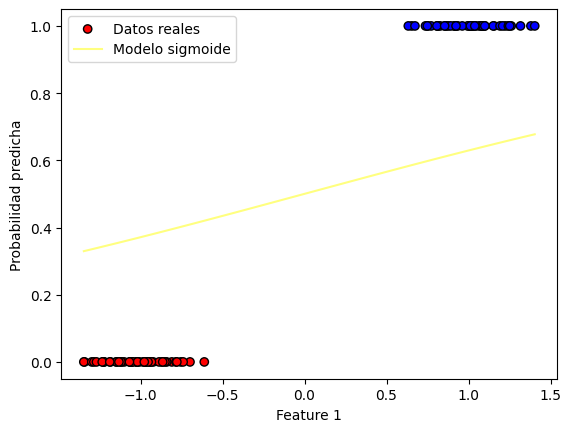

Iteracion: 122
Costo en la iteración 122: 0.4628997103472285
Valor del gradiente 122: [-0.00138755 -0.36938184]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00097118 0.53189409]


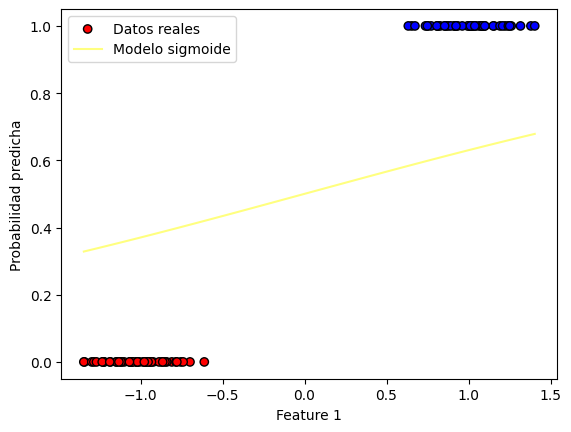

Iteracion: 123
Costo en la iteración 123: 0.46153691172222794
Valor del gradiente 123: [-0.00139449 -0.36848855]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00098512 0.53557898]


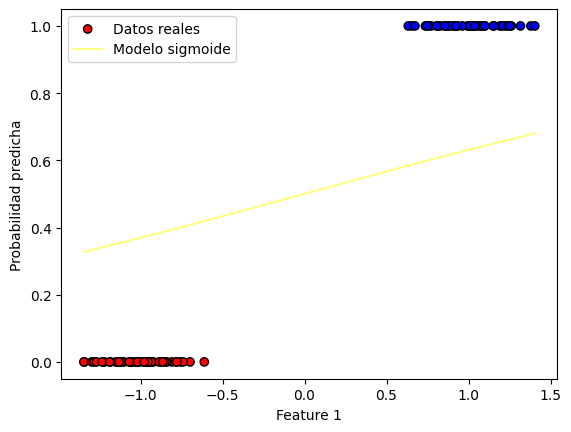

Iteracion: 124
Costo en la iteración 124: 0.46018069441070386
Valor del gradiente 124: [-0.00140136 -0.36759842]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00099913 0.53925496]


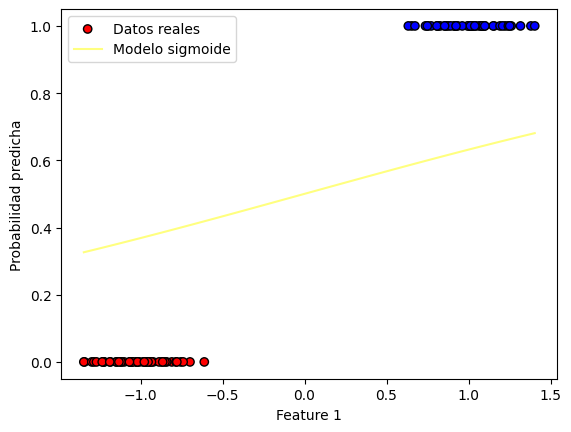

Iteracion: 125
Costo en la iteración 125: 0.45883101936565346
Valor del gradiente 125: [-0.00140818 -0.36671142]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00101322 0.54292207]


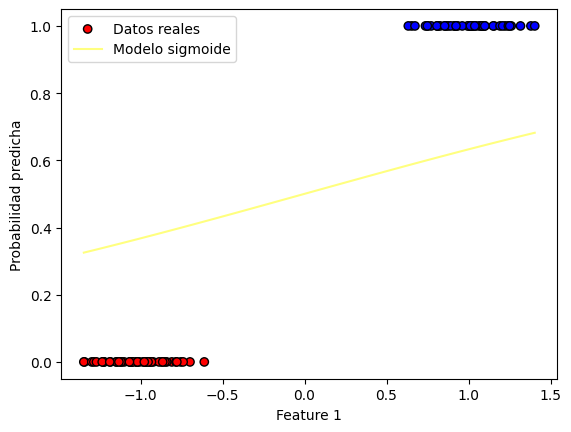

Iteracion: 126
Costo en la iteración 126: 0.4574878477780892
Valor del gradiente 126: [-0.00141494 -0.36582755]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00102737 0.54658035]


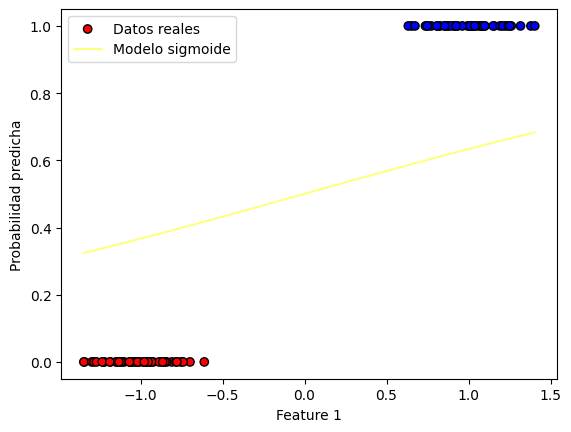

Iteracion: 127
Costo en la iteración 127: 0.456151141075991
Valor del gradiente 127: [-0.00142164 -0.3649468 ]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00104158 0.55022982]


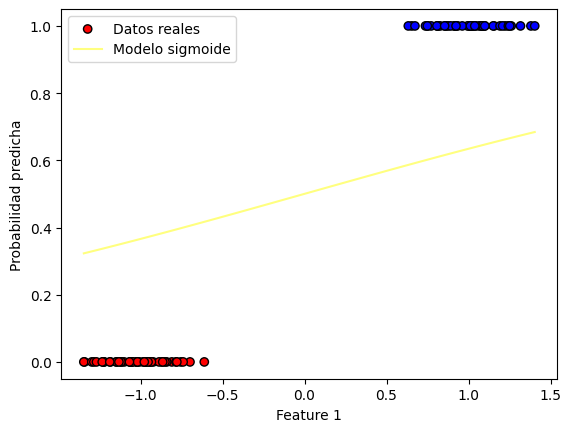

Iteracion: 128
Costo en la iteración 128: 0.45482086092325213
Valor del gradiente 128: [-0.00142828 -0.36406916]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00105586 0.55387051]


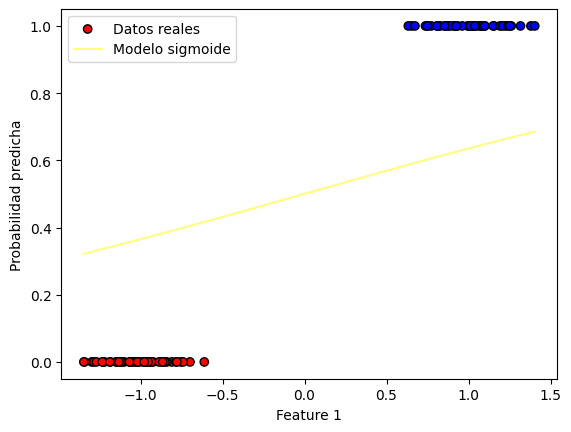

Iteracion: 129
Costo en la iteración 129: 0.453496969218619
Valor del gradiente 129: [-0.00143487 -0.36319462]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00107021 0.55750246]


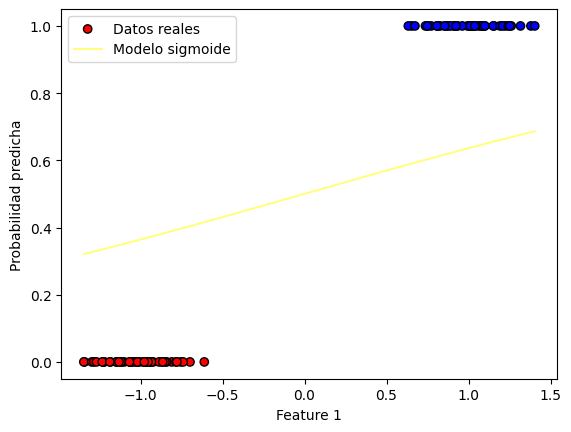

Iteracion: 130
Costo en la iteración 130: 0.4521794280946273
Valor del gradiente 130: [-0.0014414  -0.36232317]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00108463 0.56112569]


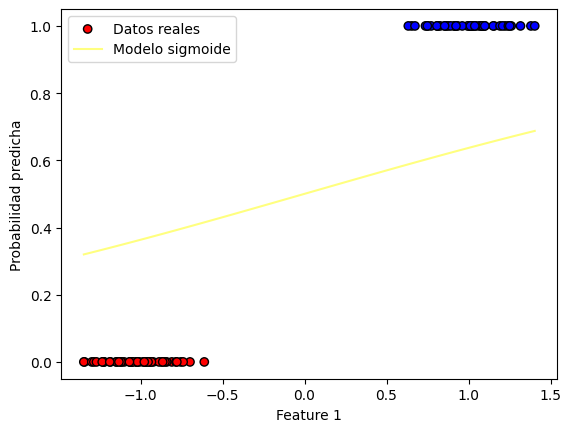

Iteracion: 131
Costo en la iteración 131: 0.45086819991653115
Valor del gradiente 131: [-0.00144787 -0.3614548 ]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00109911 0.56474024]


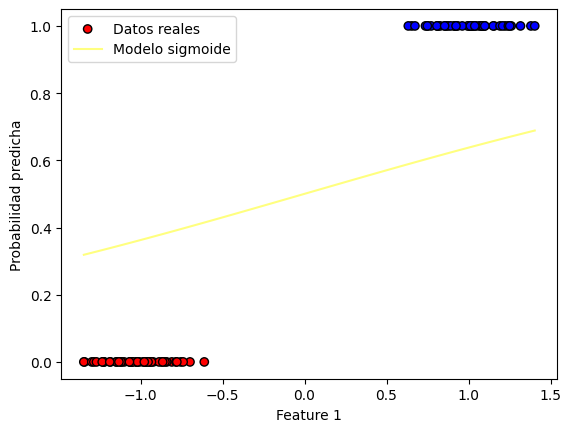

Iteracion: 132
Costo en la iteración 132: 0.44956324728122915
Valor del gradiente 132: [-0.00145429 -0.36058951]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00111365 0.56834613]


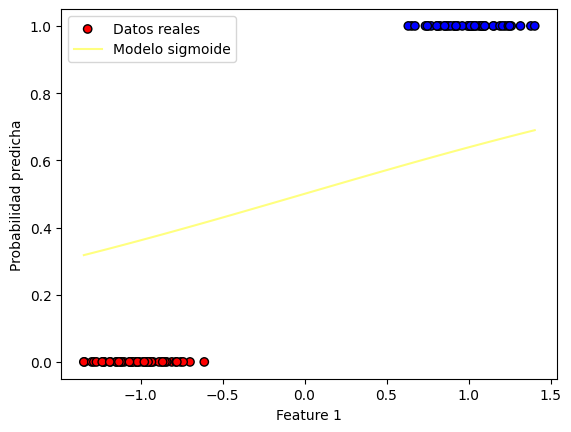

Iteracion: 133
Costo en la iteración 133: 0.44826453301618496
Valor del gradiente 133: [-0.00146065 -0.35972727]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00112826 0.5719434 ]


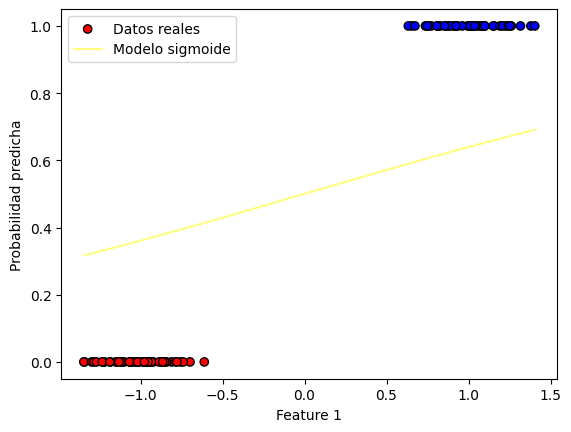

Iteracion: 134
Costo en la iteración 134: 0.4469720201783447
Valor del gradiente 134: [-0.00146695 -0.35886809]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00114293 0.57553208]


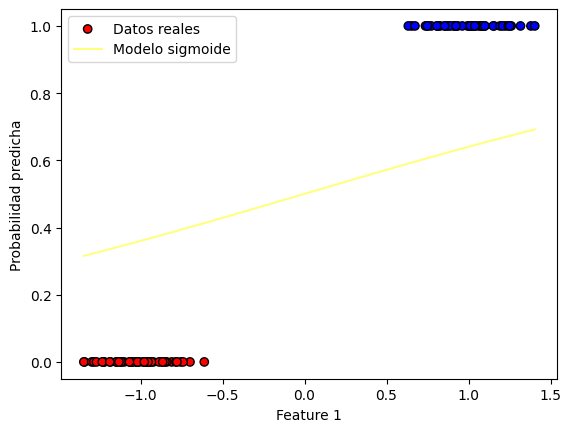

Iteracion: 135
Costo en la iteración 135: 0.44568567205304904
Valor del gradiente 135: [-0.0014732  -0.35801195]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00115766 0.5791122 ]


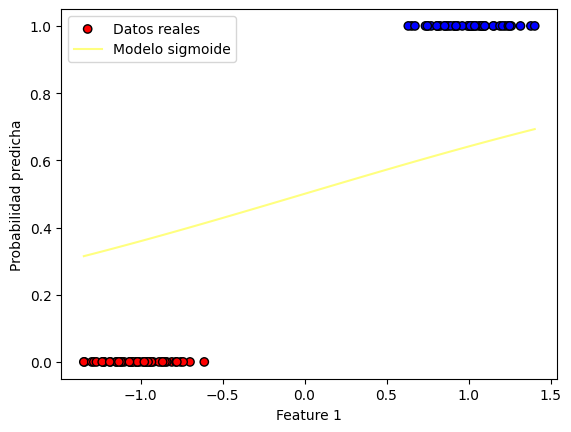

Iteracion: 136
Costo en la iteración 136: 0.4444054521529428
Valor del gradiente 136: [-0.0014794  -0.35715884]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00117245 0.58268379]


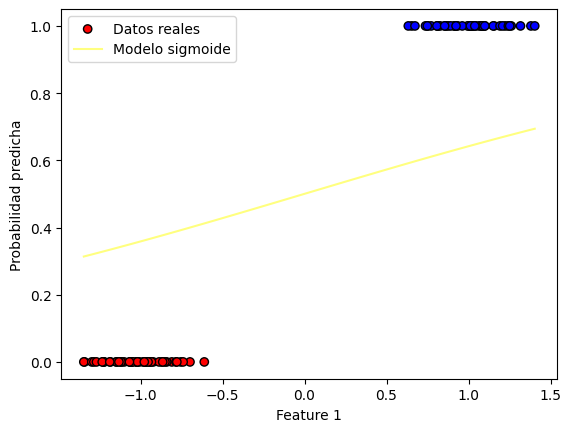

Iteracion: 137
Costo en la iteración 137: 0.44313132421688095
Valor del gradiente 137: [-0.00148554 -0.35630875]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00118731 0.58624688]


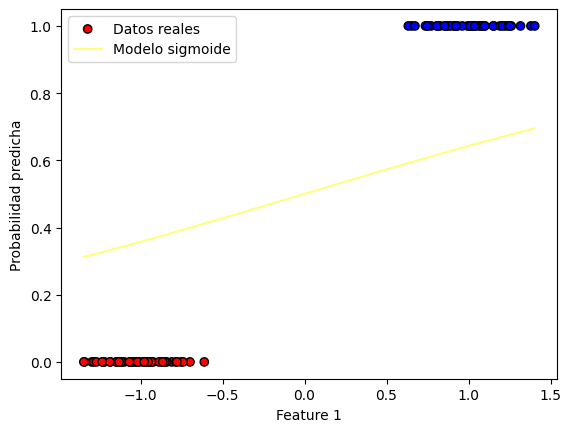

Iteracion: 138
Costo en la iteración 138: 0.44186325220883016
Valor del gradiente 138: [-0.00149162 -0.35546168]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00120222 0.5898015 ]


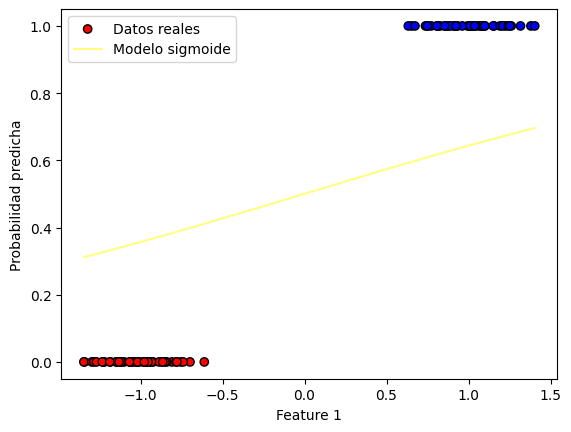

Iteracion: 139
Costo en la iteración 139: 0.440601200316769
Valor del gradiente 139: [-0.00149765 -0.35461761]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.0012172  0.59334767]


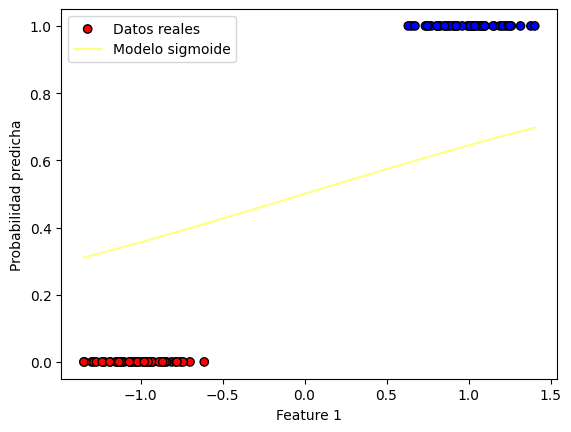

Iteracion: 140
Costo en la iteración 140: 0.43934513295158467
Valor del gradiente 140: [-0.00150363 -0.35377653]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00123224 0.59688544]


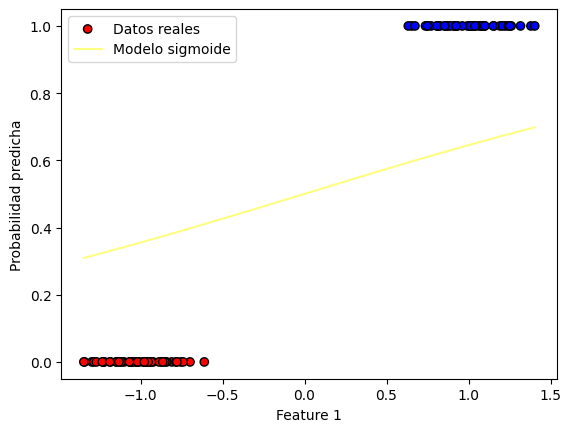

Iteracion: 141
Costo en la iteración 141: 0.4380950147459662
Valor del gradiente 141: [-0.00150955 -0.35293843]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00124733 0.60041482]


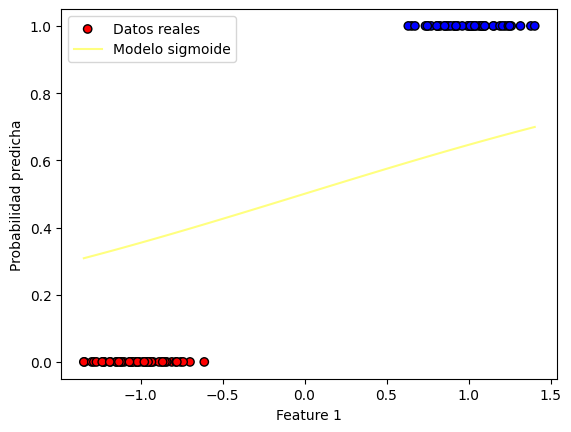

Iteracion: 142
Costo en la iteración 142: 0.4368508105532973
Valor del gradiente 142: [-0.00151542 -0.35210331]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00126249 0.60393586]


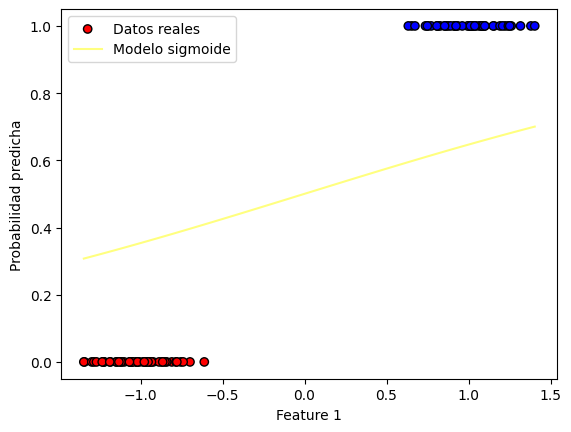

Iteracion: 143
Costo en la iteración 143: 0.43561248544654535
Valor del gradiente 143: [-0.00152124 -0.35127115]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.0012777  0.60744857]


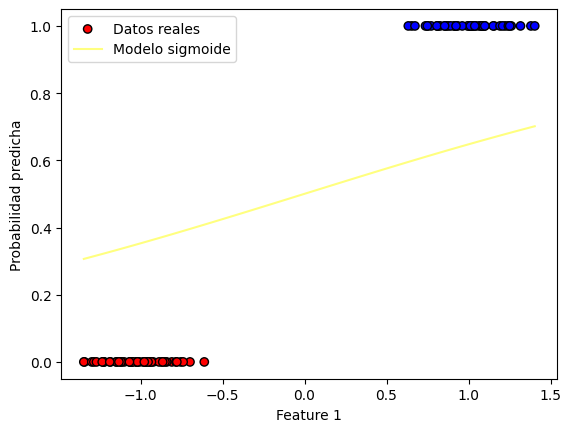

Iteracion: 144
Costo en la iteración 144: 0.4343800047171492
Valor del gradiente 144: [-0.00152701 -0.35044194]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00129297 0.61095299]


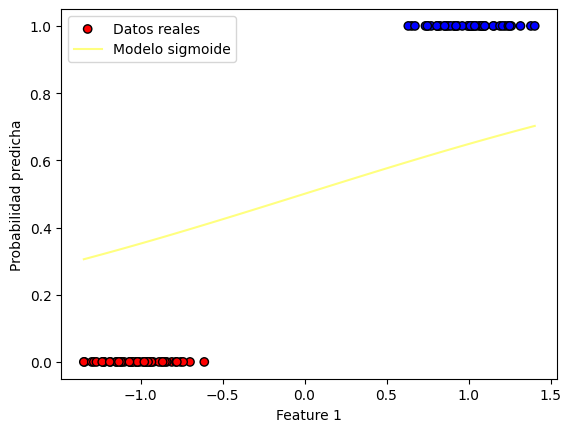

Iteracion: 145
Costo en la iteración 145: 0.43315333387390526
Valor del gradiente 145: [-0.00153272 -0.34961568]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00130829 0.61444914]


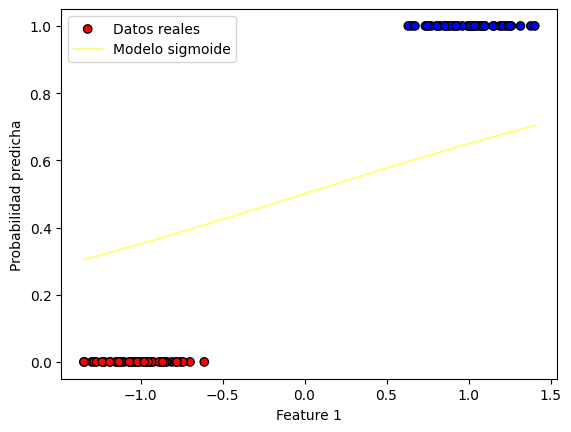

Iteracion: 146
Costo en la iteración 146: 0.4319324386418517
Valor del gradiente 146: [-0.00153838 -0.34879235]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00132368 0.61793707]


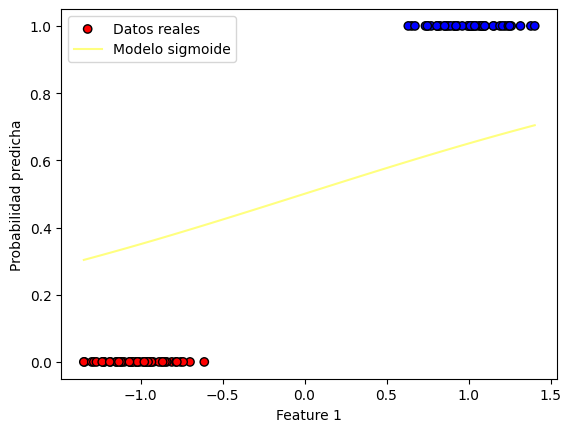

Iteracion: 147
Costo en la iteración 147: 0.4307172849611519
Valor del gradiente 147: [-0.00154399 -0.34797194]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00133912 0.62141679]


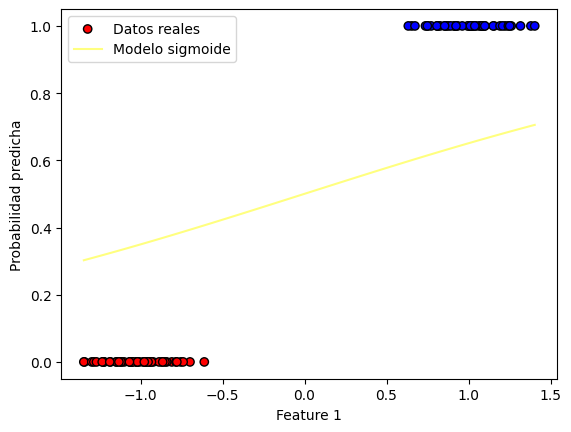

Iteracion: 148
Costo en la iteración 148: 0.4295078389859759
Valor del gradiente 148: [-0.00154955 -0.34715444]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00135461 0.62488833]


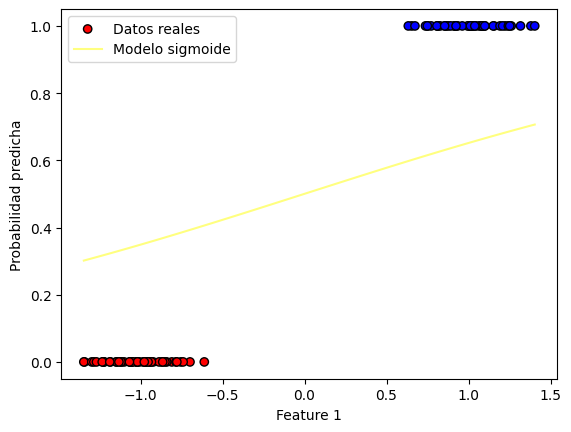

Iteracion: 149
Costo en la iteración 149: 0.4283040670833815
Valor del gradiente 149: [-0.00155506 -0.34633985]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00137016 0.62835173]


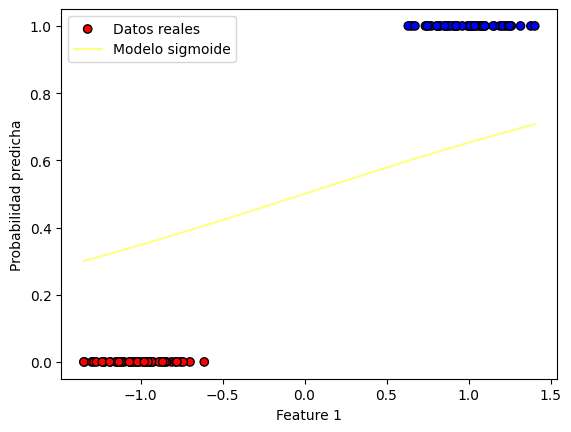

Iteracion: 150
Costo en la iteración 150: 0.42710593583219486
Valor del gradiente 150: [-0.00156052 -0.34552815]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00138577 0.63180701]


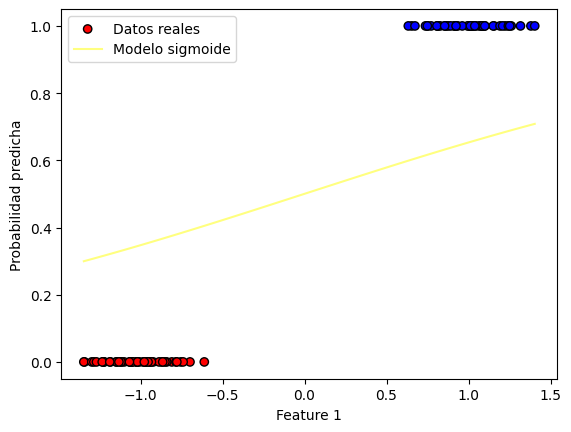

Iteracion: 151
Costo en la iteración 151: 0.4259134120218896
Valor del gradiente 151: [-0.00156593 -0.34471934]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00140143 0.6352542 ]


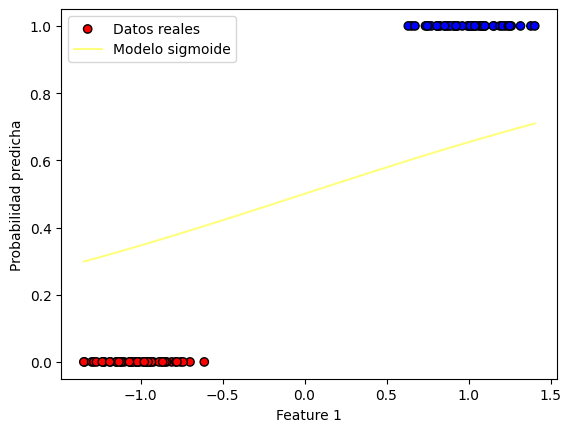

Iteracion: 152
Costo en la iteración 152: 0.4247264626514658
Valor del gradiente 152: [-0.00157129 -0.34391339]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00141714 0.63869334]


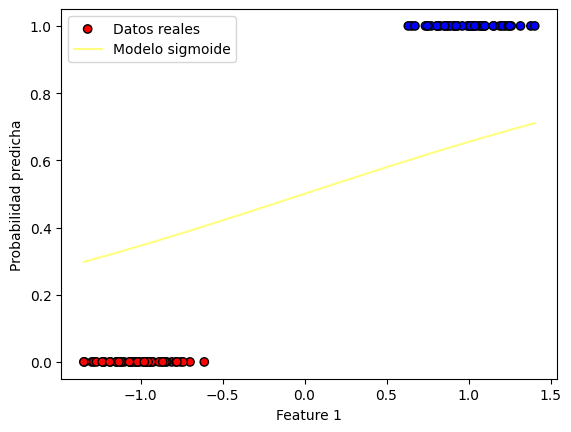

Iteracion: 153
Costo en la iteración 153: 0.4235450549283295
Valor del gradiente 153: [-0.0015766  -0.34311031]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00143291 0.64212444]


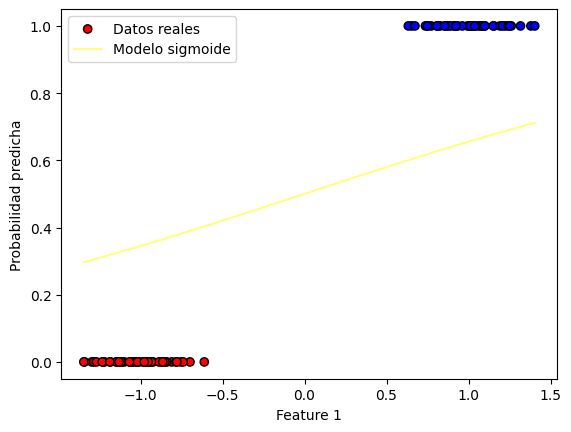

Iteracion: 154
Costo en la iteración 154: 0.42236915626717064
Valor del gradiente 154: [-0.00158186 -0.34231009]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00144873 0.64554754]


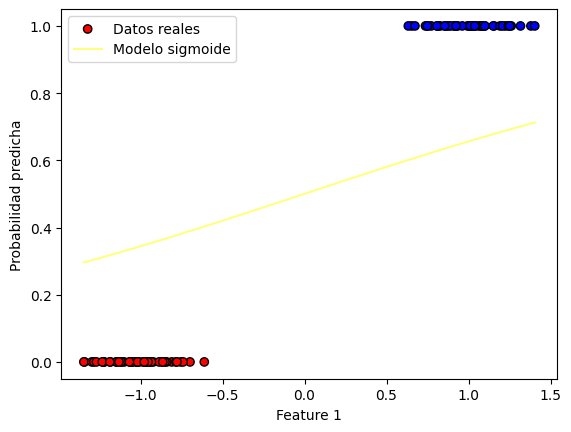

Iteracion: 155
Costo en la iteración 155: 0.4211987342888422
Valor del gradiente 155: [-0.00158707 -0.3415127 ]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.0014646  0.64896267]


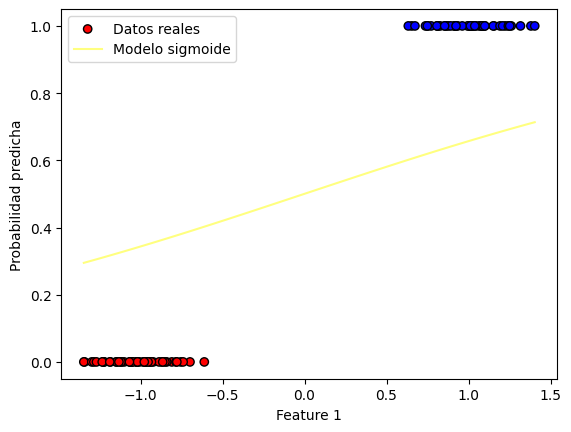

Iteracion: 156
Costo en la iteración 156: 0.42003375681923943
Valor del gradiente 156: [-0.00159223 -0.34071815]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00148052 0.65236985]


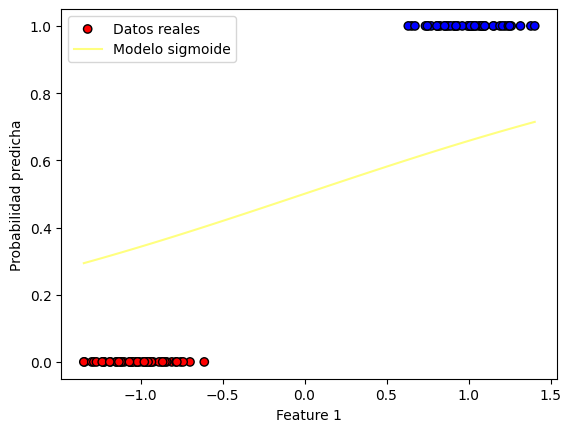

Iteracion: 157
Costo en la iteración 157: 0.4188741918881784
Valor del gradiente 157: [-0.00159735 -0.33992643]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00149649 0.65576911]


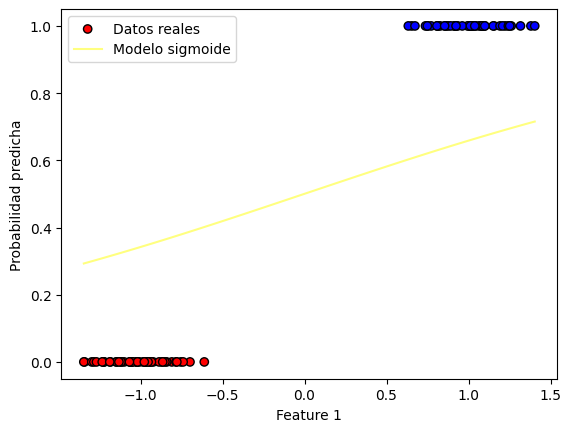

Iteracion: 158
Costo en la iteración 158: 0.41772000772827705
Valor del gradiente 158: [-0.00160241 -0.33913751]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00151252 0.65916049]


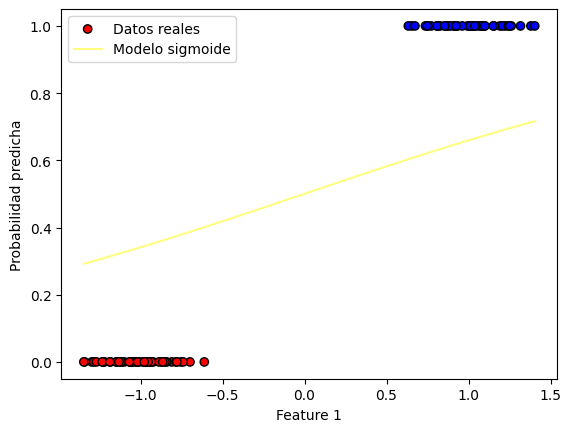

Iteracion: 159
Costo en la iteración 159: 0.4165711727738344
Valor del gradiente 159: [-0.00160743 -0.3383514 ]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00152859 0.662544  ]


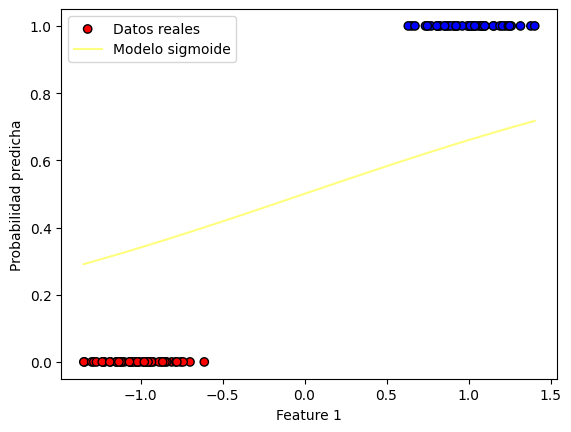

Iteracion: 160
Costo en la iteración 160: 0.41542765565971257
Valor del gradiente 160: [-0.0016124  -0.33756808]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00154472 0.66591968]


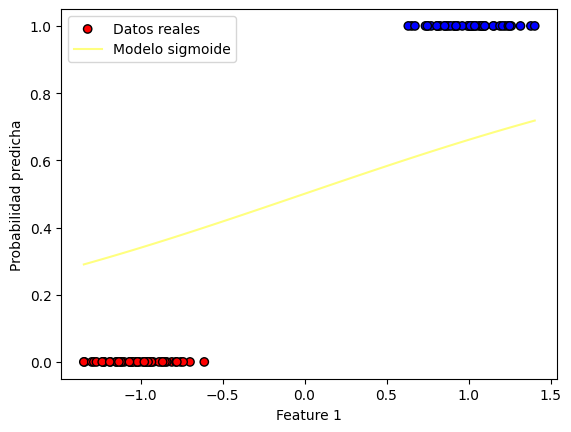

Iteracion: 161
Costo en la iteración 161: 0.4142894252202193
Valor del gradiente 161: [-0.00161733 -0.33678755]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00156089 0.66928756]


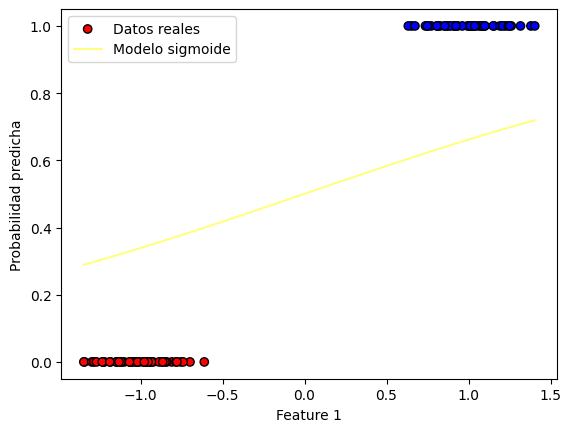

Iteracion: 162
Costo en la iteración 162: 0.4131564504879899
Valor del gradiente 162: [-0.00162221 -0.33600978]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00157711 0.67264766]


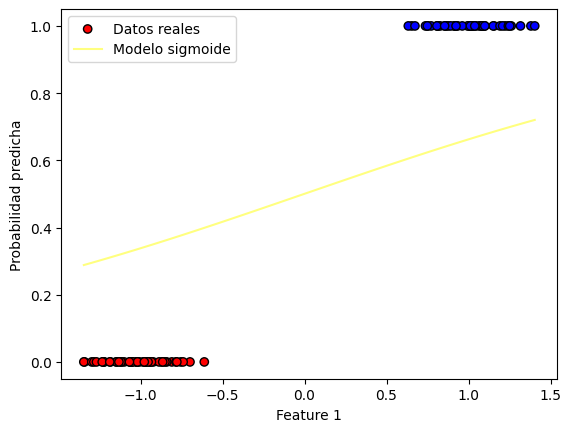

Iteracion: 163
Costo en la iteración 163: 0.41202870069287345
Valor del gradiente 163: [-0.00162704 -0.33523478]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00159338 0.67600001]


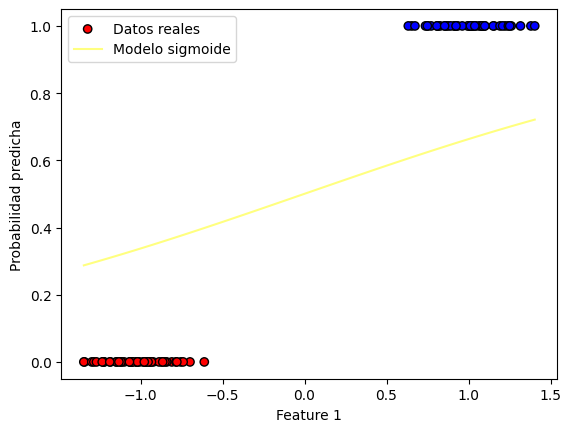

Iteracion: 164
Costo en la iteración 164: 0.4109061452608174
Valor del gradiente 164: [-0.00163183 -0.33446254]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.0016097  0.67934463]


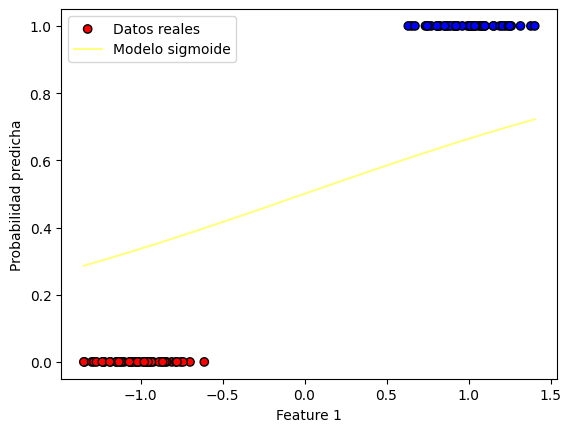

Iteracion: 165
Costo en la iteración 165: 0.4097887538127554
Valor del gradiente 165: [-0.00163657 -0.33369304]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00162607 0.68268156]


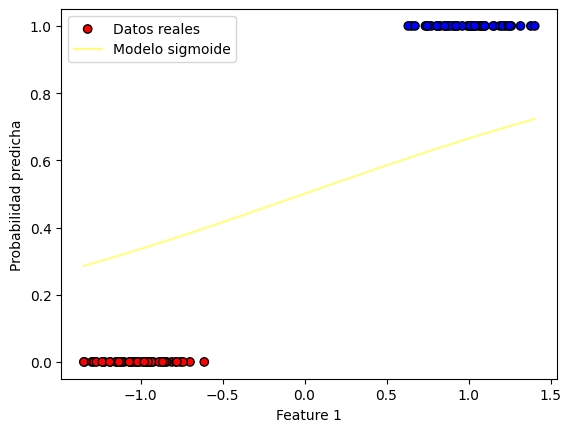

Iteracion: 166
Costo en la iteración 166: 0.40867649616349594
Valor del gradiente 166: [-0.00164126 -0.33292627]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00164248 0.68601082]


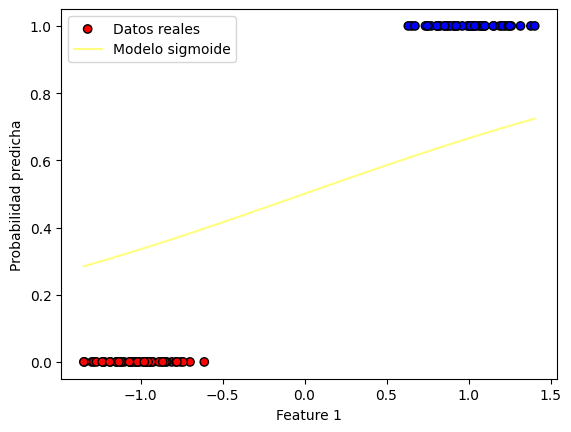

Iteracion: 167
Costo en la iteración 167: 0.4075693423206127
Valor del gradiente 167: [-0.00164591 -0.33216222]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00165894 0.68933245]


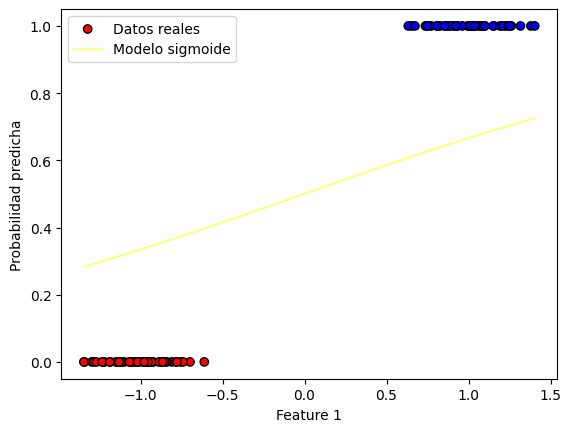

Iteracion: 168
Costo en la iteración 168: 0.40646726248333714
Valor del gradiente 168: [-0.00165052 -0.33140089]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00167544 0.69264645]


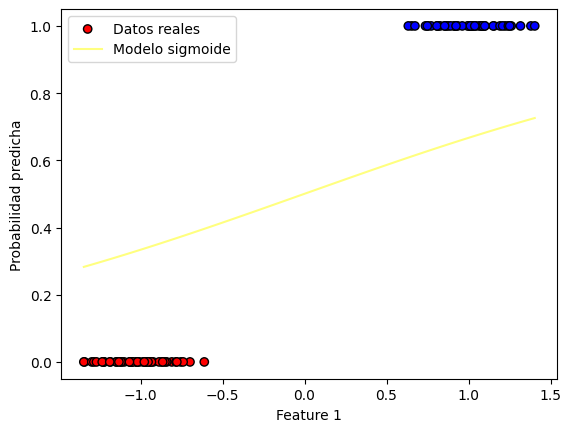

Iteracion: 169
Costo en la iteración 169: 0.4053702270414528
Valor del gradiente 169: [-0.00165508 -0.33064226]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00169199 0.69595288]


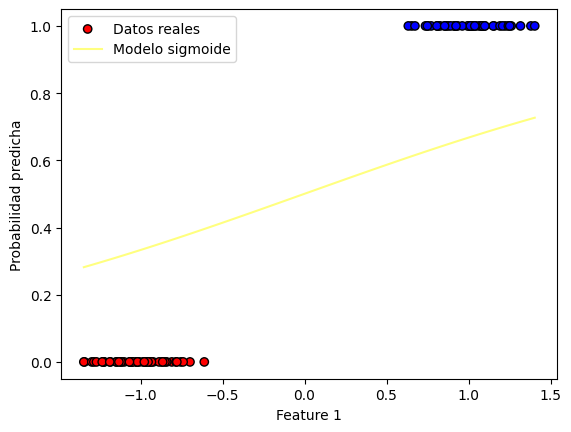

Iteracion: 170
Costo en la iteración 170: 0.4042782065741916
Valor del gradiente 170: [-0.0016596  -0.32988632]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00170859 0.69925174]


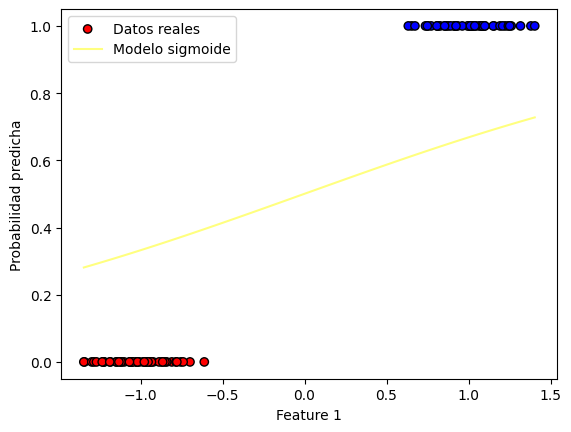

Iteracion: 171
Costo en la iteración 171: 0.40319117184913206
Valor del gradiente 171: [-0.00166407 -0.32913307]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00172523 0.70254307]


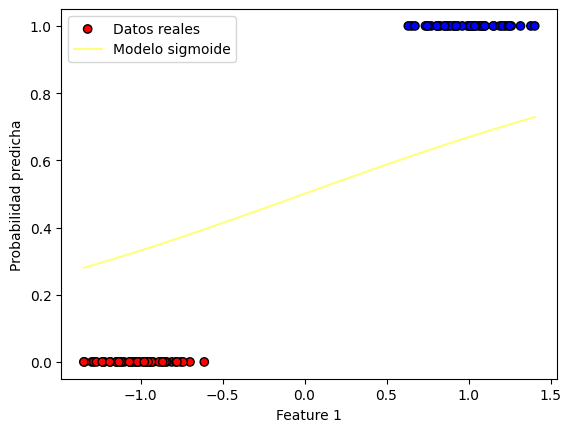

Iteracion: 172
Costo en la iteración 172: 0.4021090938210999
Valor del gradiente 172: [-0.0016685  -0.32838249]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00174191 0.7058269 ]


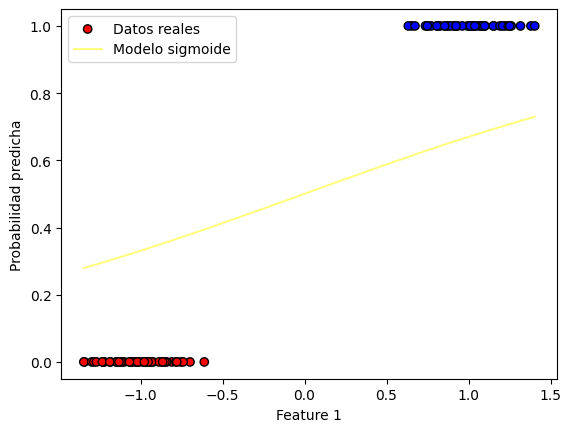

Iteracion: 173
Costo en la iteración 173: 0.40103194363107153
Valor del gradiente 173: [-0.00167288 -0.32763457]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00175864 0.70910324]


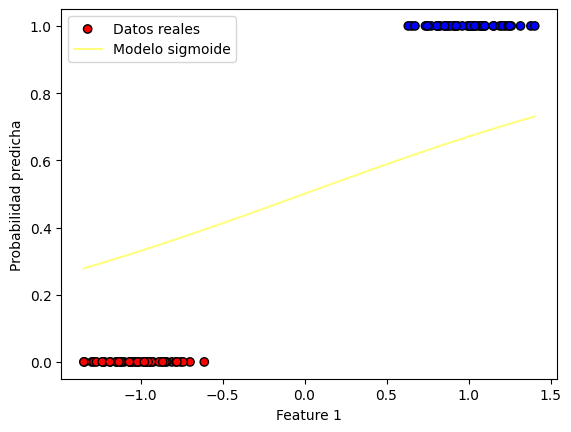

Iteracion: 174
Costo en la iteración 174: 0.39995969260507885
Valor del gradiente 174: [-0.00167723 -0.32688931]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00177542 0.71237213]


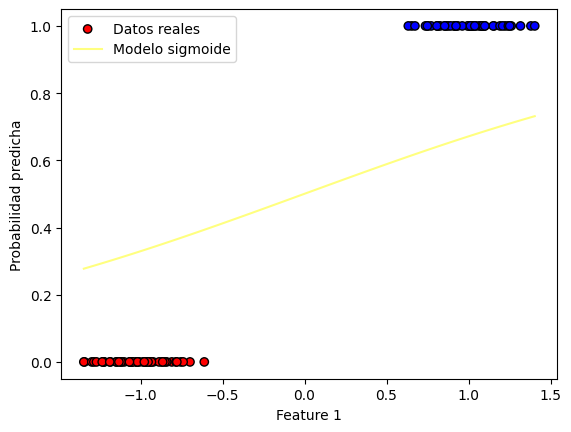

Iteracion: 175
Costo en la iteración 175: 0.39889231225311783
Valor del gradiente 175: [-0.00168153 -0.32614669]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00179223 0.7156336 ]


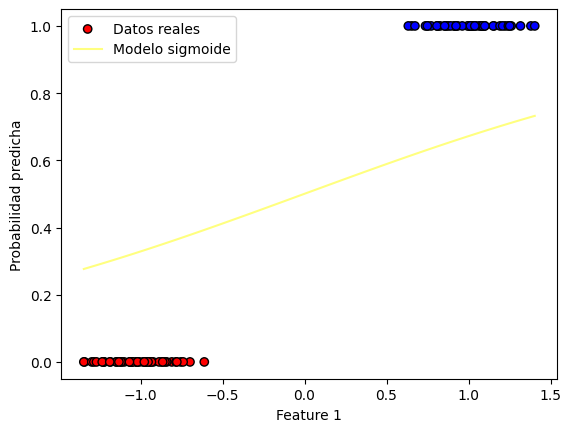

Iteracion: 176
Costo en la iteración 176: 0.3978297742680587
Valor del gradiente 176: [-0.00168578 -0.32540671]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00180909 0.71888767]


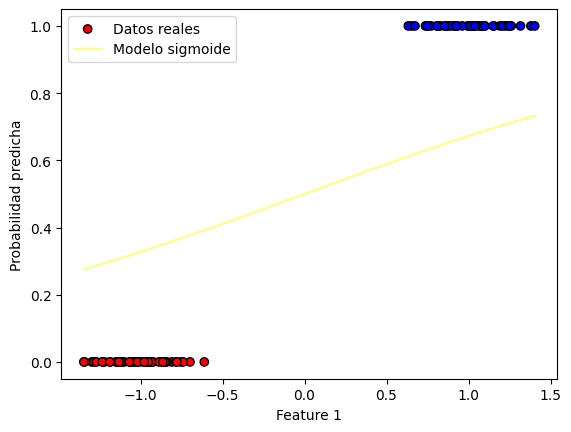

Iteracion: 177
Costo en la iteración 177: 0.3967720505245595
Valor del gradiente 177: [-0.00169    -0.32466935]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00182599 0.72213436]


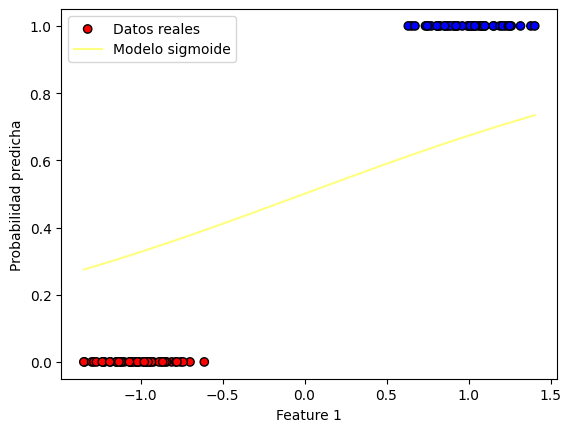

Iteracion: 178
Costo en la iteración 178: 0.3957191130779819
Valor del gradiente 178: [-0.00169417 -0.3239346 ]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00184293 0.72537371]


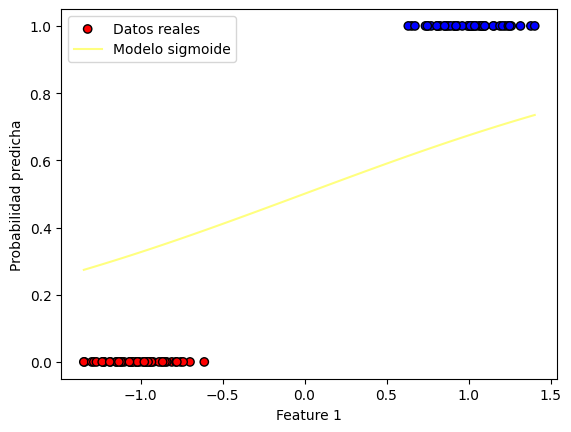

Iteracion: 179
Costo en la iteración 179: 0.39467093416331067
Valor del gradiente 179: [-0.00169831 -0.32320246]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00185991 0.72860573]


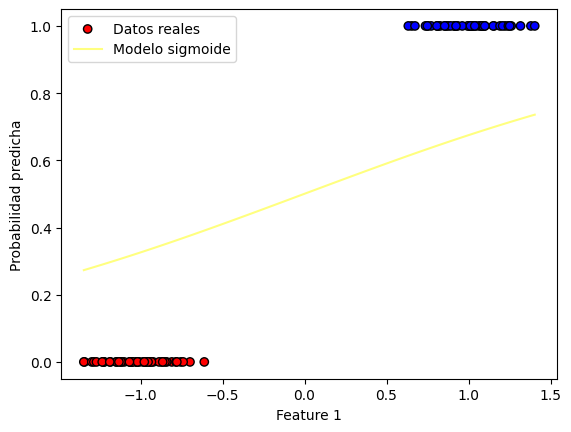

Iteracion: 180
Costo en la iteración 180: 0.3936274861940755
Valor del gradiente 180: [-0.0017024  -0.32247291]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00187694 0.73183046]


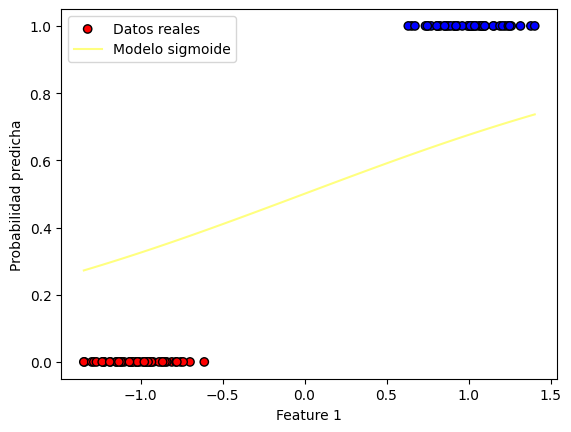

Iteracion: 181
Costo en la iteración 181: 0.3925887417612756
Valor del gradiente 181: [-0.00170645 -0.32174595]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.001894   0.73504792]


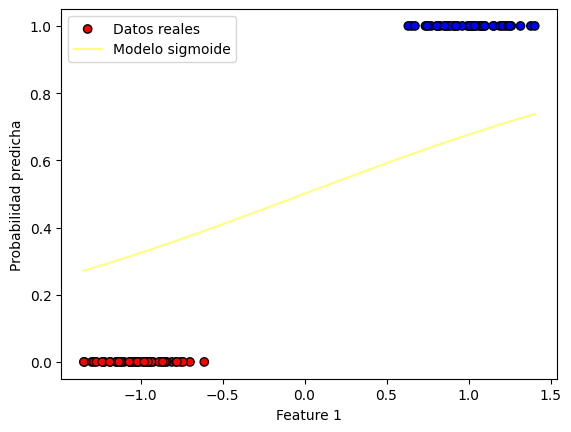

Iteracion: 182
Costo en la iteración 182: 0.39155467363230884
Valor del gradiente 182: [-0.00171046 -0.32102156]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00191111 0.73825814]


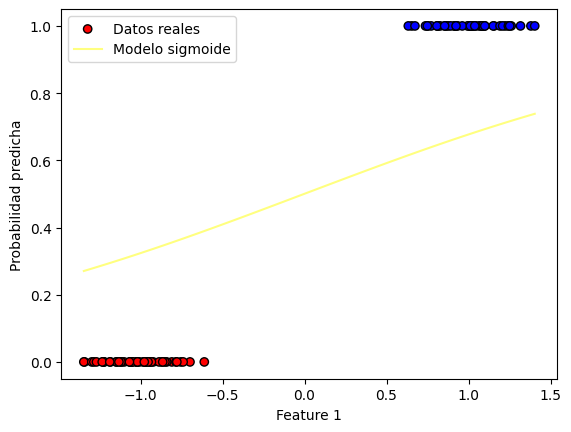

Iteracion: 183
Costo en la iteración 183: 0.3905252547499019
Valor del gradiente 183: [-0.00171442 -0.32029974]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00192825 0.74146113]


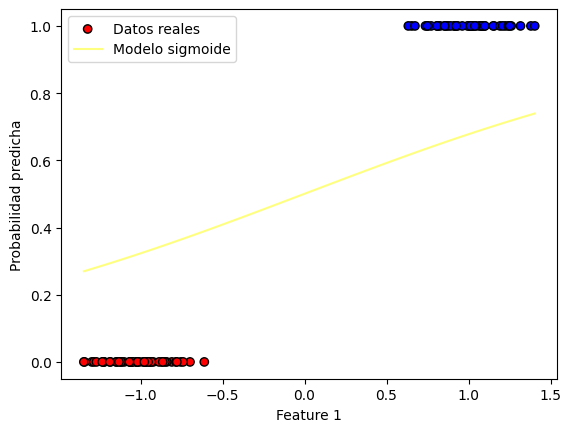

Iteracion: 184
Costo en la iteración 184: 0.38950045823104595
Valor del gradiente 184: [-0.00171835 -0.31958048]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00194543 0.74465694]


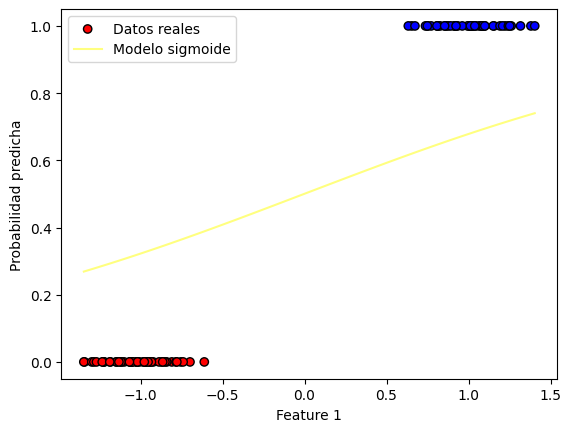

Iteracion: 185
Costo en la iteración 185: 0.3884802573659342
Valor del gradiente 185: [-0.00172224 -0.31886375]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00196266 0.74784558]


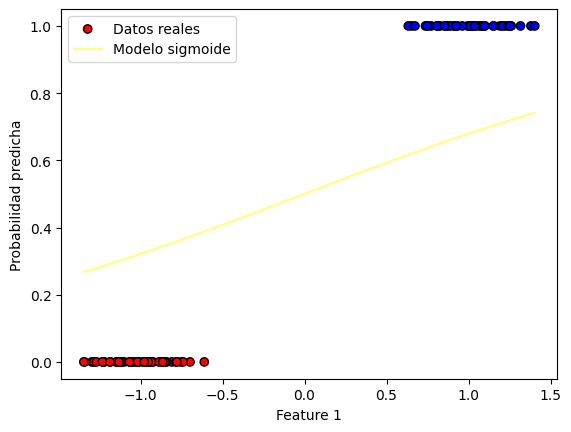

Iteracion: 186
Costo en la iteración 186: 0.38746462561690337
Valor del gradiente 186: [-0.00172609 -0.31814957]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00197992 0.75102707]


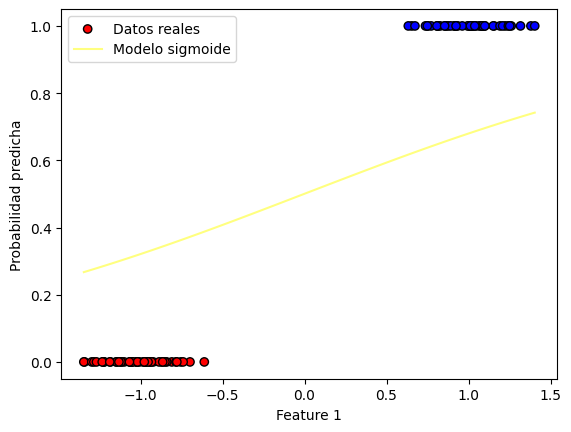

Iteracion: 187
Costo en la iteración 187: 0.3864535366173783
Valor del gradiente 187: [-0.0017299  -0.31743791]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00199722 0.75420145]


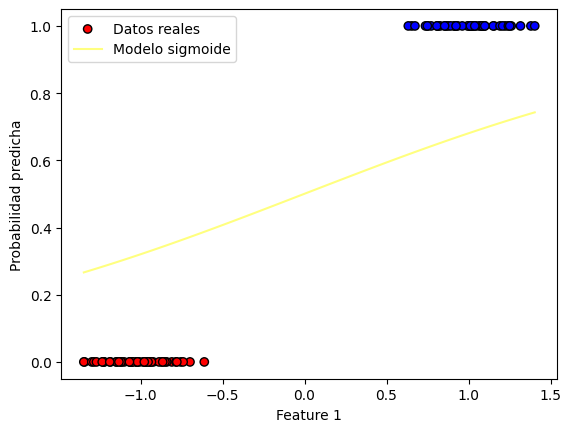

Iteracion: 188
Costo en la iteración 188: 0.3854469641708208
Valor del gradiente 188: [-0.00173367 -0.31672877]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00201455 0.75736874]


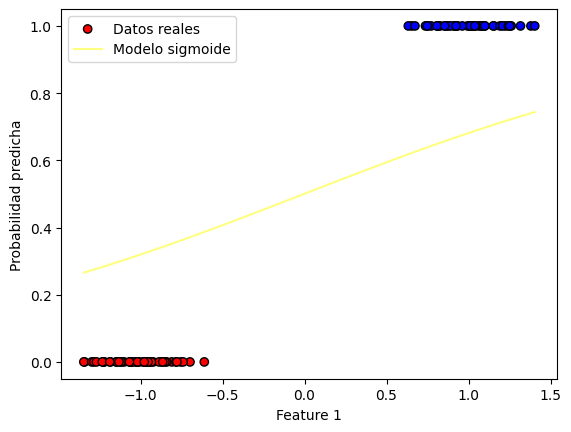

Iteracion: 189
Costo en la iteración 189: 0.38444488224968204
Valor del gradiente 189: [-0.0017374  -0.31602213]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00203193 0.76052896]


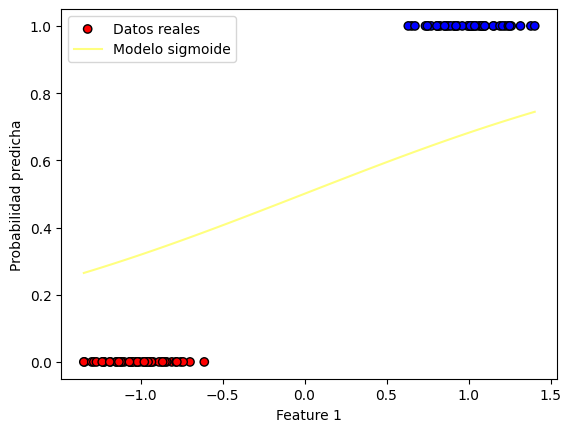

Iteracion: 190
Costo en la iteración 190: 0.38344726499435733
Valor del gradiente 190: [-0.0017411 -0.315318 ]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00204934 0.76368214]


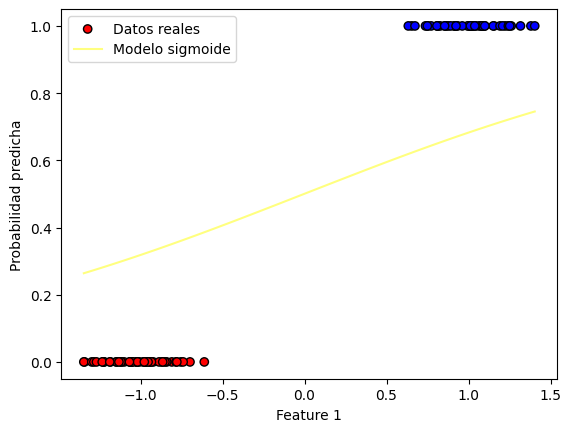

Iteracion: 191
Costo en la iteración 191: 0.3824540867121455
Valor del gradiente 191: [-0.00174475 -0.31461635]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00206679 0.7668283 ]


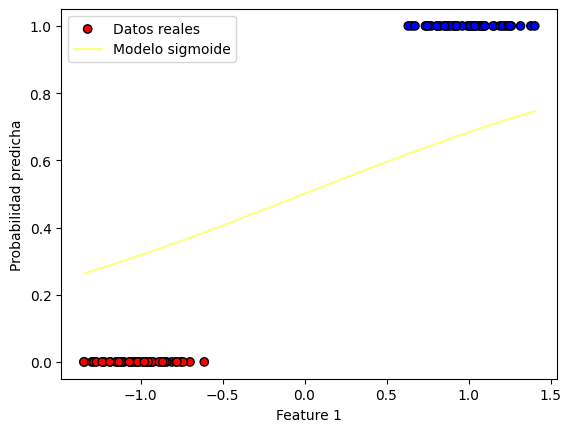

Iteracion: 192
Costo en la iteración 192: 0.38146532187621385
Valor del gradiente 192: [-0.00174837 -0.31391717]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00208427 0.76996748]


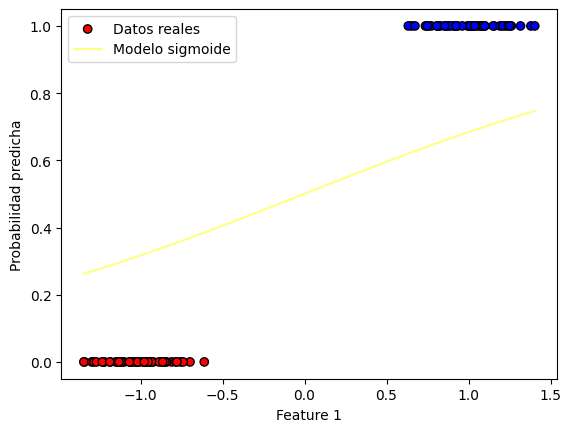

Iteracion: 193
Costo en la iteración 193: 0.38048094512456304
Valor del gradiente 193: [-0.00175195 -0.31322047]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00210179 0.77309968]


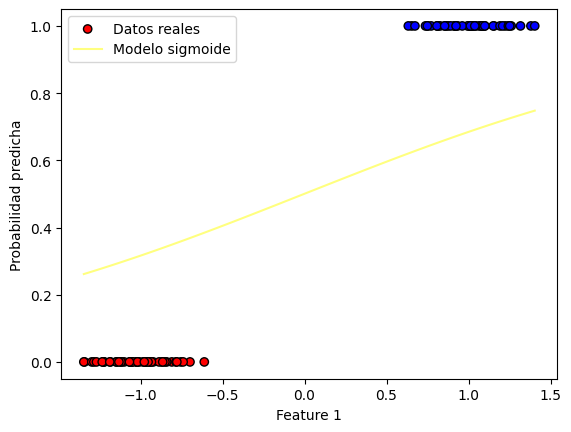

Iteracion: 194
Costo en la iteración 194: 0.37950093125899936
Valor del gradiente 194: [-0.00175549 -0.31252623]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00211934 0.77622494]


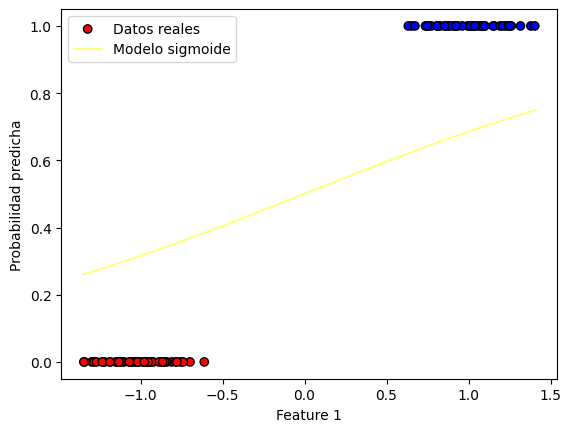

Iteracion: 195
Costo en la iteración 195: 0.3785252552441092
Valor del gradiente 195: [-0.001759   -0.31183443]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00213693 0.77934329]


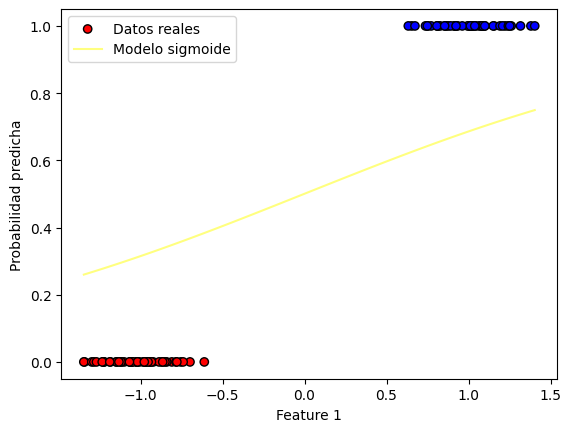

Iteracion: 196
Costo en la iteración 196: 0.3775538922062377
Valor del gradiente 196: [-0.00176246 -0.31114508]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00215456 0.78245474]


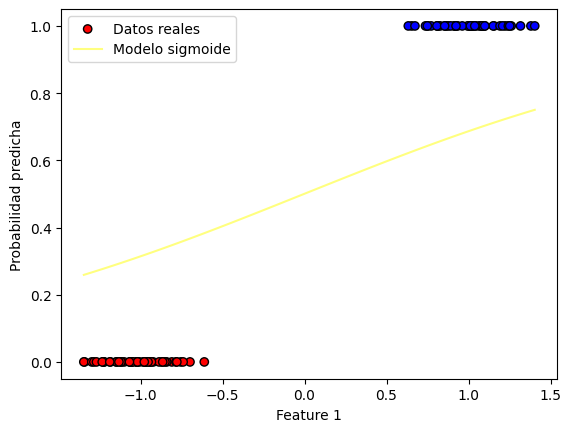

Iteracion: 197
Costo en la iteración 197: 0.3765868174324721
Valor del gradiente 197: [-0.0017659  -0.31045815]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00217222 0.78555932]


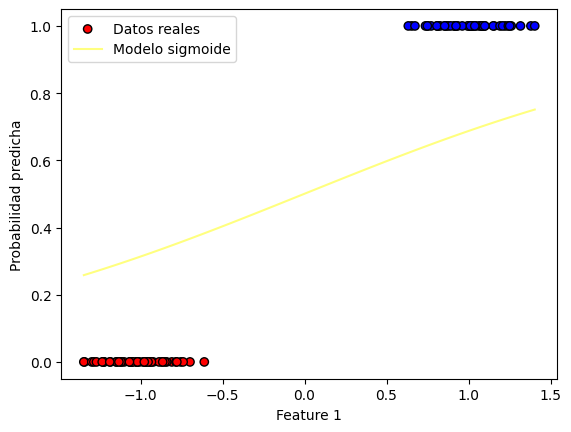

Iteracion: 198
Costo en la iteración 198: 0.37562400636962845
Valor del gradiente 198: [-0.00176929 -0.30977365]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00218991 0.78865706]


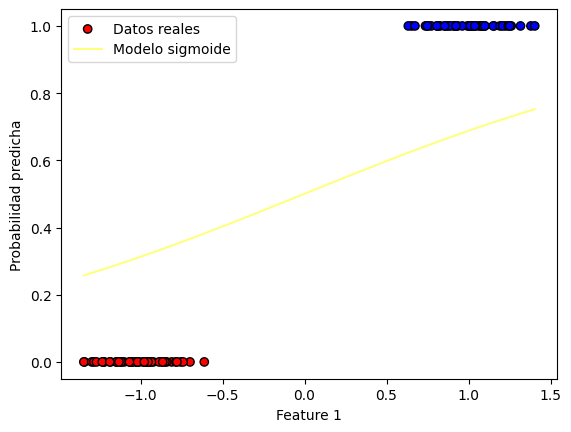

Iteracion: 199
Costo en la iteración 199: 0.3746654346232427
Valor del gradiente 199: [-0.00177265 -0.30909155]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00220764 0.79174797]


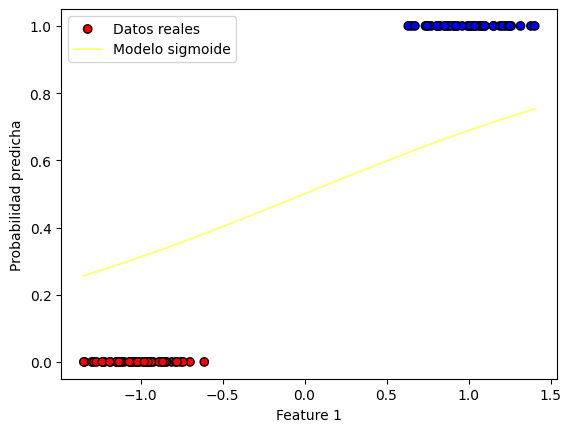

Iteracion: 200
Costo en la iteración 200: 0.37371107795656583
Valor del gradiente 200: [-0.00177597 -0.30841186]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.0022254  0.79483209]


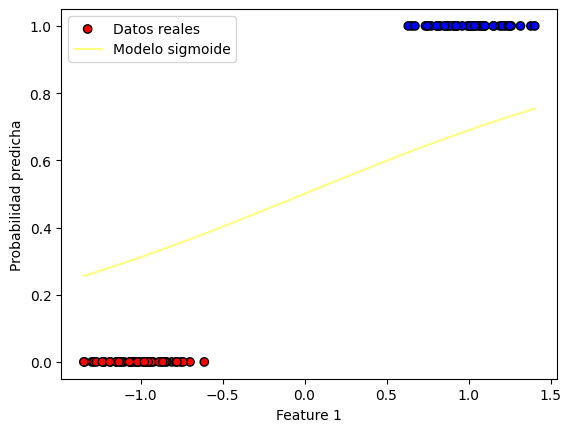

Iteracion: 201
Costo en la iteración 201: 0.37276091228956376
Valor del gradiente 201: [-0.00177926 -0.30773456]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00224319 0.79790944]


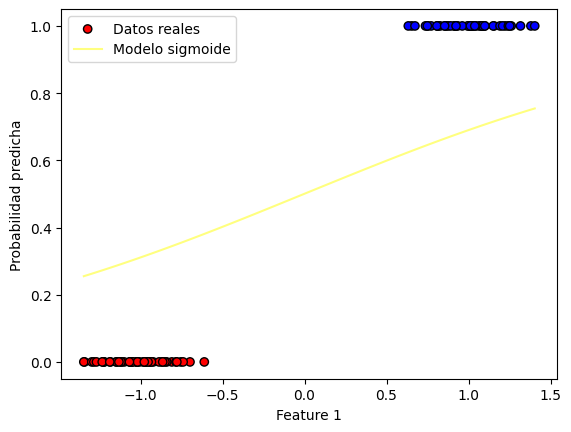

Iteracion: 202
Costo en la iteración 202: 0.37181491369792014
Valor del gradiente 202: [-0.00178251 -0.30705965]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00226101 0.80098003]


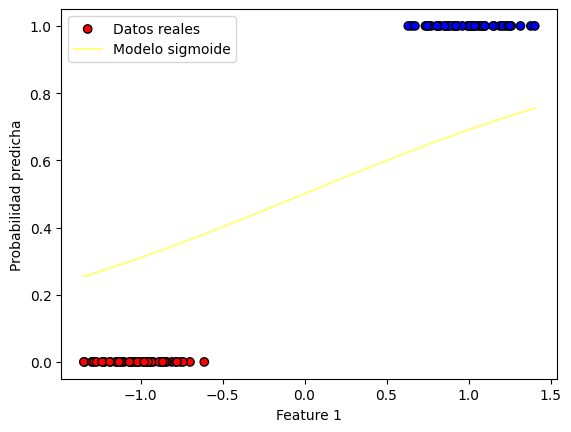

Iteracion: 203
Costo en la iteración 203: 0.3708730584120453
Valor del gradiente 203: [-0.00178573 -0.3063871 ]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00227887 0.8040439 ]


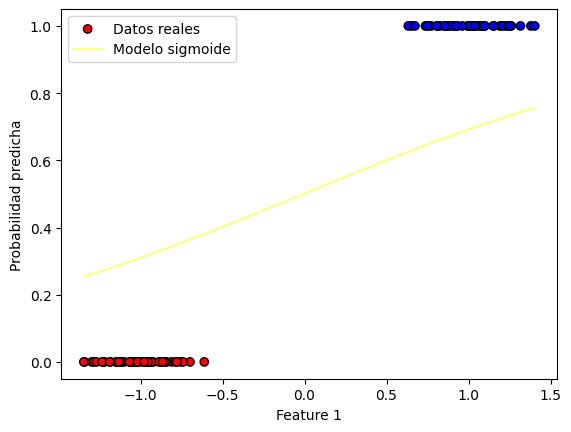

Iteracion: 204
Costo en la iteración 204: 0.36993532281608793
Valor del gradiente 204: [-0.00178891 -0.30571693]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00229676 0.80710107]


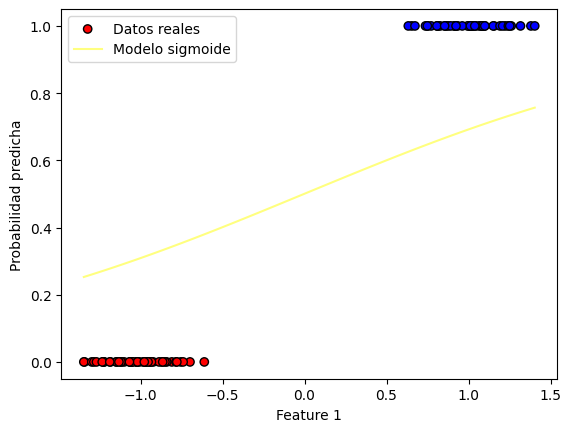

Iteracion: 205
Costo en la iteración 205: 0.3690016834469516
Valor del gradiente 205: [-0.00179206 -0.3050491 ]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00231468 0.81015156]


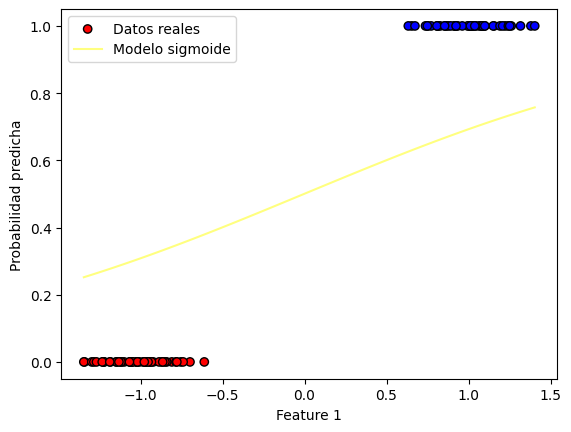

Iteracion: 206
Costo en la iteración 206: 0.36807211699331616
Valor del gradiente 206: [-0.00179517 -0.30438363]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00233263 0.8131954 ]


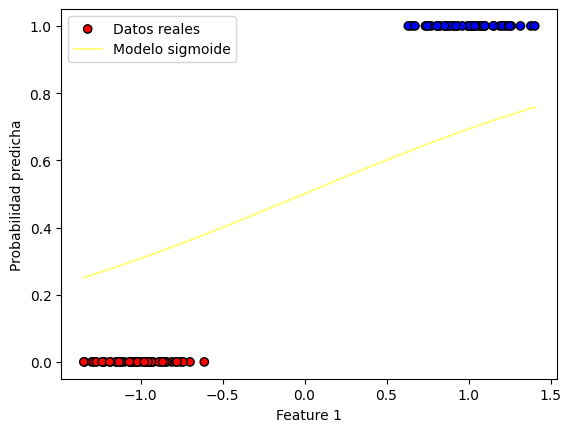

Iteracion: 207
Costo en la iteración 207: 0.3671466002946628
Valor del gradiente 207: [-0.00179825 -0.30372048]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00235062 0.8162326 ]


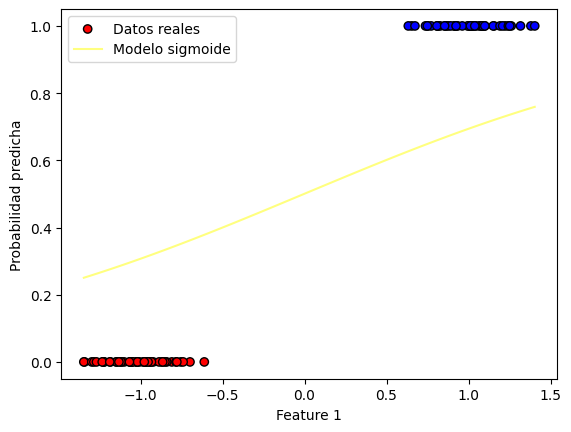

Iteracion: 208
Costo en la iteración 208: 0.3662251103403037
Valor del gradiente 208: [-0.0018013  -0.30305967]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00236863 0.8192632 ]


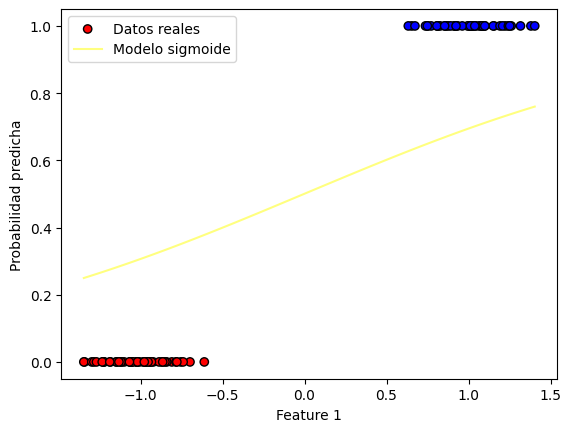

Iteracion: 209
Costo en la iteración 209: 0.3653076242684167
Valor del gradiente 209: [-0.00180431 -0.30240117]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00238667 0.82228721]


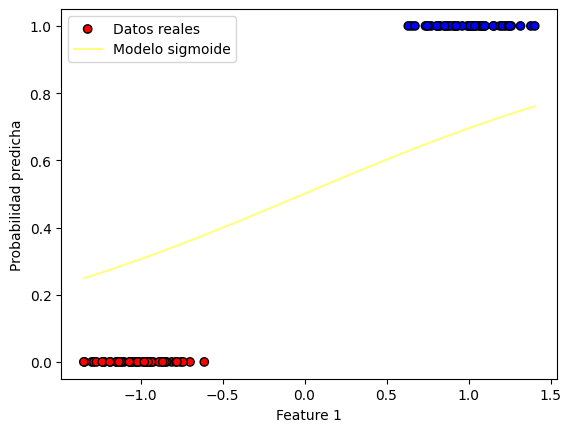

Iteracion: 210
Costo en la iteración 210: 0.3643941193650837
Valor del gradiente 210: [-0.00180729 -0.30174499]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00240475 0.82530466]


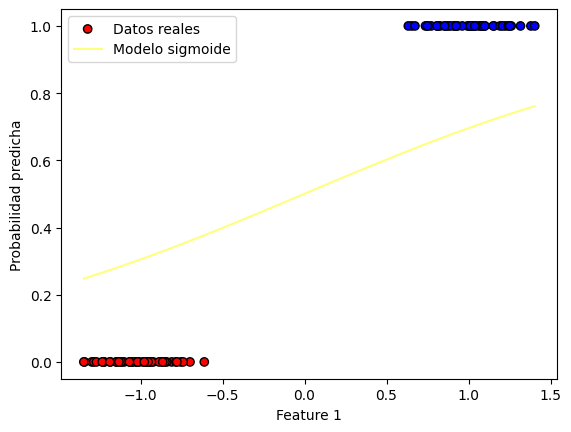

Iteracion: 211
Costo en la iteración 211: 0.36348457306333454
Valor del gradiente 211: [-0.00181023 -0.3010911 ]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00242285 0.82831557]


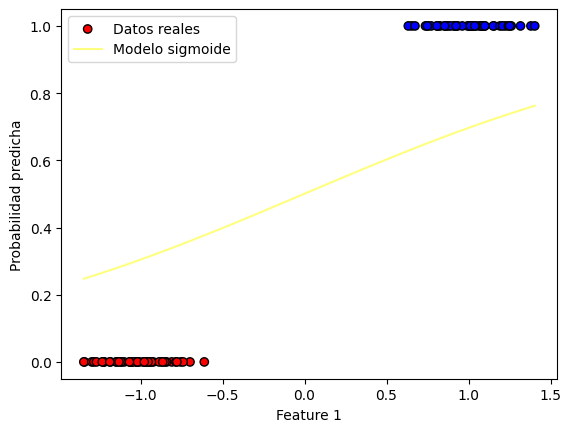

Iteracion: 212
Costo en la iteración 212: 0.3625789629421934
Valor del gradiente 212: [-0.00181315 -0.3004395 ]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00244098 0.83131997]


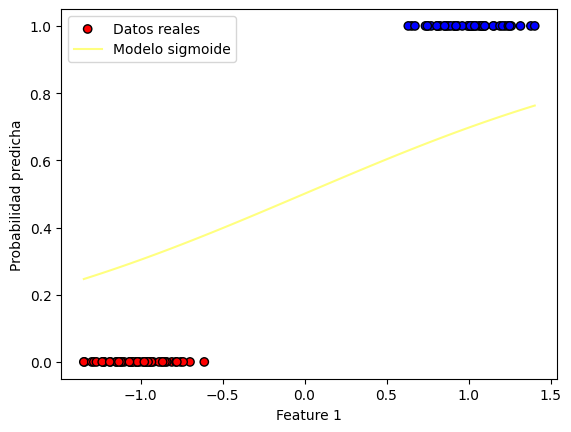

Iteracion: 213
Costo en la iteración 213: 0.3616772667257327
Valor del gradiente 213: [-0.00181603 -0.29979018]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00245914 0.83431787]


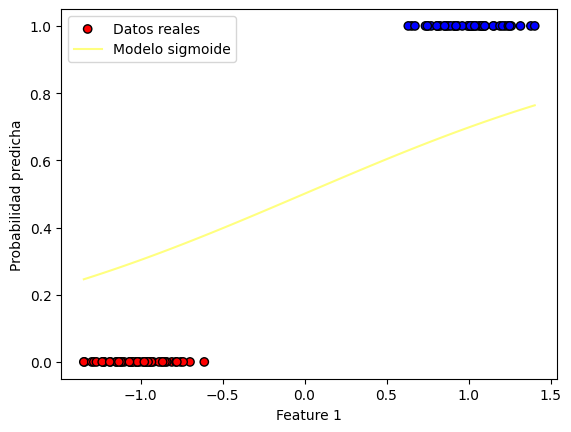

Iteracion: 214
Costo en la iteración 214: 0.3607794622821291
Valor del gradiente 214: [-0.00181887 -0.29914314]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00247733 0.8373093 ]


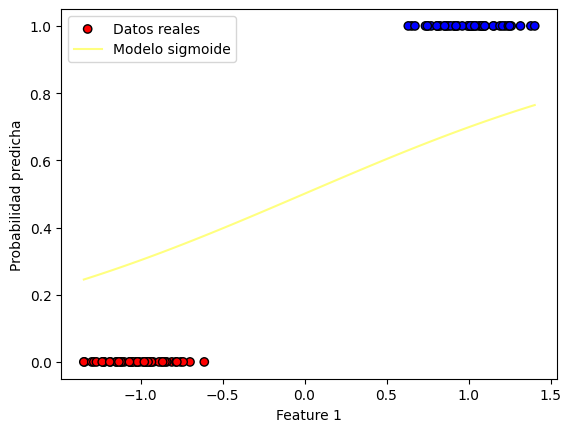

Iteracion: 215
Costo en la iteración 215: 0.35988552762272535
Valor del gradiente 215: [-0.00182169 -0.29849836]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00249554 0.84029429]


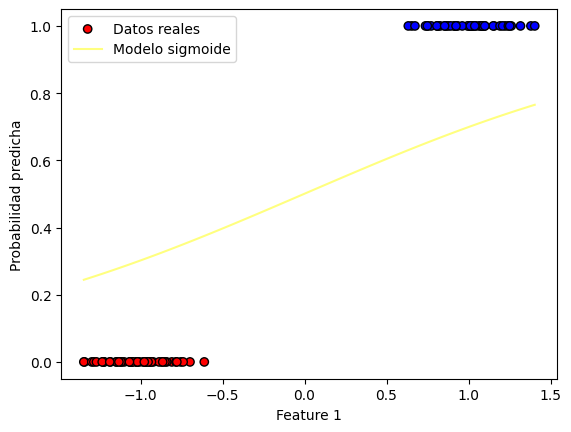

Iteracion: 216
Costo en la iteración 216: 0.35899544090109614
Valor del gradiente 216: [-0.00182447 -0.29785583]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00251379 0.84327284]


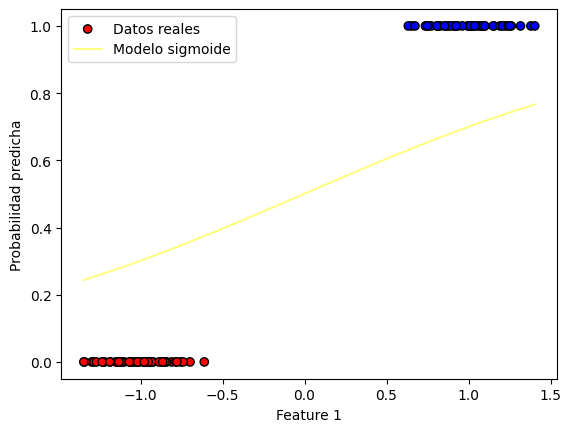

Iteracion: 217
Costo en la iteración 217: 0.35810918041211937
Valor del gradiente 217: [-0.00182722 -0.29721555]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00253206 0.846245  ]


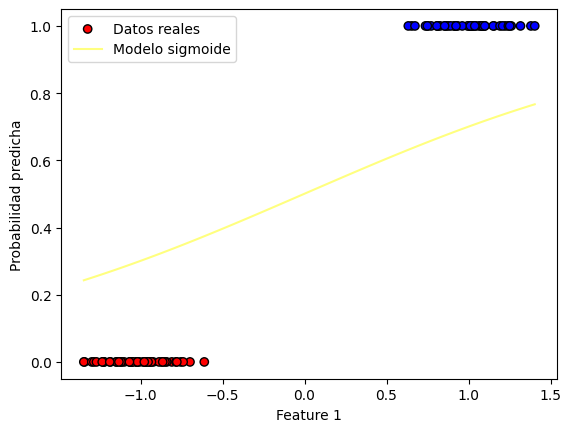

Iteracion: 218
Costo en la iteración 218: 0.35722672459105037
Valor del gradiente 218: [-0.00182994 -0.2965775 ]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00255036 0.84921077]


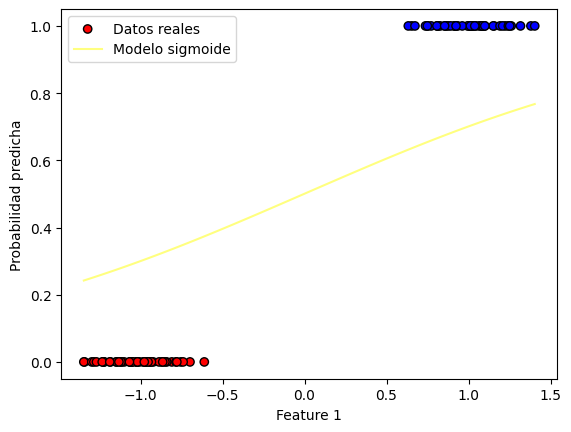

Iteracion: 219
Costo en la iteración 219: 0.35634805201260383
Valor del gradiente 219: [-0.00183263 -0.29594168]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00256869 0.85217019]


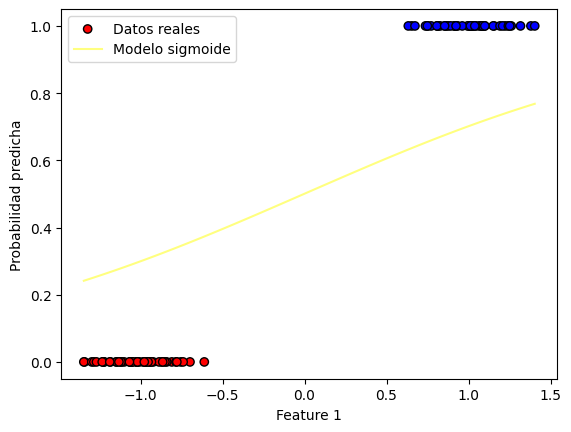

Iteracion: 220
Costo en la iteración 220: 0.35547314139003666
Valor del gradiente 220: [-0.00183529 -0.29530808]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00258704 0.85512327]


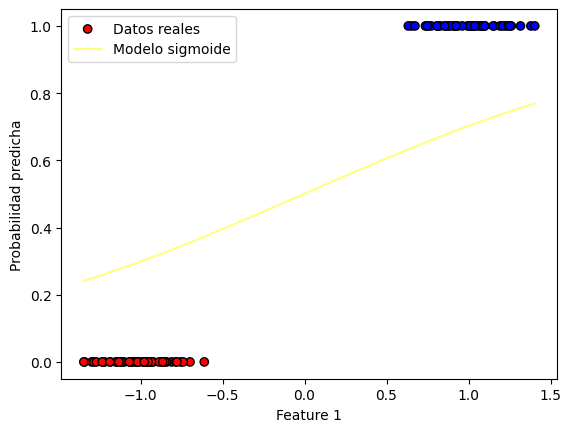

Iteracion: 221
Costo en la iteración 221: 0.3546019715742386
Valor del gradiente 221: [-0.00183792 -0.29467668]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00260542 0.85807004]


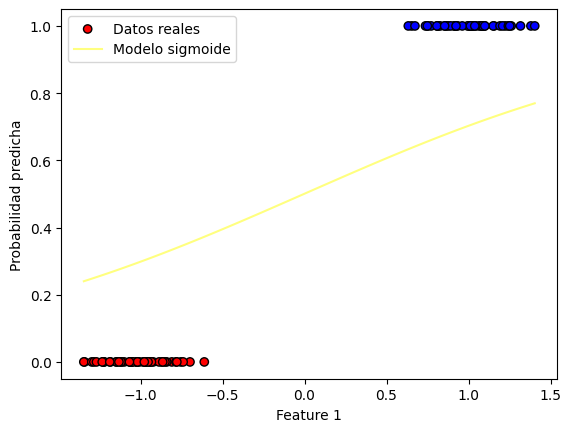

Iteracion: 222
Costo en la iteración 222: 0.35373452155282564
Valor del gradiente 222: [-0.00184051 -0.29404749]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00262382 0.86101051]


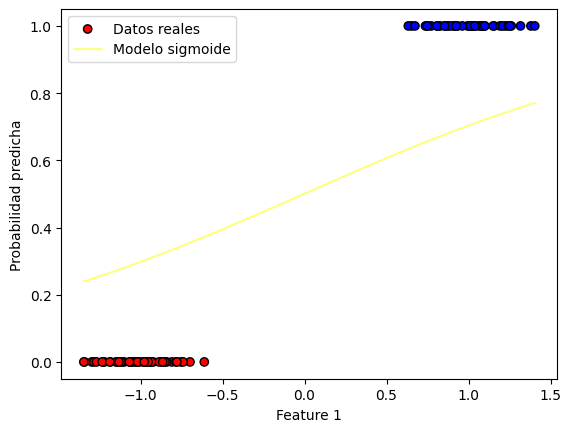

Iteracion: 223
Costo en la iteración 223: 0.3528707704492397
Valor del gradiente 223: [-0.00184308 -0.29342049]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00264226 0.86394472]


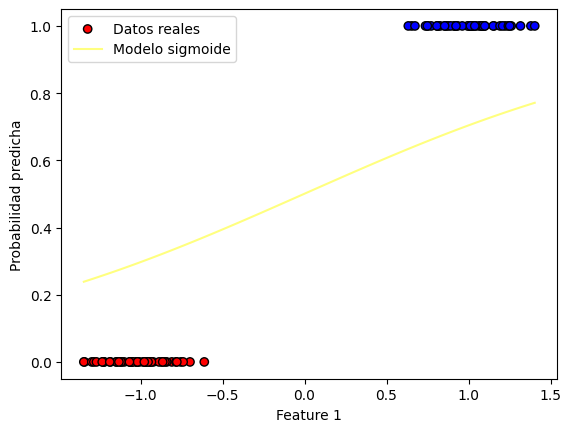

Iteracion: 224
Costo en la iteración 224: 0.352010697521851
Valor del gradiente 224: [-0.00184562 -0.29279567]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00266071 0.86687268]


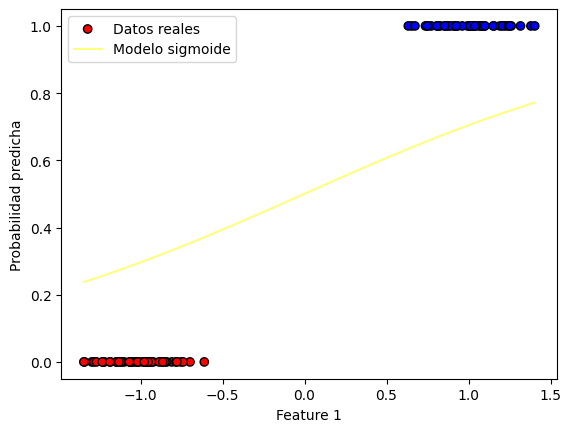

Iteracion: 225
Costo en la iteración 225: 0.3511542821630673
Valor del gradiente 225: [-0.00184812 -0.29217302]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00267919 0.86979441]


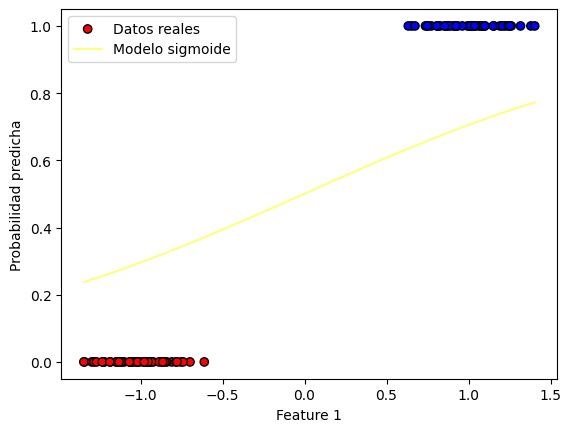

Iteracion: 226
Costo en la iteración 226: 0.35030150389844655
Valor del gradiente 226: [-0.0018506  -0.29155254]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.0026977  0.87270993]


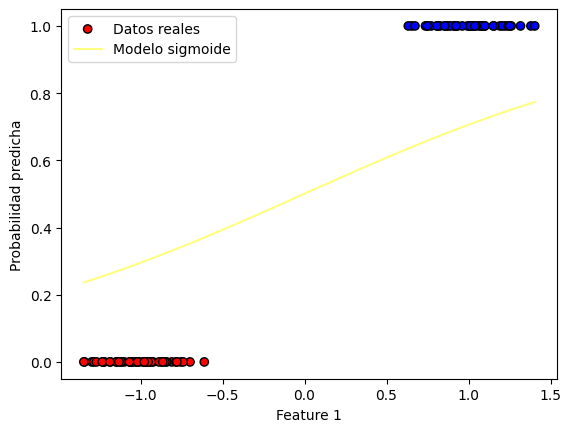

Iteracion: 227
Costo en la iteración 227: 0.3494523423858149
Valor del gradiente 227: [-0.00185305 -0.29093421]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00271623 0.87561927]


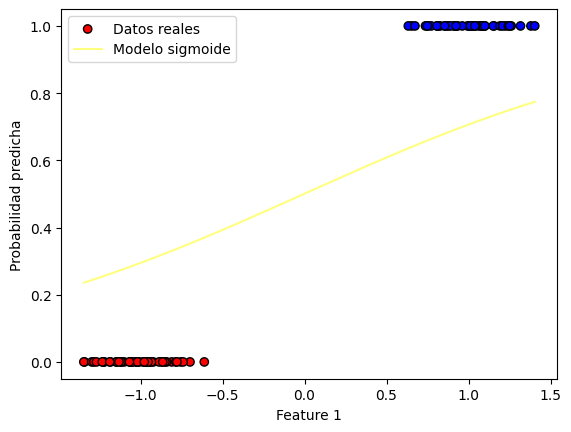

Iteracion: 228
Costo en la iteración 228: 0.3486067774143885
Valor del gradiente 228: [-0.00185546 -0.29031803]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00273478 0.87852245]


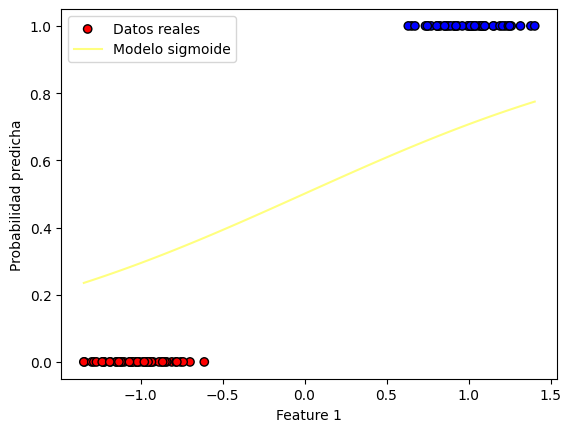

Iteracion: 229
Costo en la iteración 229: 0.3477647889039015
Valor del gradiente 229: [-0.00185785 -0.28970399]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00275336 0.88141949]


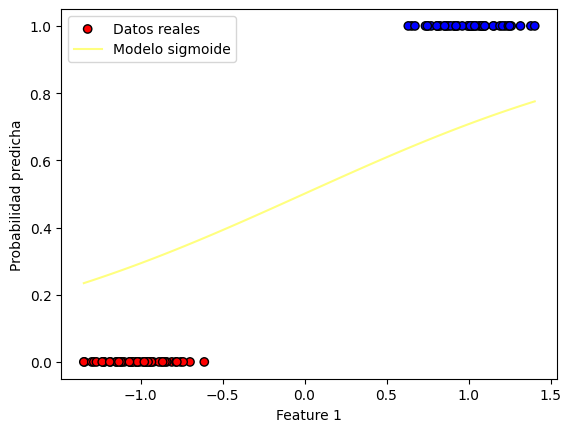

Iteracion: 230
Costo en la iteración 230: 0.3469263569037382
Valor del gradiente 230: [-0.00186021 -0.28909208]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00277196 0.88431041]


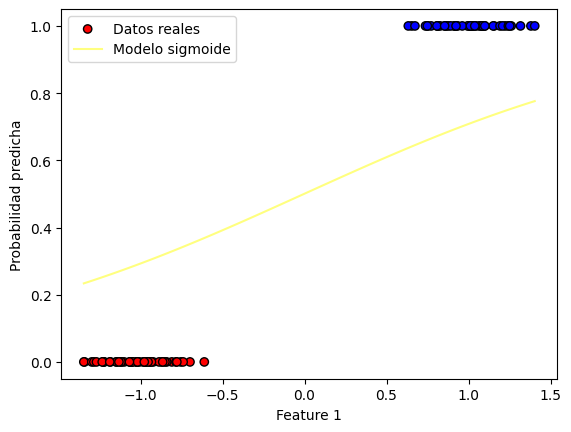

Iteracion: 231
Costo en la iteración 231: 0.3460914615920685
Valor del gradiente 231: [-0.00186254 -0.28848229]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00279059 0.88719524]


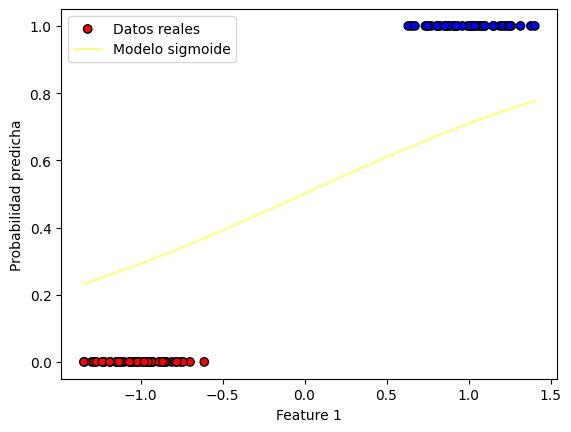

Iteracion: 232
Costo en la iteración 232: 0.3452600832749914
Valor del gradiente 232: [-0.00186485 -0.28787461]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00280924 0.89007398]


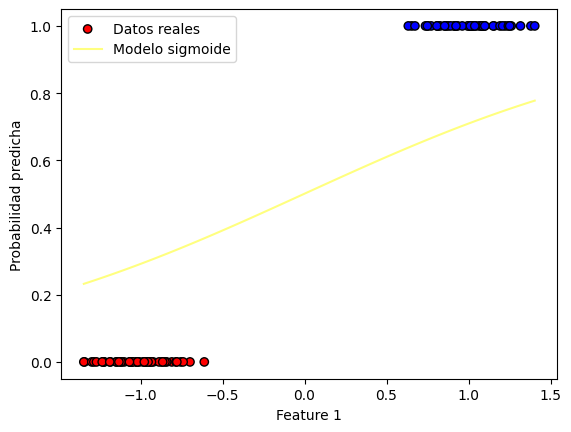

Iteracion: 233
Costo en la iteración 233: 0.3444322023856797
Valor del gradiente 233: [-0.00186712 -0.28726904]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00282791 0.89294667]


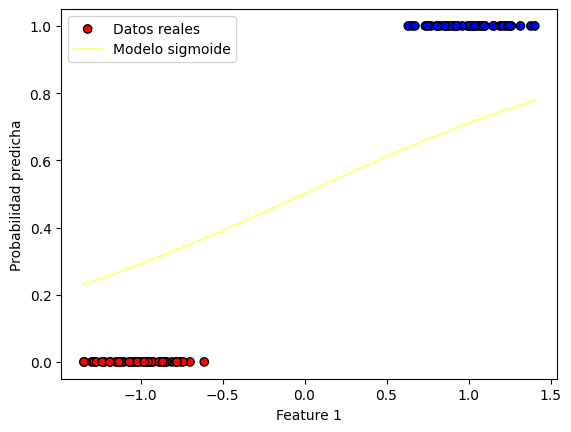

Iteracion: 234
Costo en la iteración 234: 0.3436077994835318
Valor del gradiente 234: [-0.00186937 -0.28666556]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.0028466  0.89581333]


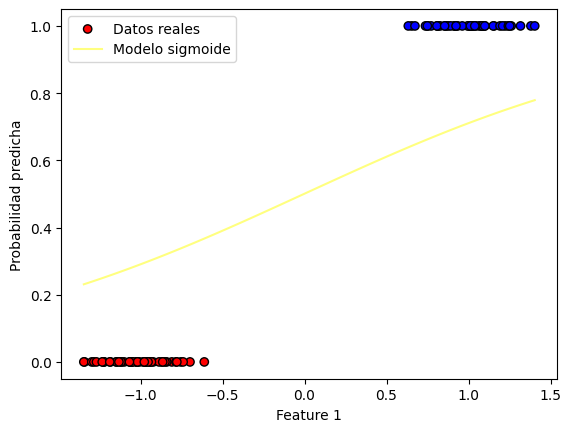

Iteracion: 235
Costo en la iteración 235: 0.3427868552533274
Valor del gradiente 235: [-0.00187159 -0.28606417]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00286532 0.89867397]


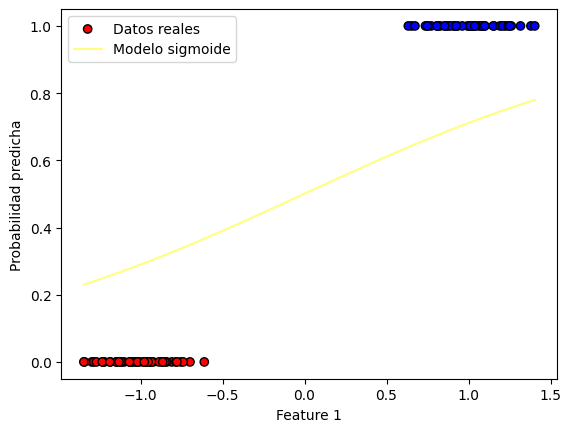

Iteracion: 236
Costo en la iteración 236: 0.3419693505043882
Valor del gradiente 236: [-0.00187378 -0.28546486]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00288406 0.90152862]


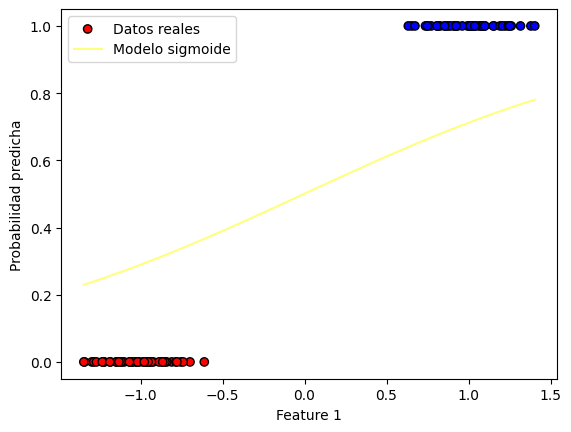

Iteracion: 237
Costo en la iteración 237: 0.34115526616974323
Valor del gradiente 237: [-0.00187594 -0.28486762]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00290282 0.9043773 ]


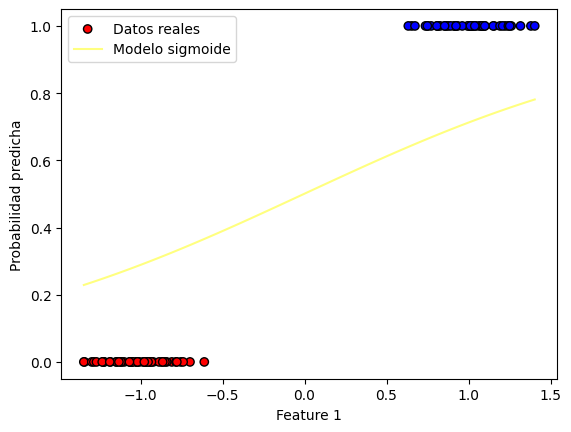

Iteracion: 238
Costo en la iteración 238: 0.3403445833052989
Valor del gradiente 238: [-0.00187808 -0.28427243]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.0029216  0.90722002]


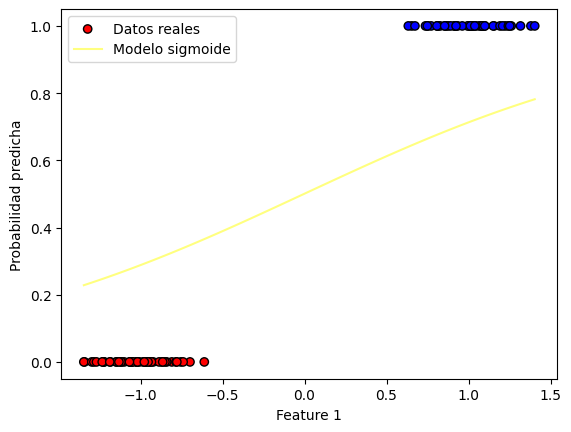

Iteracion: 239
Costo en la iteración 239: 0.339537283089014
Valor del gradiente 239: [-0.00188019 -0.28367931]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.0029404  0.91005681]


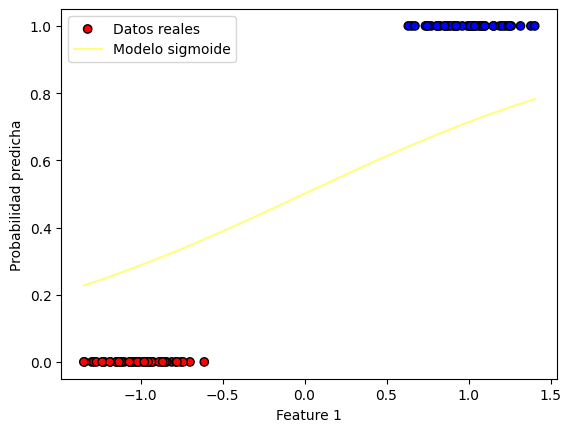

Iteracion: 240
Costo en la iteración 240: 0.3387333468200794
Valor del gradiente 240: [-0.00188227 -0.28308822]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00295922 0.9128877 ]


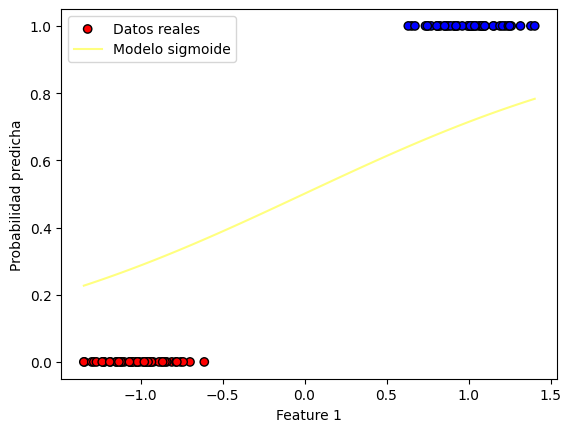

Iteracion: 241
Costo en la iteración 241: 0.3379327559181022
Valor del gradiente 241: [-0.00188433 -0.28249917]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00297807 0.91571269]


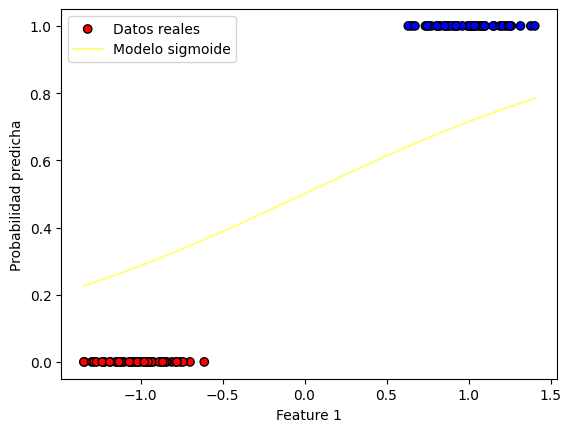

Iteracion: 242
Costo en la iteración 242: 0.33713549192229536
Valor del gradiente 242: [-0.00188636 -0.28191215]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00299693 0.91853181]


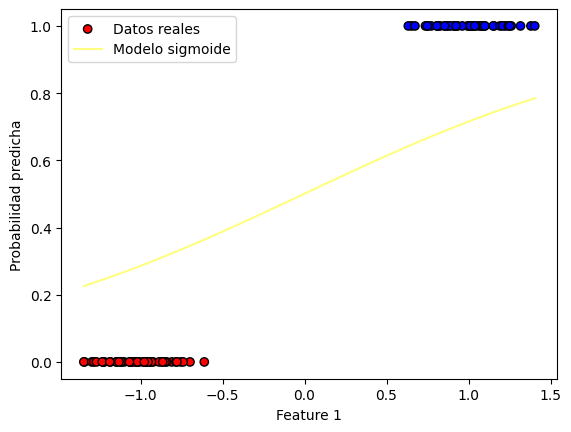

Iteracion: 243
Costo en la iteración 243: 0.336341536490671
Valor del gradiente 243: [-0.00188836 -0.28132715]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00301581 0.92134508]


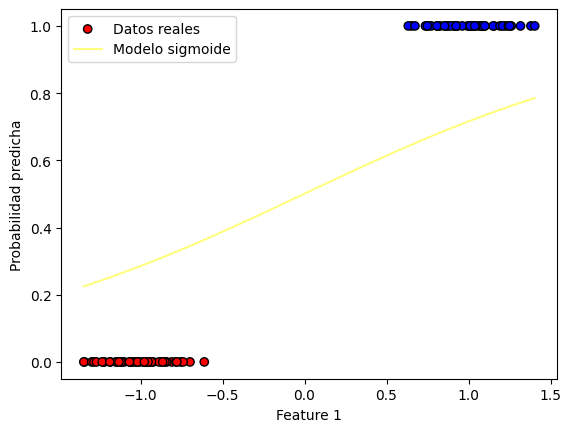

Iteracion: 244
Costo en la iteración 244: 0.33555087139924006
Valor del gradiente 244: [-0.00189034 -0.28074416]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00303472 0.92415252]


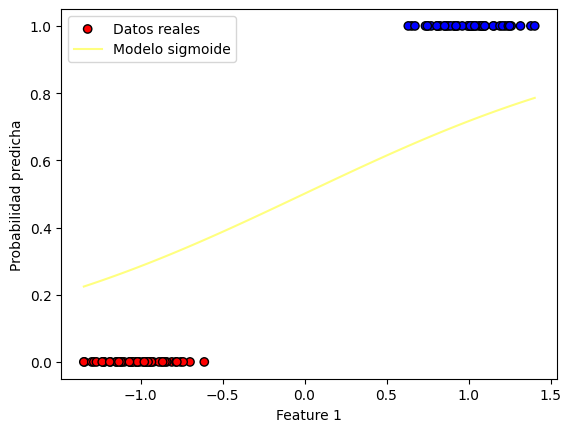

Iteracion: 245
Costo en la iteración 245: 0.33476347854121424
Valor del gradiente 245: [-0.00189229 -0.28016317]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00305364 0.92695415]


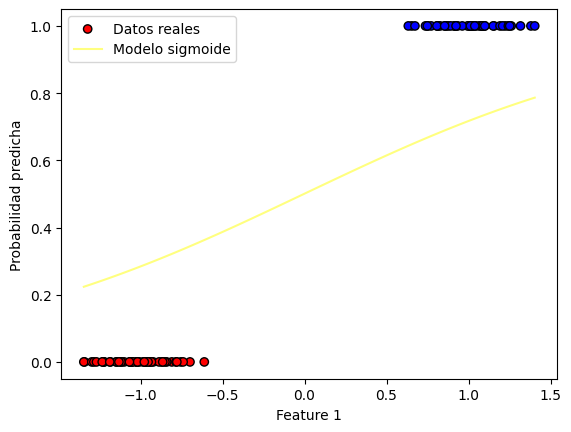

Iteracion: 246
Costo en la iteración 246: 0.3339793399262153
Valor del gradiente 246: [-0.00189422 -0.27958418]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00307258 0.92975   ]


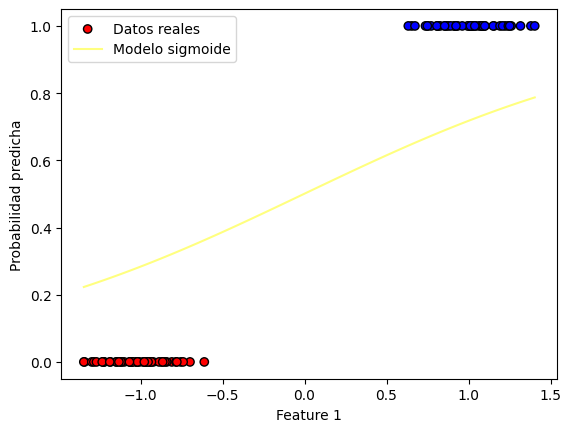

Iteracion: 247
Costo en la iteración 247: 0.3331984376794873
Valor del gradiente 247: [-0.00189612 -0.27900717]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00309154 0.93254007]


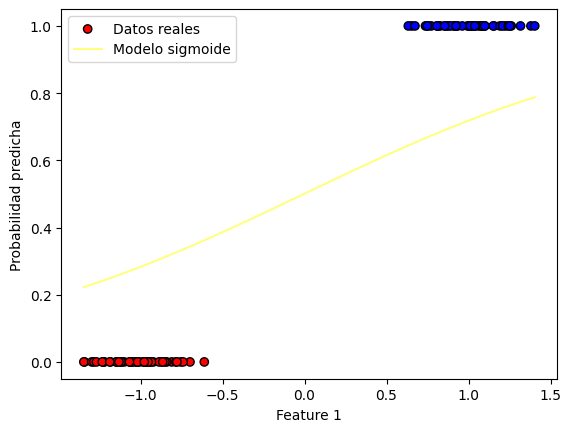

Iteracion: 248
Costo en la iteración 248: 0.33242075404111454
Valor del gradiente 248: [-0.001898   -0.27843215]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00311052 0.93532439]


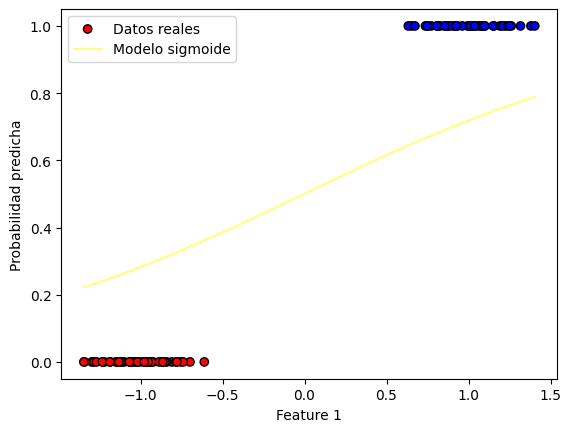

Iteracion: 249
Costo en la iteración 249: 0.3316462713652432
Valor del gradiente 249: [-0.00189985 -0.27785909]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00312952 0.93810298]


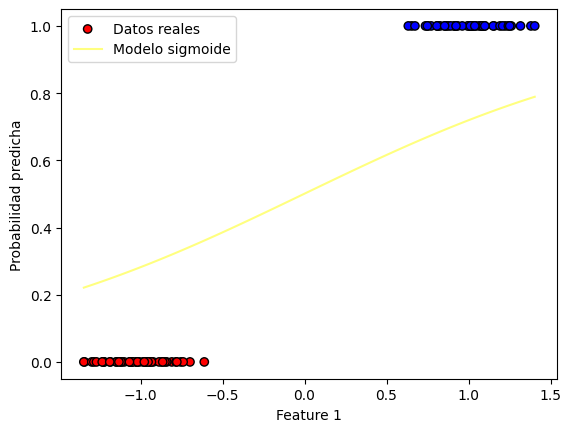

Iteracion: 250
Costo en la iteración 250: 0.33087497211930894
Valor del gradiente 250: [-0.00190168 -0.27728799]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00314854 0.94087586]


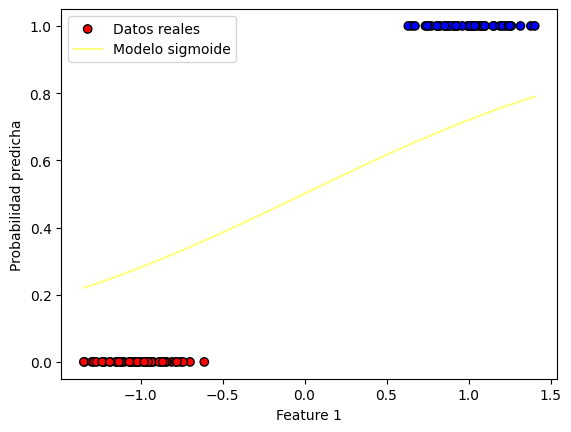

Iteracion: 251
Costo en la iteración 251: 0.3301068388832682
Valor del gradiente 251: [-0.00190348 -0.27671885]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00316757 0.94364305]


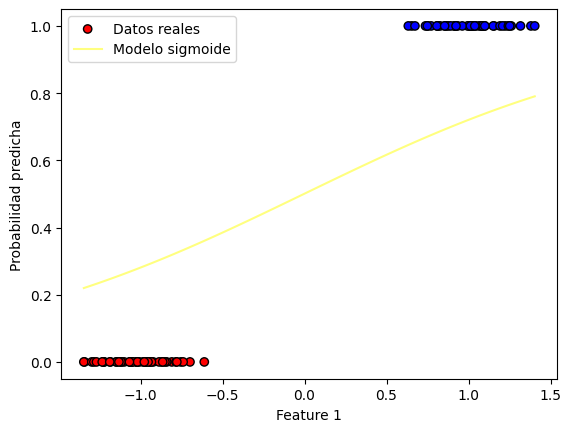

Iteracion: 252
Costo en la iteración 252: 0.32934185434883384
Valor del gradiente 252: [-0.00190526 -0.27615166]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00318662 0.94640456]


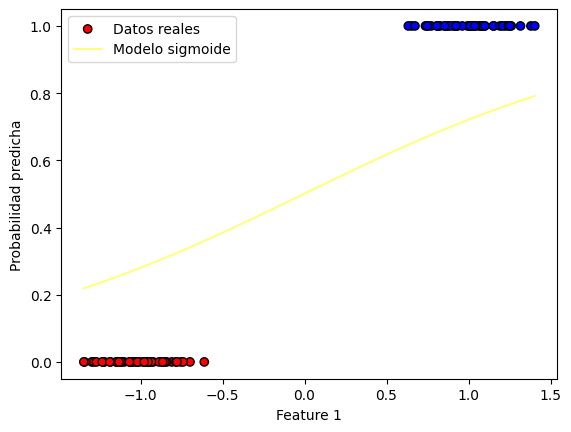

Iteracion: 253
Costo en la iteración 253: 0.32858000131871756
Valor del gradiente 253: [-0.00190701 -0.2755864 ]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00320569 0.94916043]


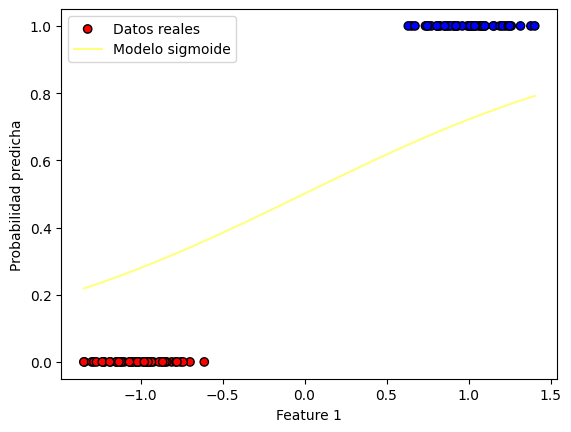

Iteracion: 254
Costo en la iteración 254: 0.3278212627058742
Valor del gradiente 254: [-0.00190874 -0.27502307]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00322478 0.95191066]


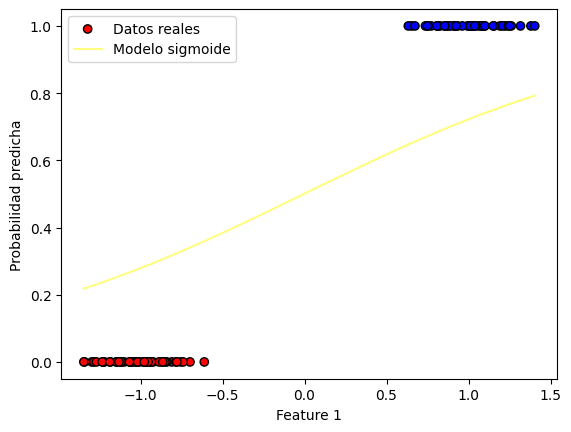

Iteracion: 255
Costo en la iteración 255: 0.3270656215327525
Valor del gradiente 255: [-0.00191045 -0.27446167]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00324389 0.95465528]


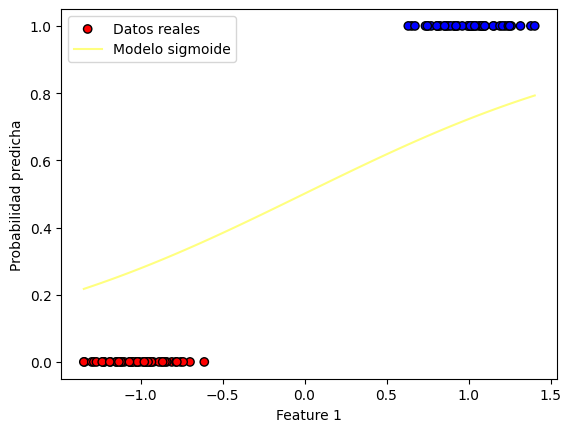

Iteracion: 256
Costo en la iteración 256: 0.3263130609305499
Valor del gradiente 256: [-0.00191213 -0.27390217]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00326301 0.9573943 ]


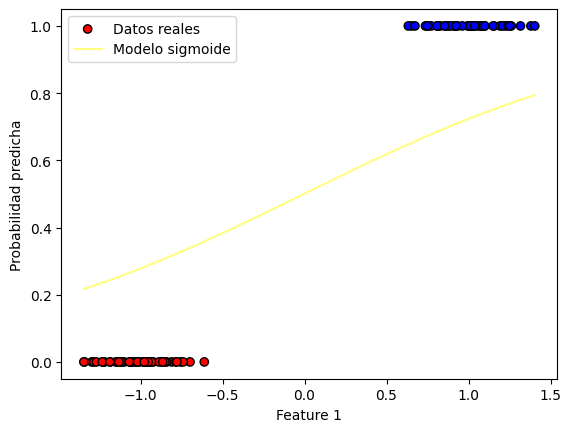

Iteracion: 257
Costo en la iteración 257: 0.325563564138472
Valor del gradiente 257: [-0.00191379 -0.27334459]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00328215 0.96012774]


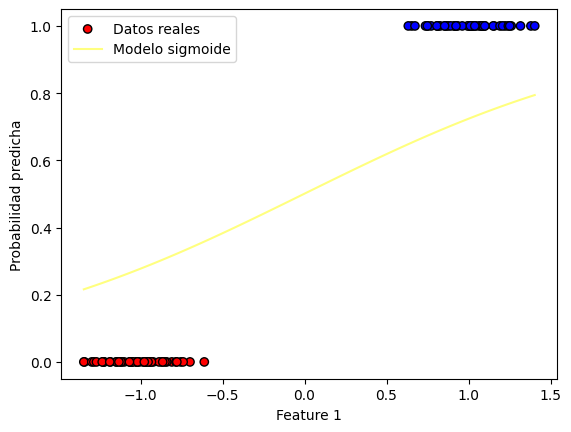

Iteracion: 258
Costo en la iteración 258: 0.32481711450299655
Valor del gradiente 258: [-0.00191542 -0.2727889 ]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.0033013  0.96285563]


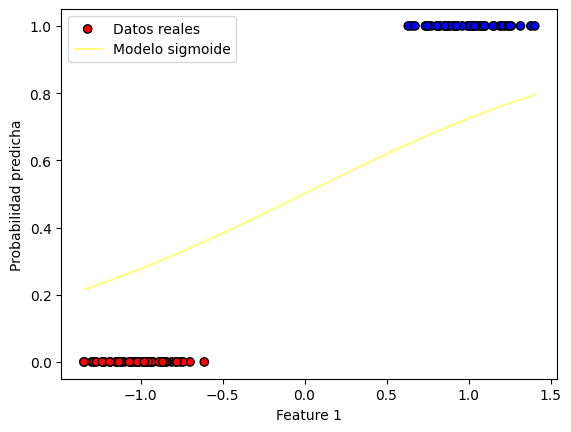

Iteracion: 259
Costo en la iteración 259: 0.3240736954771426
Valor del gradiente 259: [-0.00191703 -0.2722351 ]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00332047 0.96557798]


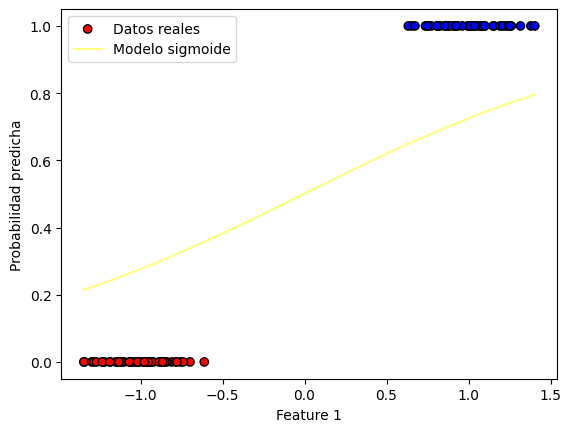

Iteracion: 260
Costo en la iteración 260: 0.32333329061974303
Valor del gradiente 260: [-0.00191862 -0.27168319]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00333966 0.96829482]


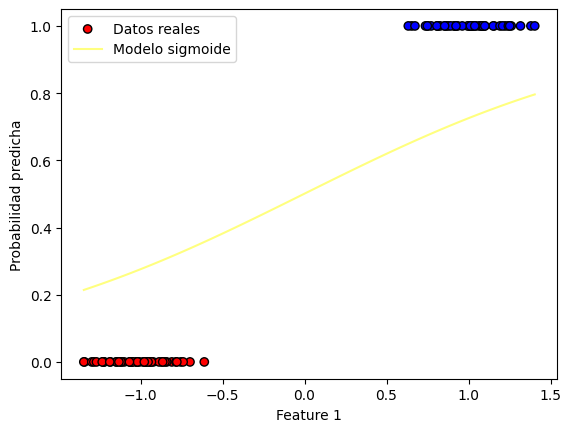

Iteracion: 261
Costo en la iteración 261: 0.3225958835947229
Valor del gradiente 261: [-0.00192019 -0.27113315]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00335886 0.97100615]


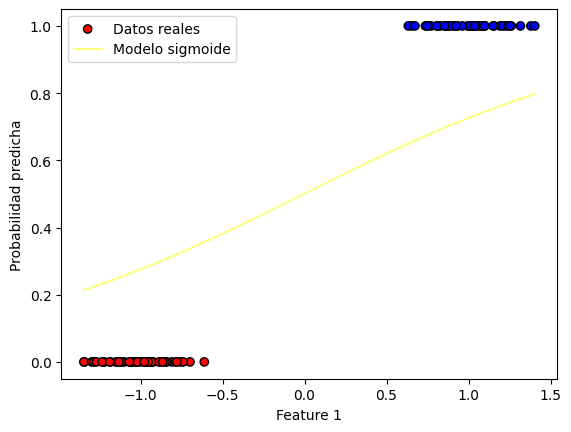

Iteracion: 262
Costo en la iteración 262: 0.3218614581703816
Valor del gradiente 262: [-0.00192173 -0.27058498]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00337808 0.973712  ]


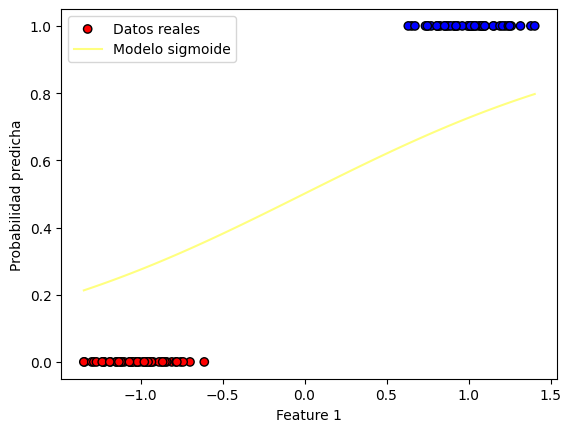

Iteracion: 263
Costo en la iteración 263: 0.3211299982186797
Valor del gradiente 263: [-0.00192325 -0.27003866]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00339731 0.97641238]


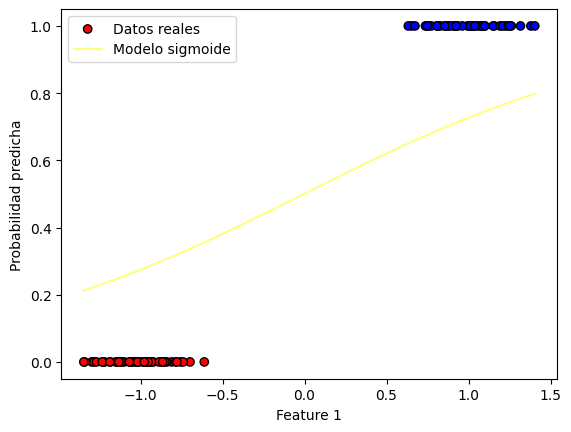

Iteracion: 264
Costo en la iteración 264: 0.32040148771453064
Valor del gradiente 264: [-0.00192475 -0.2694942 ]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00341656 0.97910733]


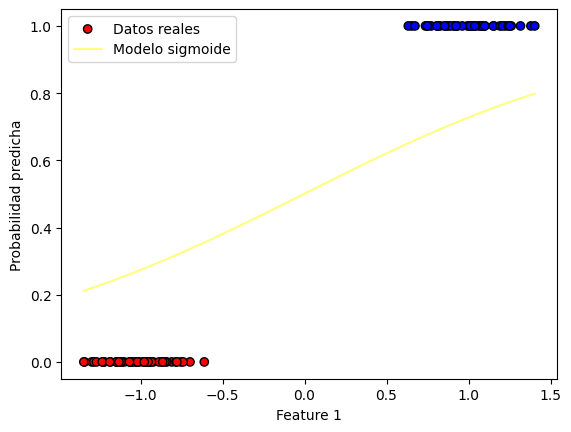

Iteracion: 265
Costo en la iteración 265: 0.31967591073509644
Valor del gradiente 265: [-0.00192623 -0.26895158]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00343582 0.98179684]


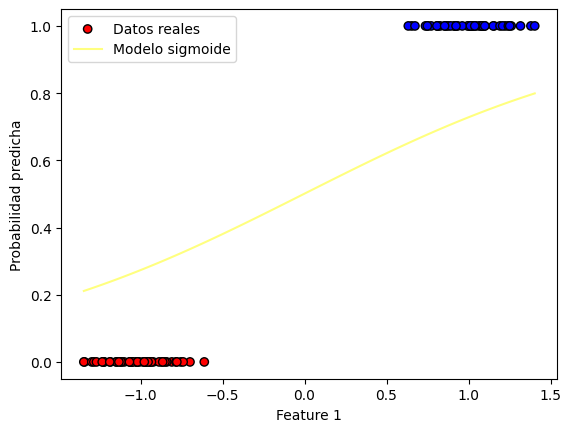

Iteracion: 266
Costo en la iteración 266: 0.3189532514590882
Valor del gradiente 266: [-0.00192768 -0.2684108 ]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.0034551  0.98448095]


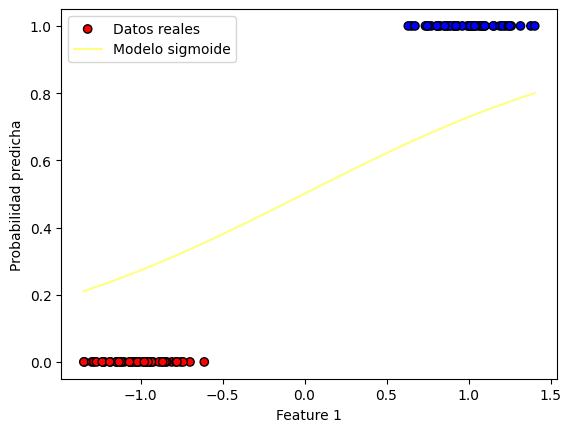

Iteracion: 267
Costo en la iteración 267: 0.3182334941660709
Valor del gradiente 267: [-0.00192912 -0.26787185]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00347439 0.98715967]


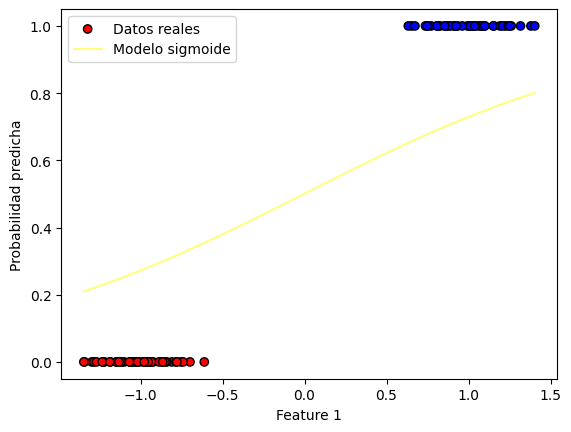

Iteracion: 268
Costo en la iteración 268: 0.3175166232357728
Valor del gradiente 268: [-0.00193053 -0.26733472]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00349369 0.98983301]


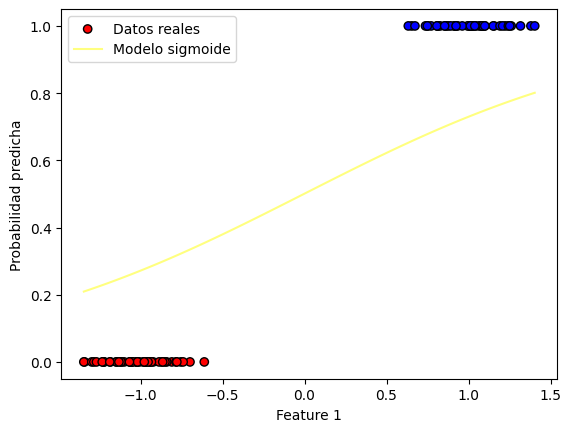

Iteracion: 269
Costo en la iteración 269: 0.3168026231473994
Valor del gradiente 269: [-0.00193192 -0.2667994 ]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00351301 0.99250101]


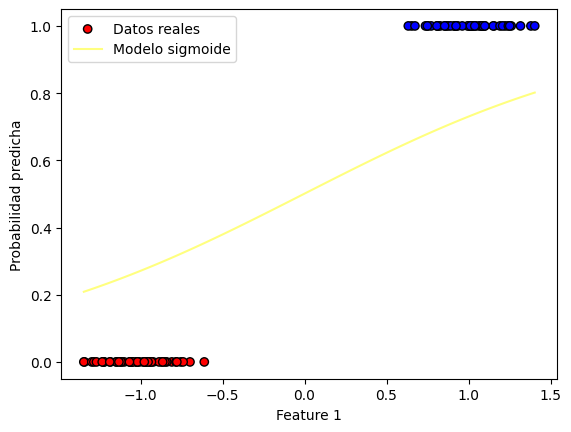

Iteracion: 270
Costo en la iteración 270: 0.3160914784789514
Valor del gradiente 270: [-0.00193329 -0.26626589]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00353234 0.99516367]


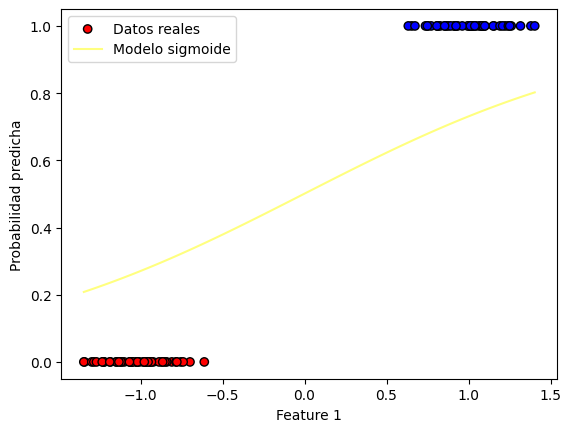

Iteracion: 271
Costo en la iteración 271: 0.3153831739065477
Valor del gradiente 271: [-0.00193464 -0.26573417]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00355169 0.99782101]


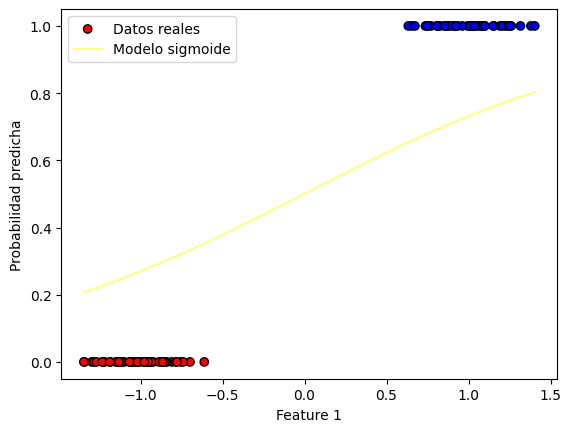

Iteracion: 272
Costo en la iteración 272: 0.3146776942037518
Valor del gradiente 272: [-0.00193596 -0.26520425]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00357105 1.00047305]


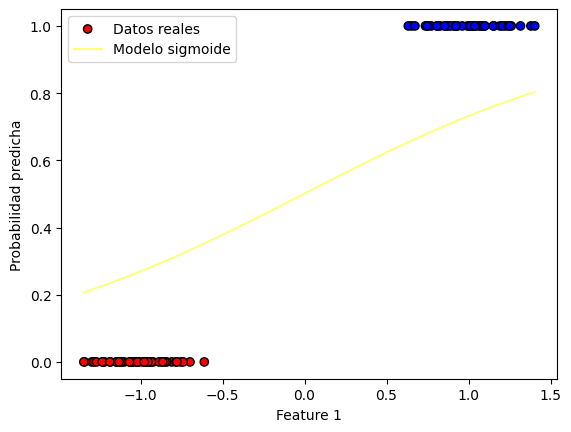

Iteracion: 273
Costo en la iteración 273: 0.31397502424090407
Valor del gradiente 273: [-0.00193727 -0.26467611]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00359042 1.00311981]


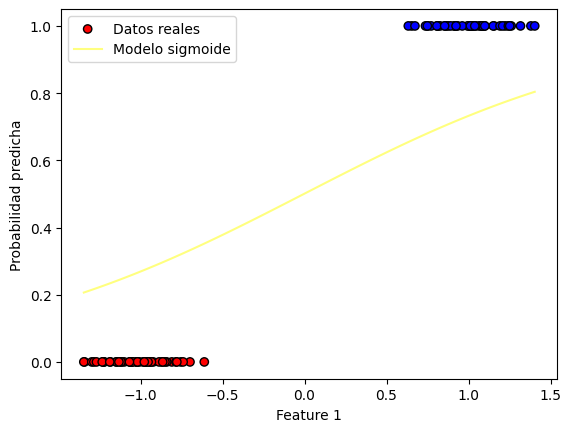

Iteracion: 274
Costo en la iteración 274: 0.3132751489844565
Valor del gradiente 274: [-0.00193855 -0.26414975]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00360981 1.00576131]


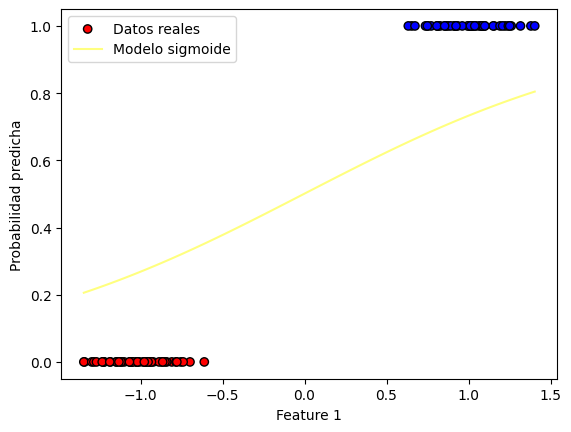

Iteracion: 275
Costo en la iteración 275: 0.312578053496314
Valor del gradiente 275: [-0.00193982 -0.26362516]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00362921 1.00839756]


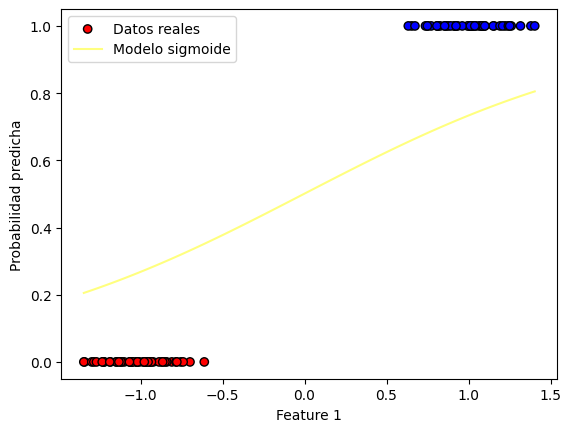

Iteracion: 276
Costo en la iteración 276: 0.3118837229331775
Valor del gradiente 276: [-0.00194106 -0.26310233]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00364862 1.01102859]


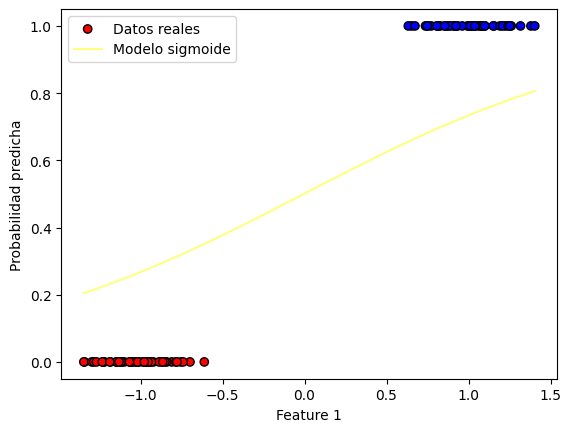

Iteracion: 277
Costo en la iteración 277: 0.311192142545894
Valor del gradiente 277: [-0.00194229 -0.26258125]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00366804 1.0136544 ]


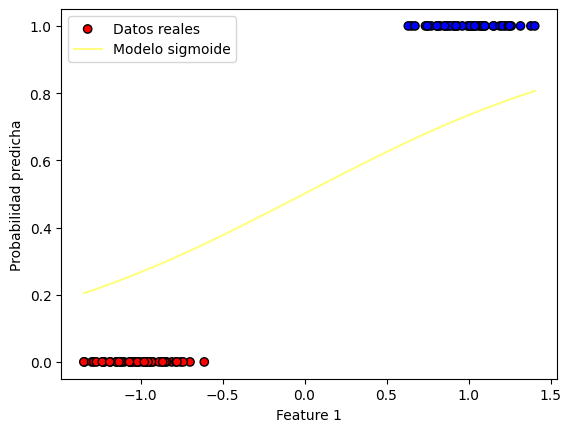

Iteracion: 278
Costo en la iteración 278: 0.31050329767880835
Valor del gradiente 278: [-0.00194349 -0.26206192]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00368747 1.01627502]


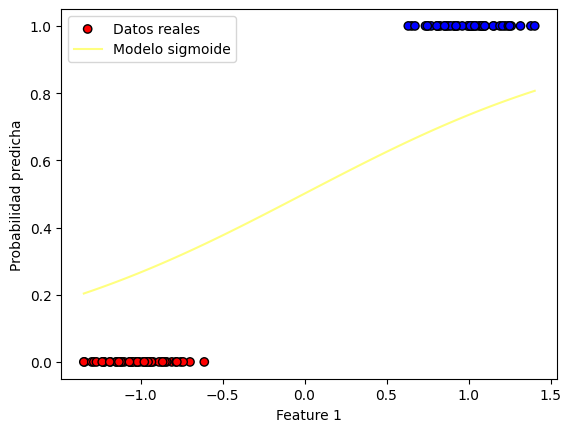

Iteracion: 279
Costo en la iteración 279: 0.3098171737691216
Valor del gradiente 279: [-0.00194468 -0.26154433]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00370692 1.01889046]


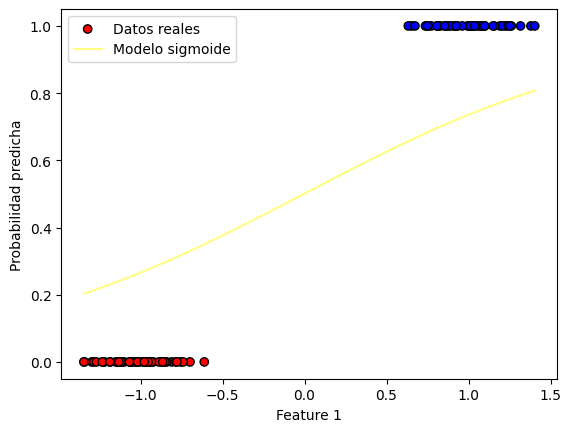

Iteracion: 280
Costo en la iteración 280: 0.3091337563462519
Valor del gradiente 280: [-0.00194584 -0.26102847]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00372638 1.02150074]


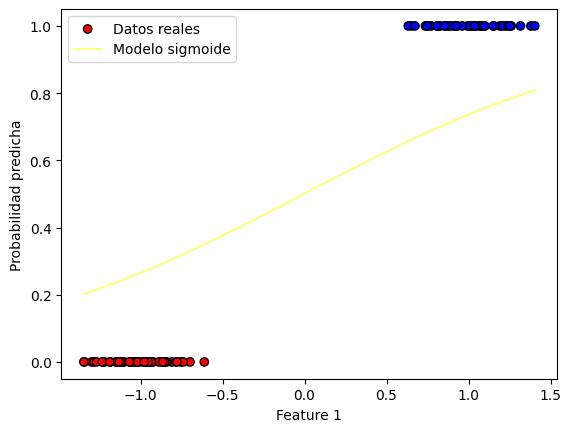

Iteracion: 281
Costo en la iteración 281: 0.3084530310312005
Valor del gradiente 281: [-0.00194699 -0.26051433]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00374585 1.02410589]


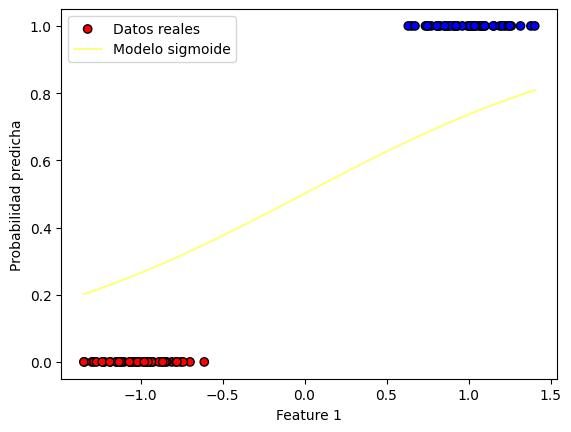

Iteracion: 282
Costo en la iteración 282: 0.30777498353592153
Valor del gradiente 282: [-0.00194811 -0.26000192]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00376533 1.02670591]


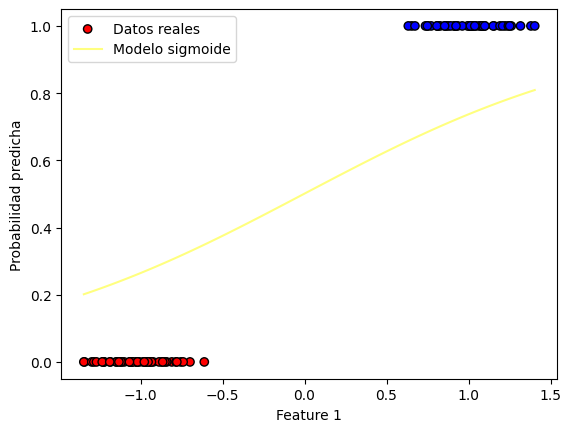

Iteracion: 283
Costo en la iteración 283: 0.30709959966269645
Valor del gradiente 283: [-0.00194922 -0.25949122]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00378482 1.02930082]


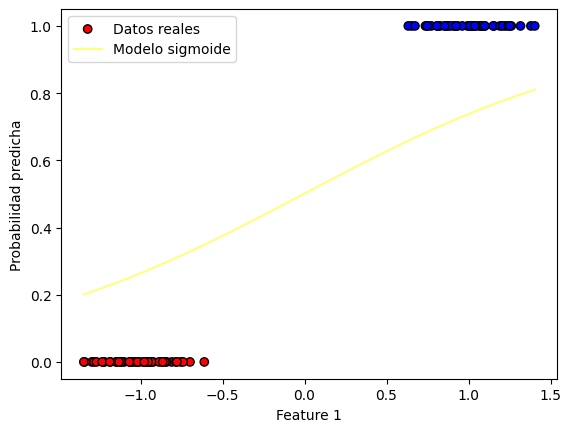

Iteracion: 284
Costo en la iteración 284: 0.3064268653035124
Valor del gradiente 284: [-0.00195031 -0.25898222]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00380433 1.03189064]


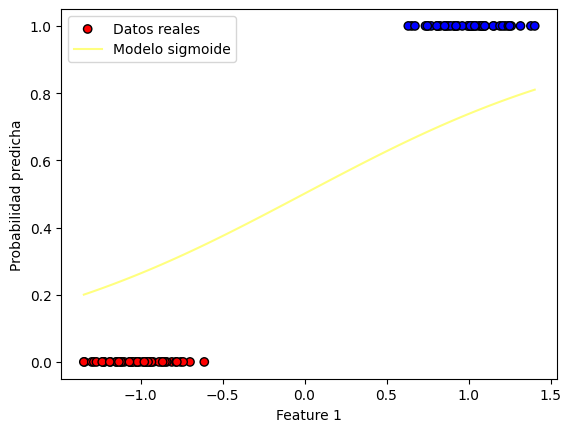

Iteracion: 285
Costo en la iteración 285: 0.30575676643944444
Valor del gradiente 285: [-0.00195138 -0.25847491]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00382384 1.03447539]


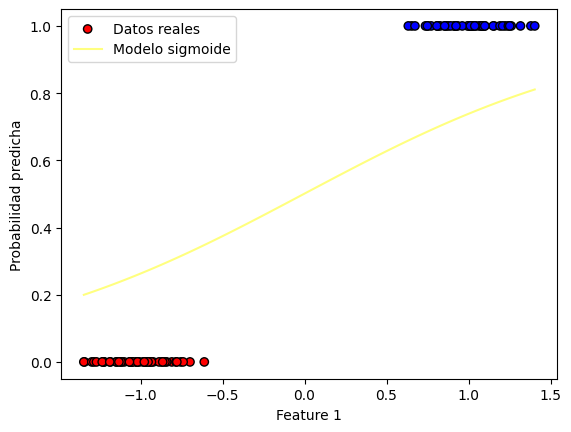

Iteracion: 286
Costo en la iteración 286: 0.30508928914004235
Valor del gradiente 286: [-0.00195243 -0.2579693 ]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00384336 1.03705508]


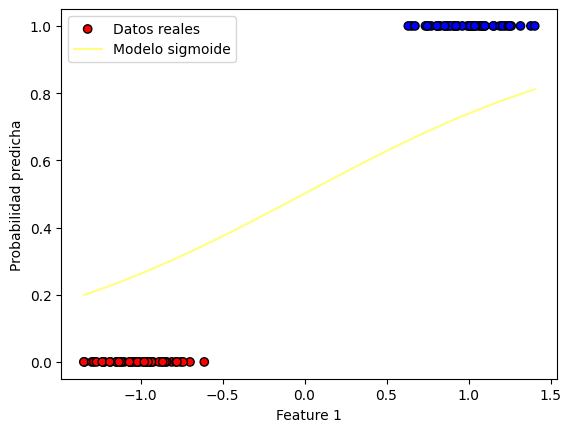

Iteracion: 287
Costo en la iteración 287: 0.30442441956272154
Valor del gradiente 287: [-0.00195346 -0.25746537]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.0038629  1.03962974]


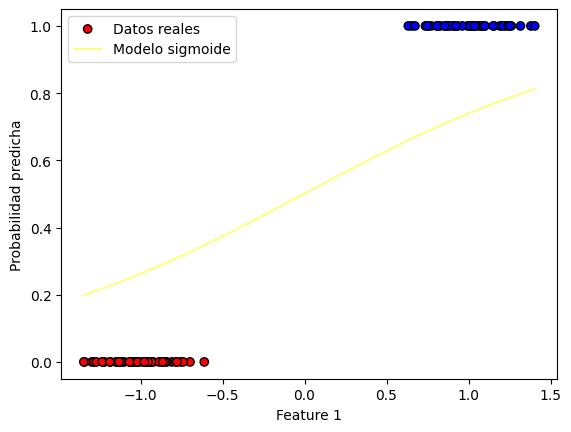

Iteracion: 288
Costo en la iteración 288: 0.3037621439521575
Valor del gradiente 288: [-0.00195447 -0.25696311]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00388244 1.04219937]


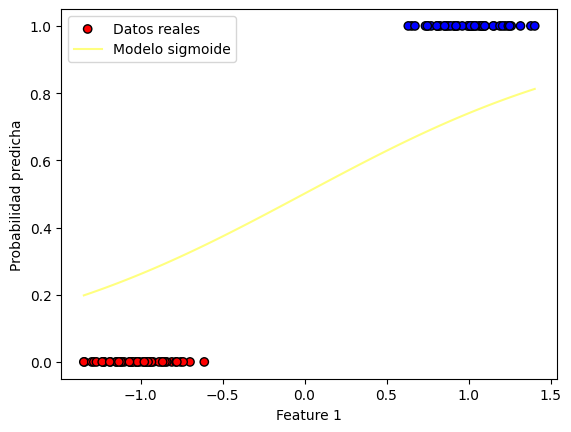

Iteracion: 289
Costo en la iteración 289: 0.30310244863968516
Valor del gradiente 289: [-0.00195547 -0.25646253]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.003902   1.04476399]


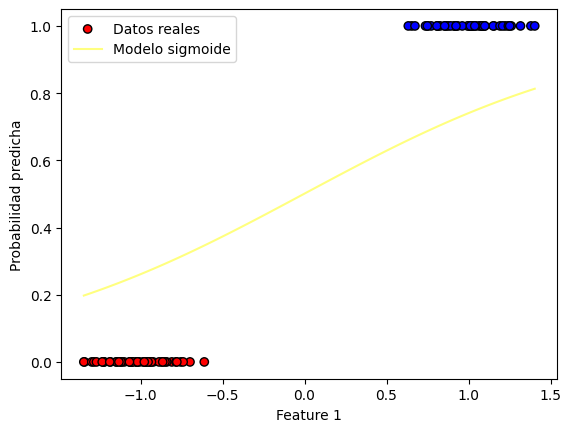

Iteracion: 290
Costo en la iteración 290: 0.30244532004270175
Valor del gradiente 290: [-0.00195645 -0.2559636 ]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00392156 1.04732363]


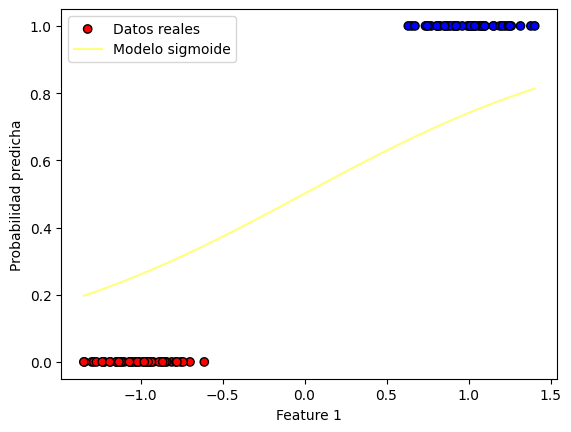

Iteracion: 291
Costo en la iteración 291: 0.30179074466407363
Valor del gradiente 291: [-0.0019574  -0.25546633]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00394114 1.04987829]


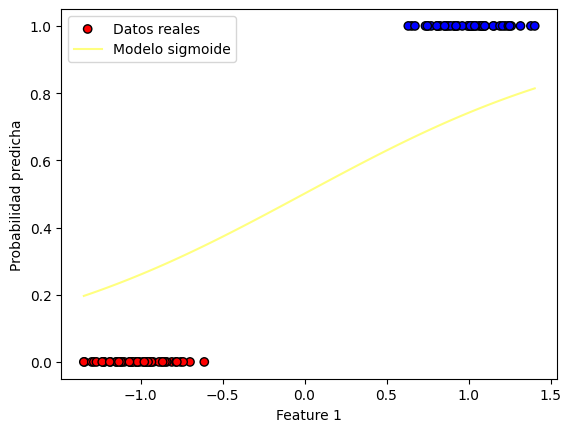

Iteracion: 292
Costo en la iteración 292: 0.3011387090915476
Valor del gradiente 292: [-0.00195834 -0.25497071]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00396072 1.052428  ]


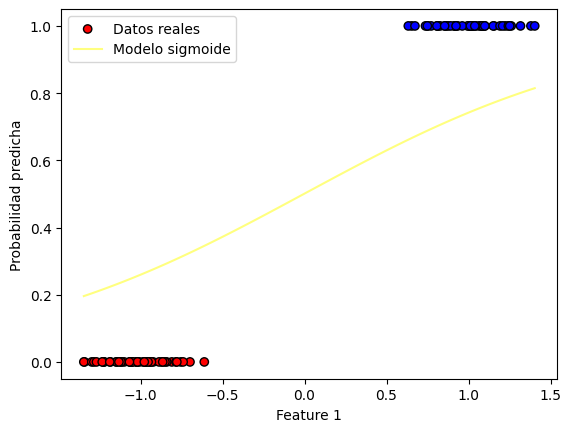

Iteracion: 293
Costo en la iteración 293: 0.3004891999971658
Valor del gradiente 293: [-0.00195927 -0.25447673]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00398031 1.05497277]


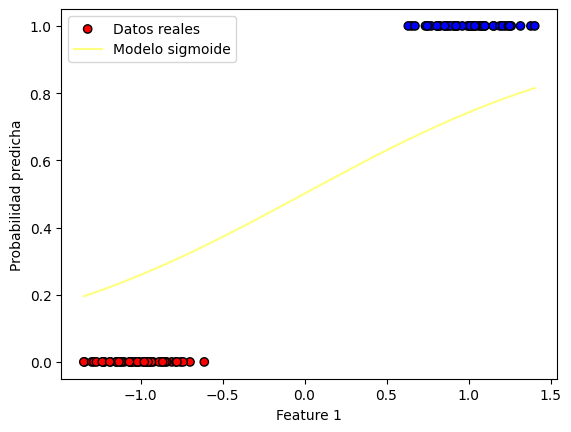

Iteracion: 294
Costo en la iteración 294: 0.2998422041366849
Valor del gradiente 294: [-0.00196017 -0.25398438]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00399991 1.05751261]


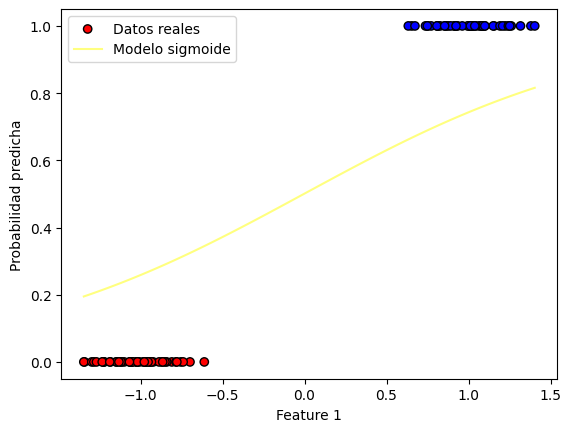

Iteracion: 295
Costo en la iteración 295: 0.29919770834899867
Valor del gradiente 295: [-0.00196106 -0.25349367]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00401953 1.06004755]


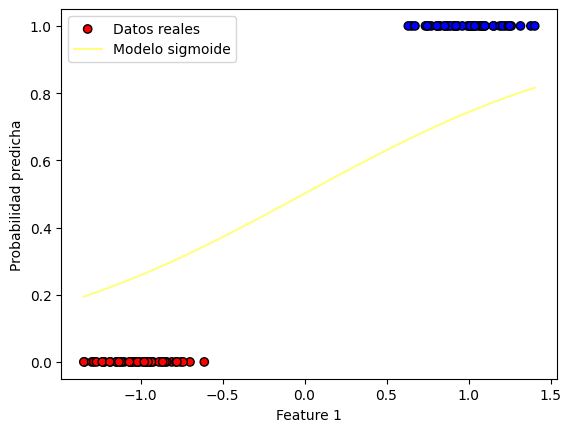

Iteracion: 296
Costo en la iteración 296: 0.2985556995555652
Valor del gradiente 296: [-0.00196193 -0.25300457]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00403914 1.06257759]


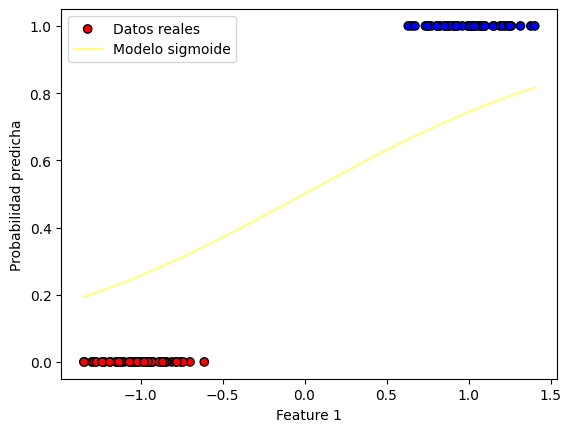

Iteracion: 297
Costo en la iteración 297: 0.2979161647598378
Valor del gradiente 297: [-0.00196278 -0.25251708]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00405877 1.06510276]


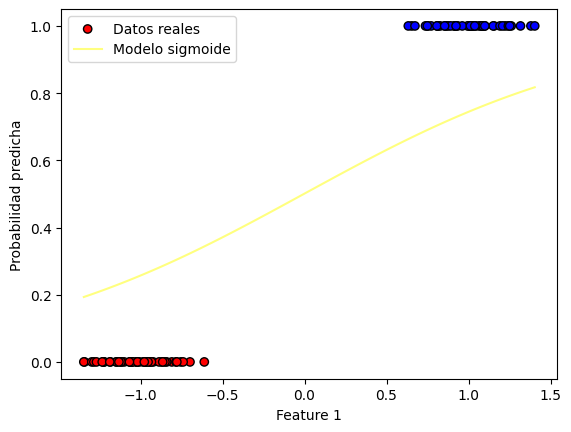

Iteracion: 298
Costo en la iteración 298: 0.29727909104669953
Valor del gradiente 298: [-0.00196362 -0.25203121]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00407841 1.06762308]


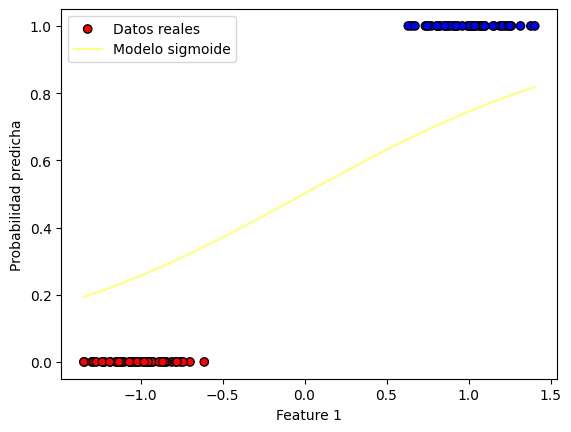

Iteracion: 299
Costo en la iteración 299: 0.296644465581902
Valor del gradiente 299: [-0.00196444 -0.25154693]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00409805 1.07013855]


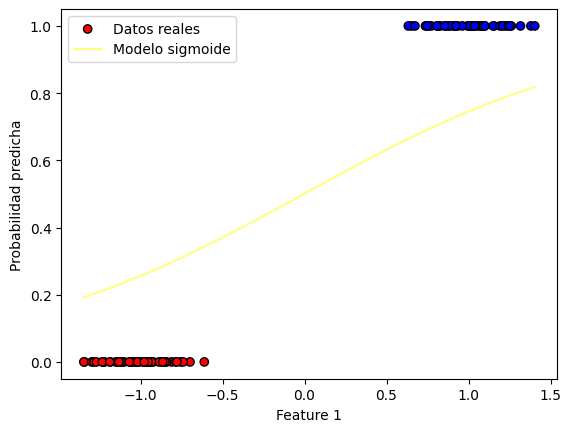

Iteracion: 300
Costo en la iteración 300: 0.2960122756115074
Valor del gradiente 300: [-0.00196524 -0.25106425]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00411771 1.07264919]


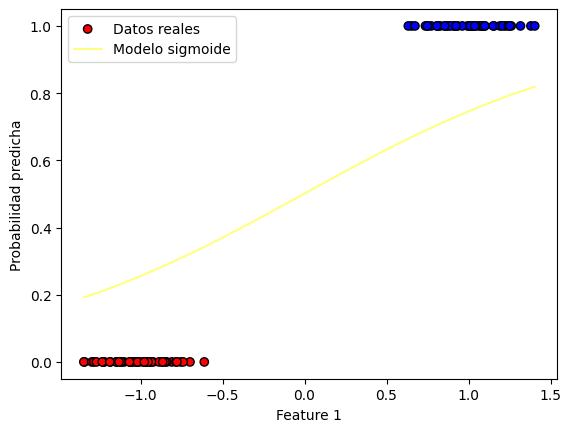

Iteracion: 301
Costo en la iteración 301: 0.2953825084613352
Valor del gradiente 301: [-0.00196603 -0.25058316]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00413737 1.07515502]


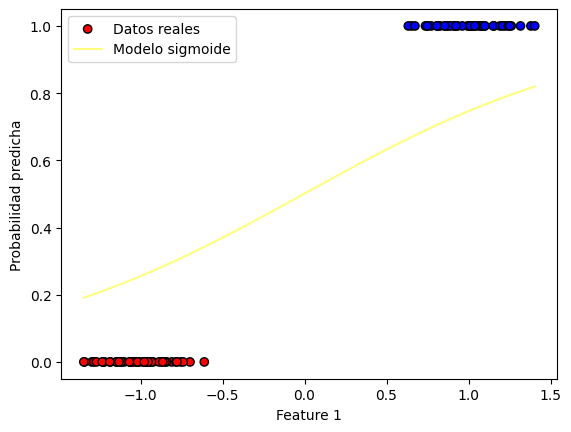

Iteracion: 302
Costo en la iteración 302: 0.2947551515364121
Valor del gradiente 302: [-0.0019668  -0.25010365]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00415703 1.07765606]


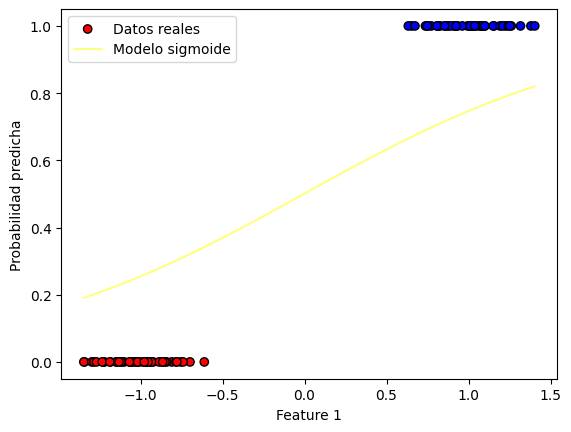

Iteracion: 303
Costo en la iteración 303: 0.29413019232042587
Valor del gradiente 303: [-0.00196755 -0.24962571]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00417671 1.08015231]


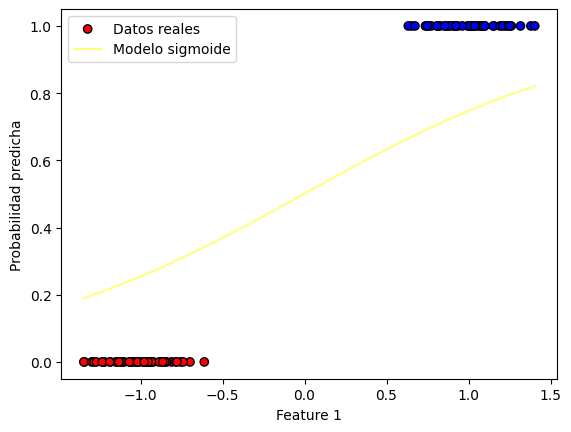

Iteracion: 304
Costo en la iteración 304: 0.2935076183751831
Valor del gradiente 304: [-0.00196829 -0.24914934]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00419639 1.08264381]


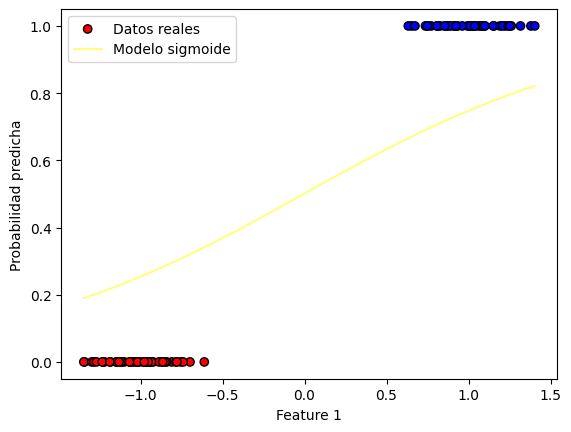

Iteracion: 305
Costo en la iteración 305: 0.2928874173400704
Valor del gradiente 305: [-0.00196901 -0.24867453]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00421608 1.08513055]


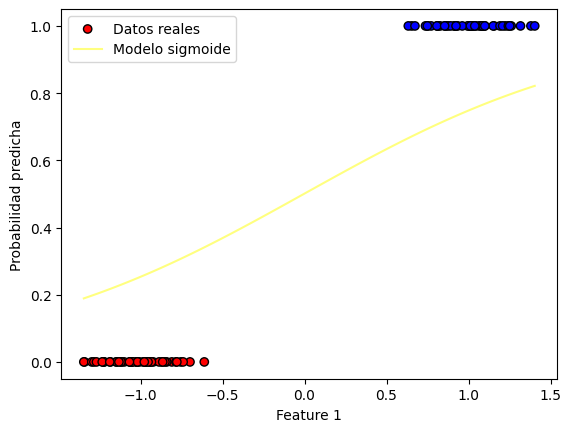

Iteracion: 306
Costo en la iteración 306: 0.29226957693151984
Valor del gradiente 306: [-0.00196971 -0.24820127]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00423578 1.08761257]


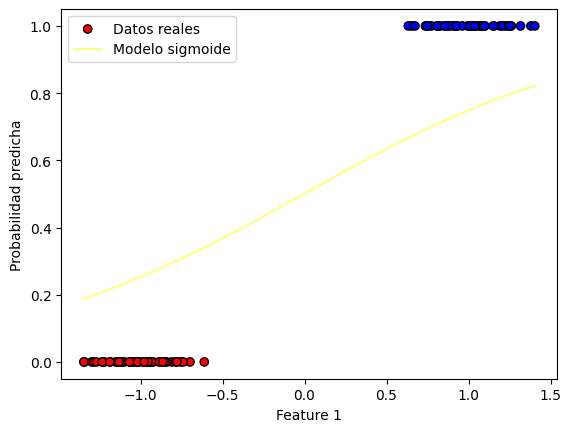

Iteracion: 307
Costo en la iteración 307: 0.29165408494247747
Valor del gradiente 307: [-0.0019704  -0.24772956]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00425548 1.09008986]


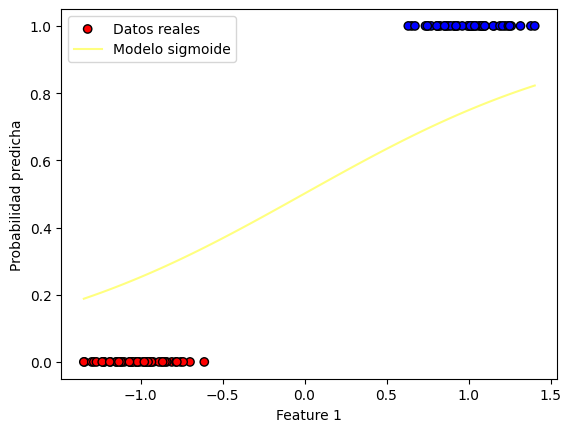

Iteracion: 308
Costo en la iteración 308: 0.29104092924187597
Valor del gradiente 308: [-0.00197107 -0.2472594 ]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00427519 1.09256245]


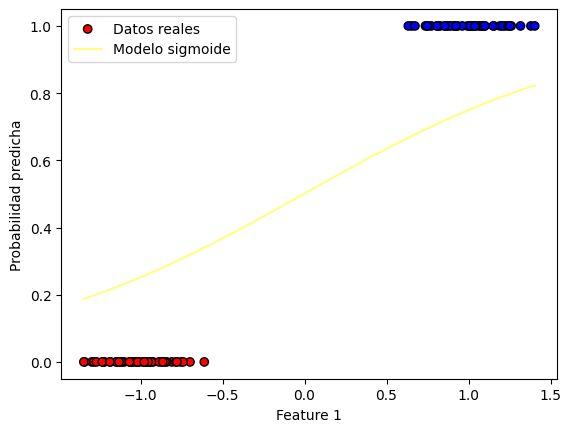

Iteracion: 309
Costo en la iteración 309: 0.2904300977741111
Valor del gradiente 309: [-0.00197173 -0.24679077]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00429491 1.09503036]


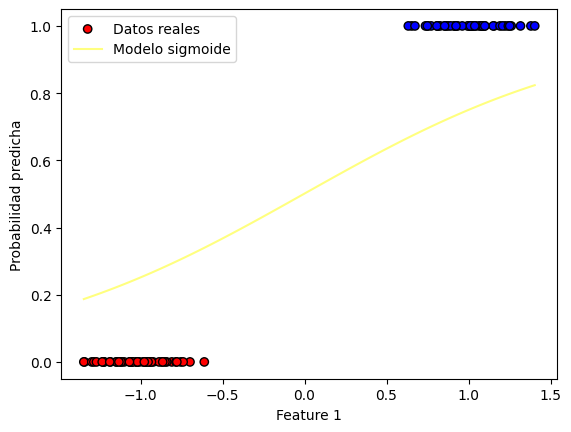

Iteracion: 310
Costo en la iteración 310: 0.2898215785585209
Valor del gradiente 310: [-0.00197237 -0.24632367]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00431463 1.0974936 ]


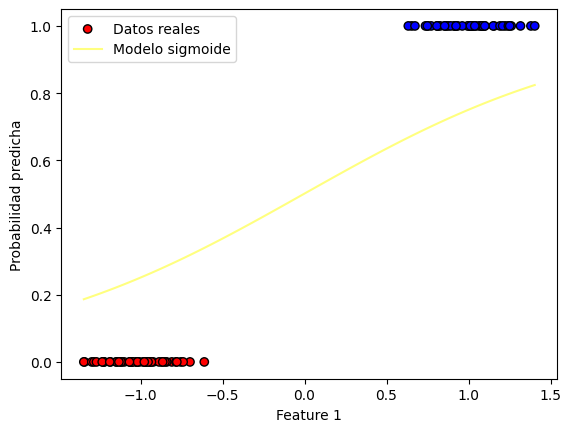

Iteracion: 311
Costo en la iteración 311: 0.2892153596888699
Valor del gradiente 311: [-0.001973   -0.24585809]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00433436 1.09995218]


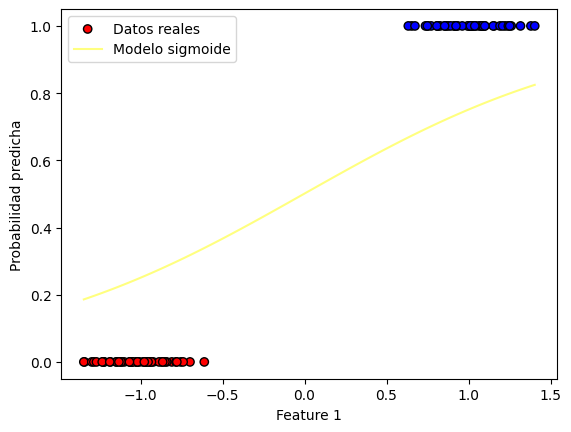

Iteracion: 312
Costo en la iteración 312: 0.2886114293328358
Valor del gradiente 312: [-0.00197361 -0.24539403]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.0043541  1.10240612]


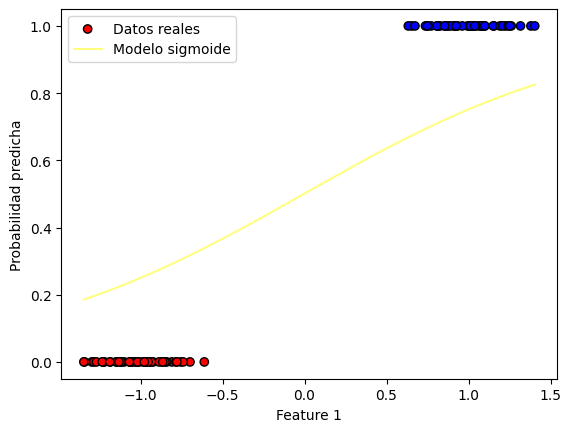

Iteracion: 313
Costo en la iteración 313: 0.2880097757314998
Valor del gradiente 313: [-0.0019742  -0.24493148]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00437384 1.10485544]


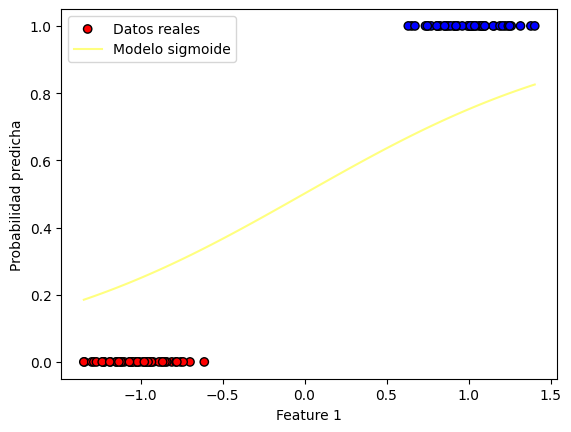

Iteracion: 314
Costo en la iteración 314: 0.28741038719884143
Valor del gradiente 314: [-0.00197478 -0.24447043]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00439359 1.10730014]


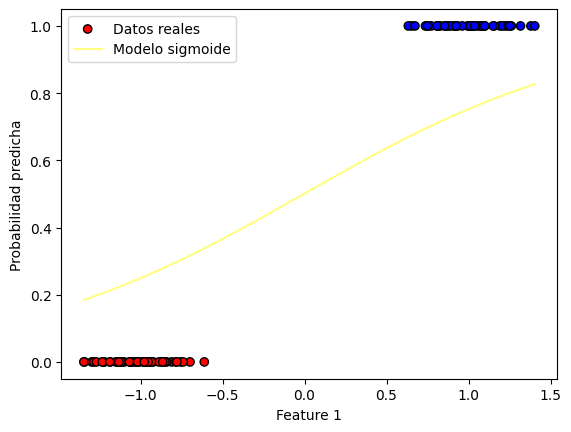

Iteracion: 315
Costo en la iteración 315: 0.28681325212123604
Valor del gradiente 315: [-0.00197535 -0.24401089]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00441334 1.10974025]


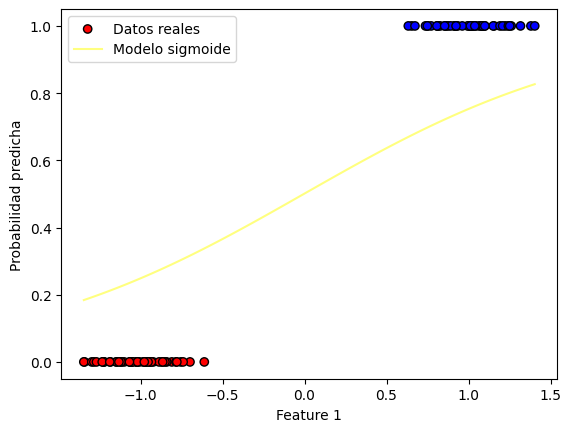

Iteracion: 316
Costo en la iteración 316: 0.28621835895695585
Valor del gradiente 316: [-0.0019759  -0.24355283]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.0044331  1.11217578]


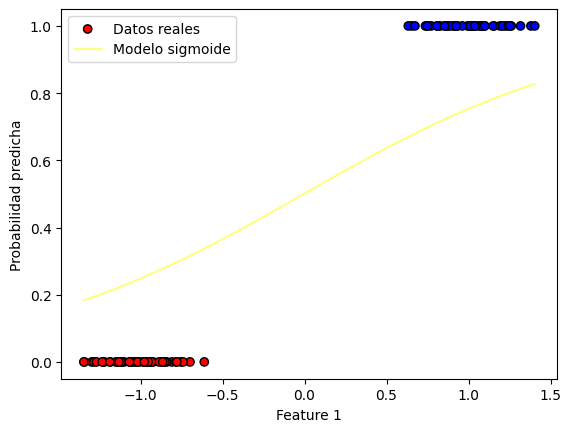

Iteracion: 317
Costo en la iteración 317: 0.2856256962356752
Valor del gradiente 317: [-0.00197644 -0.24309626]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00445287 1.11460674]


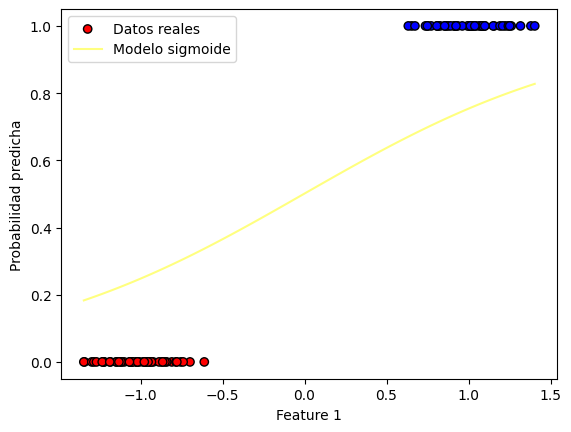

Iteracion: 318
Costo en la iteración 318: 0.28503525255797807
Valor del gradiente 318: [-0.00197696 -0.24264116]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00447264 1.11703315]


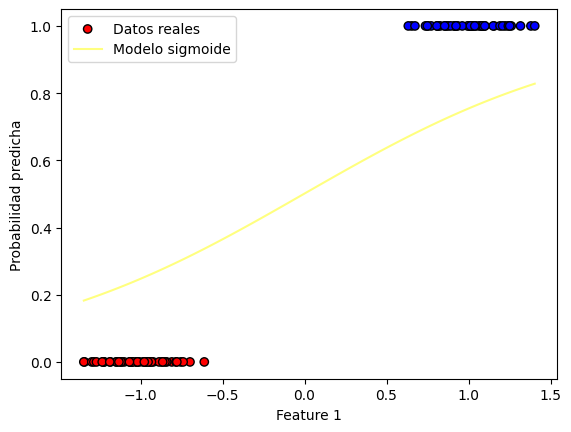

Iteracion: 319
Costo en la iteración 319: 0.28444701659487054
Valor del gradiente 319: [-0.00197746 -0.24218754]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00449241 1.11945503]


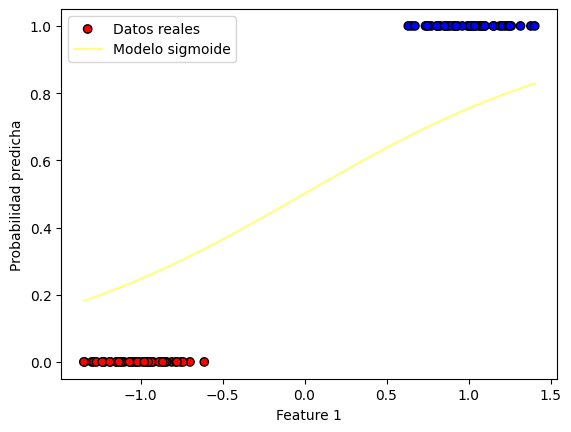

Iteracion: 320
Costo en la iteración 320: 0.28386097708729524
Valor del gradiente 320: [-0.00197796 -0.24173539]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00451219 1.12187238]


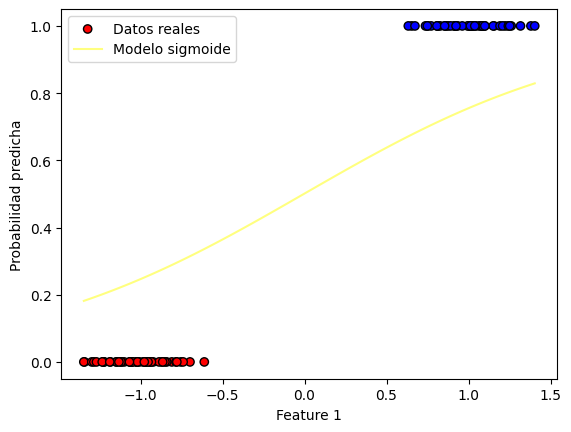

Iteracion: 321
Costo en la iteración 321: 0.2832771228456509
Valor del gradiente 321: [-0.00197844 -0.2412847 ]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00453198 1.12428523]


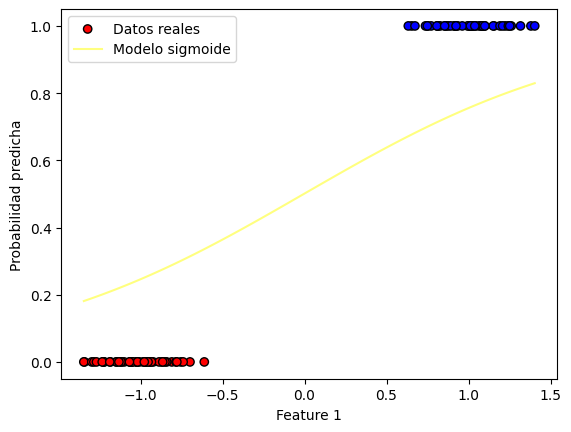

Iteracion: 322
Costo en la iteración 322: 0.2826954427493127
Valor del gradiente 322: [-0.0019789  -0.24083546]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00455176 1.12669358]


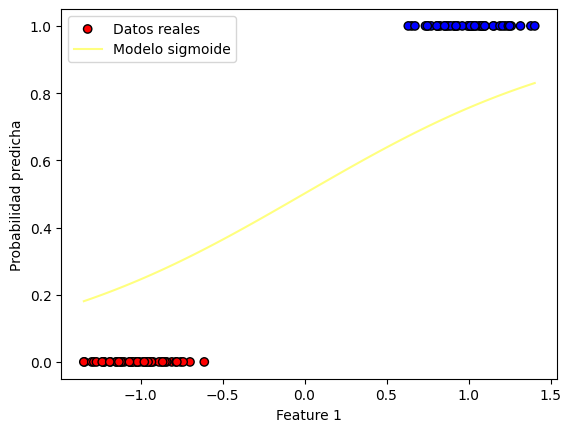

Iteracion: 323
Costo en la iteración 323: 0.28211592574615935
Valor del gradiente 323: [-0.00197935 -0.24038767]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00457156 1.12909746]


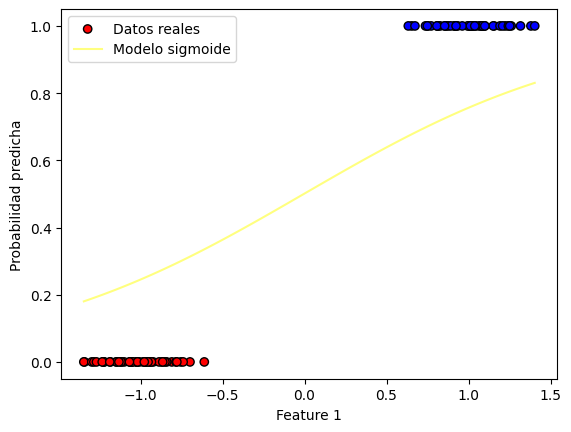

Iteracion: 324
Costo en la iteración 324: 0.28153856085210033
Valor del gradiente 324: [-0.00197979 -0.23994132]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00459136 1.13149687]


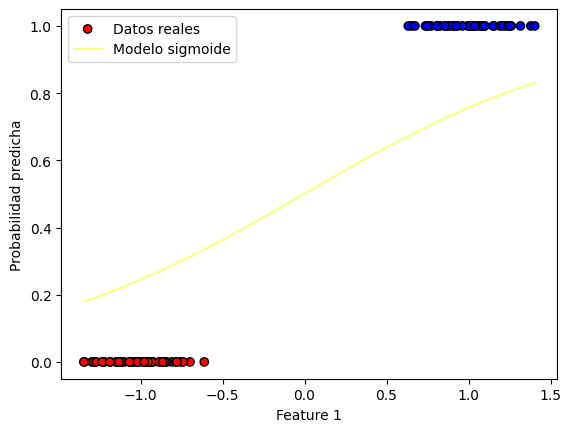

Iteracion: 325
Costo en la iteración 325: 0.28096333715060895
Valor del gradiente 325: [-0.00198021 -0.23949641]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00461116 1.13389184]


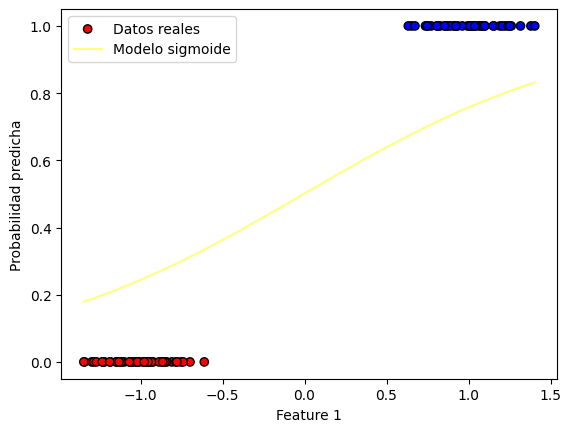

Iteracion: 326
Costo en la iteración 326: 0.28039024379225685
Valor del gradiente 326: [-0.00198062 -0.23905293]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00463096 1.13628237]


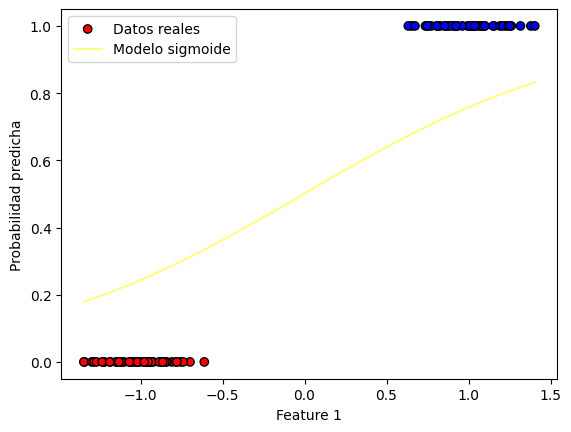

Iteracion: 327
Costo en la iteración 327: 0.2798192699942532
Valor del gradiente 327: [-0.00198102 -0.23861088]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00465077 1.13866847]


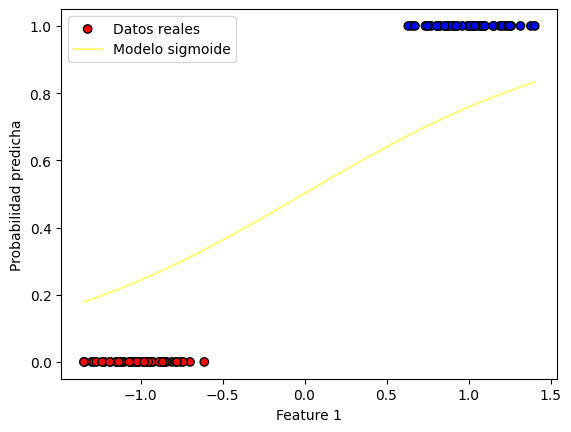

Iteracion: 328
Costo en la iteración 328: 0.27925040503998616
Valor del gradiente 328: [-0.0019814  -0.23817025]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00467059 1.14105018]


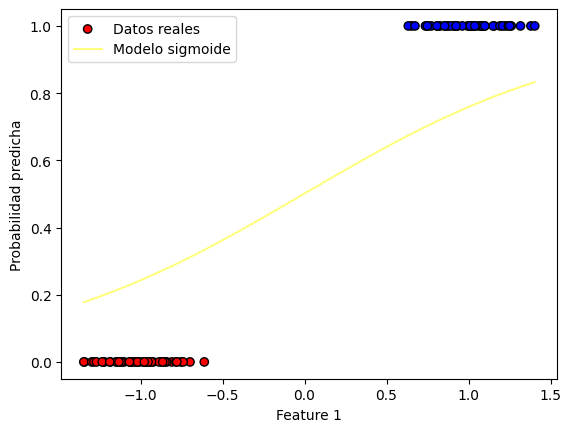

Iteracion: 329
Costo en la iteración 329: 0.2786836382785682
Valor del gradiente 329: [-0.00198177 -0.23773103]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00469041 1.14342749]


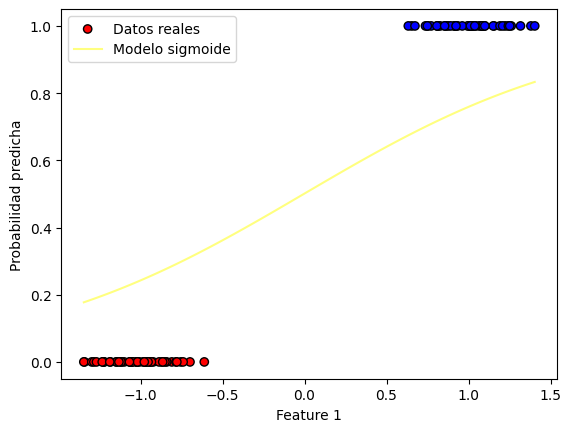

Iteracion: 330
Costo en la iteración 330: 0.2781189591243844
Valor del gradiente 330: [-0.00198212 -0.23729321]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00471023 1.14580042]


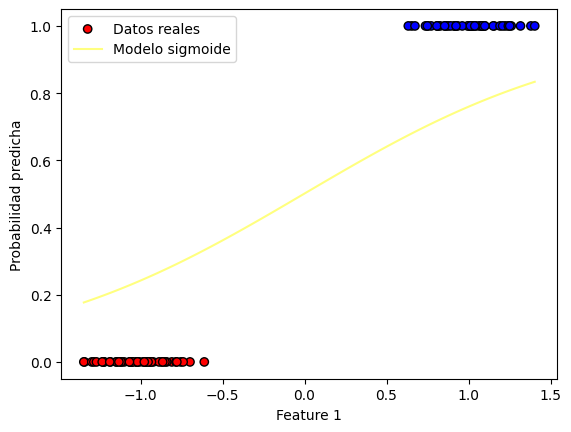

Iteracion: 331
Costo en la iteración 331: 0.27755635705664417
Valor del gradiente 331: [-0.00198247 -0.2368568 ]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00473005 1.14816899]


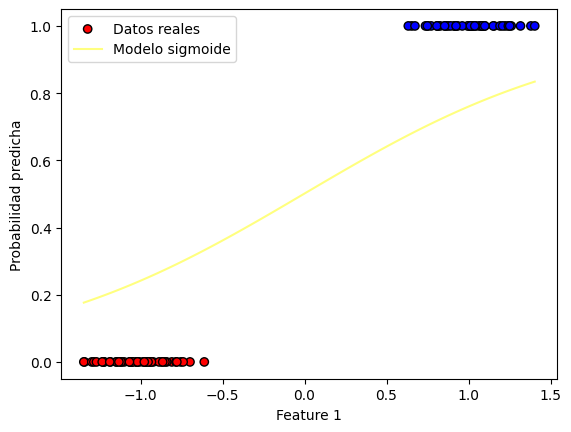

Iteracion: 332
Costo en la iteración 332: 0.27699582161893566
Valor del gradiente 332: [-0.0019828  -0.23642178]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00474988 1.1505332 ]


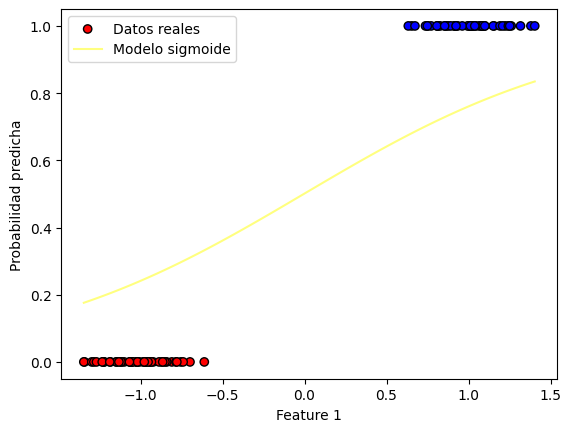

Iteracion: 333
Costo en la iteración 333: 0.27643734241878415
Valor del gradiente 333: [-0.00198311 -0.23598816]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00476971 1.15289309]


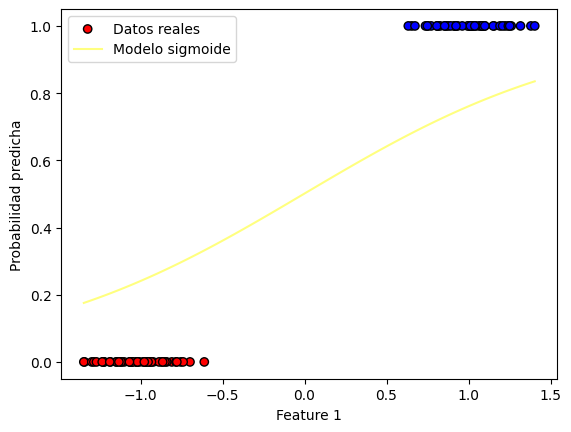

Iteracion: 334
Costo en la iteración 334: 0.27588090912721247
Valor del gradiente 334: [-0.00198342 -0.23555591]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00478955 1.15524865]


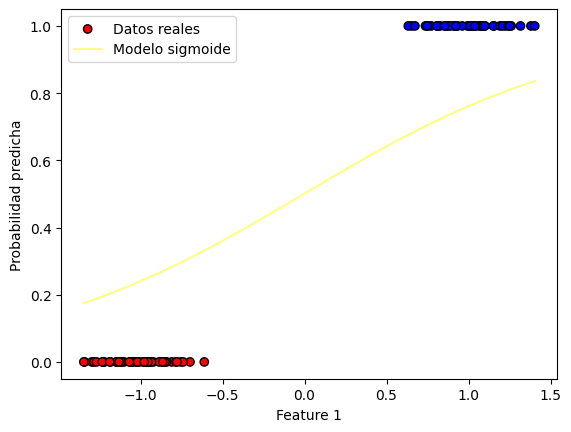

Iteracion: 335
Costo en la iteración 335: 0.2753265114783059
Valor del gradiente 335: [-0.00198371 -0.23512505]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00480938 1.1575999 ]


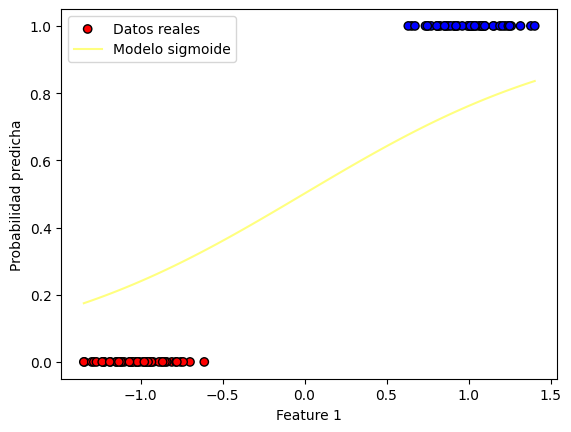

Iteracion: 336
Costo en la iteración 336: 0.27477413926877897
Valor del gradiente 336: [-0.00198399 -0.23469556]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00482922 1.15994685]


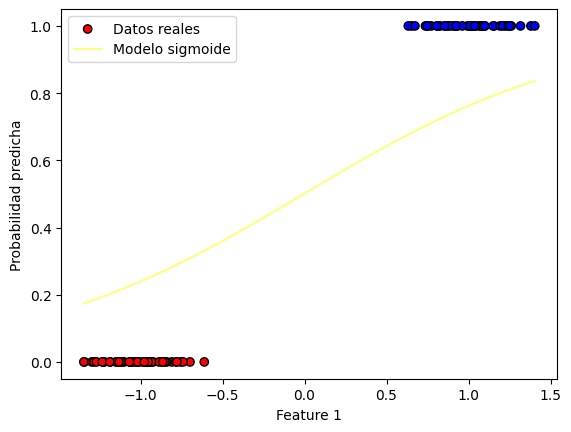

Iteracion: 337
Costo en la iteración 337: 0.27422378235754585
Valor del gradiente 337: [-0.00198425 -0.23426744]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00484906 1.16228953]


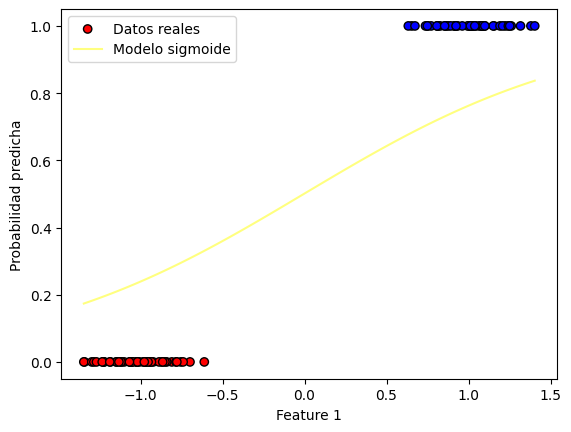

Iteracion: 338
Costo en la iteración 338: 0.27367543066529443
Valor del gradiente 338: [-0.00198451 -0.23384067]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00486891 1.16462793]


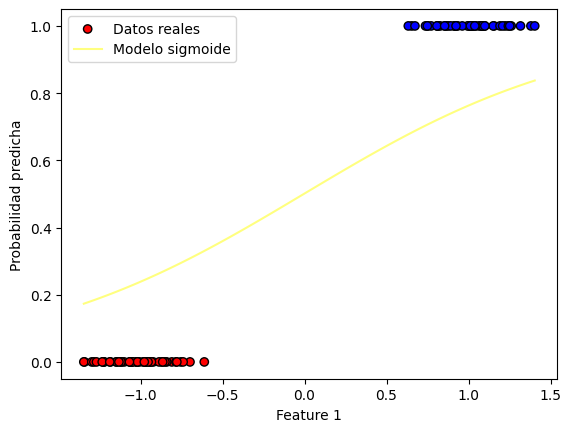

Iteracion: 339
Costo en la iteración 339: 0.27312907417406196
Valor del gradiente 339: [-0.00198475 -0.23341527]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00488876 1.16696209]


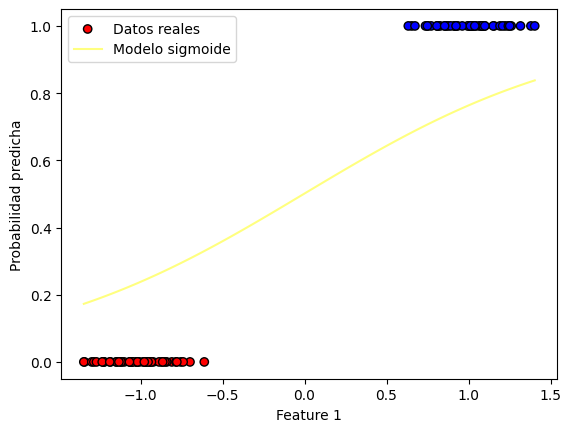

Iteracion: 340
Costo en la iteración 340: 0.27258470292681514
Valor del gradiente 340: [-0.00198498 -0.23299121]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00490861 1.169292  ]


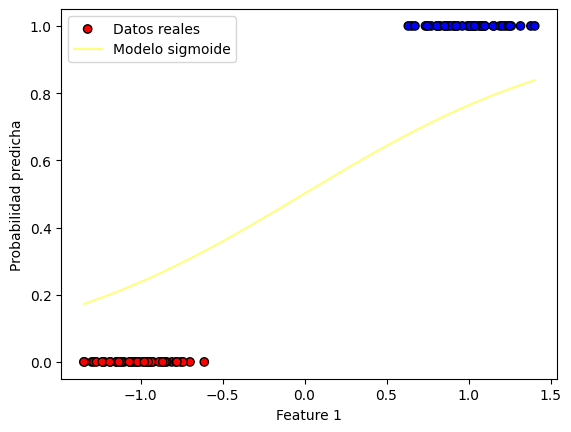

Iteracion: 341
Costo en la iteración 341: 0.2720423070270322
Valor del gradiente 341: [-0.0019852 -0.2325685]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00492846 1.17161768]


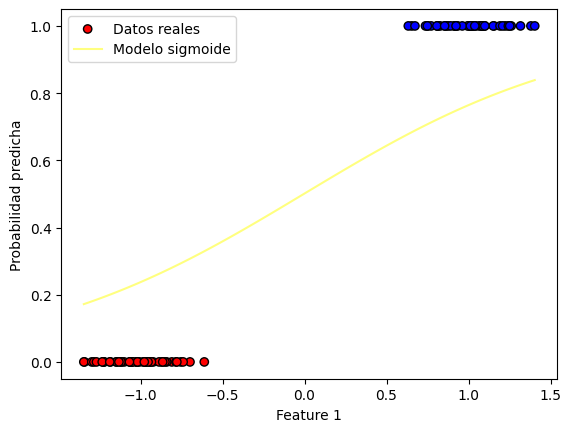

Iteracion: 342
Costo en la iteración 342: 0.2715018766382894
Valor del gradiente 342: [-0.0019854  -0.23214713]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00494831 1.17393915]


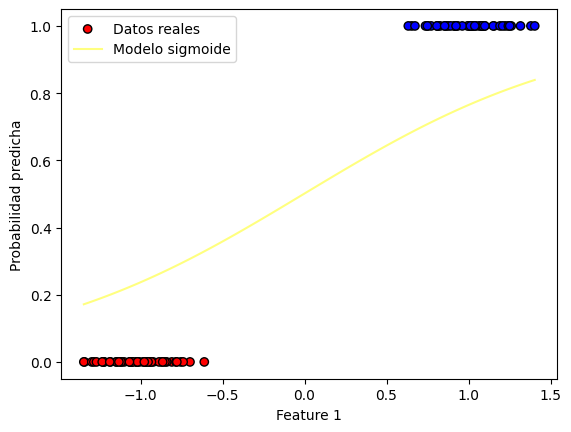

Iteracion: 343
Costo en la iteración 343: 0.27096340198384805
Valor del gradiente 343: [-0.00198559 -0.23172709]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00496817 1.17625642]


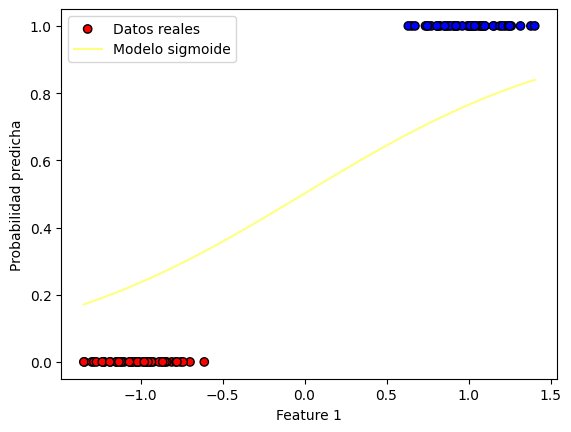

Iteracion: 344
Costo en la iteración 344: 0.2704268733462474
Valor del gradiente 344: [-0.00198578 -0.23130838]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00498803 1.17856951]


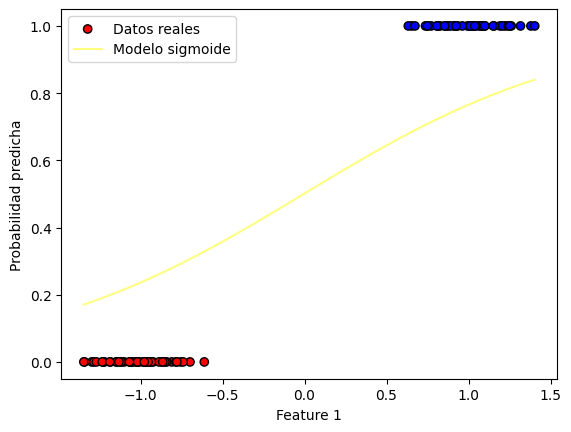

Iteracion: 345
Costo en la iteración 345: 0.26989228106689783
Valor del gradiente 345: [-0.00198595 -0.230891  ]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00500789 1.18087842]


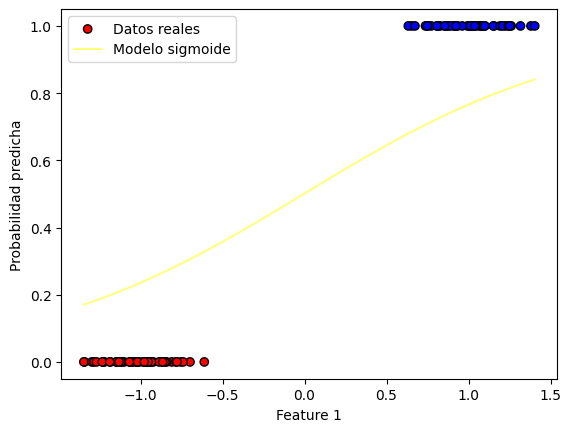

Iteracion: 346
Costo en la iteración 346: 0.26935961554567894
Valor del gradiente 346: [-0.0019861  -0.23047493]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00502775 1.18318317]


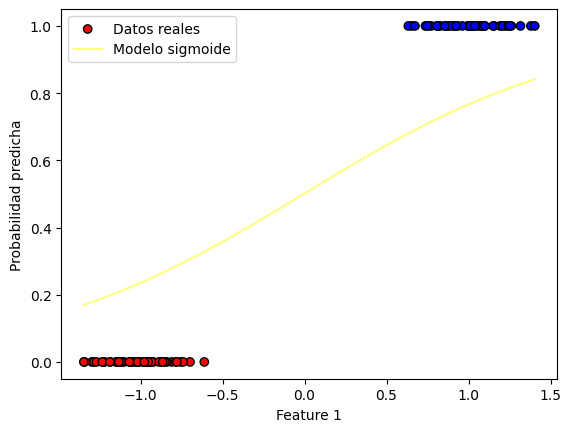

Iteracion: 347
Costo en la iteración 347: 0.26882886724053945
Valor del gradiente 347: [-0.00198625 -0.23006017]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00504761 1.18548377]


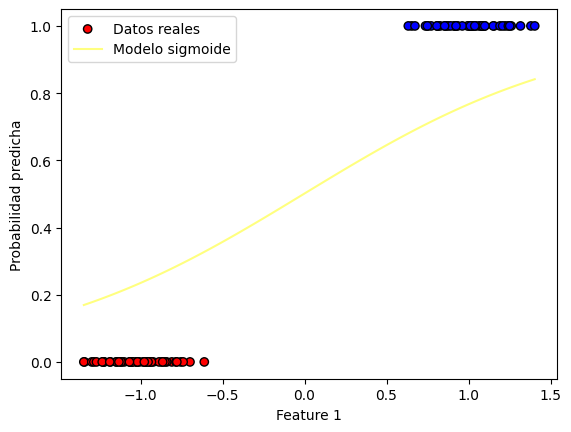

Iteracion: 348
Costo en la iteración 348: 0.2683000266671002
Valor del gradiente 348: [-0.00198639 -0.22964672]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00506747 1.18778024]


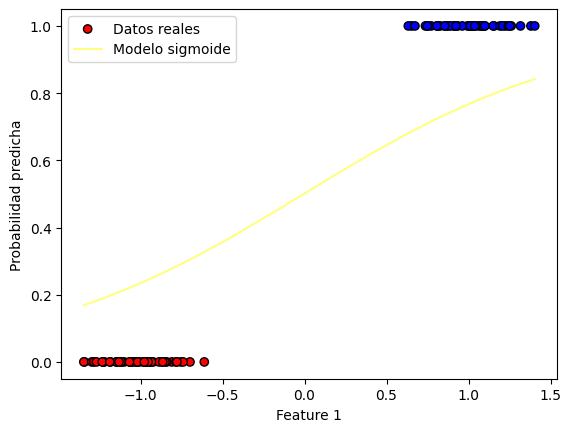

Iteracion: 349
Costo en la iteración 349: 0.26777308439825986
Valor del gradiente 349: [-0.00198651 -0.22923457]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00508734 1.19007258]


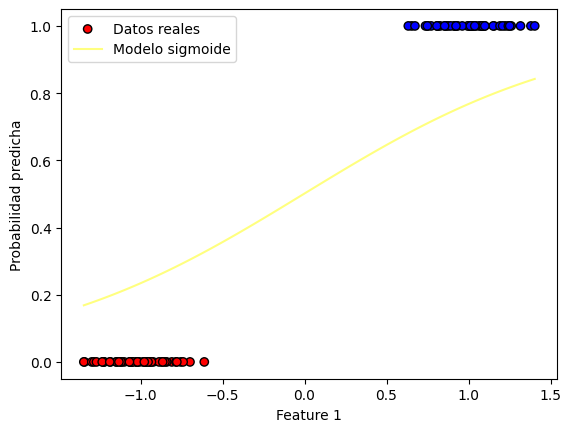

Iteracion: 350
Costo en la iteración 350: 0.26724803106380424
Valor del gradiente 350: [-0.00198662 -0.22882372]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00510721 1.19236082]


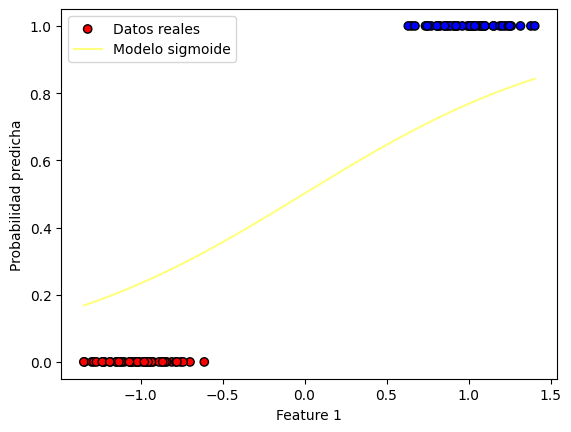

Iteracion: 351
Costo en la iteración 351: 0.26672485735001716
Valor del gradiente 351: [-0.00198673 -0.22841416]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00512707 1.19464496]


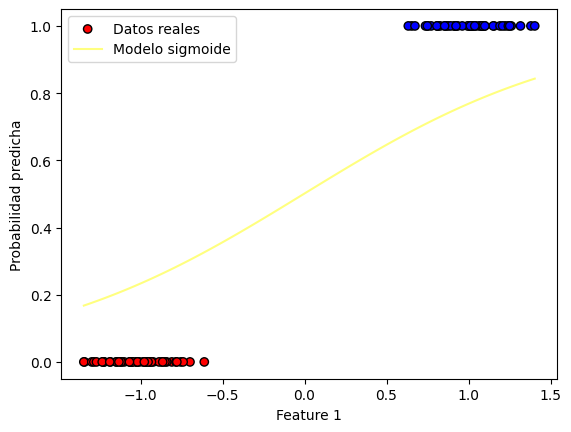

Iteracion: 352
Costo en la iteración 352: 0.2662035539992952
Valor del gradiente 352: [-0.00198682 -0.22800588]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00514694 1.19692502]


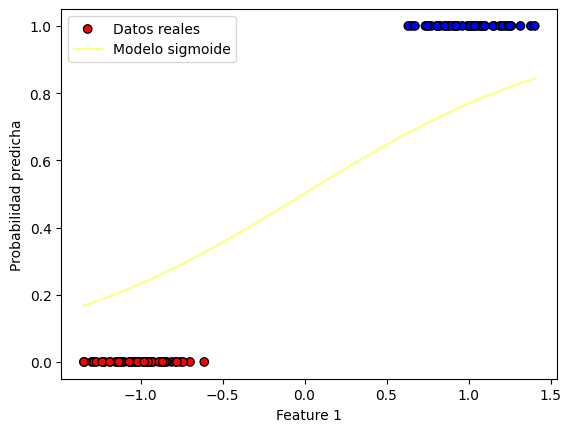

Iteracion: 353
Costo en la iteración 353: 0.26568411180976453
Valor del gradiente 353: [-0.0019869  -0.22759888]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00516681 1.19920101]


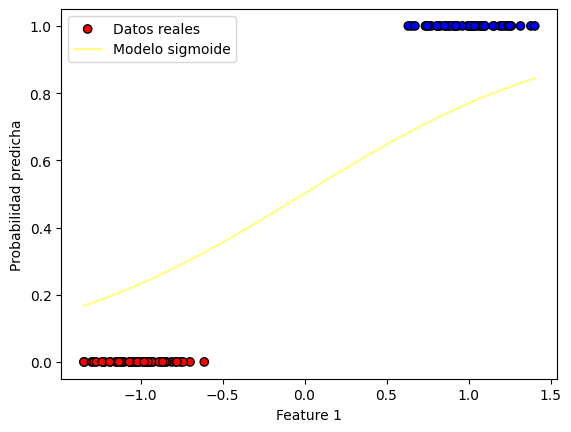

Iteracion: 354
Costo en la iteración 354: 0.2651665216349014
Valor del gradiente 354: [-0.00198697 -0.22719316]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00518668 1.20147294]


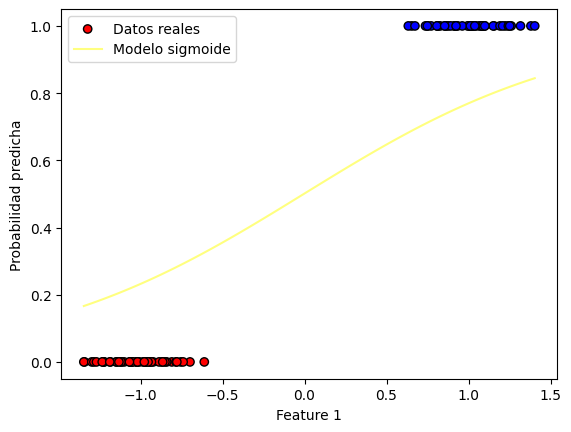

Iteracion: 355
Costo en la iteración 355: 0.2646507743831536
Valor del gradiente 355: [-0.00198702 -0.22678871]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00520655 1.20374083]


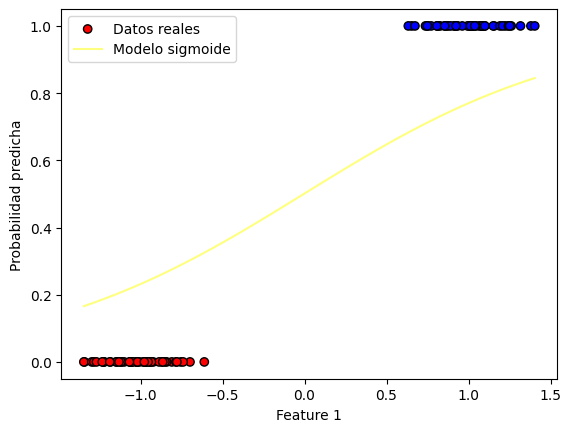

Iteracion: 356
Costo en la iteración 356: 0.264136861017567
Valor del gradiente 356: [-0.00198707 -0.22638552]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00522642 1.20600468]


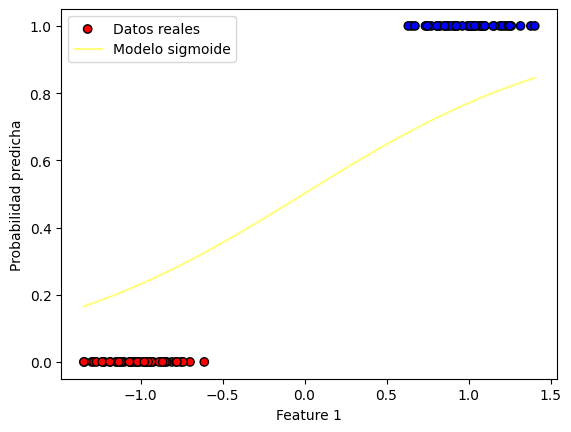

Iteracion: 357
Costo en la iteración 357: 0.2636247725554128
Valor del gradiente 357: [-0.00198711 -0.22598359]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00524629 1.20826452]


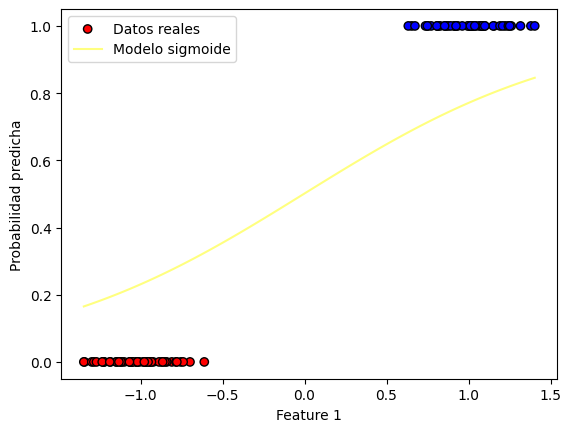

Iteracion: 358
Costo en la iteración 358: 0.2631145000678184
Valor del gradiente 358: [-0.00198713 -0.22558292]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00526616 1.21052035]


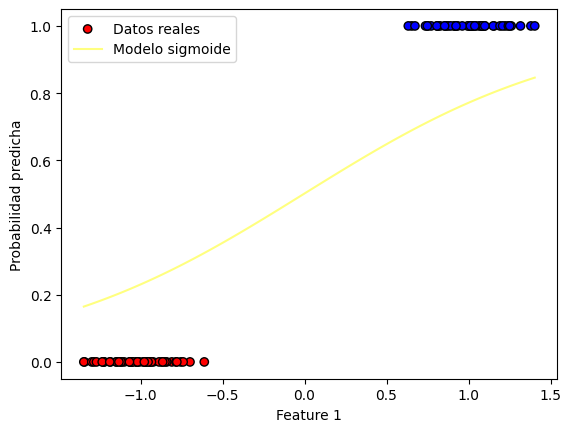

Iteracion: 359
Costo en la iteración 359: 0.262606034679401
Valor del gradiente 359: [-0.00198715 -0.22518349]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00528603 1.21277218]


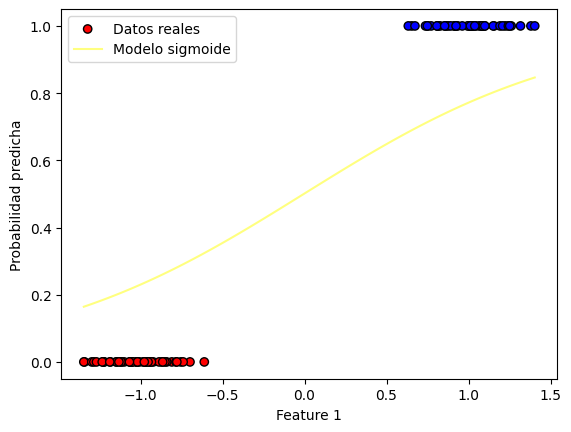

Iteracion: 360
Costo en la iteración 360: 0.2620993675679034
Valor del gradiente 360: [-0.00198716 -0.22478531]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00530591 1.21502004]


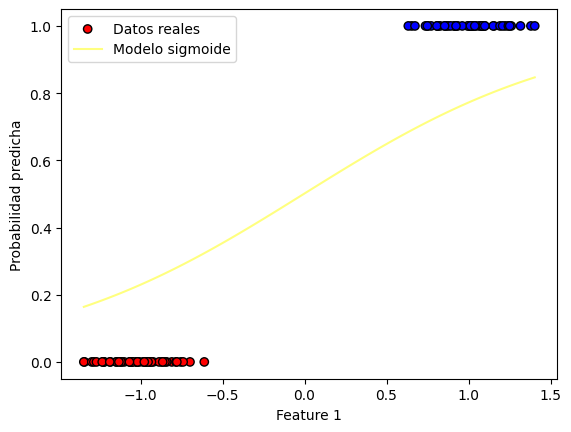

Iteracion: 361
Costo en la iteración 361: 0.2615944899638326
Valor del gradiente 361: [-0.00198715 -0.22438837]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00532578 1.21726392]


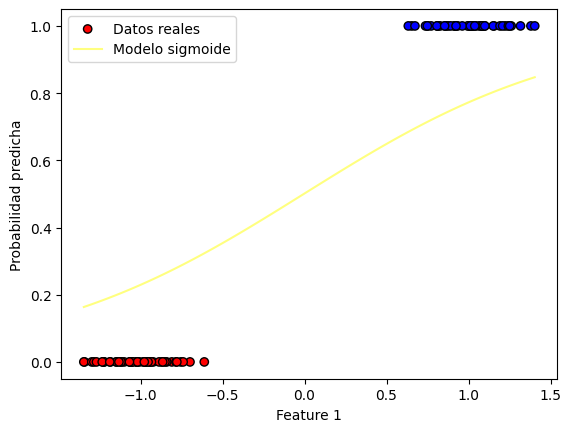

Iteracion: 362
Costo en la iteración 362: 0.2610913931501012
Valor del gradiente 362: [-0.00198714 -0.22399266]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00534565 1.21950385]


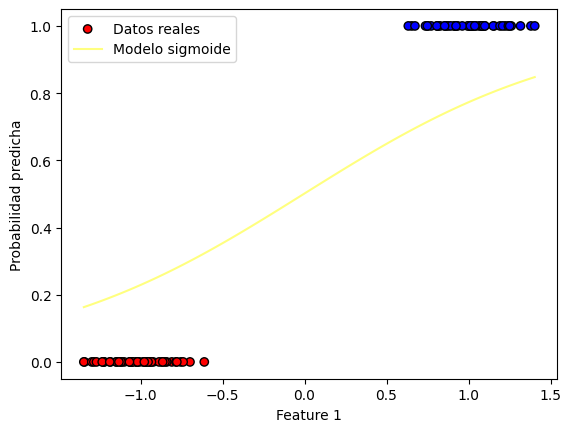

Iteracion: 363
Costo en la iteración 363: 0.26059006846167115
Valor del gradiente 363: [-0.00198711 -0.22359818]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00536552 1.22173983]


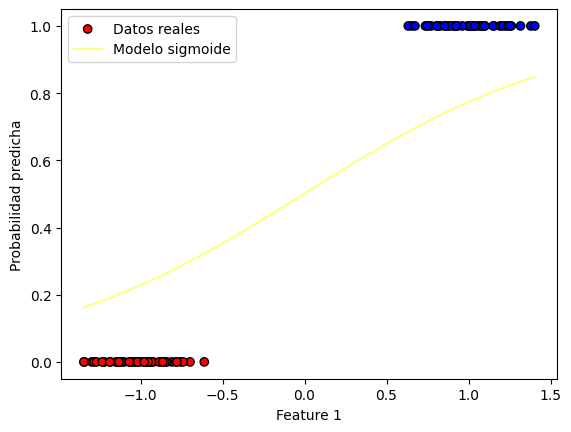

Iteracion: 364
Costo en la iteración 364: 0.2600905072852002
Valor del gradiente 364: [-0.00198708 -0.22320492]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00538539 1.22397188]


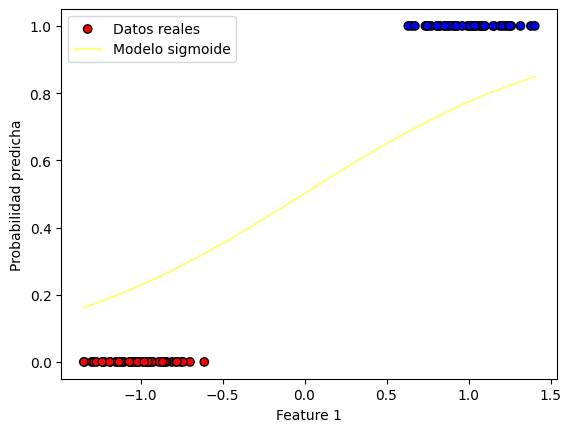

Iteracion: 365
Costo en la iteración 365: 0.2595927010586907
Valor del gradiente 365: [-0.00198703 -0.22281288]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00540526 1.22620001]


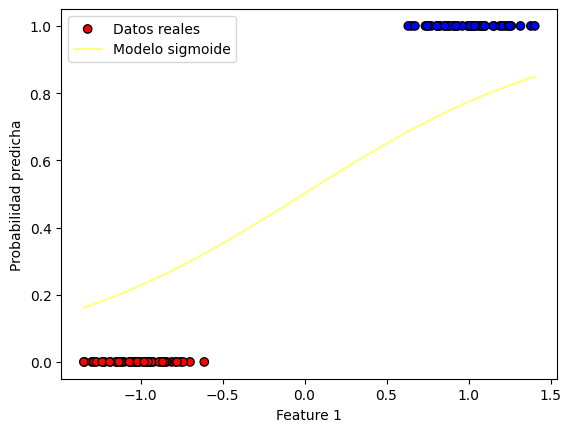

Iteracion: 366
Costo en la iteración 366: 0.2590966412711416
Valor del gradiente 366: [-0.00198698 -0.22242206]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00542513 1.22842423]


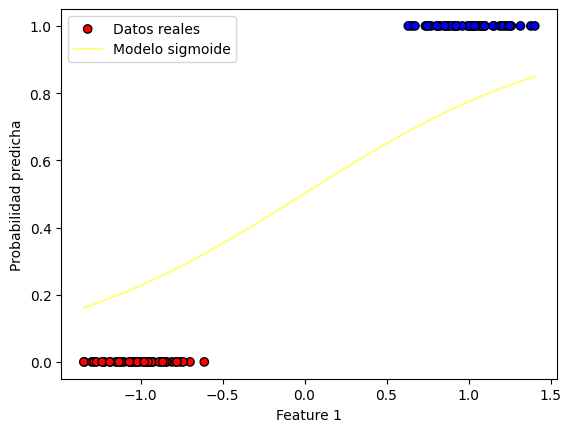

Iteracion: 367
Costo en la iteración 367: 0.2586023194622019
Valor del gradiente 367: [-0.00198691 -0.22203244]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.005445   1.23064455]


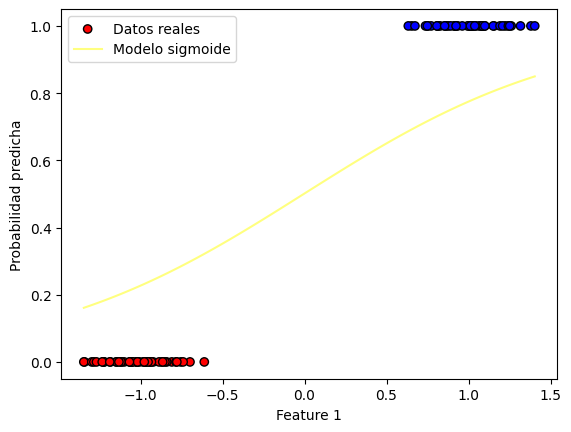

Iteracion: 368
Costo en la iteración 368: 0.25810972722182723
Valor del gradiente 368: [-0.00198684 -0.22164403]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00546487 1.23286099]


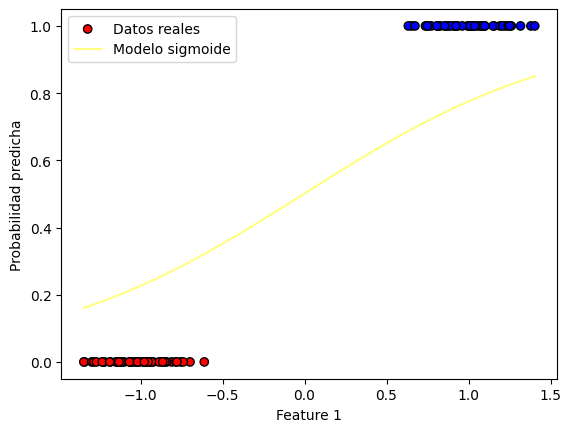

Iteracion: 369
Costo en la iteración 369: 0.2576188561899395
Valor del gradiente 369: [-0.00198676 -0.22125682]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00548474 1.23507356]


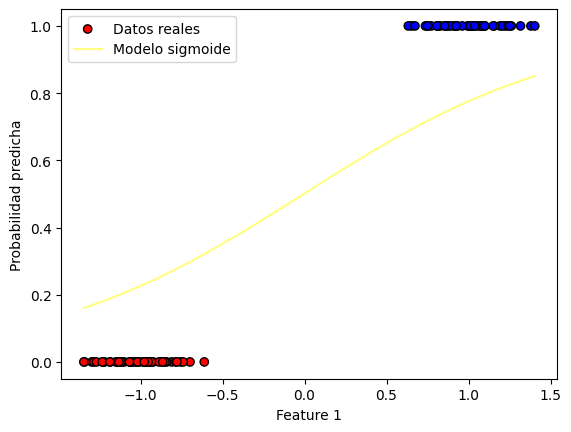

Iteracion: 370
Costo en la iteración 370: 0.25712969805608743
Valor del gradiente 370: [-0.00198666 -0.2208708 ]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.0055046  1.23728227]


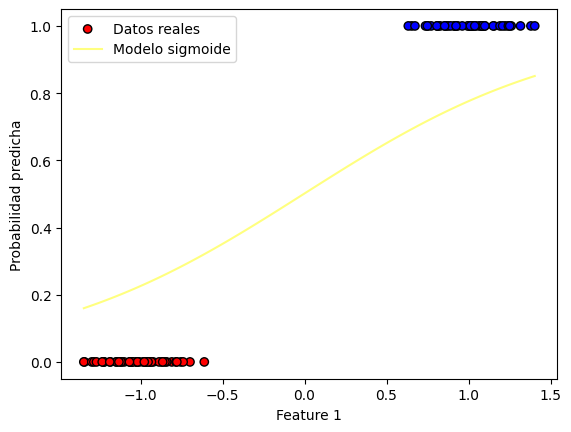

Iteracion: 371
Costo en la iteración 371: 0.25664224455911117
Valor del gradiente 371: [-0.00198656 -0.22048597]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00552447 1.23948713]


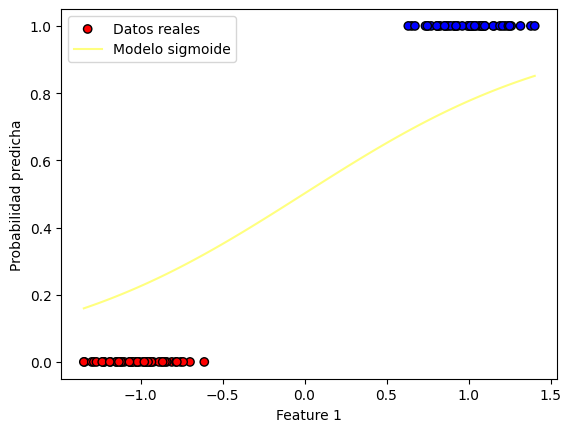

Iteracion: 372
Costo en la iteración 372: 0.2561564874868085
Valor del gradiente 372: [-0.00198645 -0.22010233]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00554433 1.24168815]


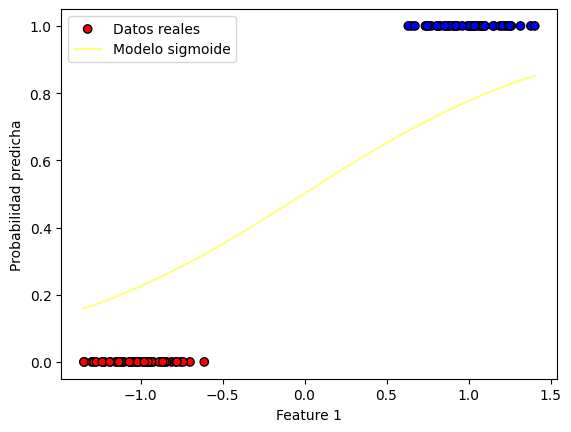

Iteracion: 373
Costo en la iteración 373: 0.2556724186756035
Valor del gradiente 373: [-0.00198633 -0.21971986]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.0055642  1.24388535]


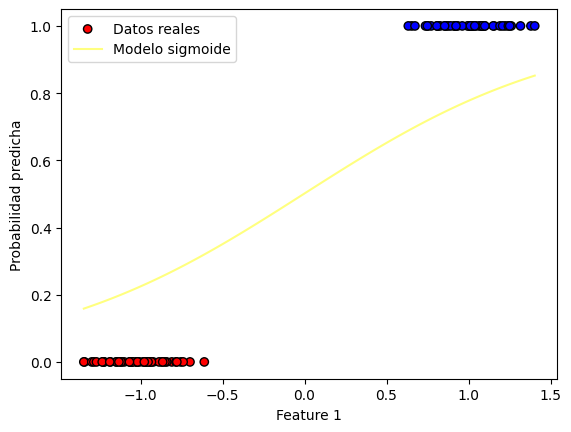

Iteracion: 374
Costo en la iteración 374: 0.2551900300102175
Valor del gradiente 374: [-0.0019862  -0.21933858]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00558406 1.24607873]


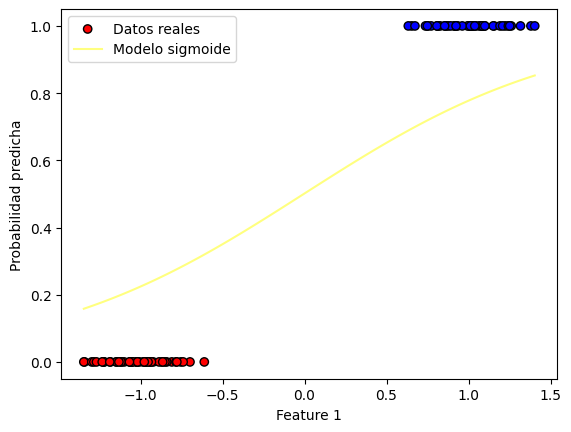

Iteracion: 375
Costo en la iteración 375: 0.2547093134233433
Valor del gradiente 375: [-0.00198606 -0.21895846]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00560392 1.24826832]


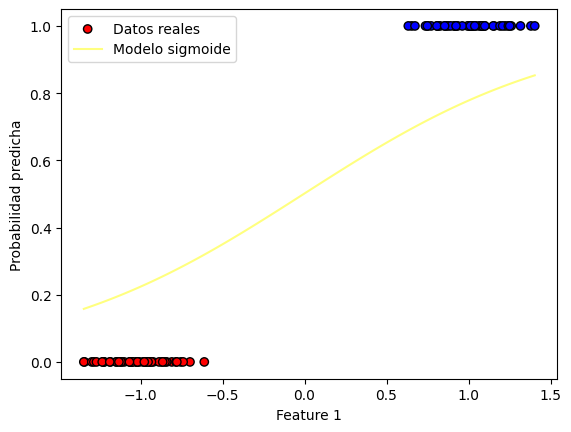

Iteracion: 376
Costo en la iteración 376: 0.2542302608953204
Valor del gradiente 376: [-0.00198591 -0.2185795 ]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00562378 1.25045411]


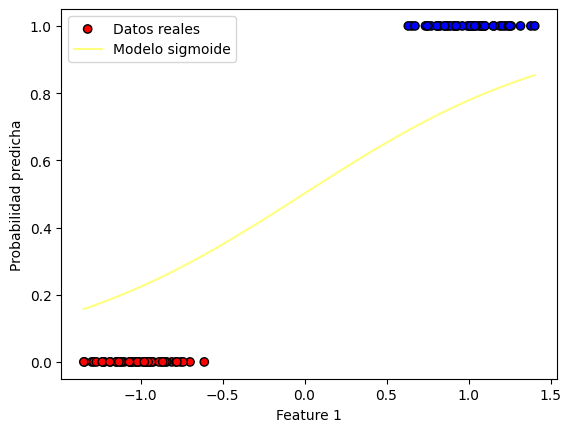

Iteracion: 377
Costo en la iteración 377: 0.25375286445381373
Valor del gradiente 377: [-0.00198575 -0.21820171]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00564363 1.25263613]


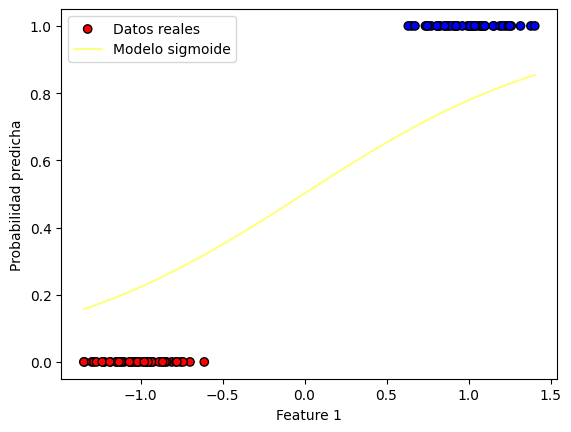

Iteracion: 378
Costo en la iteración 378: 0.2532771161734938
Valor del gradiente 378: [-0.00198559 -0.21782507]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00566349 1.25481438]


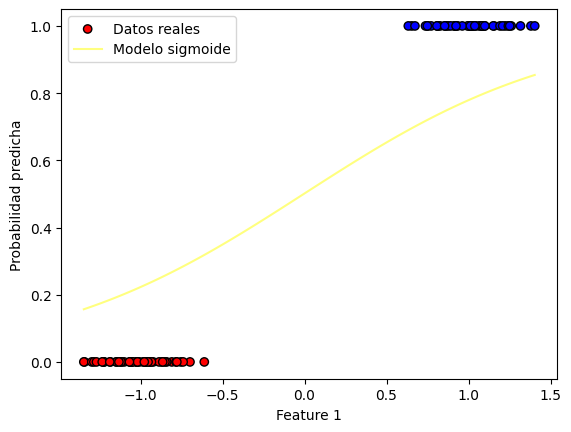

Iteracion: 379
Costo en la iteración 379: 0.25280300817572
Valor del gradiente 379: [-0.00198541 -0.21744959]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00568334 1.25698888]


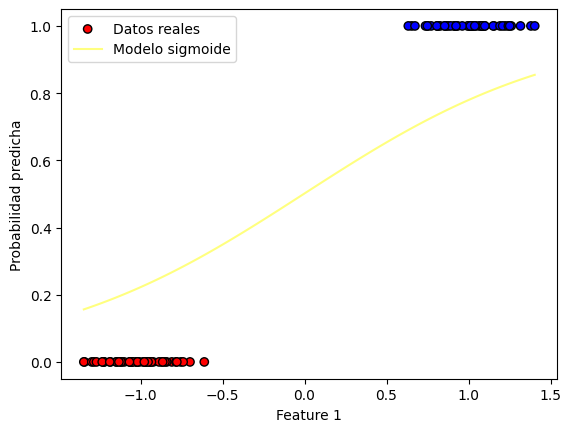

Iteracion: 380
Costo en la iteración 380: 0.2523305326282256
Valor del gradiente 380: [-0.00198523 -0.21707525]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.0057032  1.25915963]


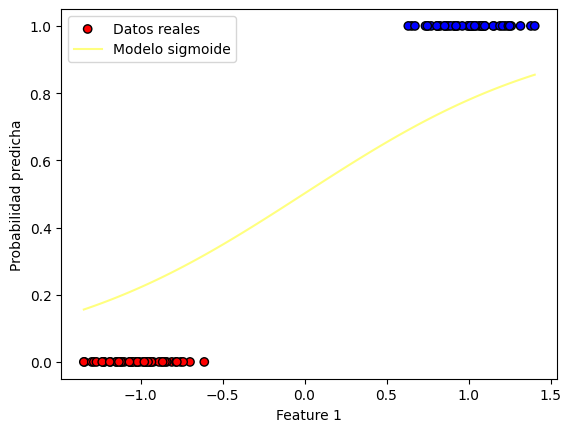

Iteracion: 381
Costo en la iteración 381: 0.25185968174480544
Valor del gradiente 381: [-0.00198504 -0.21670205]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00572305 1.26132665]


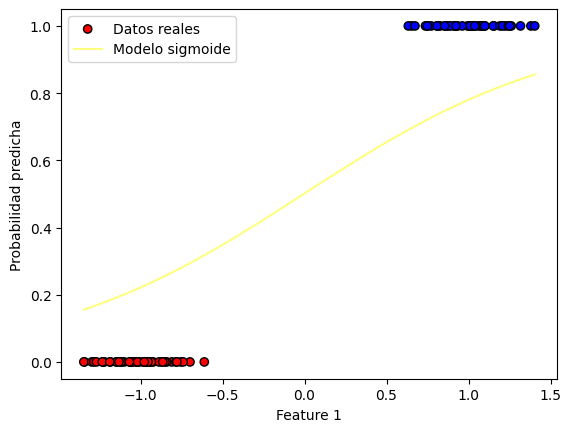

Iteracion: 382
Costo en la iteración 382: 0.25139044778500524
Valor del gradiente 382: [-0.00198484 -0.21632999]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.0057429  1.26348995]


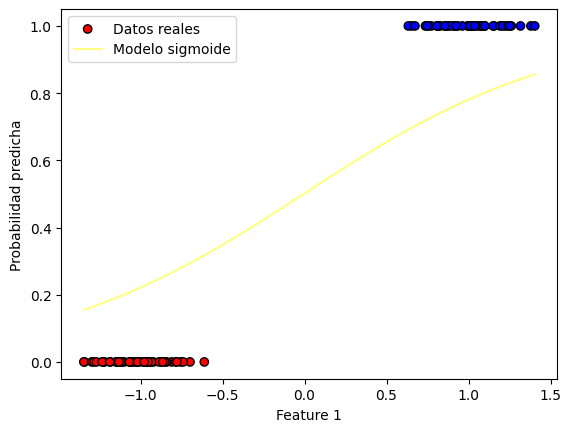

Iteracion: 383
Costo en la iteración 383: 0.2509228230538141
Valor del gradiente 383: [-0.00198463 -0.21595906]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00576274 1.26564954]


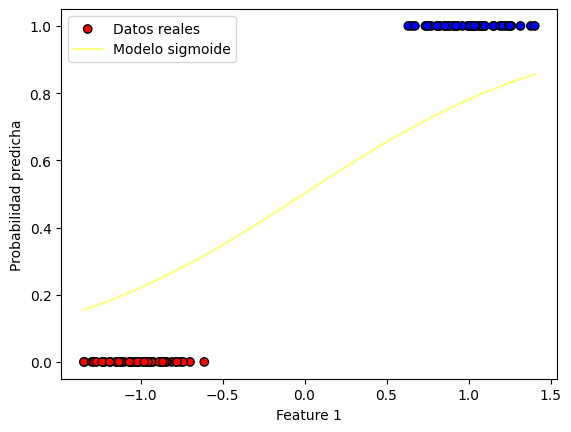

Iteracion: 384
Costo en la iteración 384: 0.25045679990135844
Valor del gradiente 384: [-0.00198441 -0.21558926]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00578259 1.26780543]


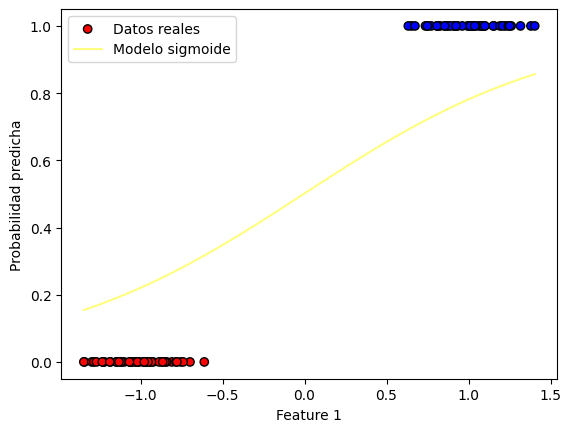

Iteracion: 385
Costo en la iteración 385: 0.24999237072259853
Valor del gradiente 385: [-0.00198418 -0.21522059]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00580243 1.26995764]


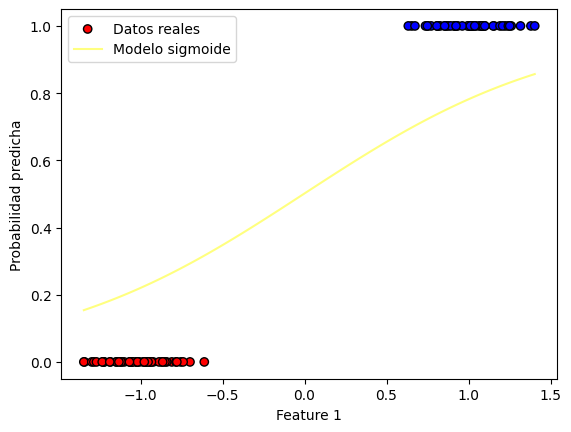

Iteracion: 386
Costo en la iteración 386: 0.24952952795702704
Valor del gradiente 386: [-0.00198395 -0.21485303]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00582227 1.27210617]


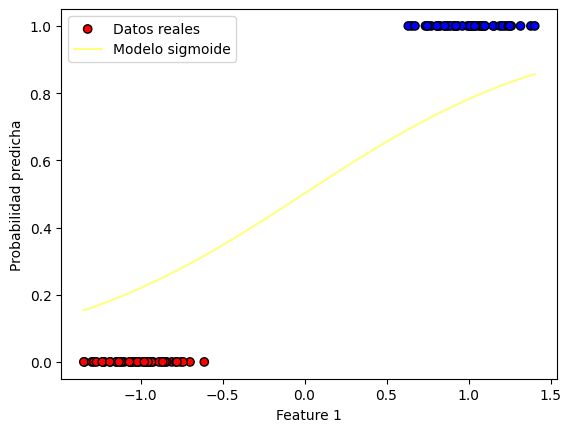

Iteracion: 387
Costo en la iteración 387: 0.24906826408837007
Valor del gradiente 387: [-0.0019837  -0.21448659]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.0058421  1.27425104]


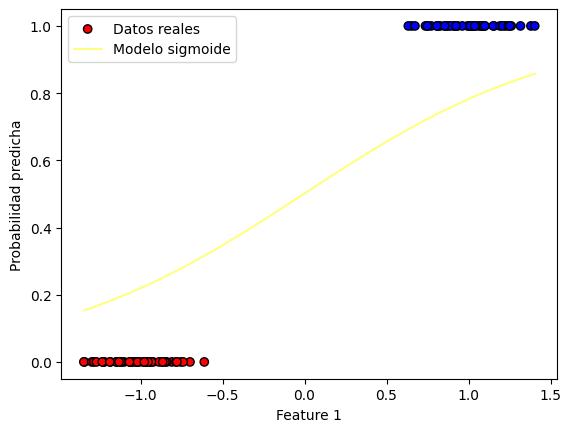

Iteracion: 388
Costo en la iteración 388: 0.24860857164428987
Valor del gradiente 388: [-0.00198345 -0.21412126]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00586194 1.27639225]


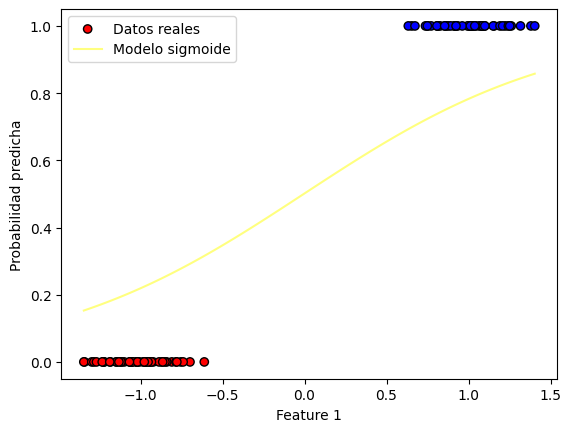

Iteracion: 389
Costo en la iteración 389: 0.24815044319609034
Valor del gradiente 389: [-0.00198319 -0.21375703]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00588177 1.27852982]


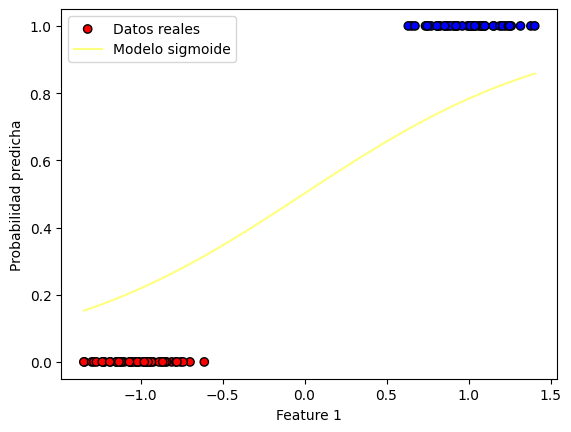

Iteracion: 390
Costo en la iteración 390: 0.24769387135842386
Valor del gradiente 390: [-0.00198293 -0.21339391]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.0059016  1.28066376]


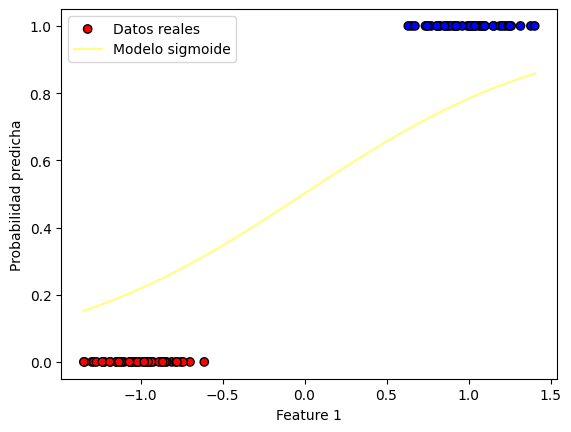

Iteracion: 391
Costo en la iteración 391: 0.24723884878900101
Valor del gradiente 391: [-0.00198265 -0.21303188]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00592143 1.28279408]


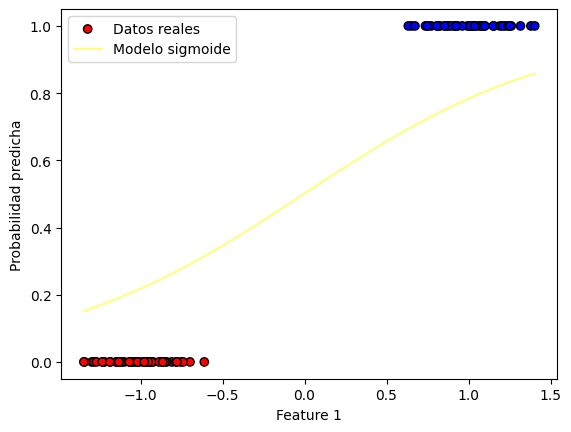

Iteracion: 392
Costo en la iteración 392: 0.24678536818830238
Valor del gradiente 392: [-0.00198237 -0.21267095]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00594125 1.28492079]


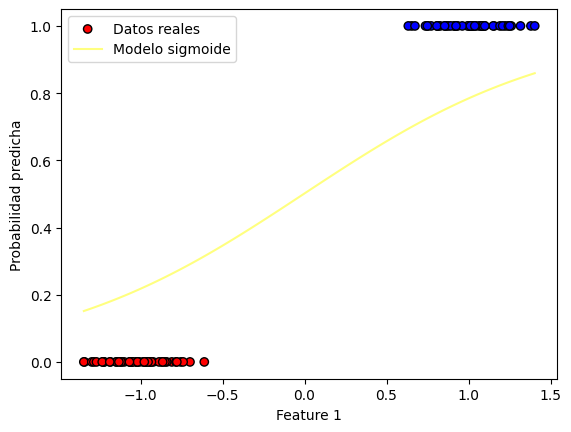

Iteracion: 393
Costo en la iteración 393: 0.2463334222992914
Valor del gradiente 393: [-0.00198208 -0.2123111 ]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00596107 1.2870439 ]


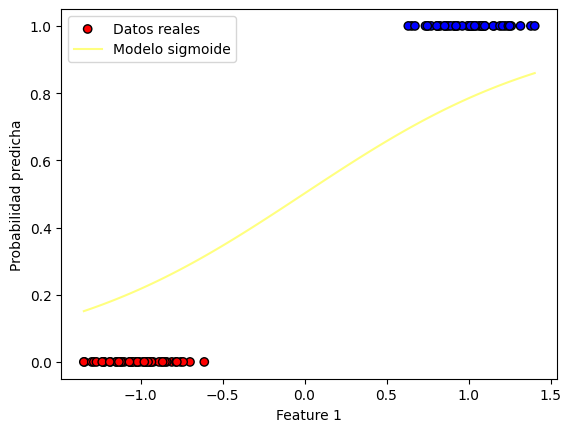

Iteracion: 394
Costo en la iteración 394: 0.24588300390713044
Valor del gradiente 394: [-0.00198178 -0.21195234]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00598089 1.28916342]


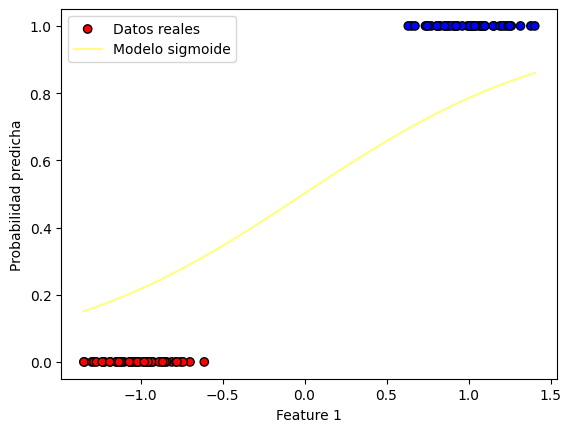

Iteracion: 395
Costo en la iteración 395: 0.2454341058388988
Valor del gradiente 395: [-0.00198147 -0.21159466]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.0060007  1.29127937]


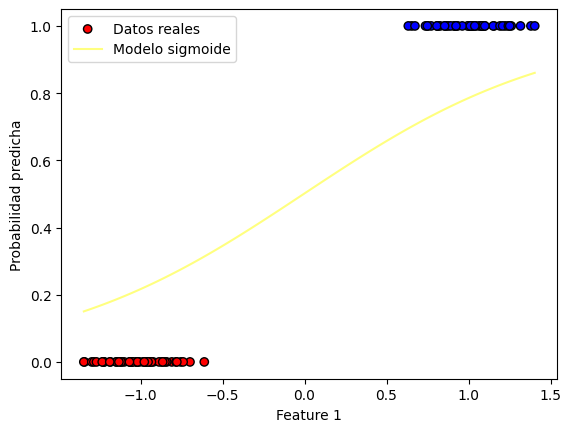

Iteracion: 396
Costo en la iteración 396: 0.24498672096331228
Valor del gradiente 396: [-0.00198116 -0.21123805]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00602052 1.29339175]


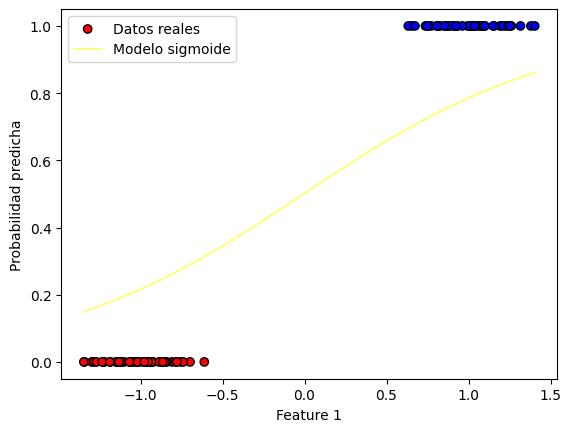

Iteracion: 397
Costo en la iteración 397: 0.24454084219044472
Valor del gradiente 397: [-0.00198084 -0.21088251]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00604032 1.29550057]


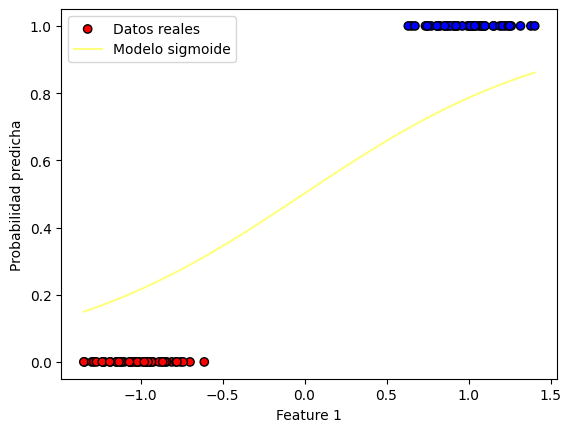

Iteracion: 398
Costo en la iteración 398: 0.24409646247145225
Valor del gradiente 398: [-0.00198051 -0.21052804]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00606013 1.29760585]


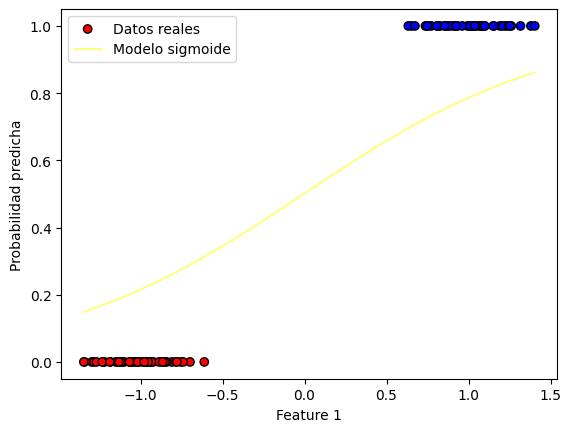

Iteracion: 399
Costo en la iteración 399: 0.24365357479829894
Valor del gradiente 399: [-0.00198017 -0.21017463]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00607993 1.2997076 ]


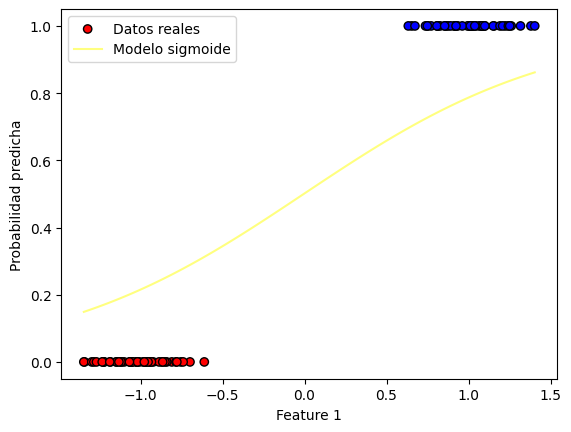

Iteracion: 400
Costo en la iteración 400: 0.24321217220348457
Valor del gradiente 400: [-0.00197983 -0.20982228]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00609973 1.30180582]


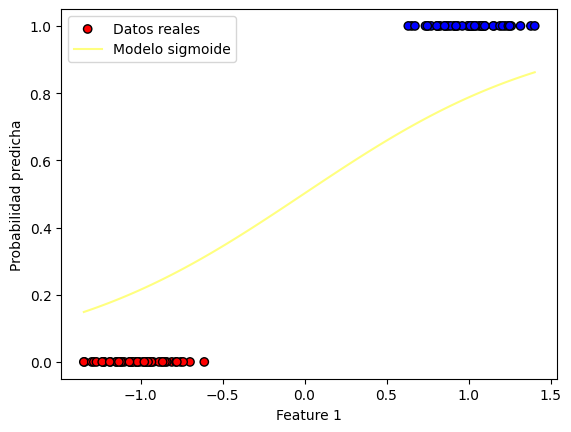

Iteracion: 401
Costo en la iteración 401: 0.2427722477597747
Valor del gradiente 401: [-0.00197948 -0.20947098]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00611952 1.30390053]


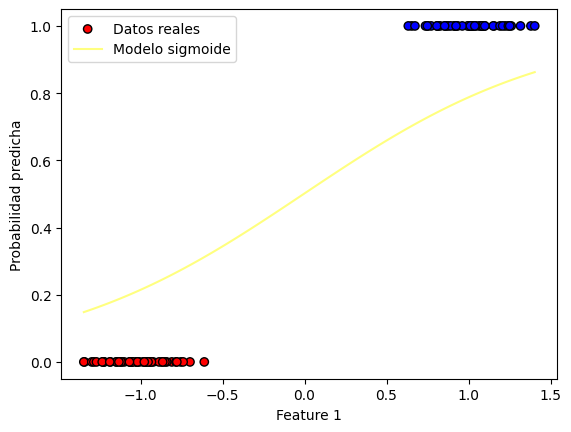

Iteracion: 402
Costo en la iteración 402: 0.24233379457993193
Valor del gradiente 402: [-0.00197912 -0.20912073]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00613931 1.30599174]


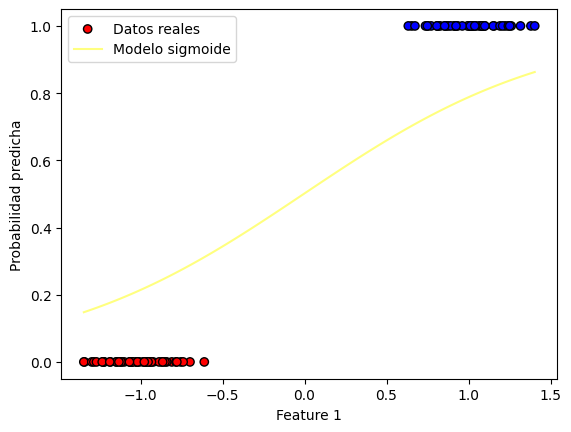

Iteracion: 403
Costo en la iteración 403: 0.24189680581645012
Valor del gradiente 403: [-0.00197876 -0.20877153]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.0061591  1.30807945]


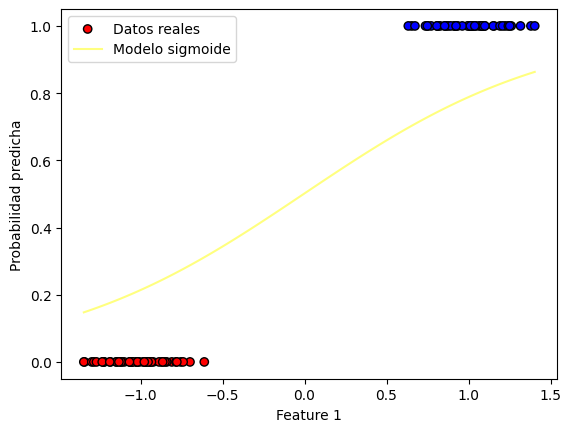

Iteracion: 404
Costo en la iteración 404: 0.24146127466128967
Valor del gradiente 404: [-0.00197838 -0.20842337]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00617889 1.31016369]


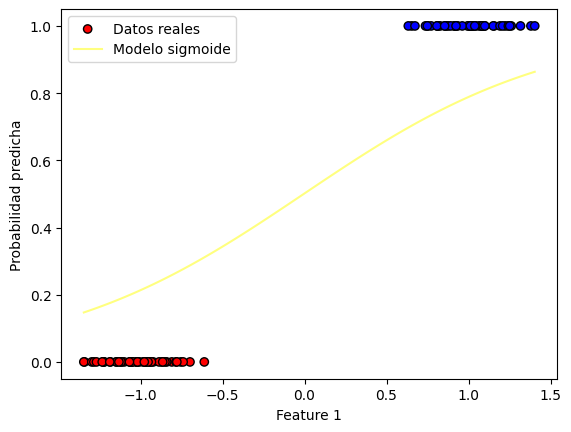

Iteracion: 405
Costo en la iteración 405: 0.24102719434561531
Valor del gradiente 405: [-0.001978   -0.20807624]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00619867 1.31224445]


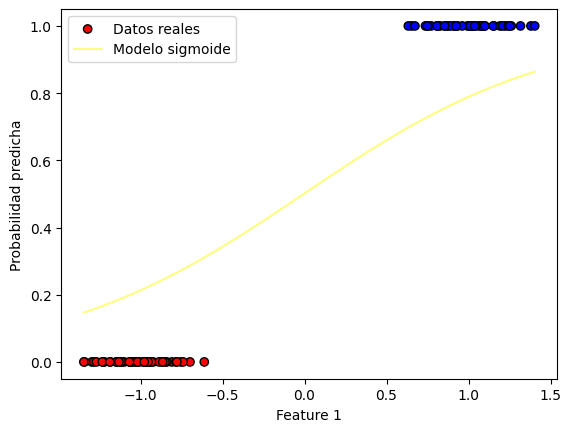

Iteracion: 406
Costo en la iteración 406: 0.2405945581395352
Valor del gradiente 406: [-0.00197762 -0.20773015]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00621844 1.31432175]


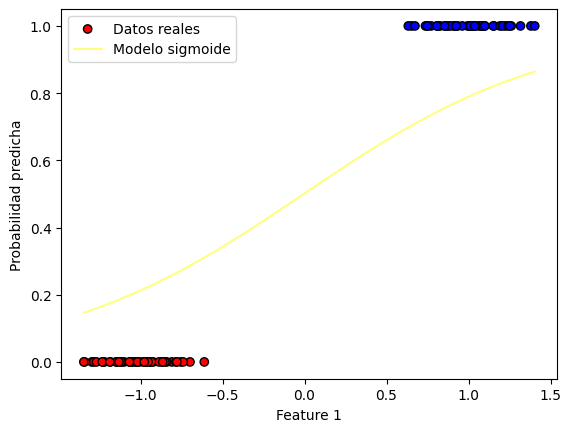

Iteracion: 407
Costo en la iteración 407: 0.24016335935184252
Valor del gradiente 407: [-0.00197722 -0.20738509]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00623821 1.3163956 ]


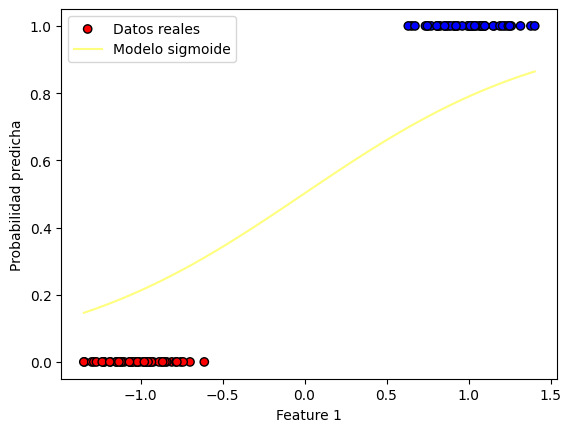

Iteracion: 408
Costo en la iteración 408: 0.23973359132975866
Valor del gradiente 408: [-0.00197682 -0.20704105]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00625798 1.31846601]


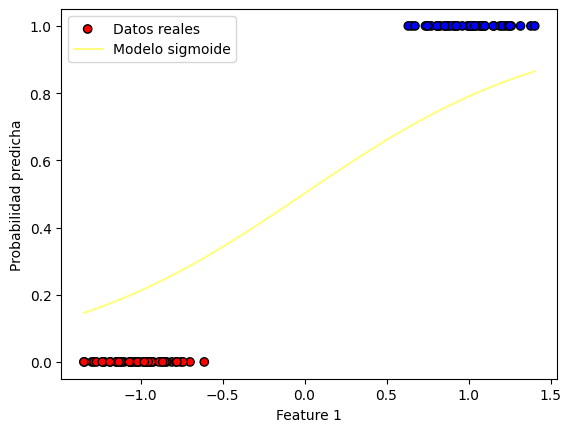

Iteracion: 409
Costo en la iteración 409: 0.23930524745867815
Valor del gradiente 409: [-0.00197642 -0.20669803]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00627775 1.32053299]


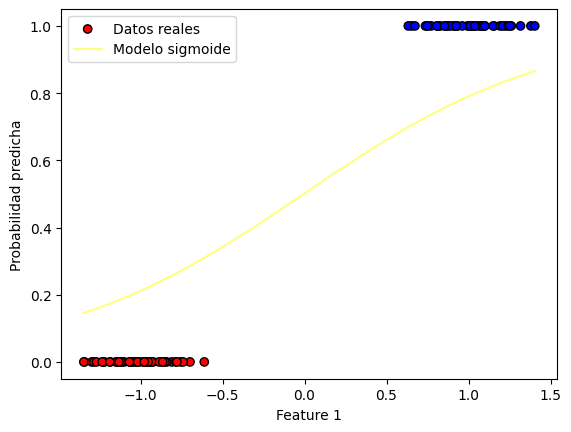

Iteracion: 410
Costo en la iteración 410: 0.23887832116191576
Valor del gradiente 410: [-0.001976   -0.20635603]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00629751 1.32259655]


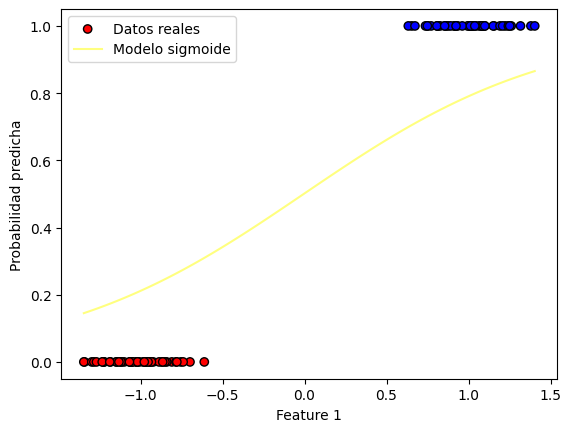

Iteracion: 411
Costo en la iteración 411: 0.23845280590045484
Valor del gradiente 411: [-0.00197558 -0.20601504]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00631726 1.3246567 ]


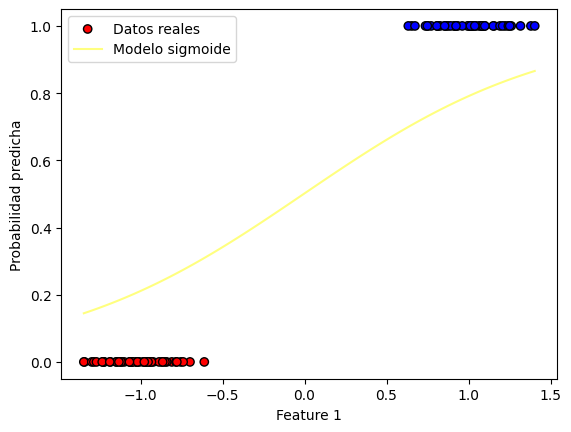

Iteracion: 412
Costo en la iteración 412: 0.2380286951726985
Valor del gradiente 412: [-0.00197516 -0.20567506]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00633701 1.32671346]


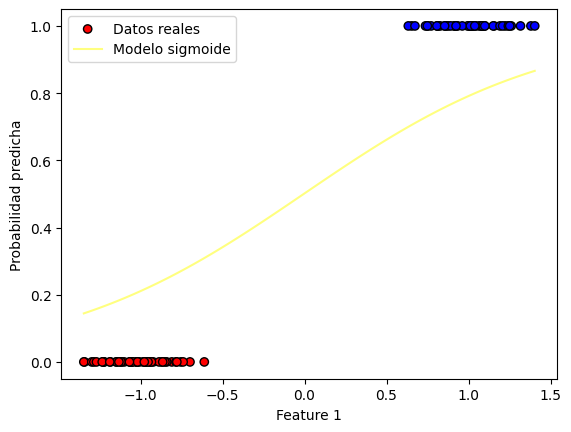

Iteracion: 413
Costo en la iteración 413: 0.23760598251422133
Valor del gradiente 413: [-0.00197472 -0.20533609]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00635676 1.32876682]


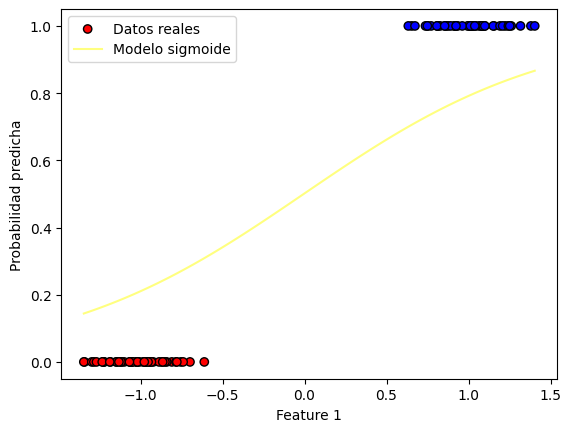

Iteracion: 414
Costo en la iteración 414: 0.23718466149752396
Valor del gradiente 414: [-0.00197428 -0.20499811]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.0063765 1.3308168]


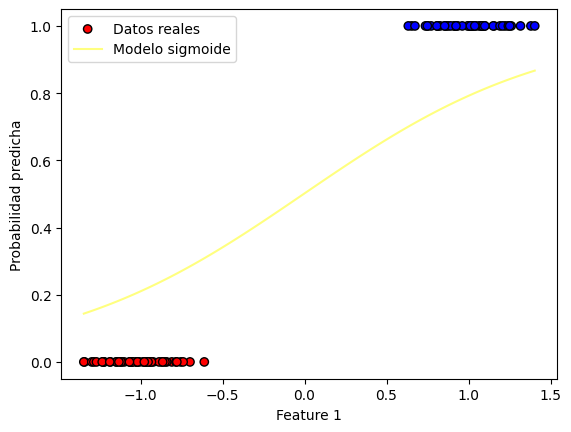

Iteracion: 415
Costo en la iteración 415: 0.23676472573178886
Valor del gradiente 415: [-0.00197384 -0.20466114]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00639624 1.33286341]


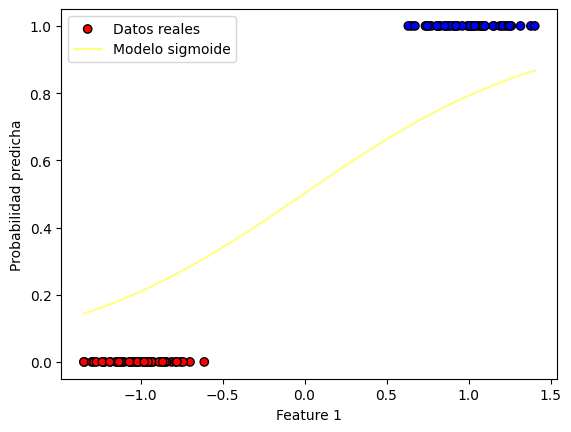

Iteracion: 416
Costo en la iteración 416: 0.2363461688626377
Valor del gradiente 416: [-0.00197338 -0.20432515]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00641598 1.33490666]


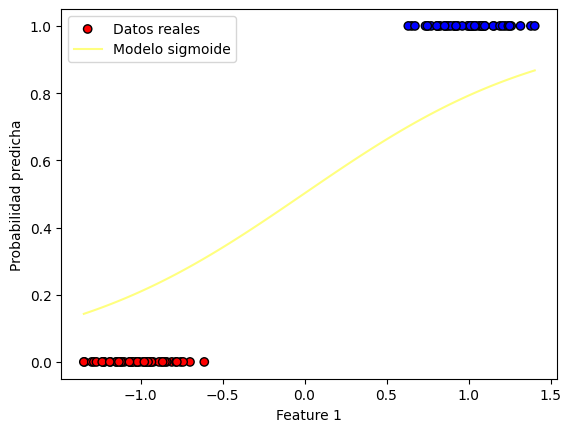

Iteracion: 417
Costo en la iteración 417: 0.23592898457189168
Valor del gradiente 417: [-0.00197292 -0.20399015]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00643571 1.33694656]


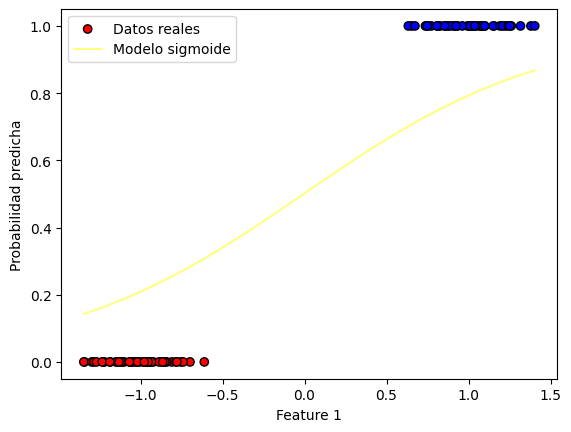

Iteracion: 418
Costo en la iteración 418: 0.23551316657733168
Valor del gradiente 418: [-0.00197246 -0.20365614]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00645543 1.33898312]


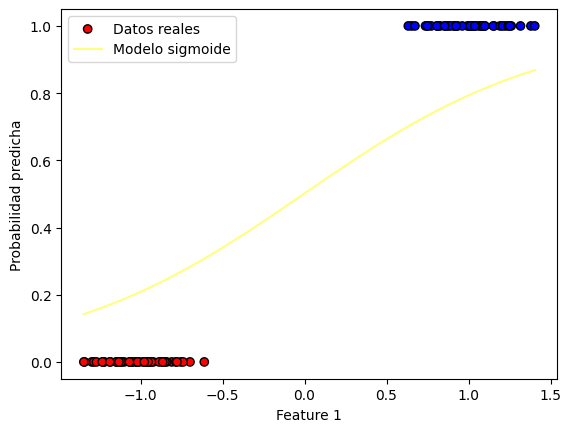

Iteracion: 419
Costo en la iteración 419: 0.23509870863246188
Valor del gradiente 419: [-0.00197199 -0.20332311]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00647515 1.34101635]


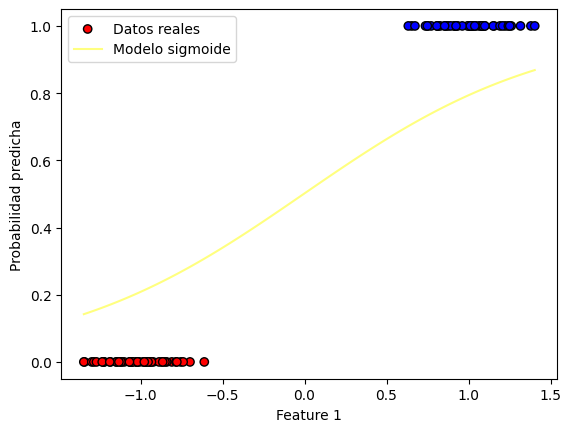

Iteracion: 420
Costo en la iteración 420: 0.23468560452627413
Valor del gradiente 420: [-0.00197151 -0.20299106]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00649487 1.34304626]


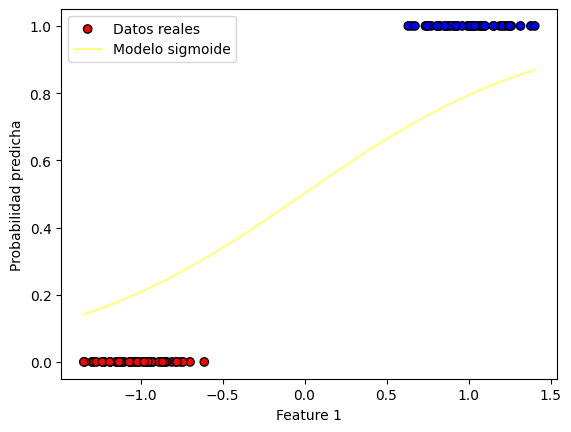

Iteracion: 421
Costo en la iteración 421: 0.23427384808301402
Valor del gradiente 421: [-0.00197102 -0.20265997]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00651458 1.34507286]


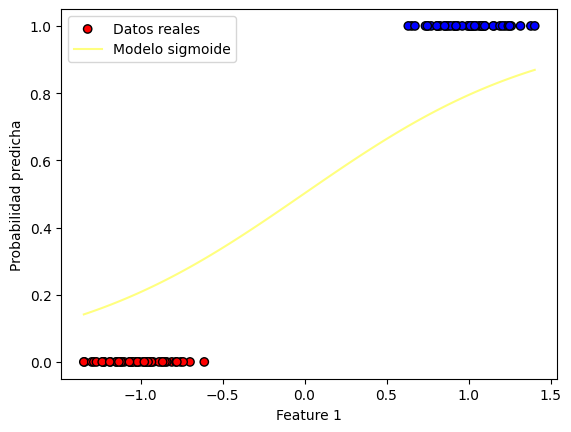

Iteracion: 422
Costo en la iteración 422: 0.23386343316194946
Valor del gradiente 422: [-0.00197053 -0.20232986]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00653428 1.34709616]


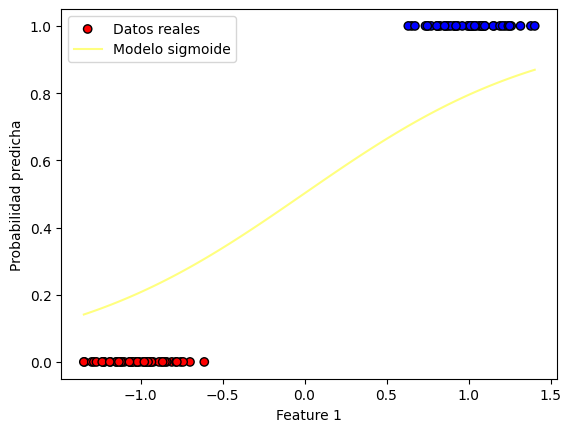

Iteracion: 423
Costo en la iteración 423: 0.23345435365713985
Valor del gradiente 423: [-0.00197004 -0.20200072]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00655398 1.34911617]


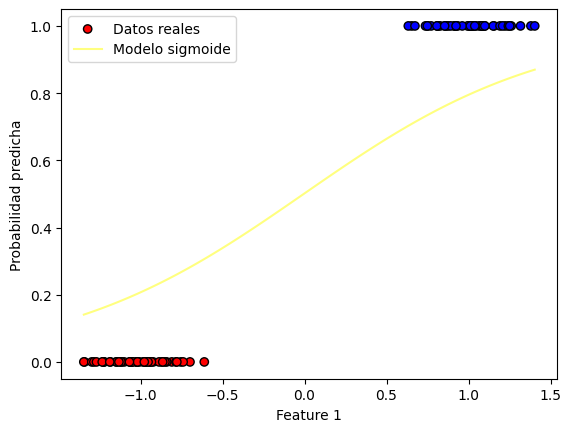

Iteracion: 424
Costo en la iteración 424: 0.23304660349720765
Valor del gradiente 424: [-0.00196953 -0.20167253]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00657368 1.3511329 ]


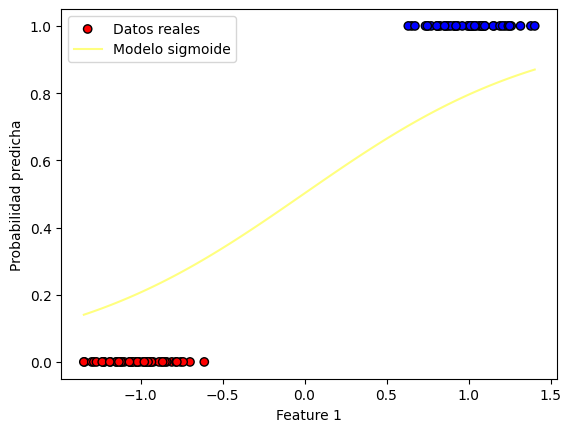

Iteracion: 425
Costo en la iteración 425: 0.23264017664511152
Valor del gradiente 425: [-0.00196903 -0.20134531]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00659337 1.35314635]


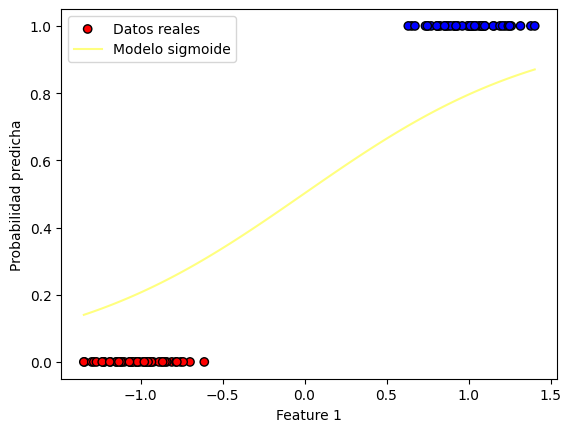

Iteracion: 426
Costo en la iteración 426: 0.23223506709792038
Valor del gradiente 426: [-0.00196851 -0.20101903]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00661305 1.35515654]


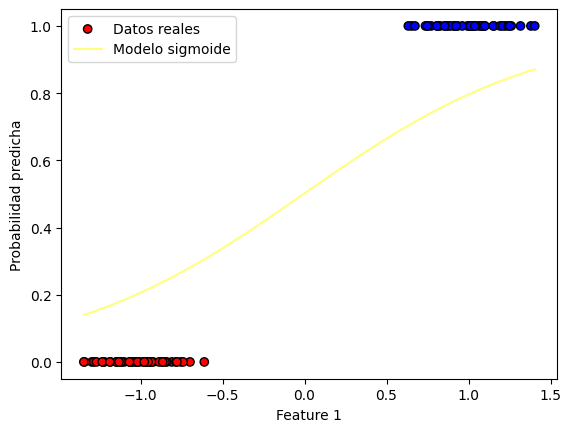

Iteracion: 427
Costo en la iteración 427: 0.2318312688865906
Valor del gradiente 427: [-0.00196799 -0.20069371]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00663273 1.35716348]


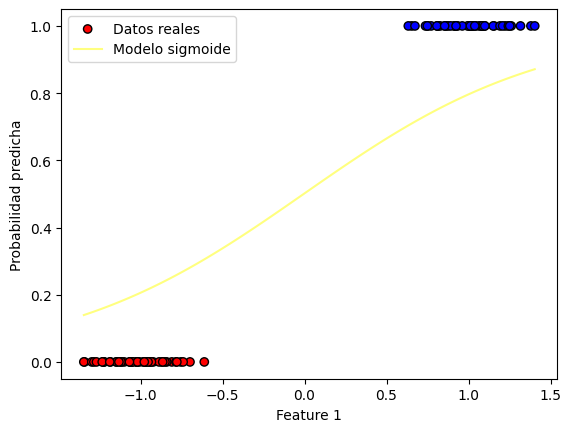

Iteracion: 428
Costo en la iteración 428: 0.23142877607574275
Valor del gradiente 428: [-0.00196747 -0.20036934]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00665241 1.35916717]


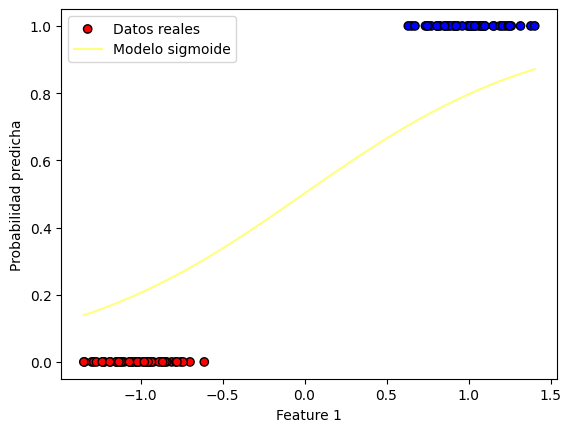

Iteracion: 429
Costo en la iteración 429: 0.23102758276344215
Valor del gradiente 429: [-0.00196694 -0.2000459 ]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00667208 1.36116763]


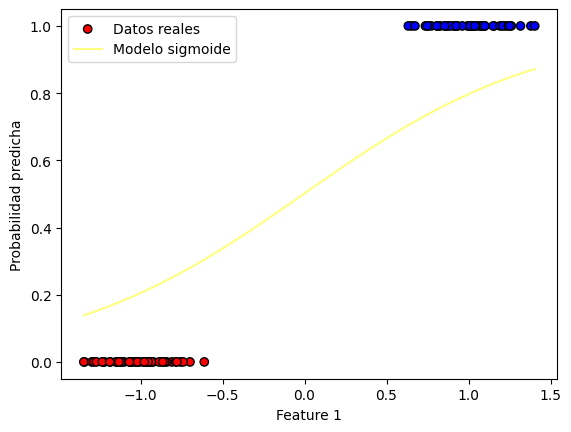

Iteracion: 430
Costo en la iteración 430: 0.2306276830809793
Valor del gradiente 430: [-0.0019664  -0.19972341]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00669174 1.36316486]


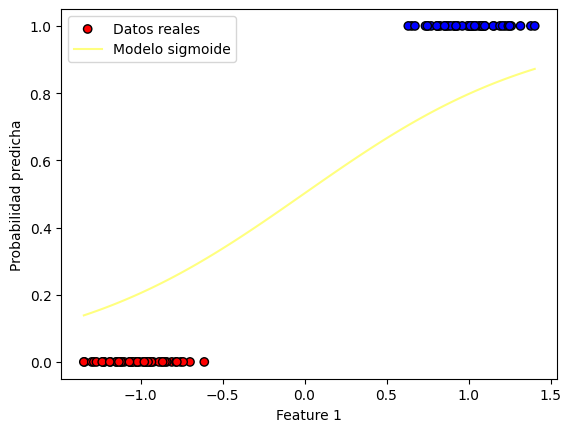

Iteracion: 431
Costo en la iteración 431: 0.23022907119265243
Valor del gradiente 431: [-0.00196586 -0.19940185]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.0067114  1.36515888]


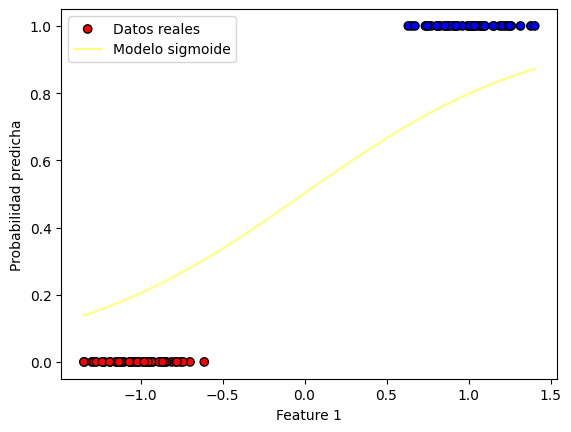

Iteracion: 432
Costo en la iteración 432: 0.22983174129555228
Valor del gradiente 432: [-0.00196531 -0.19908123]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00673105 1.36714969]


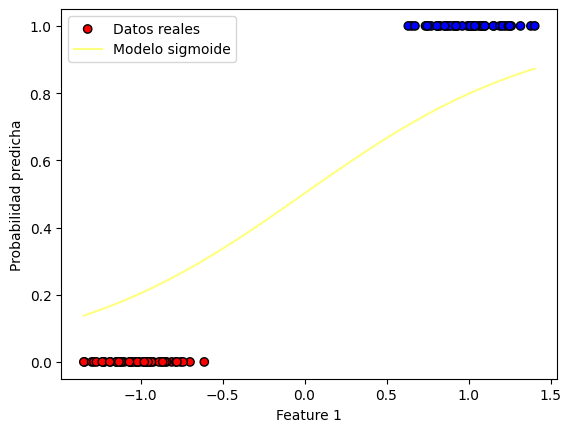

Iteracion: 433
Costo en la iteración 433: 0.22943568761934735
Valor del gradiente 433: [-0.00196475 -0.19876153]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.0067507  1.36913731]


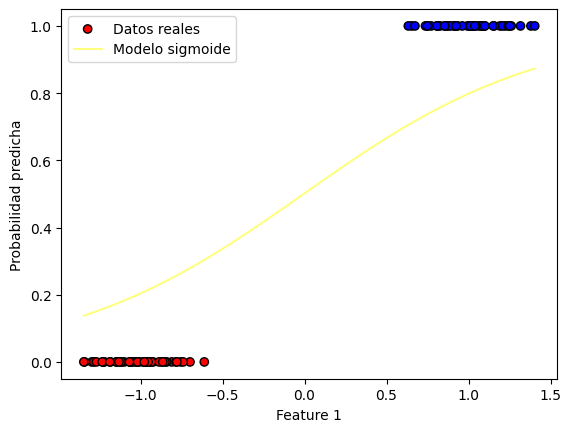

Iteracion: 434
Costo en la iteración 434: 0.22904090442607142
Valor del gradiente 434: [-0.00196419 -0.19844276]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00677034 1.37112174]


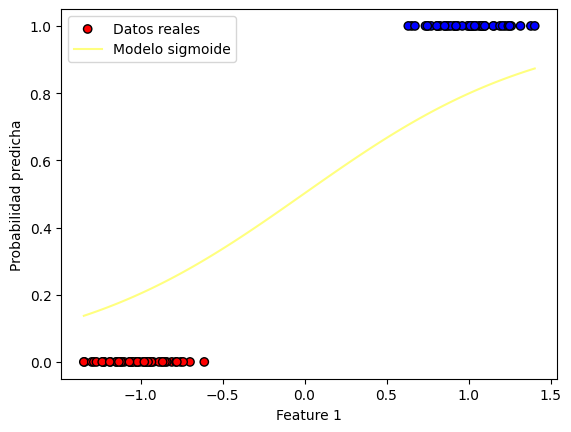

Iteracion: 435
Costo en la iteración 435: 0.22864738600991225
Valor del gradiente 435: [-0.00196363 -0.19812491]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00678998 1.37310299]


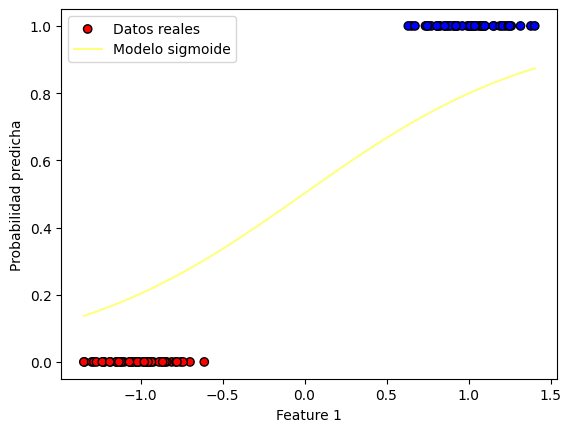

Iteracion: 436
Costo en la iteración 436: 0.22825512669700207
Valor del gradiente 436: [-0.00196306 -0.19780797]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00680961 1.37508107]


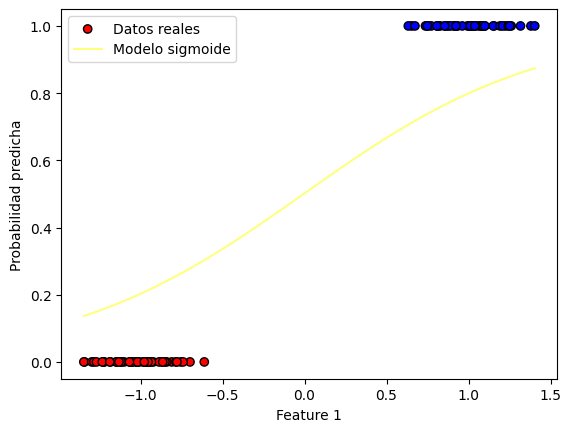

Iteracion: 437
Costo en la iteración 437: 0.22786412084520946
Valor del gradiente 437: [-0.00196249 -0.19749195]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00682923 1.37705598]


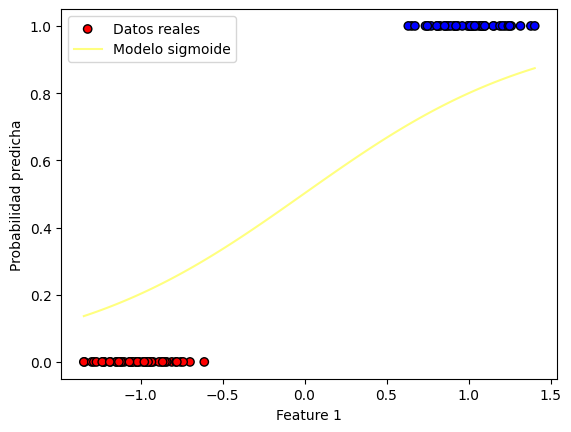

Iteracion: 438
Costo en la iteración 438: 0.2274743628439326
Valor del gradiente 438: [-0.00196191 -0.19717684]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00684885 1.37902775]


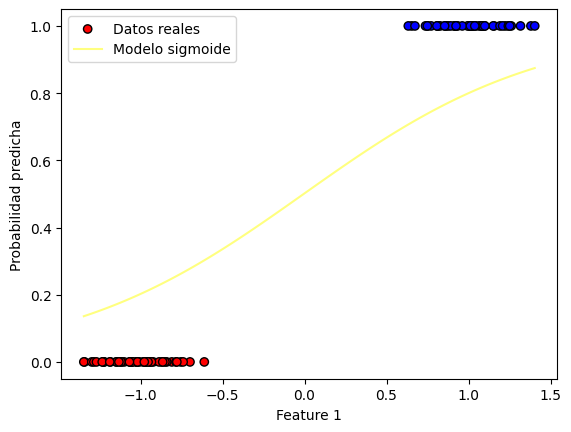

Iteracion: 439
Costo en la iteración 439: 0.2270858471138941
Valor del gradiente 439: [-0.00196132 -0.19686264]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00686847 1.38099638]


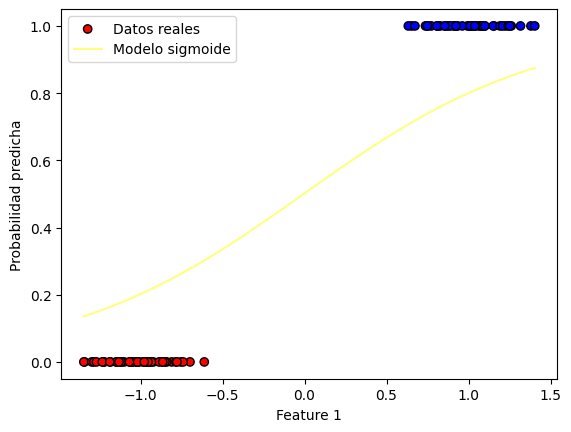

Iteracion: 440
Costo en la iteración 440: 0.2266985681069373
Valor del gradiente 440: [-0.00196073 -0.19654934]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00688807 1.38296187]


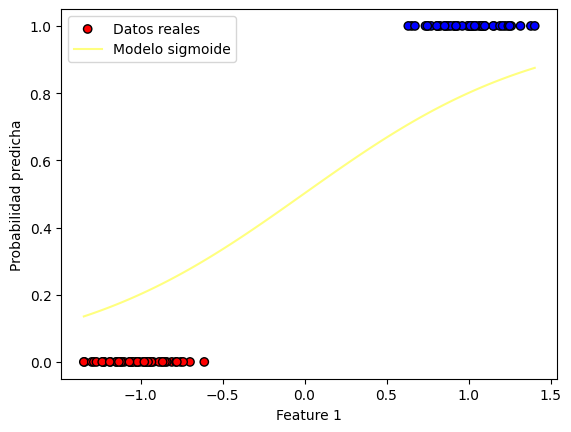

Iteracion: 441
Costo en la iteración 441: 0.22631252030582436
Valor del gradiente 441: [-0.00196013 -0.19623694]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00690767 1.38492424]


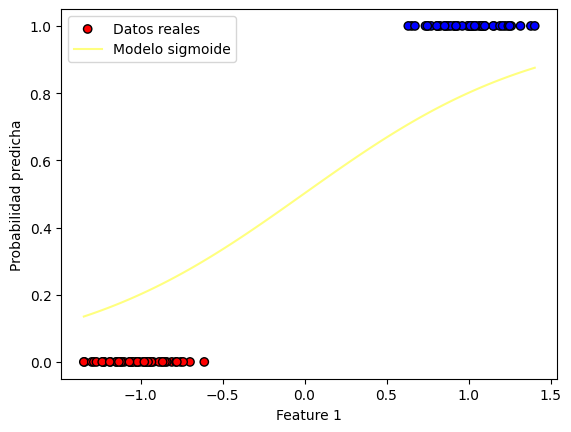

Iteracion: 442
Costo en la iteración 442: 0.22592769822403494
Valor del gradiente 442: [-0.00195953 -0.19592544]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00692727 1.3868835 ]


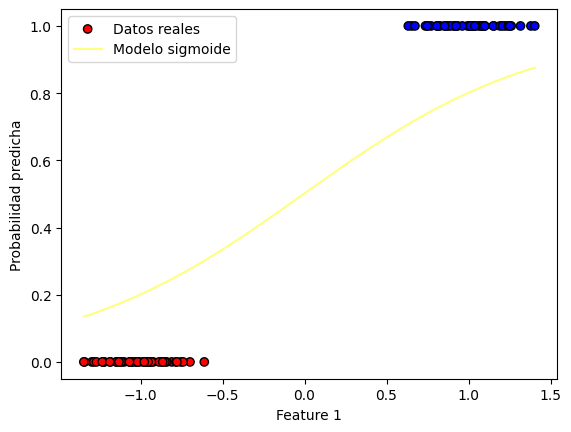

Iteracion: 443
Costo en la iteración 443: 0.22554409640556738
Valor del gradiente 443: [-0.00195893 -0.19561483]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00694686 1.38883964]


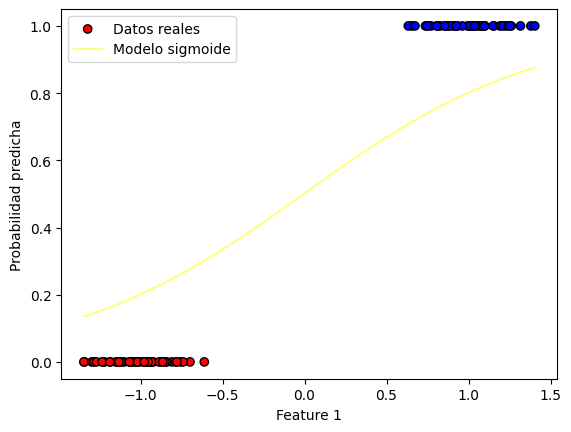

Iteracion: 444
Costo en la iteración 444: 0.22516170942474073
Valor del gradiente 444: [-0.00195832 -0.19530511]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00696644 1.3907927 ]


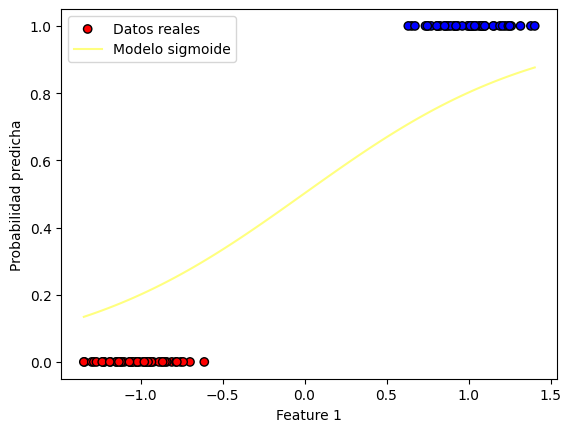

Iteracion: 445
Costo en la iteración 445: 0.2247805318859977
Valor del gradiente 445: [-0.0019577  -0.19499627]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00698602 1.39274266]


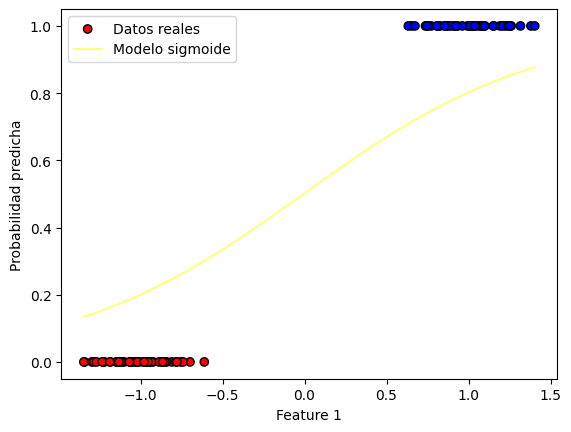

Iteracion: 446
Costo en la iteración 446: 0.22440055842371048
Valor del gradiente 446: [-0.00195708 -0.19468832]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00700559 1.39468954]


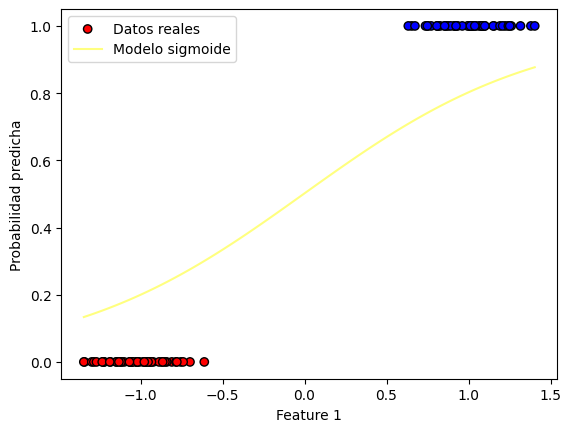

Iteracion: 447
Costo en la iteración 447: 0.22402178370198653
Valor del gradiente 447: [-0.00195645 -0.19438124]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00702515 1.39663335]


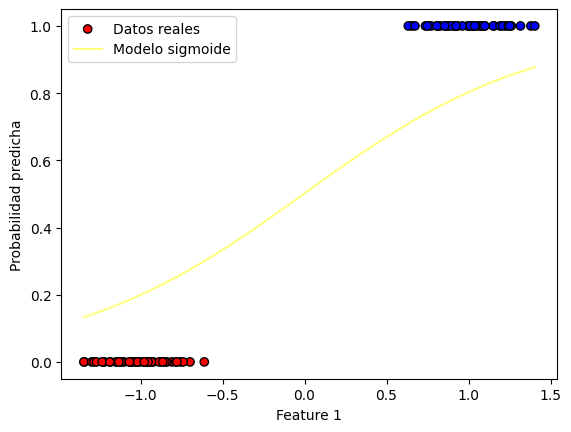

Iteracion: 448
Costo en la iteración 448: 0.22364420241447616
Valor del gradiente 448: [-0.00195582 -0.19407504]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00704471 1.3985741 ]


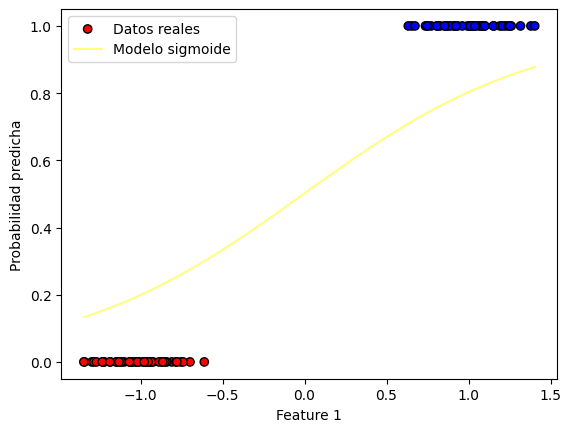

Iteracion: 449
Costo en la iteración 449: 0.2232678092841821
Valor del gradiente 449: [-0.00195519 -0.19376972]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00706426 1.4005118 ]


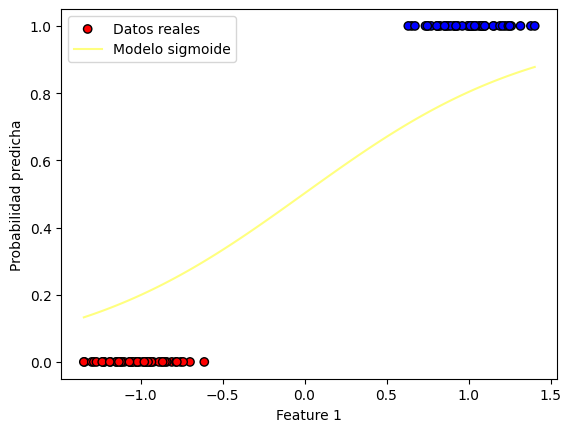

Iteracion: 450
Costo en la iteración 450: 0.22289259906326975
Valor del gradiente 450: [-0.00195455 -0.19346526]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00708381 1.40244645]


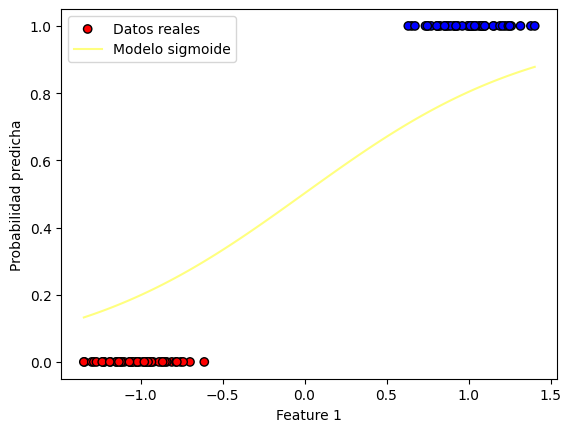

Iteracion: 451
Costo en la iteración 451: 0.22251856653287885
Valor del gradiente 451: [-0.0019539  -0.19316167]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00710335 1.40437807]


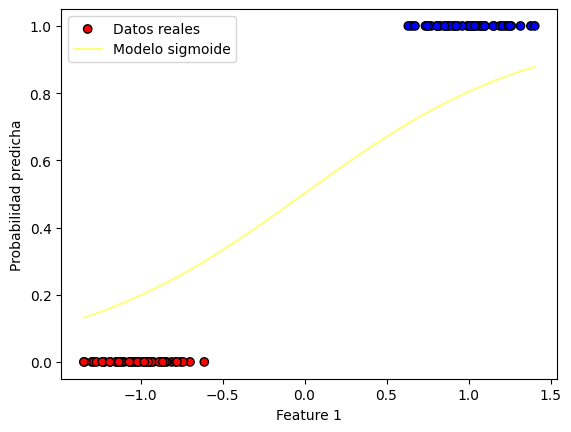

Iteracion: 452
Costo en la iteración 452: 0.22214570650293686
Valor del gradiente 452: [-0.00195325 -0.19285894]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00712288 1.40630666]


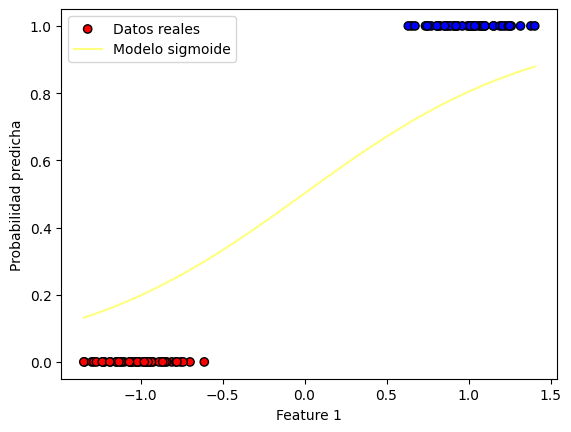

Iteracion: 453
Costo en la iteración 453: 0.22177401381197334
Valor del gradiente 453: [-0.0019526  -0.19255707]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00714241 1.40823223]


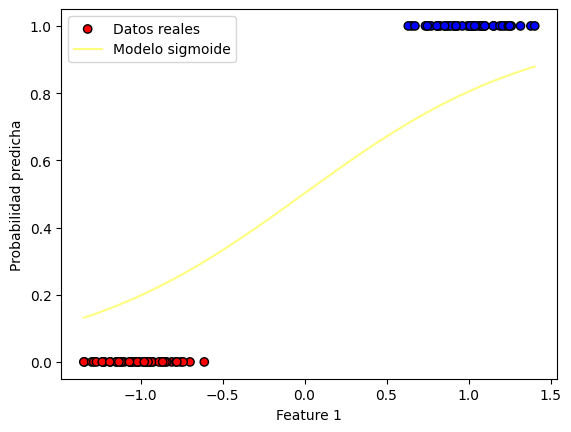

Iteracion: 454
Costo en la iteración 454: 0.22140348332693582
Valor del gradiente 454: [-0.00195194 -0.19225605]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00716193 1.41015479]


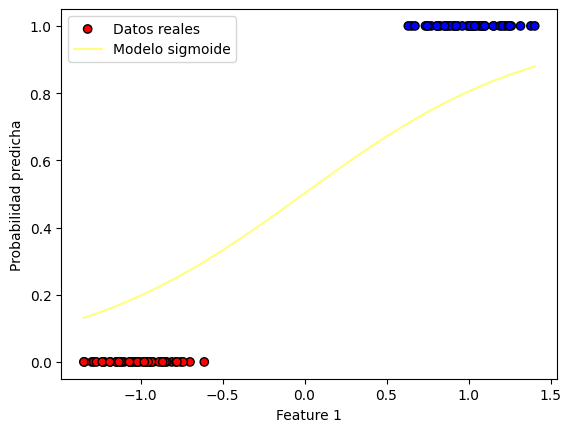

Iteracion: 455
Costo en la iteración 455: 0.22103410994300696
Valor del gradiente 455: [-0.00195128 -0.19195589]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00718144 1.41207435]


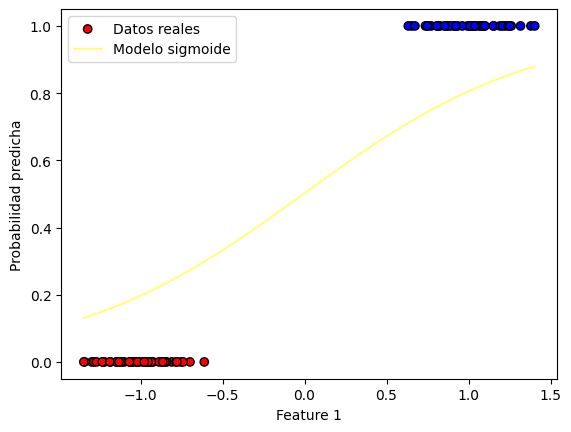

Iteracion: 456
Costo en la iteración 456: 0.22066588858342293
Valor del gradiente 456: [-0.00195061 -0.19165657]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00720095 1.41399092]


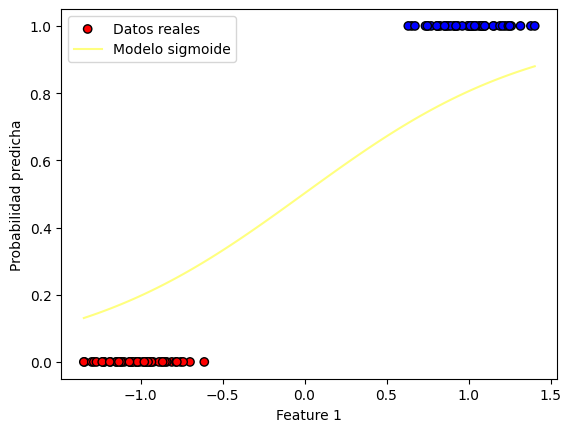

Iteracion: 457
Costo en la iteración 457: 0.22029881419929337
Valor del gradiente 457: [-0.00194994 -0.1913581 ]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00722044 1.4159045 ]


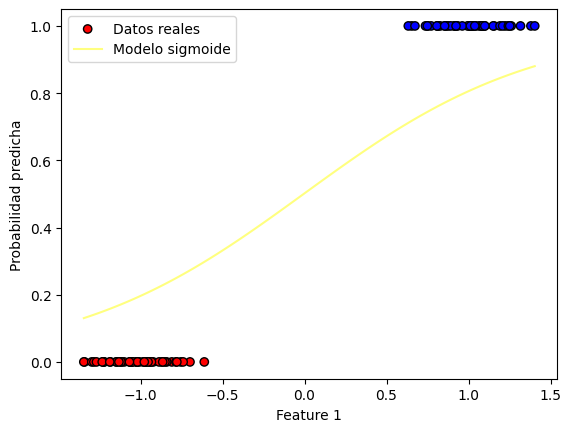

Iteracion: 458
Costo en la iteración 458: 0.21993288176942208
Valor del gradiente 458: [-0.00194926 -0.19106048]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00723994 1.4178151 ]


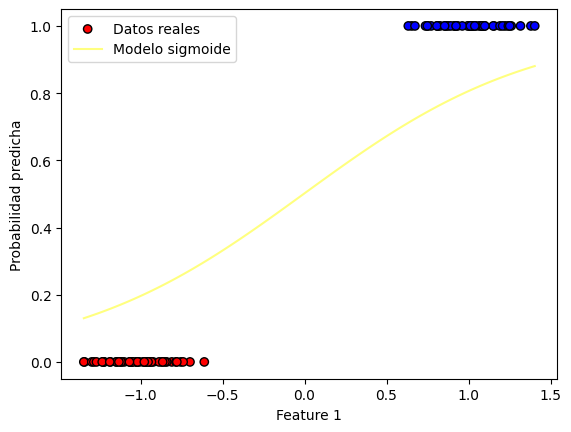

Iteracion: 459
Costo en la iteración 459: 0.21956808630012967
Valor del gradiente 459: [-0.00194858 -0.19076369]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00725942 1.41972274]


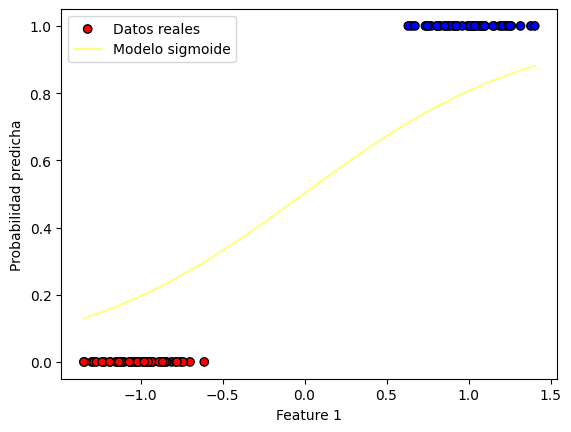

Iteracion: 460
Costo en la iteración 460: 0.21920442282507688
Valor del gradiente 460: [-0.0019479  -0.19046774]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.0072789  1.42162742]


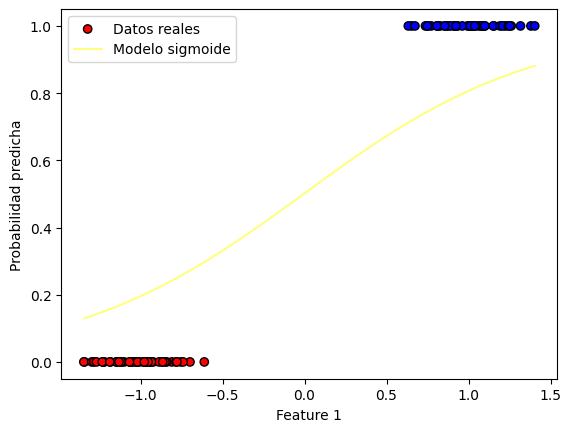

Iteracion: 461
Costo en la iteración 461: 0.21884188640508967
Valor del gradiente 461: [-0.00194721 -0.19017262]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00729837 1.42352914]


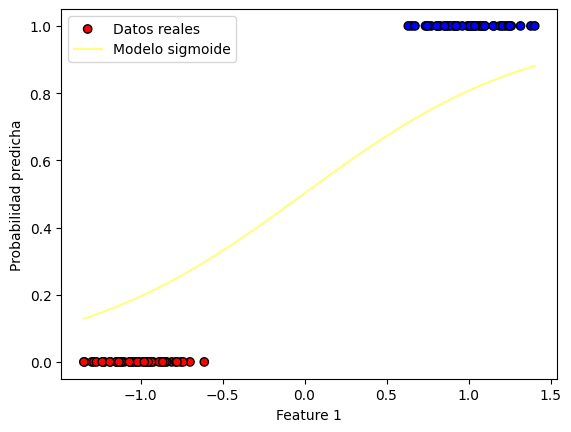

Iteracion: 462
Costo en la iteración 462: 0.2184804721279851
Valor del gradiente 462: [-0.00194652 -0.18987833]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00731784 1.42542793]


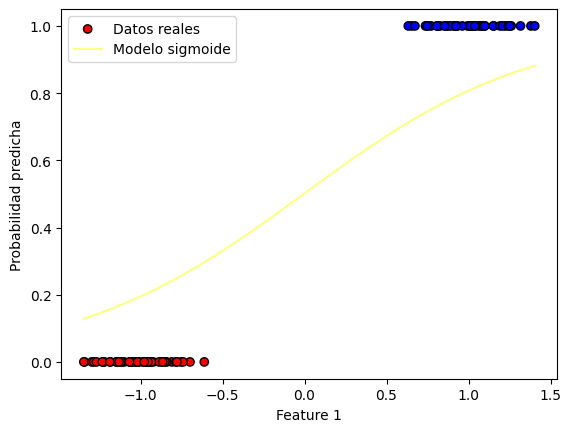

Iteracion: 463
Costo en la iteración 463: 0.21812017510839862
Valor del gradiente 463: [-0.00194582 -0.18958487]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.0073373  1.42732377]


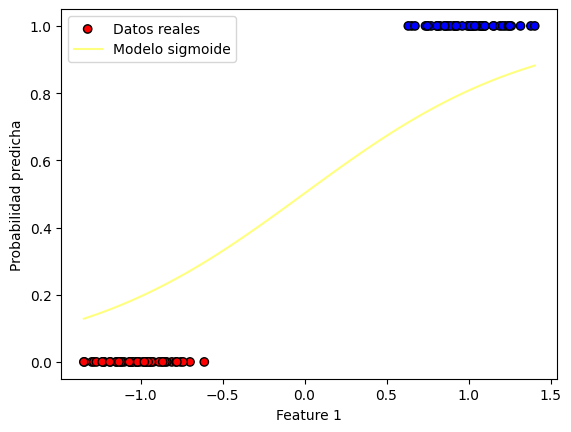

Iteracion: 464
Costo en la iteración 464: 0.21776099048761294
Valor del gradiente 464: [-0.00194512 -0.18929223]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00735675 1.4292167 ]


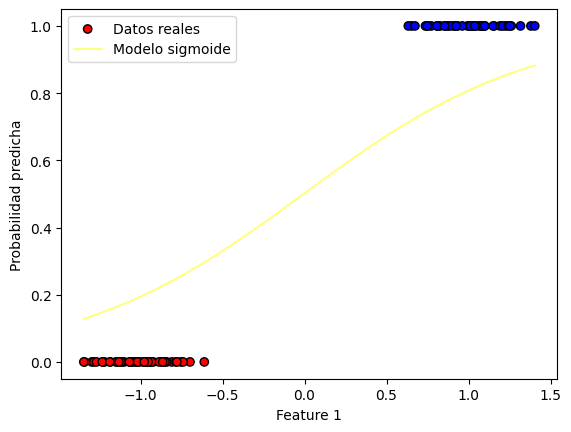

Iteracion: 465
Costo en la iteración 465: 0.2174029134333875
Valor del gradiente 465: [-0.00194441 -0.18900041]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00737619 1.4311067 ]


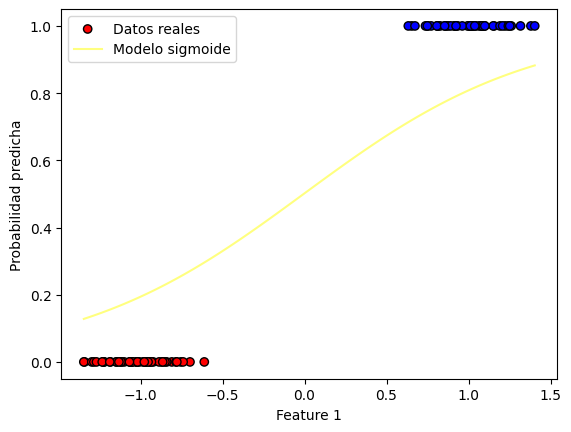

Iteracion: 466
Costo en la iteración 466: 0.2170459391397894
Valor del gradiente 466: [-0.0019437  -0.18870941]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00739563 1.4329938 ]


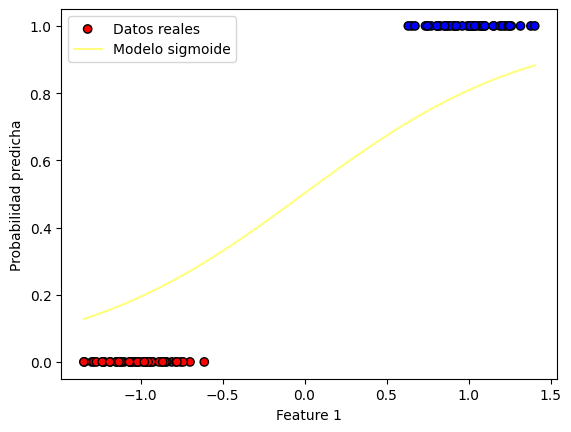

Iteracion: 467
Costo en la iteración 467: 0.21669006282702605
Valor del gradiente 467: [-0.00194299 -0.18841922]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00741506 1.43487799]


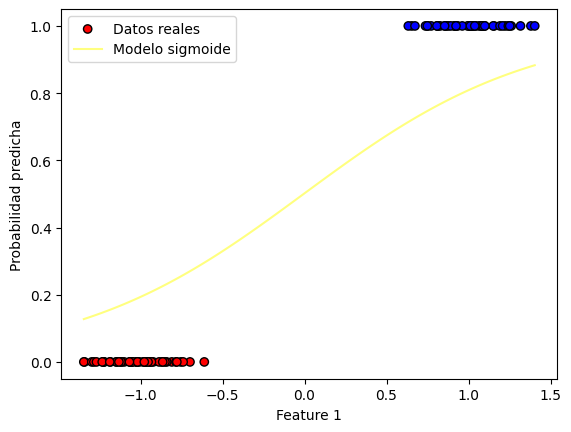

Iteracion: 468
Costo en la iteración 468: 0.21633527974127803
Valor del gradiente 468: [-0.00194227 -0.18812984]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00743448 1.43675929]


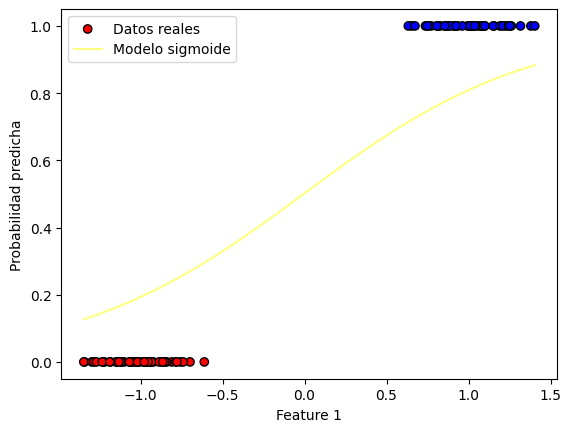

Iteracion: 469
Costo en la iteración 469: 0.2159815851545339
Valor del gradiente 469: [-0.00194155 -0.18784127]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.0074539 1.4386377]


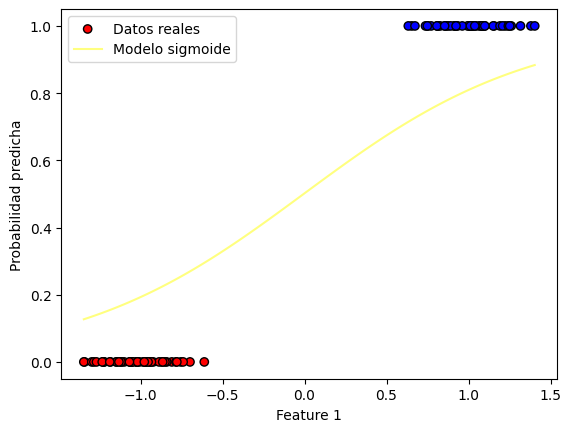

Iteracion: 470
Costo en la iteración 470: 0.21562897436442602
Valor del gradiente 470: [-0.00194083 -0.1875535 ]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00747331 1.44051323]


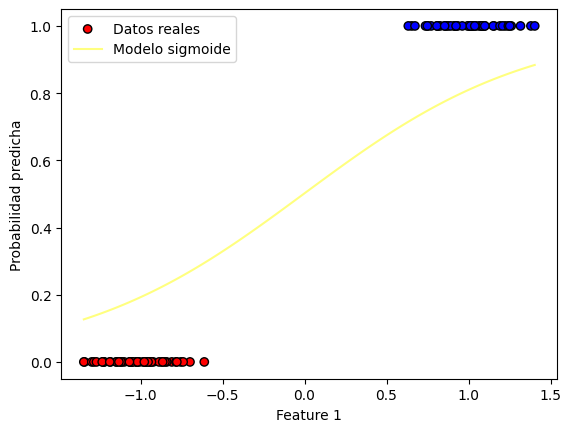

Iteracion: 471
Costo en la iteración 471: 0.21527744269406718
Valor del gradiente 471: [-0.0019401  -0.18726654]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00749271 1.4423859 ]


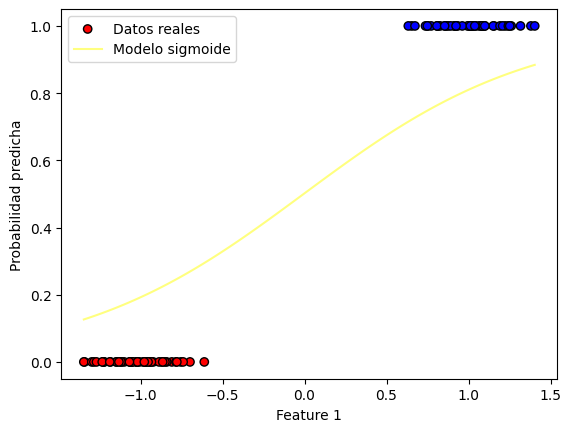

Iteracion: 472
Costo en la iteración 472: 0.21492698549188893
Valor del gradiente 472: [-0.00193936 -0.18698037]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.0075121 1.4442557]


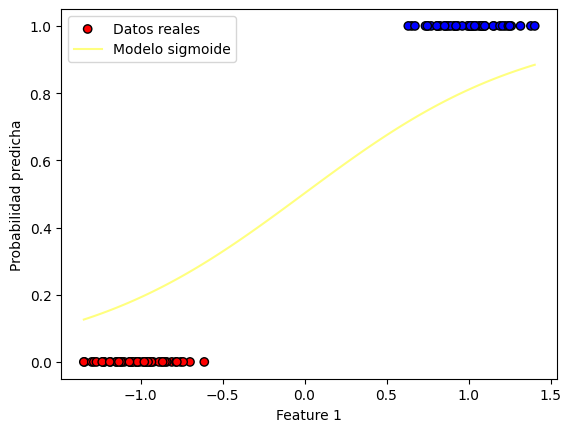

Iteracion: 473
Costo en la iteración 473: 0.21457759813148078
Valor del gradiente 473: [-0.00193863 -0.186695  ]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00753149 1.44612265]


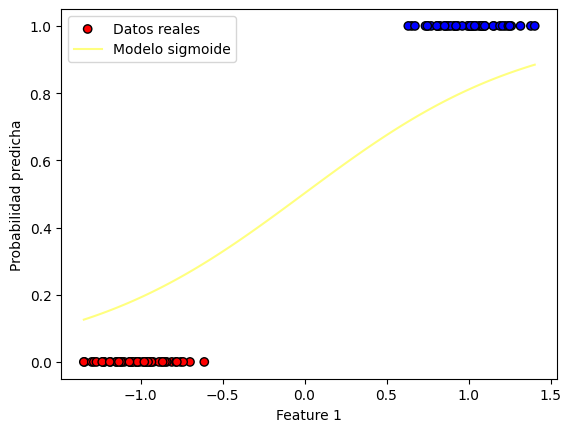

Iteracion: 474
Costo en la iteración 474: 0.21422927601143035
Valor del gradiente 474: [-0.00193789 -0.18641043]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00755087 1.44798676]


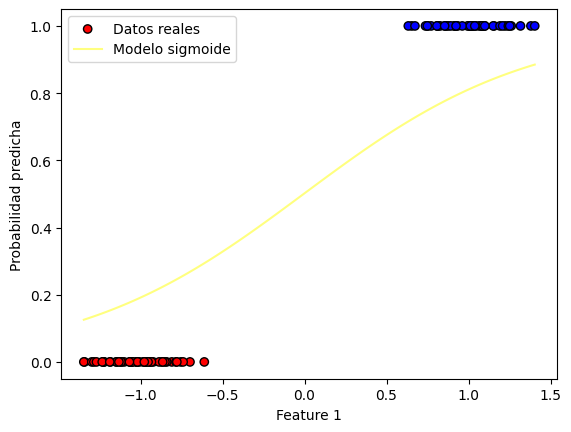

Iteracion: 475
Costo en la iteración 475: 0.21388201455516498
Valor del gradiente 475: [-0.00193714 -0.18612664]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00757024 1.44984802]


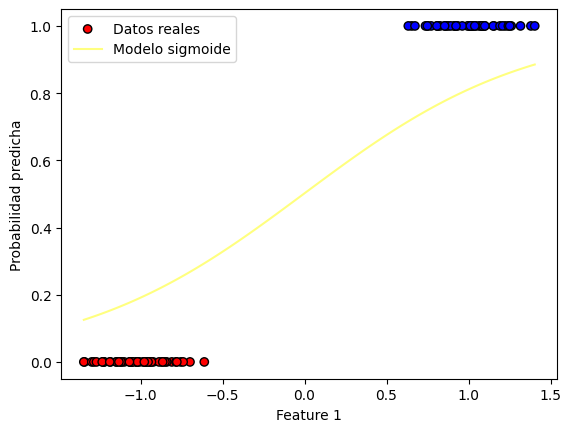

Iteracion: 476
Costo en la iteración 476: 0.2135358092107944
Valor del gradiente 476: [-0.00193639 -0.18584364]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.0075896  1.45170646]


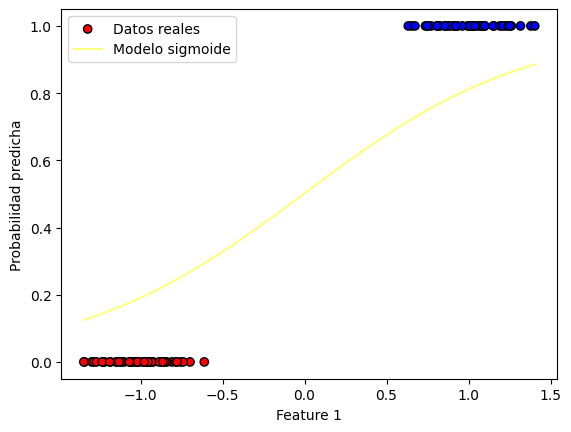

Iteracion: 477
Costo en la iteración 477: 0.21319065545095434
Valor del gradiente 477: [-0.00193564 -0.18556142]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00760896 1.45356207]


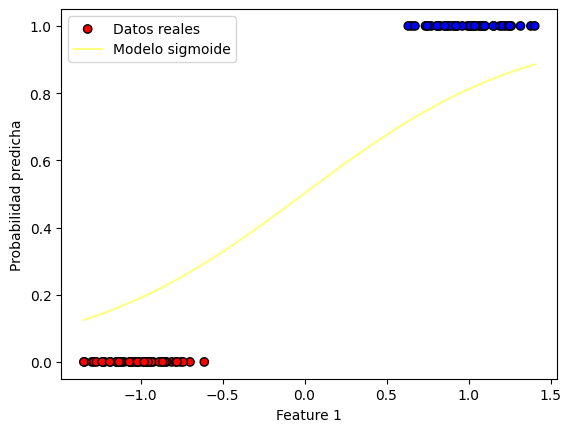

Iteracion: 478
Costo en la iteración 478: 0.21284654877265138
Valor del gradiente 478: [-0.00193489 -0.18527998]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00762831 1.45541487]


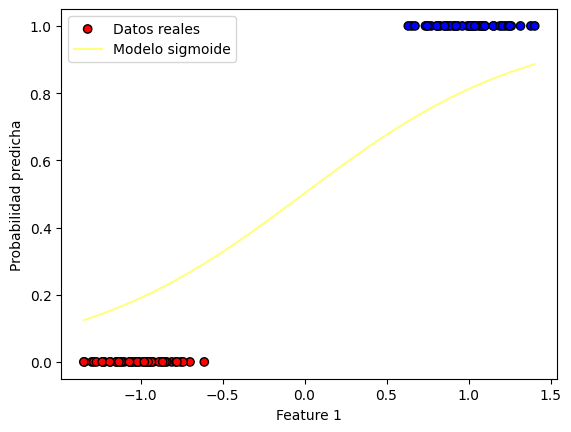

Iteracion: 479
Costo en la iteración 479: 0.212503484697109
Valor del gradiente 479: [-0.00193413 -0.18499932]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00764765 1.45726487]


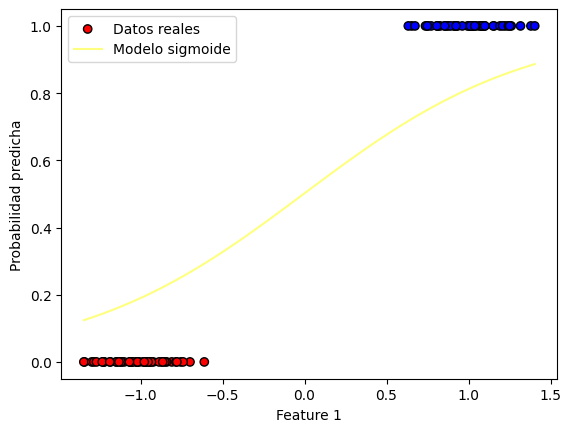

Iteracion: 480
Costo en la iteración 480: 0.21216145876961437
Valor del gradiente 480: [-0.00193337 -0.18471943]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00766698 1.45911206]


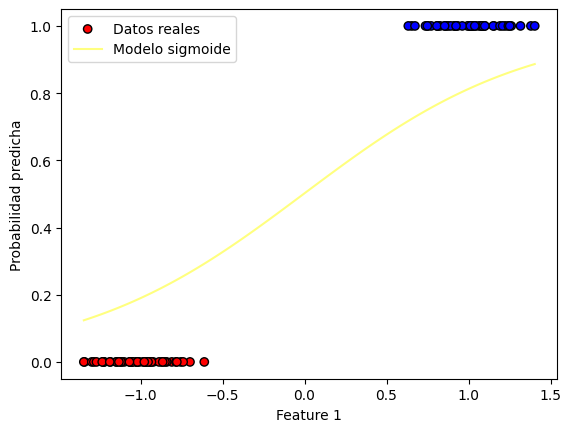

Iteracion: 481
Costo en la iteración 481: 0.21182046655936657
Valor del gradiente 481: [-0.0019326  -0.18444032]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00768631 1.46095646]


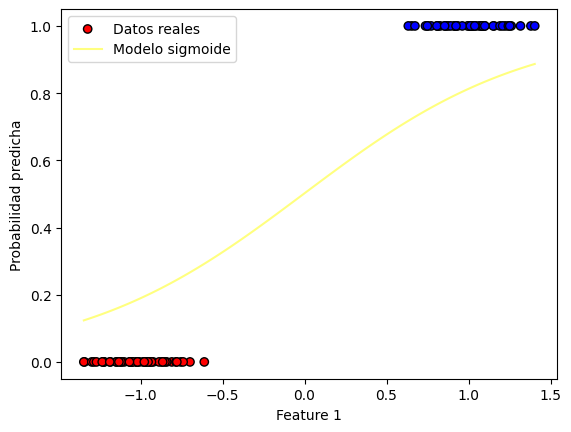

Iteracion: 482
Costo en la iteración 482: 0.2114805036593259
Valor del gradiente 482: [-0.00193183 -0.18416197]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00770563 1.46279808]


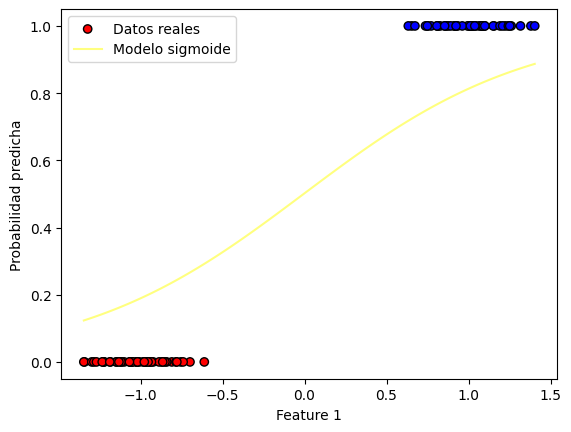

Iteracion: 483
Costo en la iteración 483: 0.2111415656860638
Valor del gradiente 483: [-0.00193106 -0.18388439]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00772494 1.46463693]


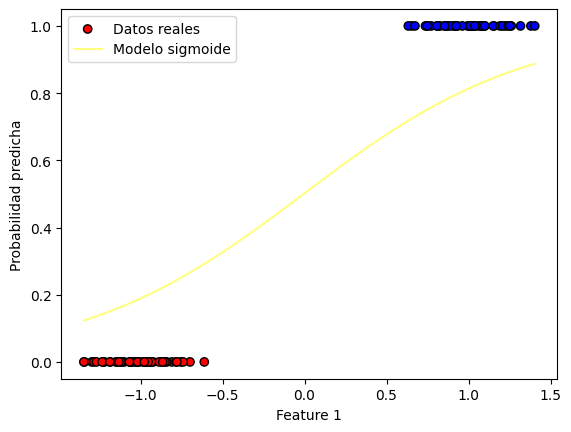

Iteracion: 484
Costo en la iteración 484: 0.21080364827961454
Valor del gradiente 484: [-0.00193028 -0.18360757]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00774424 1.466473  ]


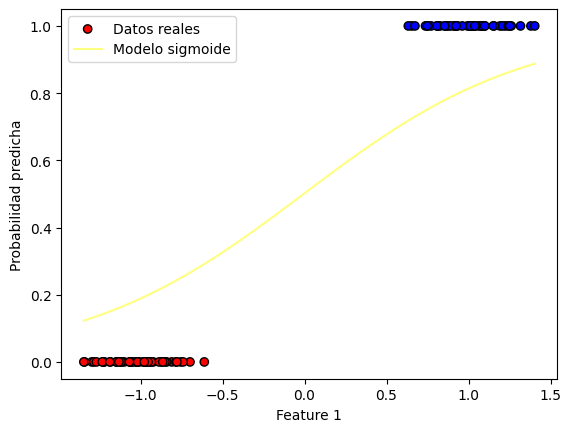

Iteracion: 485
Costo en la iteración 485: 0.2104667471033269
Valor del gradiente 485: [-0.0019295  -0.18333152]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00776353 1.46830632]


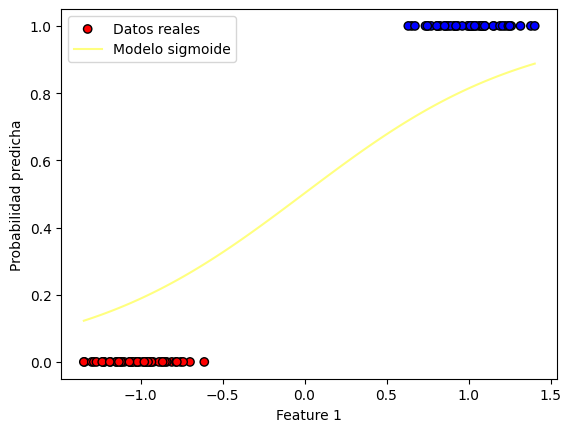

Iteracion: 486
Costo en la iteración 486: 0.21013085784371846
Valor del gradiente 486: [-0.00192872 -0.18305622]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00778282 1.47013688]


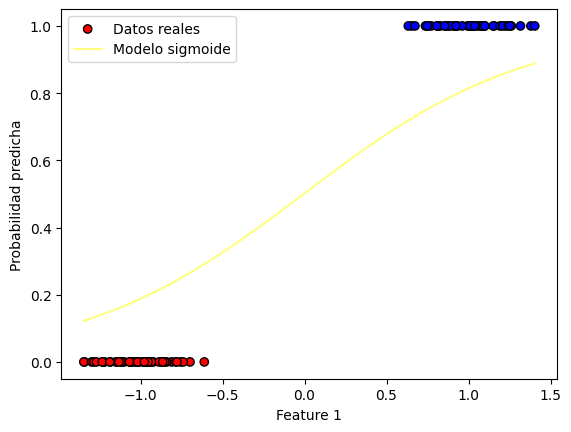

Iteracion: 487
Costo en la iteración 487: 0.20979597621032922
Valor del gradiente 487: [-0.00192793 -0.18278167]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.0078021 1.4719647]


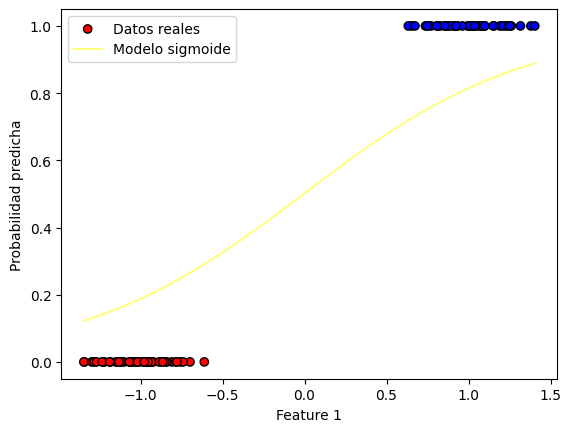

Iteracion: 488
Costo en la iteración 488: 0.20946209793557743
Valor del gradiente 488: [-0.00192714 -0.18250788]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00782137 1.47378978]


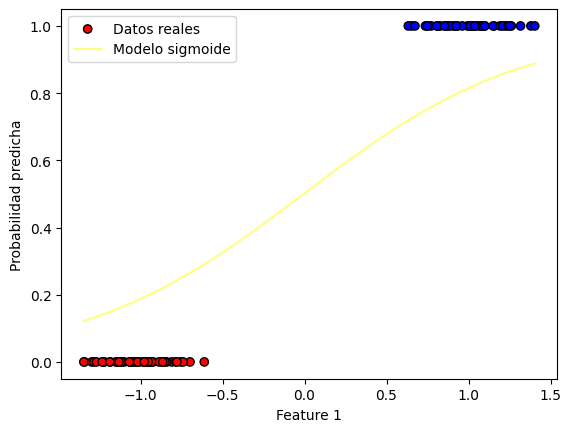

Iteracion: 489
Costo en la iteración 489: 0.20912921877461607
Valor del gradiente 489: [-0.00192635 -0.18223483]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00784064 1.47561212]


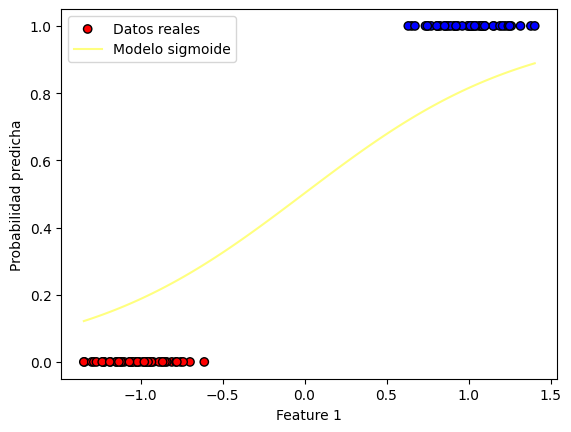

Iteracion: 490
Costo en la iteración 490: 0.20879733450518997
Valor del gradiente 490: [-0.00192555 -0.18196253]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00785989 1.47743175]


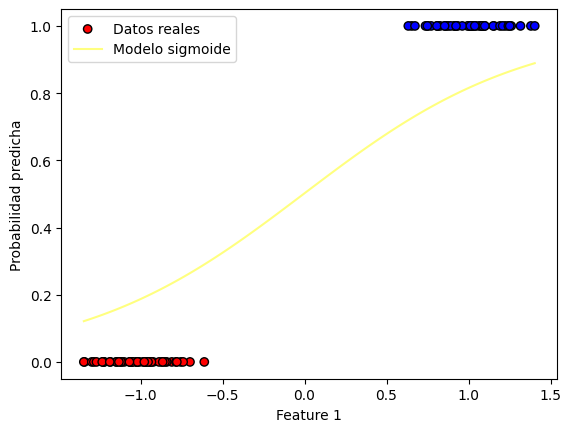

Iteracion: 491
Costo en la iteración 491: 0.2084664409274949
Valor del gradiente 491: [-0.00192475 -0.18169097]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00787914 1.47924866]


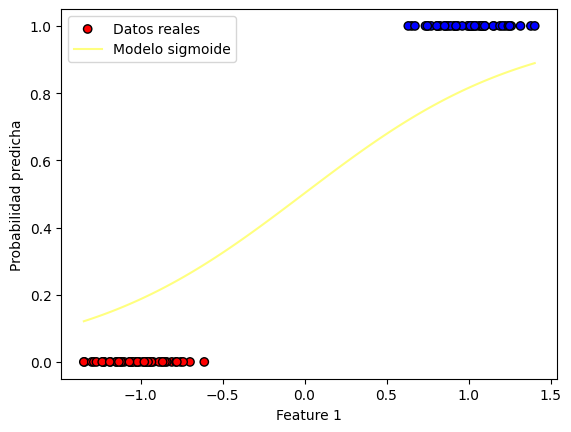

Iteracion: 492
Costo en la iteración 492: 0.20813653386403608
Valor del gradiente 492: [-0.00192395 -0.18142016]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00789838 1.48106286]


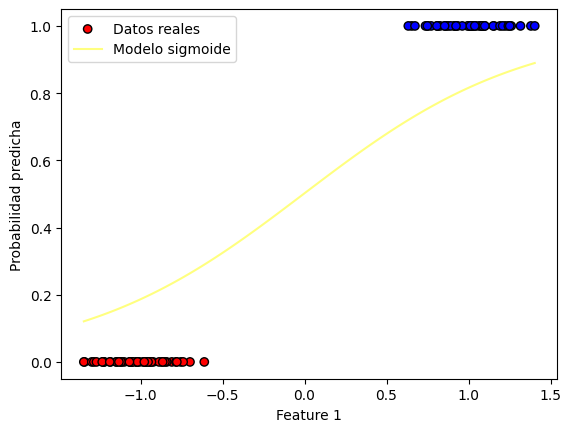

Iteracion: 493
Costo en la iteración 493: 0.20780760915948968
Valor del gradiente 493: [-0.00192315 -0.18115008]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00791761 1.48287436]


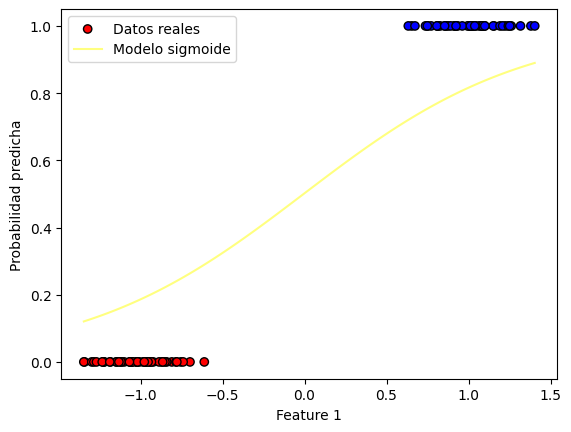

Iteracion: 494
Costo en la iteración 494: 0.2074796626805637
Valor del gradiente 494: [-0.00192234 -0.18088073]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00793683 1.48468317]


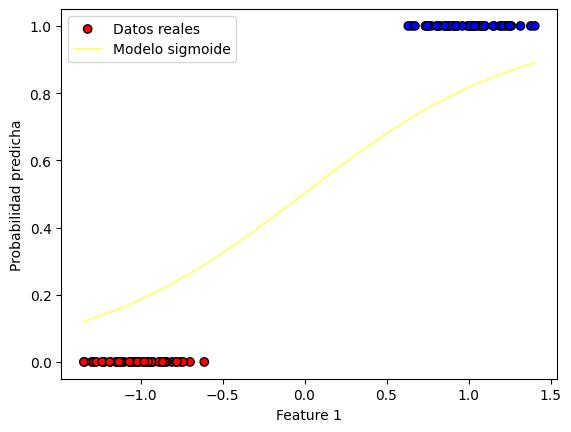

Iteracion: 495
Costo en la iteración 495: 0.20715269031586012
Valor del gradiente 495: [-0.00192153 -0.18061212]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00795605 1.48648929]


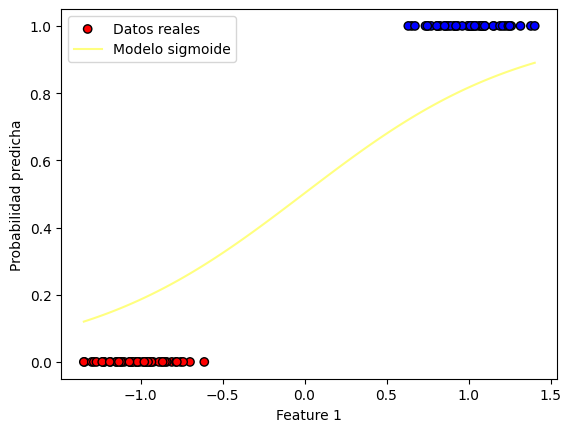

Iteracion: 496
Costo en la iteración 496: 0.20682668797573897
Valor del gradiente 496: [-0.00192071 -0.18034424]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00797526 1.48829273]


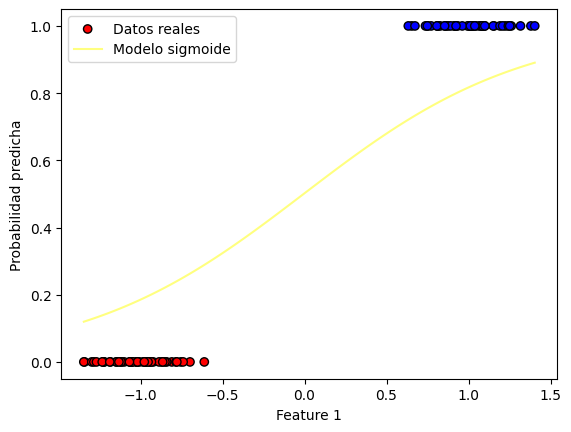

Iteracion: 497
Costo en la iteración 497: 0.206501651592182
Valor del gradiente 497: [-0.0019199  -0.18007708]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00799445 1.4900935 ]


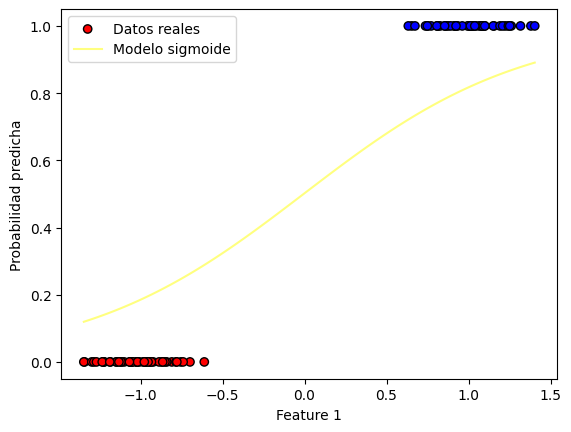

Iteracion: 498
Costo en la iteración 498: 0.20617757711865836
Valor del gradiente 498: [-0.00191907 -0.17981065]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00801365 1.49189161]


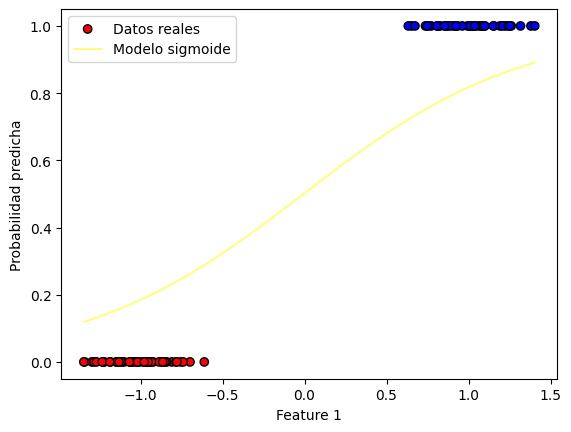

Iteracion: 499
Costo en la iteración 499: 0.20585446052999057
Valor del gradiente 499: [-0.00191825 -0.17954494]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00803283 1.49368706]


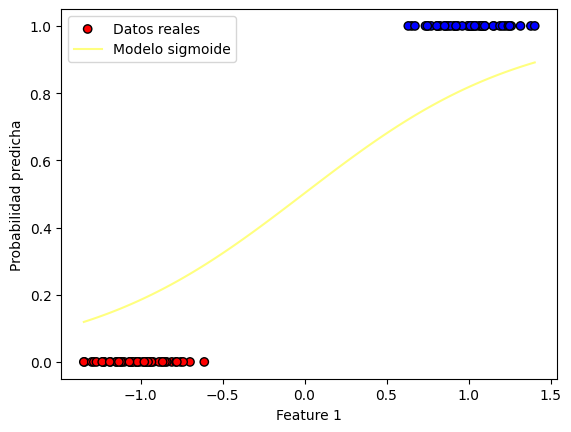

Iteracion: 500
Costo en la iteración 500: 0.20553229782222185
Valor del gradiente 500: [-0.00191742 -0.17927995]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.008052   1.49547986]


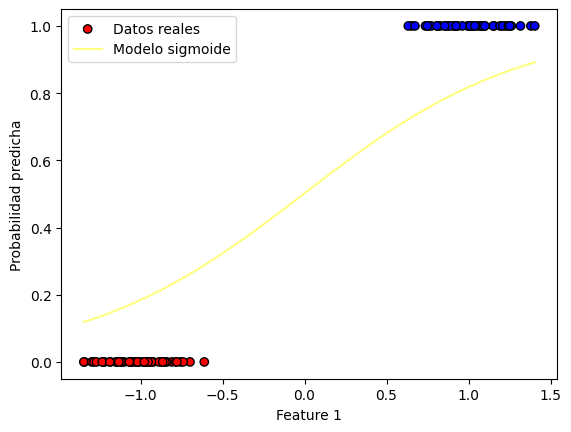

Iteracion: 501
Costo en la iteración 501: 0.2052110850124842
Valor del gradiente 501: [-0.0019166  -0.17901567]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00807117 1.49727002]


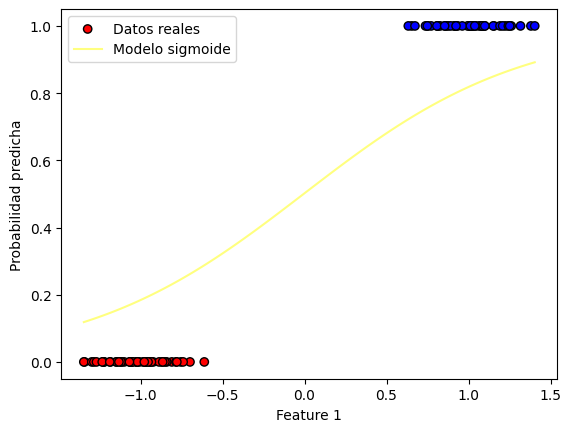

Iteracion: 502
Costo en la iteración 502: 0.20489081813886714
Valor del gradiente 502: [-0.00191576 -0.17875211]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00809033 1.49905754]


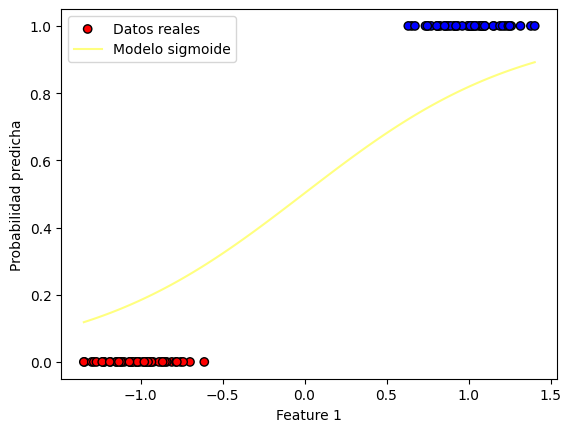

Iteracion: 503
Costo en la iteración 503: 0.20457149326028798
Valor del gradiente 503: [-0.00191493 -0.17848925]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00810948 1.50084243]


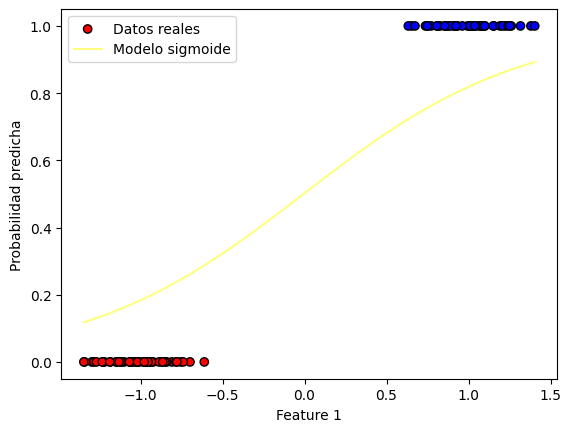

Iteracion: 504
Costo en la iteración 504: 0.20425310645636252
Valor del gradiente 504: [-0.00191409 -0.17822711]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00812862 1.5026247 ]


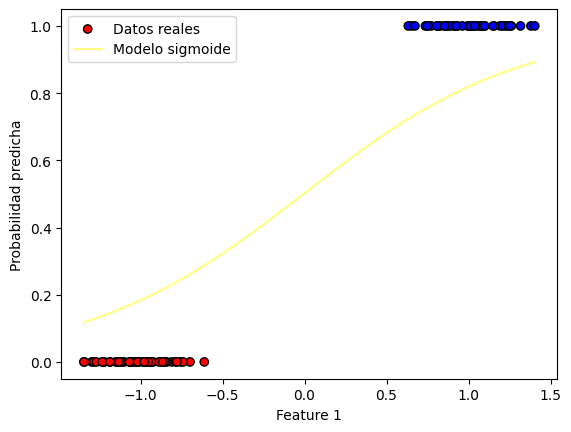

Iteracion: 505
Costo en la iteración 505: 0.20393565382727658
Valor del gradiente 505: [-0.00191325 -0.17796567]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00814775 1.50440436]


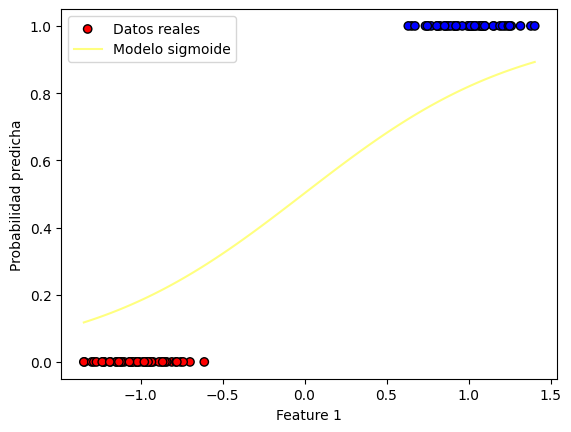

Iteracion: 506
Costo en la iteración 506: 0.20361913149365904
Valor del gradiente 506: [-0.00191241 -0.17770493]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00816687 1.50618141]


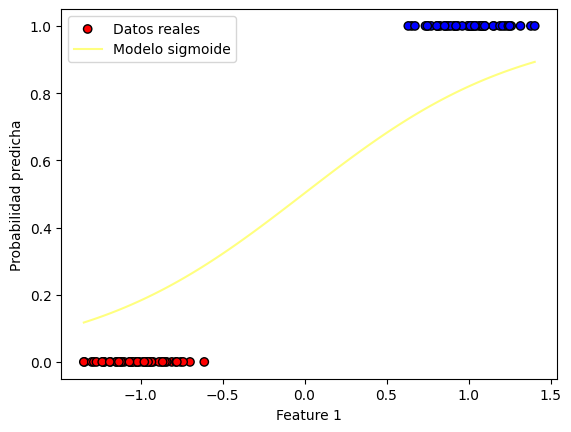

Iteracion: 507
Costo en la iteración 507: 0.20330353559645492
Valor del gradiente 507: [-0.00191156 -0.17744489]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00818599 1.50795586]


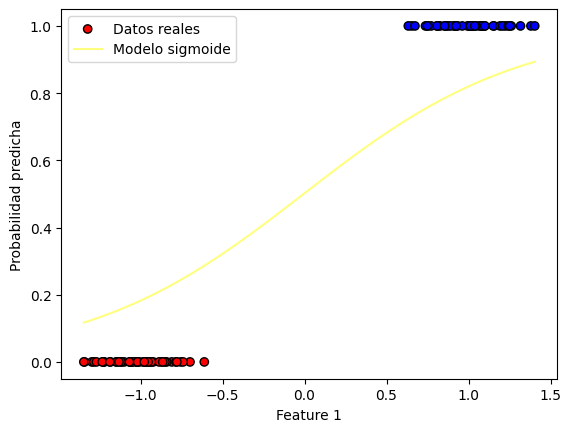

Iteracion: 508
Costo en la iteración 508: 0.20298886229679988
Valor del gradiente 508: [-0.00191071 -0.17718555]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.0082051  1.50972771]


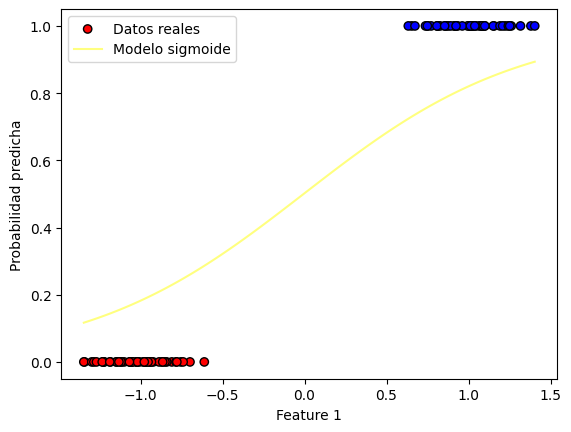

Iteracion: 509
Costo en la iteración 509: 0.202675107775896
Valor del gradiente 509: [-0.00190986 -0.17692691]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00822419 1.51149698]


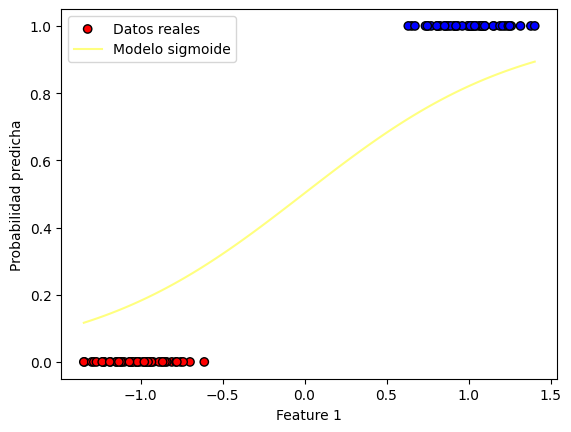

Iteracion: 510
Costo en la iteración 510: 0.20236226823488693
Valor del gradiente 510: [-0.00190901 -0.17666896]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00824328 1.51326367]


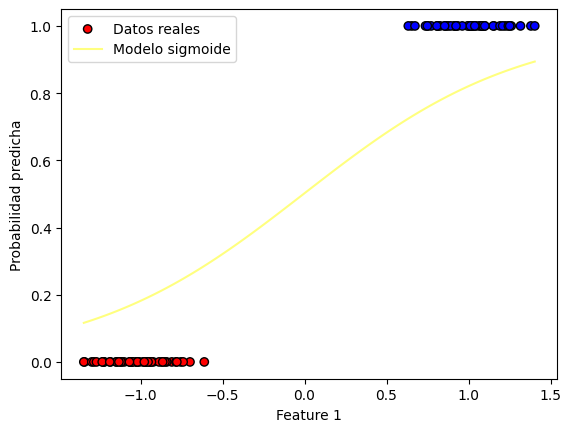

Iteracion: 511
Costo en la iteración 511: 0.20205033989473598
Valor del gradiente 511: [-0.00190815 -0.17641169]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00826237 1.51502779]


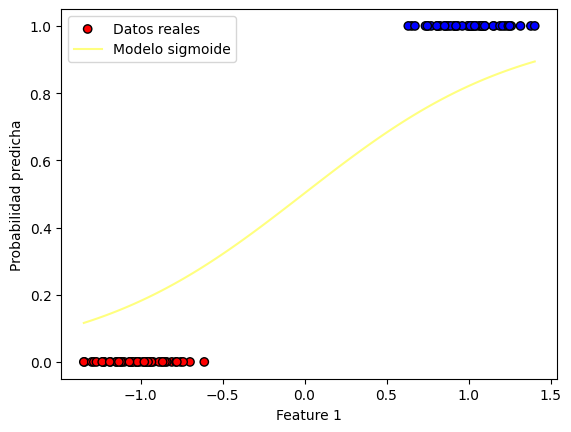

Iteracion: 512
Costo en la iteración 512: 0.2017393189961031
Valor del gradiente 512: [-0.00190729 -0.17615512]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00828144 1.51678934]


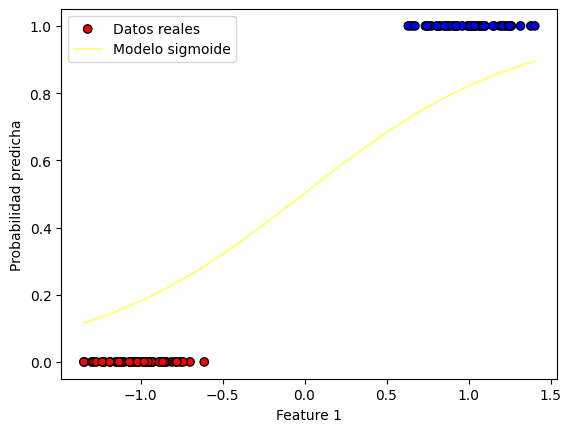

Iteracion: 513
Costo en la iteración 513: 0.2014292017992239
Valor del gradiente 513: [-0.00190643 -0.17589923]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.0083005  1.51854833]


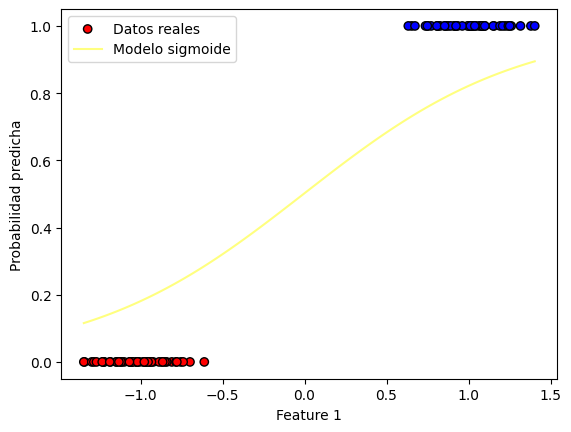

Iteracion: 514
Costo en la iteración 514: 0.20111998458378952
Valor del gradiente 514: [-0.00190557 -0.17564402]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00831956 1.52030477]


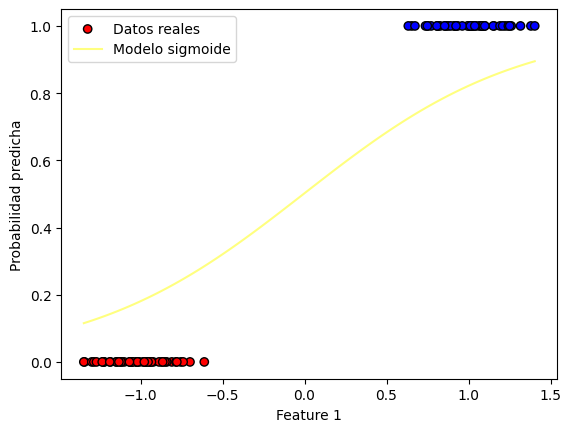

Iteracion: 515
Costo en la iteración 515: 0.20081166364882636
Valor del gradiente 515: [-0.0019047  -0.17538949]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00833861 1.52205867]


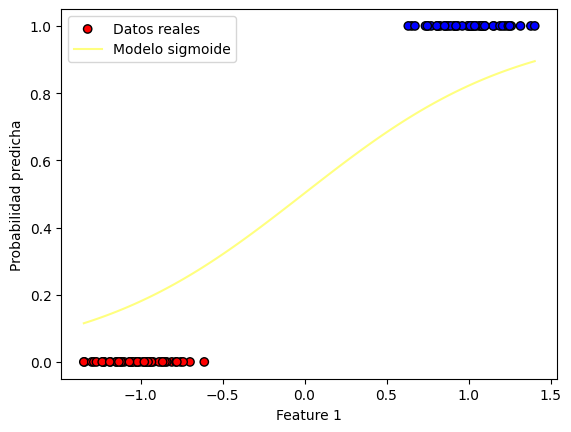

Iteracion: 516
Costo en la iteración 516: 0.20050423531257788
Valor del gradiente 516: [-0.00190383 -0.17513564]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00835764 1.52381002]


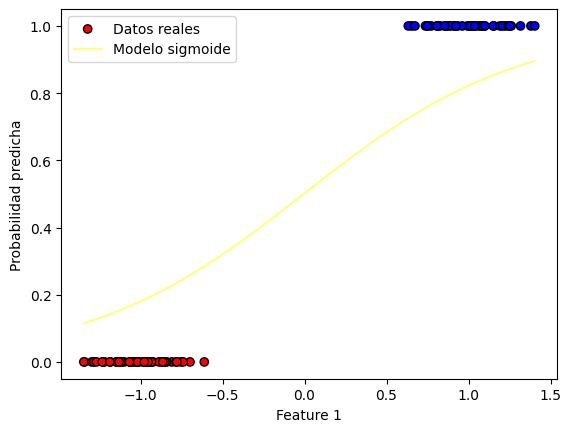

Iteracion: 517
Costo en la iteración 517: 0.20019769591238631
Valor del gradiente 517: [-0.00190296 -0.17488246]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00837667 1.52555885]


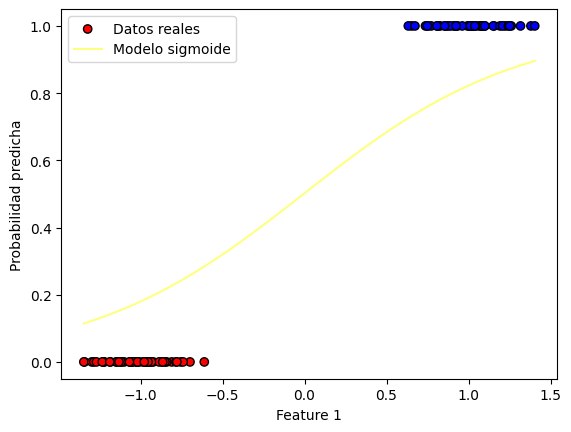

Iteracion: 518
Costo en la iteración 518: 0.19989204180457548
Valor del gradiente 518: [-0.00190209 -0.17462995]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00839569 1.52730515]


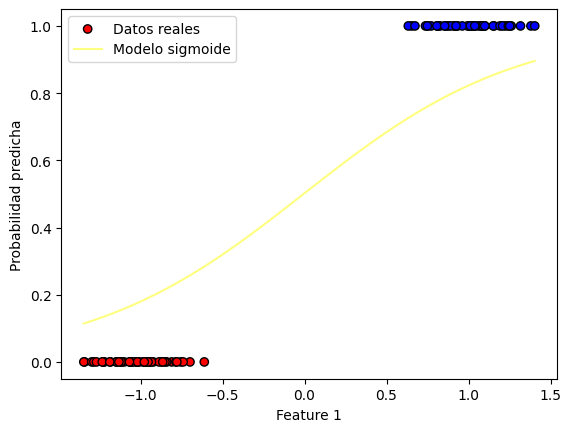

Iteracion: 519
Costo en la iteración 519: 0.19958726936433477
Valor del gradiente 519: [-0.00190121 -0.17437812]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00841471 1.52904893]


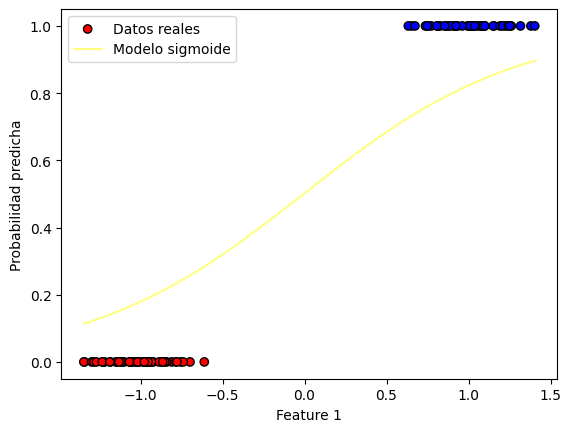

Iteracion: 520
Costo en la iteración 520: 0.19928337498560317
Valor del gradiente 520: [-0.00190033 -0.17412695]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00843371 1.5307902 ]


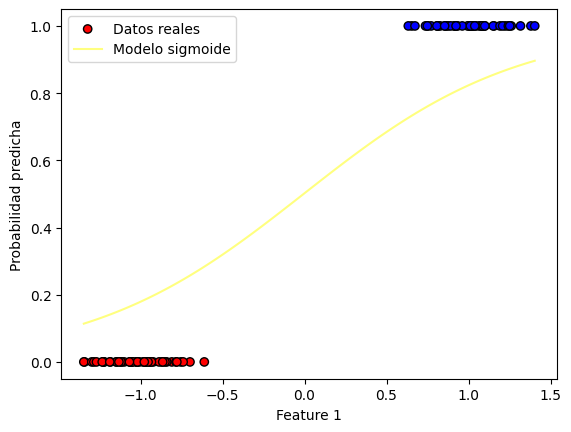

Iteracion: 521
Costo en la iteración 521: 0.19898035508095505
Valor del gradiente 521: [-0.00189945 -0.17387644]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.0084527  1.53252896]


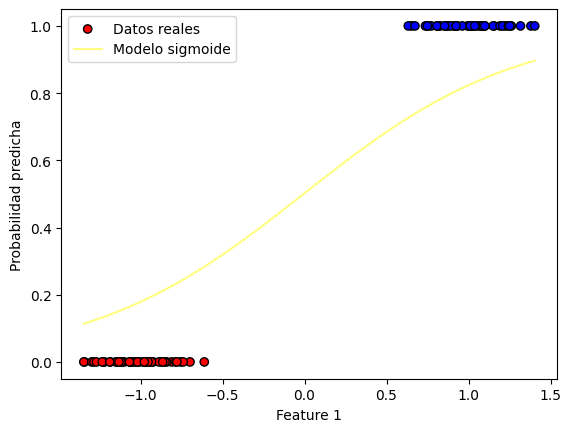

Iteracion: 522
Costo en la iteración 522: 0.19867820608148556
Valor del gradiente 522: [-0.00189857 -0.1736266 ]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00847169 1.53426523]


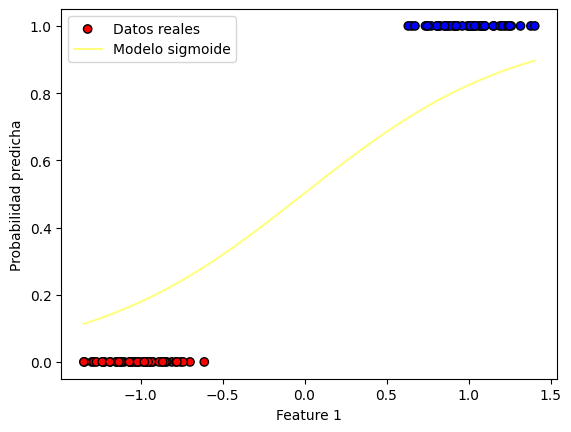

Iteracion: 523
Costo en la iteración 523: 0.19837692443669816
Valor del gradiente 523: [-0.00189769 -0.17337742]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00849067 1.535999  ]


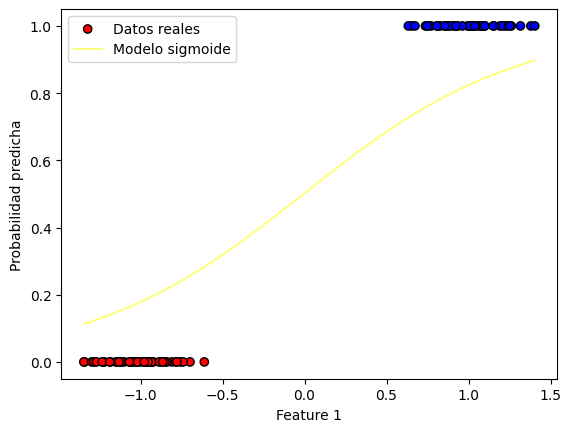

Iteracion: 524
Costo en la iteración 524: 0.19807650661439183
Valor del gradiente 524: [-0.0018968 -0.1731289]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00850964 1.53773029]


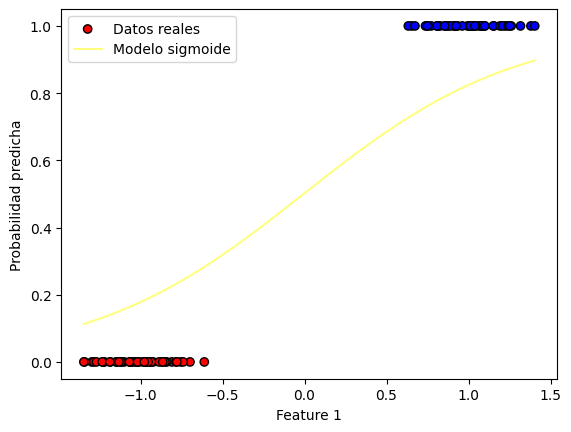

Iteracion: 525
Costo en la iteración 525: 0.19777694910054947
Valor del gradiente 525: [-0.00189591 -0.17288103]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00852859 1.5394591 ]


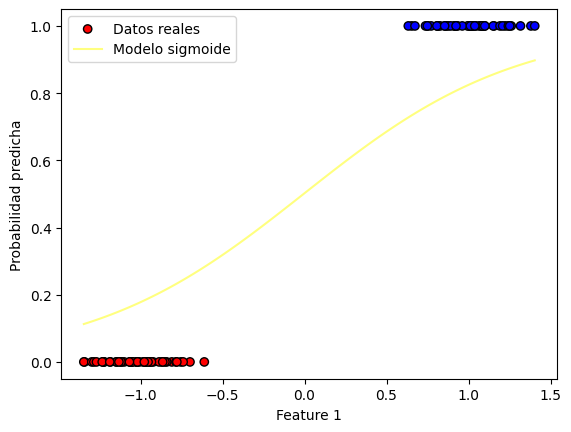

Iteracion: 526
Costo en la iteración 526: 0.1974782483992273
Valor del gradiente 526: [-0.00189502 -0.17263381]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00854754 1.54118544]


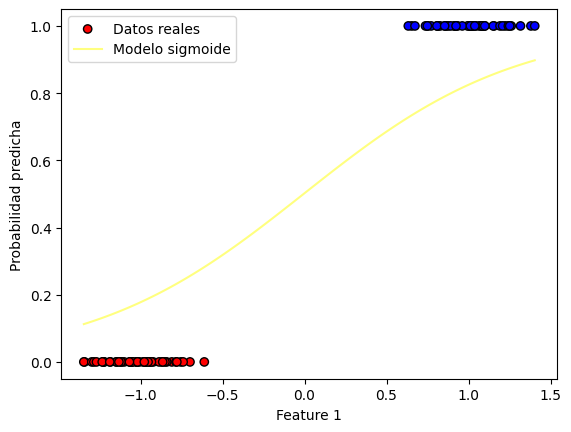

Iteracion: 527
Costo en la iteración 527: 0.19718040103244464
Valor del gradiente 527: [-0.00189412 -0.17238725]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00856649 1.54290931]


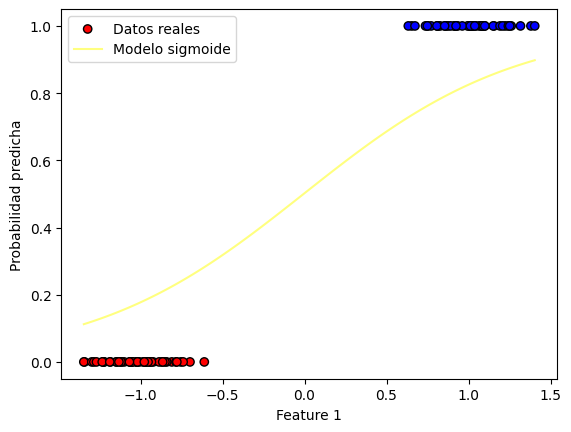

Iteracion: 528
Costo en la iteración 528: 0.19688340354007453
Valor del gradiente 528: [-0.00189323 -0.17214133]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00858542 1.54463072]


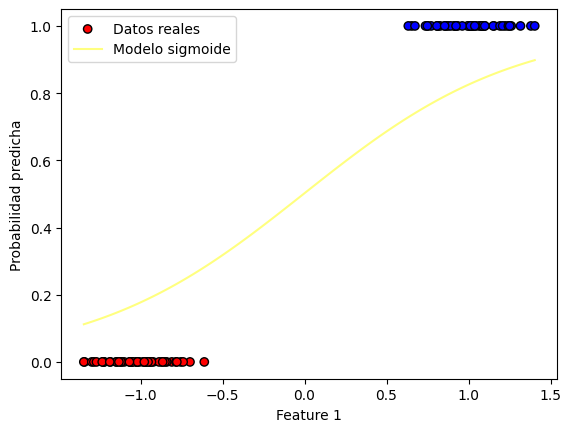

Iteracion: 529
Costo en la iteración 529: 0.1965872524797354
Valor del gradiente 529: [-0.00189233 -0.17189606]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00860434 1.54634969]


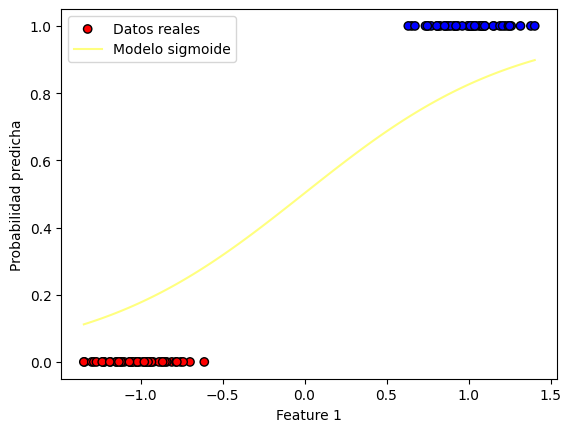

Iteracion: 530
Costo en la iteración 530: 0.1962919444266831
Valor del gradiente 530: [-0.00189143 -0.17165143]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00862326 1.5480662 ]


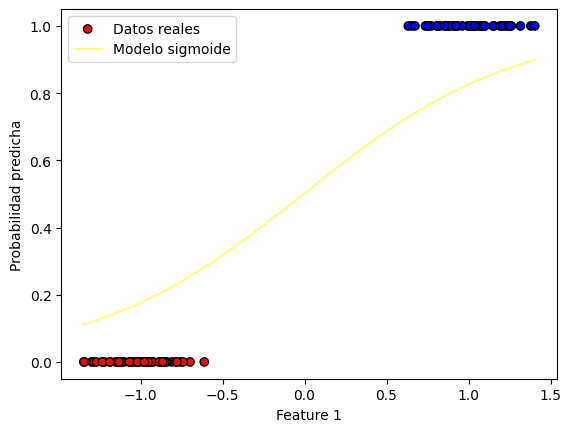

Iteracion: 531
Costo en la iteración 531: 0.19599747597370396
Valor del gradiente 531: [-0.00189053 -0.17140744]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00864216 1.54978027]


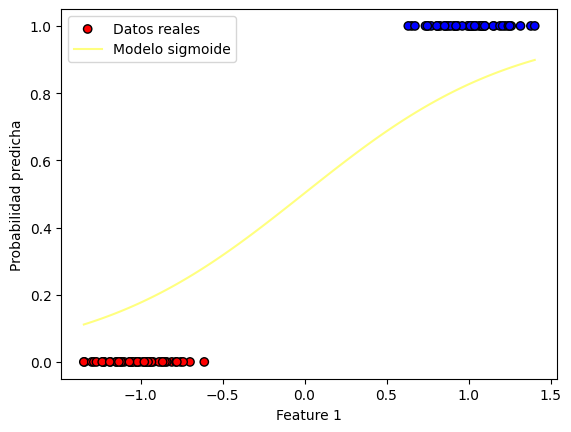

Iteracion: 532
Costo en la iteración 532: 0.19570384373100813
Valor del gradiente 532: [-0.00188962 -0.17116409]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00866106 1.55149191]


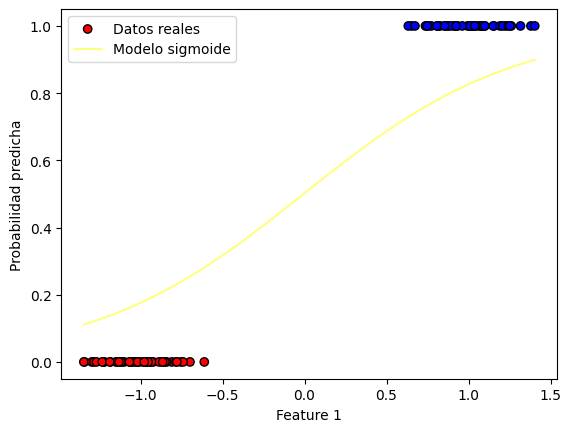

Iteracion: 533
Costo en la iteración 533: 0.19541104432612433
Valor del gradiente 533: [-0.00188871 -0.17092138]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00867994 1.55320113]


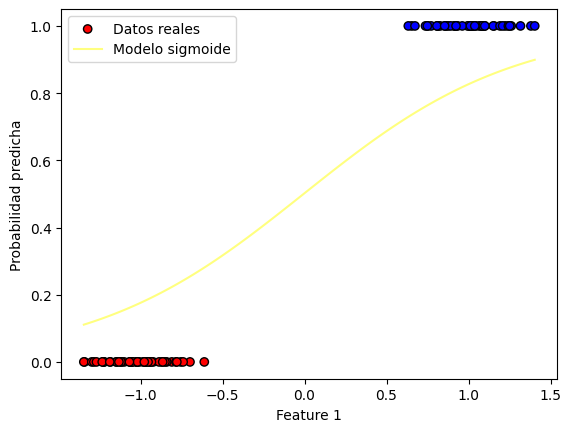

Iteracion: 534
Costo en la iteración 534: 0.19511907440379514
Valor del gradiente 534: [-0.00188781 -0.1706793 ]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00869882 1.55490792]


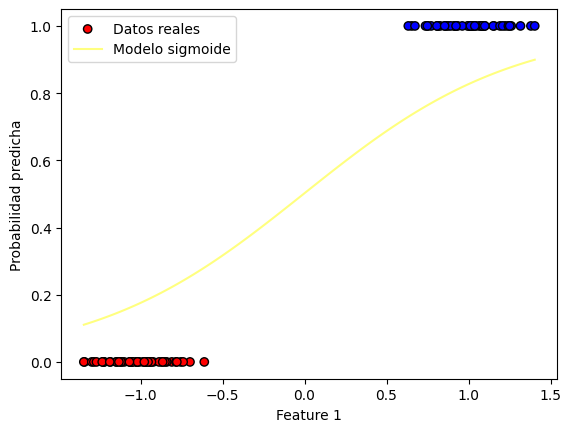

Iteracion: 535
Costo en la iteración 535: 0.19482793062587195
Valor del gradiente 535: [-0.00188689 -0.17043785]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00871769 1.5566123 ]


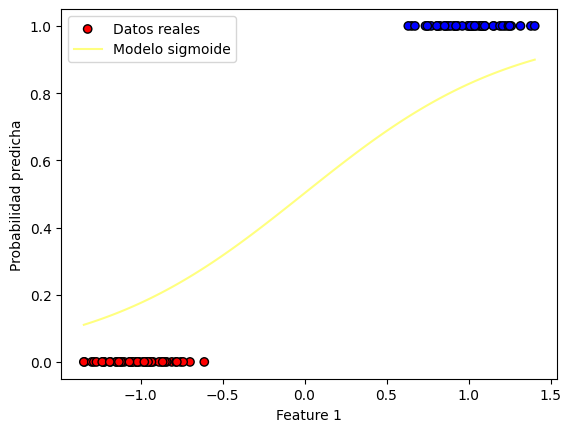

Iteracion: 536
Costo en la iteración 536: 0.19453760967121272
Valor del gradiente 536: [-0.00188598 -0.17019704]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00873655 1.55831427]


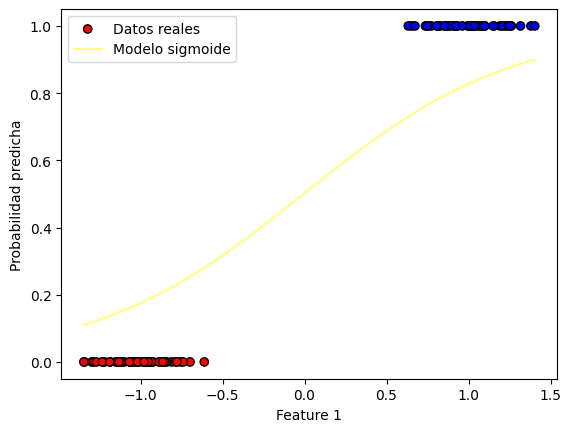

Iteracion: 537
Costo en la iteración 537: 0.1942481082355784
Valor del gradiente 537: [-0.00188507 -0.16995685]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.0087554  1.56001384]


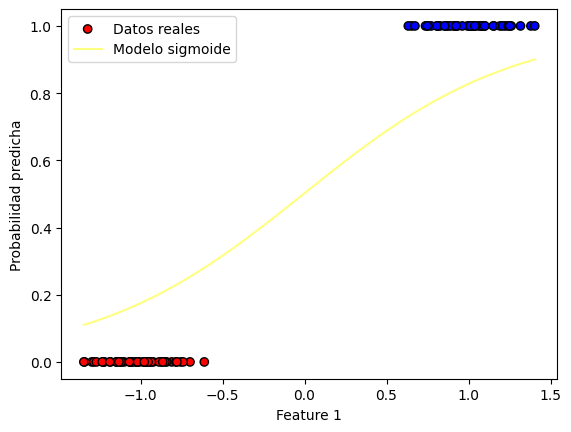

Iteracion: 538
Costo en la iteración 538: 0.193959423031531
Valor del gradiente 538: [-0.00188415 -0.16971728]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00877424 1.56171101]


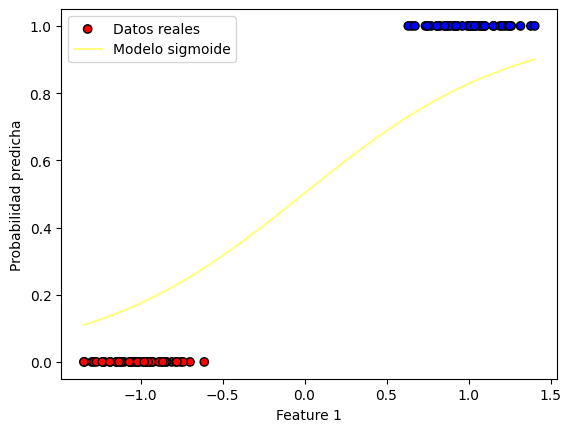

Iteracion: 539
Costo en la iteración 539: 0.1936715507883329
Valor del gradiente 539: [-0.00188323 -0.16947834]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00879308 1.5634058 ]


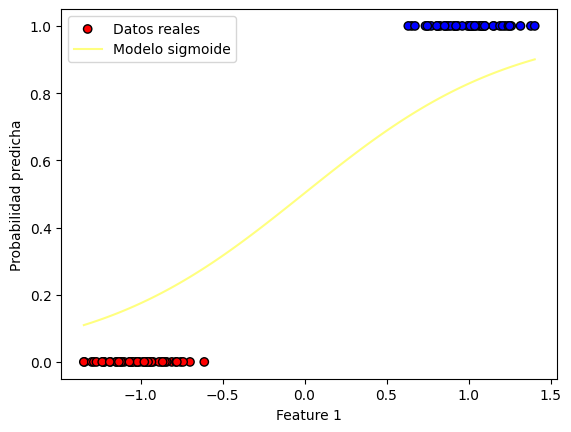

Iteracion: 540
Costo en la iteración 540: 0.19338448825184512
Valor del gradiente 540: [-0.00188231 -0.16924002]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.0088119 1.5650982]


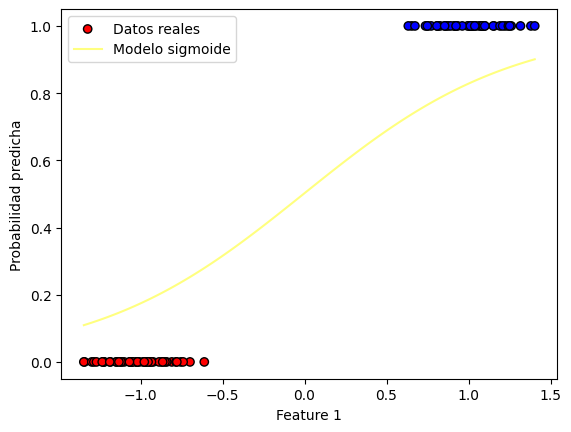

Iteracion: 541
Costo en la iteración 541: 0.19309823218442823
Valor del gradiente 541: [-0.00188139 -0.16900231]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00883071 1.56678822]


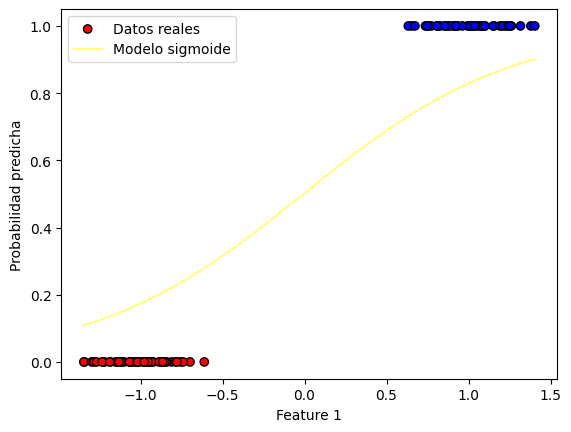

Iteracion: 542
Costo en la iteración 542: 0.192812779364843
Valor del gradiente 542: [-0.00188047 -0.16876522]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00884952 1.56847587]


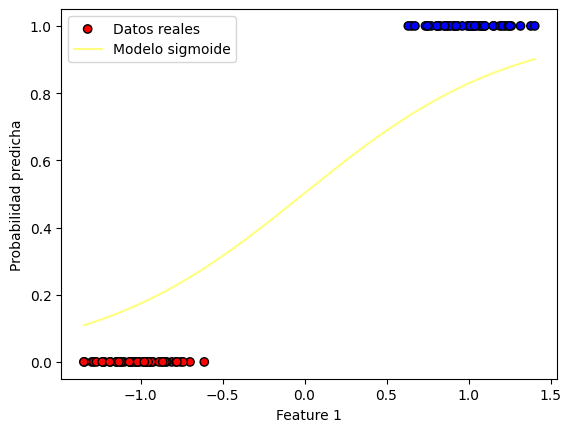

Iteracion: 543
Costo en la iteración 543: 0.19252812658815124
Valor del gradiente 543: [-0.00187954 -0.16852875]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00886831 1.57016116]


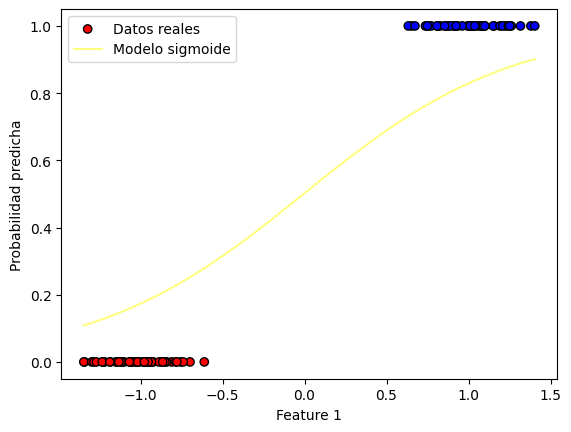

Iteracion: 544
Costo en la iteración 544: 0.19224427066561844
Valor del gradiente 544: [-0.00187861 -0.16829289]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.0088871  1.57184409]


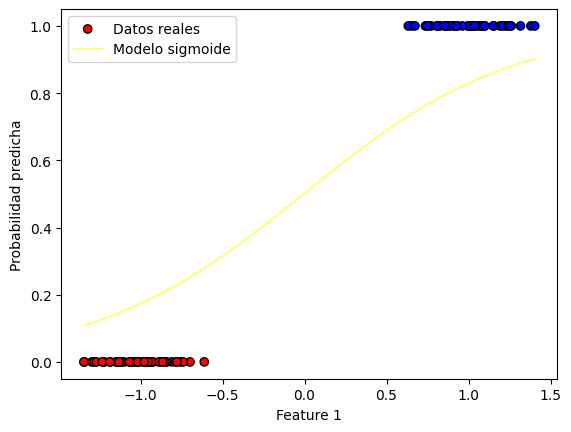

Iteracion: 545
Costo en la iteración 545: 0.19196120842461636
Valor del gradiente 545: [-0.00187768 -0.16805763]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00890588 1.57352466]


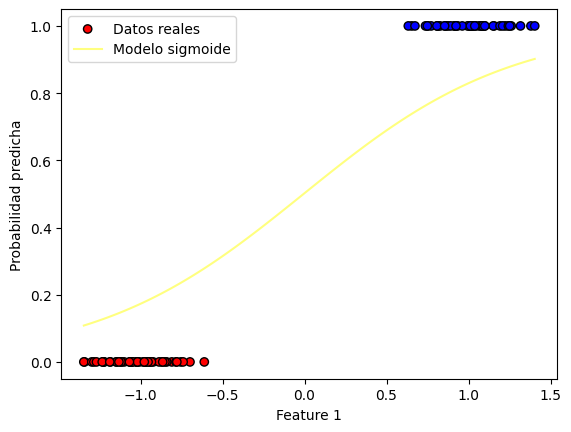

Iteracion: 546
Costo en la iteración 546: 0.1916789367085264
Valor del gradiente 546: [-0.00187675 -0.16782299]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00892464 1.57520289]


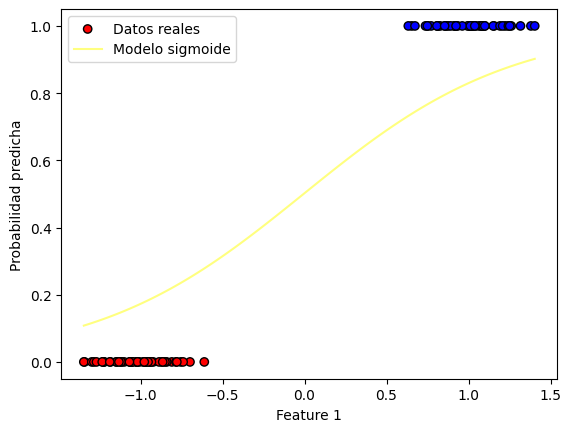

Iteracion: 547
Costo en la iteración 547: 0.19139745237664352
Valor del gradiente 547: [-0.00187582 -0.16758894]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.0089434  1.57687878]


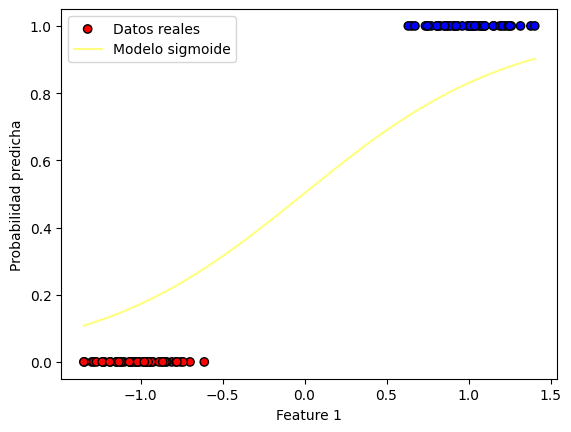

Iteracion: 548
Costo en la iteración 548: 0.19111675230408132
Valor del gradiente 548: [-0.00187489 -0.16735551]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00896215 1.57855234]


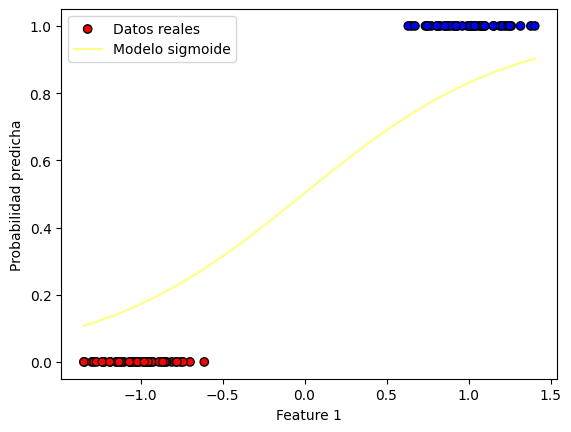

Iteracion: 549
Costo en la iteración 549: 0.19083683338167706
Valor del gradiente 549: [-0.00187395 -0.16712267]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00898089 1.58022356]


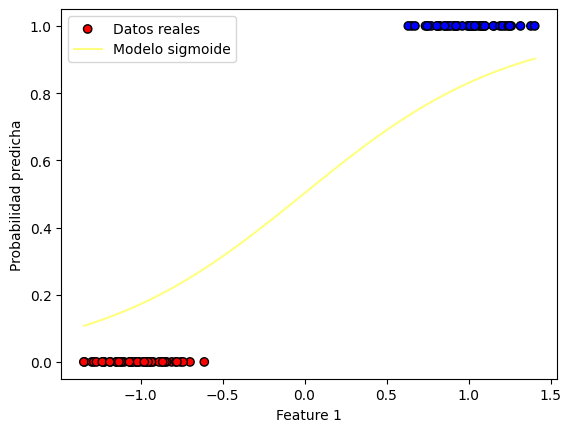

Iteracion: 550
Costo en la iteración 550: 0.19055769251589777
Valor del gradiente 550: [-0.00187301 -0.16689043]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00899962 1.58189247]


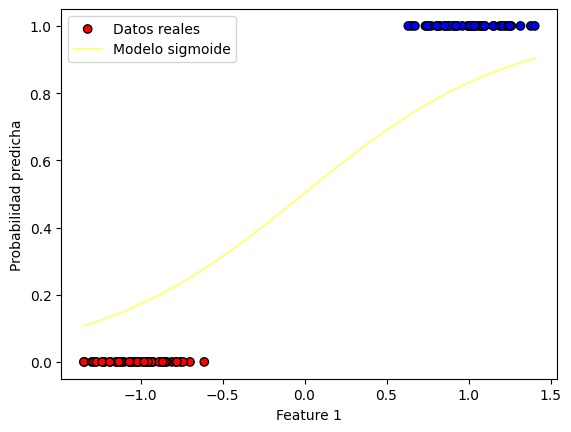

Iteracion: 551
Costo en la iteración 551: 0.19027932662874722
Valor del gradiente 551: [-0.00187207 -0.16665878]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00901834 1.58355906]


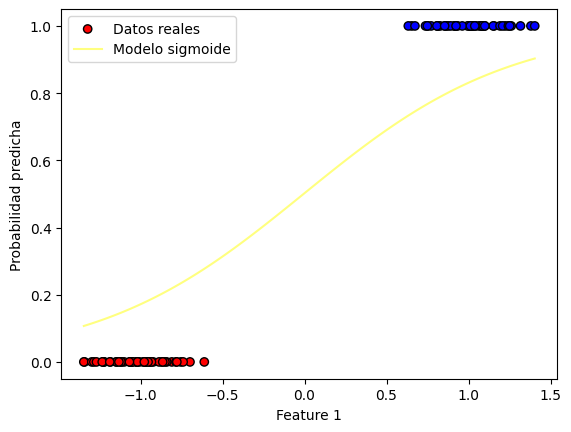

Iteracion: 552
Costo en la iteración 552: 0.1900017326576724
Valor del gradiente 552: [-0.00187113 -0.16642773]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00903705 1.58522333]


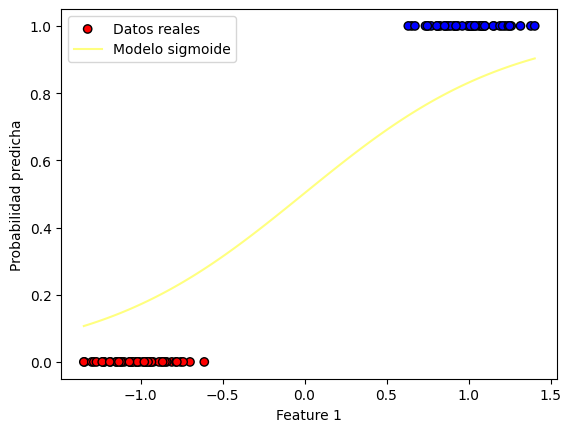

Iteracion: 553
Costo en la iteración 553: 0.18972490755547233
Valor del gradiente 553: [-0.00187019 -0.16619728]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00905575 1.58688531]


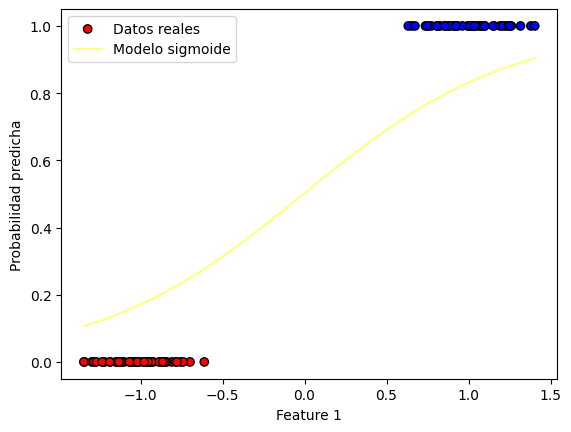

Iteracion: 554
Costo en la iteración 554: 0.18944884829020614
Valor del gradiente 554: [-0.00186925 -0.16596741]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00907445 1.58854498]


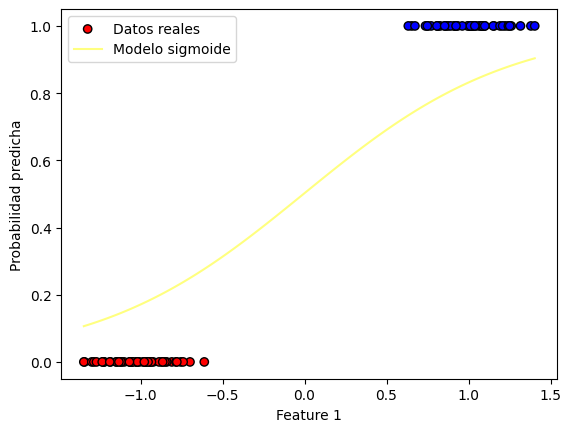

Iteracion: 555
Costo en la iteración 555: 0.18917355184510215
Valor del gradiente 555: [-0.0018683  -0.16573813]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00909313 1.59020236]


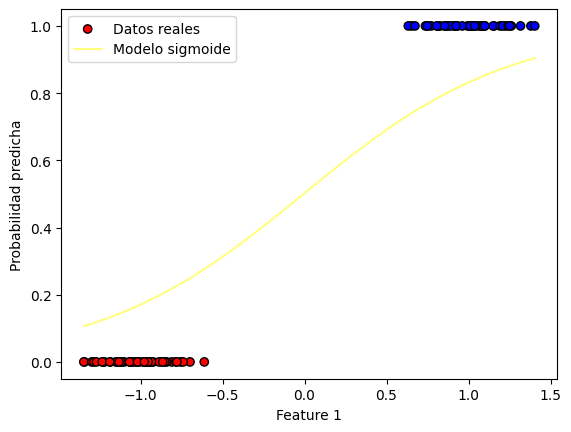

Iteracion: 556
Costo en la iteración 556: 0.1888990152184678
Valor del gradiente 556: [-0.00186735 -0.16550944]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.0091118  1.59185746]


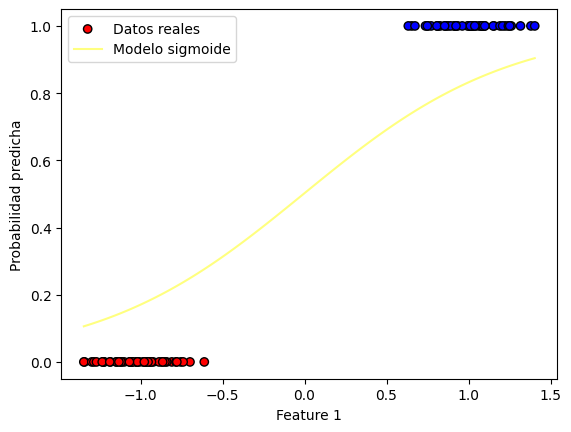

Iteracion: 557
Costo en la iteración 557: 0.18862523542360016
Valor del gradiente 557: [-0.0018664  -0.16528133]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00913047 1.59351027]


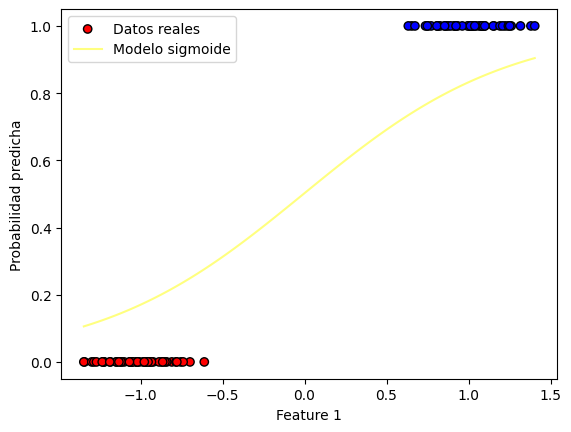

Iteracion: 558
Costo en la iteración 558: 0.18835220948869658
Valor del gradiente 558: [-0.00186545 -0.1650538 ]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00914912 1.59516081]


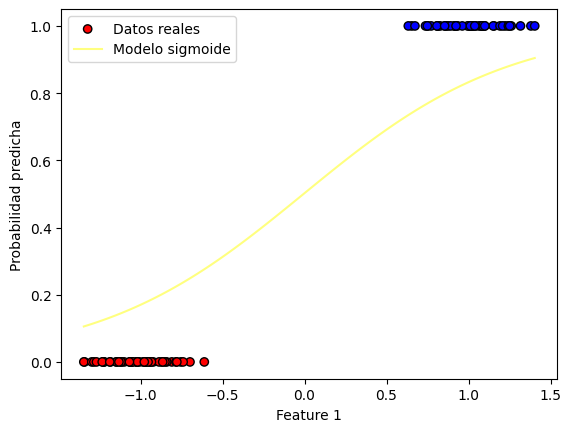

Iteracion: 559
Costo en la iteración 559: 0.1880799344567665
Valor del gradiente 559: [-0.0018645  -0.16482685]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00916777 1.59680908]


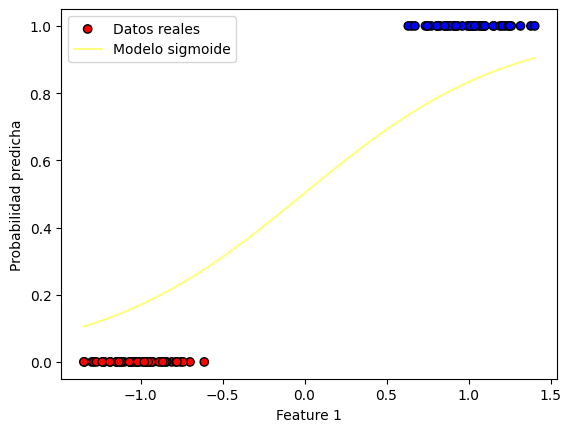

Iteracion: 560
Costo en la iteración 560: 0.18780840738554344
Valor del gradiente 560: [-0.00186355 -0.16460048]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.0091864  1.59845508]


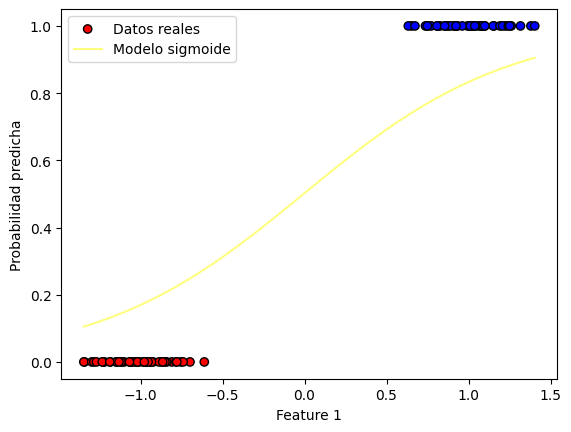

Iteracion: 561
Costo en la iteración 561: 0.18753762534739815
Valor del gradiente 561: [-0.00186259 -0.16437469]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00920503 1.60009883]


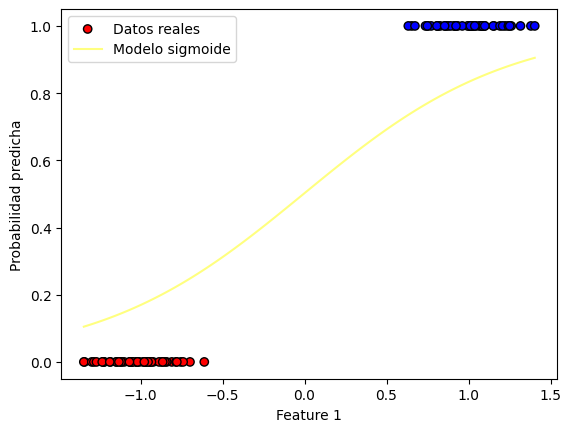

Iteracion: 562
Costo en la iteración 562: 0.1872675854292515
Valor del gradiente 562: [-0.00186164 -0.16414946]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00922364 1.60174032]


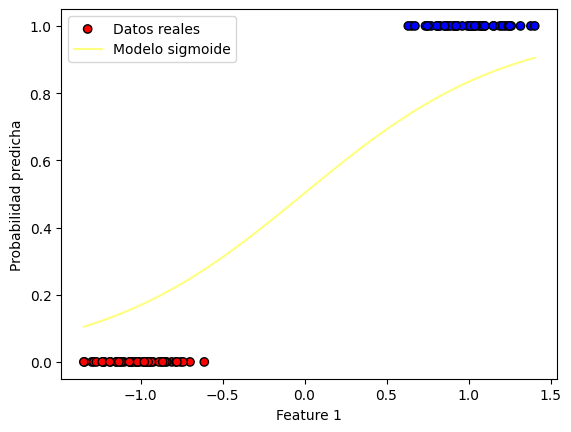

Iteracion: 563
Costo en la iteración 563: 0.18699828473248875
Valor del gradiente 563: [-0.00186068 -0.16392481]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00924225 1.60337957]


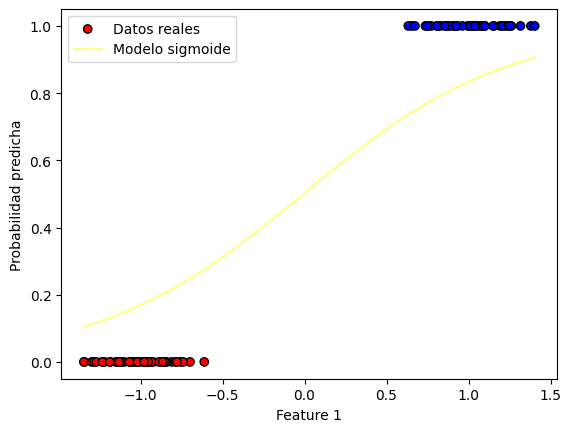

Iteracion: 564
Costo en la iteración 564: 0.18672972037287397
Valor del gradiente 564: [-0.00185972 -0.16370073]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00926085 1.60501658]


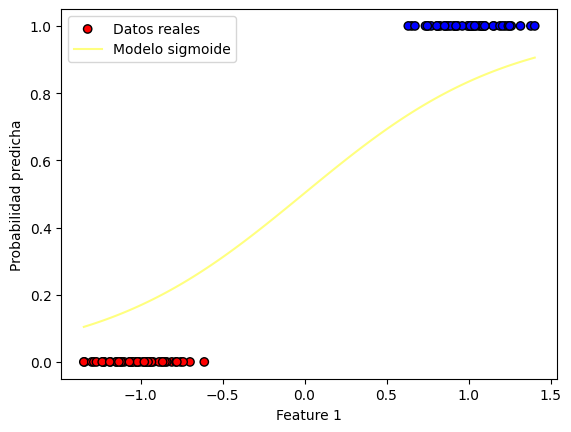

Iteracion: 565
Costo en la iteración 565: 0.1864618894804651
Valor del gradiente 565: [-0.00185876 -0.16347722]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00927944 1.60665135]


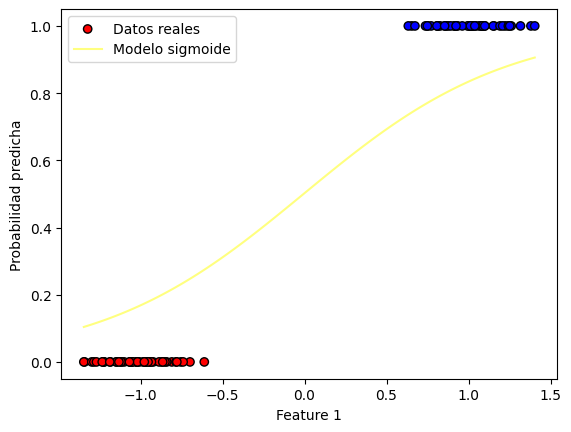

Iteracion: 566
Costo en la iteración 566: 0.18619478919952975
Valor del gradiente 566: [-0.0018578  -0.16325427]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00929801 1.60828389]


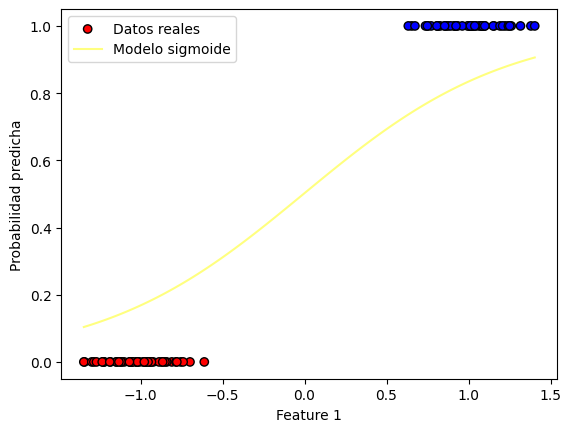

Iteracion: 567
Costo en la iteración 567: 0.18592841668846127
Valor del gradiente 567: [-0.00185684 -0.16303189]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00931658 1.60991421]


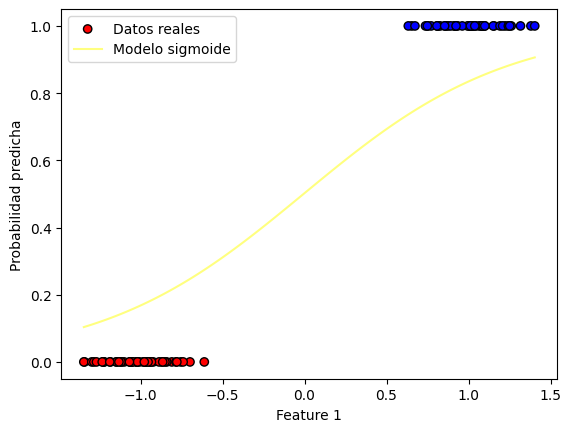

Iteracion: 568
Costo en la iteración 568: 0.18566276911969556
Valor del gradiente 568: [-0.00185587 -0.16281006]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00933514 1.61154231]


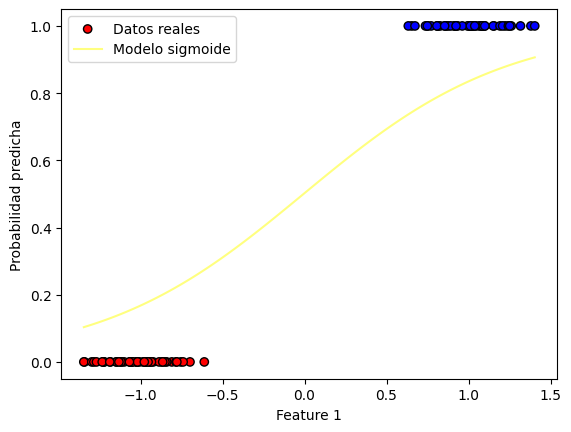

Iteracion: 569
Costo en la iteración 569: 0.1853978436796286
Valor del gradiente 569: [-0.00185491 -0.1625888 ]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00935369 1.6131682 ]


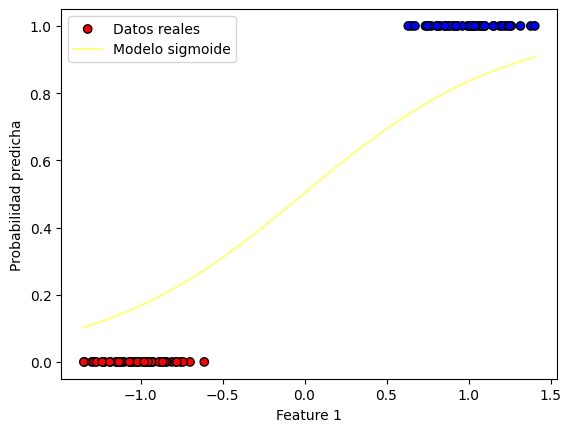

Iteracion: 570
Costo en la iteración 570: 0.18513363756853415
Valor del gradiente 570: [-0.00185394 -0.16236809]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00937223 1.61479188]


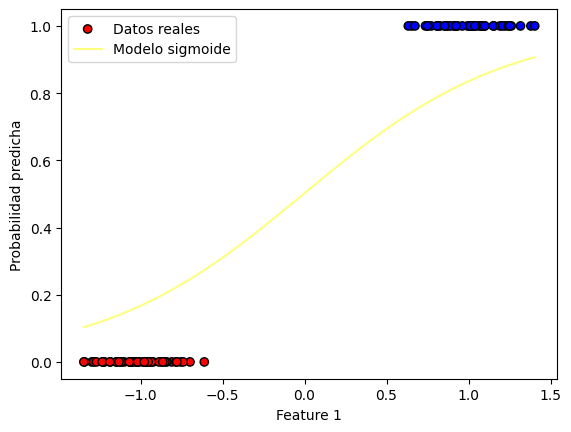

Iteracion: 571
Costo en la iteración 571: 0.18487014800048251
Valor del gradiente 571: [-0.00185297 -0.16214794]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00939076 1.61641336]


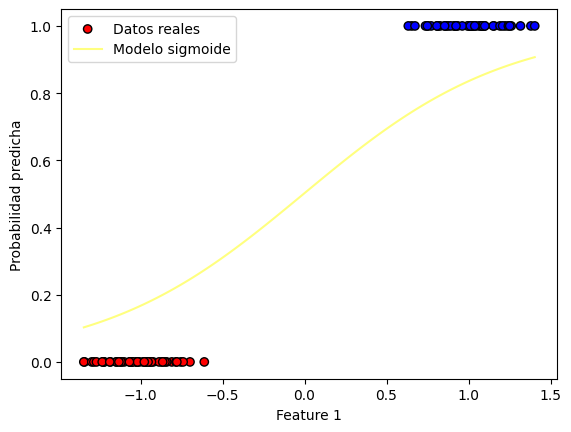

Iteracion: 572
Costo en la iteración 572: 0.1846073722032591
Valor del gradiente 572: [-0.001852   -0.16192834]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00940928 1.61803264]


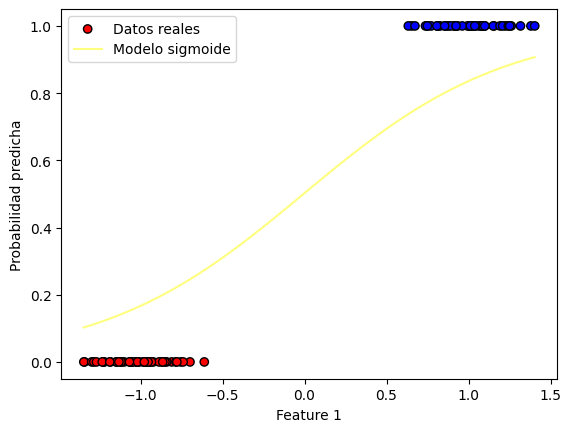

Iteracion: 573
Costo en la iteración 573: 0.18434530741828442
Valor del gradiente 573: [-0.00185103 -0.1617093 ]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00942779 1.61964974]


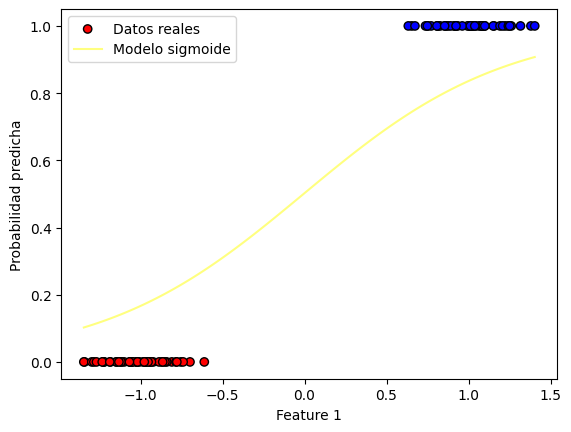

Iteracion: 574
Costo en la iteración 574: 0.18408395090053378
Valor del gradiente 574: [-0.00185006 -0.1614908 ]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00944629 1.62126464]


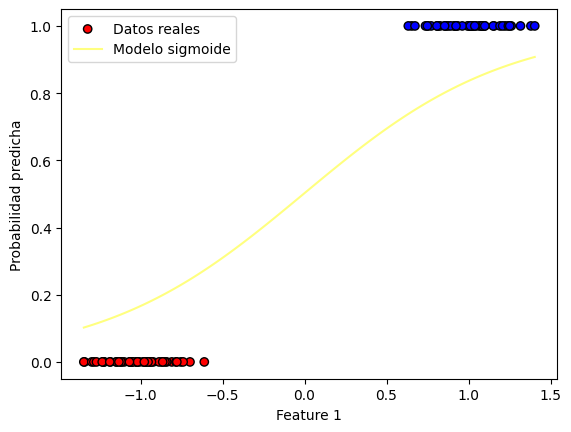

Iteracion: 575
Costo en la iteración 575: 0.18382329991845814
Valor del gradiente 575: [-0.00184909 -0.16127285]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00946478 1.62287737]


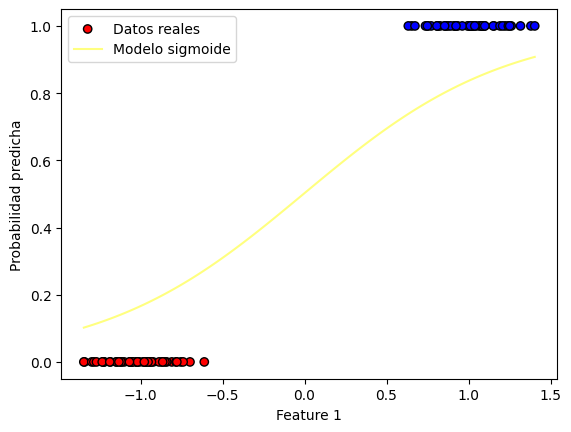

Iteracion: 576
Costo en la iteración 576: 0.18356335175390534
Valor del gradiente 576: [-0.00184811 -0.16105545]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00948326 1.62448793]


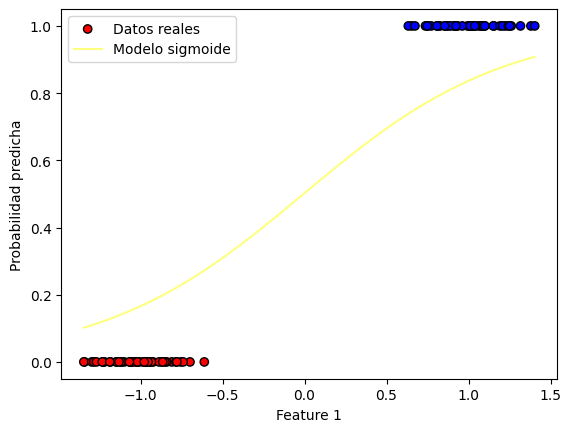

Iteracion: 577
Costo en la iteración 577: 0.18330410370204153
Valor del gradiente 577: [-0.00184714 -0.16083859]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00950173 1.62609631]


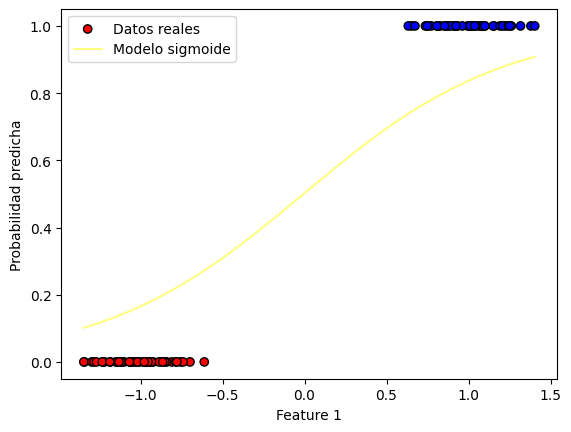

Iteracion: 578
Costo en la iteración 578: 0.18304555307127351
Valor del gradiente 578: [-0.00184616 -0.16062227]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00952019 1.62770254]


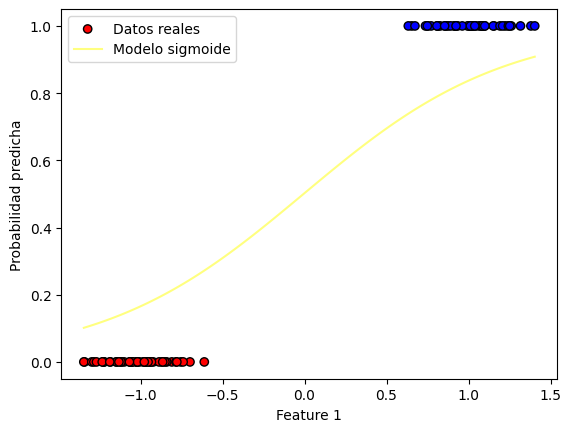

Iteracion: 579
Costo en la iteración 579: 0.18278769718317148
Valor del gradiente 579: [-0.00184518 -0.16040649]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00953865 1.6293066 ]


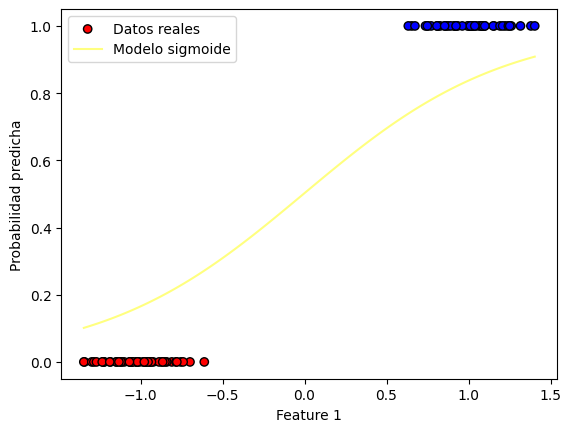

Iteracion: 580
Costo en la iteración 580: 0.1825305333723921
Valor del gradiente 580: [-0.0018442  -0.16019126]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00955709 1.63090851]


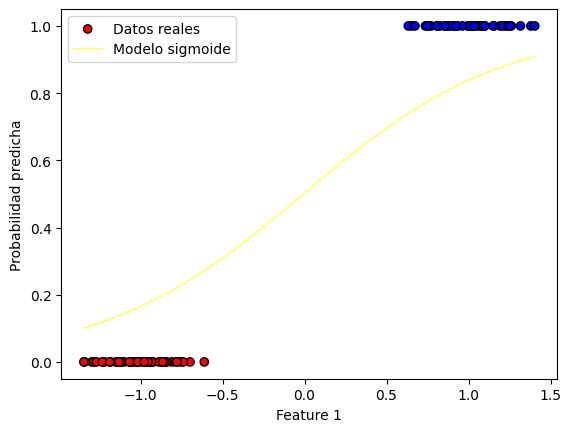

Iteracion: 581
Costo en la iteración 581: 0.18227405898660254
Valor del gradiente 581: [-0.00184322 -0.15997655]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00957552 1.63250828]


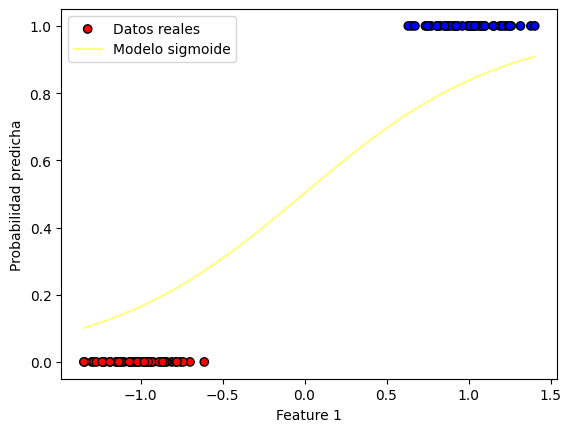

Iteracion: 582
Costo en la iteración 582: 0.18201827138640447
Valor del gradiente 582: [-0.00184224 -0.15976239]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00959394 1.6341059 ]


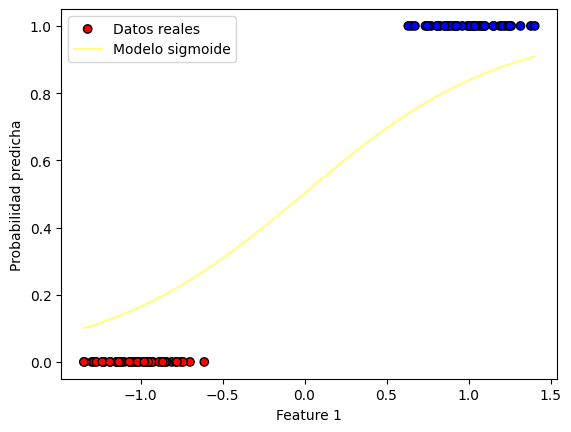

Iteracion: 583
Costo en la iteración 583: 0.18176316794525868
Valor del gradiente 583: [-0.00184126 -0.15954875]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00961236 1.63570139]


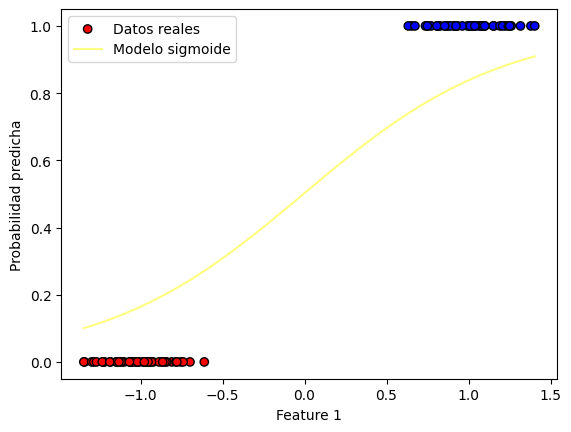

Iteracion: 584
Costo en la iteración 584: 0.18150874604941092
Valor del gradiente 584: [-0.00184028 -0.15933565]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00963076 1.63729475]


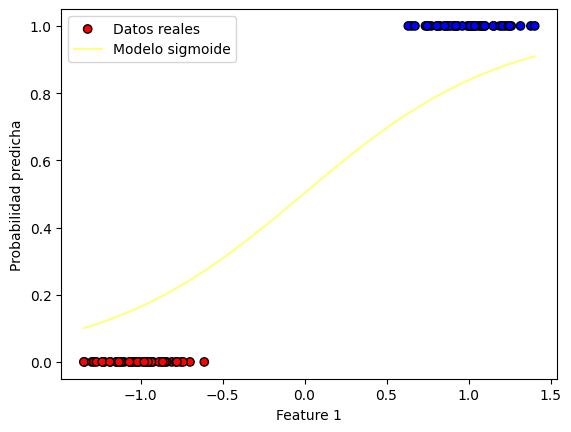

Iteracion: 585
Costo en la iteración 585: 0.18125500309781697
Valor del gradiente 585: [-0.00183929 -0.15912307]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00964915 1.63888598]


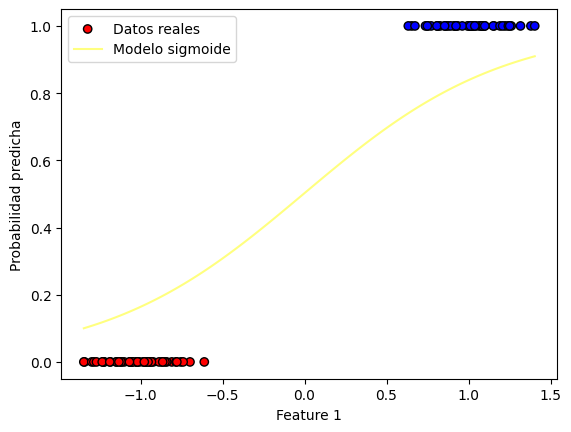

Iteracion: 586
Costo en la iteración 586: 0.18100193650206922
Valor del gradiente 586: [-0.00183831 -0.15891102]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00966753 1.64047509]


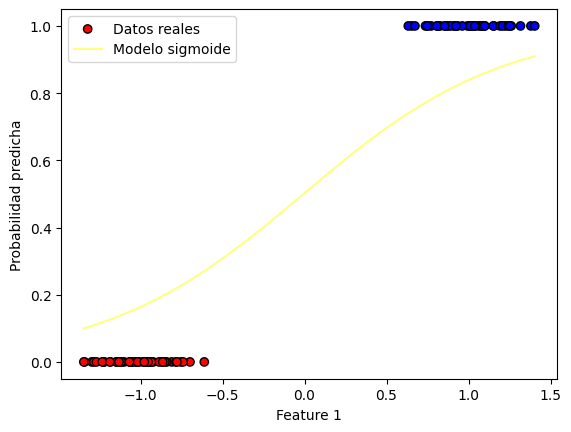

Iteracion: 587
Costo en la iteración 587: 0.18074954368632362
Valor del gradiente 587: [-0.00183732 -0.1586995 ]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00968591 1.64206208]


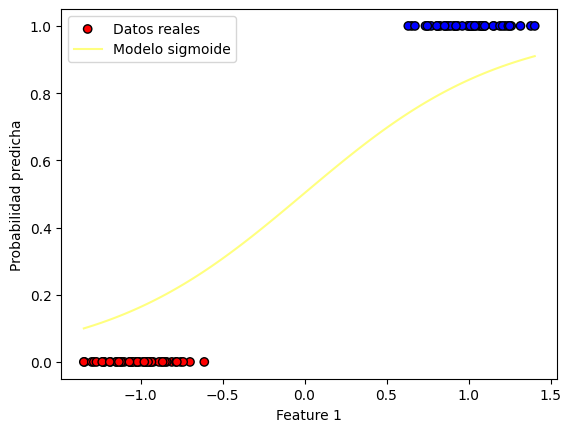

Iteracion: 588
Costo en la iteración 588: 0.18049782208722637
Valor del gradiente 588: [-0.00183634 -0.1584885 ]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00970427 1.64364697]


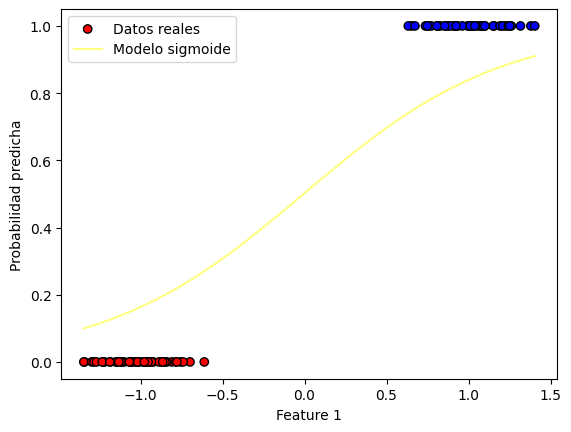

Iteracion: 589
Costo en la iteración 589: 0.180246769153842
Valor del gradiente 589: [-0.00183535 -0.15827802]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00972263 1.64522975]


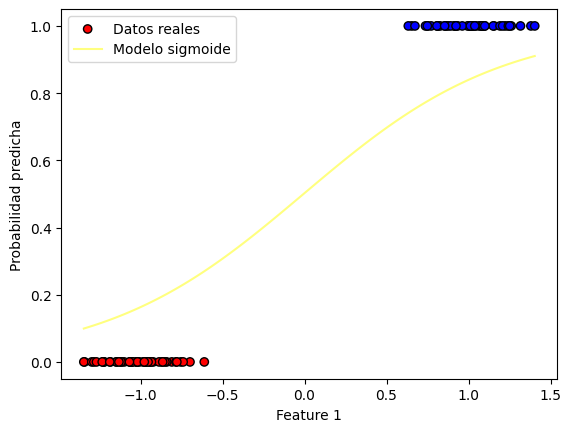

Iteracion: 590
Costo en la iteración 590: 0.17999638234758134
Valor del gradiente 590: [-0.00183436 -0.15806806]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00974097 1.64681043]


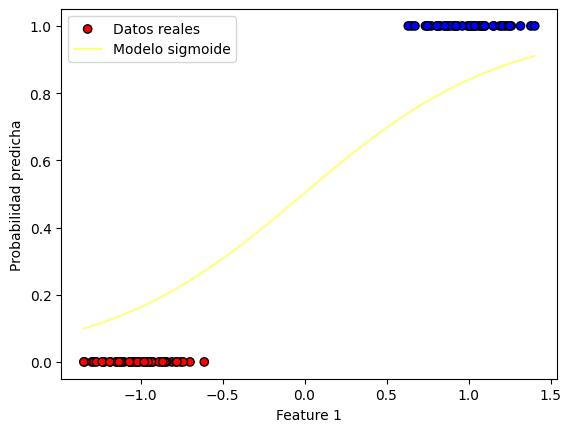

Iteracion: 591
Costo en la iteración 591: 0.17974665914213045
Valor del gradiente 591: [-0.00183337 -0.15785862]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.0097593  1.64838902]


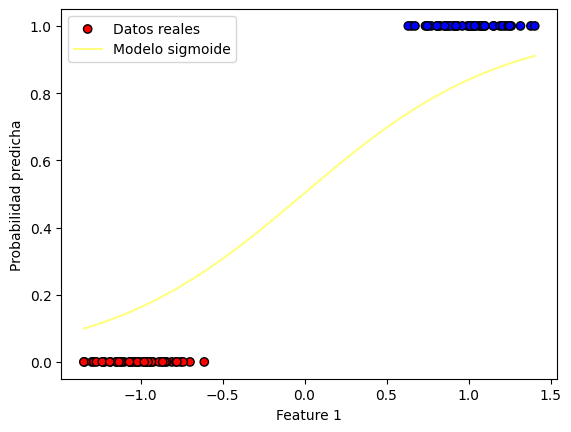

Iteracion: 592
Costo en la iteración 592: 0.1794975970233794
Valor del gradiente 592: [-0.00183238 -0.1576497 ]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00977763 1.64996551]


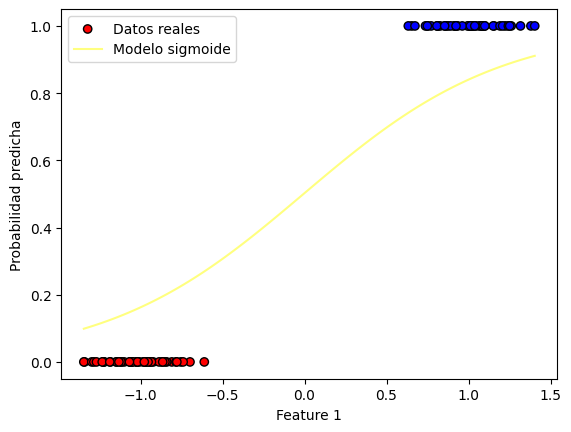

Iteracion: 593
Costo en la iteración 593: 0.1792491934893522
Valor del gradiente 593: [-0.00183139 -0.15744129]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00979594 1.65153993]


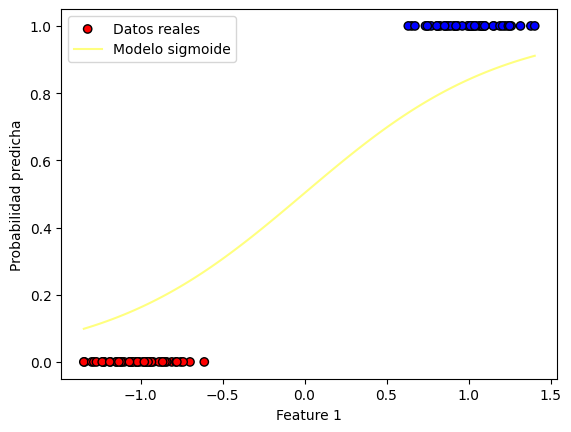

Iteracion: 594
Costo en la iteración 594: 0.17900144605013638
Valor del gradiente 594: [-0.00183039 -0.15723339]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00981424 1.65311226]


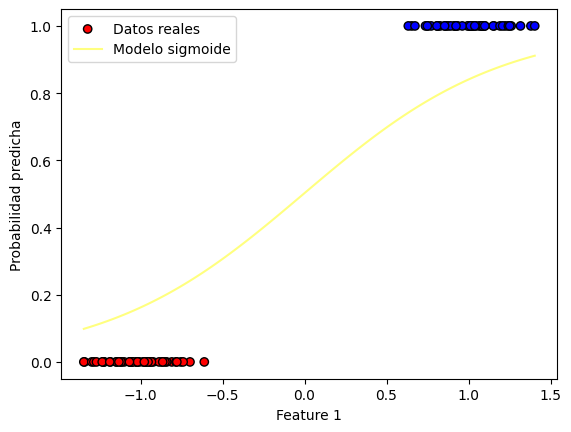

Iteracion: 595
Costo en la iteración 595: 0.17875435222781413
Valor del gradiente 595: [-0.0018294  -0.15702601]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00983254 1.65468252]


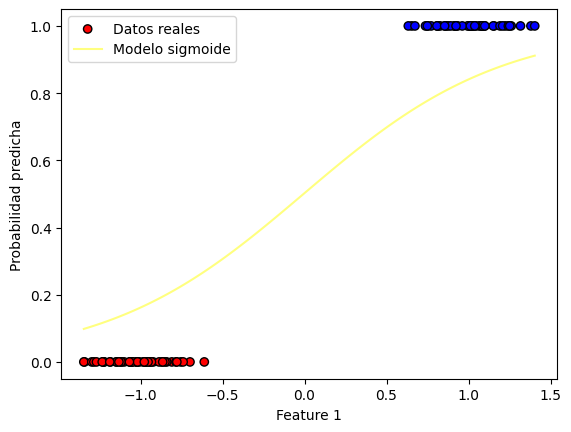

Iteracion: 596
Costo en la iteración 596: 0.17850790955639273
Valor del gradiente 596: [-0.0018284  -0.15681913]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00985082 1.65625071]


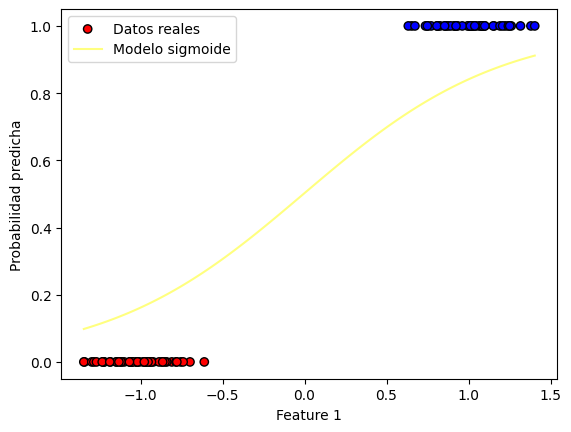

Iteracion: 597
Costo en la iteración 597: 0.1782621155817362
Valor del gradiente 597: [-0.00182741 -0.15661276]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.0098691  1.65781684]


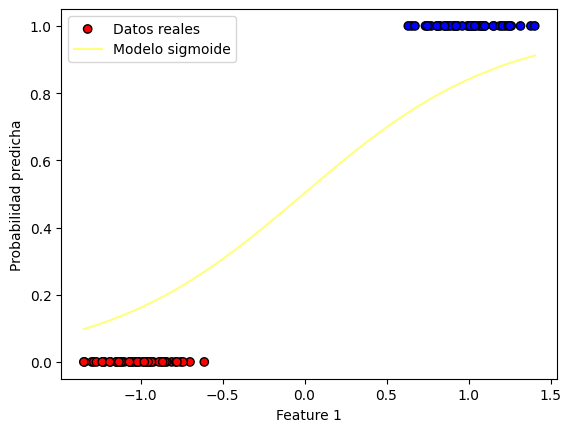

Iteracion: 598
Costo en la iteración 598: 0.17801696786149745
Valor del gradiente 598: [-0.00182641 -0.1564069 ]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00988736 1.65938091]


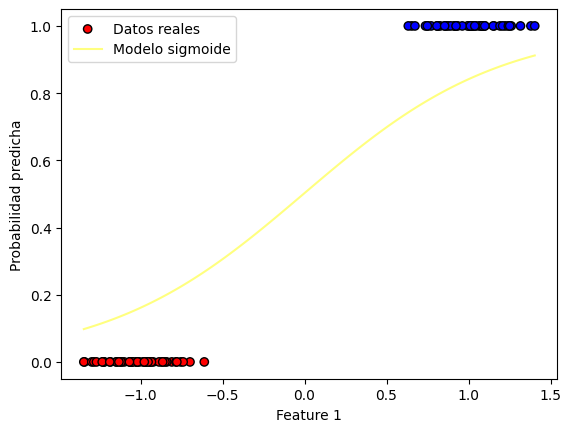

Iteracion: 599
Costo en la iteración 599: 0.17777246396504987
Valor del gradiente 599: [-0.00182542 -0.15620154]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00990561 1.66094292]


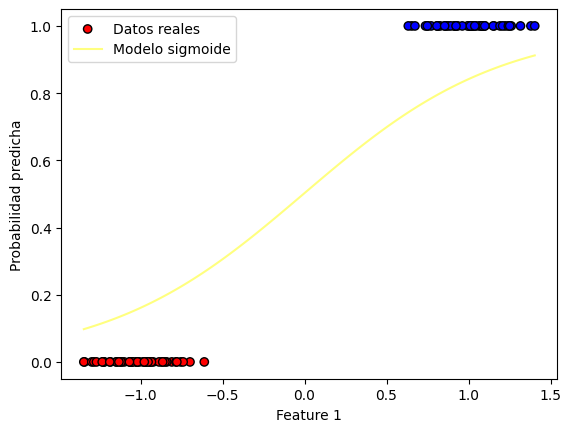

Iteracion: 600
Costo en la iteración 600: 0.17752860147342095
Valor del gradiente 600: [-0.00182442 -0.15599668]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00992386 1.66250289]


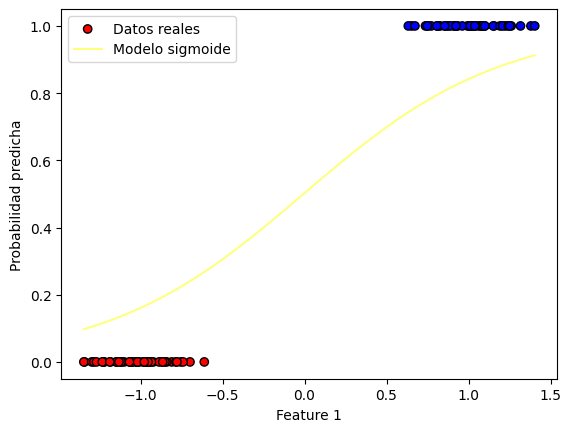

Iteracion: 601
Costo en la iteración 601: 0.17728537797922495
Valor del gradiente 601: [-0.00182342 -0.15579232]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00994209 1.66406081]


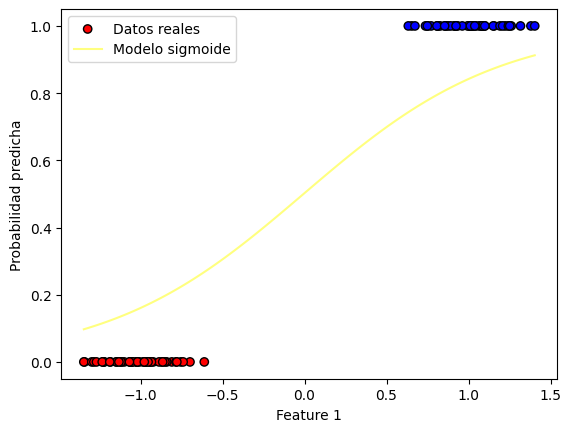

Iteracion: 602
Costo en la iteración 602: 0.17704279108659676
Valor del gradiente 602: [-0.00182242 -0.15558847]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00996032 1.6656167 ]


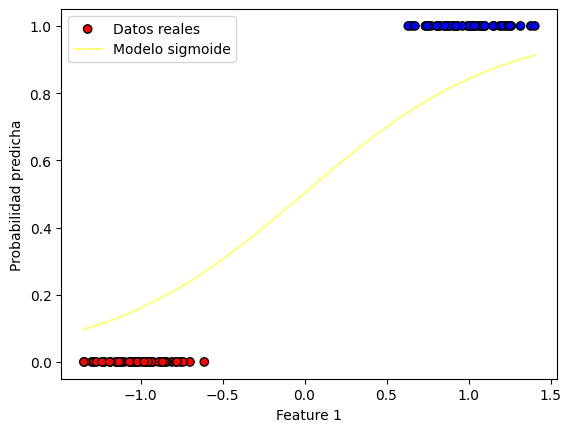

Iteracion: 603
Costo en la iteración 603: 0.17680083841112584
Valor del gradiente 603: [-0.00182142 -0.1553851 ]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00997853 1.66717055]


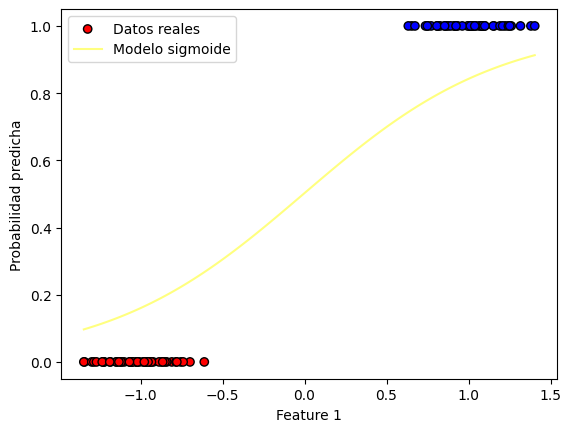

Iteracion: 604
Costo en la iteración 604: 0.17655951757979094
Valor del gradiente 604: [-0.00182042 -0.15518224]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.00999674 1.66872237]


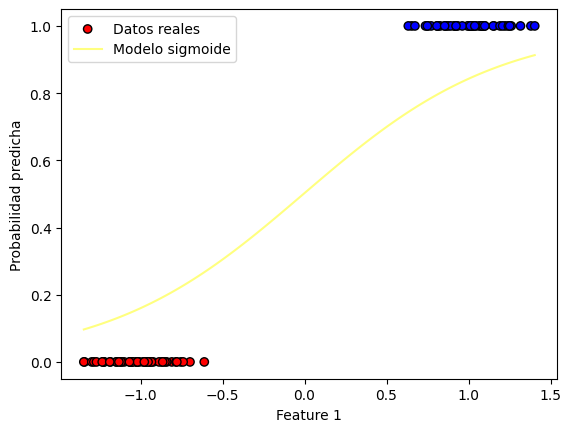

Iteracion: 605
Costo en la iteración 605: 0.17631882623089476
Valor del gradiente 605: [-0.00181942 -0.15497987]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01001493 1.67027217]


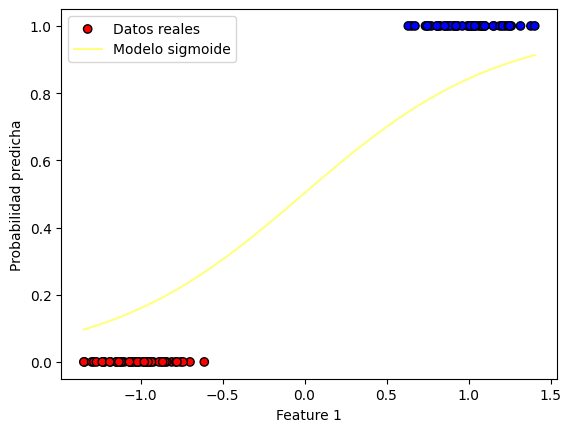

Iteracion: 606
Costo en la iteración 606: 0.1760787620139997
Valor del gradiente 606: [-0.00181841 -0.15477799]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01003311 1.67181995]


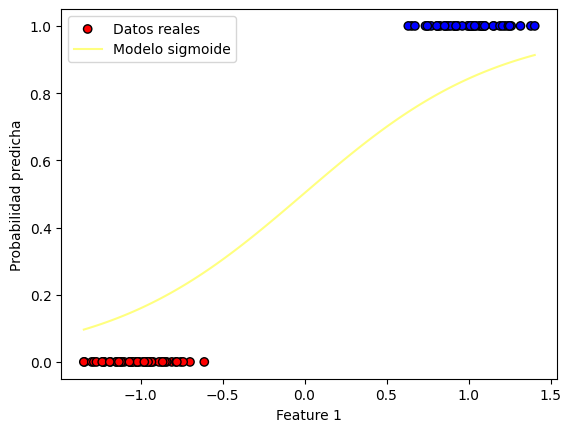

Iteracion: 607
Costo en la iteración 607: 0.17583932258986334
Valor del gradiente 607: [-0.00181741 -0.1545766 ]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01005129 1.67336572]


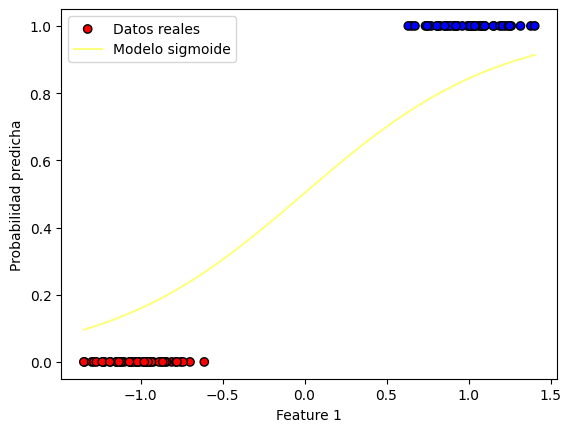

Iteracion: 608
Costo en la iteración 608: 0.17560050563037483
Valor del gradiente 608: [-0.00181641 -0.1543757 ]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01006945 1.67490947]


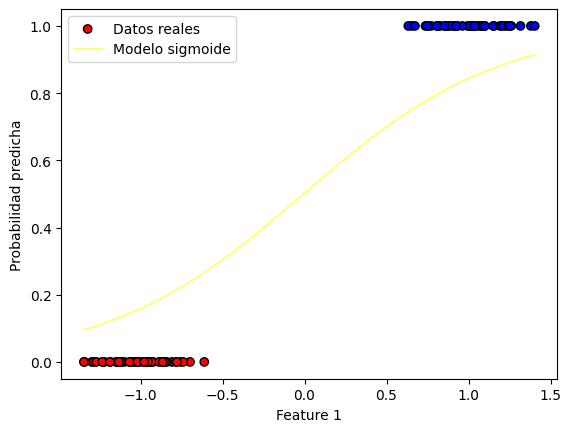

Iteracion: 609
Costo en la iteración 609: 0.17536230881849135
Valor del gradiente 609: [-0.0018154  -0.15417528]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01008761 1.67645122]


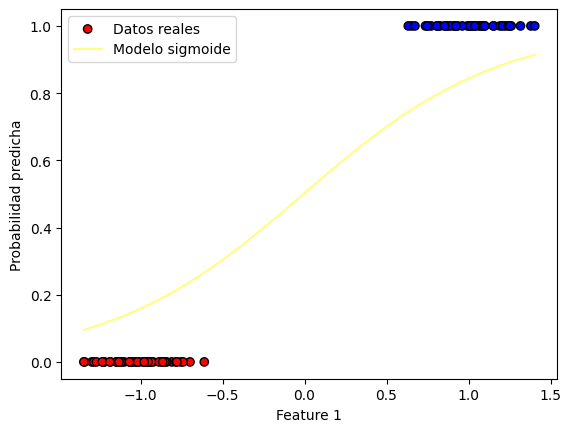

Iteracion: 610
Costo en la iteración 610: 0.17512472984817531
Valor del gradiente 610: [-0.0018144  -0.15397535]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01010575 1.67799098]


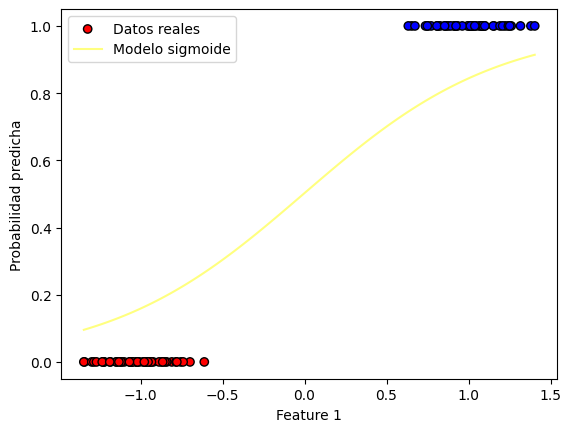

Iteracion: 611
Costo en la iteración 611: 0.17488776642433196
Valor del gradiente 611: [-0.00181339 -0.15377591]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01012388 1.67952874]


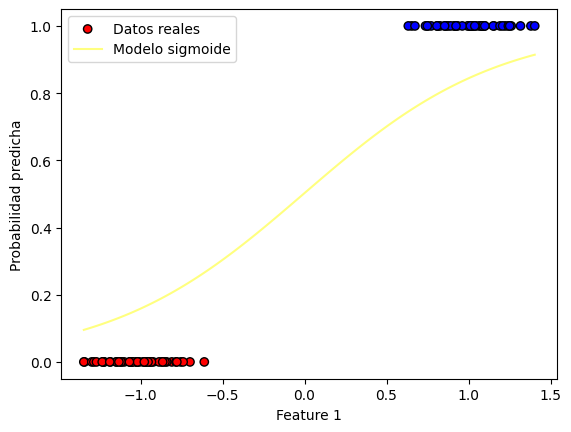

Iteracion: 612
Costo en la iteración 612: 0.17465141626274655
Valor del gradiente 612: [-0.00181238 -0.15357694]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01014201 1.68106451]


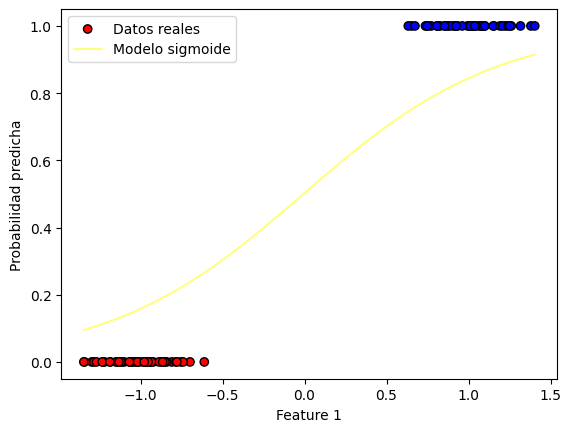

Iteracion: 613
Costo en la iteración 613: 0.17441567709002356
Valor del gradiente 613: [-0.00181138 -0.15337846]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01016012 1.68259829]


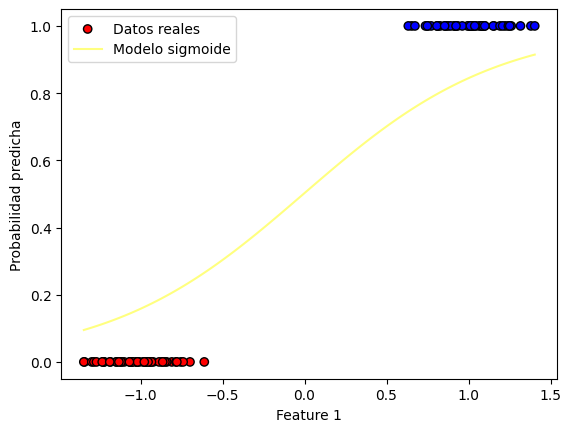

Iteracion: 614
Costo en la iteración 614: 0.17418054664352473
Valor del gradiente 614: [-0.00181037 -0.15318046]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01017822 1.6841301 ]


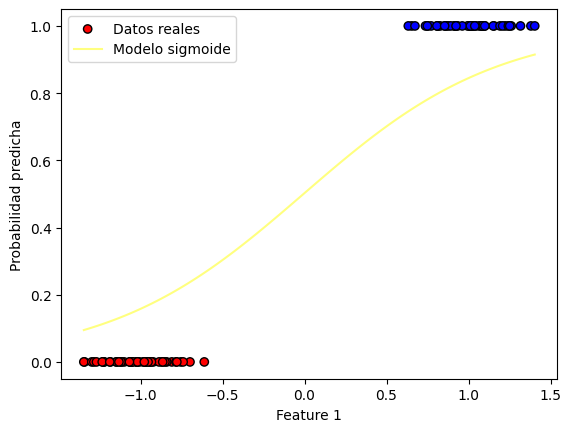

Iteracion: 615
Costo en la iteración 615: 0.17394602267130815
Valor del gradiente 615: [-0.00180936 -0.15298293]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01019632 1.68565993]


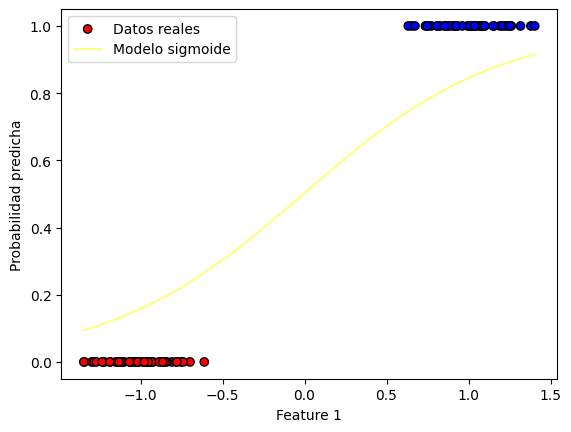

Iteracion: 616
Costo en la iteración 616: 0.17371210293206812
Valor del gradiente 616: [-0.00180835 -0.15278588]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.0102144  1.68718778]


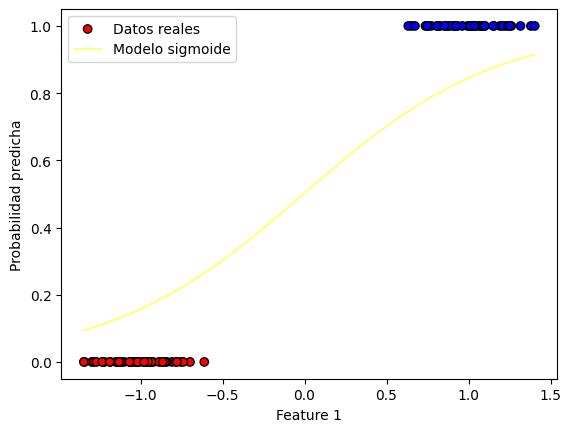

Iteracion: 617
Costo en la iteración 617: 0.1734787851950744
Valor del gradiente 617: [-0.00180734 -0.1525893 ]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01023248 1.68871368]


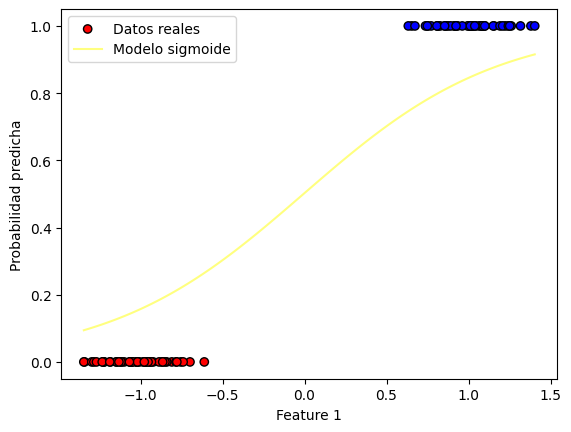

Iteracion: 618
Costo en la iteración 618: 0.17324606724011324
Valor del gradiente 618: [-0.00180633 -0.15239319]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01025054 1.69023761]


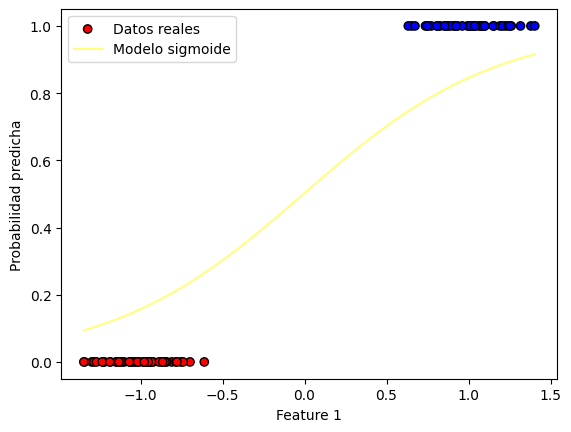

Iteracion: 619
Costo en la iteración 619: 0.17301394685742735
Valor del gradiente 619: [-0.00180532 -0.15219756]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01026859 1.69175958]


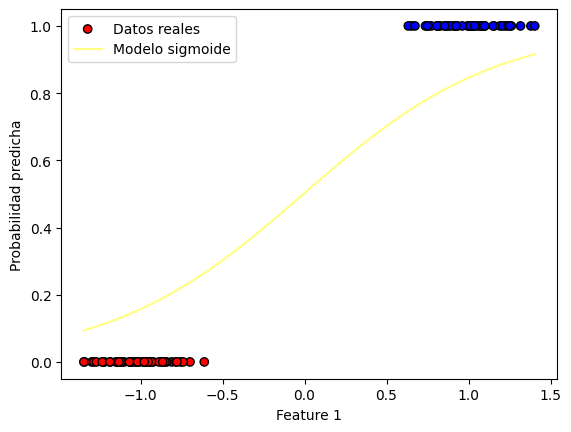

Iteracion: 620
Costo en la iteración 620: 0.17278242184765702
Valor del gradiente 620: [-0.00180431 -0.15200239]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01028663 1.69327961]


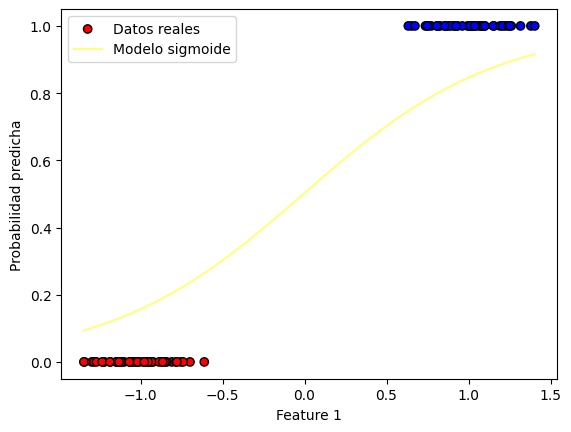

Iteracion: 621
Costo en la iteración 621: 0.17255149002178172
Valor del gradiente 621: [-0.0018033 -0.1518077]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01030467 1.69479769]


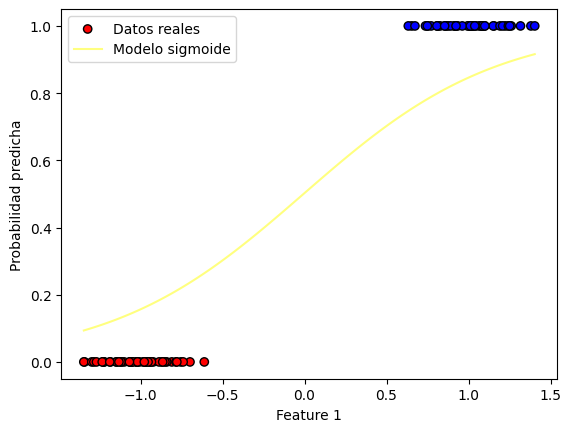

Iteracion: 622
Costo en la iteración 622: 0.17232114920106195
Valor del gradiente 622: [-0.00180228 -0.15161346]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01032269 1.69631382]


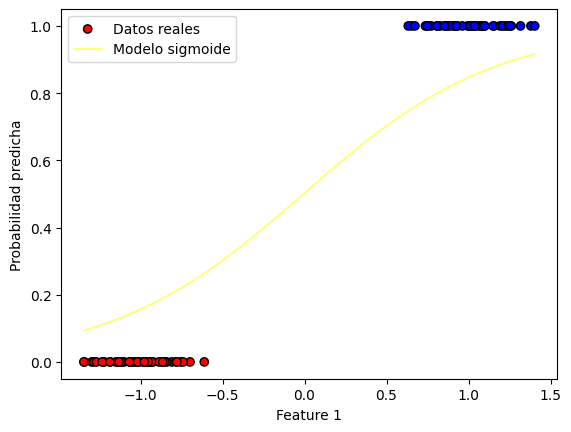

Iteracion: 623
Costo en la iteración 623: 0.17209139721698105
Valor del gradiente 623: [-0.00180127 -0.1514197 ]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.0103407  1.69782802]


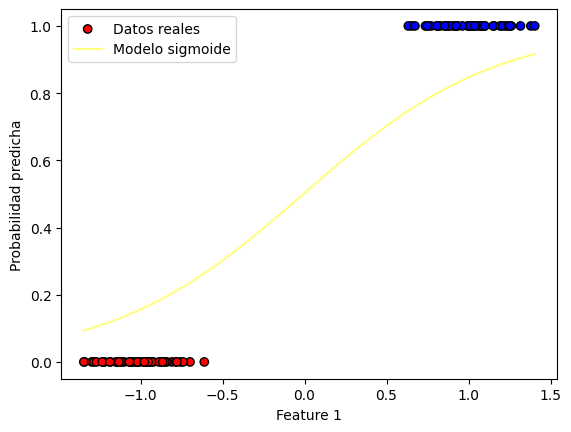

Iteracion: 624
Costo en la iteración 624: 0.17186223191118788
Valor del gradiente 624: [-0.00180026 -0.15122639]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01035871 1.69934028]


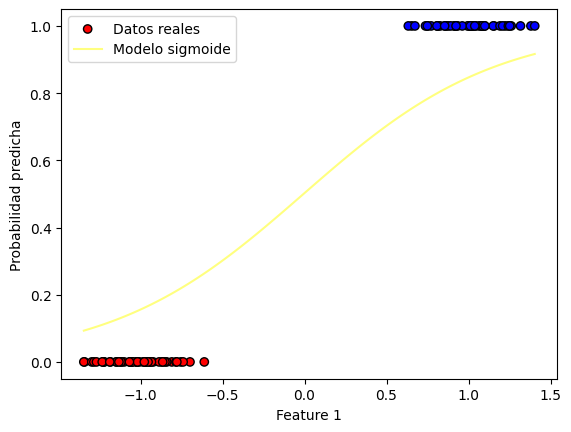

Iteracion: 625
Costo en la iteración 625: 0.17163365113543996
Valor del gradiente 625: [-0.00179924 -0.15103355]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.0103767  1.70085062]


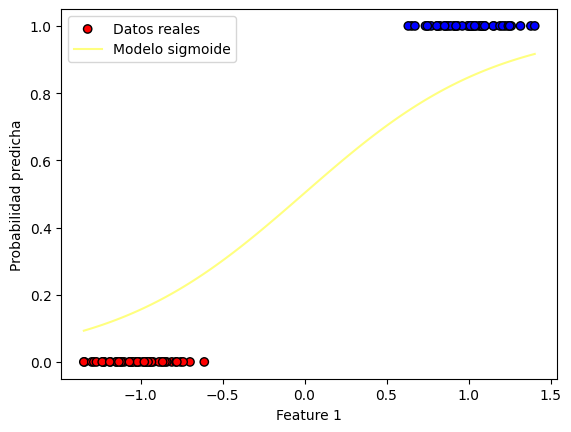

Iteracion: 626
Costo en la iteración 626: 0.17140565275154643
Valor del gradiente 626: [-0.00179823 -0.15084117]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01039468 1.70235903]


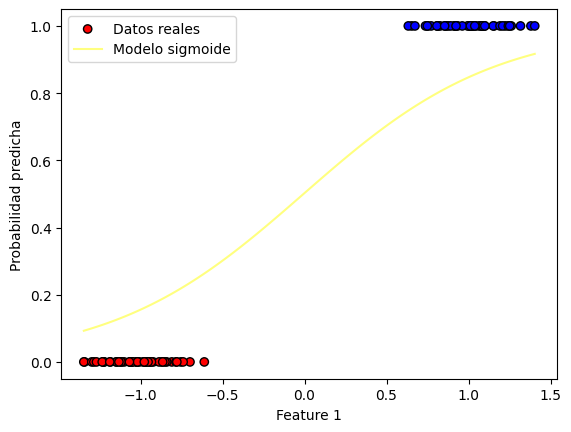

Iteracion: 627
Costo en la iteración 627: 0.17117823463131168
Valor del gradiente 627: [-0.00179721 -0.15064924]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01041265 1.70386552]


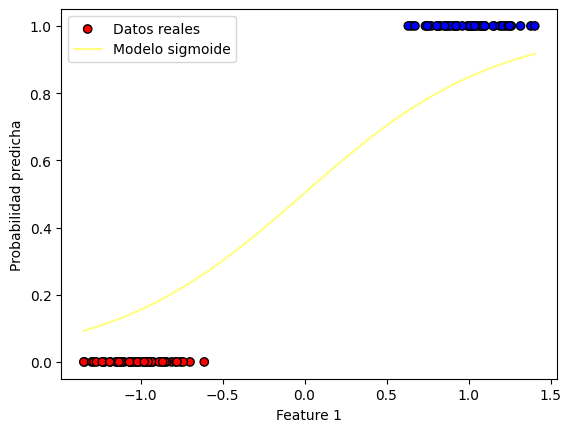

Iteracion: 628
Costo en la iteración 628: 0.17095139465647954
Valor del gradiente 628: [-0.0017962  -0.15045777]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01043061 1.7053701 ]


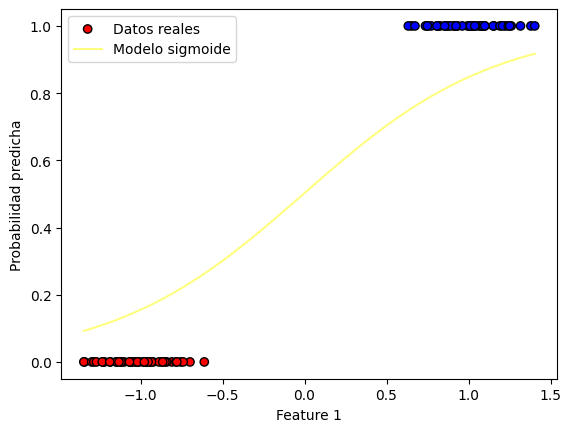

Iteracion: 629
Costo en la iteración 629: 0.17072513071867762
Valor del gradiente 629: [-0.00179518 -0.15026676]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01044857 1.70687277]


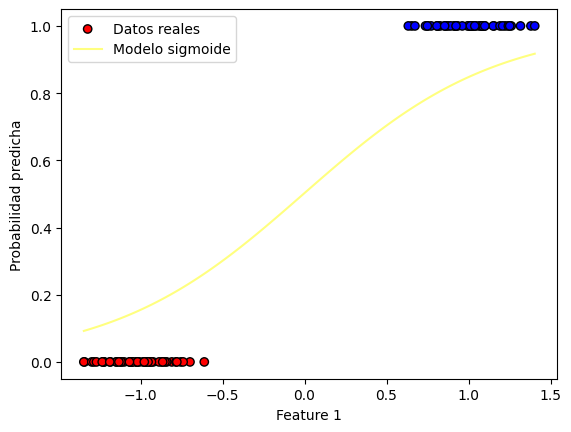

Iteracion: 630
Costo en la iteración 630: 0.1704994407193616
Valor del gradiente 630: [-0.00179416 -0.1500762 ]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01046651 1.70837353]


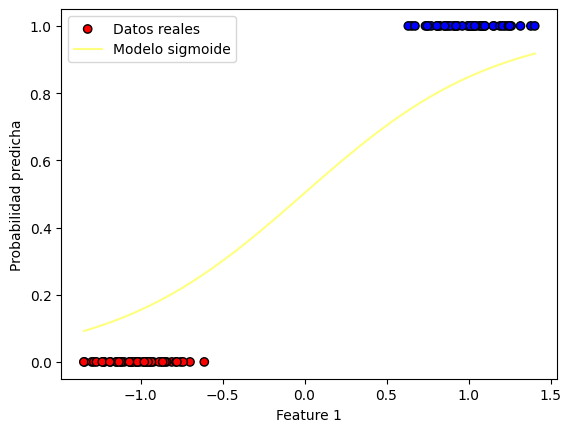

Iteracion: 631
Costo en la iteración 631: 0.1702743225697611
Valor del gradiente 631: [-0.00179315 -0.14988609]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01048444 1.70987239]


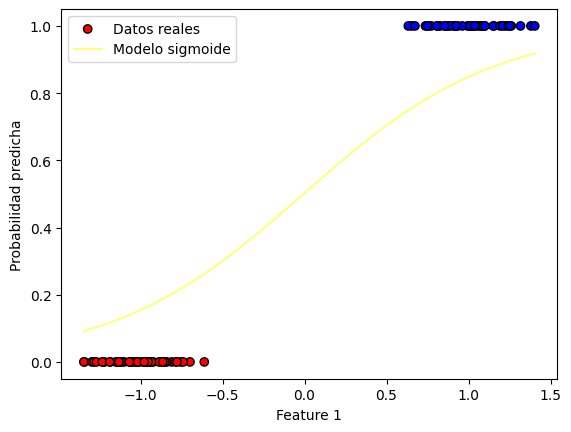

Iteracion: 632
Costo en la iteración 632: 0.1700497741908244
Valor del gradiente 632: [-0.00179213 -0.14969643]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01050236 1.71136935]


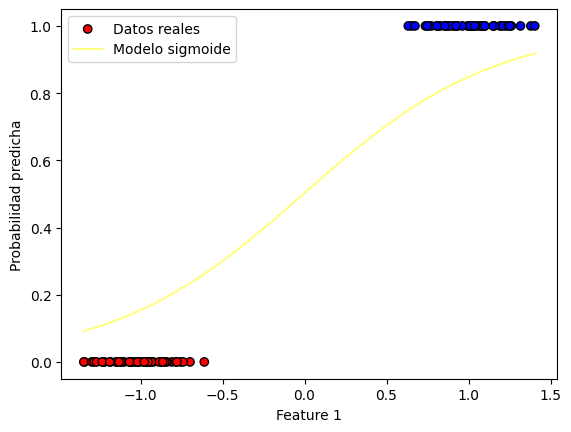

Iteracion: 633
Costo en la iteración 633: 0.16982579351316435
Valor del gradiente 633: [-0.00179111 -0.14950722]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01052027 1.71286443]


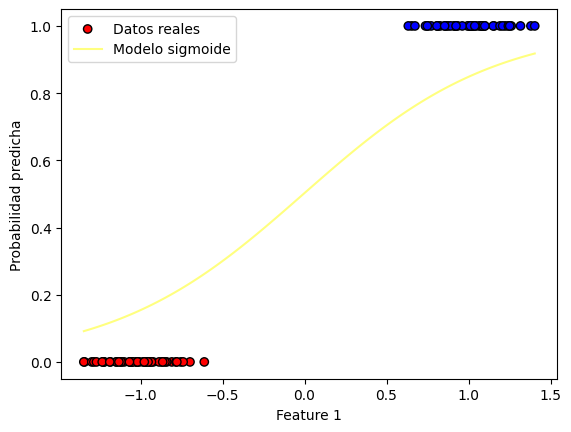

Iteracion: 634
Costo en la iteración 634: 0.1696023784770048
Valor del gradiente 634: [-0.00179009 -0.14931846]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01053817 1.71435761]


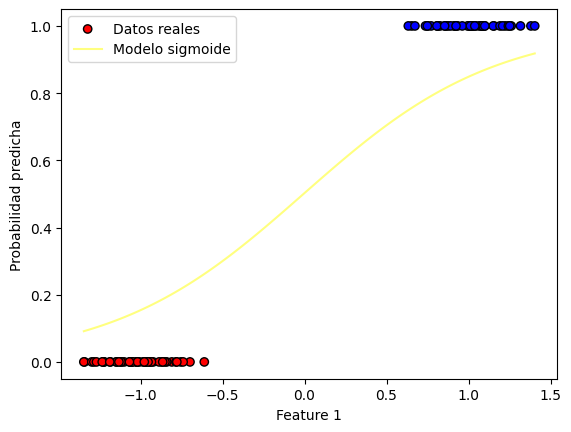

Iteracion: 635
Costo en la iteración 635: 0.16937952703212683
Valor del gradiente 635: [-0.00178907 -0.14913015]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01055606 1.71584891]


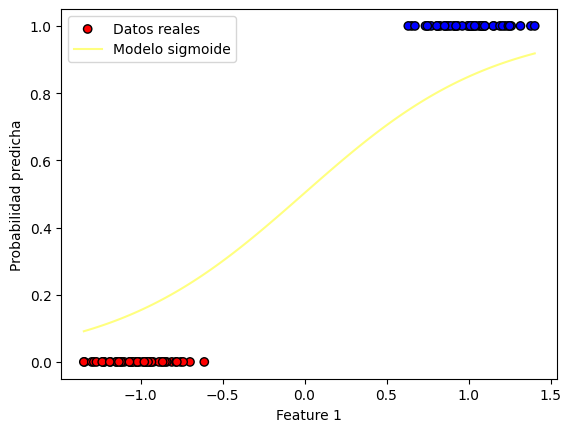

Iteracion: 636
Costo en la iteración 636: 0.16915723713781539
Valor del gradiente 636: [-0.00178805 -0.14894228]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01057394 1.71733833]


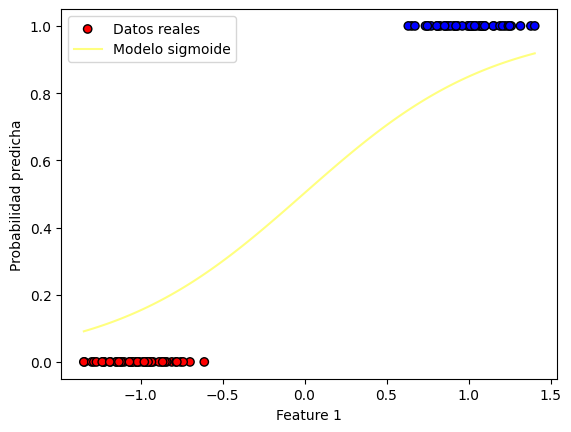

Iteracion: 637
Costo en la iteración 637: 0.1689355067628068
Valor del gradiente 637: [-0.00178704 -0.14875485]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01059181 1.71882588]


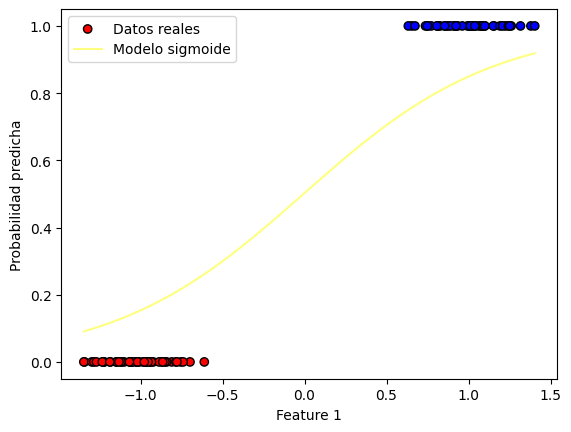

Iteracion: 638
Costo en la iteración 638: 0.1687143338852361
Valor del gradiente 638: [-0.00178602 -0.14856786]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01060967 1.72031156]


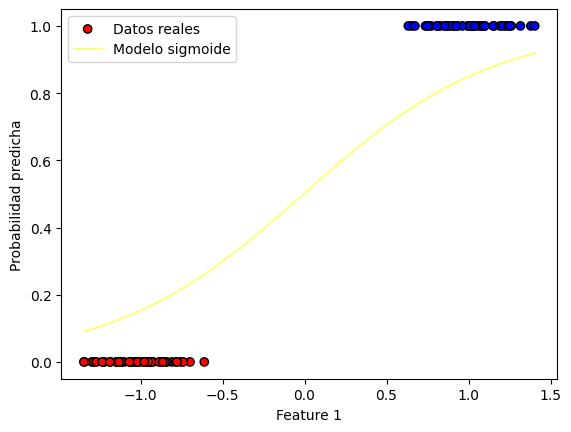

Iteracion: 639
Costo en la iteración 639: 0.16849371649258457
Valor del gradiente 639: [-0.001785   -0.14838132]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01062752 1.72179537]


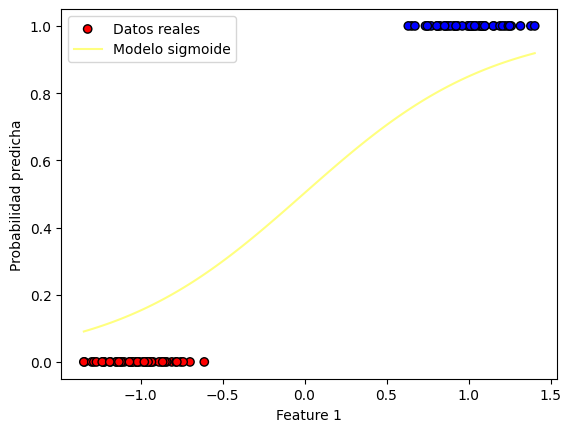

Iteracion: 640
Costo en la iteración 640: 0.1682736525816287
Valor del gradiente 640: [-0.00178397 -0.14819521]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01064536 1.72327733]


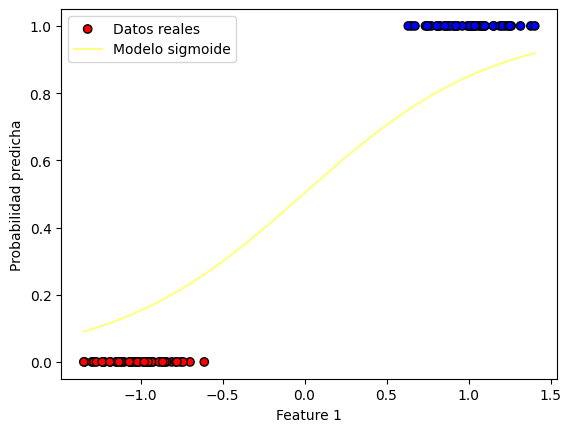

Iteracion: 641
Costo en la iteración 641: 0.16805414015838757
Valor del gradiente 641: [-0.00178295 -0.14800954]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01066319 1.72475742]


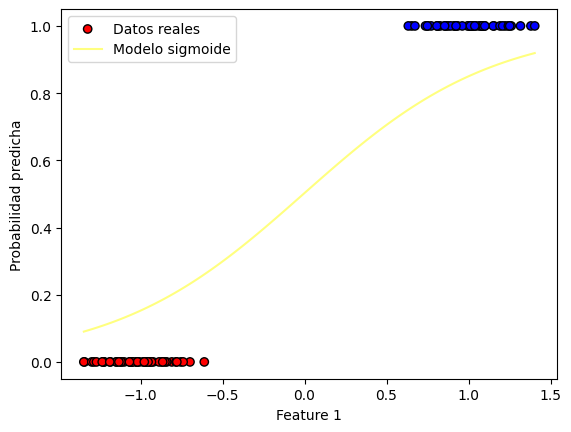

Iteracion: 642
Costo en la iteración 642: 0.16783517723807242
Valor del gradiente 642: [-0.00178193 -0.14782431]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01068101 1.72623567]


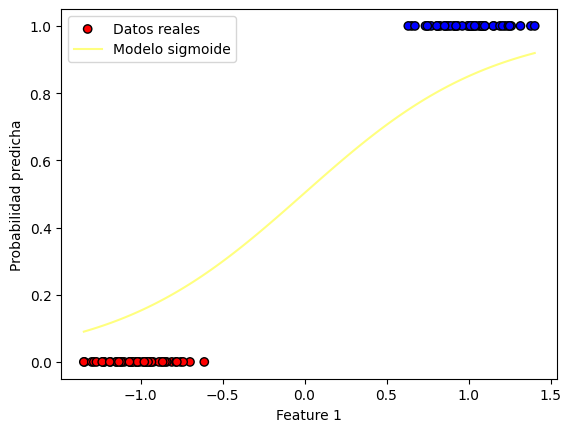

Iteracion: 643
Costo en la iteración 643: 0.1676167618450358
Valor del gradiente 643: [-0.00178091 -0.14763951]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01069882 1.72771206]


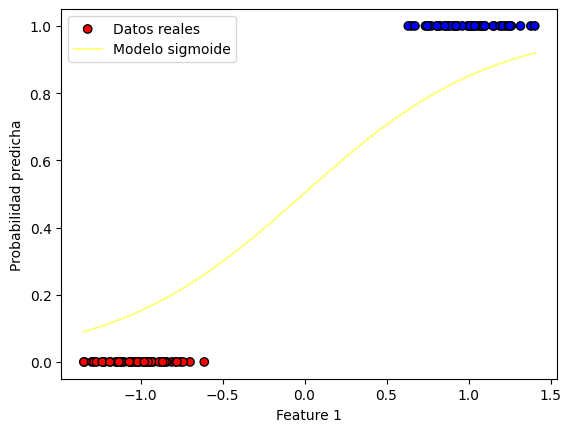

Iteracion: 644
Costo en la iteración 644: 0.16739889201272046
Valor del gradiente 644: [-0.00177989 -0.14745514]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01071662 1.72918661]


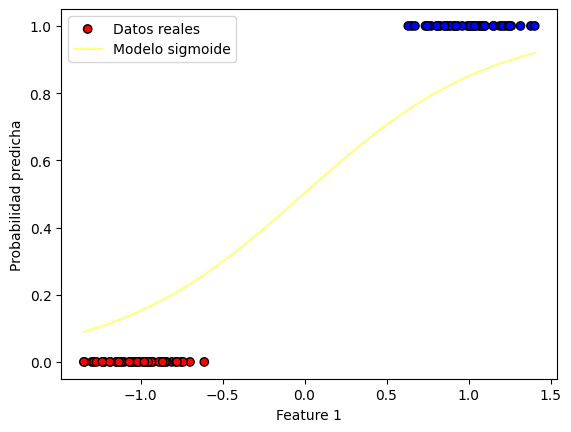

Iteracion: 645
Costo en la iteración 645: 0.16718156578360974
Valor del gradiente 645: [-0.00177887 -0.14727121]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01073441 1.73065932]


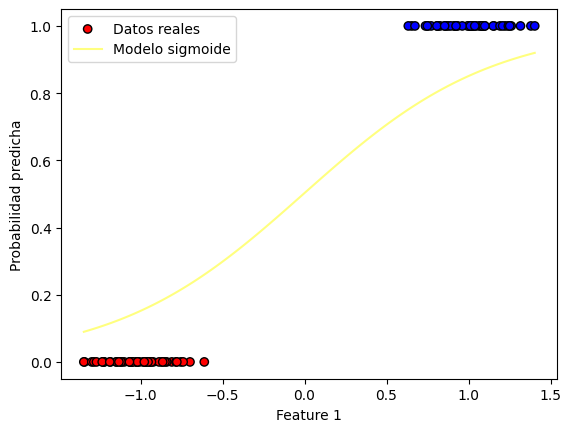

Iteracion: 646
Costo en la iteración 646: 0.1669647812091774
Valor del gradiente 646: [-0.00177785 -0.1470877 ]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01075219 1.7321302 ]


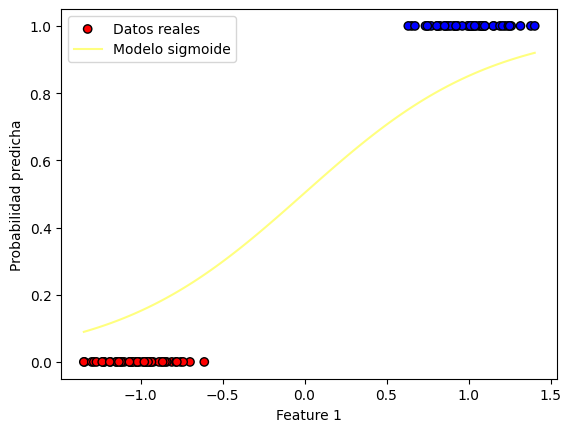

Iteracion: 647
Costo en la iteración 647: 0.16674853634983802
Valor del gradiente 647: [-0.00177682 -0.14690463]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01076996 1.73359925]


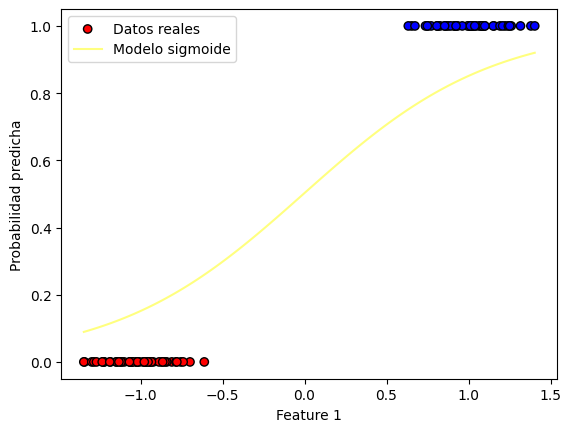

Iteracion: 648
Costo en la iteración 648: 0.16653282927489785
Valor del gradiente 648: [-0.0017758  -0.14672198]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01078771 1.73506647]


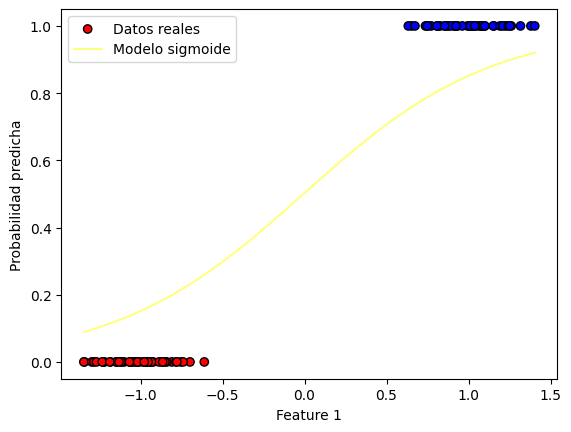

Iteracion: 649
Costo en la iteración 649: 0.16631765806250567
Valor del gradiente 649: [-0.00177478 -0.14653976]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01080546 1.73653186]


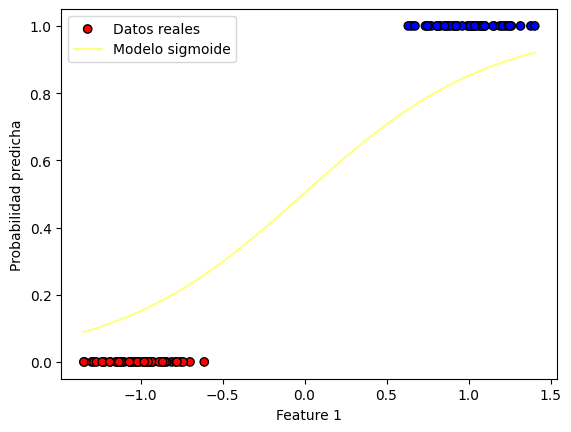

Iteracion: 650
Costo en la iteración 650: 0.16610302079960446
Valor del gradiente 650: [-0.00177375 -0.14635796]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.0108232  1.73799544]


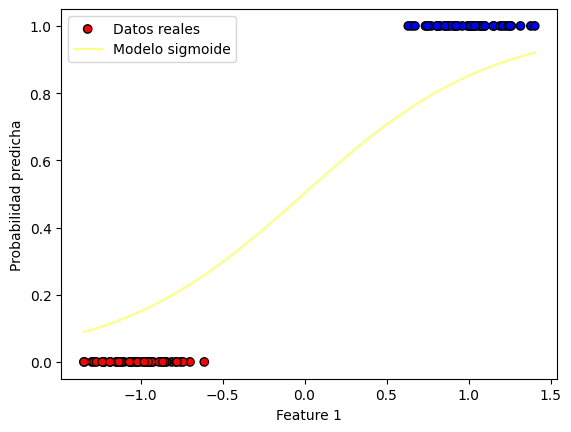

Iteracion: 651
Costo en la iteración 651: 0.1658889155818827
Valor del gradiente 651: [-0.00177273 -0.14617658]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01084093 1.73945721]


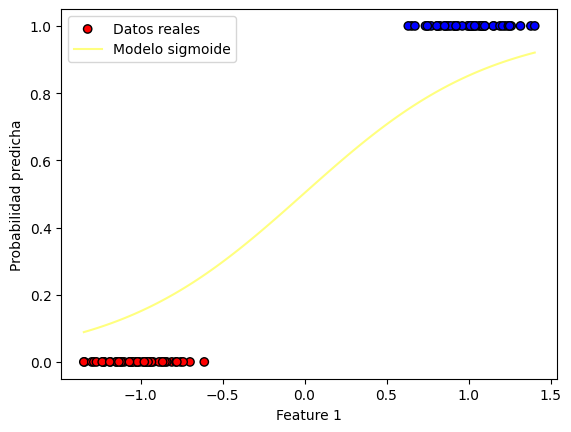

Iteracion: 652
Costo en la iteración 652: 0.16567534051372657
Valor del gradiente 652: [-0.00177171 -0.14599563]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01085864 1.74091717]


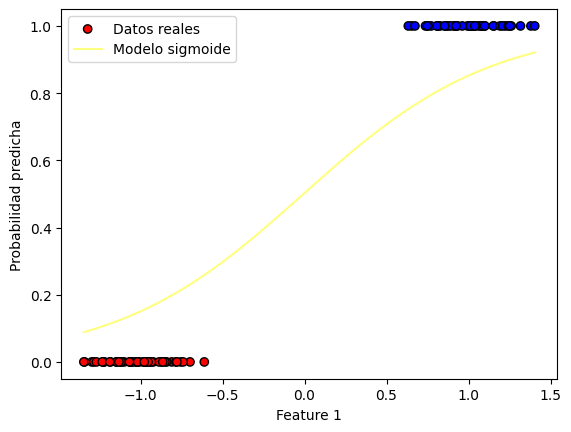

Iteracion: 653
Costo en la iteración 653: 0.16546229370817234
Valor del gradiente 653: [-0.00177068 -0.14581509]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01087635 1.74237532]


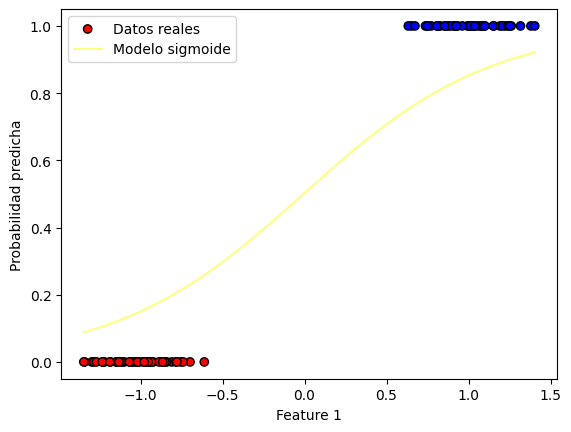

Iteracion: 654
Costo en la iteración 654: 0.1652497732868585
Valor del gradiente 654: [-0.00176966 -0.14563498]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01089405 1.74383167]


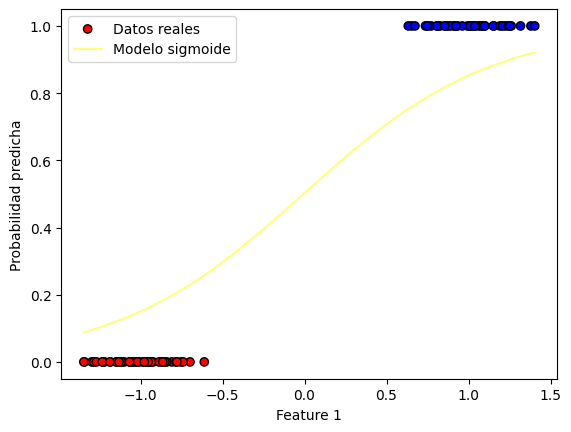

Iteracion: 655
Costo en la iteración 655: 0.16503777737997904
Valor del gradiente 655: [-0.00176863 -0.14545528]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01091173 1.74528622]


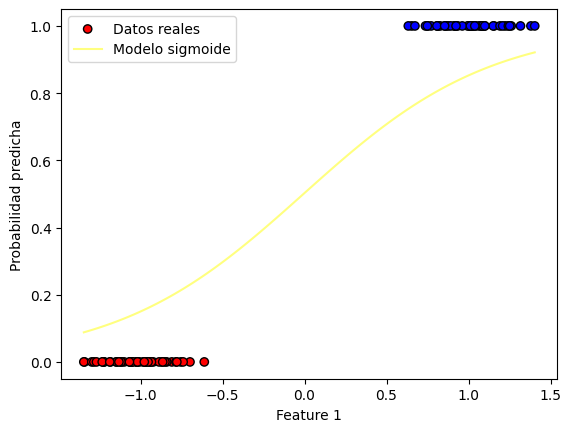

Iteracion: 656
Costo en la iteración 656: 0.16482630412623656
Valor del gradiente 656: [-0.00176761 -0.145276  ]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01092941 1.74673898]


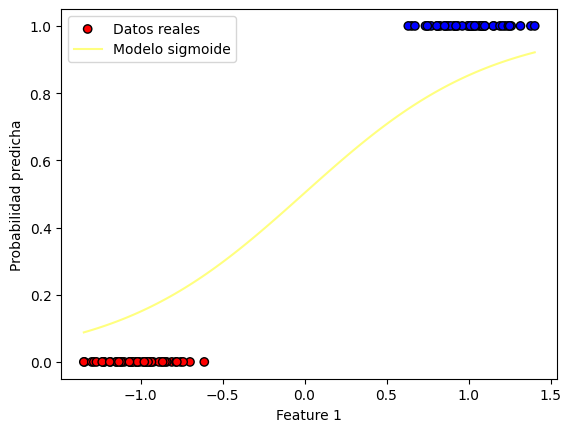

Iteracion: 657
Costo en la iteración 657: 0.16461535167279556
Valor del gradiente 657: [-0.00176658 -0.14509714]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01094708 1.74818995]


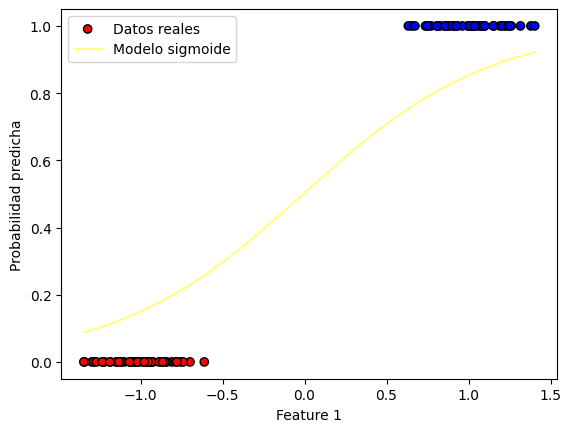

Iteracion: 658
Costo en la iteración 658: 0.1644049181752366
Valor del gradiente 658: [-0.00176556 -0.14491868]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01096473 1.74963914]


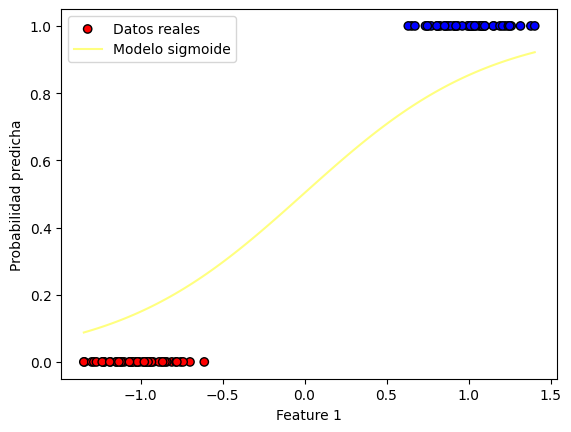

Iteracion: 659
Costo en la iteración 659: 0.16419500179750954
Valor del gradiente 659: [-0.00176453 -0.14474064]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01098238 1.75108654]


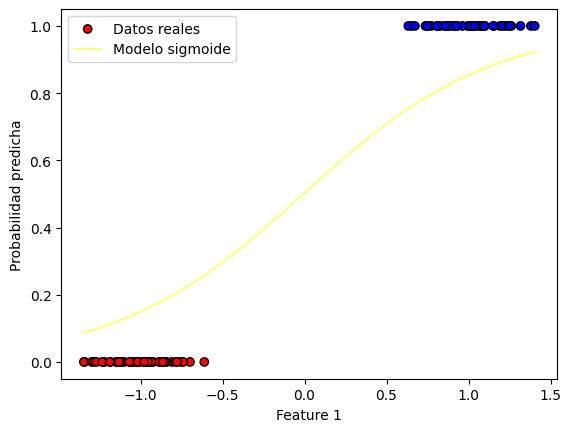

Iteracion: 660
Costo en la iteración 660: 0.163985600711889
Valor del gradiente 660: [-0.00176351 -0.14456301]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01100001 1.75253217]


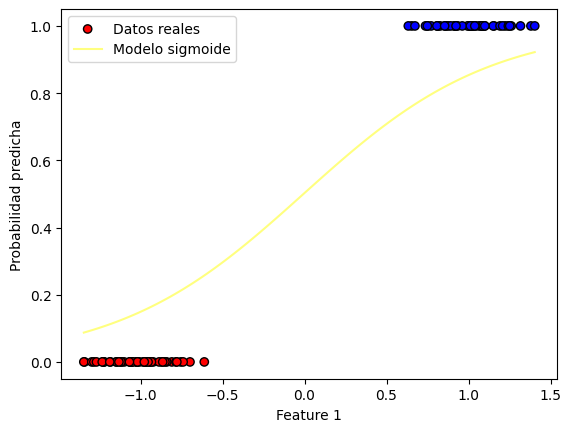

Iteracion: 661
Costo en la iteración 661: 0.16377671309892794
Valor del gradiente 661: [-0.00176248 -0.14438579]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01101764 1.75397603]


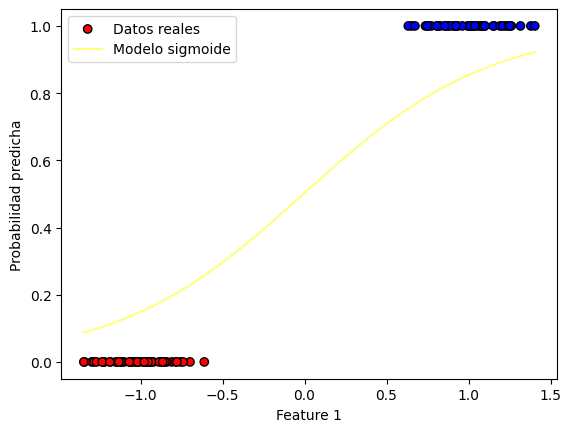

Iteracion: 662
Costo en la iteración 662: 0.1635683371474134
Valor del gradiente 662: [-0.00176146 -0.14420898]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01103525 1.75541812]


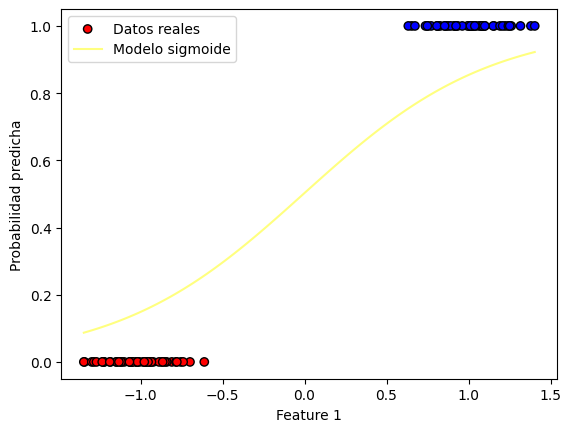

Iteracion: 663
Costo en la iteración 663: 0.16336047105432108
Valor del gradiente 663: [-0.00176043 -0.14403257]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01105286 1.75685845]


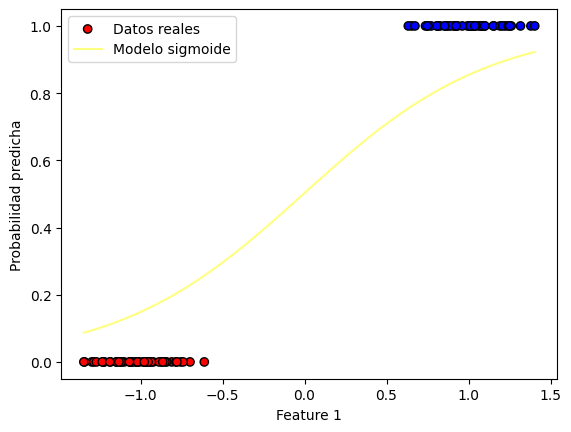

Iteracion: 664
Costo en la iteración 664: 0.16315311302477123
Valor del gradiente 664: [-0.0017594  -0.14385657]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01107045 1.75829701]


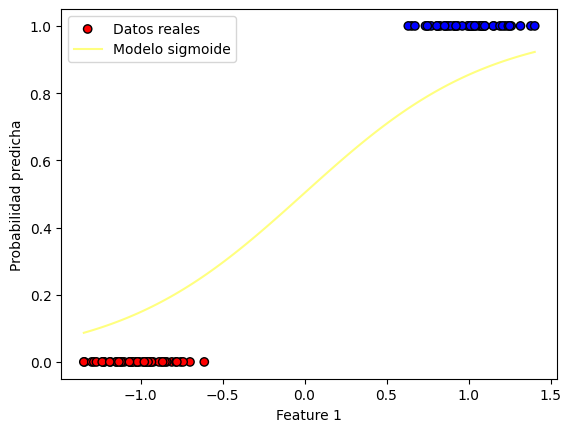

Iteracion: 665
Costo en la iteración 665: 0.16294626127198414
Valor del gradiente 665: [-0.00175838 -0.14368098]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01108803 1.75973382]


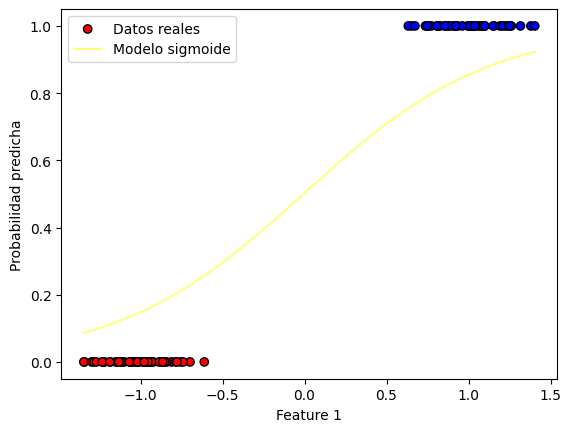

Iteracion: 666
Costo en la iteración 666: 0.1627399140172363
Valor del gradiente 666: [-0.00175735 -0.14350578]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01110561 1.76116888]


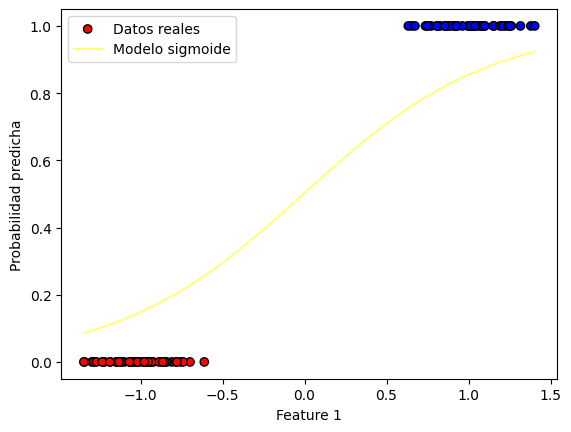

Iteracion: 667
Costo en la iteración 667: 0.16253406948981686
Valor del gradiente 667: [-0.00175632 -0.14333099]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01112317 1.76260219]


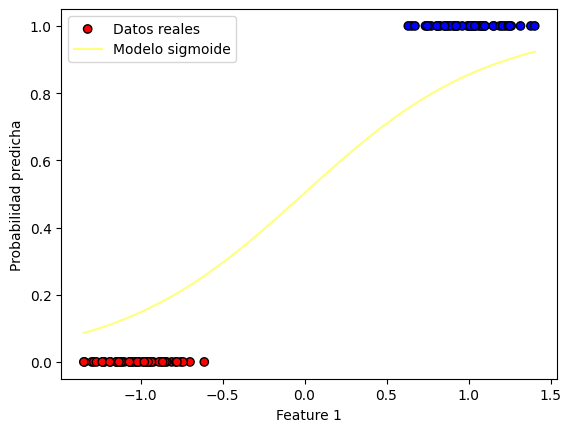

Iteracion: 668
Costo en la iteración 668: 0.16232872592698375
Valor del gradiente 668: [-0.0017553 -0.1431566]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01114072 1.76403376]


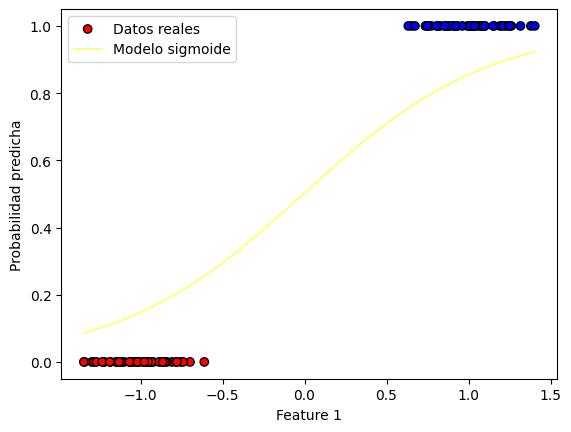

Iteracion: 669
Costo en la iteración 669: 0.16212388157392119
Valor del gradiente 669: [-0.00175427 -0.1429826 ]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01115827 1.76546358]


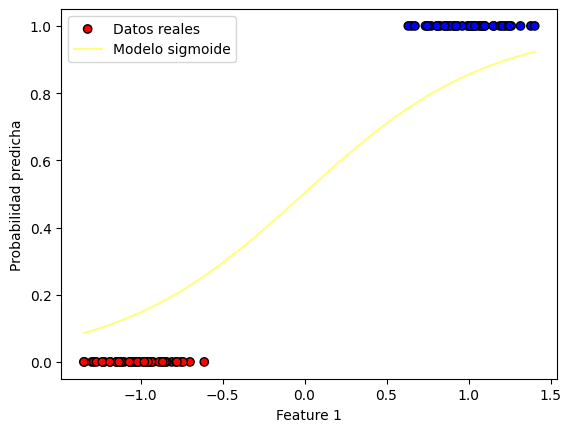

Iteracion: 670
Costo en la iteración 670: 0.1619195346836961
Valor del gradiente 670: [-0.00175324 -0.14280901]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.0111758  1.76689167]


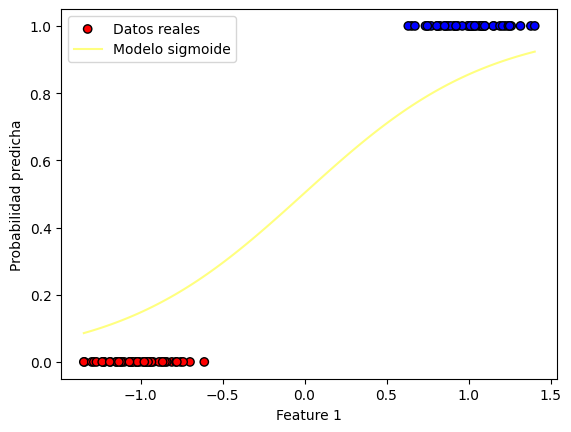

Iteracion: 671
Costo en la iteración 671: 0.16171568351721616
Valor del gradiente 671: [-0.00175222 -0.14263581]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01119332 1.76831803]


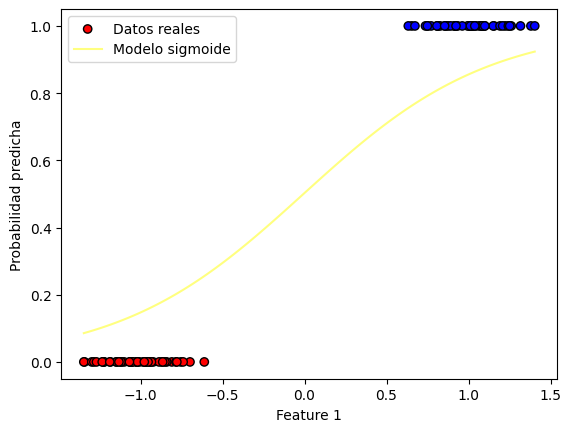

Iteracion: 672
Costo en la iteración 672: 0.16151232634318682
Valor del gradiente 672: [-0.00175119 -0.14246301]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01121083 1.76974266]


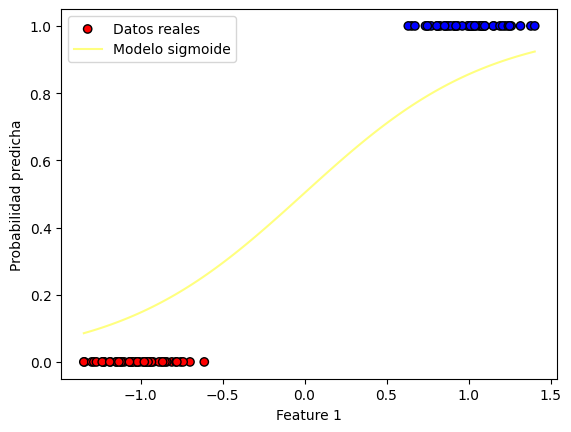

Iteracion: 673
Costo en la iteración 673: 0.16130946143806996
Valor del gradiente 673: [-0.00175016 -0.1422906 ]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01122833 1.77116557]


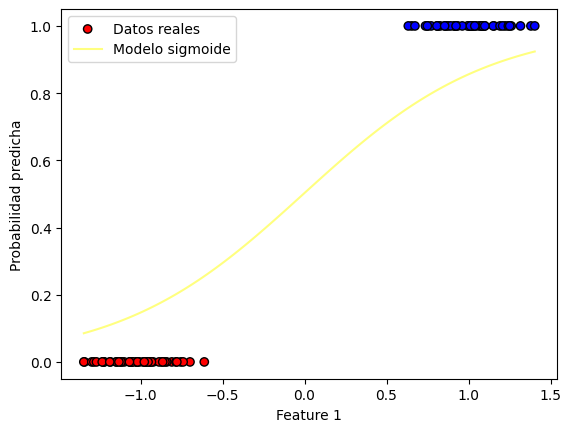

Iteracion: 674
Costo en la iteración 674: 0.16110708708604127
Valor del gradiente 674: [-0.00174914 -0.14211858]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01124583 1.77258675]


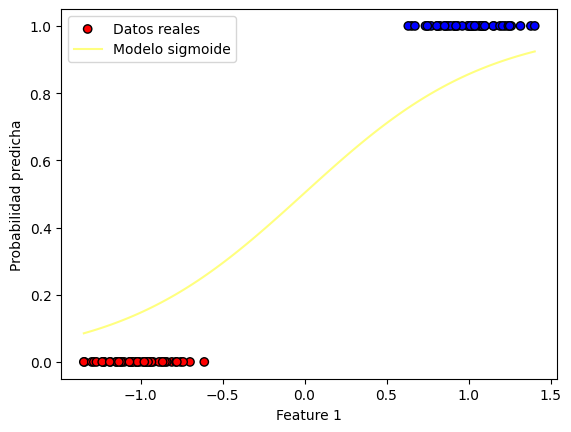

Iteracion: 675
Costo en la iteración 675: 0.1609052015789494
Valor del gradiente 675: [-0.00174811 -0.14194695]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01126331 1.77400622]


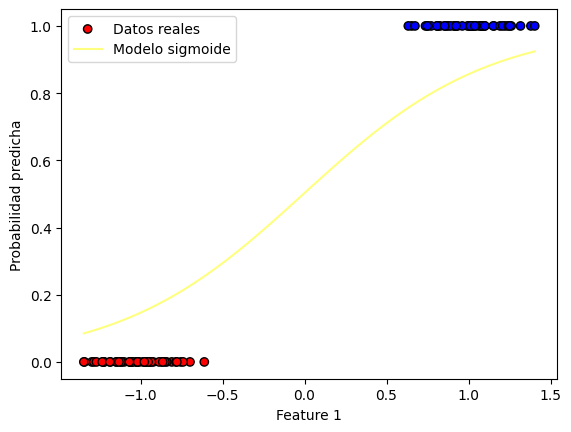

Iteracion: 676
Costo en la iteración 676: 0.16070380321627417
Valor del gradiente 676: [-0.00174708 -0.14177571]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01128078 1.77542398]


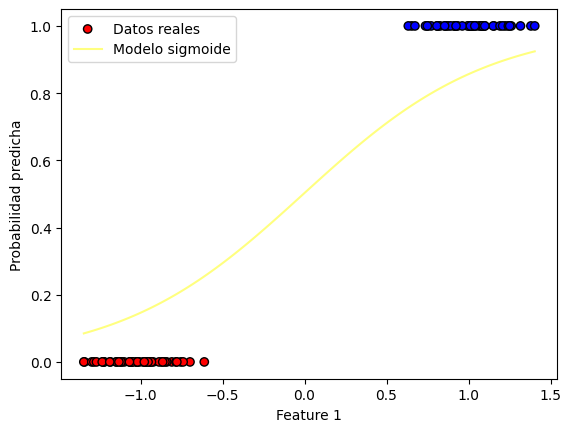

Iteracion: 677
Costo en la iteración 677: 0.1605028903050858
Valor del gradiente 677: [-0.00174606 -0.14160487]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01129824 1.77684003]


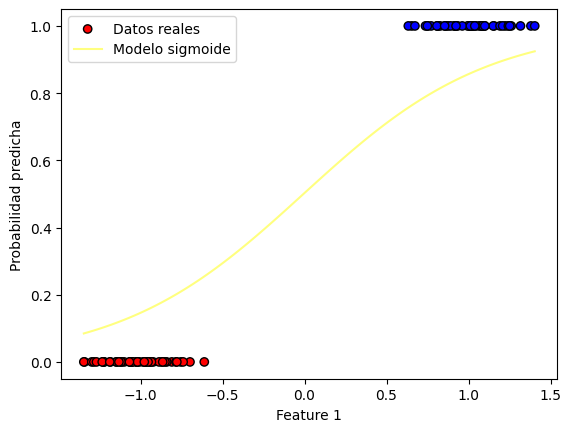

Iteracion: 678
Costo en la iteración 678: 0.160302461160004
Valor del gradiente 678: [-0.00174503 -0.1414344 ]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01131569 1.77825437]


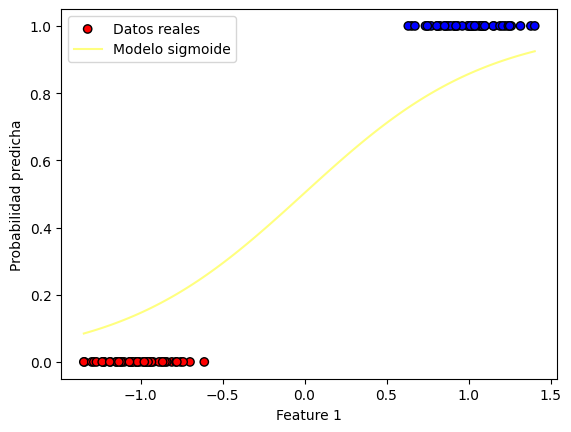

Iteracion: 679
Costo en la iteración 679: 0.16010251410315743
Valor del gradiente 679: [-0.001744   -0.14126433]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01133313 1.77966702]


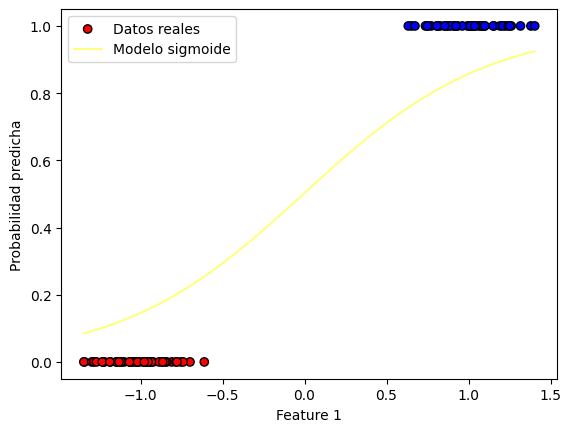

Iteracion: 680
Costo en la iteración 680: 0.1599030474641436
Valor del gradiente 680: [-0.00174298 -0.14109464]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01135056 1.78107796]


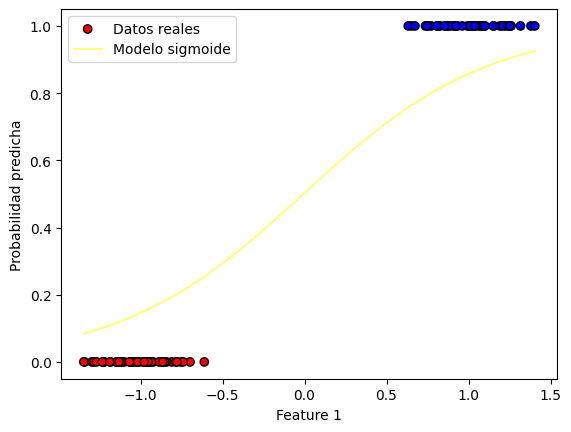

Iteracion: 681
Costo en la iteración 681: 0.15970405957998843
Valor del gradiente 681: [-0.00174195 -0.14092533]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01136798 1.78248722]


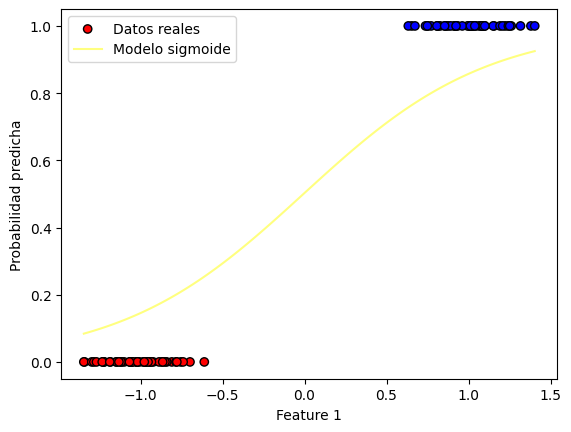

Iteracion: 682
Costo en la iteración 682: 0.159505548795107
Valor del gradiente 682: [-0.00174092 -0.14075641]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01138539 1.78389478]


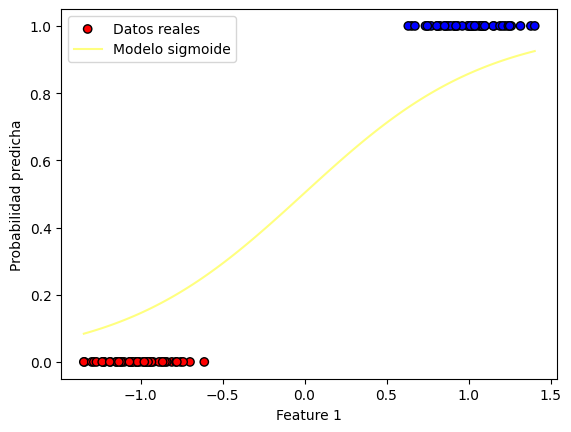

Iteracion: 683
Costo en la iteración 683: 0.15930751346126362
Valor del gradiente 683: [-0.0017399  -0.14058787]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01140279 1.78530066]


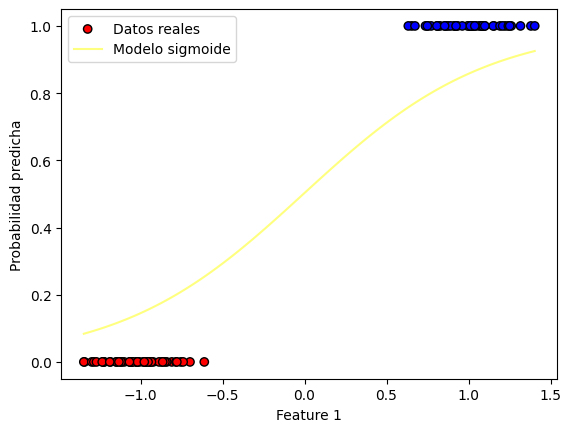

Iteracion: 684
Costo en la iteración 684: 0.15910995193753263
Valor del gradiente 684: [-0.00173887 -0.14041971]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01142017 1.78670486]


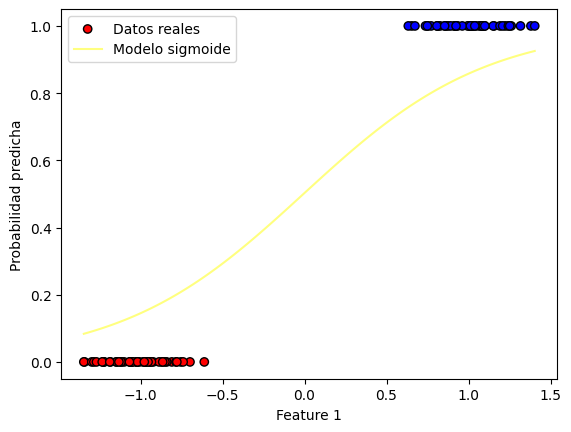

Iteracion: 685
Costo en la iteración 685: 0.15891286259025938
Valor del gradiente 685: [-0.00173784 -0.14025192]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01143755 1.78810737]


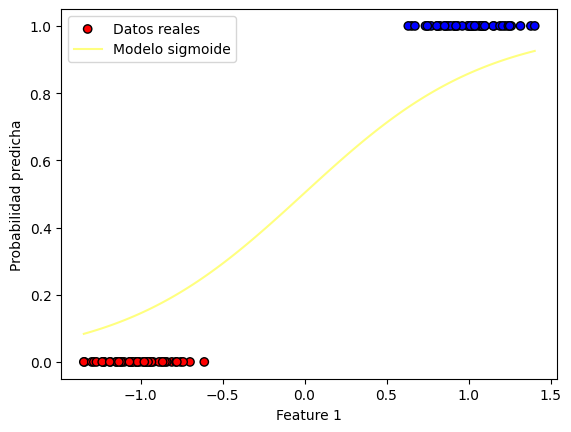

Iteracion: 686
Costo en la iteración 686: 0.1587162437930215
Valor del gradiente 686: [-0.00173681 -0.14008452]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01145492 1.78950822]


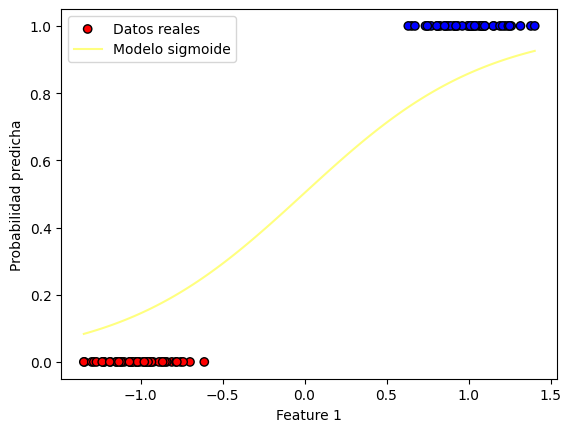

Iteracion: 687
Costo en la iteración 687: 0.1585200939265901
Valor del gradiente 687: [-0.00173579 -0.13991749]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01147228 1.79090739]


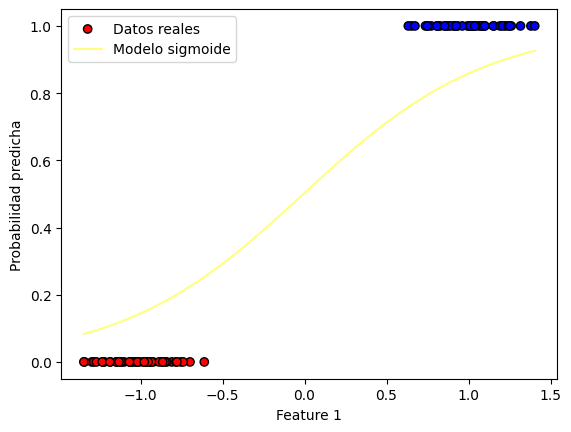

Iteracion: 688
Costo en la iteración 688: 0.15832441137889164
Valor del gradiente 688: [-0.00173476 -0.13975083]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01148963 1.7923049 ]


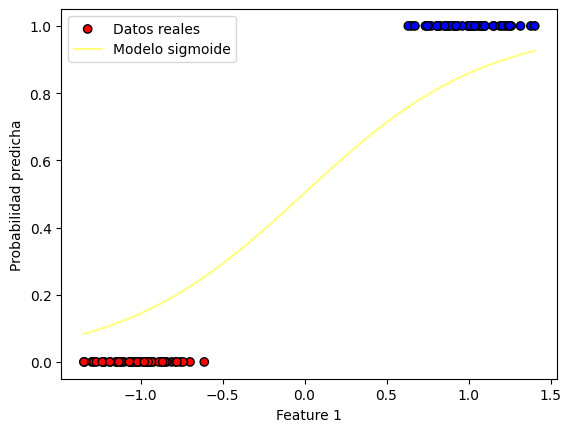

Iteracion: 689
Costo en la iteración 689: 0.1581291945449698
Valor del gradiente 689: [-0.00173373 -0.13958455]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01150696 1.79370075]


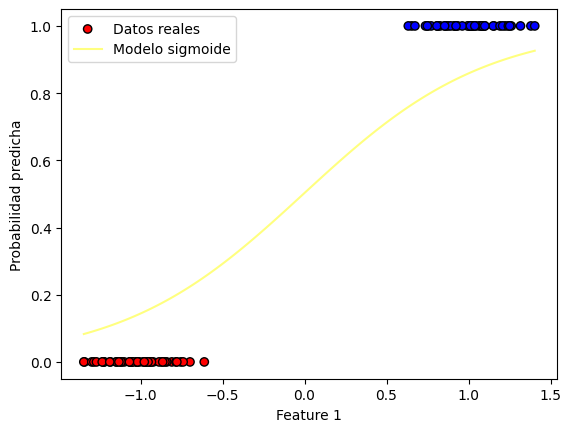

Iteracion: 690
Costo en la iteración 690: 0.15793444182694752
Valor del gradiente 690: [-0.00173271 -0.13941865]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01152429 1.79509493]


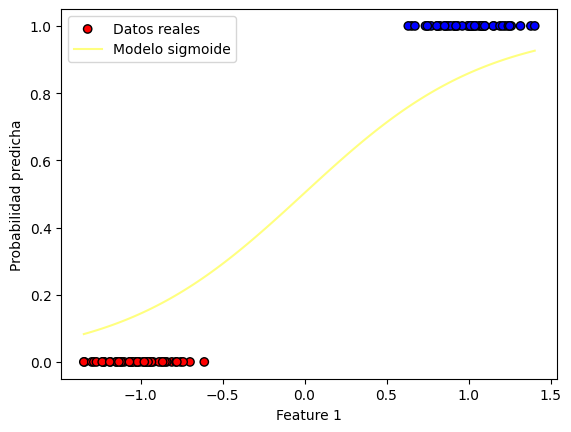

Iteracion: 691
Costo en la iteración 691: 0.15774015163398952
Valor del gradiente 691: [-0.00173168 -0.13925311]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01154161 1.79648747]


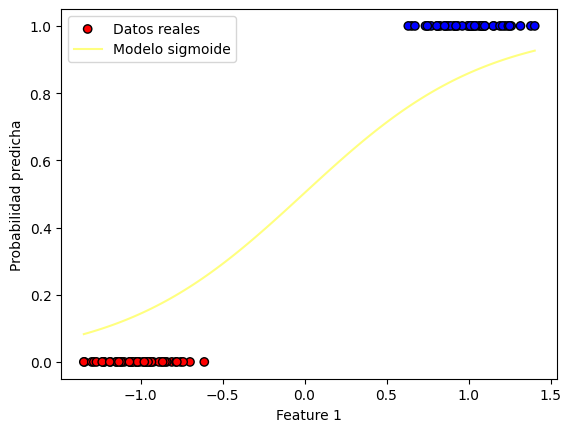

Iteracion: 692
Costo en la iteración 692: 0.15754632238226463
Valor del gradiente 692: [-0.00173066 -0.13908795]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01155891 1.79787835]


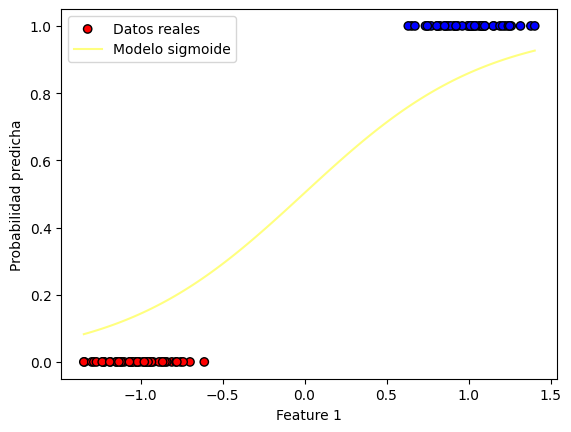

Iteracion: 693
Costo en la iteración 693: 0.15735295249490897
Valor del gradiente 693: [-0.00172963 -0.13892315]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01157621 1.79926758]


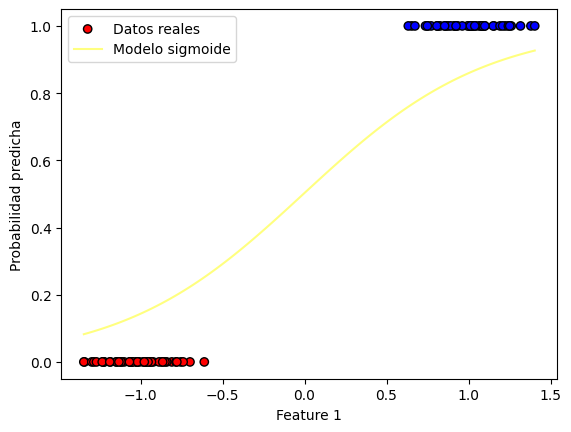

Iteracion: 694
Costo en la iteración 694: 0.1571600404019888
Valor del gradiente 694: [-0.0017286  -0.13875872]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.0115935  1.80065516]


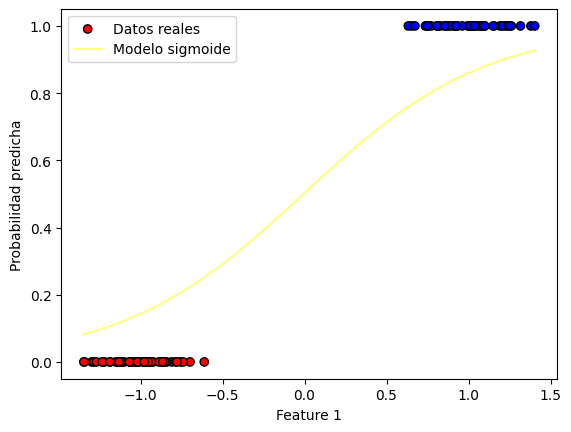

Iteracion: 695
Costo en la iteración 695: 0.15696758454046378
Valor del gradiente 695: [-0.00172758 -0.13859466]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01161077 1.80204111]


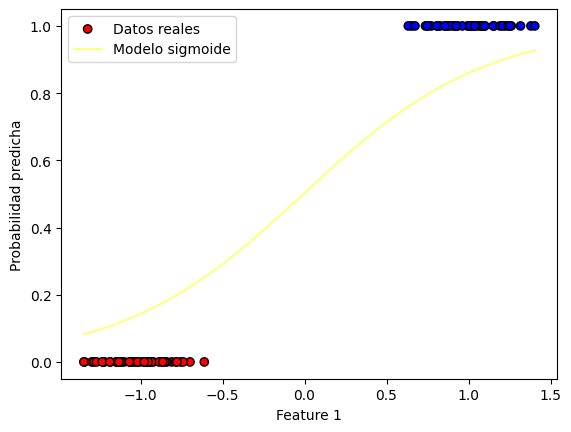

Iteracion: 696
Costo en la iteración 696: 0.15677558335415065
Valor del gradiente 696: [-0.00172655 -0.13843097]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01162804 1.80342542]


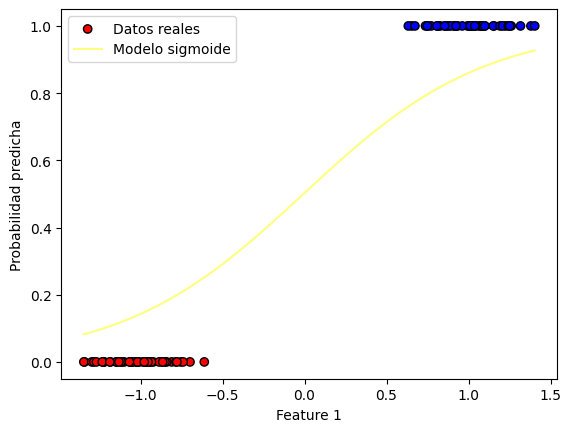

Iteracion: 697
Costo en la iteración 697: 0.15658403529368672
Valor del gradiente 697: [-0.00172552 -0.13826764]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01164529 1.8048081 ]


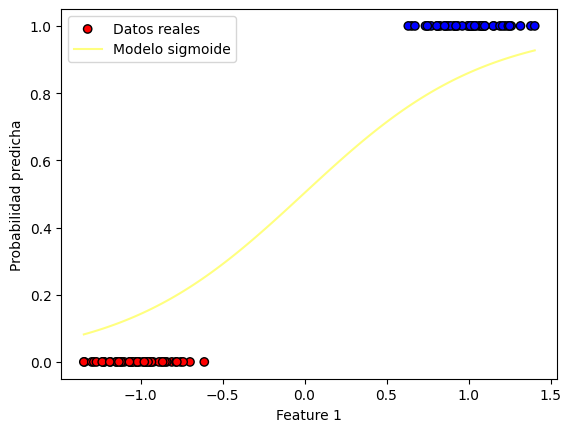

Iteracion: 698
Costo en la iteración 698: 0.15639293881649408
Valor del gradiente 698: [-0.0017245  -0.13810467]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01166254 1.80618914]


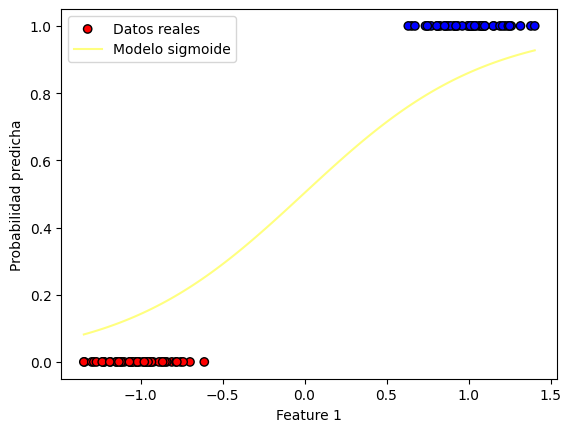

Iteracion: 699
Costo en la iteración 699: 0.1562022923867435
Valor del gradiente 699: [-0.00172347 -0.13794207]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01167977 1.80756856]


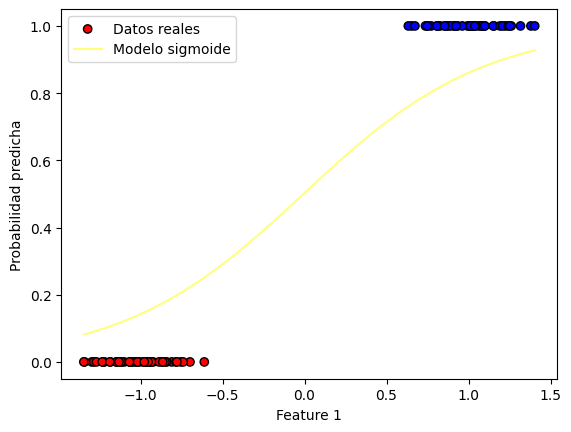

Iteracion: 700
Costo en la iteración 700: 0.1560120944753192
Valor del gradiente 700: [-0.00172245 -0.13777982]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.011697   1.80894636]


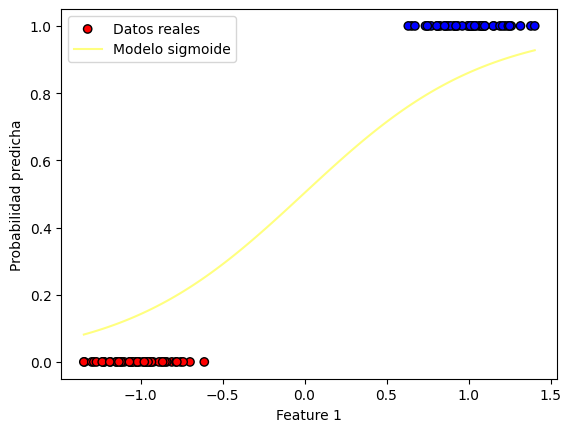

Iteracion: 701
Costo en la iteración 701: 0.155822343559783
Valor del gradiente 701: [-0.00172142 -0.13761794]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01171421 1.81032254]


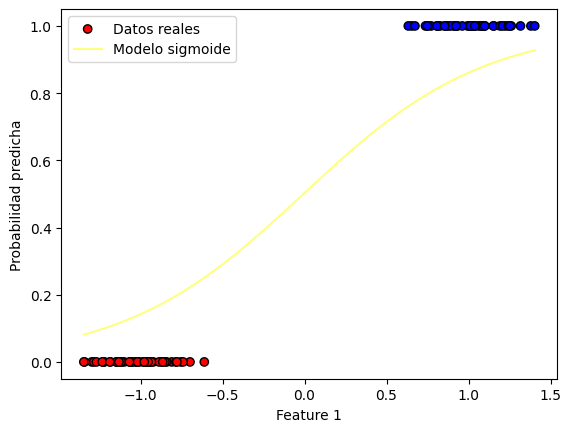

Iteracion: 702
Costo en la iteración 702: 0.15563303812433957
Valor del gradiente 702: [-0.0017204  -0.13745642]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01173142 1.81169711]


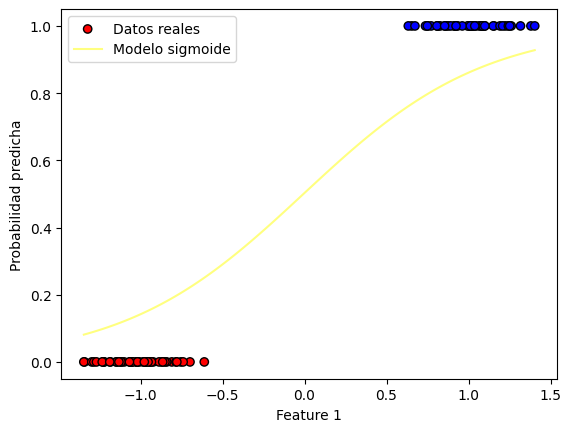

Iteracion: 703
Costo en la iteración 703: 0.15544417665980118
Valor del gradiente 703: [-0.00171937 -0.13729525]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01174861 1.81307006]


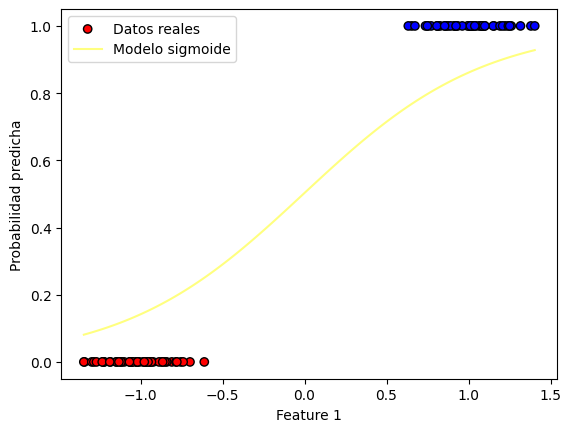

Iteracion: 704
Costo en la iteración 704: 0.15525575766355312
Valor del gradiente 704: [-0.00171835 -0.13713444]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01176579 1.8144414 ]


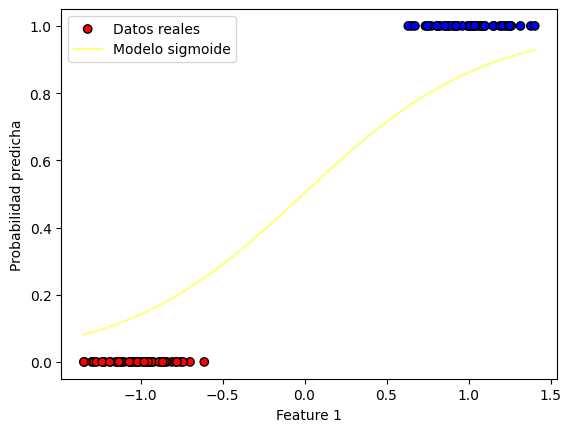

Iteracion: 705
Costo en la iteración 705: 0.15506777963951904
Valor del gradiente 705: [-0.00171732 -0.13697398]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01178297 1.81581114]


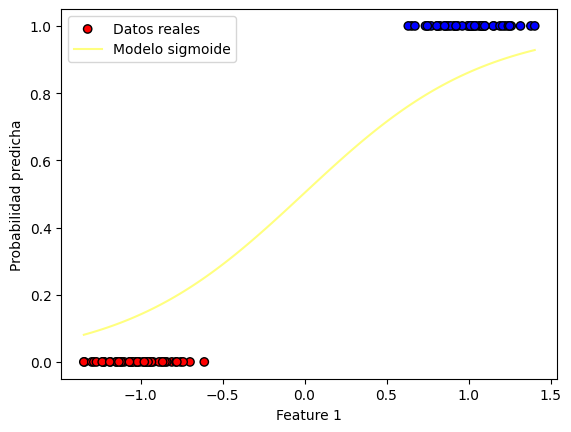

Iteracion: 706
Costo en la iteración 706: 0.15488024109812676
Valor del gradiente 706: [-0.0017163  -0.13681388]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01180013 1.81717928]


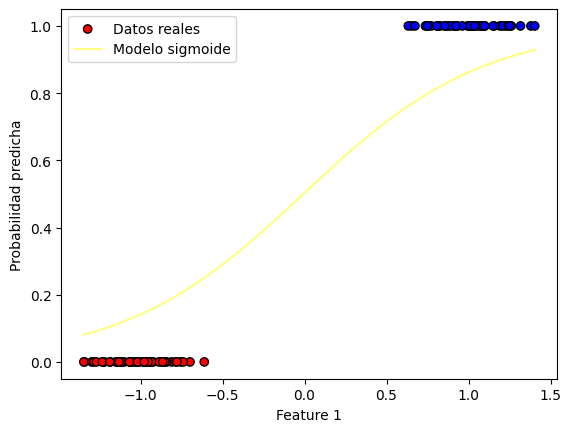

Iteracion: 707
Costo en la iteración 707: 0.15469314055627392
Valor del gradiente 707: [-0.00171527 -0.13665414]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01181728 1.81854582]


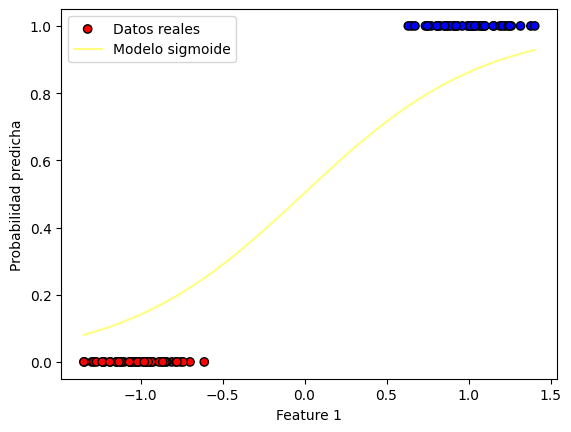

Iteracion: 708
Costo en la iteración 708: 0.15450647653729452
Valor del gradiente 708: [-0.00171425 -0.13649474]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01183442 1.81991077]


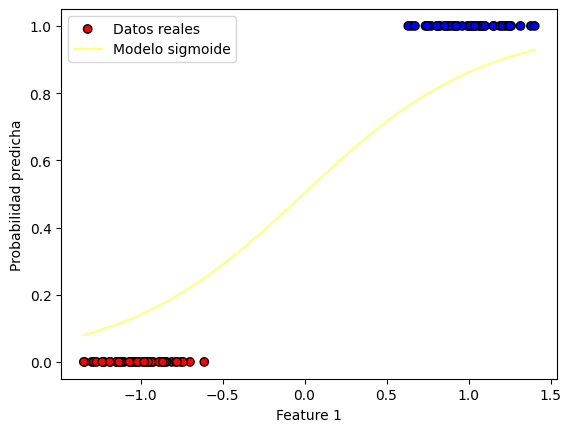

Iteracion: 709
Costo en la iteración 709: 0.15432024757092466
Valor del gradiente 709: [-0.00171322 -0.1363357 ]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01185156 1.82127413]


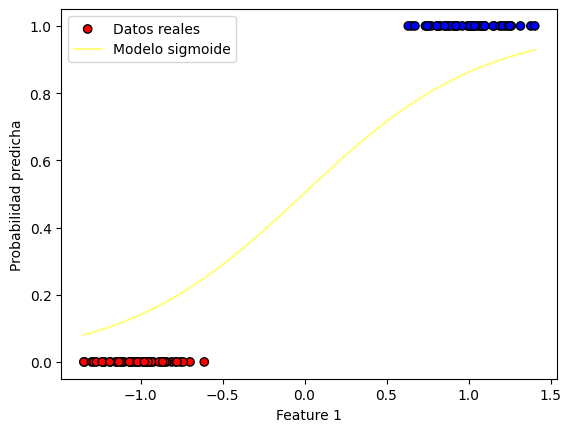

Iteracion: 710
Costo en la iteración 710: 0.15413445219326946
Valor del gradiente 710: [-0.0017122  -0.13617701]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01186868 1.8226359 ]


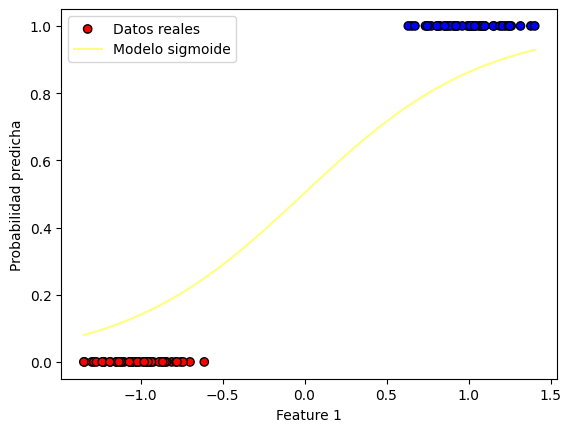

Iteracion: 711
Costo en la iteración 711: 0.1539490889467696
Valor del gradiente 711: [-0.00171118 -0.13601866]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01188579 1.82399608]


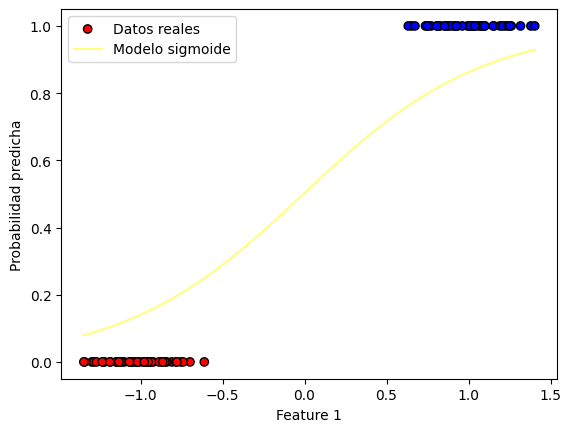

Iteracion: 712
Costo en la iteración 712: 0.1537641563801682
Valor del gradiente 712: [-0.00171015 -0.13586067]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01190289 1.82535469]


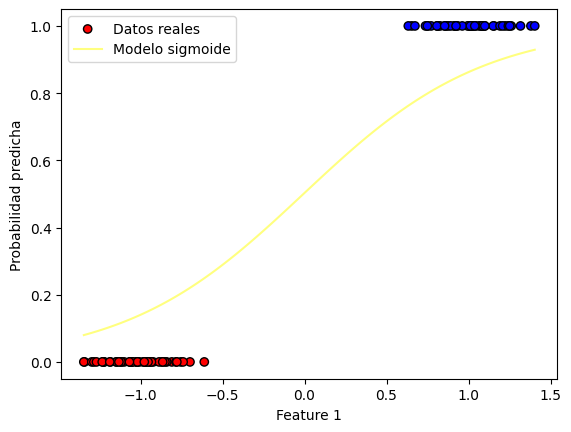

Iteracion: 713
Costo en la iteración 713: 0.15357965304847787
Valor del gradiente 713: [-0.00170913 -0.13570302]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01191998 1.82671172]


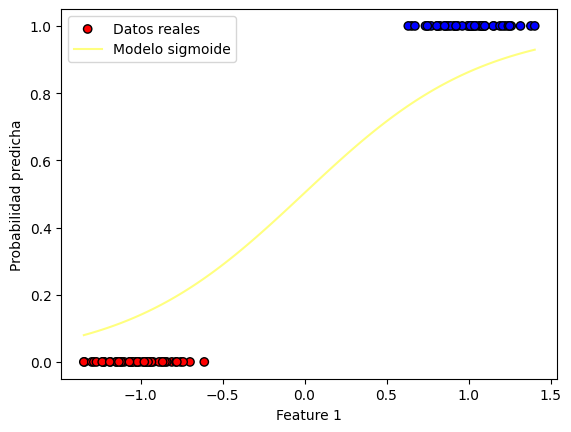

Iteracion: 714
Costo en la iteración 714: 0.15339557751294847
Valor del gradiente 714: [-0.00170811 -0.13554571]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01193706 1.82806718]


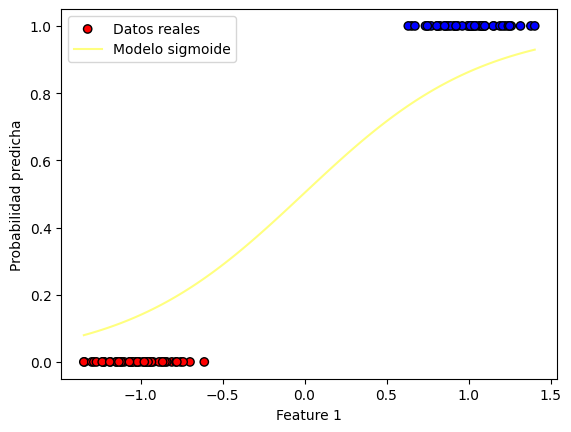

Iteracion: 715
Costo en la iteración 715: 0.15321192834103378
Valor del gradiente 715: [-0.00170708 -0.13538875]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01195413 1.82942107]


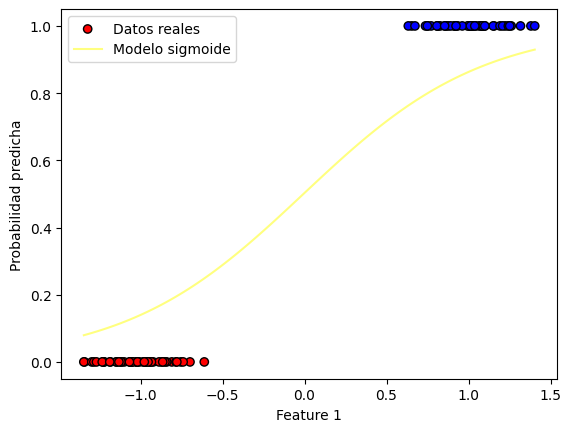

Iteracion: 716
Costo en la iteración 716: 0.15302870410636002
Valor del gradiente 716: [-0.00170606 -0.13523214]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.0119712  1.83077339]


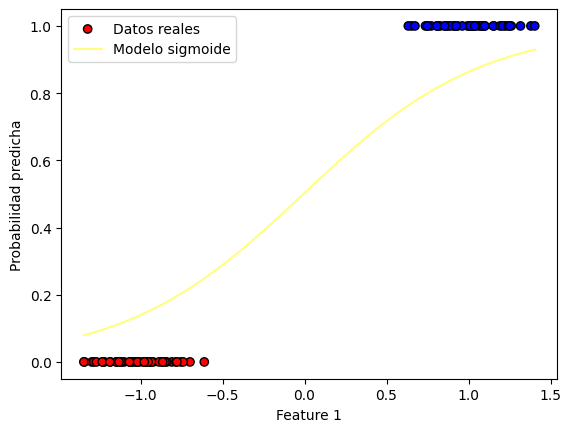

Iteracion: 717
Costo en la iteración 717: 0.15284590338869317
Valor del gradiente 717: [-0.00170504 -0.13507586]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01198825 1.83212415]


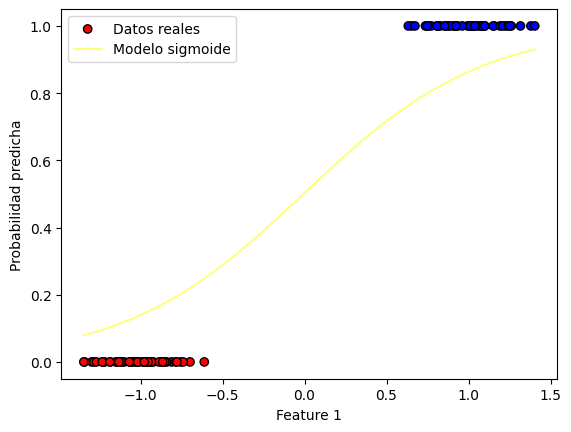

Iteracion: 718
Costo en la iteración 718: 0.15266352477390752
Valor del gradiente 718: [-0.00170402 -0.13491993]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01200529 1.83347334]


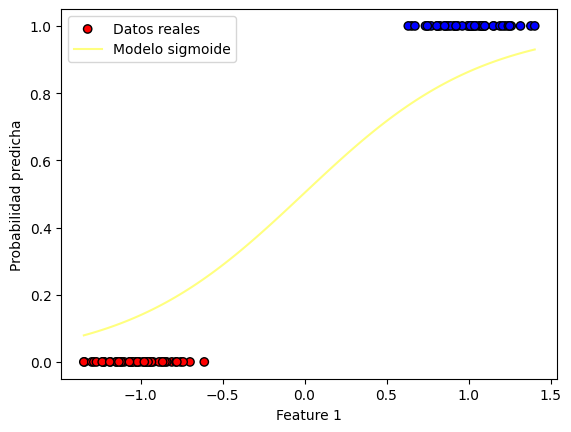

Iteracion: 719
Costo en la iteración 719: 0.15248156685395342
Valor del gradiente 719: [-0.00170299 -0.13476434]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01202232 1.83482099]


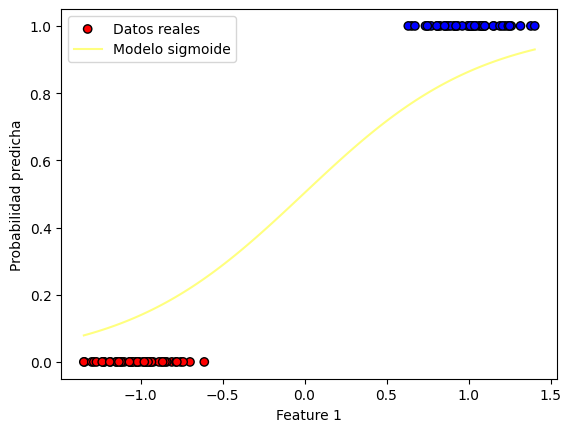

Iteracion: 720
Costo en la iteración 720: 0.1523000282268263
Valor del gradiente 720: [-0.00170197 -0.13460908]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01203934 1.83616708]


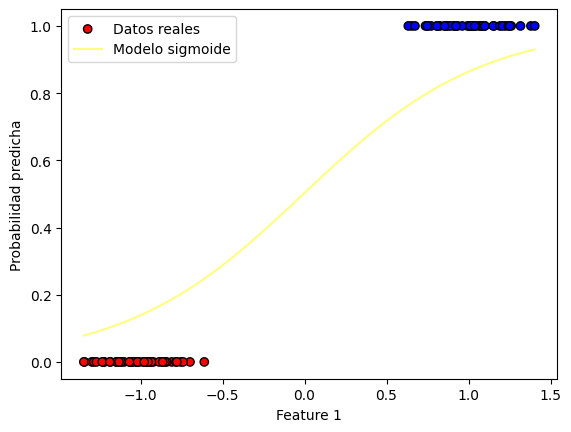

Iteracion: 721
Costo en la iteración 721: 0.1521189074965349
Valor del gradiente 721: [-0.00170095 -0.13445417]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01205635 1.83751162]


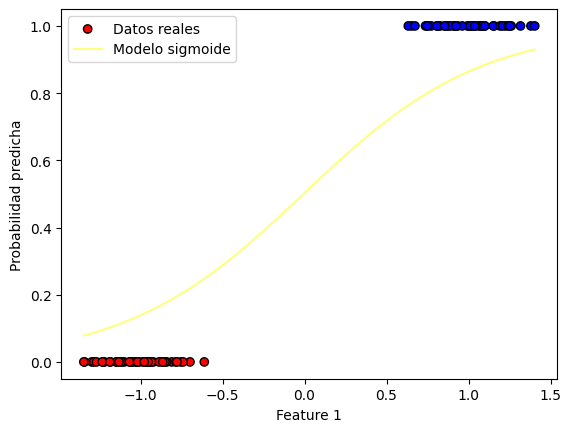

Iteracion: 722
Costo en la iteración 722: 0.1519382032730704
Valor del gradiente 722: [-0.00169993 -0.13429959]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01207334 1.83885462]


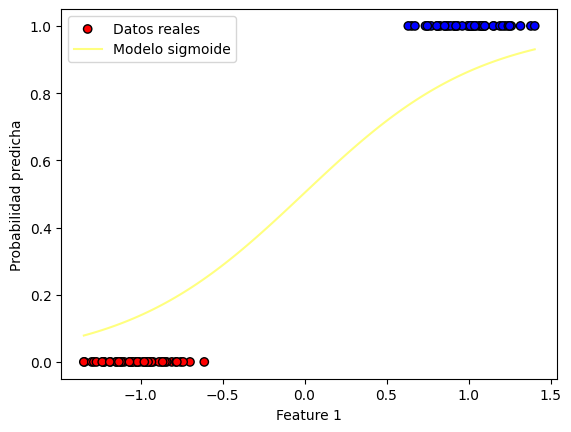

Iteracion: 723
Costo en la iteración 723: 0.15175791417237516
Valor del gradiente 723: [-0.00169891 -0.13414535]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01209033 1.84019607]


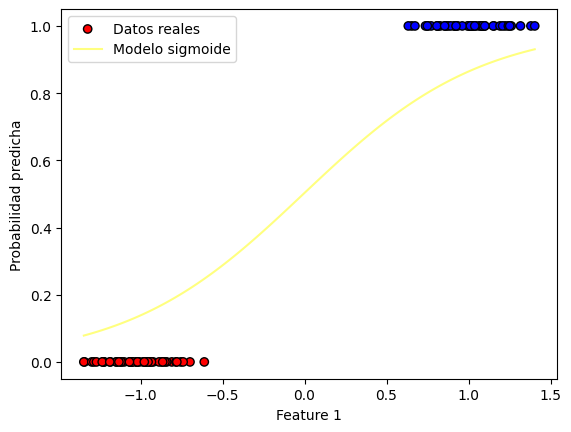

Iteracion: 724
Costo en la iteración 724: 0.15157803881631235
Valor del gradiente 724: [-0.00169789 -0.13399144]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01210731 1.84153598]


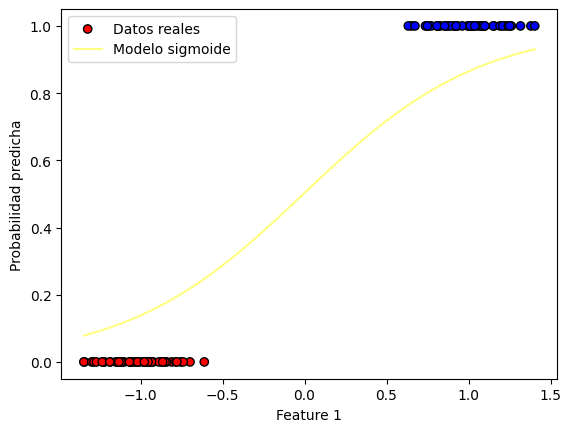

Iteracion: 725
Costo en la iteración 725: 0.15139857583263489
Valor del gradiente 725: [-0.00169687 -0.13383787]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01212428 1.84287436]


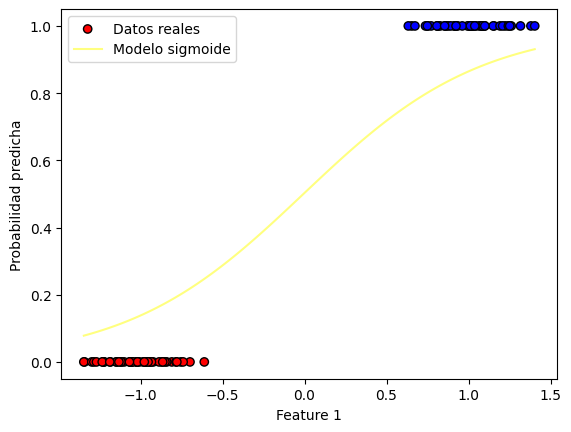

Iteracion: 726
Costo en la iteración 726: 0.15121952385495552
Valor del gradiente 726: [-0.00169585 -0.13368463]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01214124 1.84421121]


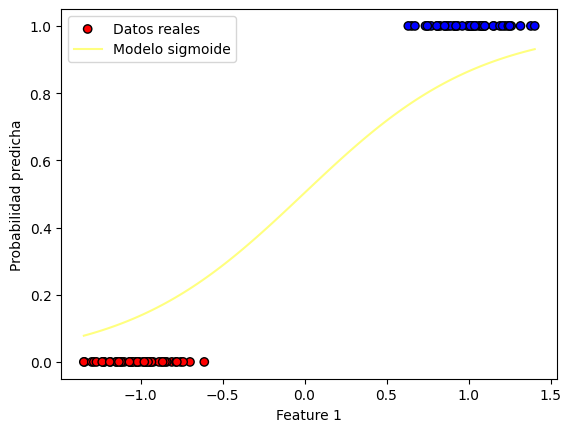

Iteracion: 727
Costo en la iteración 727: 0.15104088152271603
Valor del gradiente 727: [-0.00169483 -0.13353172]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01215819 1.84554653]


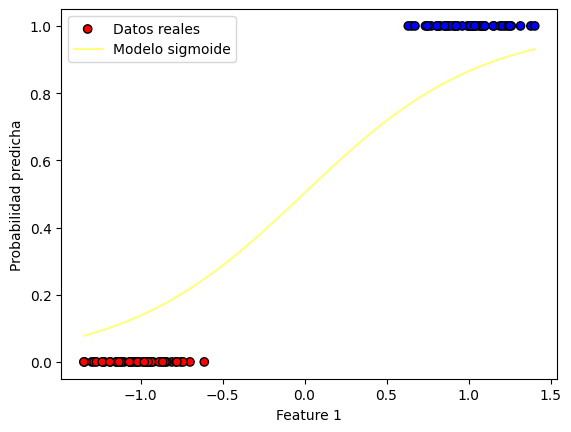

Iteracion: 728
Costo en la iteración 728: 0.15086264748115774
Valor del gradiente 728: [-0.00169381 -0.13337915]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01217513 1.84688032]


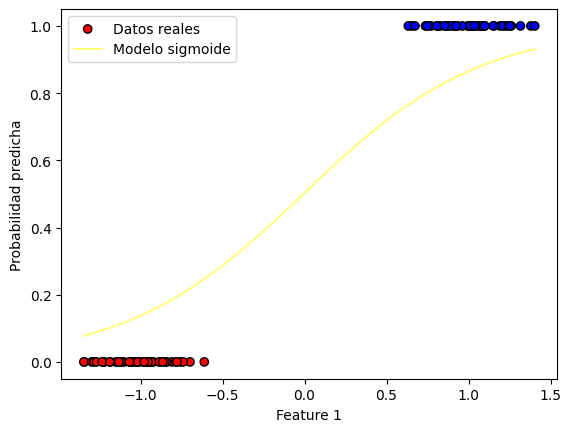

Iteracion: 729
Costo en la iteración 729: 0.15068482038129133
Valor del gradiente 729: [-0.00169279 -0.1332269 ]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01219205 1.84821259]


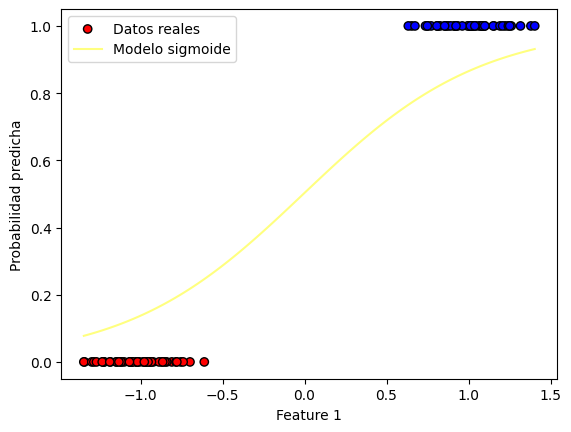

Iteracion: 730
Costo en la iteración 730: 0.15050739887986717
Valor del gradiente 730: [-0.00169177 -0.13307498]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01220897 1.84954334]


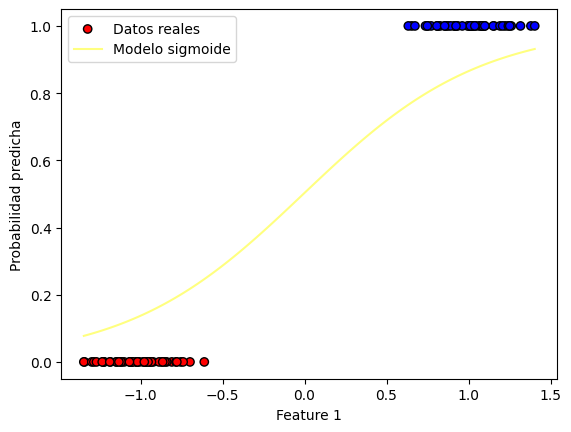

Iteracion: 731
Costo en la iteración 731: 0.15033038163934584
Valor del gradiente 731: [-0.00169075 -0.13292339]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01222588 1.85087257]


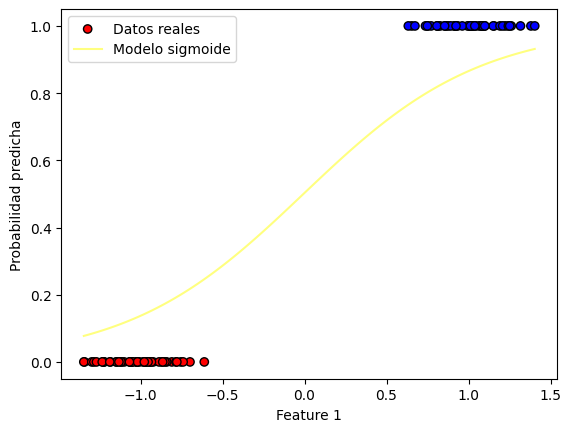

Iteracion: 732
Costo en la iteración 732: 0.1501537673278688
Valor del gradiente 732: [-0.00168973 -0.13277213]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01224278 1.85220029]


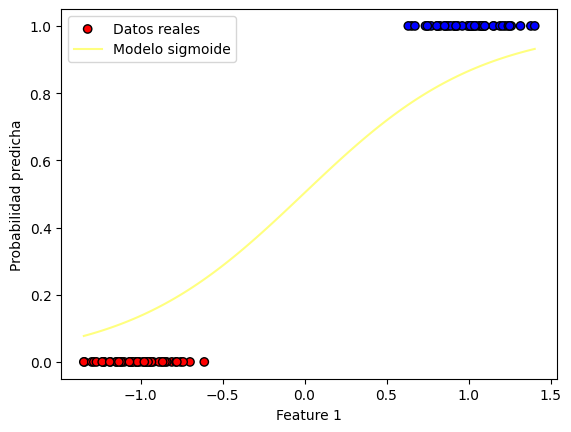

Iteracion: 733
Costo en la iteración 733: 0.14997755461922918
Valor del gradiente 733: [-0.00168872 -0.13262119]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01225966 1.8535265 ]


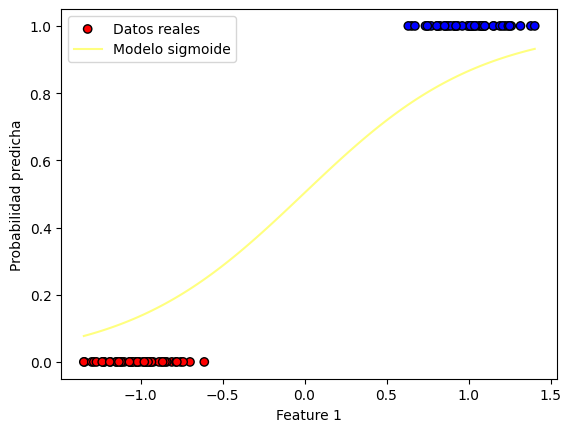

Iteracion: 734
Costo en la iteración 734: 0.14980174219284303
Valor del gradiente 734: [-0.0016877  -0.13247058]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01227654 1.85485121]


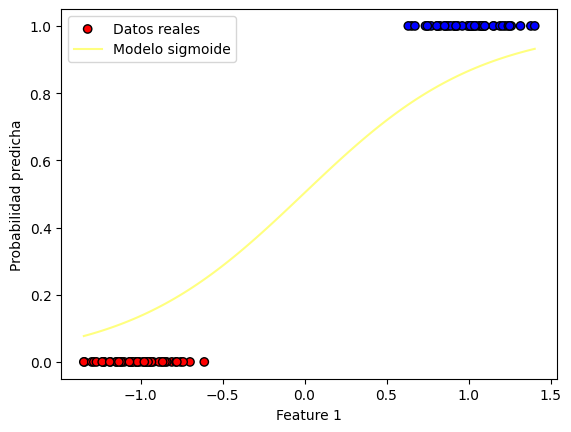

Iteracion: 735
Costo en la iteración 735: 0.14962632873372006
Valor del gradiente 735: [-0.00168668 -0.13232029]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01229341 1.85617441]


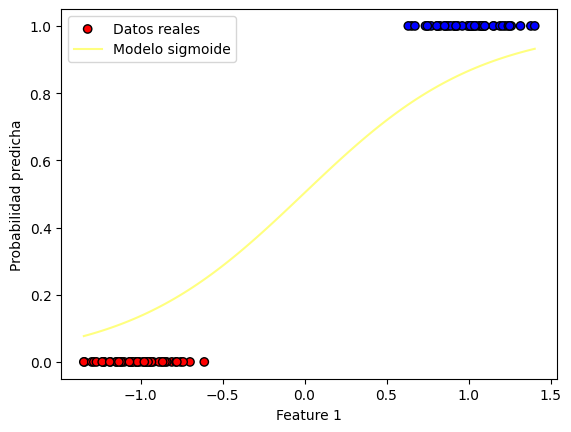

Iteracion: 736
Costo en la iteración 736: 0.14945131293243546
Valor del gradiente 736: [-0.00168566 -0.13217033]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01231026 1.85749612]


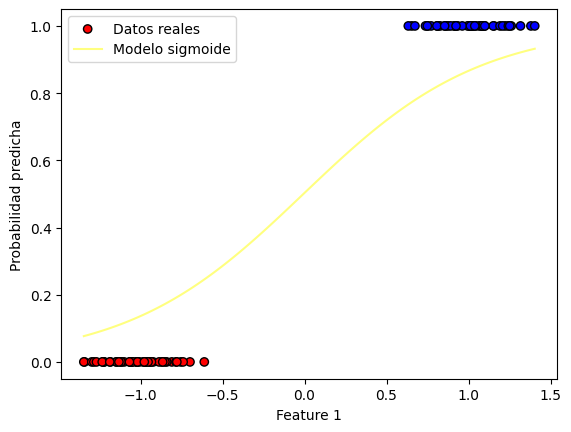

Iteracion: 737
Costo en la iteración 737: 0.14927669348510095
Valor del gradiente 737: [-0.00168465 -0.13202068]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01232711 1.85881632]


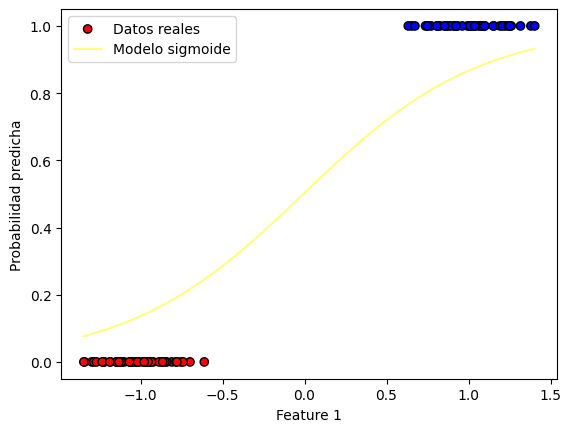

Iteracion: 738
Costo en la iteración 738: 0.14910246909333694
Valor del gradiente 738: [-0.00168363 -0.13187136]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01234395 1.86013504]


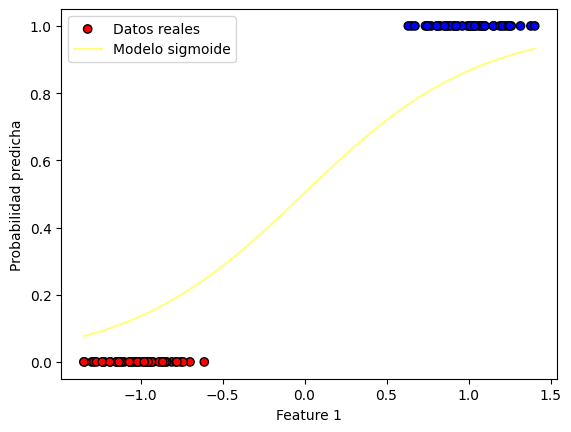

Iteracion: 739
Costo en la iteración 739: 0.1489286384642441
Valor del gradiente 739: [-0.00168261 -0.13172236]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01236077 1.86145226]


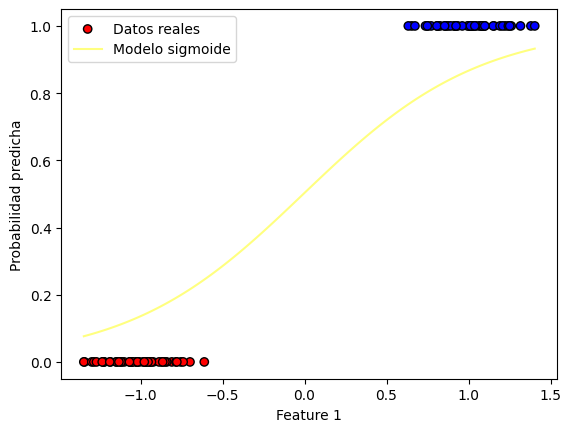

Iteracion: 740
Costo en la iteración 740: 0.14875520031037545
Valor del gradiente 740: [-0.0016816  -0.13157367]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01237759 1.862768  ]


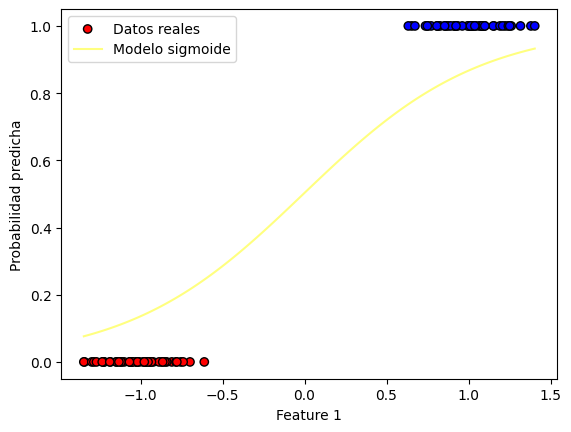

Iteracion: 741
Costo en la iteración 741: 0.14858215334970856
Valor del gradiente 741: [-0.00168058 -0.13142531]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01239439 1.86408225]


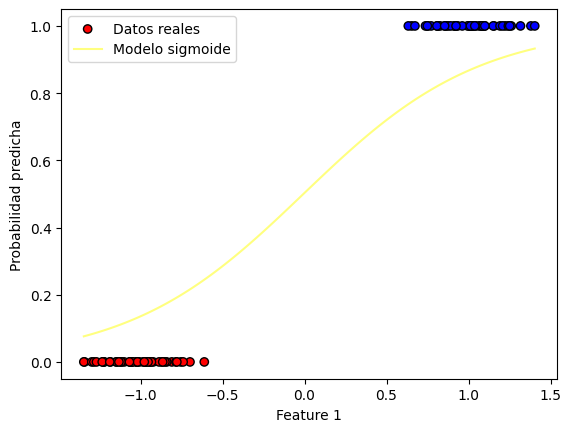

Iteracion: 742
Costo en la iteración 742: 0.14840949630561803
Valor del gradiente 742: [-0.00167957 -0.13127726]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01241119 1.86539502]


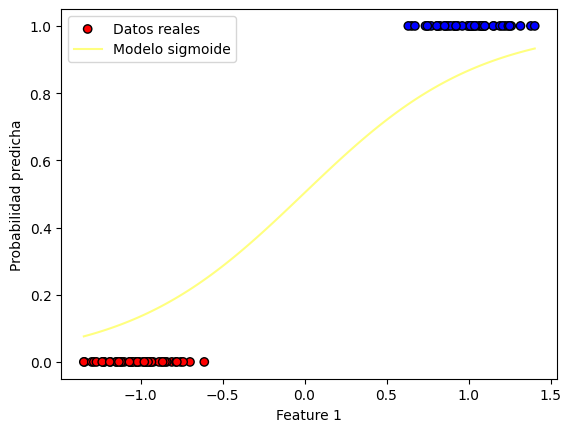

Iteracion: 743
Costo en la iteración 743: 0.1482372279068477
Valor del gradiente 743: [-0.00167855 -0.13112952]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01242798 1.86670632]


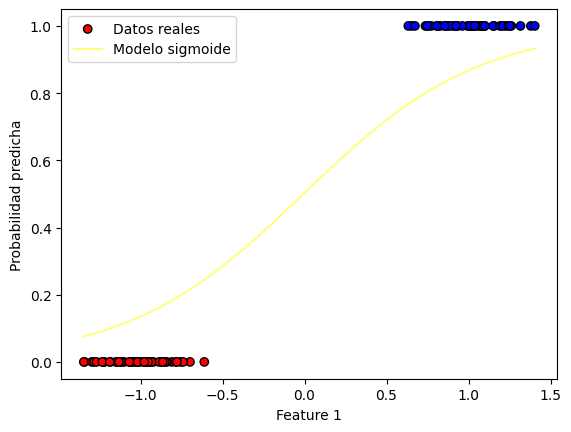

Iteracion: 744
Costo en la iteración 744: 0.14806534688748377
Valor del gradiente 744: [-0.00167754 -0.13098211]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01244475 1.86801614]


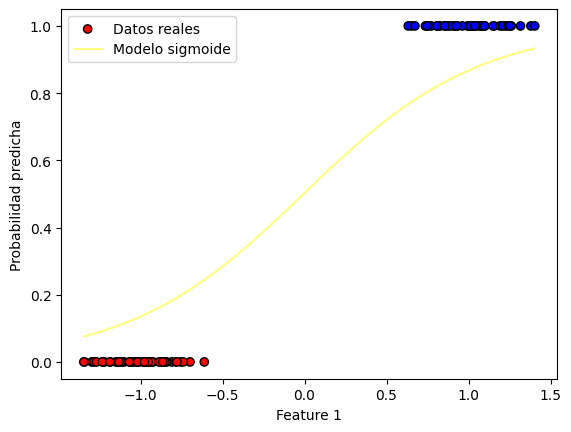

Iteracion: 745
Costo en la iteración 745: 0.14789385198692717
Valor del gradiente 745: [-0.00167652 -0.130835  ]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01246152 1.86932449]


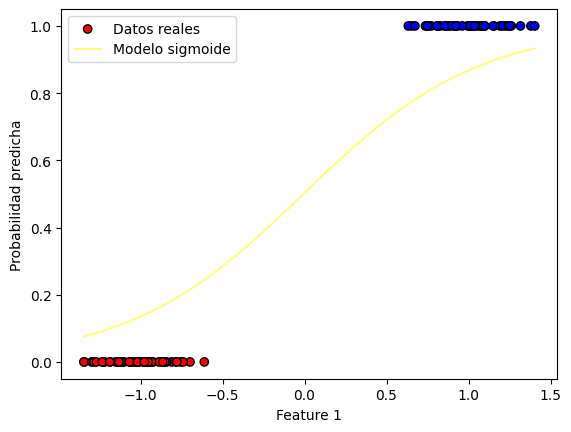

Iteracion: 746
Costo en la iteración 746: 0.14772274194986698
Valor del gradiente 746: [-0.00167551 -0.13068821]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01247827 1.87063137]


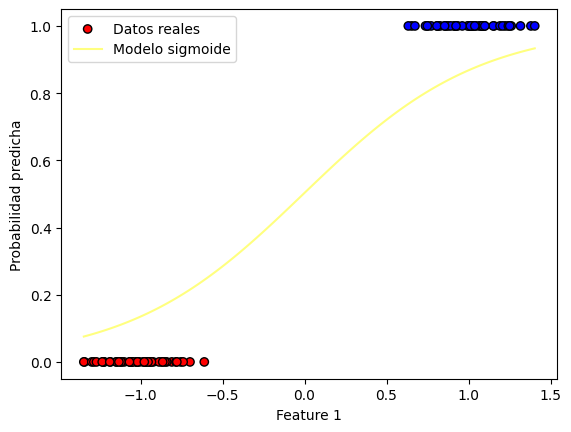

Iteracion: 747
Costo en la iteración 747: 0.14755201552625338
Valor del gradiente 747: [-0.0016745  -0.13054173]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01249502 1.87193679]


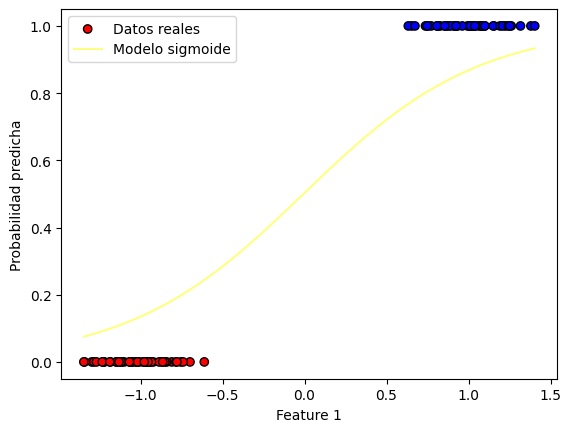

Iteracion: 748
Costo en la iteración 748: 0.14738167147127093
Valor del gradiente 748: [-0.00167348 -0.13039557]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01251175 1.87324074]


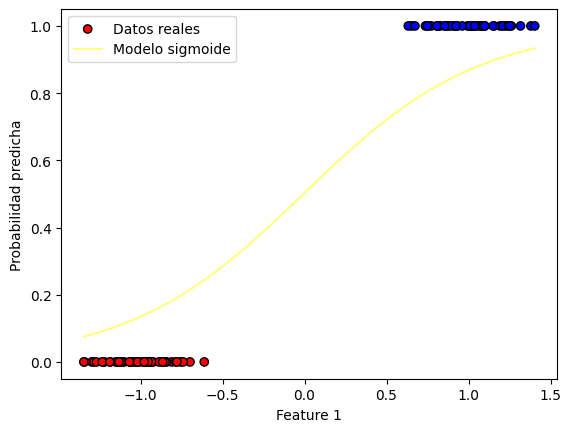

Iteracion: 749
Costo en la iteración 749: 0.14721170854531215
Valor del gradiente 749: [-0.00167247 -0.13024971]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01252848 1.87454324]


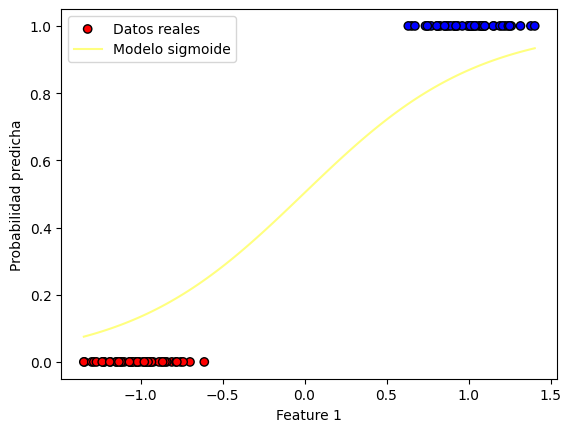

Iteracion: 750
Costo en la iteración 750: 0.14704212551395132
Valor del gradiente 750: [-0.00167146 -0.13010416]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01254519 1.87584428]


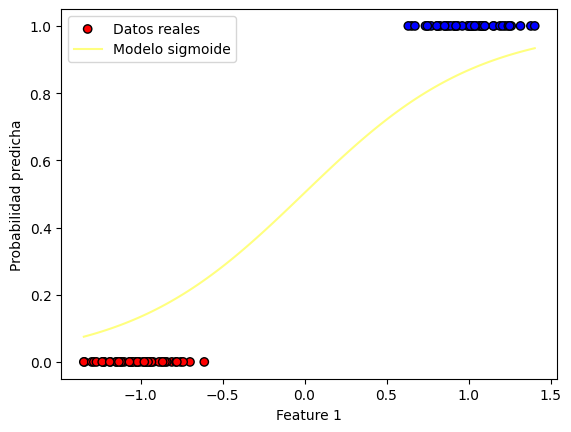

Iteracion: 751
Costo en la iteración 751: 0.1468729211479178
Valor del gradiente 751: [-0.00167045 -0.12995892]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.0125619  1.87714387]


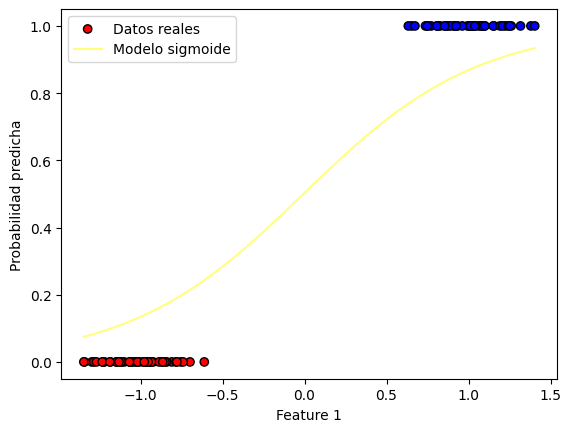

Iteracion: 752
Costo en la iteración 752: 0.1467040942230705
Valor del gradiente 752: [-0.00166944 -0.12981399]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01257859 1.87844201]


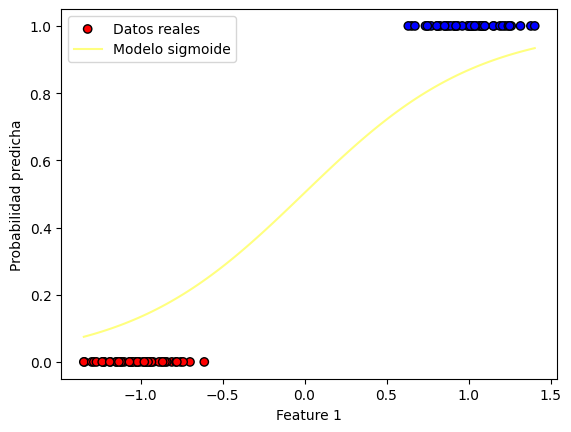

Iteracion: 753
Costo en la iteración 753: 0.14653564352037157
Valor del gradiente 753: [-0.00166843 -0.12966937]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01259527 1.87973871]


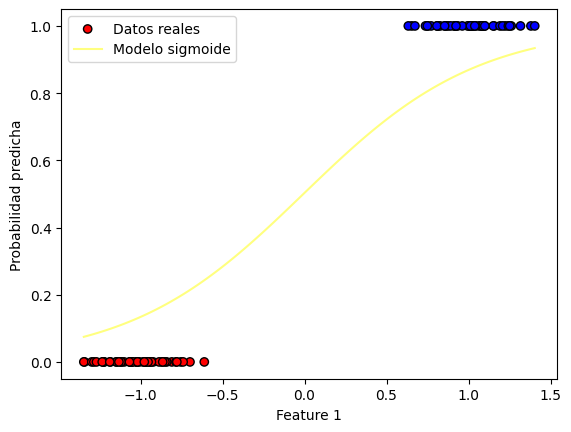

Iteracion: 754
Costo en la iteración 754: 0.1463675678258609
Valor del gradiente 754: [-0.00166742 -0.12952505]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01261195 1.88103396]


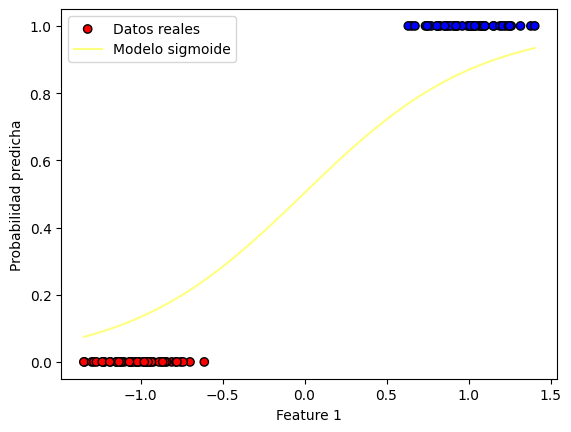

Iteracion: 755
Costo en la iteración 755: 0.14619986593063053
Valor del gradiente 755: [-0.00166641 -0.12938103]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01262861 1.88232777]


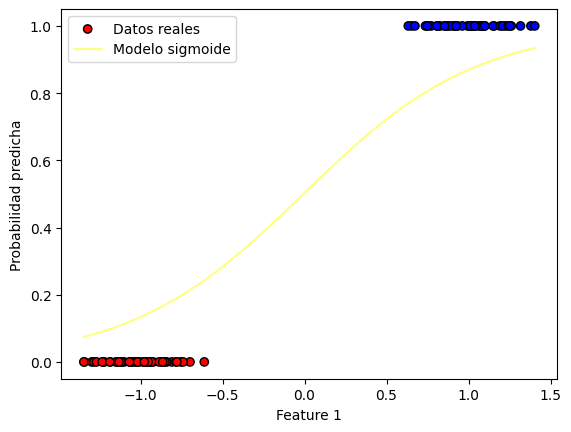

Iteracion: 756
Costo en la iteración 756: 0.14603253663079888
Valor del gradiente 756: [-0.0016654  -0.12923732]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01264527 1.88362014]


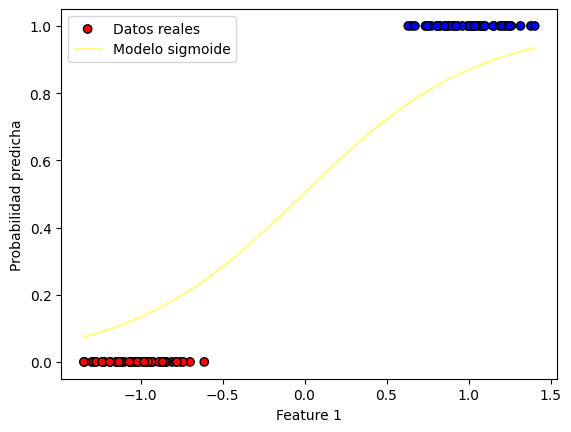

Iteracion: 757
Costo en la iteración 757: 0.14586557872748587
Valor del gradiente 757: [-0.00166439 -0.12909392]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01266191 1.88491108]


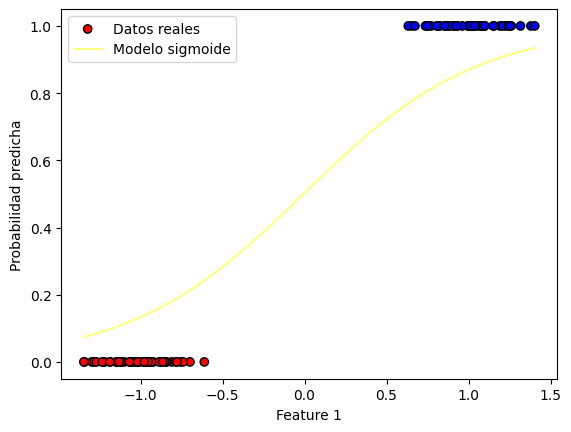

Iteracion: 758
Costo en la iteración 758: 0.14569899102678754
Valor del gradiente 758: [-0.00166338 -0.12895081]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01267854 1.88620059]


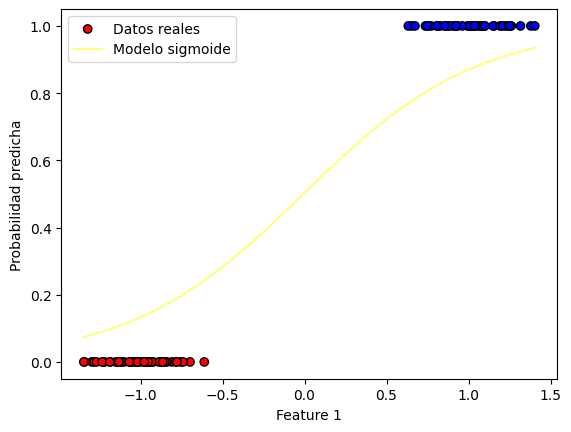

Iteracion: 759
Costo en la iteración 759: 0.14553277233975104
Valor del gradiente 759: [-0.00166237 -0.12880801]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01269517 1.88748867]


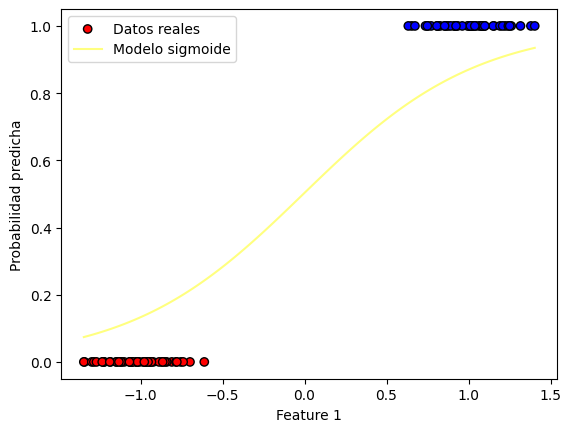

Iteracion: 760
Costo en la iteración 760: 0.1453669214823498
Valor del gradiente 760: [-0.00166136 -0.1286655 ]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01271178 1.88877532]


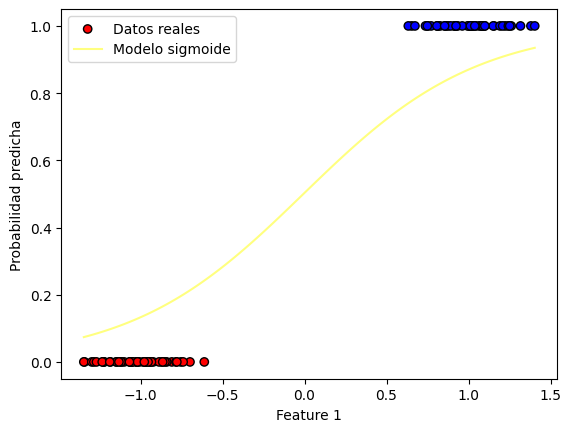

Iteracion: 761
Costo en la iteración 761: 0.14520143727545892
Valor del gradiente 761: [-0.00166035 -0.1285233 ]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01272838 1.89006056]


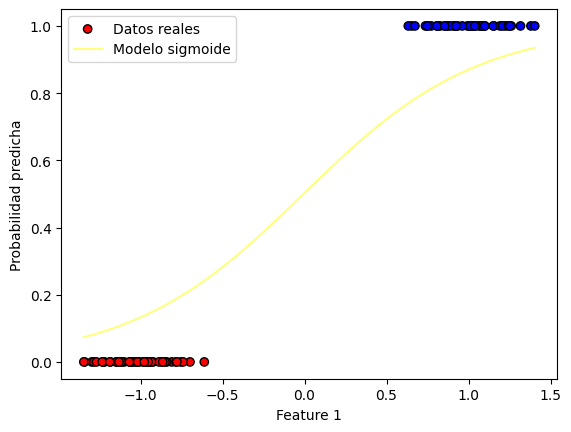

Iteracion: 762
Costo en la iteración 762: 0.14503631854483046
Valor del gradiente 762: [-0.00165935 -0.12838139]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01274498 1.89134437]


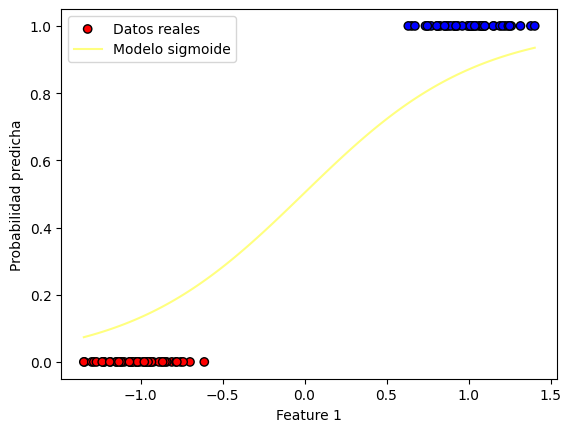

Iteracion: 763
Costo en la iteración 763: 0.14487156412106894
Valor del gradiente 763: [-0.00165834 -0.12823978]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01276156 1.89262677]


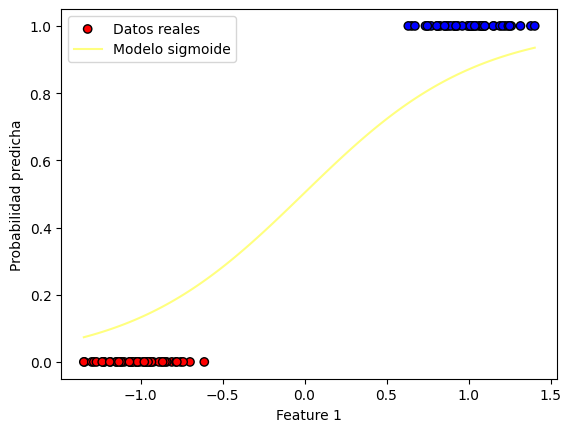

Iteracion: 764
Costo en la iteración 764: 0.14470717283960738
Valor del gradiente 764: [-0.00165733 -0.12809847]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01277813 1.89390775]


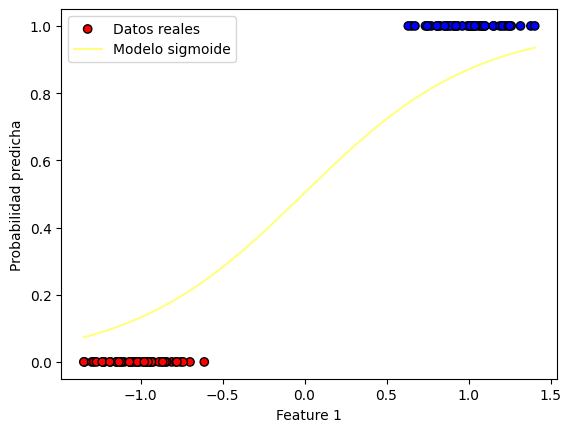

Iteracion: 765
Costo en la iteración 765: 0.14454314354068282
Valor del gradiente 765: [-0.00165633 -0.12795745]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.0127947  1.89518733]


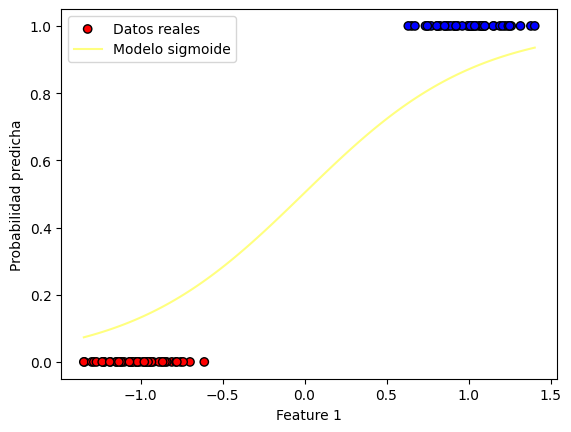

Iteracion: 766
Costo en la iteración 766: 0.14437947506931242
Valor del gradiente 766: [-0.00165532 -0.12781673]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01281125 1.89646549]


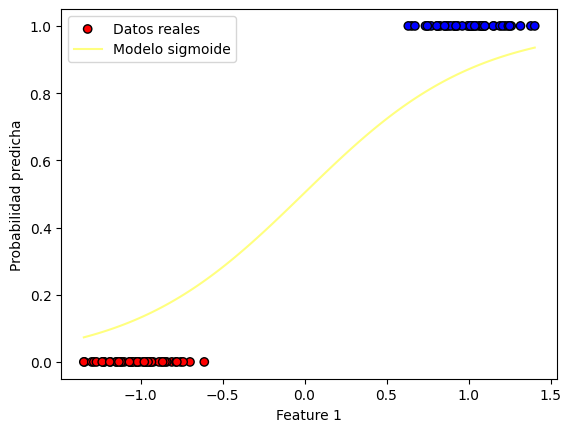

Iteracion: 767
Costo en la iteración 767: 0.1442161662752698
Valor del gradiente 767: [-0.00165432 -0.1276763 ]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01282779 1.89774226]


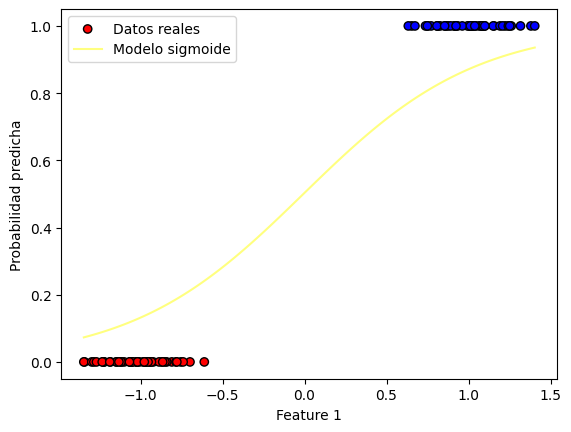

Iteracion: 768
Costo en la iteración 768: 0.14405321601306098
Valor del gradiente 768: [-0.00165331 -0.12753617]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01284433 1.89901762]


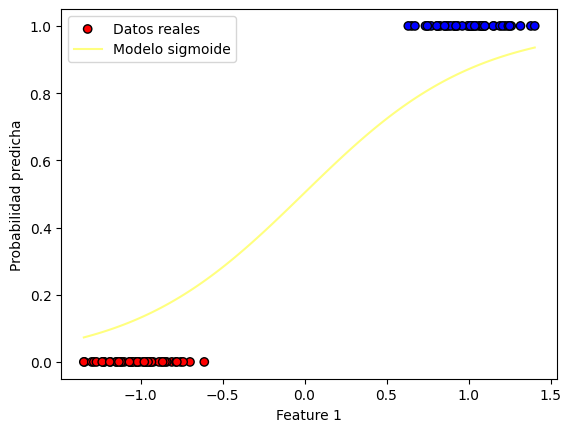

Iteracion: 769
Costo en la iteración 769: 0.14389062314190093
Valor del gradiente 769: [-0.00165231 -0.12739632]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01286085 1.90029158]


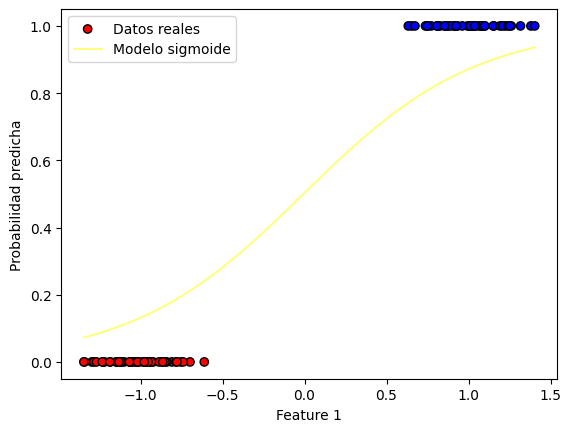

Iteracion: 770
Costo en la iteración 770: 0.1437283865256902
Valor del gradiente 770: [-0.0016513  -0.12725677]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01287736 1.90156415]


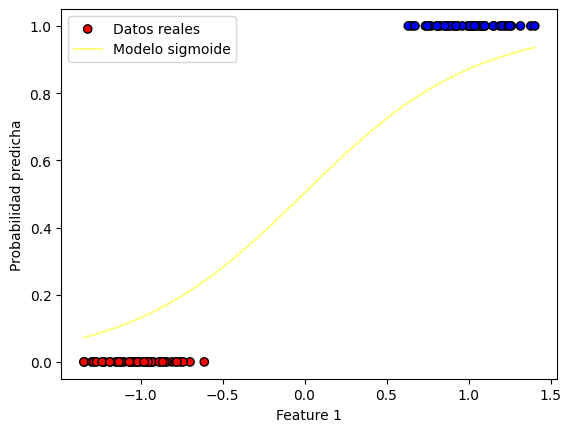

Iteracion: 771
Costo en la iteración 771: 0.14356650503299156
Valor del gradiente 771: [-0.0016503  -0.12711751]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01289387 1.90283532]


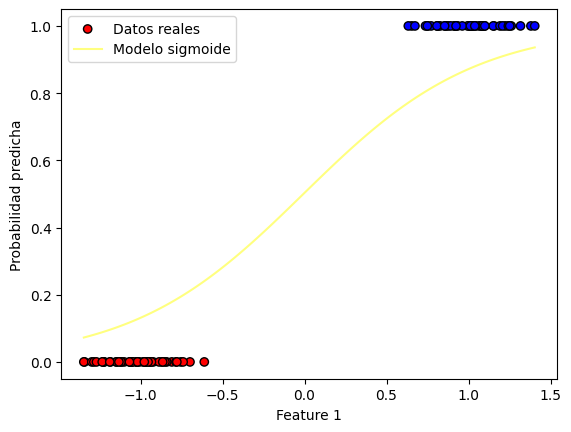

Iteracion: 772
Costo en la iteración 772: 0.14340497753700676
Valor del gradiente 772: [-0.0016493  -0.12697854]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01291036 1.90410511]


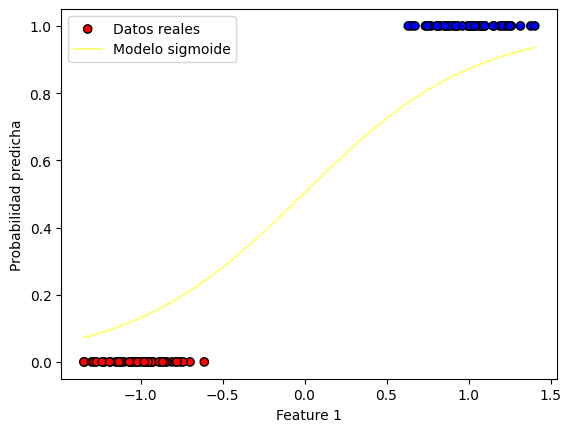

Iteracion: 773
Costo en la iteración 773: 0.14324380291555355
Valor del gradiente 773: [-0.0016483  -0.12683986]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01292684 1.90537351]


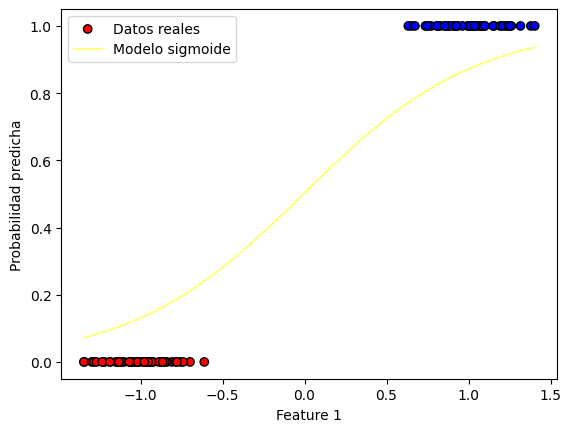

Iteracion: 774
Costo en la iteración 774: 0.14308298005104278
Valor del gradiente 774: [-0.00164729 -0.12670146]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01294332 1.90664052]


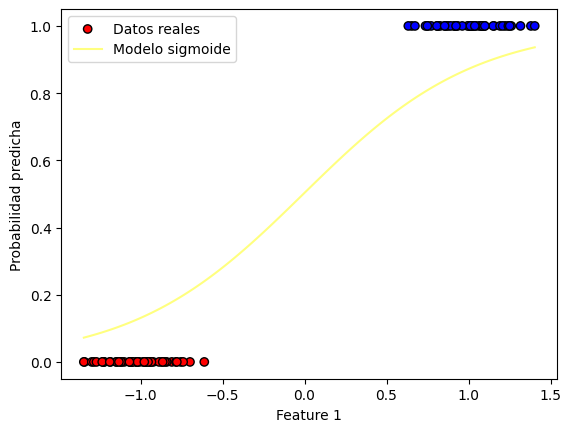

Iteracion: 775
Costo en la iteración 775: 0.1429225078304555
Valor del gradiente 775: [-0.00164629 -0.12656335]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01295978 1.90790616]


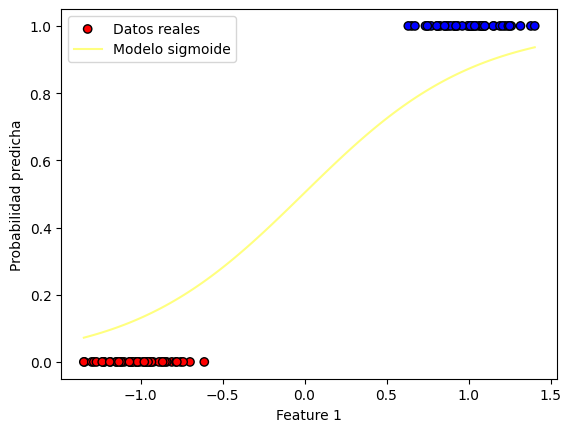

Iteracion: 776
Costo en la iteración 776: 0.14276238514532036
Valor del gradiente 776: [-0.00164529 -0.12642553]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01297623 1.90917041]


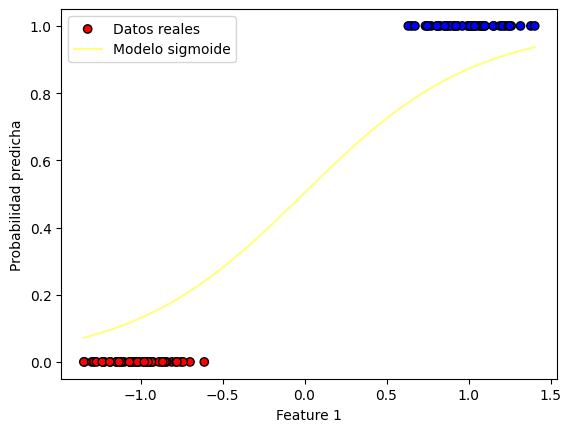

Iteracion: 777
Costo en la iteración 777: 0.14260261089169124
Valor del gradiente 777: [-0.00164429 -0.12628799]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01299267 1.91043329]


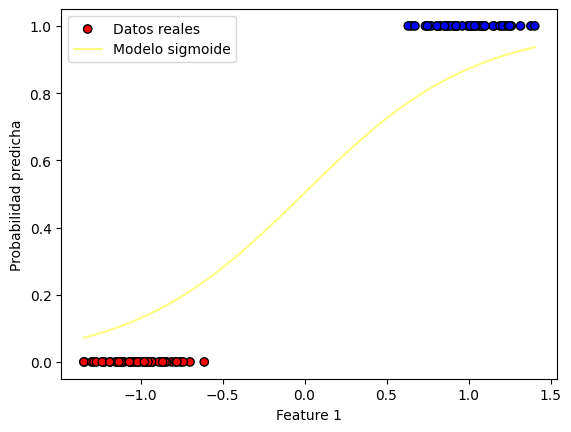

Iteracion: 778
Costo en la iteración 778: 0.1424431839701247
Valor del gradiente 778: [-0.00164329 -0.12615074]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01300911 1.9116948 ]


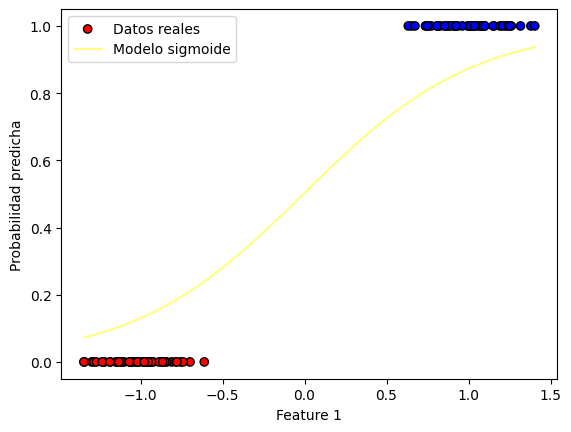

Iteracion: 779
Costo en la iteración 779: 0.1422841032856577
Valor del gradiente 779: [-0.00164229 -0.12601377]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01302553 1.91295494]


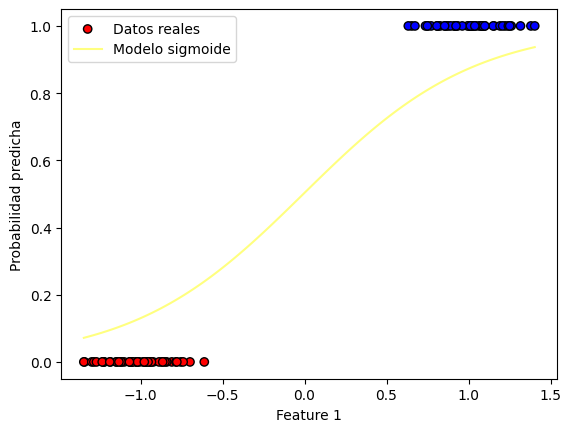

Iteracion: 780
Costo en la iteración 780: 0.14212536774778564
Valor del gradiente 780: [-0.00164129 -0.12587709]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01304194 1.91421371]


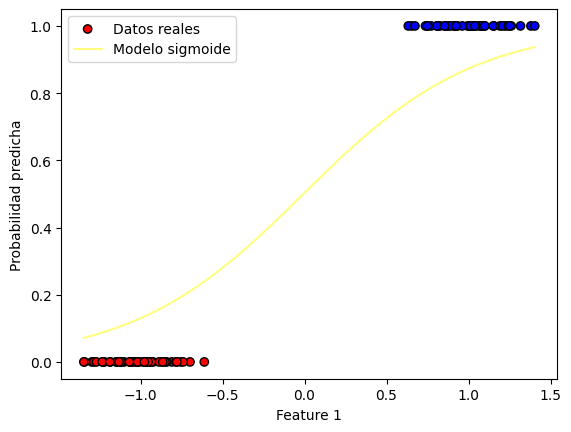

Iteracion: 781
Costo en la iteración 781: 0.14196697627044014
Valor del gradiente 781: [-0.0016403  -0.12574068]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01305835 1.91547111]


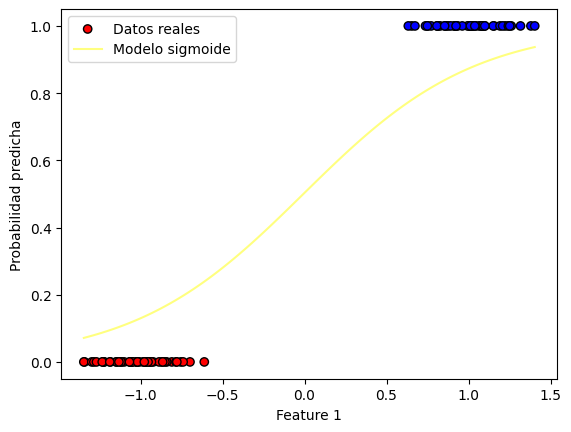

Iteracion: 782
Costo en la iteración 782: 0.1418089277719673
Valor del gradiente 782: [-0.0016393  -0.12560456]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01307474 1.91672716]


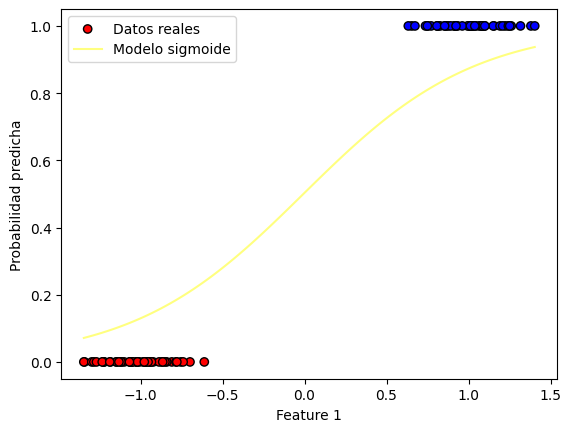

Iteracion: 783
Costo en la iteración 783: 0.14165122117510595
Valor del gradiente 783: [-0.0016383  -0.12546872]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01309112 1.91798185]


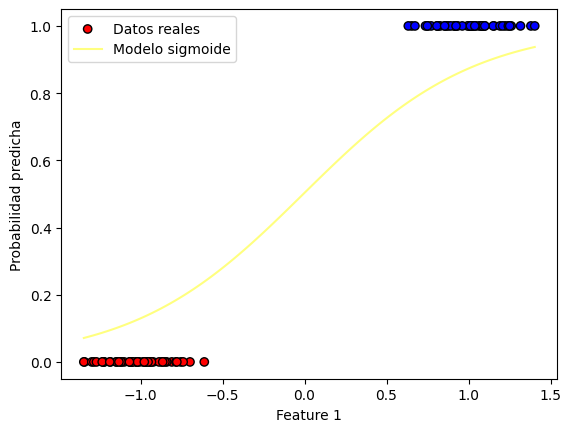

Iteracion: 784
Costo en la iteración 784: 0.1414938554069659
Valor del gradiente 784: [-0.0016373  -0.12533316]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.0131075  1.91923518]


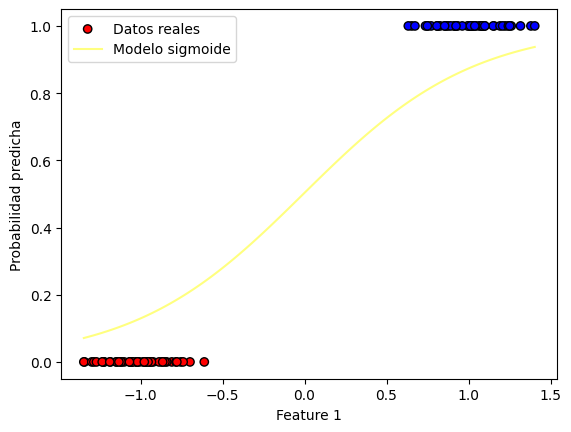

Iteracion: 785
Costo en la iteración 785: 0.1413368293990066
Valor del gradiente 785: [-0.00163631 -0.12519787]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01312386 1.92048716]


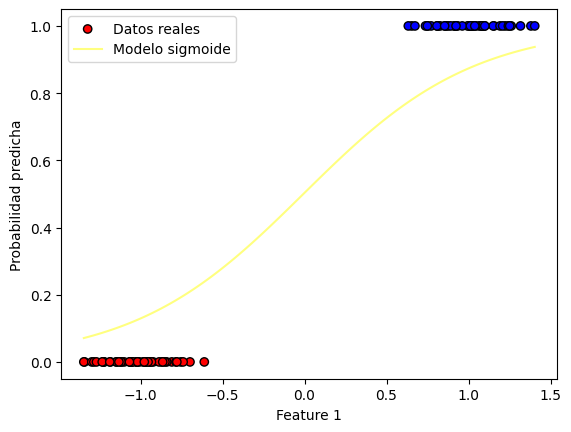

Iteracion: 786
Costo en la iteración 786: 0.14118014208701565
Valor del gradiente 786: [-0.00163531 -0.12506287]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01314021 1.92173779]


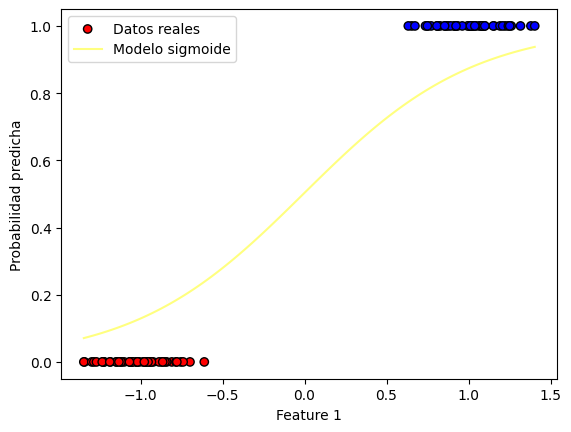

Iteracion: 787
Costo en la iteración 787: 0.14102379241108753
Valor del gradiente 787: [-0.00163432 -0.12492814]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01315655 1.92298707]


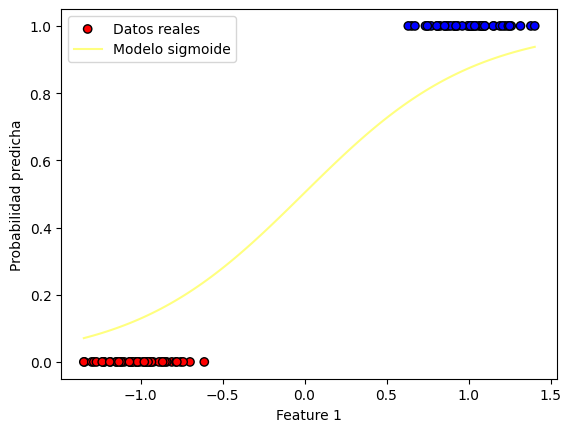

Iteracion: 788
Costo en la iteración 788: 0.14086777931560257
Valor del gradiente 788: [-0.00163332 -0.12479368]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01317289 1.924235  ]


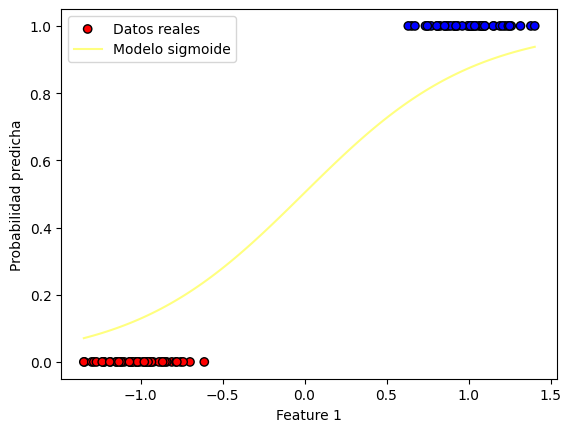

Iteracion: 789
Costo en la iteración 789: 0.14071210174920581
Valor del gradiente 789: [-0.00163233 -0.12465951]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01318921 1.9254816 ]


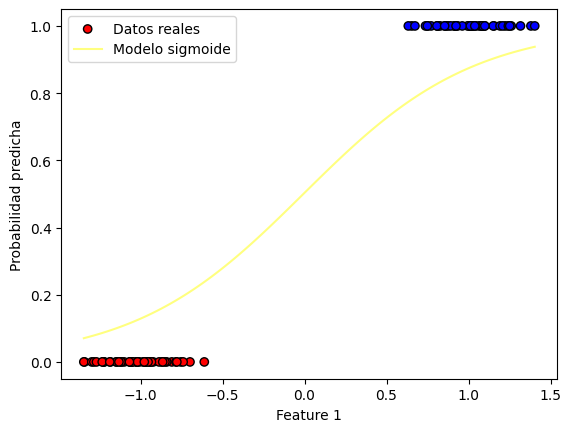

Iteracion: 790
Costo en la iteración 790: 0.14055675866478617
Valor del gradiente 790: [-0.00163133 -0.1245256 ]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01320552 1.92672686]


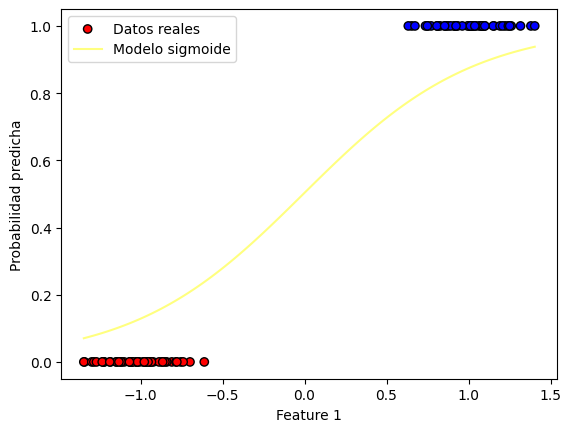

Iteracion: 791
Costo en la iteración 791: 0.14040174901945562
Valor del gradiente 791: [-0.00163034 -0.12439197]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01322183 1.92797077]


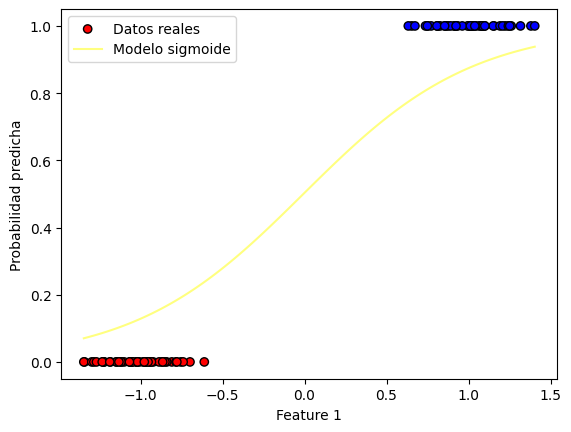

Iteracion: 792
Costo en la iteración 792: 0.14024707177452866
Valor del gradiente 792: [-0.00162935 -0.12425862]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01323812 1.92921336]


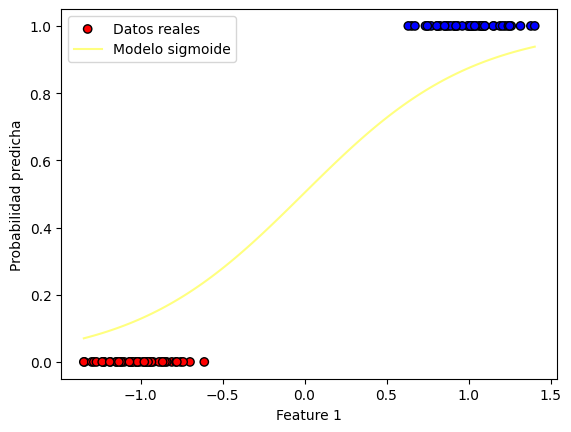

Iteracion: 793
Costo en la iteración 793: 0.14009272589550162
Valor del gradiente 793: [-0.00162835 -0.12412553]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.0132544  1.93045462]


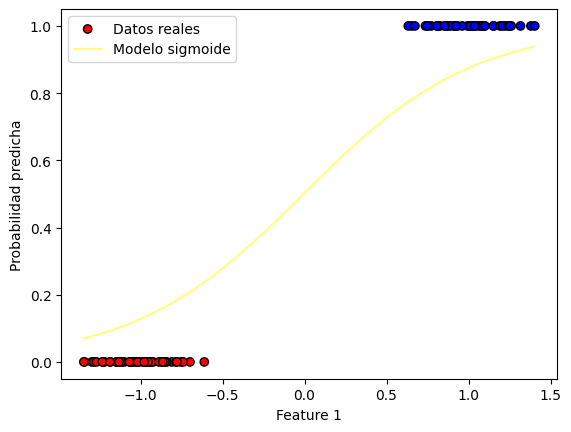

Iteracion: 794
Costo en la iteración 794: 0.13993871035203223
Valor del gradiente 794: [-0.00162736 -0.12399272]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01327068 1.93169454]


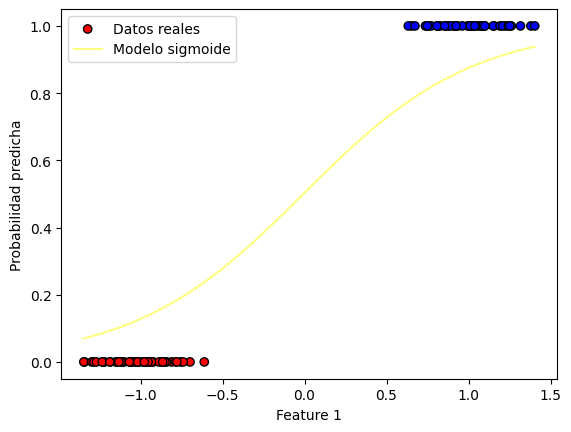

Iteracion: 795
Costo en la iteración 795: 0.1397850241179195
Valor del gradiente 795: [-0.00162637 -0.12386018]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01328694 1.93293315]


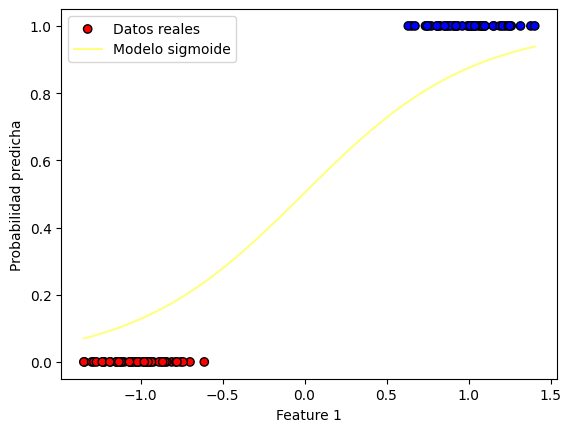

Iteracion: 796
Costo en la iteración 796: 0.13963166617108327
Valor del gradiente 796: [-0.00162538 -0.1237279 ]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.0133032  1.93417042]


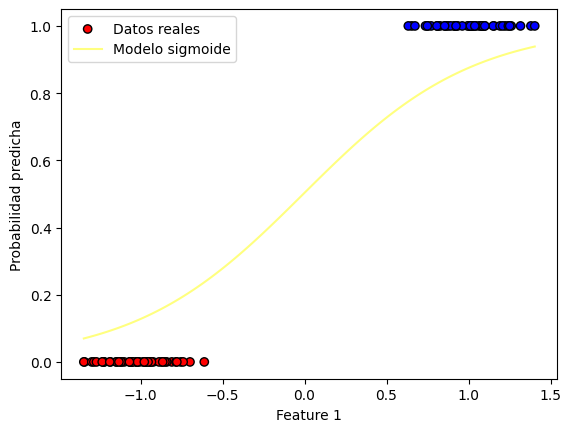

Iteracion: 797
Costo en la iteración 797: 0.13947863549354445
Valor del gradiente 797: [-0.00162439 -0.1235959 ]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01331944 1.93540638]


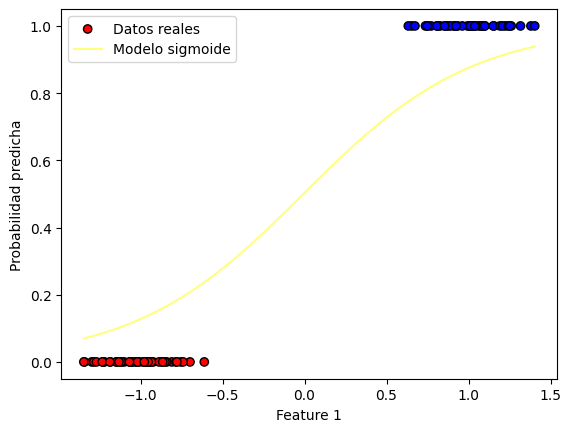

Iteracion: 798
Costo en la iteración 798: 0.1393259310714046
Valor del gradiente 798: [-0.0016234  -0.12346417]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01333567 1.93664103]


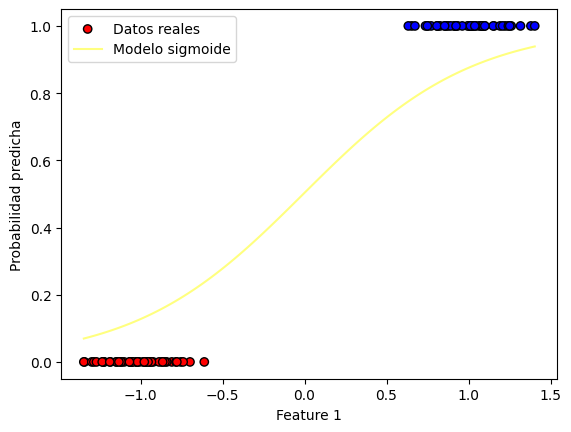

Iteracion: 799
Costo en la iteración 799: 0.13917355189482652
Valor del gradiente 799: [-0.00162241 -0.1233327 ]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.0133519  1.93787435]


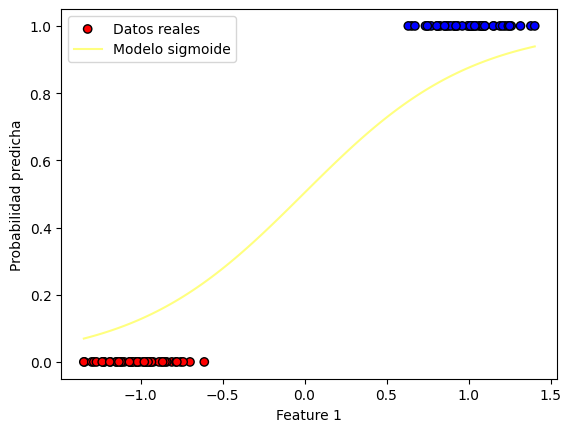

Iteracion: 800
Costo en la iteración 800: 0.1390214969580145
Valor del gradiente 800: [-0.00162142 -0.1232015 ]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01336811 1.93910637]


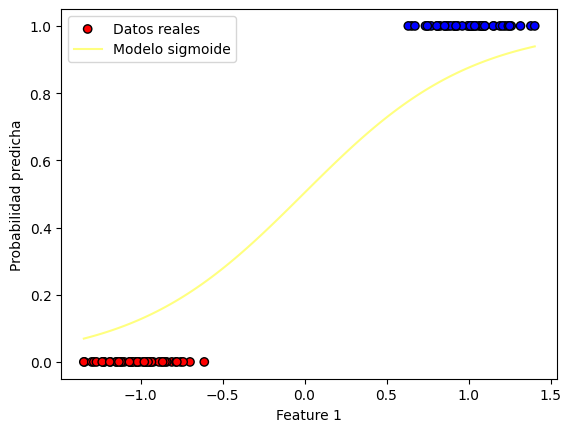

Iteracion: 801
Costo en la iteración 801: 0.13886976525919412
Valor del gradiente 801: [-0.00162044 -0.12307056]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01338432 1.94033707]


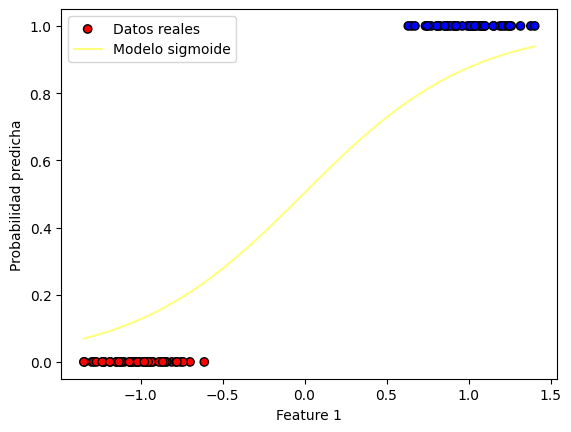

Iteracion: 802
Costo en la iteración 802: 0.1387183558005935
Valor del gradiente 802: [-0.00161945 -0.12293989]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01340051 1.94156647]


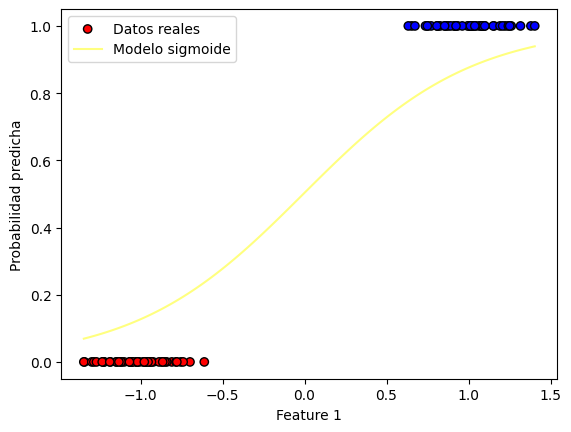

Iteracion: 803
Costo en la iteración 803: 0.13856726758842342
Valor del gradiente 803: [-0.00161846 -0.12280948]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.0134167  1.94279457]


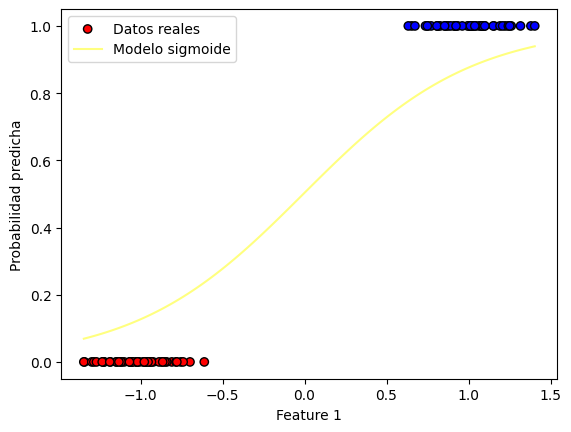

Iteracion: 804
Costo en la iteración 804: 0.13841649963285807
Valor del gradiente 804: [-0.00161748 -0.12267934]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01343287 1.94402136]


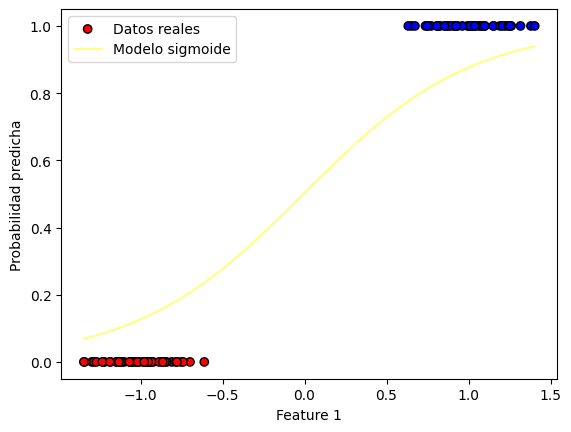

Iteracion: 805
Costo en la iteración 805: 0.13826605094801606
Valor del gradiente 805: [-0.00161649 -0.12254946]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01344904 1.94524685]


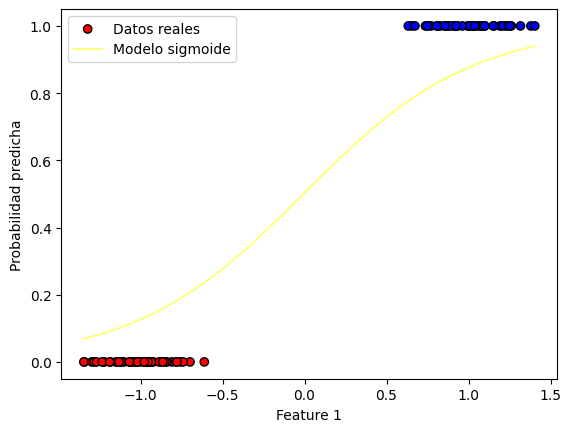

Iteracion: 806
Costo en la iteración 806: 0.1381159205519412
Valor del gradiente 806: [-0.0016155  -0.12241985]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01346519 1.94647105]


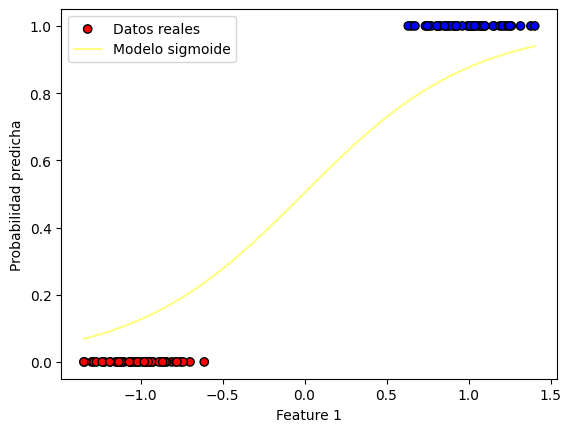

Iteracion: 807
Costo en la iteración 807: 0.13796610746658344
Valor del gradiente 807: [-0.00161452 -0.12229049]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01348134 1.94769396]


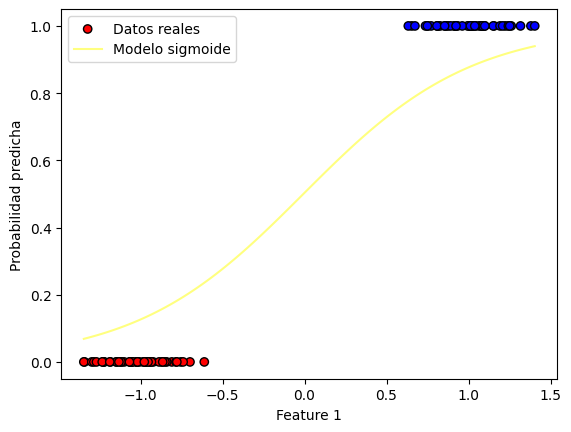

Iteracion: 808
Costo en la iteración 808: 0.13781661071778023
Valor del gradiente 808: [-0.00161354 -0.12216139]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01349747 1.94891557]


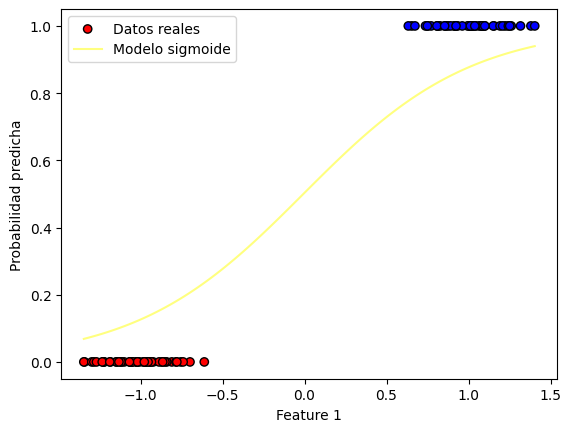

Iteracion: 809
Costo en la iteración 809: 0.13766742933523768
Valor del gradiente 809: [-0.00161255 -0.12203256]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.0135136 1.9501359]


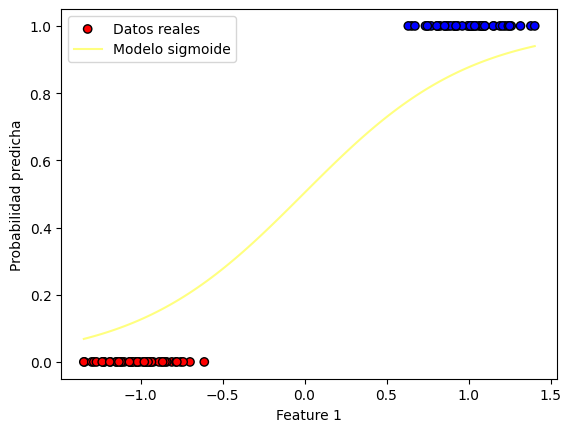

Iteracion: 810
Costo en la iteración 810: 0.1375185623525117
Valor del gradiente 810: [-0.00161157 -0.12190398]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01352971 1.95135494]


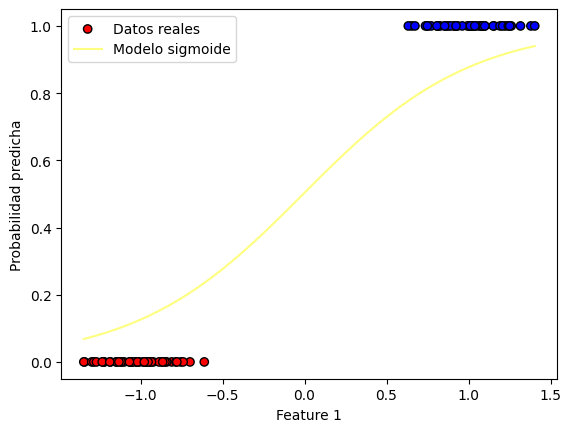

Iteracion: 811
Costo en la iteración 811: 0.13737000880698974
Valor del gradiente 811: [-0.00161059 -0.12177566]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01354582 1.95257269]


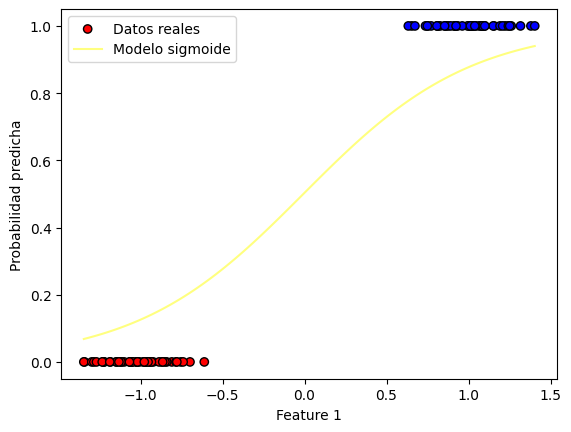

Iteracion: 812
Costo en la iteración 812: 0.13722176773987227
Valor del gradiente 812: [-0.00160961 -0.1216476 ]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01356191 1.95378917]


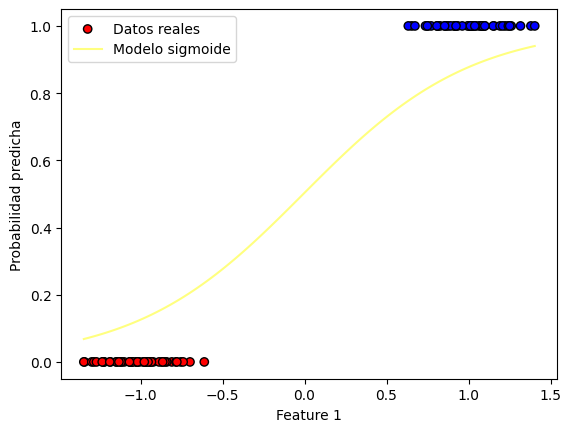

Iteracion: 813
Costo en la iteración 813: 0.13707383819615435
Valor del gradiente 813: [-0.00160862 -0.1215198 ]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.013578   1.95500437]


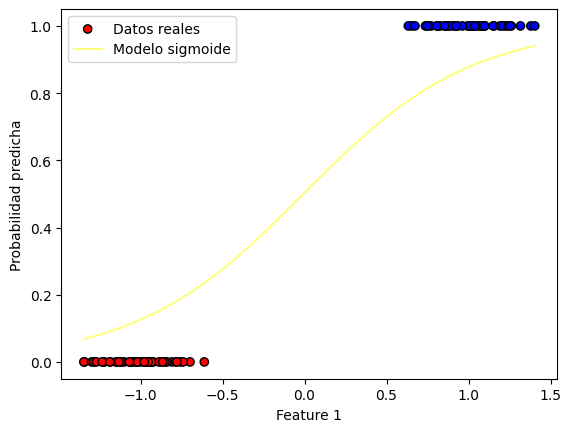

Iteracion: 814
Costo en la iteración 814: 0.13692621922460738
Valor del gradiente 814: [-0.00160764 -0.12139225]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01359408 1.95621829]


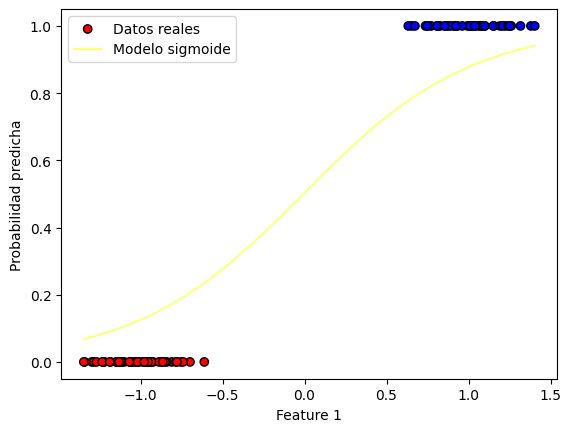

Iteracion: 815
Costo en la iteración 815: 0.13677890987776115
Valor del gradiente 815: [-0.00160666 -0.12126496]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01361014 1.95743094]


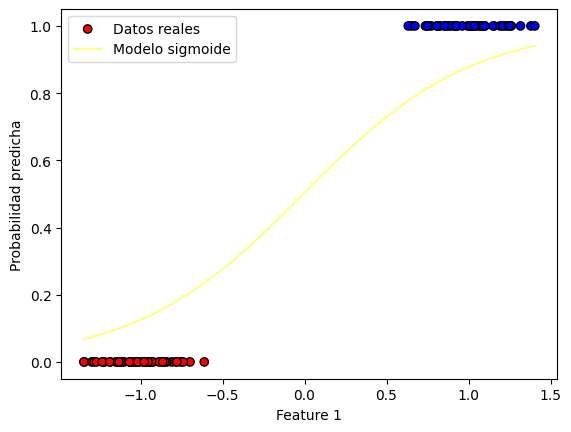

Iteracion: 816
Costo en la iteración 816: 0.13663190921188556
Valor del gradiente 816: [-0.00160568 -0.12113792]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.0136262  1.95864232]


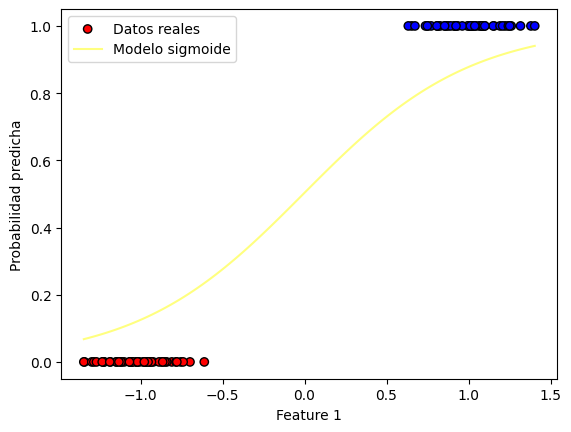

Iteracion: 817
Costo en la iteración 817: 0.13648521628697302
Valor del gradiente 817: [-0.00160471 -0.12101113]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01364225 1.95985243]


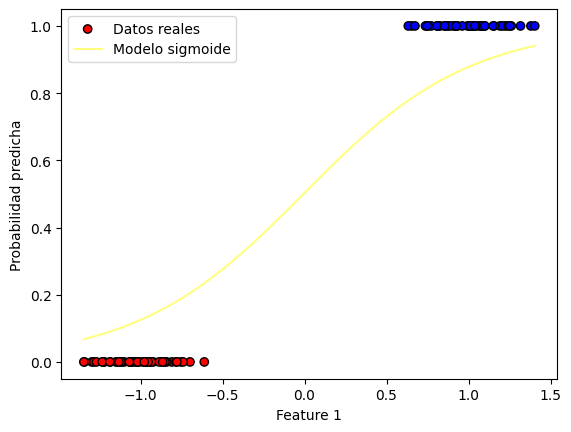

Iteracion: 818
Costo en la iteración 818: 0.13633883016672008
Valor del gradiente 818: [-0.00160373 -0.1208846 ]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01365828 1.96106128]


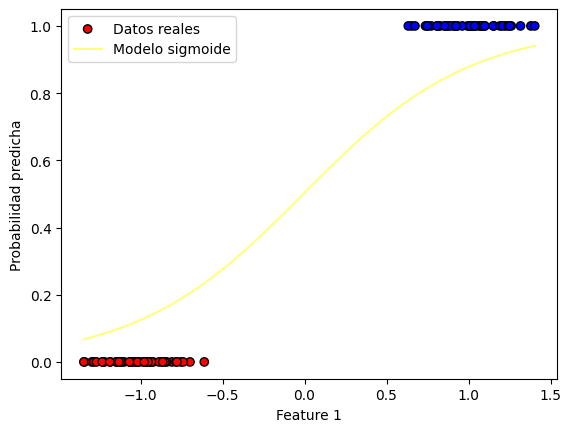

Iteracion: 819
Costo en la iteración 819: 0.1361927499185104
Valor del gradiente 819: [-0.00160275 -0.12075833]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01367431 1.96226886]


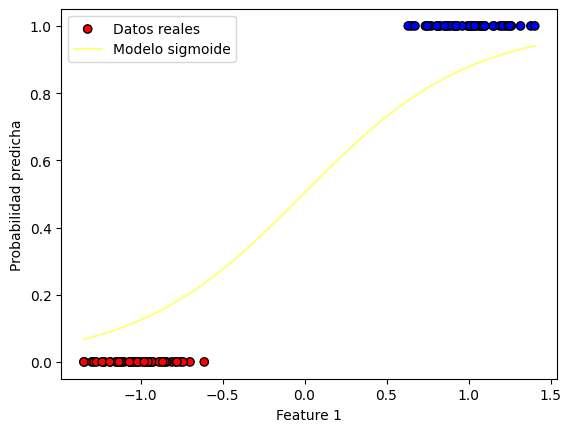

Iteracion: 820
Costo en la iteración 820: 0.13604697461339646
Valor del gradiente 820: [-0.00160177 -0.1206323 ]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01369033 1.96347518]


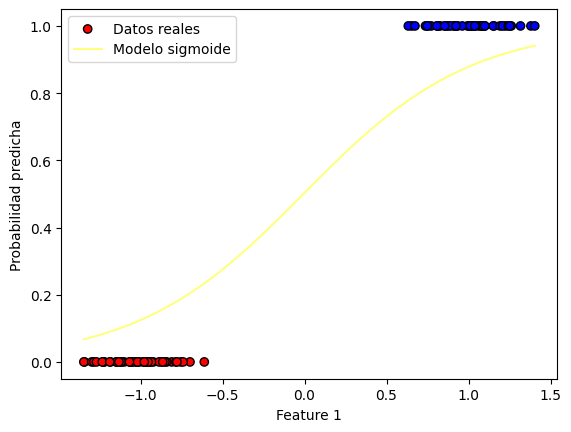

Iteracion: 821
Costo en la iteración 821: 0.13590150332608247
Valor del gradiente 821: [-0.0016008  -0.12050652]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01370634 1.96468025]


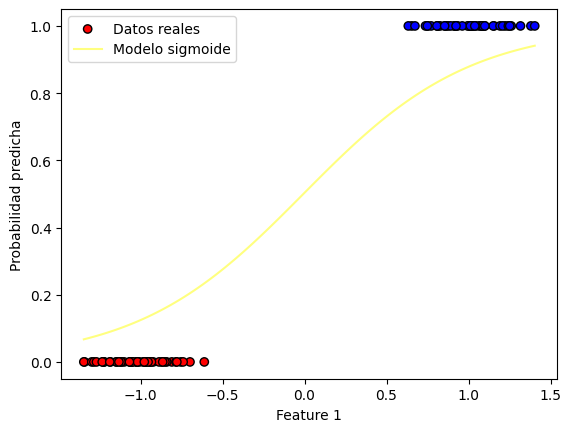

Iteracion: 822
Costo en la iteración 822: 0.13575633513490665
Valor del gradiente 822: [-0.00159982 -0.120381  ]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01372234 1.96588406]


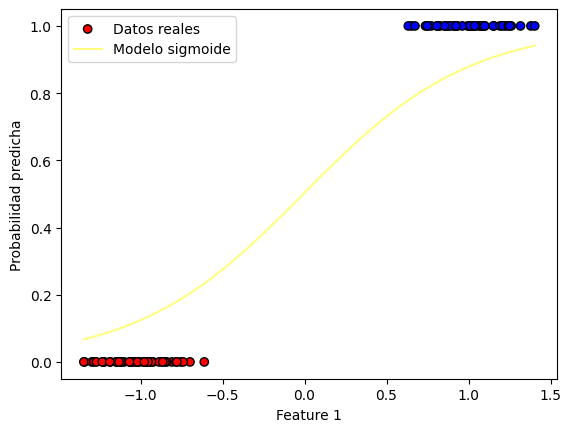

Iteracion: 823
Costo en la iteración 823: 0.1356114691218241
Valor del gradiente 823: [-0.00159885 -0.12025572]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01373832 1.96708662]


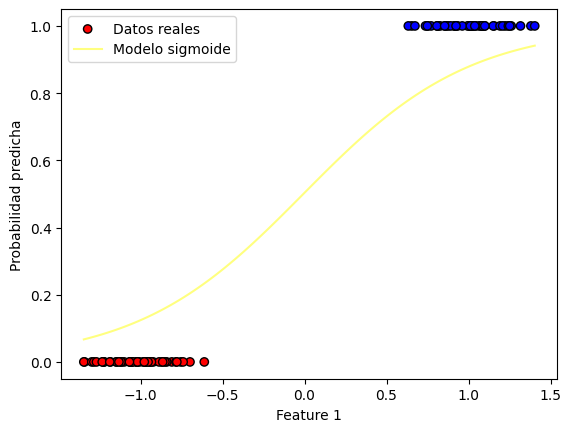

Iteracion: 824
Costo en la iteración 824: 0.13546690437238948
Valor del gradiente 824: [-0.00159787 -0.12013069]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.0137543  1.96828792]


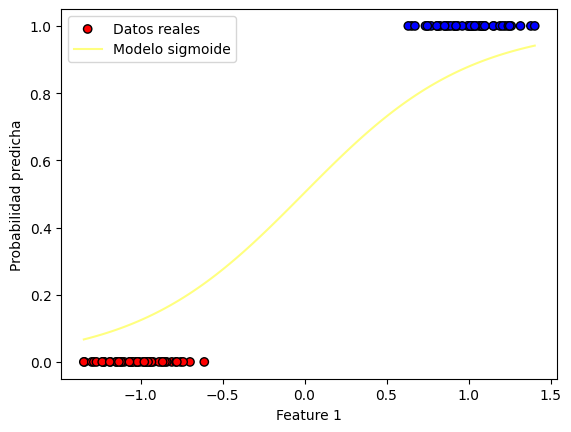

Iteracion: 825
Costo en la iteración 825: 0.13532263997573973
Valor del gradiente 825: [-0.0015969  -0.12000591]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01377027 1.96948798]


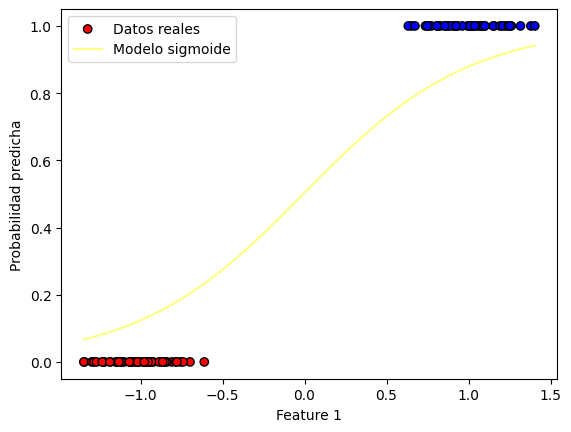

Iteracion: 826
Costo en la iteración 826: 0.1351786750245773
Valor del gradiente 826: [-0.00159592 -0.11988138]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01378623 1.97068679]


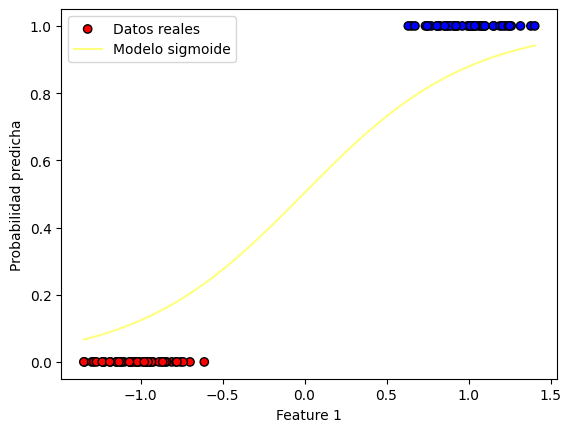

Iteracion: 827
Costo en la iteración 827: 0.13503500861515286
Valor del gradiente 827: [-0.00159495 -0.1197571 ]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01380218 1.97188437]


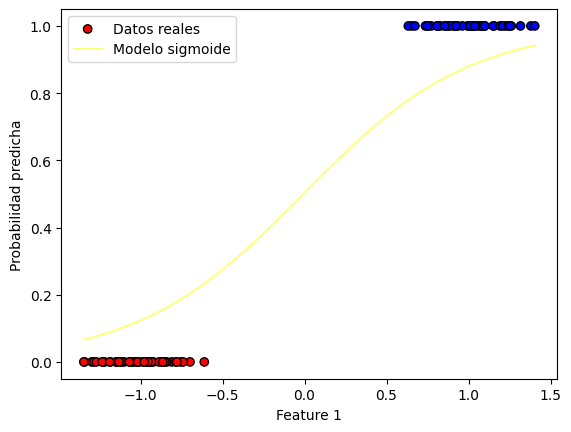

Iteracion: 828
Costo en la iteración 828: 0.1348916398472487
Valor del gradiente 828: [-0.00159398 -0.11963306]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01381812 1.9730807 ]


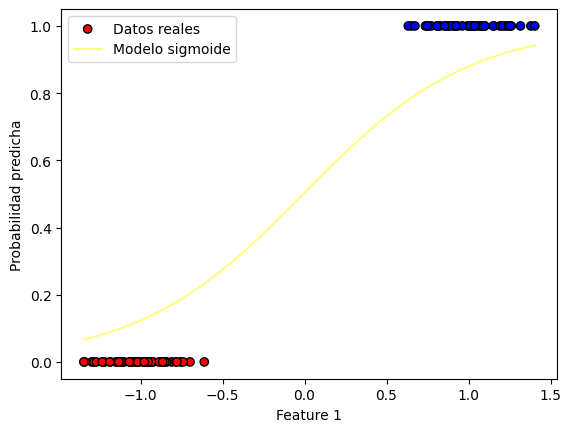

Iteracion: 829
Costo en la iteración 829: 0.1347485678241619
Valor del gradiente 829: [-0.00159301 -0.11950926]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01383405 1.97427579]


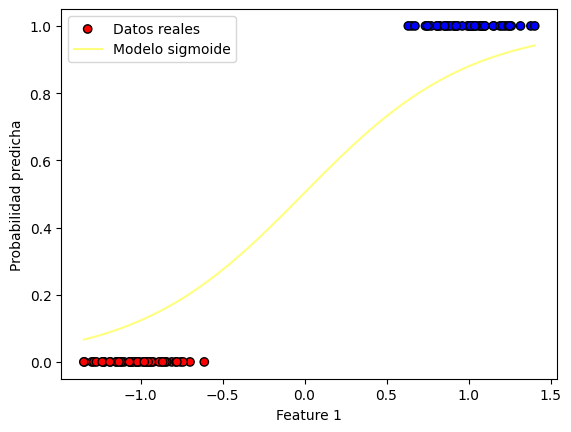

Iteracion: 830
Costo en la iteración 830: 0.13460579165268746
Valor del gradiente 830: [-0.00159203 -0.11938571]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01384997 1.97546965]


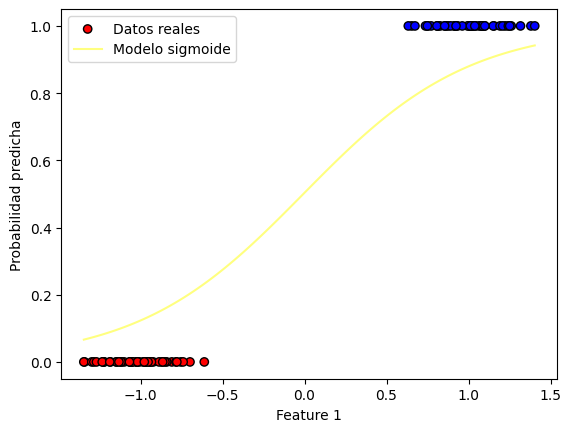

Iteracion: 831
Costo en la iteración 831: 0.13446331044310206
Valor del gradiente 831: [-0.00159106 -0.11926241]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01386588 1.97666227]


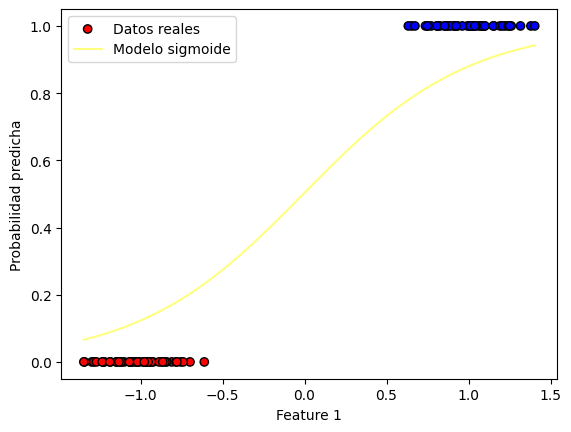

Iteracion: 832
Costo en la iteración 832: 0.13432112330914725
Valor del gradiente 832: [-0.00159009 -0.11913935]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01388178 1.97785366]


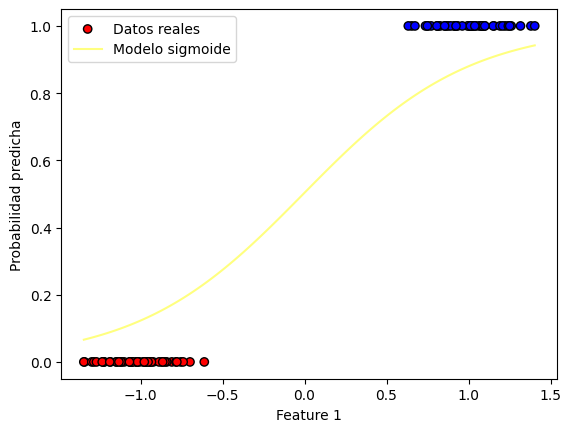

Iteracion: 833
Costo en la iteración 833: 0.13417922936801321
Valor del gradiente 833: [-0.00158913 -0.11901653]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01389767 1.97904383]


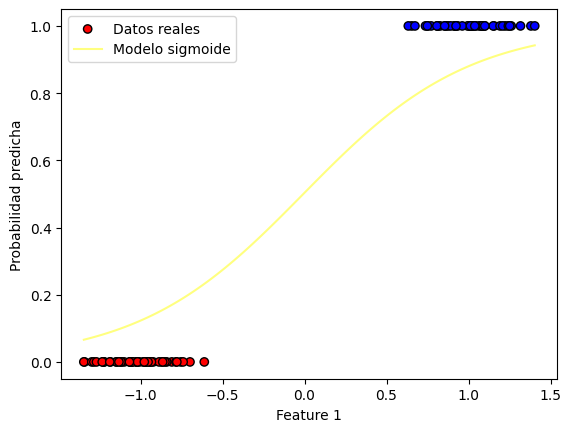

Iteracion: 834
Costo en la iteración 834: 0.13403762774032235
Valor del gradiente 834: [-0.00158816 -0.11889395]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01391356 1.98023277]


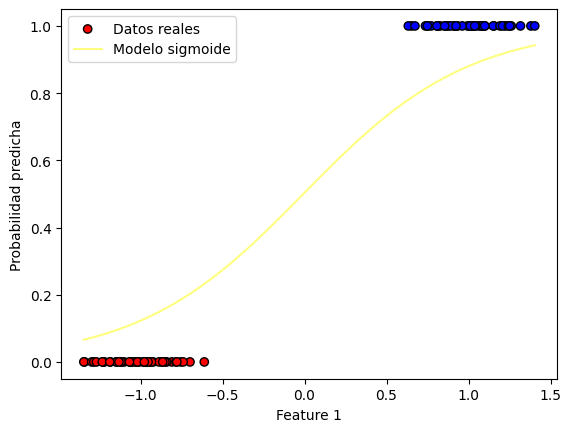

Iteracion: 835
Costo en la iteración 835: 0.13389631755011328
Valor del gradiente 835: [-0.00158719 -0.11877161]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01392943 1.98142048]


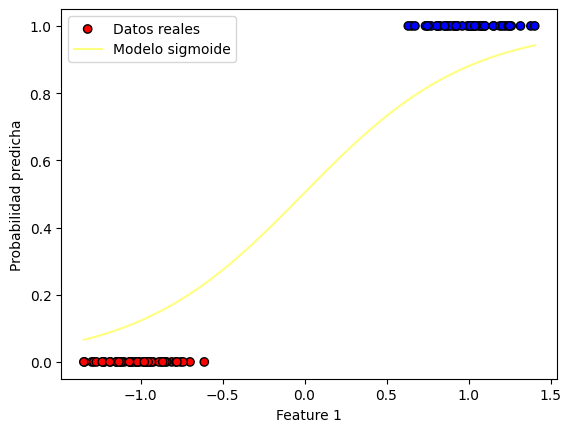

Iteracion: 836
Costo en la iteración 836: 0.13375529792482435
Valor del gradiente 836: [-0.00158622 -0.11864952]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01394529 1.98260698]


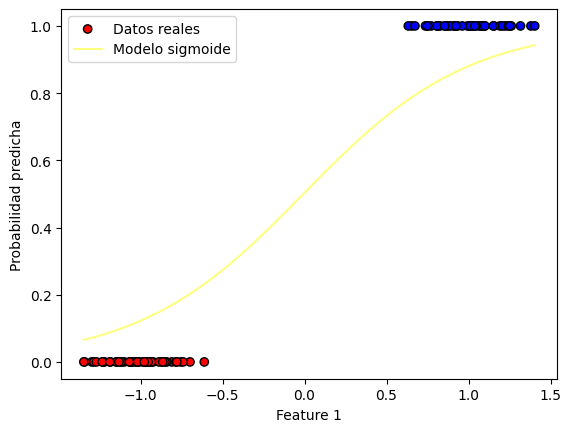

Iteracion: 837
Costo en la iteración 837: 0.13361456799527793
Valor del gradiente 837: [-0.00158525 -0.11852766]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01396114 1.98379226]


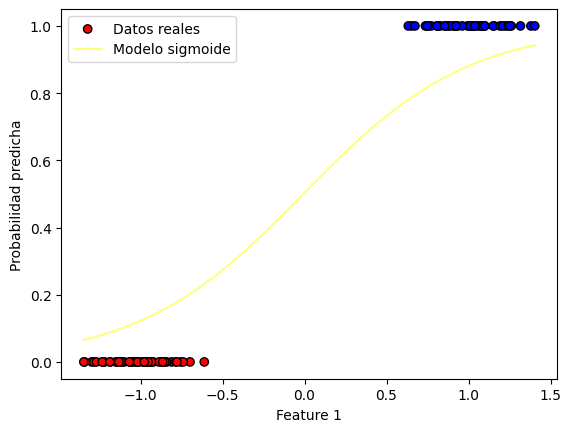

Iteracion: 838
Costo en la iteración 838: 0.13347412689566437
Valor del gradiente 838: [-0.00158429 -0.11840604]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01397699 1.98497632]


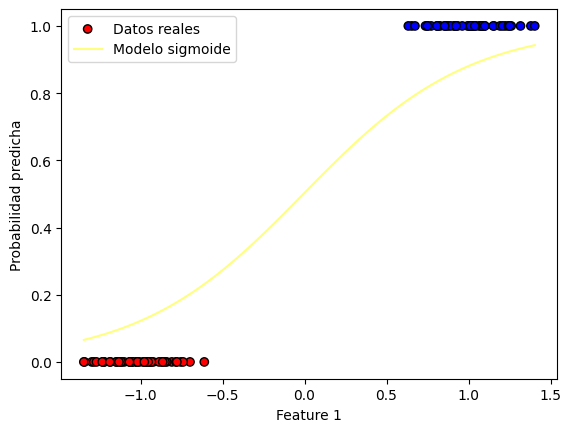

Iteracion: 839
Costo en la iteración 839: 0.13333397376352588
Valor del gradiente 839: [-0.00158332 -0.11828466]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01399282 1.98615916]


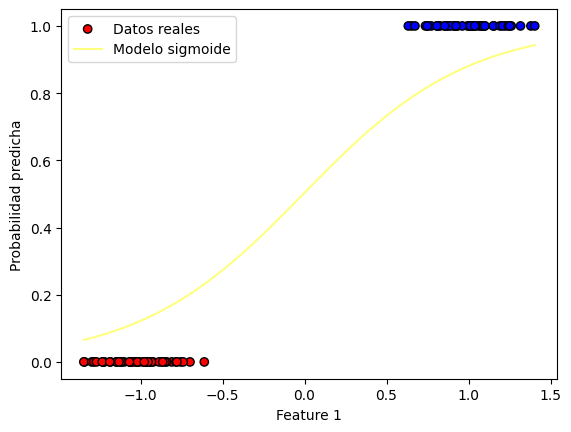

Iteracion: 840
Costo en la iteración 840: 0.13319410773974116
Valor del gradiente 840: [-0.00158236 -0.11816352]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01400864 1.9873408 ]


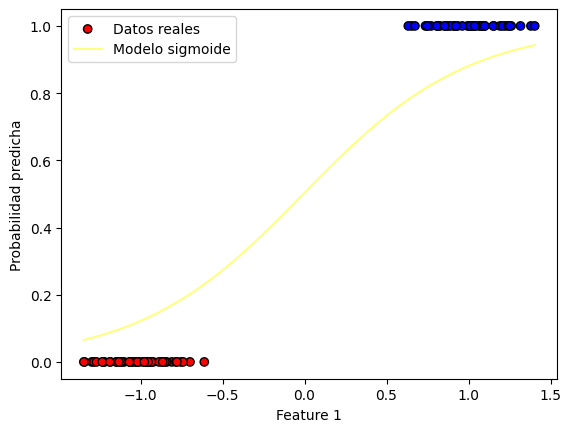

Iteracion: 841
Costo en la iteración 841: 0.13305452796850933
Valor del gradiente 841: [-0.00158139 -0.11804262]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01402446 1.98852122]


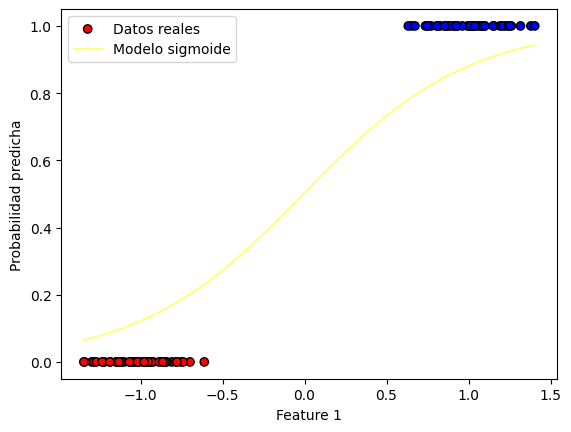

Iteracion: 842
Costo en la iteración 842: 0.13291523359733465
Valor del gradiente 842: [-0.00158043 -0.11792195]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01404026 1.98970044]


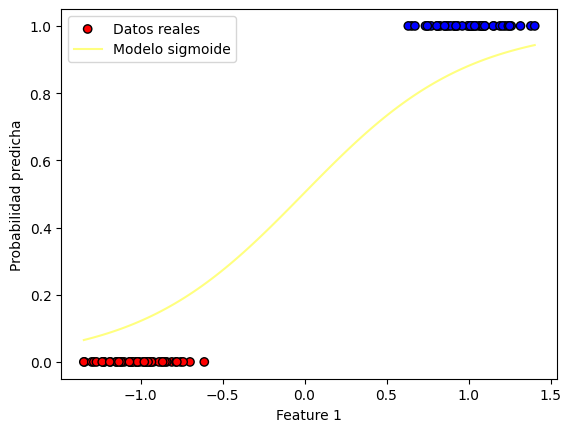

Iteracion: 843
Costo en la iteración 843: 0.1327762237770107
Valor del gradiente 843: [-0.00157947 -0.11780152]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01405605 1.99087846]


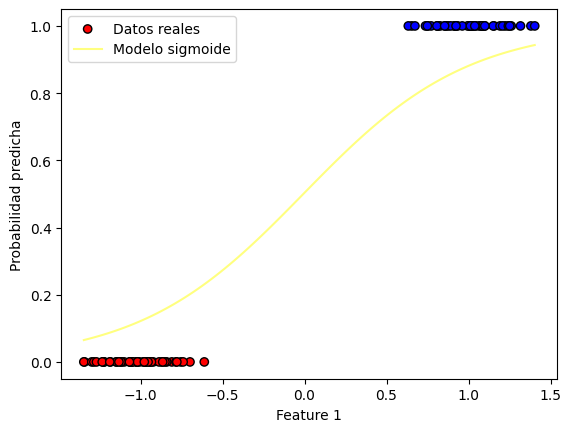

Iteracion: 844
Costo en la iteración 844: 0.1326374976616052
Valor del gradiente 844: [-0.00157851 -0.11768132]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01407184 1.99205527]


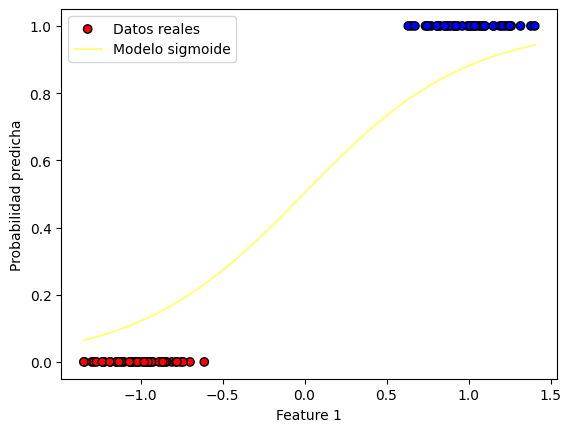

Iteracion: 845
Costo en la iteración 845: 0.13249905440844445
Valor del gradiente 845: [-0.00157754 -0.11756136]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01408762 1.99323089]


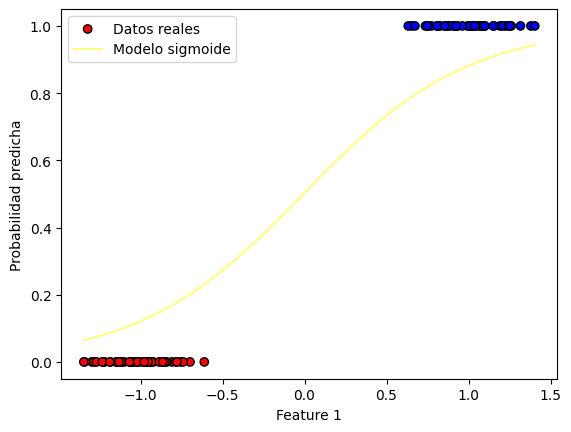

Iteracion: 846
Costo en la iteración 846: 0.13236089317809824
Valor del gradiente 846: [-0.00157658 -0.11744163]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01410338 1.9944053 ]


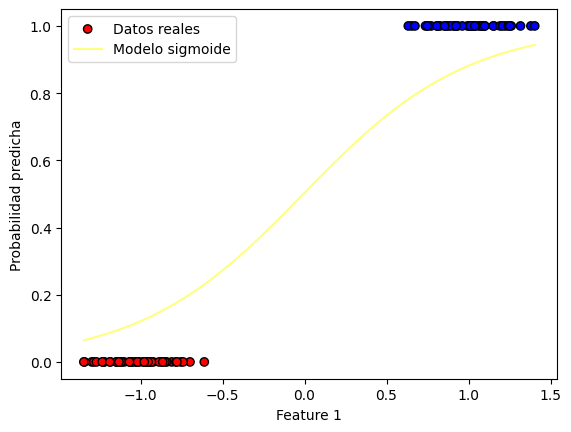

Iteracion: 847
Costo en la iteración 847: 0.13222301313436452
Valor del gradiente 847: [-0.00157562 -0.11732214]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01411914 1.99557852]


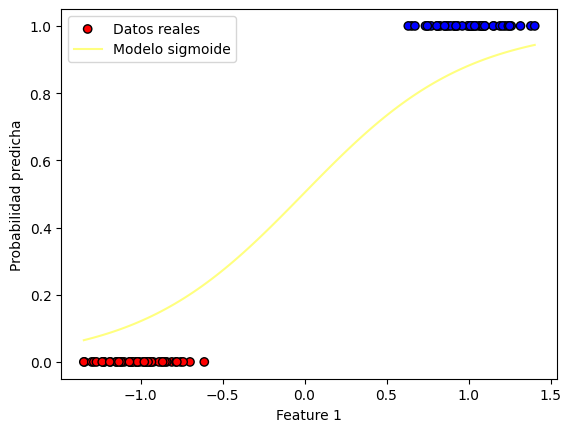

Iteracion: 848
Costo en la iteración 848: 0.13208541344425445
Valor del gradiente 848: [-0.00157466 -0.11720288]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01413488 1.99675055]


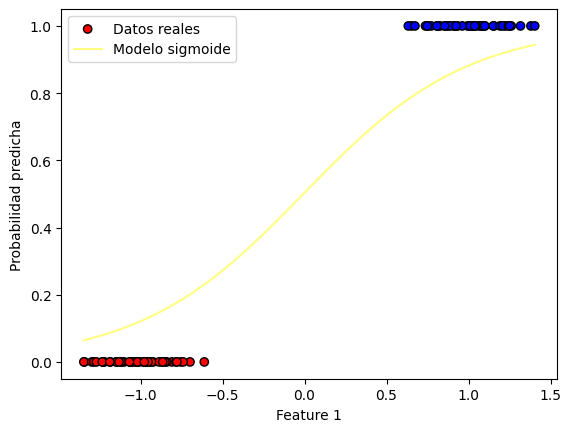

Iteracion: 849
Costo en la iteración 849: 0.13194809327797719
Valor del gradiente 849: [-0.0015737  -0.11708385]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01415062 1.99792139]


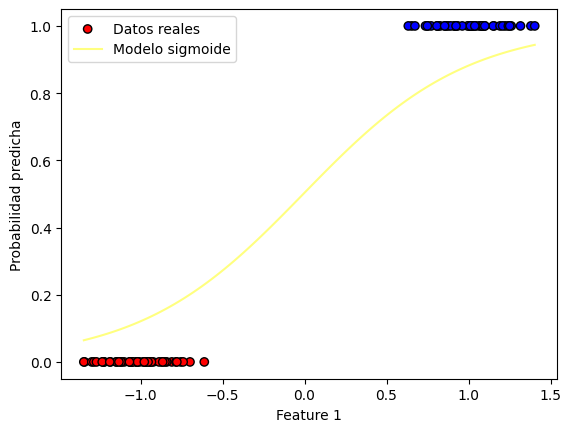

Iteracion: 850
Costo en la iteración 850: 0.13181105180892508
Valor del gradiente 850: [-0.00157274 -0.11696505]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01416635 1.99909104]


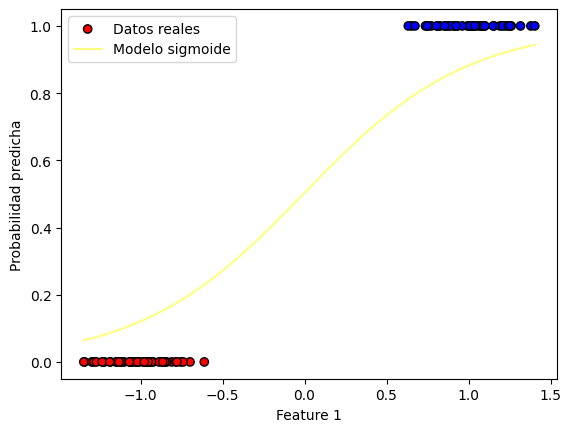

Iteracion: 851
Costo en la iteración 851: 0.13167428821365884
Valor del gradiente 851: [-0.00157179 -0.11684648]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01418207 2.00025951]


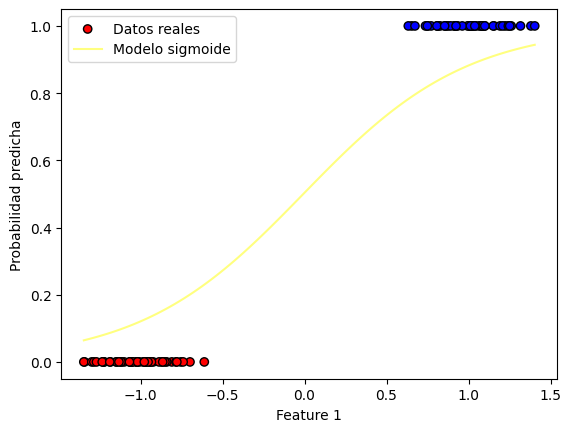

Iteracion: 852
Costo en la iteración 852: 0.1315378016718927
Valor del gradiente 852: [-0.00157083 -0.11672814]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01419777 2.00142679]


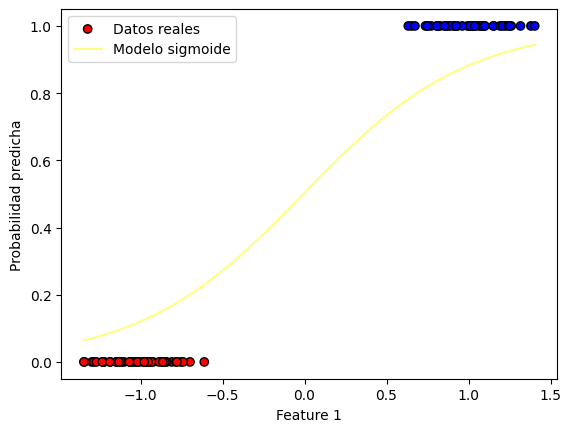

Iteracion: 853
Costo en la iteración 853: 0.1314015913664797
Valor del gradiente 853: [-0.00156987 -0.11661003]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01421347 2.00259289]


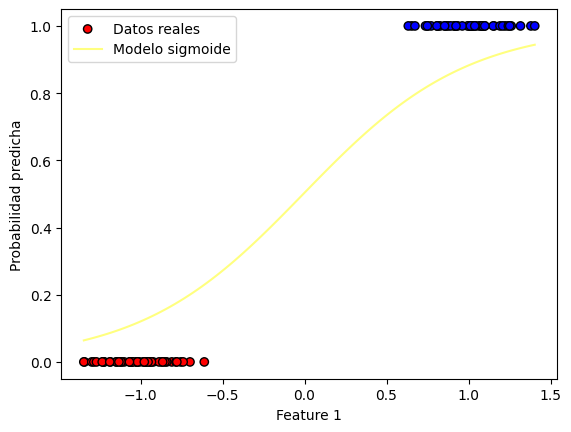

Iteracion: 854
Costo en la iteración 854: 0.13126565648339722
Valor del gradiente 854: [-0.00156892 -0.11649215]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01422916 2.00375781]


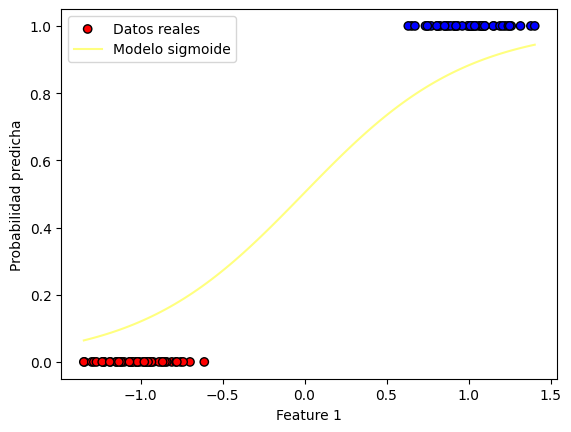

Iteracion: 855
Costo en la iteración 855: 0.1311299962117322
Valor del gradiente 855: [-0.00156796 -0.11637449]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01424484 2.00492155]


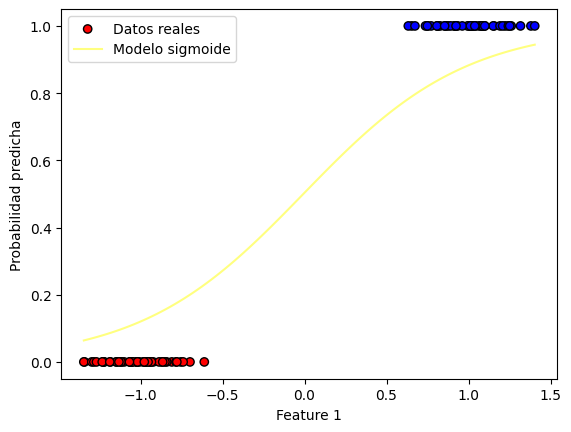

Iteracion: 856
Costo en la iteración 856: 0.13099460974366686
Valor del gradiente 856: [-0.00156701 -0.11625707]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01426051 2.00608413]


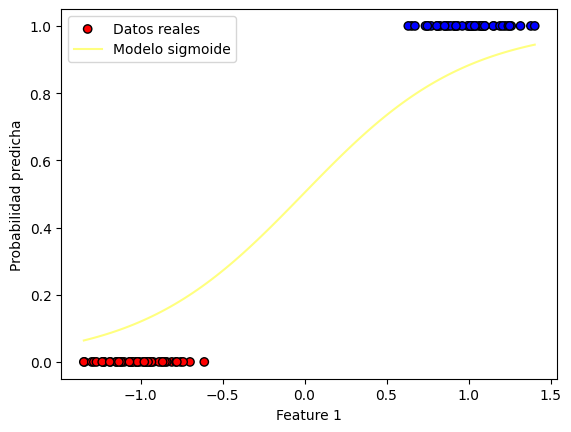

Iteracion: 857
Costo en la iteración 857: 0.13085949627446433
Valor del gradiente 857: [-0.00156605 -0.11613987]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01427617 2.00724552]


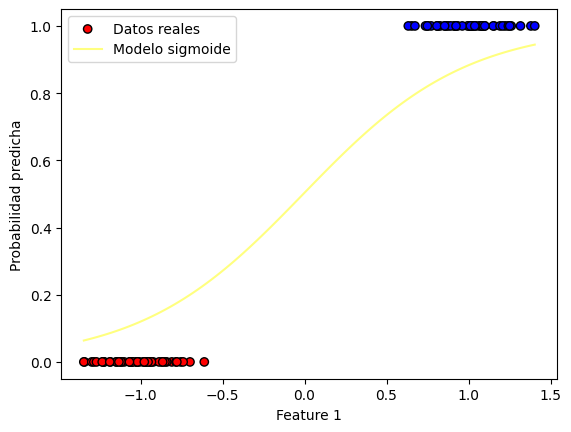

Iteracion: 858
Costo en la iteración 858: 0.13072465500245428
Valor del gradiente 858: [-0.0015651 -0.1160229]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01429182 2.00840575]


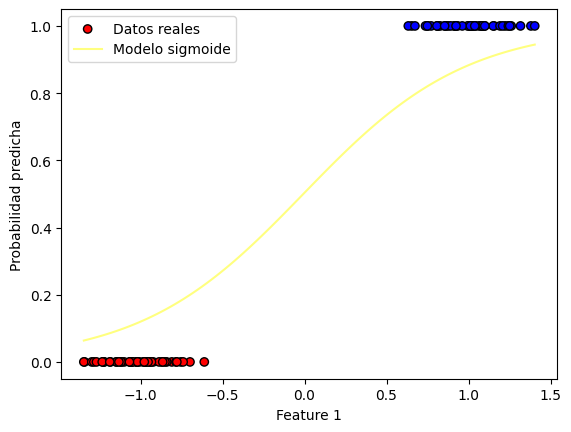

Iteracion: 859
Costo en la iteración 859: 0.1305900851290188
Valor del gradiente 859: [-0.00156415 -0.11590615]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01430747 2.00956481]


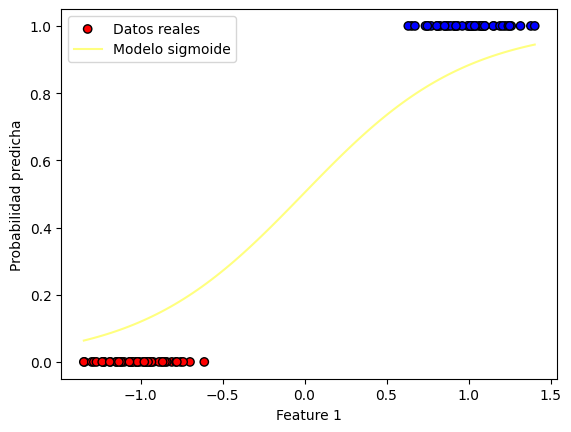

Iteracion: 860
Costo en la iteración 860: 0.13045578585857798
Valor del gradiente 860: [-0.0015632  -0.11578963]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.0143231  2.01072271]


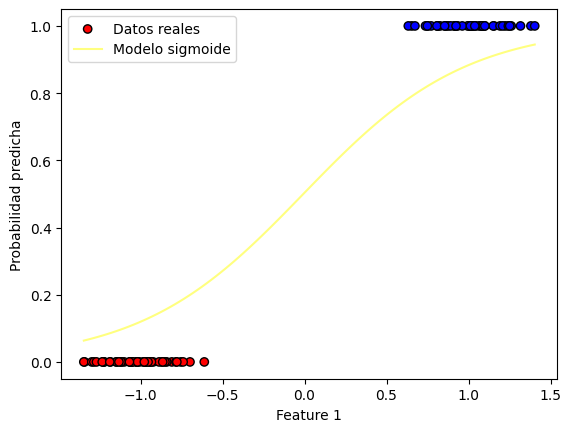

Iteracion: 861
Costo en la iteración 861: 0.1303217563985763
Valor del gradiente 861: [-0.00156224 -0.11567333]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01433872 2.01187944]


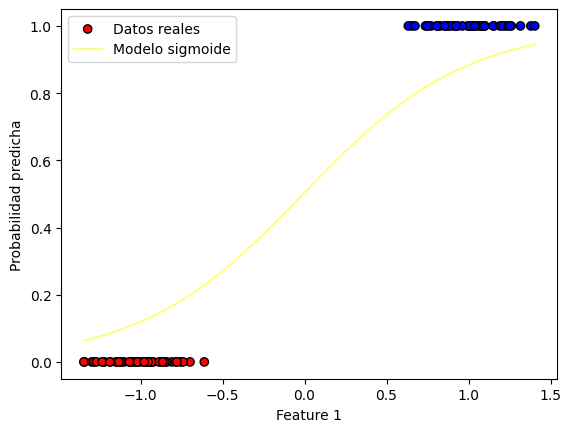

Iteracion: 862
Costo en la iteración 862: 0.13018799595946828
Valor del gradiente 862: [-0.00156129 -0.11555725]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01435433 2.01303502]


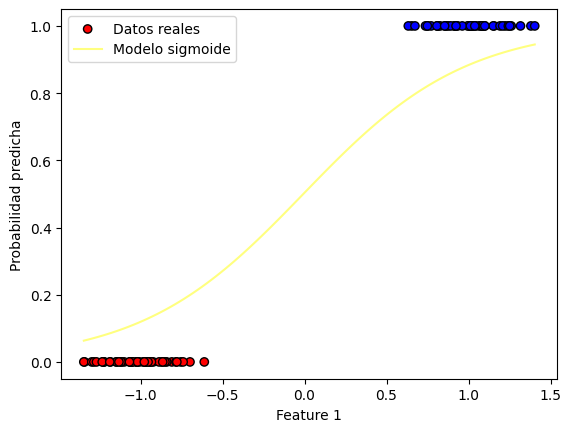

Iteracion: 863
Costo en la iteración 863: 0.13005450375470454
Valor del gradiente 863: [-0.00156034 -0.1154414 ]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01436994 2.01418943]


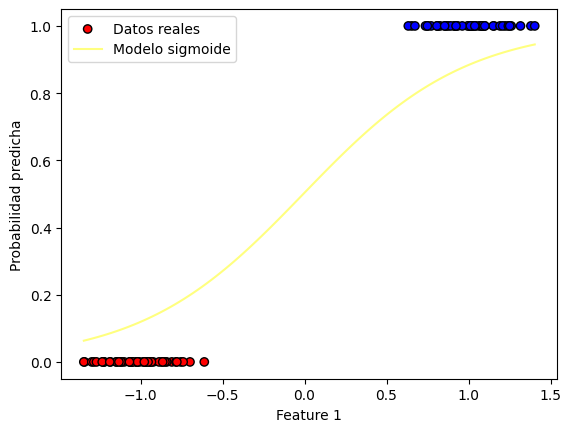

Iteracion: 864
Costo en la iteración 864: 0.12992127900071834
Valor del gradiente 864: [-0.00155939 -0.11532577]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01438553 2.01534269]


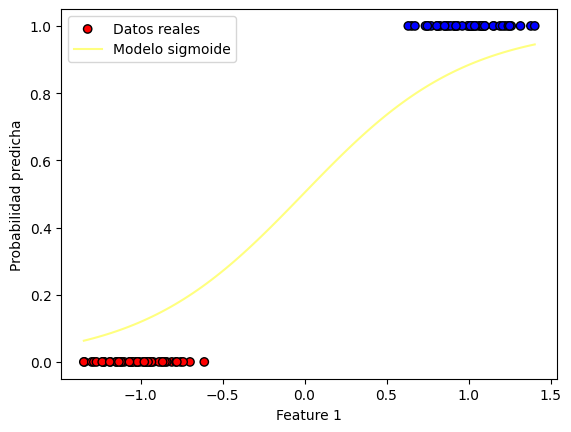

Iteracion: 865
Costo en la iteración 865: 0.12978832091691134
Valor del gradiente 865: [-0.00155845 -0.11521036]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01440111 2.01649479]


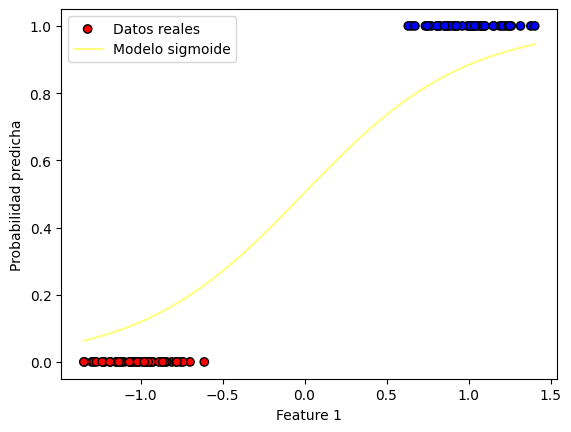

Iteracion: 866
Costo en la iteración 866: 0.12965562872564024
Valor del gradiente 866: [-0.0015575  -0.11509518]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01441669 2.01764574]


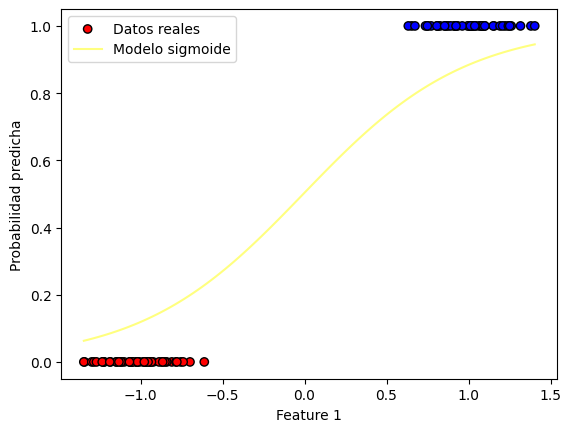

Iteracion: 867
Costo en la iteración 867: 0.1295232016522031
Valor del gradiente 867: [-0.00155655 -0.11498021]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01443225 2.01879555]


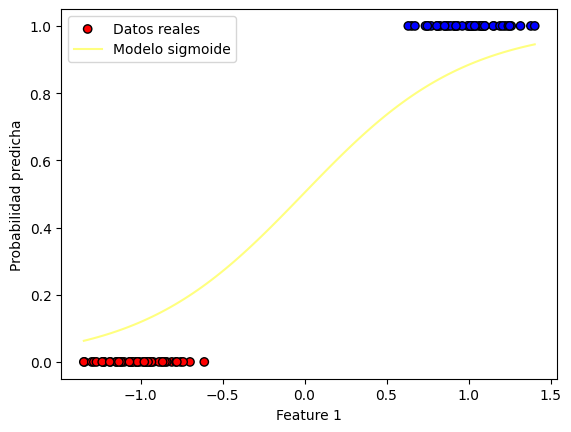

Iteracion: 868
Costo en la iteración 868: 0.1293910389248256
Valor del gradiente 868: [-0.0015556  -0.11486546]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01444781 2.0199442 ]


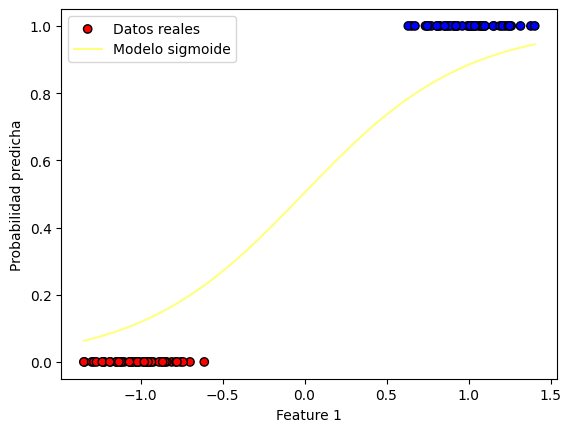

Iteracion: 869
Costo en la iteración 869: 0.12925913977464787
Valor del gradiente 869: [-0.00155466 -0.11475094]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01446336 2.02109171]


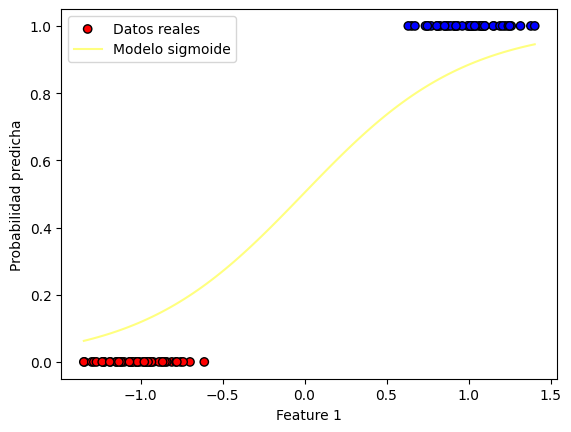

Iteracion: 870
Costo en la iteración 870: 0.12912750343571086
Valor del gradiente 870: [-0.00155371 -0.11463663]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01447889 2.02223808]


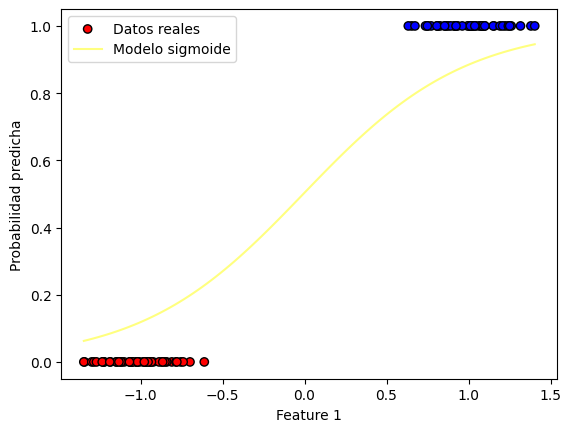

Iteracion: 871
Costo en la iteración 871: 0.1289961291449431
Valor del gradiente 871: [-0.00155277 -0.11452254]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01449442 2.0233833 ]


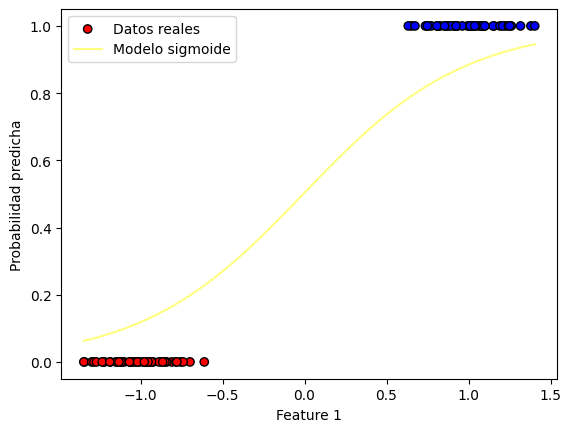

Iteracion: 872
Costo en la iteración 872: 0.12886501614214746
Valor del gradiente 872: [-0.00155182 -0.11440866]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01450994 2.02452739]


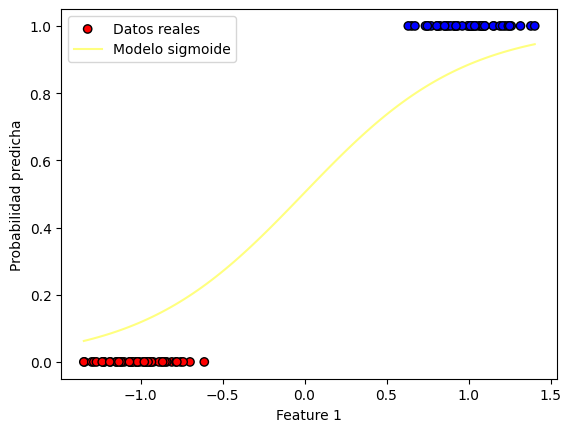

Iteracion: 873
Costo en la iteración 873: 0.12873416366998794
Valor del gradiente 873: [-0.00155088 -0.11429501]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01452545 2.02567034]


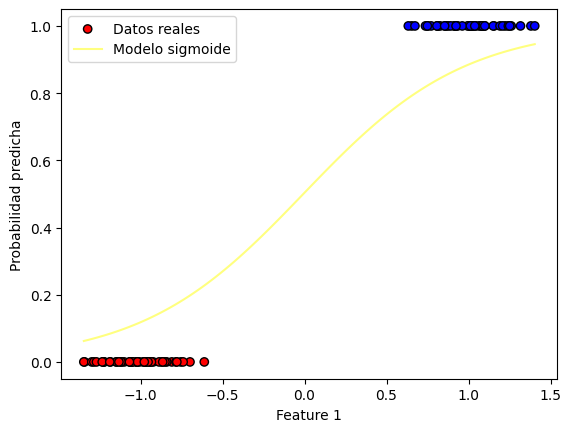

Iteracion: 874
Costo en la iteración 874: 0.1286035709739766
Valor del gradiente 874: [-0.00154994 -0.11418157]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01454095 2.02681215]


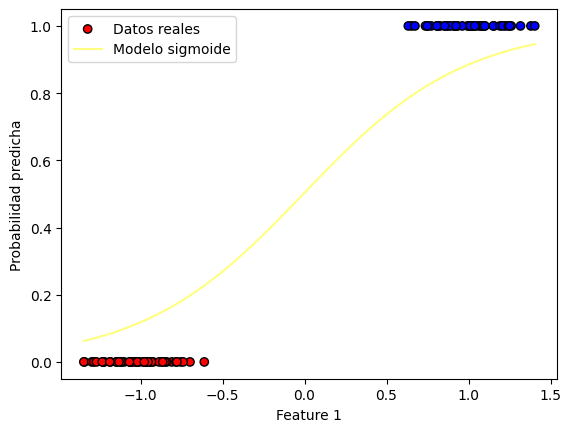

Iteracion: 875
Costo en la iteración 875: 0.12847323730246035
Valor del gradiente 875: [-0.001549   -0.11406834]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01455644 2.02795284]


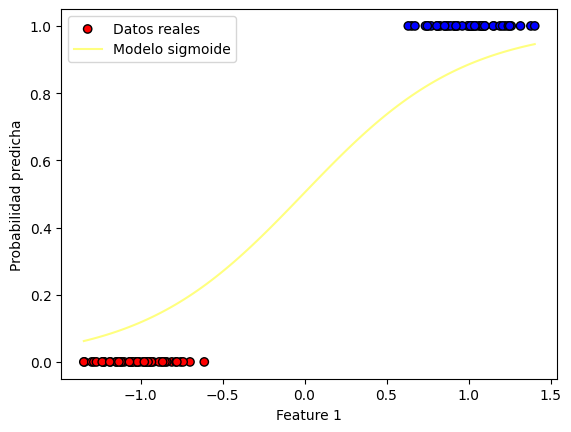

Iteracion: 876
Costo en la iteración 876: 0.1283431619066083
Valor del gradiente 876: [-0.00154806 -0.11395534]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01457192 2.02909239]


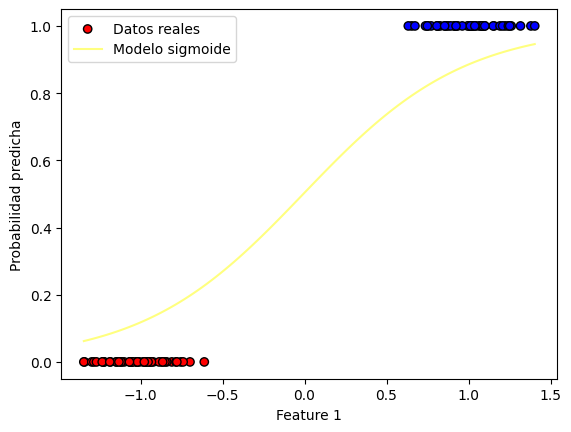

Iteracion: 877
Costo en la iteración 877: 0.12821334404039844
Valor del gradiente 877: [-0.00154711 -0.11384254]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01458739 2.03023082]


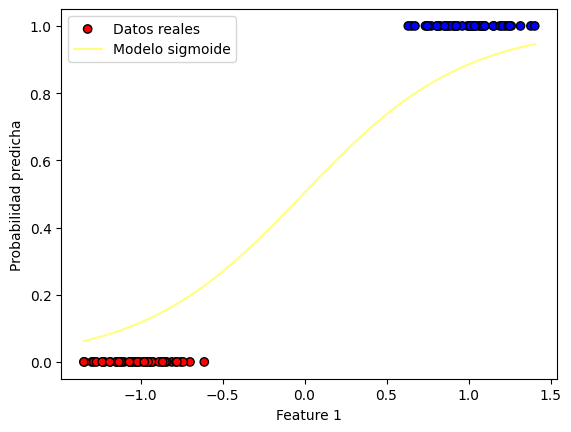

Iteracion: 878
Costo en la iteración 878: 0.12808378296060527
Valor del gradiente 878: [-0.00154618 -0.11372996]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01460285 2.03136812]


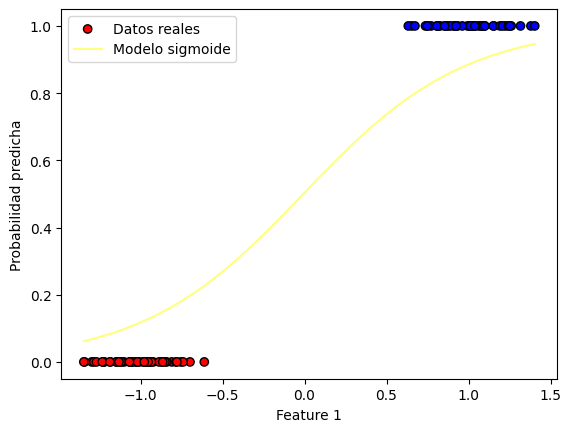

Iteracion: 879
Costo en la iteración 879: 0.12795447792678658
Valor del gradiente 879: [-0.00154524 -0.11361759]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.0146183  2.03250429]


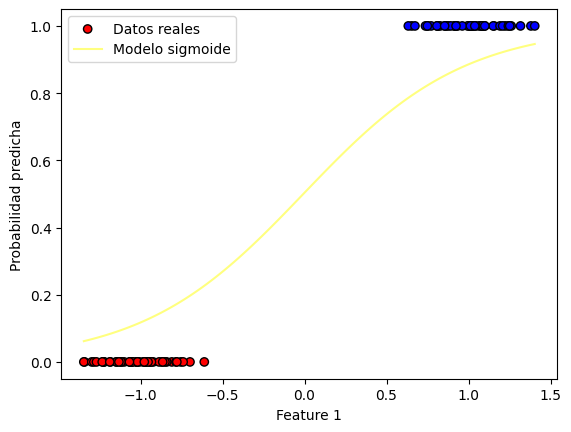

Iteracion: 880
Costo en la iteración 880: 0.12782542820127116
Valor del gradiente 880: [-0.0015443  -0.11350544]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01463375 2.03363935]


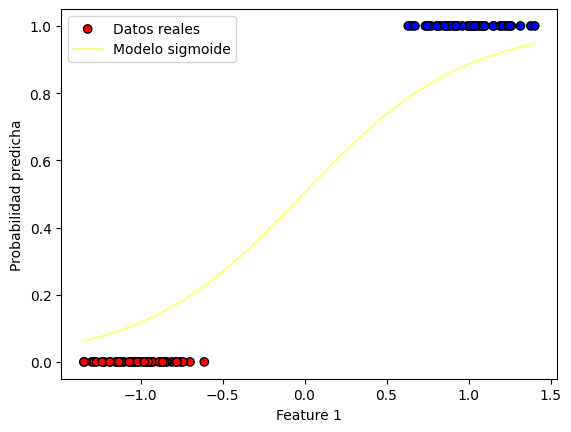

Iteracion: 881
Costo en la iteración 881: 0.1276966330491457
Valor del gradiente 881: [-0.00154336 -0.1133935 ]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01464918 2.03477328]


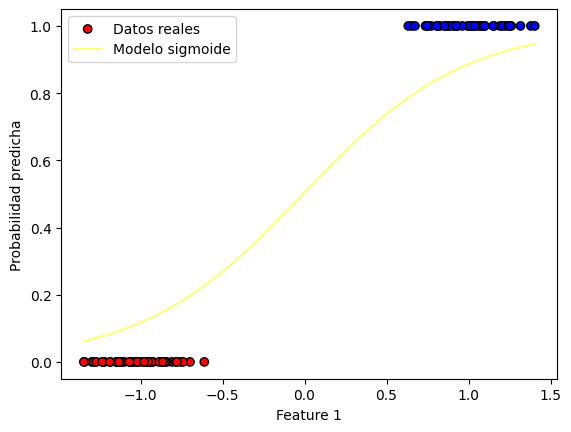

Iteracion: 882
Costo en la iteración 882: 0.1275680917382428
Valor del gradiente 882: [-0.00154242 -0.11328177]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01466461 2.0359061 ]


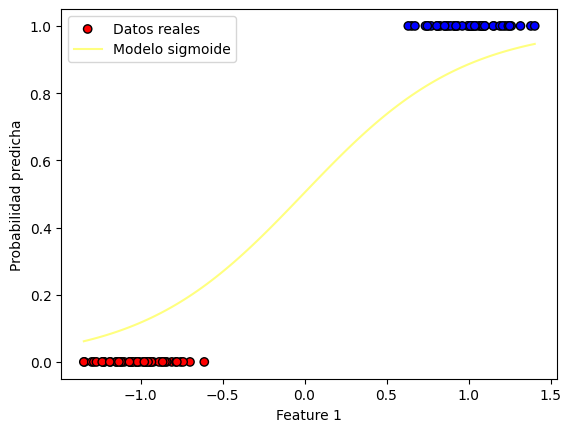

Iteracion: 883
Costo en la iteración 883: 0.12743980353912787
Valor del gradiente 883: [-0.00154149 -0.11317025]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01468002 2.0370378 ]


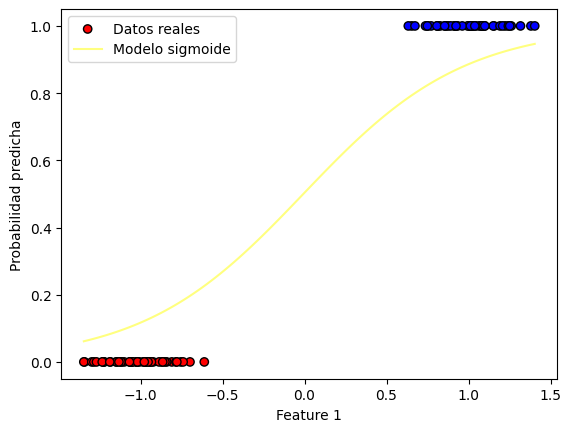

Iteracion: 884
Costo en la iteración 884: 0.12731176772508737
Valor del gradiente 884: [-0.00154055 -0.11305894]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01469543 2.03816839]


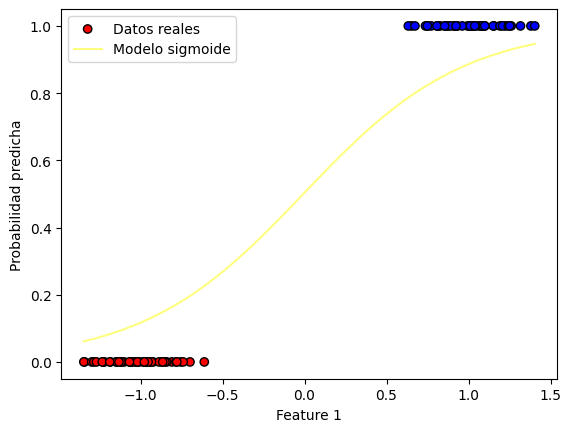

Iteracion: 885
Costo en la iteración 885: 0.12718398357211577
Valor del gradiente 885: [-0.00153962 -0.11294784]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01471082 2.03929787]


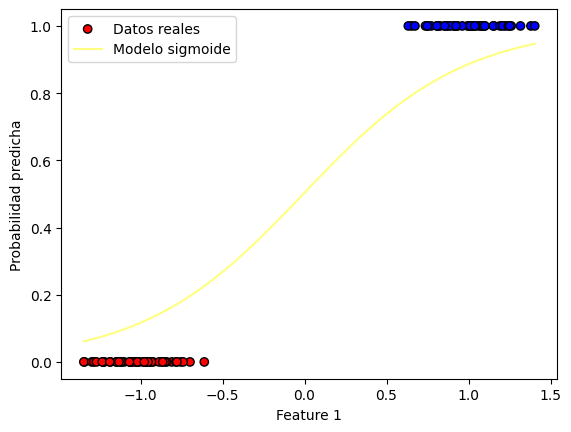

Iteracion: 886
Costo en la iteración 886: 0.12705645035890373
Valor del gradiente 886: [-0.00153868 -0.11283695]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01472621 2.04042624]


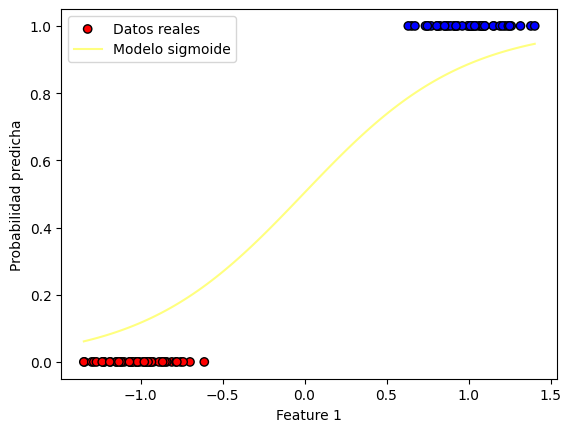

Iteracion: 887
Costo en la iteración 887: 0.1269291673668257
Valor del gradiente 887: [-0.00153775 -0.11272627]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01474159 2.0415535 ]


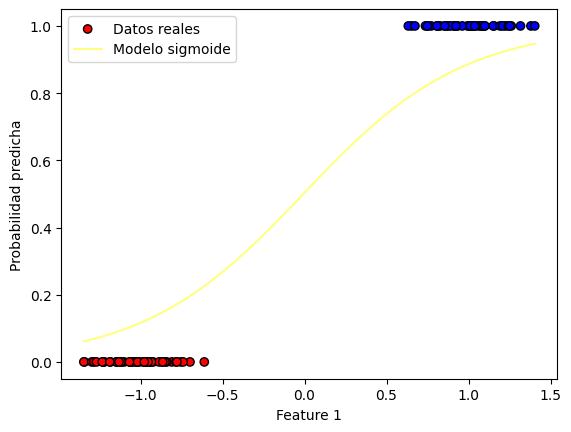

Iteracion: 888
Costo en la iteración 888: 0.12680213387992756
Valor del gradiente 888: [-0.00153681 -0.1126158 ]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01475695 2.04267966]


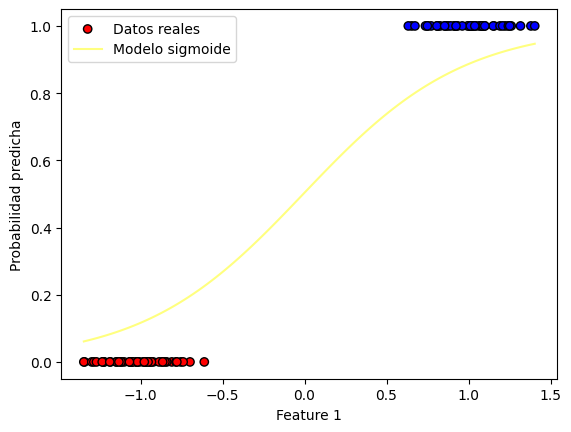

Iteracion: 889
Costo en la iteración 889: 0.126675349184915
Valor del gradiente 889: [-0.00153588 -0.11250553]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01477231 2.04380471]


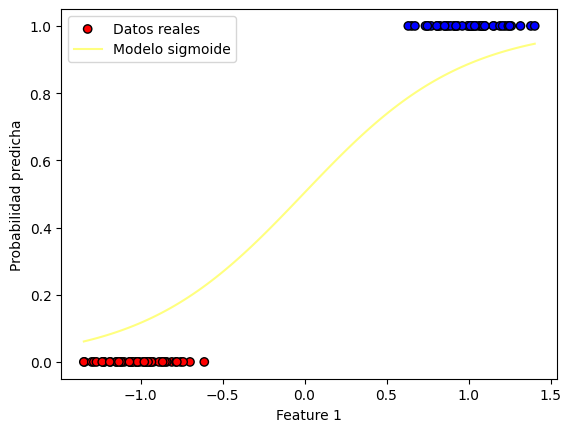

Iteracion: 890
Costo en la iteración 890: 0.126548812571141
Valor del gradiente 890: [-0.00153495 -0.11239548]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01478766 2.04492867]


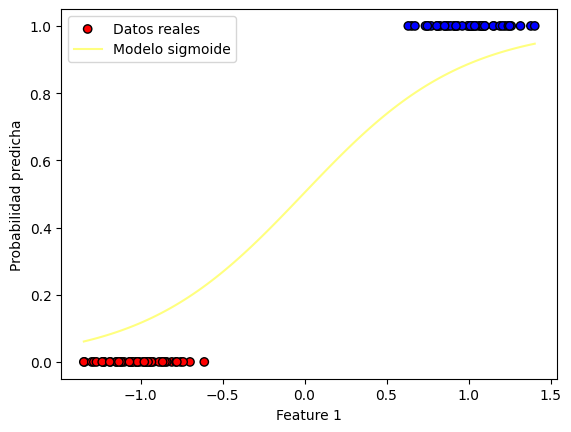

Iteracion: 891
Costo en la iteración 891: 0.12642252333059412
Valor del gradiente 891: [-0.00153402 -0.11228562]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.014803   2.04605153]


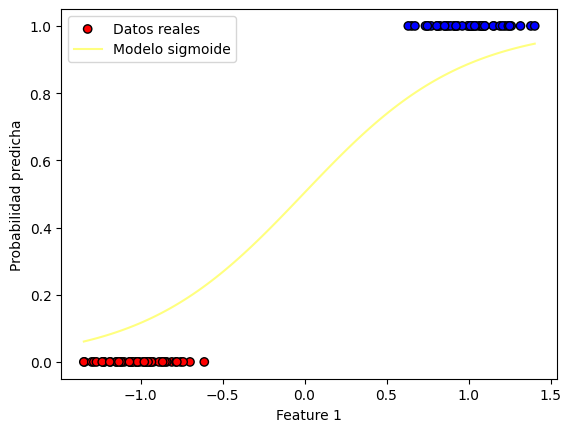

Iteracion: 892
Costo en la iteración 892: 0.12629648075788652
Valor del gradiente 892: [-0.00153309 -0.11217598]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01481833 2.04717329]


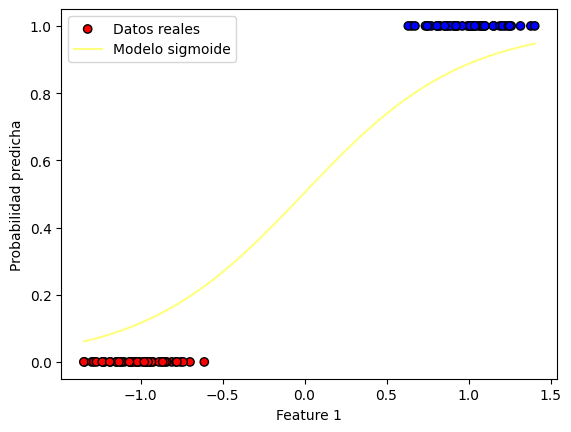

Iteracion: 893
Costo en la iteración 893: 0.12617068415024205
Valor del gradiente 893: [-0.00153216 -0.11206654]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01483366 2.04829395]


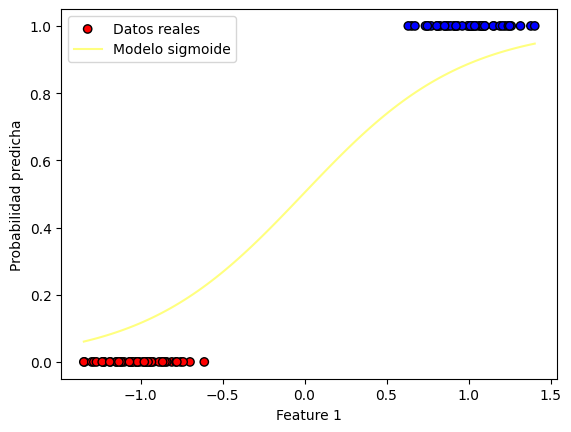

Iteracion: 894
Costo en la iteración 894: 0.12604513280748456
Valor del gradiente 894: [-0.00153123 -0.1119573 ]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01484897 2.04941352]


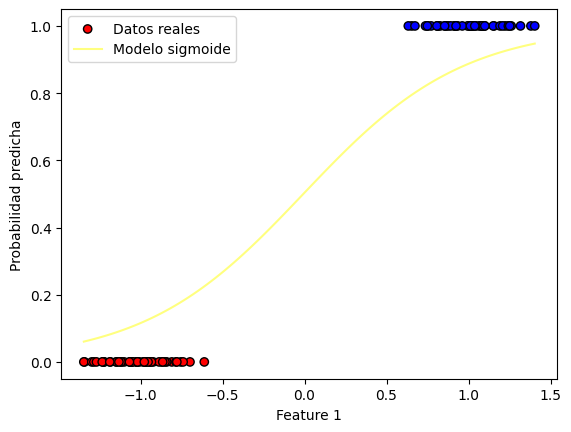

Iteracion: 895
Costo en la iteración 895: 0.12591982603202623
Valor del gradiente 895: [-0.0015303  -0.11184827]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01486427 2.05053201]


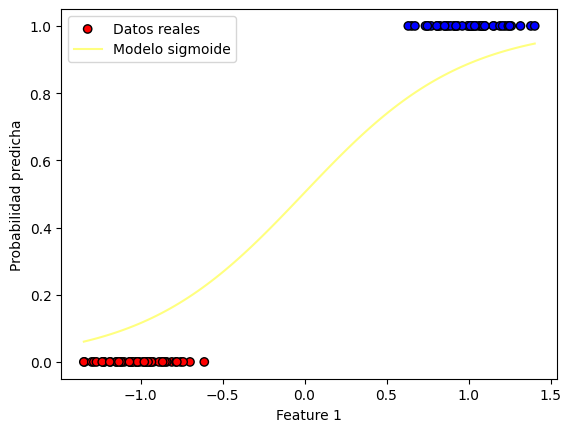

Iteracion: 896
Costo en la iteración 896: 0.12579476312885565
Valor del gradiente 896: [-0.00152937 -0.11173945]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01487956 2.0516494 ]


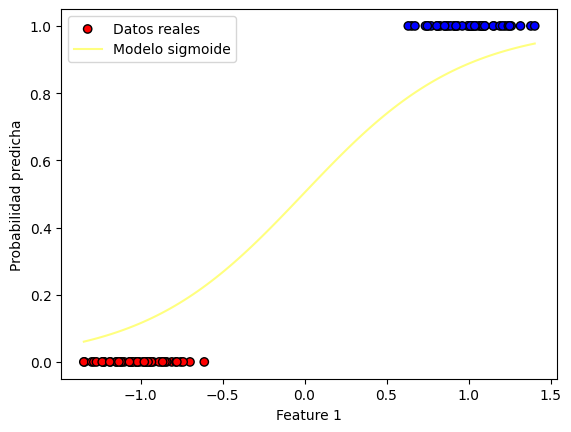

Iteracion: 897
Costo en la iteración 897: 0.12566994340552656
Valor del gradiente 897: [-0.00152845 -0.11163082]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01489485 2.05276571]


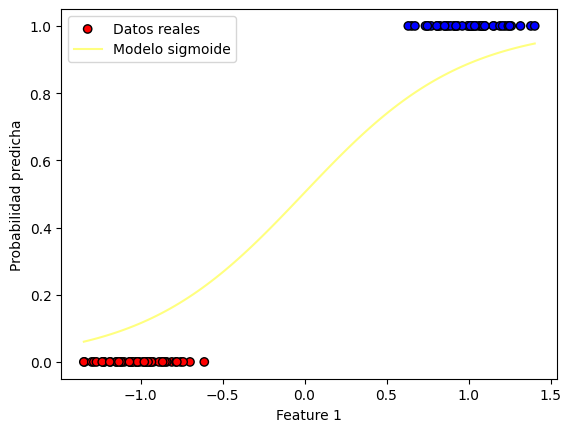

Iteracion: 898
Costo en la iteración 898: 0.125545366172146
Valor del gradiente 898: [-0.00152752 -0.1115224 ]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01491012 2.05388093]


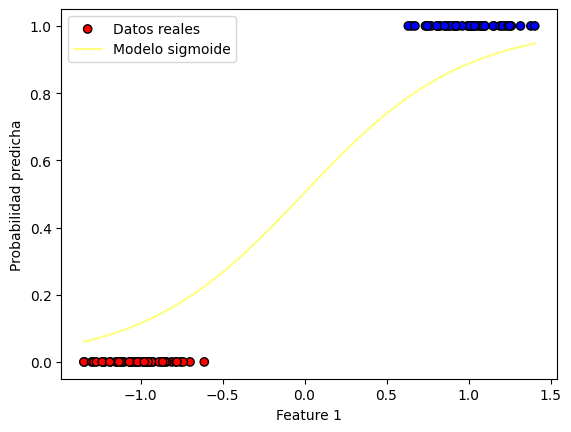

Iteracion: 899
Costo en la iteración 899: 0.12542103074136307
Valor del gradiente 899: [-0.0015266  -0.11141418]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01492539 2.05499508]


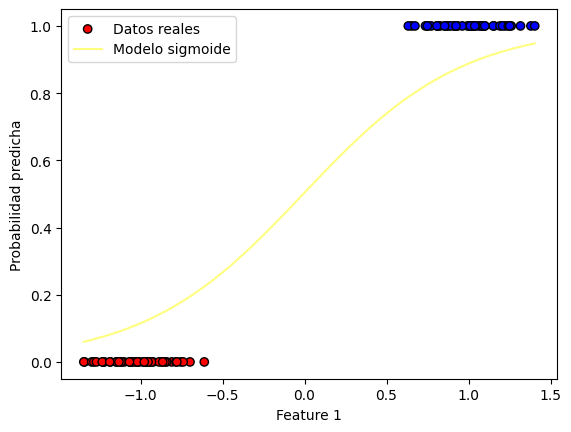

Iteracion: 900
Costo en la iteración 900: 0.12529693642835735
Valor del gradiente 900: [-0.00152567 -0.11130616]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01494065 2.05610814]


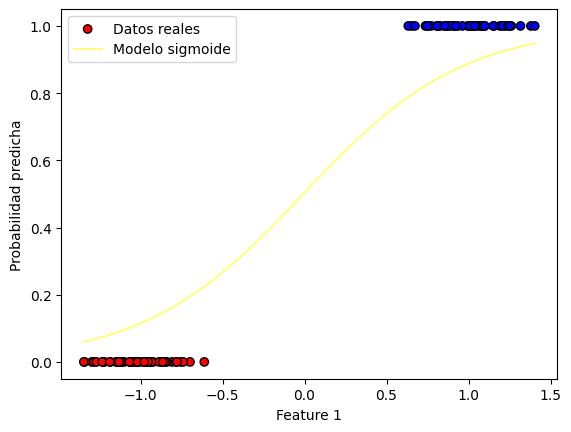

Iteracion: 901
Costo en la iteración 901: 0.12517308255082762
Valor del gradiente 901: [-0.00152475 -0.11119835]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01495589 2.05722012]


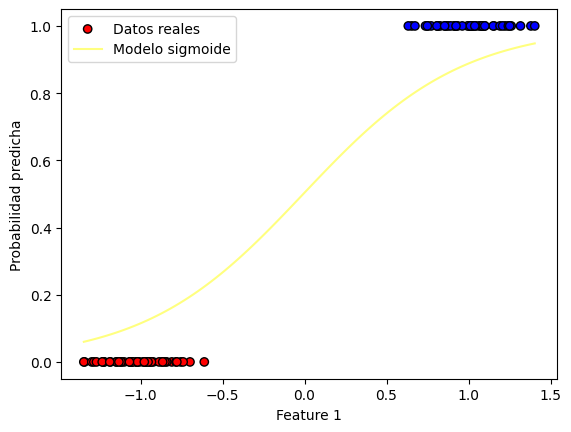

Iteracion: 902
Costo en la iteración 902: 0.1250494684289806
Valor del gradiente 902: [-0.00152382 -0.11109073]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01497113 2.05833103]


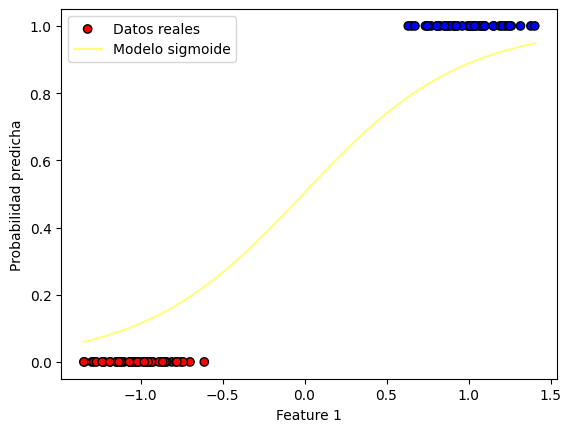

Iteracion: 903
Costo en la iteración 903: 0.1249260933855196
Valor del gradiente 903: [-0.0015229  -0.11098331]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01498636 2.05944086]


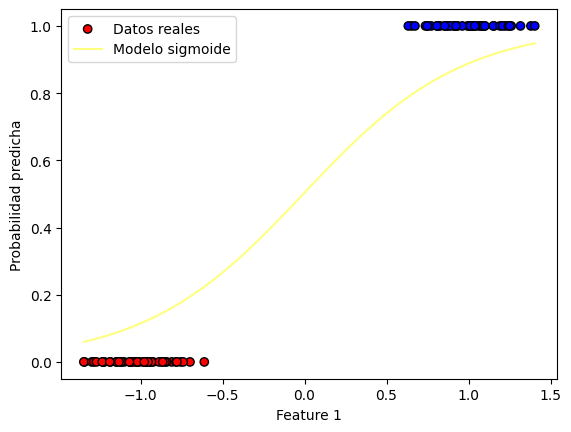

Iteracion: 904
Costo en la iteración 904: 0.12480295674563344
Valor del gradiente 904: [-0.00152198 -0.1108761 ]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01500158 2.06054962]


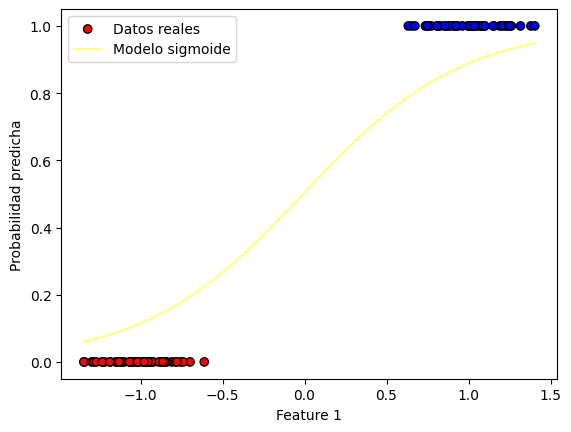

Iteracion: 905
Costo en la iteración 905: 0.12468005783698516
Valor del gradiente 905: [-0.00152106 -0.11076908]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01501679 2.06165731]


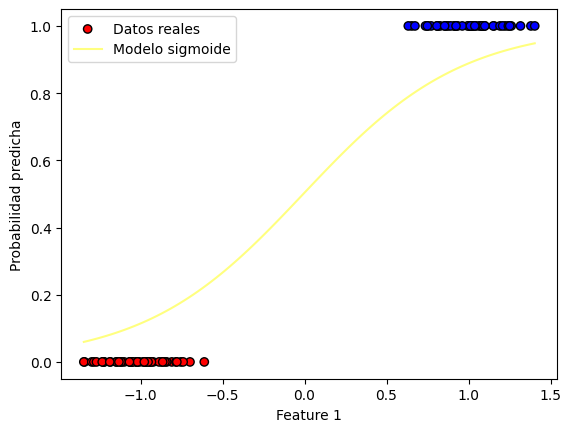

Iteracion: 906
Costo en la iteración 906: 0.12455739598970138
Valor del gradiente 906: [-0.00152014 -0.11066226]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01503199 2.06276393]


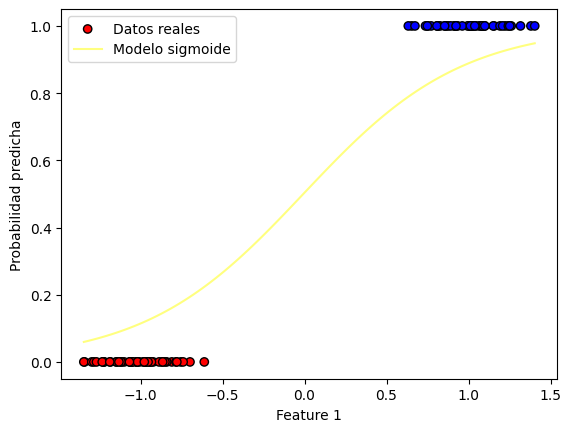

Iteracion: 907
Costo en la iteración 907: 0.12443497053636064
Valor del gradiente 907: [-0.00151922 -0.11055564]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01504719 2.06386949]


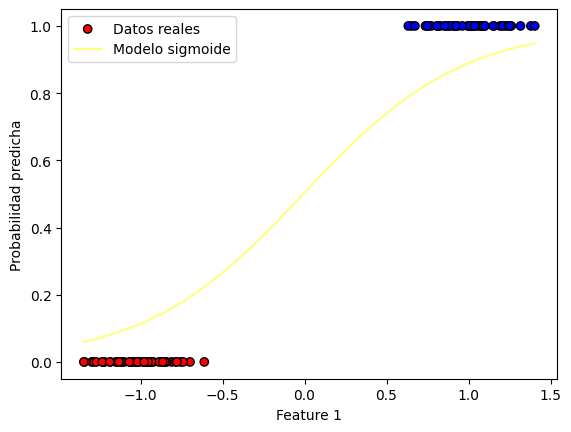

Iteracion: 908
Costo en la iteración 908: 0.12431278081198309
Valor del gradiente 908: [-0.0015183  -0.11044921]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01506237 2.06497398]


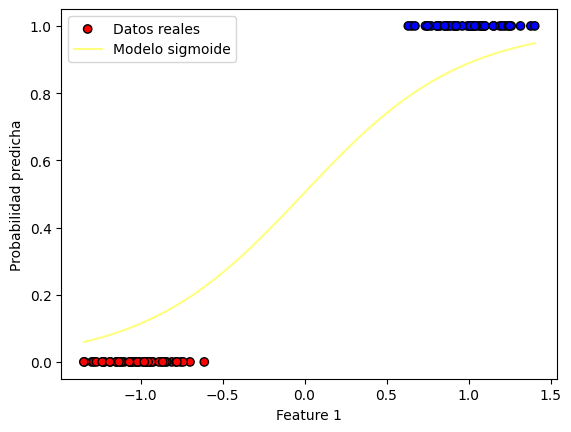

Iteracion: 909
Costo en la iteración 909: 0.12419082615401916
Valor del gradiente 909: [-0.00151738 -0.11034298]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01507754 2.06607741]


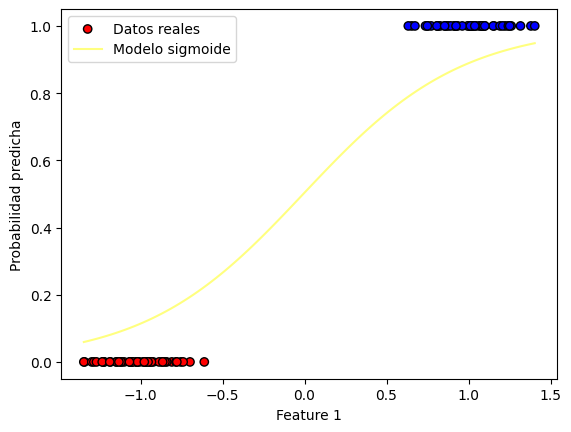

Iteracion: 910
Costo en la iteración 910: 0.12406910590233908
Valor del gradiente 910: [-0.00151646 -0.11023695]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01509271 2.06717978]


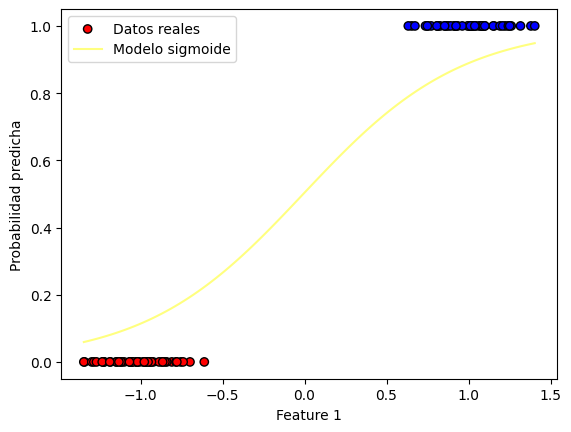

Iteracion: 911
Costo en la iteración 911: 0.12394761939922169
Valor del gradiente 911: [-0.00151555 -0.11013112]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01510786 2.06828109]


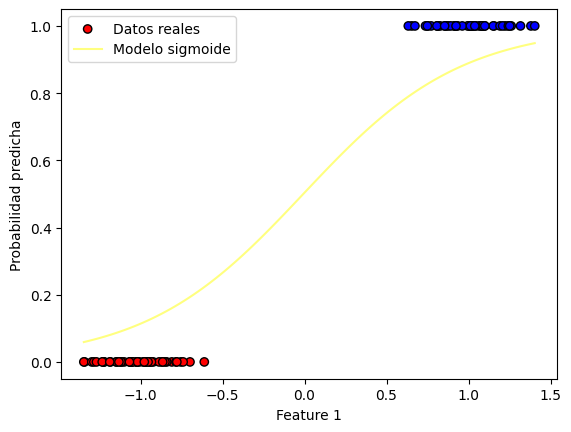

Iteracion: 912
Costo en la iteración 912: 0.12382636598934404
Valor del gradiente 912: [-0.00151463 -0.11002548]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01512301 2.06938135]


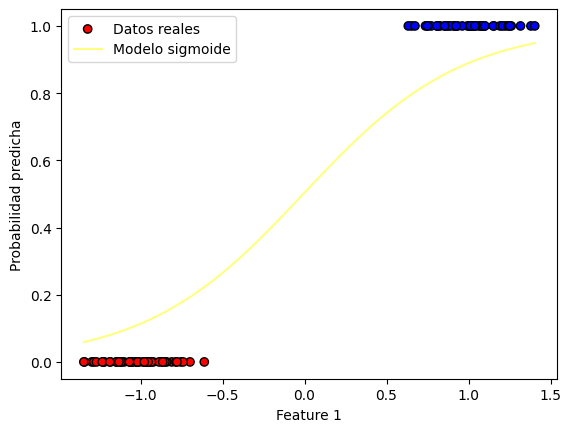

Iteracion: 913
Costo en la iteración 913: 0.12370534501977065
Valor del gradiente 913: [-0.00151372 -0.10992003]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01513815 2.07048055]


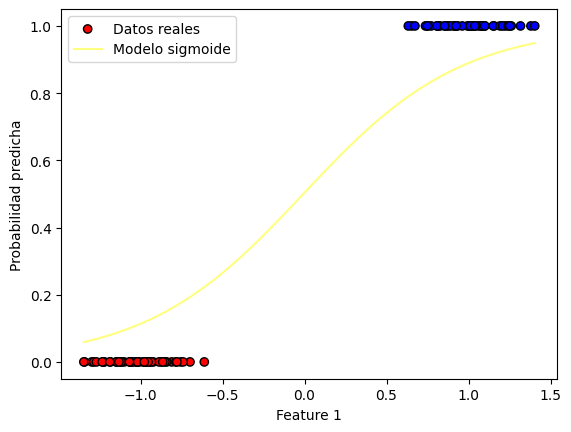

Iteracion: 914
Costo en la iteración 914: 0.12358455583994284
Valor del gradiente 914: [-0.0015128  -0.10981478]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01515327 2.0715787 ]


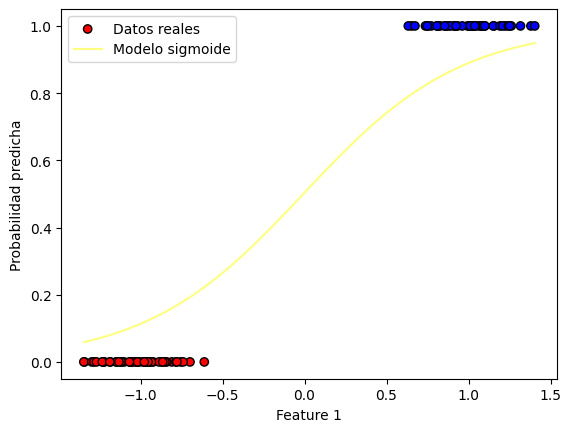

Iteracion: 915
Costo en la iteración 915: 0.12346399780166831
Valor del gradiente 915: [-0.00151189 -0.10970972]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01516839 2.07267579]


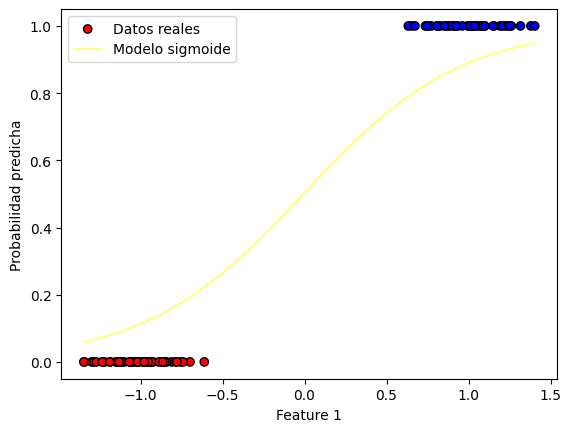

Iteracion: 916
Costo en la iteración 916: 0.12334367025911039
Valor del gradiente 916: [-0.00151097 -0.10960485]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.0151835  2.07377184]


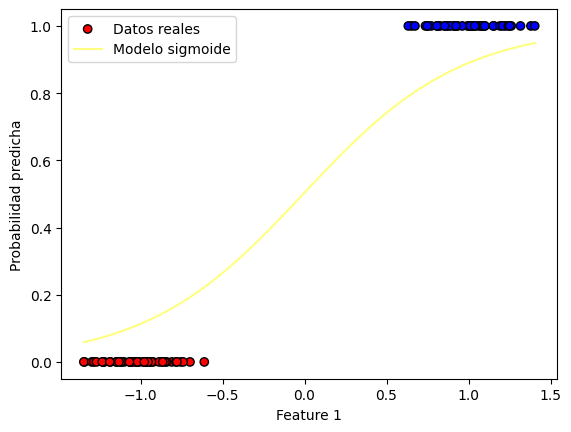

Iteracion: 917
Costo en la iteración 917: 0.12322357256877793
Valor del gradiente 917: [-0.00151006 -0.10950018]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.0151986  2.07486684]


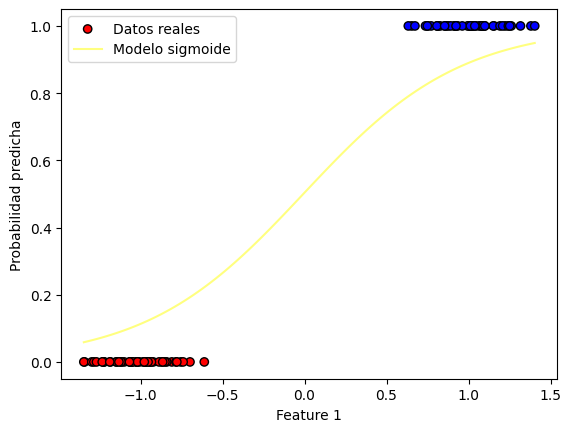

Iteracion: 918
Costo en la iteración 918: 0.1231037040895146
Valor del gradiente 918: [-0.00150915 -0.1093957 ]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01521369 2.0759608 ]


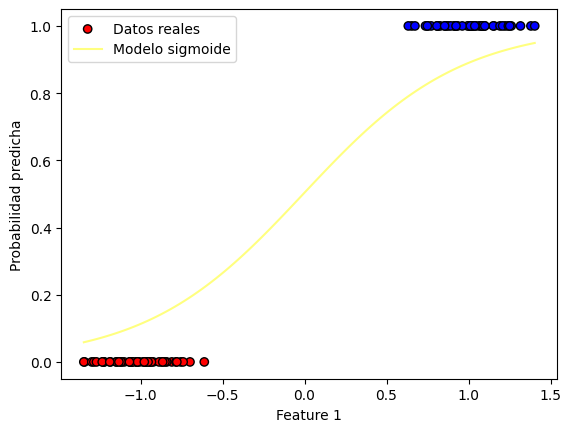

Iteracion: 919
Costo en la iteración 919: 0.12298406418248864
Valor del gradiente 919: [-0.00150824 -0.10929141]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01522878 2.07705372]


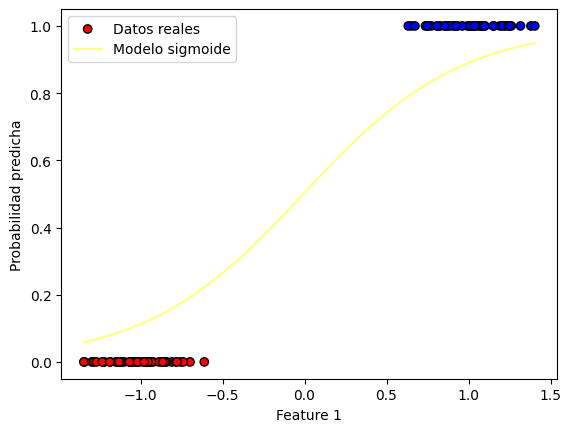

Iteracion: 920
Costo en la iteración 920: 0.12286465221118284
Valor del gradiente 920: [-0.00150733 -0.10918731]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01524385 2.07814559]


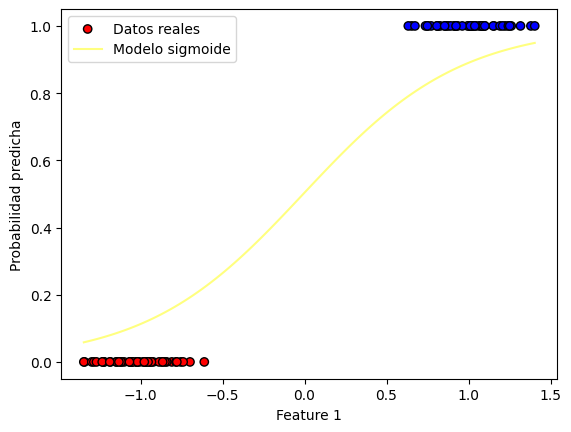

Iteracion: 921
Costo en la iteración 921: 0.12274546754138388
Valor del gradiente 921: [-0.00150642 -0.1090834 ]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01525891 2.07923642]


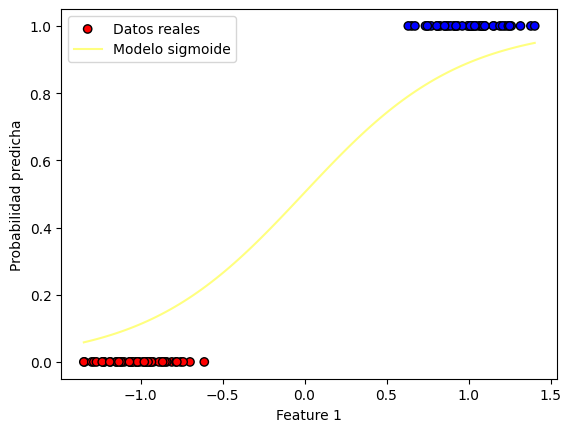

Iteracion: 922
Costo en la iteración 922: 0.12262650954117256
Valor del gradiente 922: [-0.00150551 -0.10897969]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01527397 2.08032622]


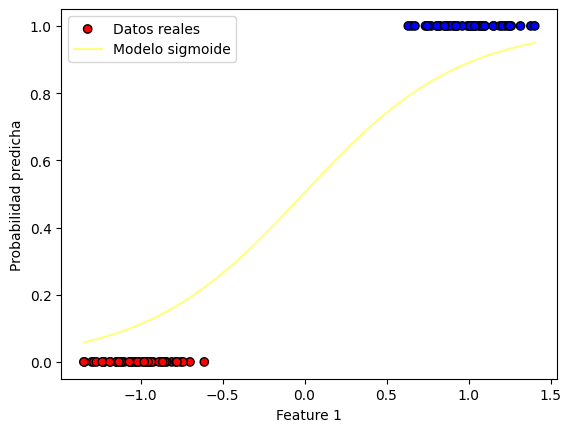

Iteracion: 923
Costo en la iteración 923: 0.12250777758091326
Valor del gradiente 923: [-0.0015046  -0.10887616]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01528902 2.08141498]


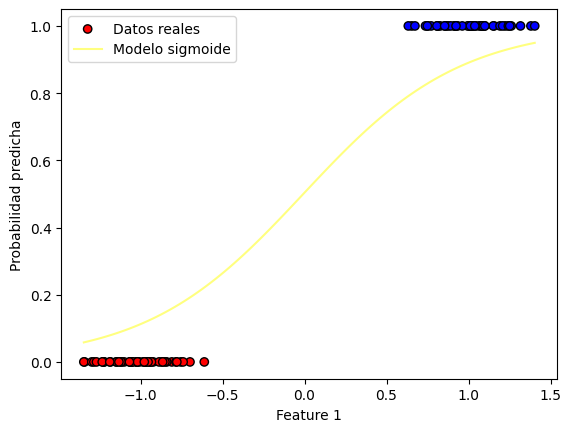

Iteracion: 924
Costo en la iteración 924: 0.1223892710332443
Valor del gradiente 924: [-0.00150369 -0.10877282]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01530405 2.08250271]


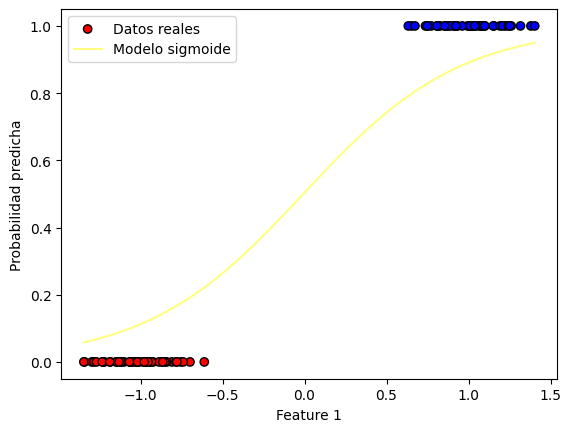

Iteracion: 925
Costo en la iteración 925: 0.12227098927306759
Valor del gradiente 925: [-0.00150278 -0.10866967]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01531908 2.08358941]


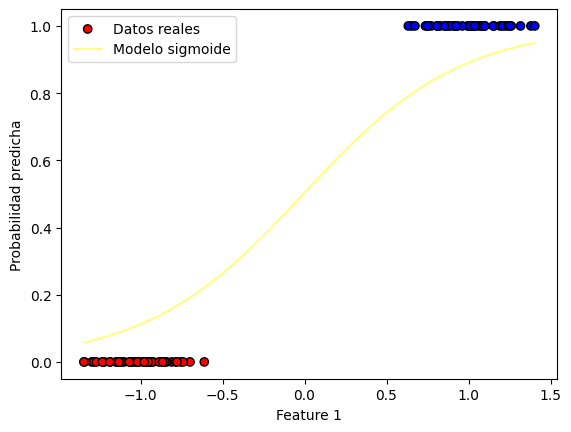

Iteracion: 926
Costo en la iteración 926: 0.12215293167753888
Valor del gradiente 926: [-0.00150188 -0.10856671]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.0153341  2.08467507]


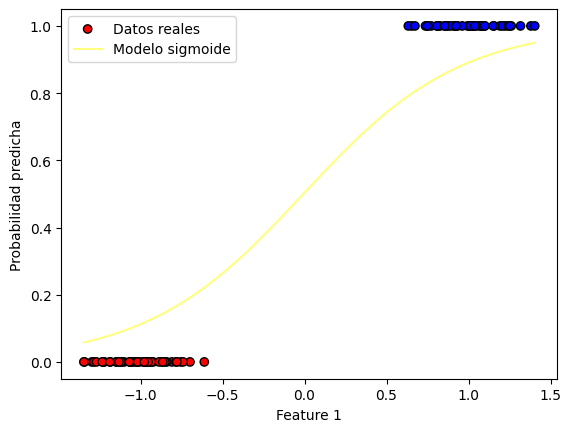

Iteracion: 927
Costo en la iteración 927: 0.12203509762605766
Valor del gradiente 927: [-0.00150097 -0.10846393]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01534911 2.08575971]


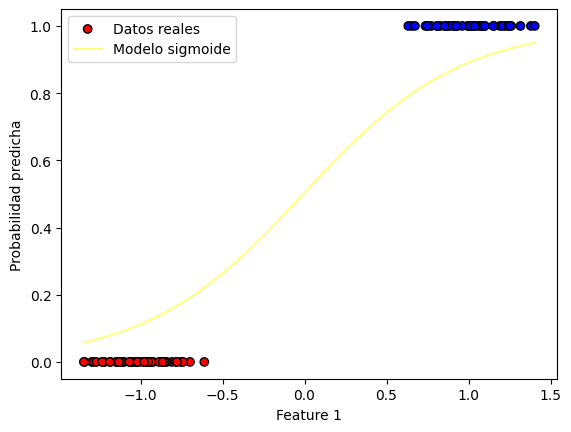

Iteracion: 928
Costo en la iteración 928: 0.12191748650025742
Valor del gradiente 928: [-0.00150007 -0.10836134]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01536411 2.08684333]


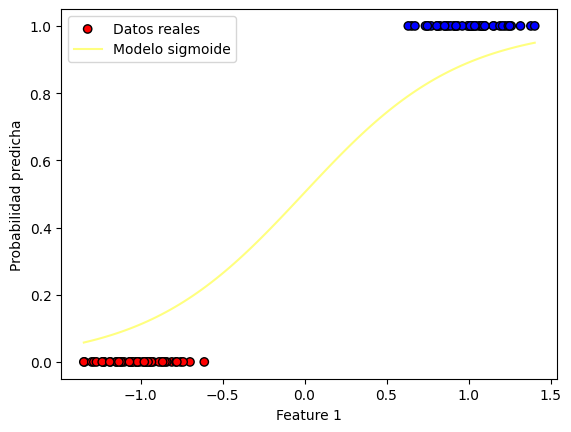

Iteracion: 929
Costo en la iteración 929: 0.12180009768399583
Valor del gradiente 929: [-0.00149916 -0.10825894]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.0153791  2.08792592]


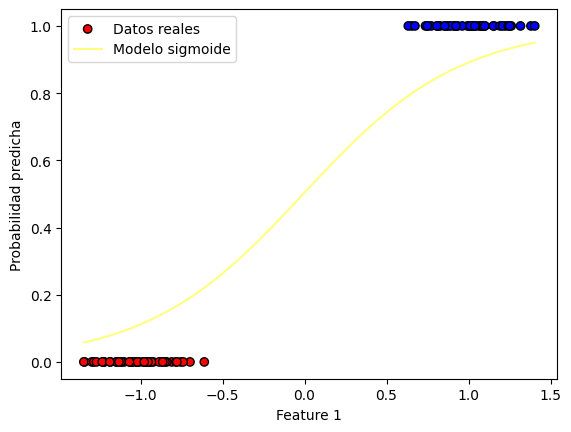

Iteracion: 930
Costo en la iteración 930: 0.12168293056334491
Valor del gradiente 930: [-0.00149826 -0.10815673]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01539408 2.08900748]


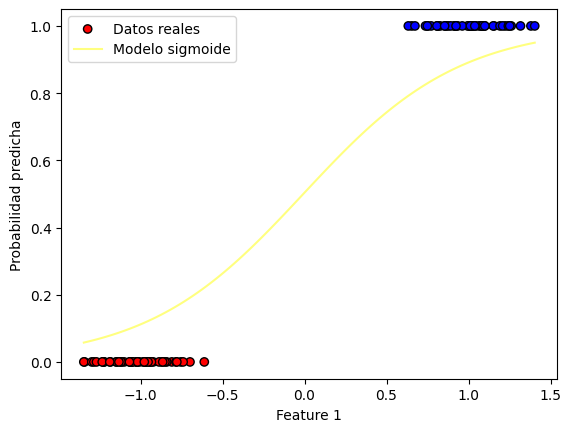

Iteracion: 931
Costo en la iteración 931: 0.12156598452658142
Valor del gradiente 931: [-0.00149736 -0.1080547 ]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01540906 2.09008803]


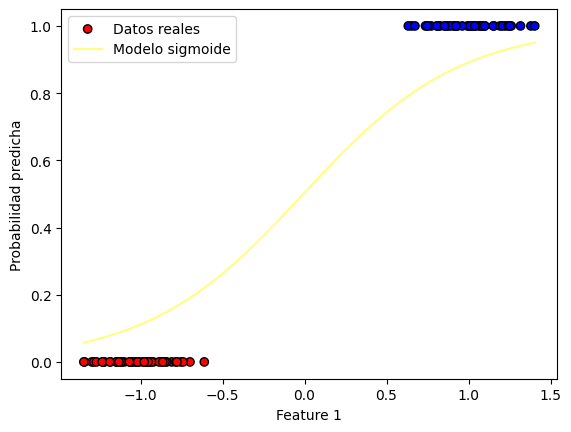

Iteracion: 932
Costo en la iteración 932: 0.12144925896417702
Valor del gradiente 932: [-0.00149646 -0.10795285]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01542402 2.09116756]


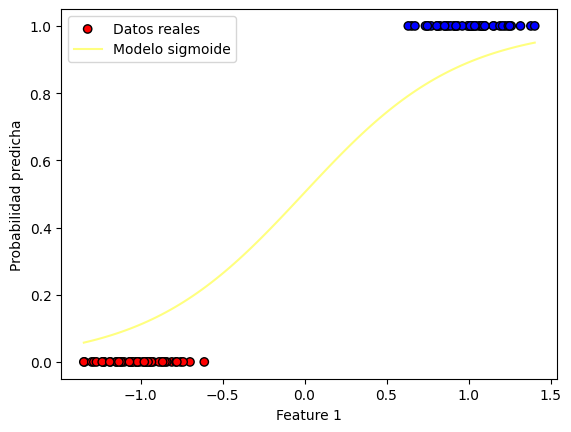

Iteracion: 933
Costo en la iteración 933: 0.12133275326878888
Valor del gradiente 933: [-0.00149555 -0.1078512 ]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01543898 2.09224607]


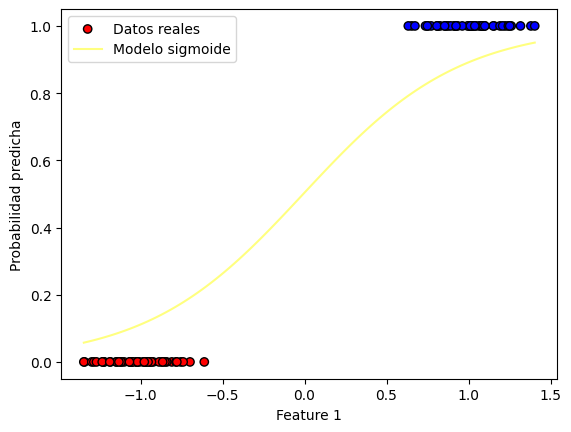

Iteracion: 934
Costo en la iteración 934: 0.12121646683524993
Valor del gradiente 934: [-0.00149465 -0.10774972]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01545392 2.09332357]


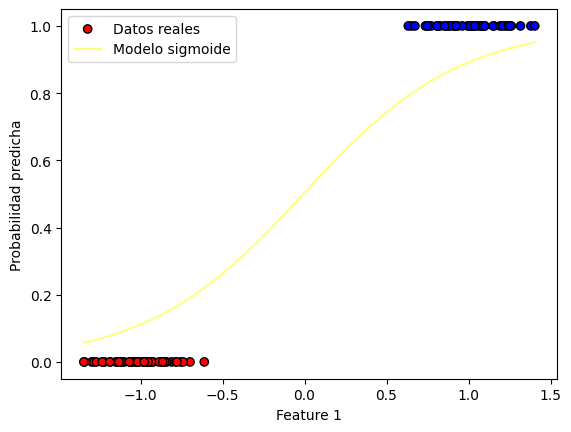

Iteracion: 935
Costo en la iteración 935: 0.12110039906055951
Valor del gradiente 935: [-0.00149375 -0.10764843]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01546886 2.09440005]


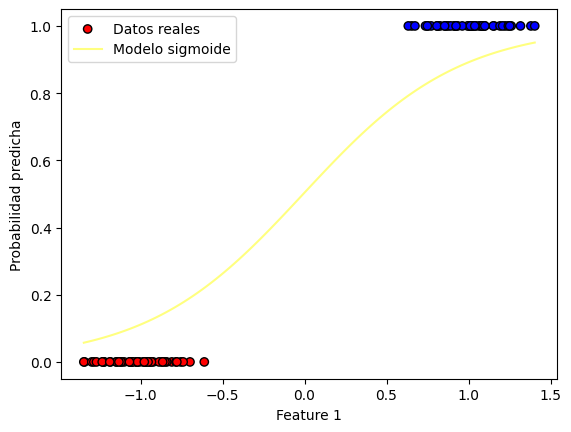

Iteracion: 936
Costo en la iteración 936: 0.12098454934387368
Valor del gradiente 936: [-0.00149286 -0.10754732]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01548379 2.09547552]


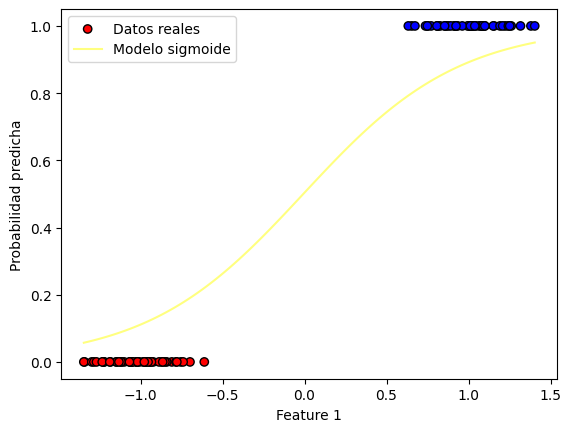

Iteracion: 937
Costo en la iteración 937: 0.12086891708649607
Valor del gradiente 937: [-0.00149196 -0.10744639]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01549871 2.09654999]


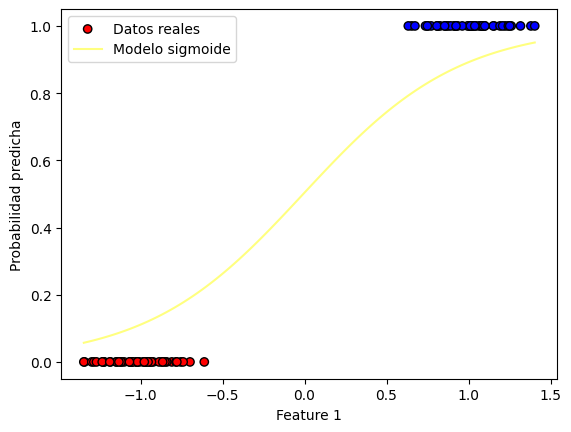

Iteracion: 938
Costo en la iteración 938: 0.12075350169186834
Valor del gradiente 938: [-0.00149106 -0.10734565]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01551362 2.09762345]


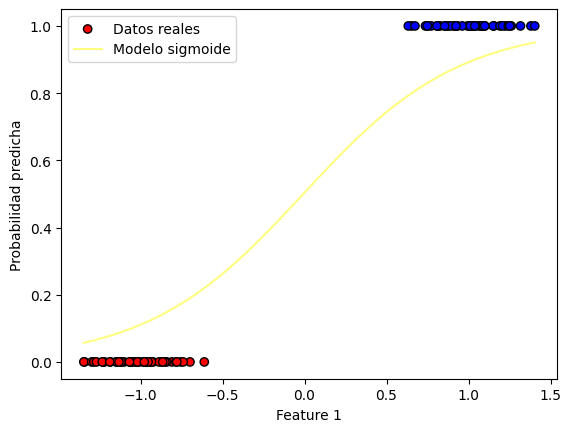

Iteracion: 939
Costo en la iteración 939: 0.12063830256556074
Valor del gradiente 939: [-0.00149016 -0.10724509]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01552852 2.0986959 ]


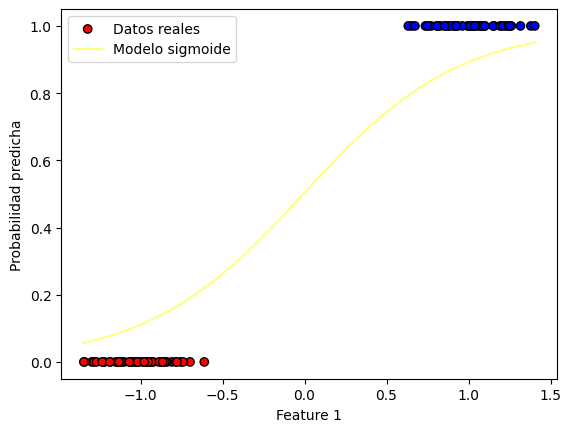

Iteracion: 940
Costo en la iteración 940: 0.12052331911526326
Valor del gradiente 940: [-0.00148927 -0.10714471]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01554341 2.09976734]


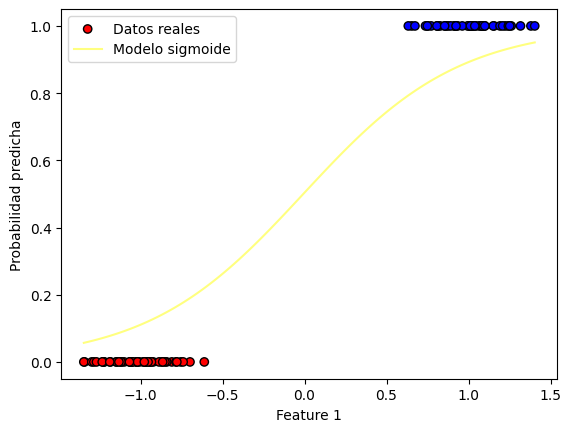

Iteracion: 941
Costo en la iteración 941: 0.12040855075077589
Valor del gradiente 941: [-0.00148837 -0.10704451]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.0155583  2.10083779]


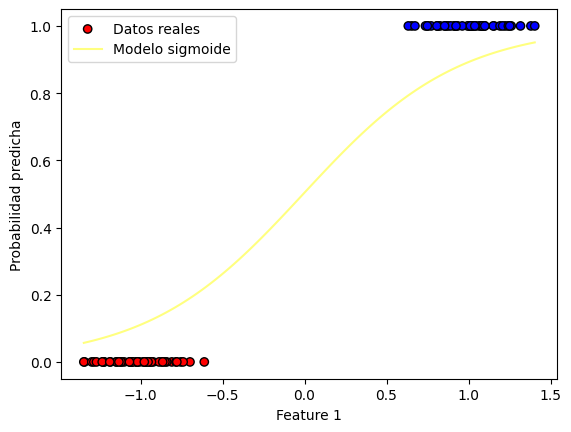

Iteracion: 942
Costo en la iteración 942: 0.1202939968839999
Valor del gradiente 942: [-0.00148748 -0.10694449]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01557317 2.10190723]


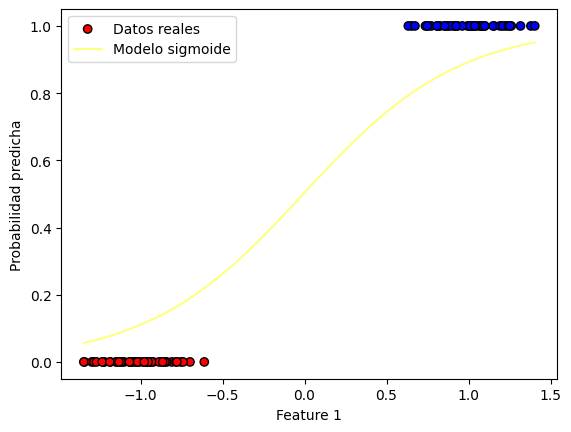

Iteracion: 943
Costo en la iteración 943: 0.12017965692892821
Valor del gradiente 943: [-0.00148658 -0.10684465]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01558804 2.10297568]


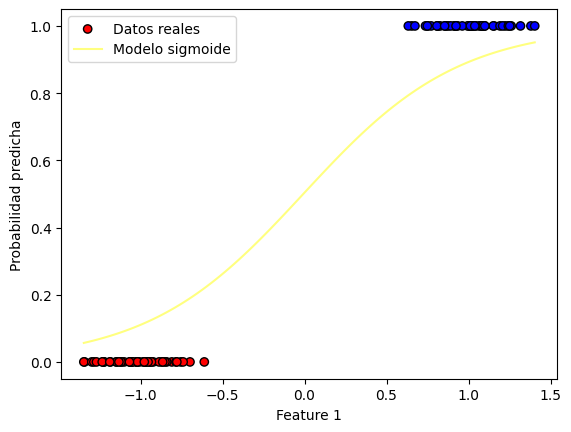

Iteracion: 944
Costo en la iteración 944: 0.12006553030163693
Valor del gradiente 944: [-0.00148569 -0.10674499]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.0156029  2.10404313]


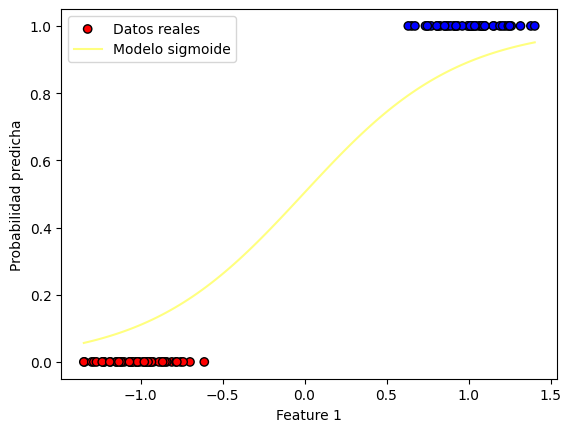

Iteracion: 945
Costo en la iteración 945: 0.11995161642027562
Valor del gradiente 945: [-0.0014848 -0.1066455]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01561774 2.10510958]


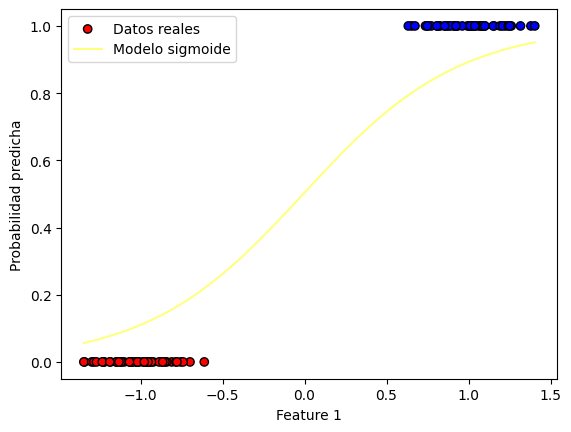

Iteracion: 946
Costo en la iteración 946: 0.11983791470505896
Valor del gradiente 946: [-0.00148391 -0.1065462 ]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01563258 2.10617505]


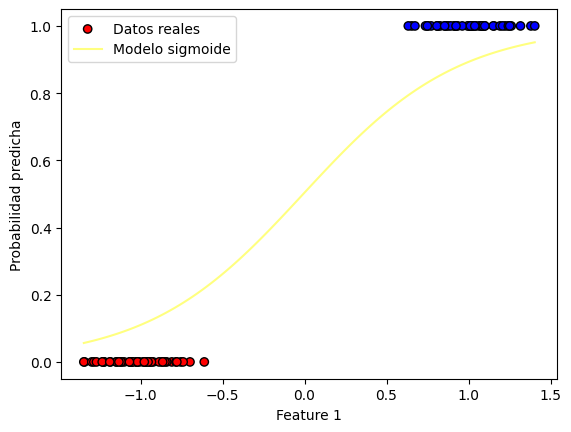

Iteracion: 947
Costo en la iteración 947: 0.11972442457825727
Valor del gradiente 947: [-0.00148301 -0.10644708]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01564741 2.10723952]


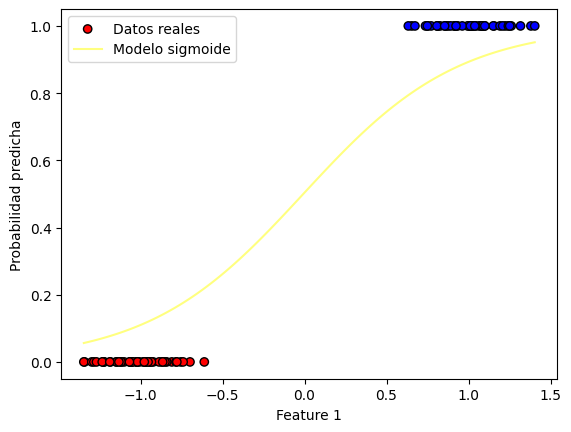

Iteracion: 948
Costo en la iteración 948: 0.11961114546418791
Valor del gradiente 948: [-0.00148212 -0.10634813]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01566223 2.108303  ]


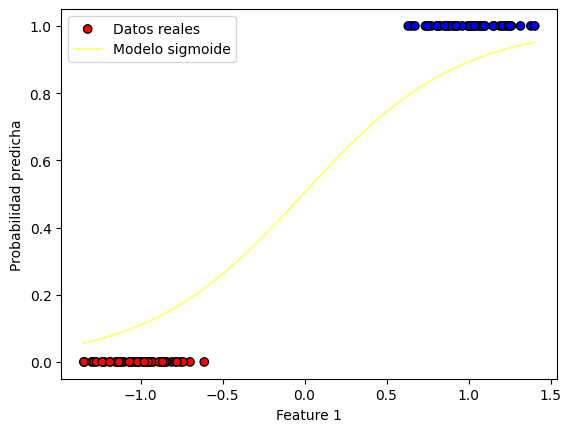

Iteracion: 949
Costo en la iteración 949: 0.11949807678920638
Valor del gradiente 949: [-0.00148123 -0.10624936]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01567705 2.10936549]


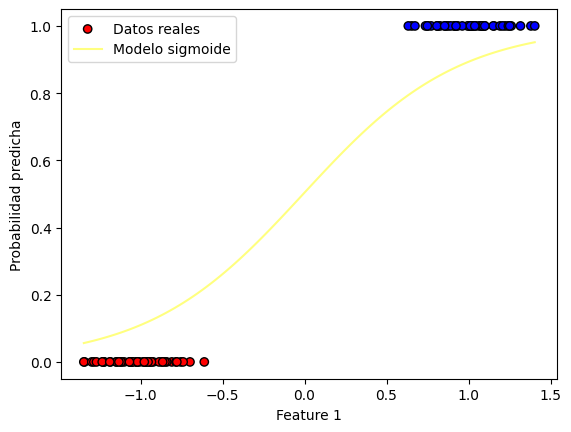

Iteracion: 950
Costo en la iteración 950: 0.1193852179816974
Valor del gradiente 950: [-0.00148035 -0.10615076]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01569185 2.110427  ]


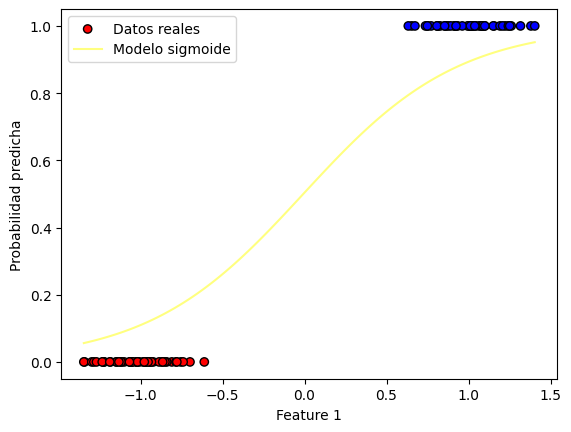

Iteracion: 951
Costo en la iteración 951: 0.11927256847206635
Valor del gradiente 951: [-0.00147946 -0.10605235]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01570664 2.11148752]


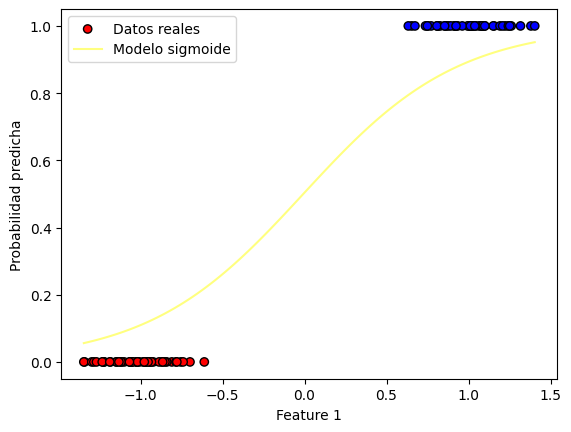

Iteracion: 952
Costo en la iteración 952: 0.1191601276927302
Valor del gradiente 952: [-0.00147857 -0.1059541 ]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01572143 2.11254706]


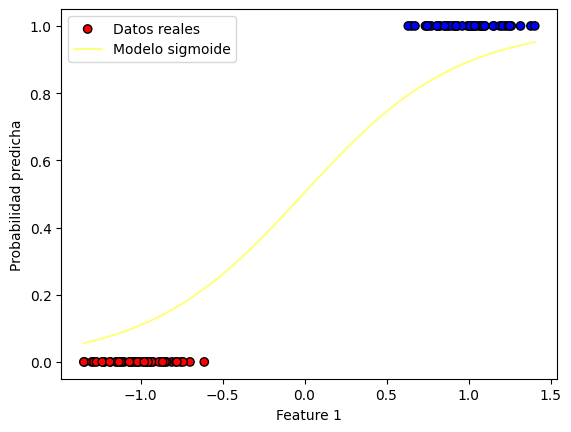

Iteracion: 953
Costo en la iteración 953: 0.11904789507810919
Valor del gradiente 953: [-0.00147768 -0.10585604]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01573621 2.11360562]


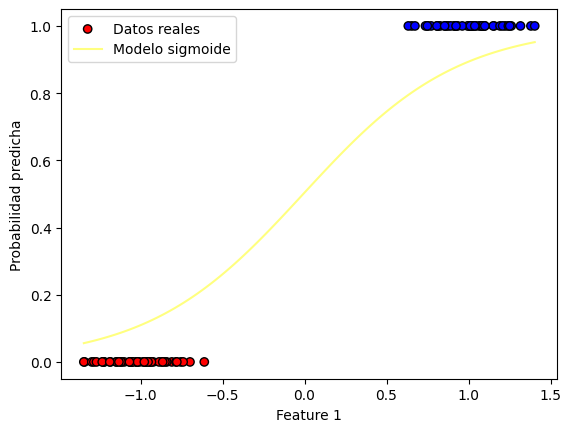

Iteracion: 954
Costo en la iteración 954: 0.11893587006461792
Valor del gradiente 954: [-0.0014768  -0.10575814]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01575097 2.11466321]


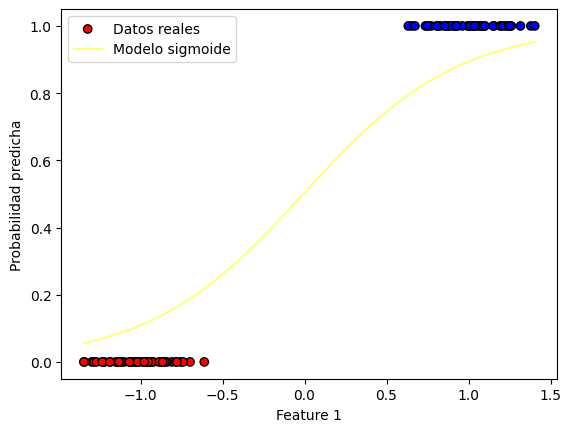

Iteracion: 955
Costo en la iteración 955: 0.11882405209065704
Valor del gradiente 955: [-0.00147591 -0.10566043]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01576573 2.11571981]


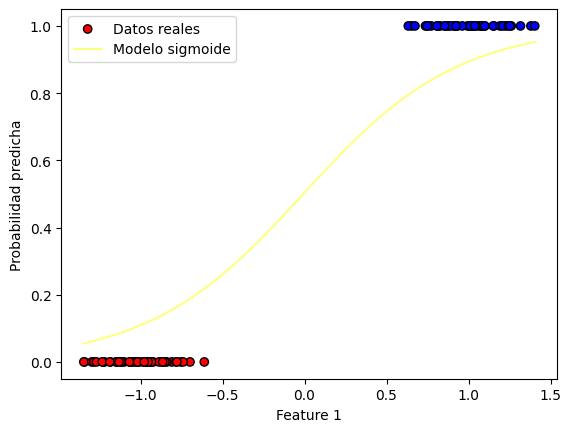

Iteracion: 956
Costo en la iteración 956: 0.11871244059660446
Valor del gradiente 956: [-0.00147503 -0.10556288]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01578048 2.11677544]


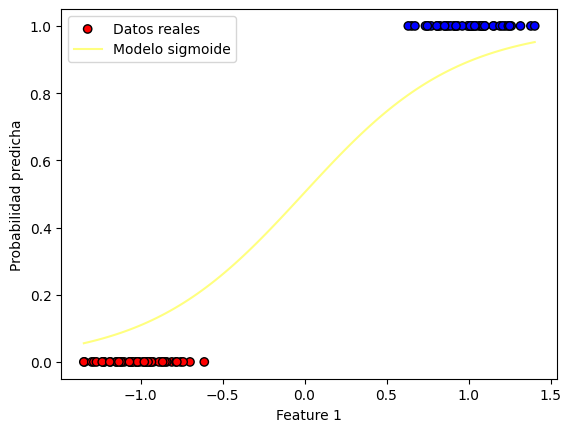

Iteracion: 957
Costo en la iteración 957: 0.11860103502480689
Valor del gradiente 957: [-0.00147414 -0.10546551]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01579523 2.11783009]


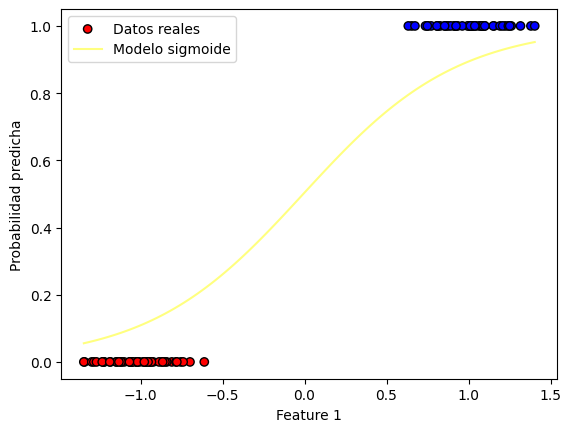

Iteracion: 958
Costo en la iteración 958: 0.11848983481957145
Valor del gradiente 958: [-0.00147326 -0.10536831]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01580996 2.11888378]


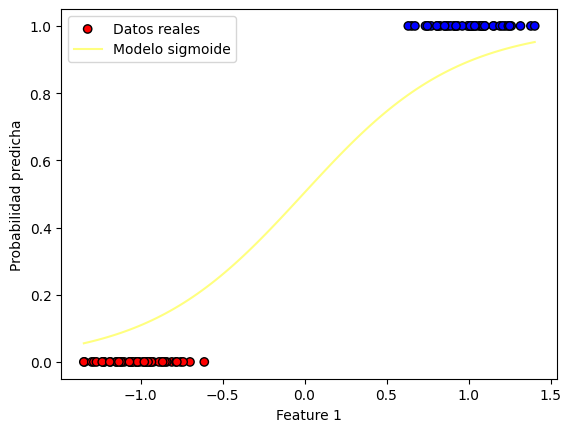

Iteracion: 959
Costo en la iteración 959: 0.11837883942715728
Valor del gradiente 959: [-0.00147238 -0.10527129]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01582468 2.11993649]


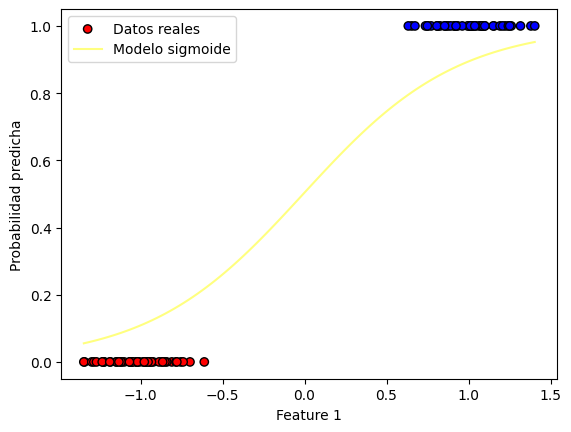

Iteracion: 960
Costo en la iteración 960: 0.11826804829576702
Valor del gradiente 960: [-0.0014715  -0.10517444]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.0158394  2.12098823]


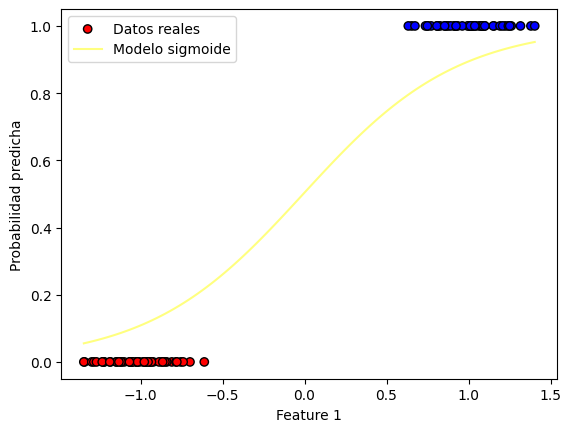

Iteracion: 961
Costo en la iteración 961: 0.1181574608755386
Valor del gradiente 961: [-0.00147062 -0.10507776]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.0158541  2.12203901]


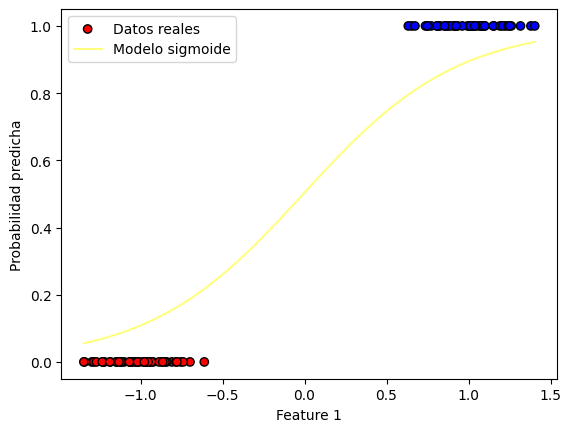

Iteracion: 962
Costo en la iteración 962: 0.11804707661853683
Valor del gradiente 962: [-0.00146974 -0.10498125]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.0158688  2.12308882]


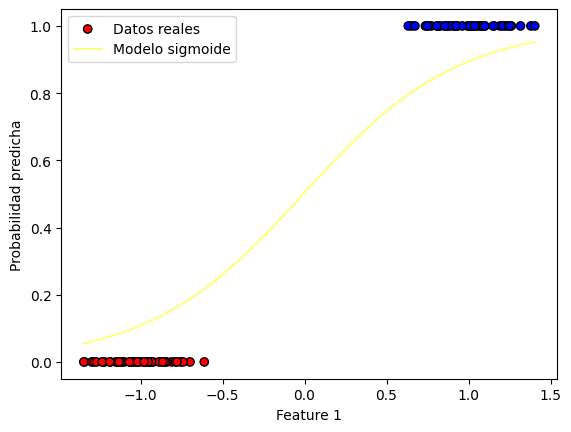

Iteracion: 963
Costo en la iteración 963: 0.1179368949787453
Valor del gradiente 963: [-0.00146886 -0.10488491]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01588349 2.12413767]


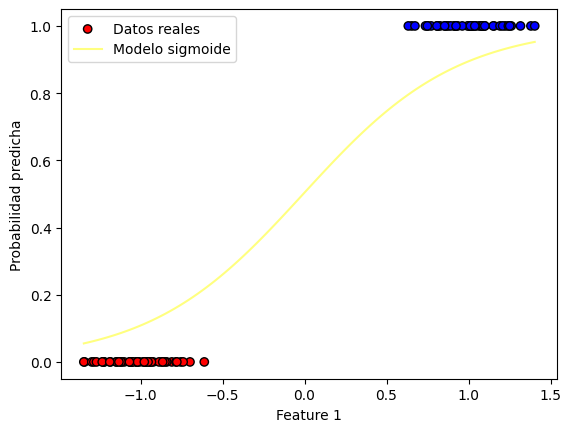

Iteracion: 964
Costo en la iteración 964: 0.11782691541205809
Valor del gradiente 964: [-0.00146798 -0.10478874]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01589817 2.12518556]


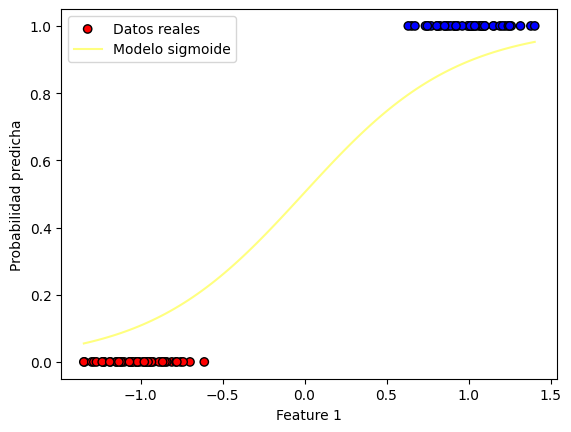

Iteracion: 965
Costo en la iteración 965: 0.11771713737627149
Valor del gradiente 965: [-0.0014671  -0.10469274]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01591284 2.12623249]


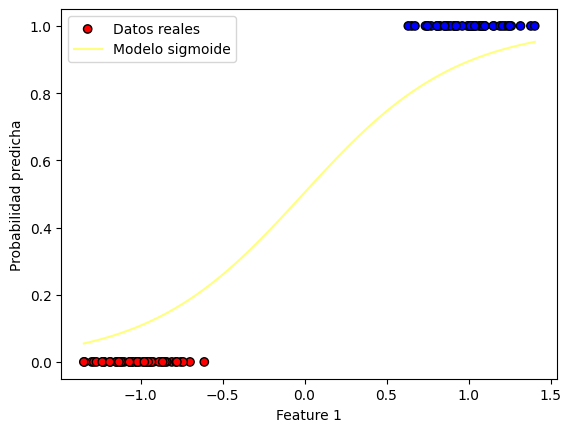

Iteracion: 966
Costo en la iteración 966: 0.11760756033107621
Valor del gradiente 966: [-0.00146622 -0.10459691]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.0159275  2.12727846]


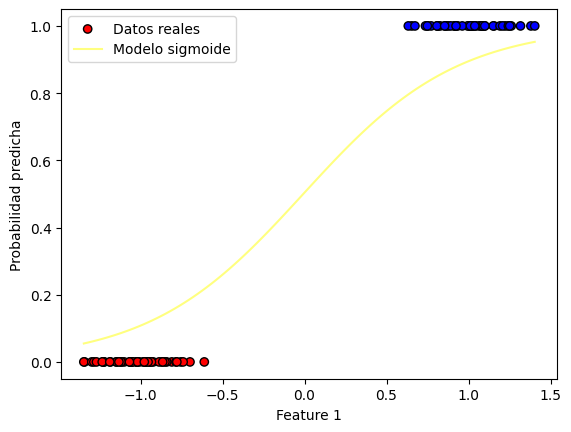

Iteracion: 967
Costo en la iteración 967: 0.11749818373804885
Valor del gradiente 967: [-0.00146535 -0.10450125]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01594216 2.12832347]


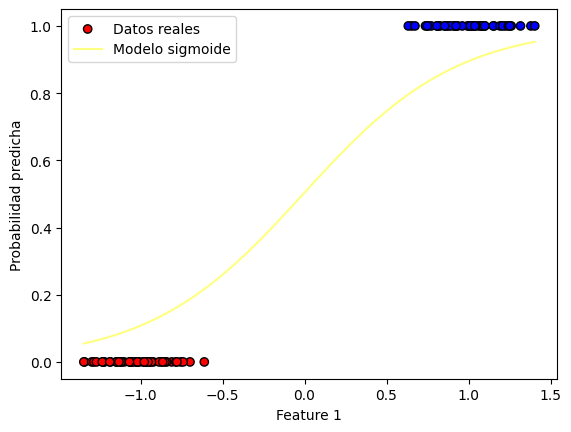

Iteracion: 968
Costo en la iteración 968: 0.11738900706064417
Valor del gradiente 968: [-0.00146447 -0.10440576]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.0159568  2.12936753]


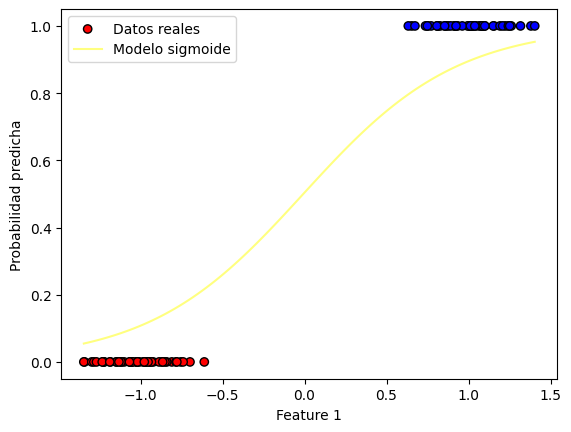

Iteracion: 969
Costo en la iteración 969: 0.11728002976418694
Valor del gradiente 969: [-0.00146359 -0.10431044]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01597144 2.13041063]


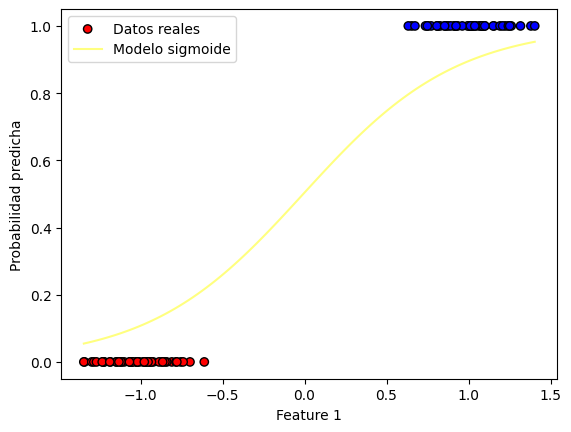

Iteracion: 970
Costo en la iteración 970: 0.11717125131586413
Valor del gradiente 970: [-0.00146272 -0.10421528]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01598606 2.13145278]


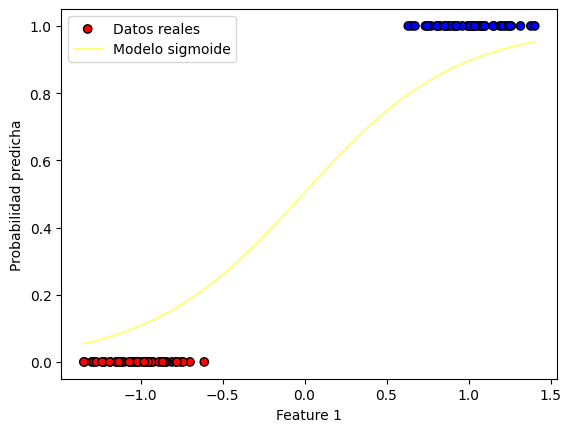

Iteracion: 971
Costo en la iteración 971: 0.11706267118471678
Valor del gradiente 971: [-0.00146185 -0.10412029]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01600068 2.13249399]


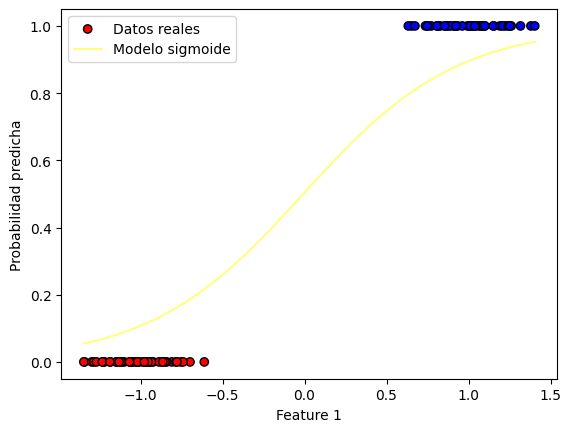

Iteracion: 972
Costo en la iteración 972: 0.11695428884163217
Valor del gradiente 972: [-0.00146097 -0.10402547]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01601529 2.13353424]


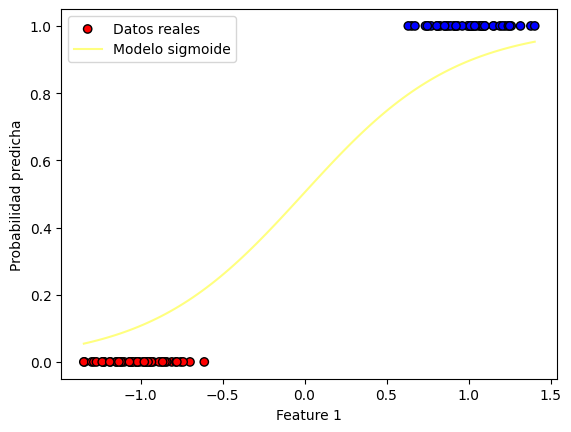

Iteracion: 973
Costo en la iteración 973: 0.11684610375933609
Valor del gradiente 973: [-0.0014601  -0.10393081]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01602989 2.13457355]


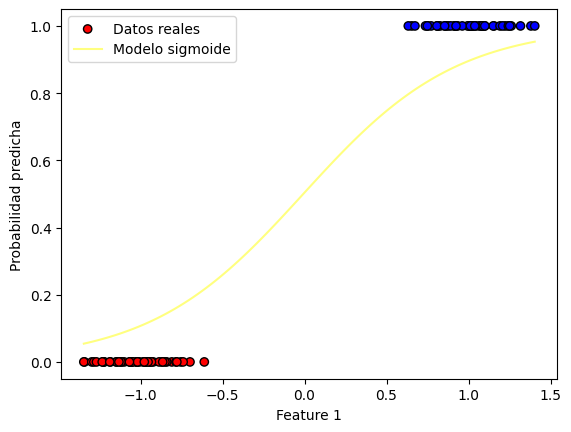

Iteracion: 974
Costo en la iteración 974: 0.11673811541238499
Valor del gradiente 974: [-0.00145923 -0.10383633]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01604448 2.13561191]


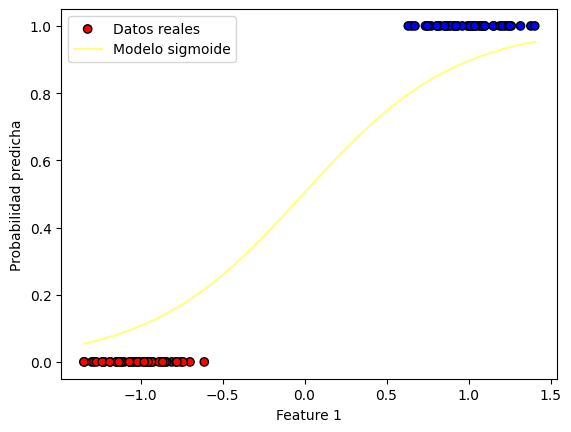

Iteracion: 975
Costo en la iteración 975: 0.11663032327715808
Valor del gradiente 975: [-0.00145836 -0.103742  ]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01605907 2.13664933]


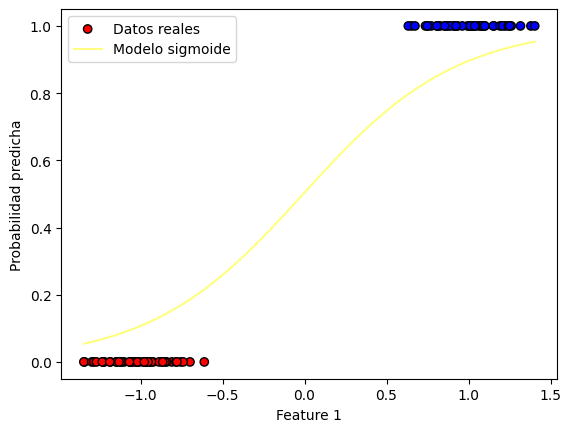

Iteracion: 976
Costo en la iteración 976: 0.11652272683184978
Valor del gradiente 976: [-0.00145749 -0.10364784]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01607364 2.13768581]


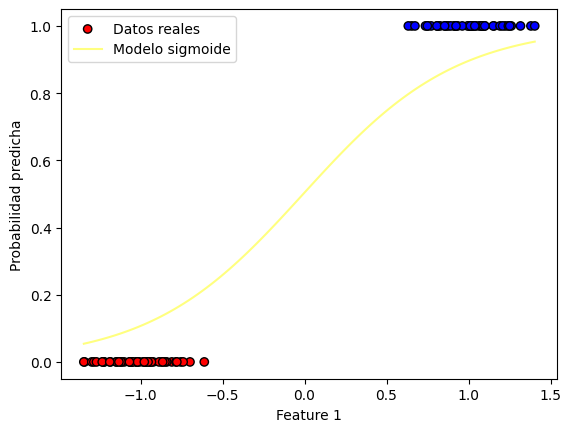

Iteracion: 977
Costo en la iteración 977: 0.11641532555646182
Valor del gradiente 977: [-0.00145662 -0.10355385]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01608821 2.13872135]


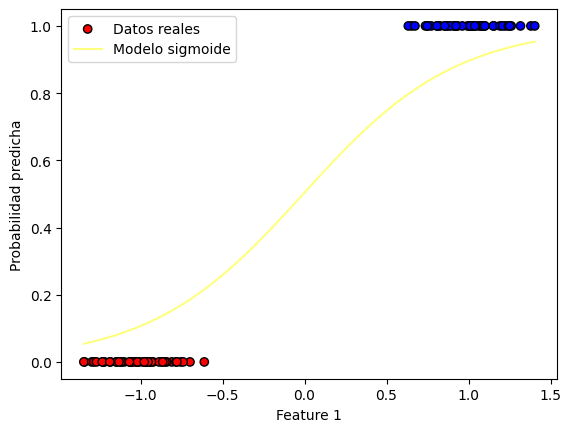

Iteracion: 978
Costo en la iteración 978: 0.11630811893279583
Valor del gradiente 978: [-0.00145575 -0.10346002]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01610277 2.13975595]


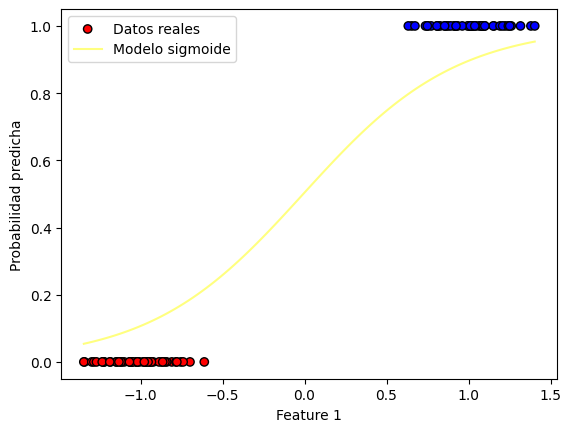

Iteracion: 979
Costo en la iteración 979: 0.11620110644444558
Valor del gradiente 979: [-0.00145488 -0.10336636]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01611732 2.14078961]


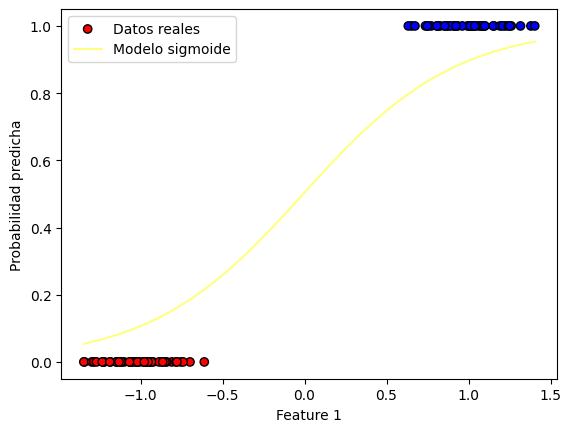

Iteracion: 980
Costo en la iteración 980: 0.11609428757678936
Valor del gradiente 980: [-0.00145402 -0.10327286]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01613186 2.14182234]


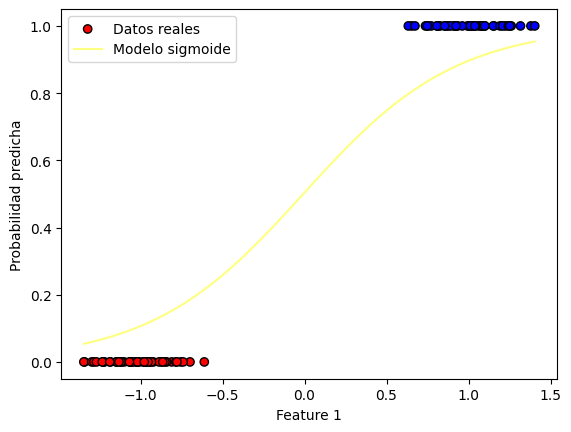

Iteracion: 981
Costo en la iteración 981: 0.11598766181698263
Valor del gradiente 981: [-0.00145315 -0.10317952]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01614639 2.14285414]


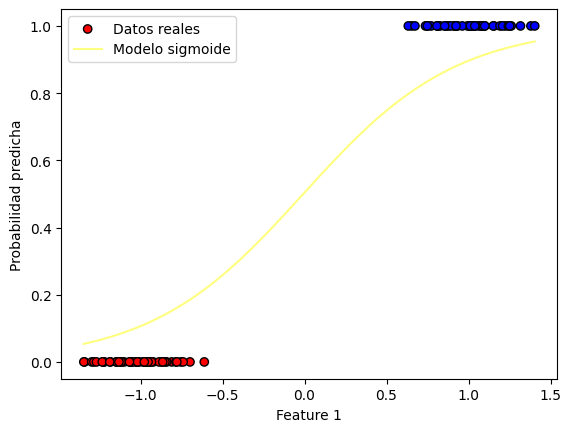

Iteracion: 982
Costo en la iteración 982: 0.11588122865395026
Valor del gradiente 982: [-0.00145229 -0.10308634]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01616091 2.143885  ]


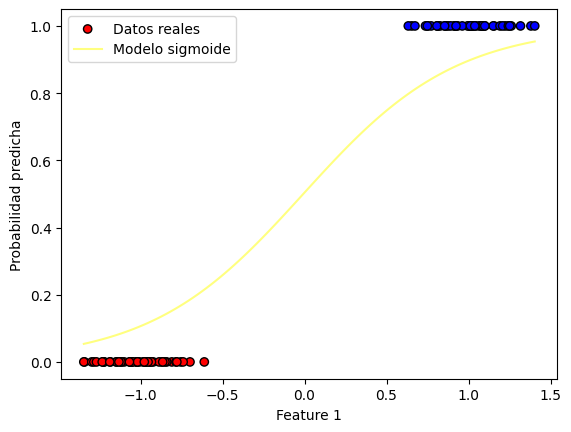

Iteracion: 983
Costo en la iteración 983: 0.1157749875783793
Valor del gradiente 983: [-0.00145142 -0.10299333]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01617542 2.14491493]


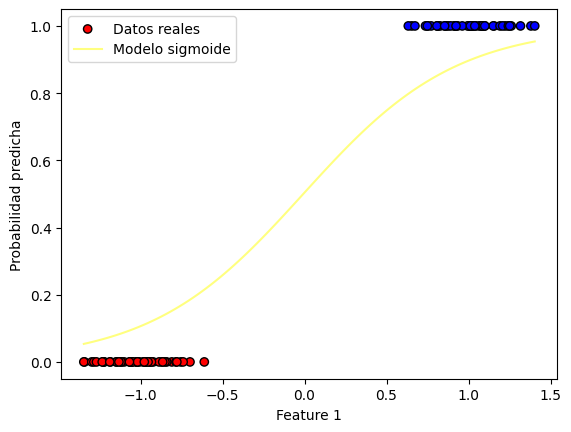

Iteracion: 984
Costo en la iteración 984: 0.11566893808271132
Valor del gradiente 984: [-0.00145056 -0.10290048]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01618993 2.14594394]


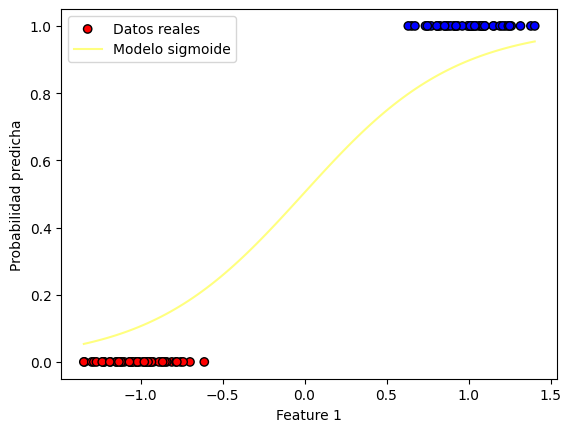

Iteracion: 985
Costo en la iteración 985: 0.11556307966113538
Valor del gradiente 985: [-0.00144969 -0.10280779]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01620443 2.14697202]


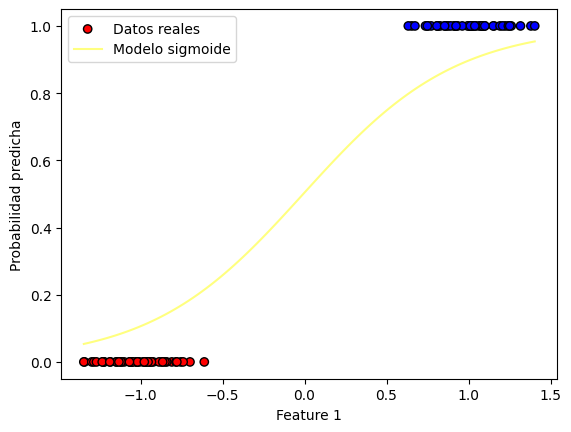

Iteracion: 986
Costo en la iteración 986: 0.11545741180958018
Valor del gradiente 986: [-0.00144883 -0.10271526]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01621892 2.14799917]


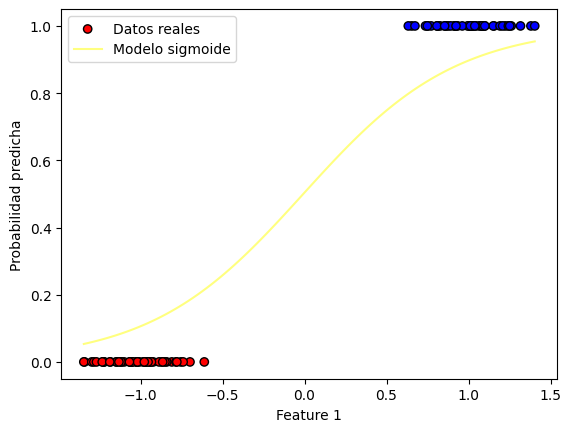

Iteracion: 987
Costo en la iteración 987: 0.1153519340257072
Valor del gradiente 987: [-0.00144797 -0.10262289]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.0162334 2.1490254]


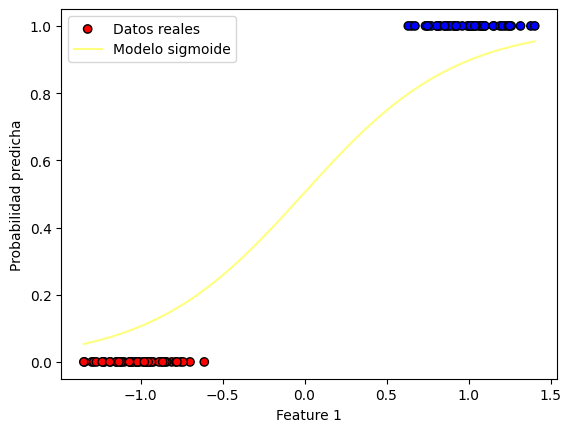

Iteracion: 988
Costo en la iteración 988: 0.11524664580890313
Valor del gradiente 988: [-0.00144711 -0.10253068]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01624787 2.15005071]


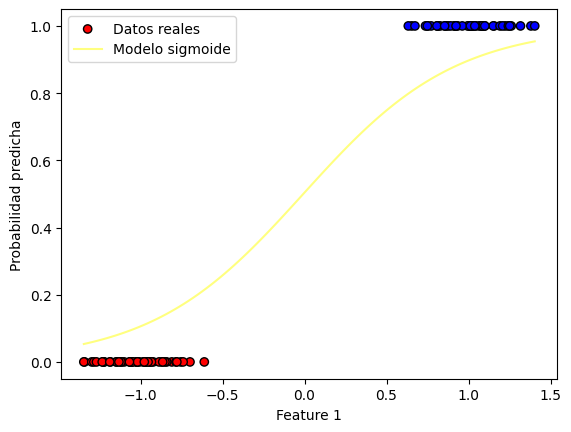

Iteracion: 989
Costo en la iteración 989: 0.11514154666027276
Valor del gradiente 989: [-0.00144625 -0.10243863]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01626233 2.15107509]


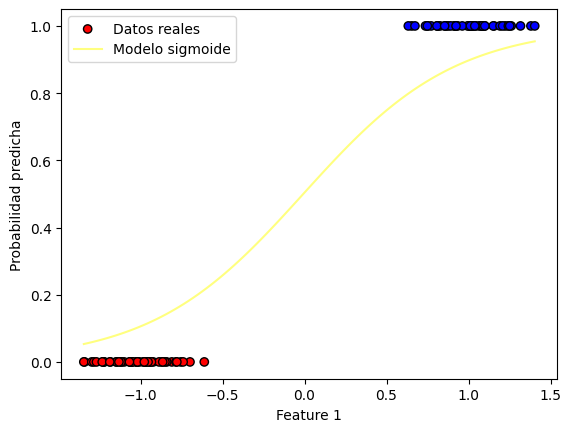

Iteracion: 990
Costo en la iteración 990: 0.11503663608263166
Valor del gradiente 990: [-0.00144539 -0.10234675]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01627678 2.15209856]


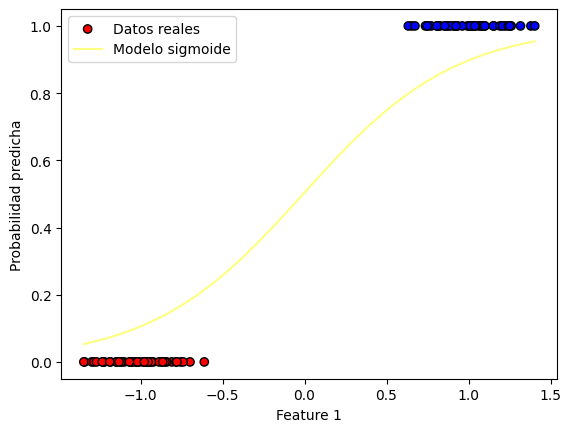

Iteracion: 991
Costo en la iteración 991: 0.11493191358049909
Valor del gradiente 991: [-0.00144453 -0.10225502]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01629123 2.15312111]


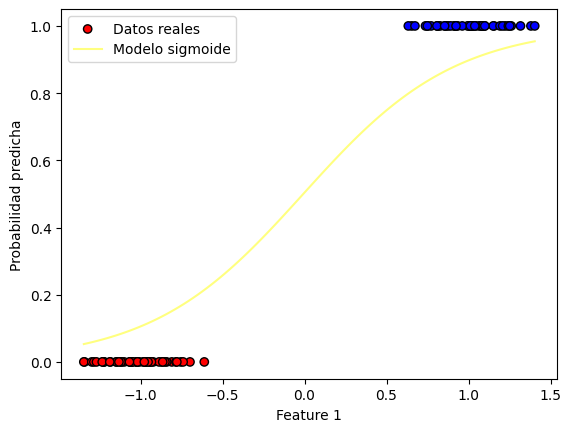

Iteracion: 992
Costo en la iteración 992: 0.11482737866009096
Valor del gradiente 992: [-0.00144367 -0.10216345]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01630566 2.15414274]


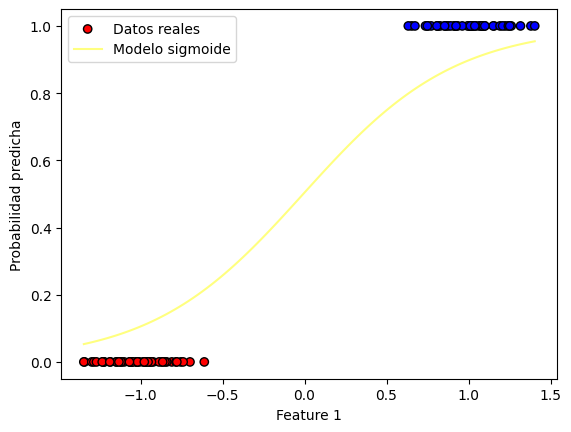

Iteracion: 993
Costo en la iteración 993: 0.11472303082931243
Valor del gradiente 993: [-0.00144281 -0.10207203]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01632009 2.15516346]


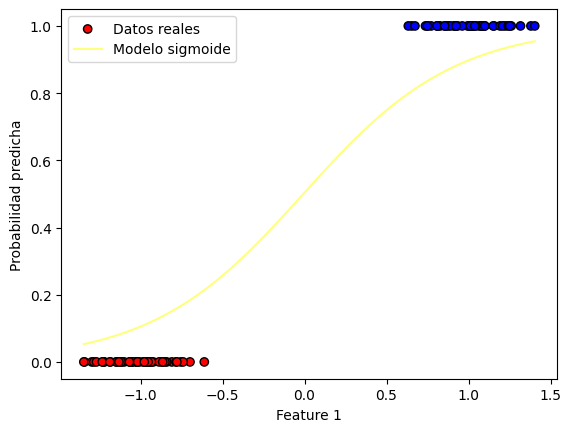

Iteracion: 994
Costo en la iteración 994: 0.11461886959775117
Valor del gradiente 994: [-0.00144196 -0.10198078]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01633451 2.15618327]


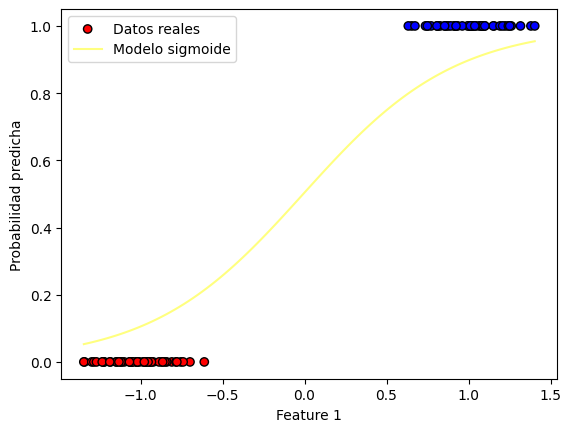

Iteracion: 995
Costo en la iteración 995: 0.11451489447667004
Valor del gradiente 995: [-0.0014411  -0.10188968]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01634892 2.15720217]


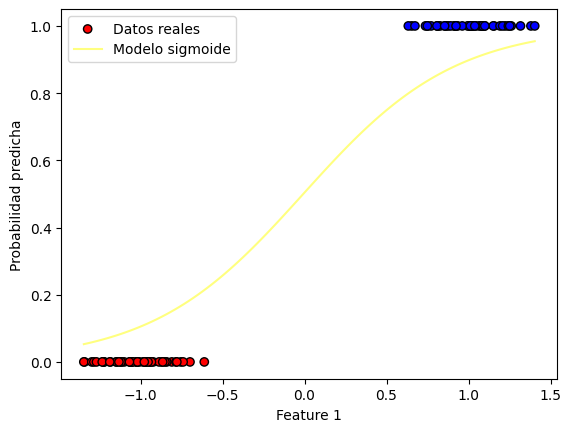

Iteracion: 996
Costo en la iteración 996: 0.11441110497900031
Valor del gradiente 996: [-0.00144024 -0.10179874]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01636333 2.15822016]


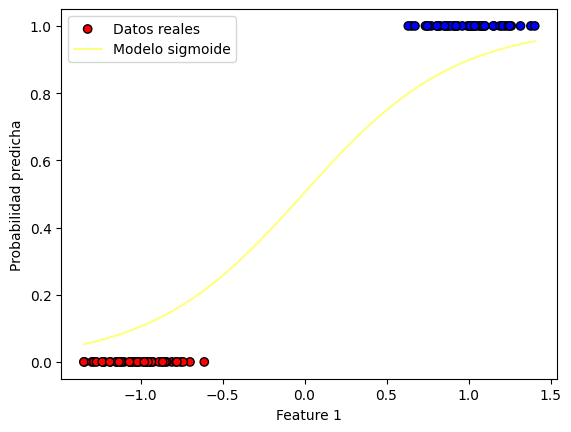

Iteracion: 997
Costo en la iteración 997: 0.11430750061933452
Valor del gradiente 997: [-0.00143939 -0.10170796]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01637772 2.15923724]


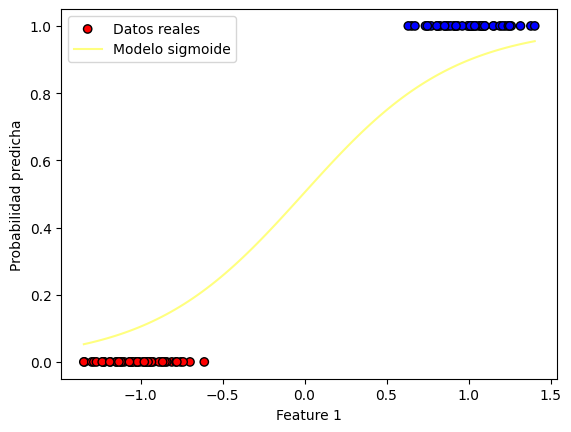

Iteracion: 998
Costo en la iteración 998: 0.11420408091391976
Valor del gradiente 998: [-0.00143854 -0.10161733]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.0163921  2.16025341]


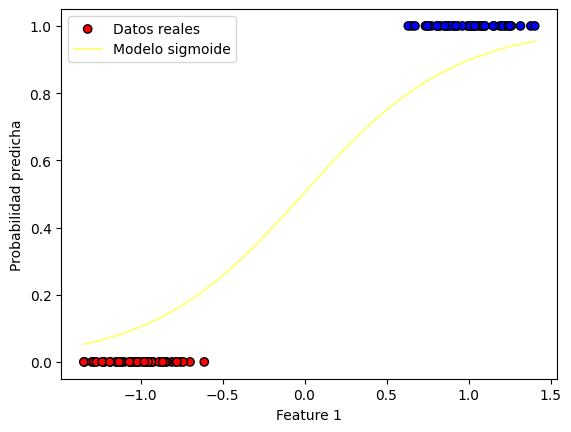

Iteracion: 999
Costo en la iteración 999: 0.11410084538065053
Valor del gradiente 999: [-0.00143768 -0.10152686]
Nuevos valores de los parámetros actualizado según el gradiente y el learning rate: [0.01640648 2.16126868]


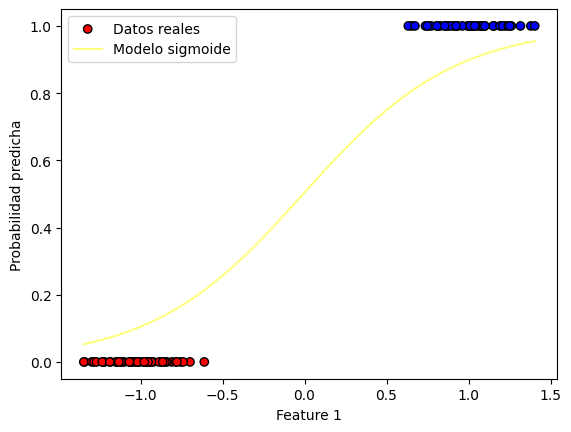

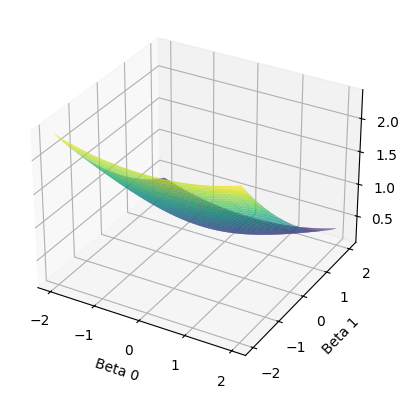

In [7]:
# Entrenar el modelo
beta = gradient_descent(X, y, beta, learning_rate, iterations)



In [8]:
# Obtener las predicciones del modelo
preds = sigmoid(np.dot(X, beta)) >= 0.5

In [9]:
preds

array([False, False, False,  True, False,  True, False, False,  True,
        True,  True,  True,  True,  True, False, False,  True,  True,
        True, False, False,  True,  True, False,  True, False, False,
       False,  True,  True, False, False,  True, False,  True, False,
        True,  True,  True,  True,  True,  True, False,  True,  True,
       False, False,  True, False,  True, False,  True, False,  True,
        True, False, False, False,  True,  True,  True,  True, False,
        True,  True, False,  True, False, False,  True, False,  True,
       False, False, False, False, False,  True, False, False, False,
       False,  True,  True, False,  True, False,  True,  True, False,
       False,  True, False, False, False, False, False,  True,  True,
        True])

## 6. ¿Se puede utilizar la Regresión Logística para problemas de clasificación no binaria?